In [1]:
%load_ext autoreload
%autoreload 2

import gc
import os
import pickle
from collections import Counter, defaultdict

import numpy
import pandas
from math import exp, sqrt, log

from keras.models import load_model
from keras import Input, Model
from keras.layers import Lambda, subtract, concatenate
from keras.callbacks import EarlyStopping

from sklearn.externals import joblib

from importlib import reload
from matplotlib import pyplot as plt
from random import random, shuffle, choice, randint

from classes import Student, Question
from utils import generate_student_name, create_qs, create_students, generate_attempts, calculate_pass_probability, attempt_q

import random
import math
import scipy

from NN_utils import BigTable, WeightClip

print("started")

use_saved = True
do_train = True
do_testing = True
create_scorecards = True

base = "../../../isaac_data_files/"

from scipy.optimize import curve_fit
def gompertz(x, A,k1,k2,off):
    return A*numpy.exp(-k1*numpy.exp(-k2*(x-off)))

def inv_gompertz(y, A,k1,k2,off):
    return off + numpy.log(k1/numpy.log(A/y))/k2

def logistic(x, b,off):
    z = b*(x-off)
    return numpy.exp(z)/(1+numpy.exp(z))

# p = 1/(1+e(-x))
# 1+e(-x) = 1/p
# e(-x) = (1/p)-1
# x = -log((1/p)-1)

def inv_logistic(pr, b,off):
    return off-(numpy.log((1/pr) -1))/b

sigmoid = lambda z: 1/(1+(numpy.exp(-z)))
def pr(a,d): return sigmoid((a-d))
def pr_to_spread(p, comps=1, as_A_and_D=True):
    per_comp_p = p**(1/comps)
#     print("p         ", p)
#     print("per comp p", per_comp_p)
#     spread = -numpy.log((1.0/per_comp_p)-1.0)
    inv_sigmoid = lambda pr : ( -numpy.log((1/pr) -1) )
    spread = inv_sigmoid(per_comp_p)
#     print("spread    ", spread)
    if as_A_and_D:
        a = spread/2.0
        d = -spread/2.0
        return a,d
    else:
        return spread

def spread_to_pr(sp, comps=1):
    return numpy.power((1/(1+numpy.exp(-sp))), comps)

Using TensorFlow backend.


started


In [2]:
from numpy.random import uniform, random_integers
from scipy.stats import truncnorm

def gen_students(n_students, a0, a1, n_factors, gen_mode="truncnorm"):
    students = numpy.zeros((n_students, n_factors))
    for six in range(n_students):
#         true_comps = numpy.repeat(3, n_factors)
        if gen_mode=="truncnorm":
            true_comps = numpy.random.normal(a0, a1, size=n_factors)#+0.2#+2#+1.2
#             true_comps = numpy.clip(true_comps,6,12)
        elif gen_mode=="uniform":
#             minb,maxb,mina,maxa =(1.0, 3.7812870150169404, 2.691968403956818, 12.165240419546407) # 10?

            clip0 = a0 - 3*a1
            clip1 = a0 + 3*a1
#             clip0 = mina
#             clip1 = maxa
            print("clipp",clip0,clip1)
            true_comps = numpy.random.uniform(clip0, clip1, size=n_factors)
#             true_comps = numpy.clip(true_comps,6,12)
        else:
            print("unknown distro mode")
#         print("True comps", a0,a1, true_comps)
#         true_comps = numpy.random.uniform(a0-3*a1, a0+3*a1, size=n_factors)
#         true_comps = numpy.repeat(3, n_factors)
        for cix,c in zip(range(n_factors), true_comps):
            students[six,cix] = c + 3
    return students

def gen_questions(n_questions, a0, a1, min_active_traits, max_active_traits, gen_mode="truncnorm", test_w=None):
    #approximate the min and max outputs from the gaussian
    inv_fn = spread_to_pr
    av_c = (min_active_traits + max_active_traits)/2
    p = numpy.linspace(0.001,0.999,30)
    sprd = pr_to_spread(p, av_c, as_A_and_D=False)
#     plt.scatter(sprd,p)
#     plt.show()
#     popt, pcov = curve_fit(inv_fn, p, sprd)
#     print(popt)
#     p = numpy.linspace(0.001,0.999,50)
#     d = (p, comps=av_c)
    p2 = spread_to_pr(sprd, av_c)
    d50 = pr_to_spread(.5, av_c, as_A_and_D=False)
    d99 = pr_to_spread(.999, av_c, as_A_and_D=False)
    d00 = pr_to_spread(.001, av_c, as_A_and_D=False)
    print("dvals", d00, d50, d99)
    print("inv_logistic curve")
    plt.scatter(sprd,p)
    plt.plot(sprd,p2)
    plt.show()
    print("tru spread d50=",d50, "(prob={})".format(spread_to_pr(d50, av_c)))
    
    minval = math.inf
    
    questions = numpy.zeros((n_questions, n_factors))
    for qix in range(n_questions):
        n_comps = random_integers(min_active_traits, max_active_traits)
        print("NCOMPS", n_comps)
        comp_ixs = numpy.random.choice(range(n_factors), size=n_comps, replace=False)
        
        mu = a0
        sd = a1
        clip_a, clip_b = 0.0001,0.9999
#         a, b = (clip_a - mu) / sd, (clip_b - mu) / sd
#         standard_probs = scipy.stats.norm.rvs(loc=.5, scale=1/6, size=n_comps)
        if gen_mode == "u_uniform":
#             true_comps = numpy.random.uniform((mu-1)-d50, (mu+1)-d50, size=n_comps)
#             minb,maxb,mina,maxa =(1.0, 3.7812870150169404, 2.691968403956818, 12.165240419546407) # 10?
#             true_comps = numpy.random.uniform((mu-1)-d50, (mu+1)-d50, size=n_comps)
            if test_w:
                minb=-test_w/2
                maxb=test_w/2
            else:
                minb=-2
                maxb=2
            true_comps = numpy.random.uniform(minb, maxb, size=n_comps)
#             true_comps = numpy.random.uniform(mu, sd, size=n_comps)
#             print("true q comps", true_comps)
        elif gen_mode == "c50":
            true_comps = numpy.repeat(mu-d50, n_comps)
#             true_comps = true_comps * numpy.random.normal(loc=1, scale=0.1, size=n_comps)
        elif gen_mode == "u_truncnorm":
            true_comps = numpy.random.normal(loc=mu, scale=sd, size=n_comps)
        else:
            standard_probs=[]
            if gen_mode == "truncnorm":
                standard_probs = numpy.random.normal(loc=0.5, scale=1/6, size=n_comps)
                standard_probs = numpy.clip(standard_probs,clip_a,clip_b)
            elif gen_mode == "beta22":
                standard_probs = numpy.random.beta(2,2, size=n_comps)# normal(loc=.5, scale=1/6, size=n_comps)
    #         standard_probs = truncnorm.rvs(clip_a, clip_b, loc=mu, scale=sd, size=n_comps)
            elif gen_mode == "uniform":
                standard_probs = numpy.random.uniform(clip_a, clip_b, size=n_comps)
#         standard_probs = numpy.repeat(0.5, n_comps)
            true_comps = a0 - pr_to_spread(standard_probs, comps=n_comps, as_A_and_D=False)
#             print(standard_probs,"-->",true_comps)
        
        this_min = min(true_comps)
        if this_min < minval:
            minval= this_min
        
#         plt.scatter(true_comps, standard_probs)
#         plt.show()
                
#         print("Q comps", true_comps)
        for cix,c in zip(comp_ixs,true_comps):
            questions[qix,cix] = c + 3
            
        print("q minval is", minval)
        for cix,c in zip(comp_ixs,true_comps):
            if questions[qix,cix] !=0:
                questions[qix,cix] = questions[qix,cix]# - minval + 1
    return questions, minval

# minb,maxb,mina,maxa =(1.0, 11, 6, 11)
def gen_run(n_traits, a0, a1, min_active_traits, max_active_traits, s_gen="uniform", q_gen="uniform", test_w=None):
    students = gen_students(n_students, a0, a1, n_factors, gen_mode=s_gen)
    questions, offset = gen_questions(n_questions, a0, a1, min_active_traits, max_active_traits, gen_mode=q_gen, test_w=test_w)

#     questions[questions>0] = questions[questions>0] - offset+1
#     students = students - offset+1
#     students = students

    obs = numpy.zeros((len(students), len(questions)))
    probs = numpy.zeros((len(students), len(questions)))
    #obs = numpy.matmul(viewers, movies.T)/n_factors
    vz = []
    mz = []
    scz =[]
    for vi in range(len(students)):
        for mi in range(len(questions)):
            zmask = (questions[mi] < 0.001).astype(int)
            diffs = students[vi]-questions[mi]
            prs = logistic(diffs,1,0)
            prs = numpy.maximum(zmask,prs)

#             print(vi,mi)
#             print("S", students[vi])
#             print("Q", questions[mi])
#             print("Z", zmask)
#             print("D", deltas)
#             print("p", prs)
#             print("P", numpy.prod(prs))
            pr = numpy.prod(prs)
            obs[vi,mi] = (random.random() < pr)
            probs[vi,mi] = pr
#             print(vi,mi, numpy.prod(prs))
    return obs, probs, students, questions

        

dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


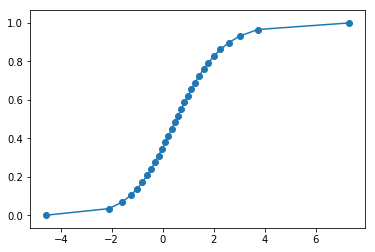

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.0884975063236
NCOMPS 2
q minval is 0.0884975063236
NCOMPS 1
q minval is -0.133287503574
NCOMPS 2
q minval is -0.133287503574
NCOMPS 1
q minval is -0.133287503574
NCOMPS 2
q minval is -0.324903944214
NCOMPS 2
q minval is -0.324903944214
NCOMPS 2
q minval is -0.324903944214
NCOMPS 1
q minval is -0.66818105525
NCOMPS 2
q minval is -0.66818105525
NCOMPS 2
q minval is -0.686155246305
NCOMPS 1
q minval is -0.686155246305
NCOMPS 2
q minval is -0.686155246305
NCOMPS 2
q minval is -0.686155246305
NCOMPS 1
q minval is -0.686155246305
NCOMPS 2
q minval is -0.686155246305
NCOMPS 2
q minval is -0.788108437745
NCOMPS 1
q minval is -0.788108437745
NCOMPS 2
q minval is -0.788108437745
NCOMPS 2
q minval is -0.788108437745
NCOMPS 1
q minval is -0.788108437745
NCOMPS 1
q minval is -0.788108437745
NCOMPS 2
q minval is -0.788108437745
NCOMPS 1
q minval is -0.788108437745
NCOMPS 2
q minval is -0.788108437745
NCOMPS 1
q minval is -0.788108437745

/home/rjm49/.venvs/isaac/lib/python3.6/site-packages/ipykernel_launcher.py:57: DeprecationWarning: This function is deprecated. Please call randint(1, 2 + 1) instead


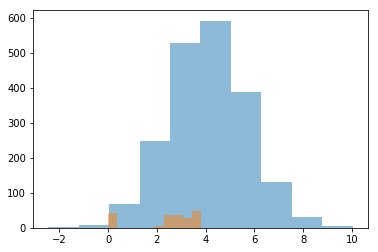

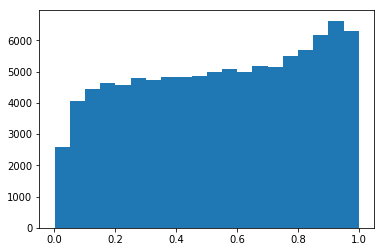

(1000, 100)
1000 100
100000 54278.0
0.54278
[ 0.04  0.02  0.05 ...,  0.04  0.05  0.04]
--- -
[ 0.98  0.96  0.96 ...,  0.95  0.95  0.95]


In [19]:
# n_factors, a0, a1, min_active, max_active = (5, 9, 1, 1, 3)
# n_factors, a0, a1, min_active, max_active = (100, 0, 1, 1, 5)
# n_factors, a0, a1, min_active, max_active = (1, 0, 0.33, 1, 1)
# n_students = 100
# n_questions = 25

n_factors, min_active, max_active = (2, 1, 2)
n_students, n_questions, a0, a1, offset, test_w =(1000, 100, 1.0933160588026476, 1.6134596069960168, 0.53204746933021974, 1.6637339735457535)

# n_factors, min_active, max_active = (10, 1, 5)
# n_students, n_questions, a0, a1, offset, test_w =(1000, 100, 1.0451284704587152, 1.4855458602659655, 0.53204746933021974, 2.0764586353304395)


# res =gen_run(n_factors, n_students, n_questions, a0, sda, min_active, max_active, None,None)
obs, probz, students, questions  = gen_run(n_factors, a0, a1, min_active, max_active, s_gen="truncnorm", q_gen="u_uniform", test_w = test_w)
# print(len(res))

plt.hist(students.flatten(), alpha=0.5)
# plt.show()
plt.hist(questions.flatten(), alpha=0.5)
plt.show()
# print(numpy.mean(questions[questions>0]))

plt.hist(probz.flatten(), bins=20)

plt.show()

print(probz.shape)
print(len(students), len(questions))

print(len(obs.flatten()), sum(obs.flatten()))
print(sum(obs.flatten())/len(obs.flatten()))

print(probz[probz<0.05])
print("--- -")
print(probz[probz>0.95])



In [ ]:
for q in questions:
    print(q)

dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


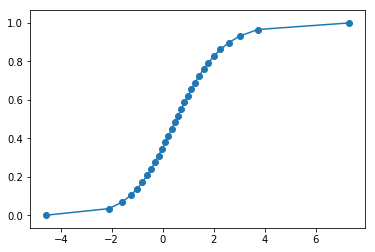

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.774700884746
NCOMPS 1
q minval is -0.564402915759
NCOMPS 2
q minval is -0.79669410038
NCOMPS 1
q minval is -0.79669410038
NCOMPS 2
q minval is -0.79669410038
NCOMPS 1
q minval is -0.79669410038
NCOMPS 2
q minval is -1.74938906598
NCOMPS 2
q minval is -1.74938906598
NCOMPS 2
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 2
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 1
q minval is -2.11761979491
NCOMPS 2
q minval is -

/home/rjm49/.venvs/isaac/lib/python3.6/site-packages/ipykernel_launcher.py:57: DeprecationWarning: This function is deprecated. Please call randint(1, 2 + 1) instead


~ ~ ~ ~~ ATTEMPT 0


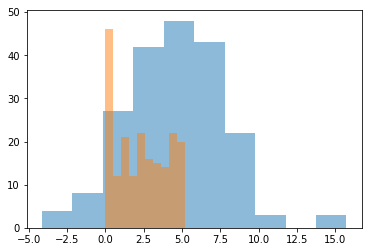

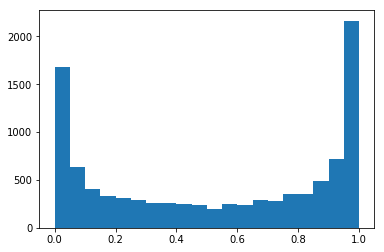

2 FACTORS
100 STUDENTS: [ 1.46] [ 3.26]
100 QUEST/NS: 4.4814246167426495
Offset 0.53204746933
(100, 100, 1.4608873304419199, 3.2572291185759012, 0.53204746933021974, 4.4814246167426495)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


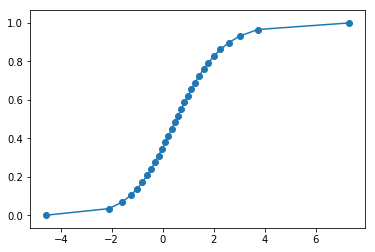

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -2.35620448354
NCOMPS 1
q minval is -2.35620448354
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 2
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2.44702502338
NCOMPS 1
q minval is -2

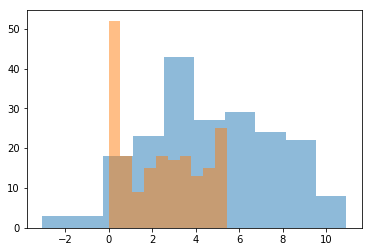

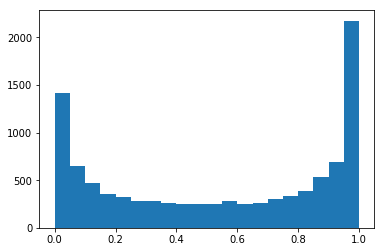

2 FACTORS
100 STUDENTS: [ 1.47] [ 2.98]
100 QUEST/NS: 4.912251219752389
Offset 0.53204746933
(100, 100, 1.471602781092715, 2.975293890582458, 0.53204746933021974, 4.912251219752389)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


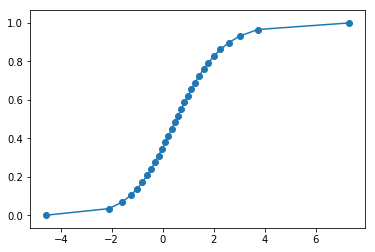

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.768313421805
NCOMPS 1
q minval is -0.826067213685
NCOMPS 2
q minval is -0.826067213685
NCOMPS 2
q minval is -1.12336572275
NCOMPS 1
q minval is -1.12336572275
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 1
q minval is -2.06159055137
NCOMPS 2
q minval is -2.06159055137
NCOMPS 2
q minval is -2.10123007025
NCOMPS 1
q minval is -2.10123007025
NCOMPS 2
q minval is

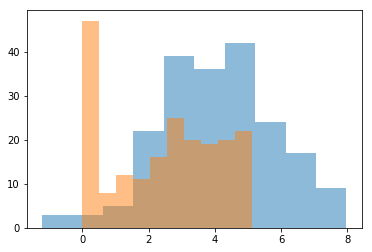

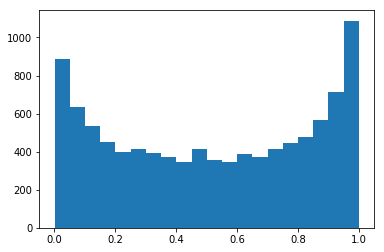

2 FACTORS
100 STUDENTS: [ 0.89] [ 1.68]
100 QUEST/NS: 4.304260440981684
Offset 0.53204746933
(100, 100, 0.8893644251445288, 1.6811965100186894, 0.53204746933021974, 4.304260440981684)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


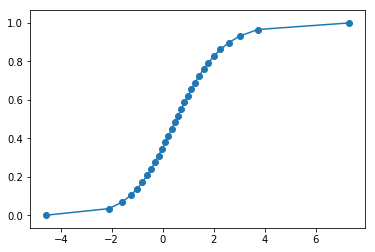

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.212066140298
NCOMPS 1
q minval is -0.212066140298
NCOMPS 1
q minval is -0.409441041567
NCOMPS 1
q minval is -0.409441041567
NCOMPS 2
q minval is -0.409441041567
NCOMPS 2
q minval is -0.479371013357
NCOMPS 2
q minval is -0.479371013357
NCOMPS 1
q minval is -0.479371013357
NCOMPS 1
q minval is -0.479371013357
NCOMPS 2
q minval is -0.479371013357
NCOMPS 1
q minval is -0.479371013357
NCOMPS 1
q minval is -0.479371013357
NCOMPS 1
q minval is -0.498324490776
NCOMPS 1
q minval is -0.498324490776
NCOMPS 2
q minval is -0.498324490776
NCOMPS 2
q minval is -0.498324490776
NCOMPS 1
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 1
q minval is -0.559833098469
NCOMPS 1
q minval is -0.559833098469
NCOMPS 2
q minval is -0.559833098469
NCOMPS 2
q minval is -0.5598330984

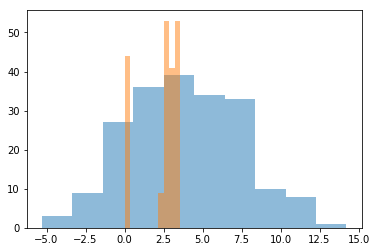

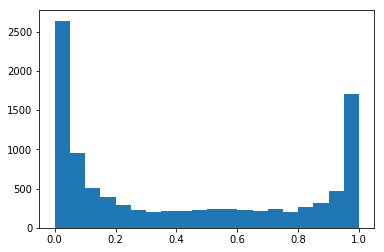

2 FACTORS
100 STUDENTS: [ 0.79] [ 3.47]
100 QUEST/NS: 1.1434882702472835
Offset 0.53204746933
(100, 100, 0.7918304520217401, 3.470756643326967, 0.53204746933021974, 1.1434882702472835)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


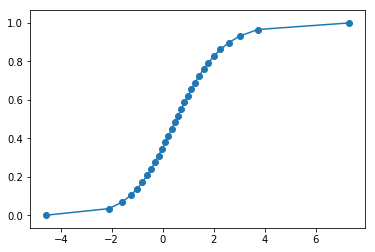

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -1.80961289252
NCOMPS 2
q minval is -1.80961289252
NCOMPS 2
q minval is -1.80961289252
NCOMPS 2
q minval is -1.80961289252
NCOMPS 2
q minval is -1.80961289252
NCOMPS 1
q minval is -1.80961289252
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 1
q minval is -2.27971880546
NCOMPS 2
q minval is -2.27971880546
NCOMPS 1
q minval is -2

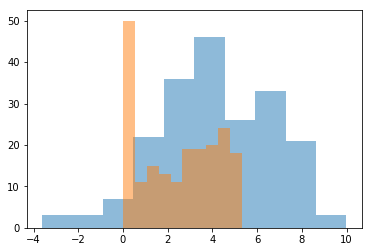

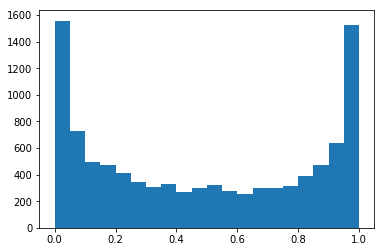

2 FACTORS
100 STUDENTS: [ 1.16] [ 2.43]
100 QUEST/NS: 4.76149189842549
Offset 0.53204746933
(100, 100, 1.157682149105881, 2.428603323652603, 0.53204746933021974, 4.76149189842549)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


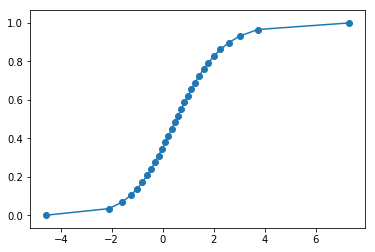

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.5764203446
NCOMPS 2
q minval is -1.5764203446
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 2
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 1
q minval is -2.07130533908
NCOMPS 2
q minval is -2.28069828361
NCOMPS 2
q minval is -2.2

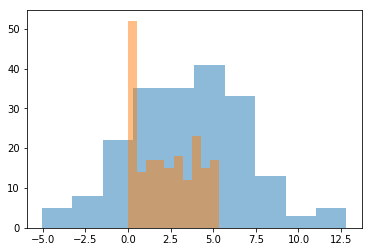

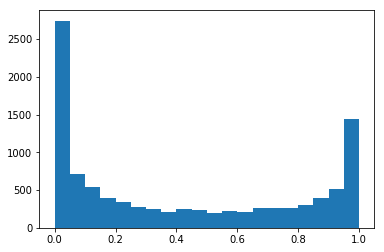

2 FACTORS
100 STUDENTS: [ 0.46] [ 3.31]
100 QUEST/NS: 4.736910838866237
Offset 0.53204746933
(100, 100, 0.46432345900704375, 3.308282390536007, 0.53204746933021974, 4.736910838866237)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


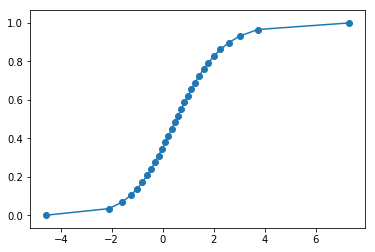

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.543744938159
NCOMPS 2
q minval is -0.144924822702
NCOMPS 1
q minval is -0.144924822702
NCOMPS 2
q minval is -0.315050618493
NCOMPS 2
q minval is -0.679610966268
NCOMPS 1
q minval is -0.679610966268
NCOMPS 1
q minval is -0.679610966268
NCOMPS 2
q minval is -0.679610966268
NCOMPS 2
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 2
q minval is -0.693984696915
NCOMPS 1
q minval is -0.693984696915
NCOMPS 2
q minval is -0.69398469691

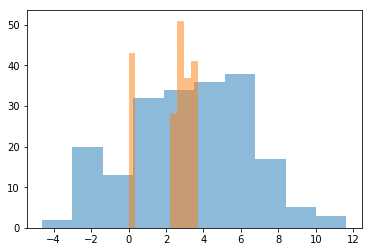

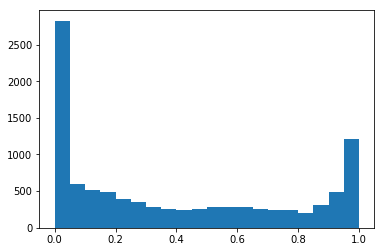

2 FACTORS
100 STUDENTS: [ 0.64] [ 3.28]
100 QUEST/NS: 1.4218427907249542
Offset 0.53204746933
(100, 100, 0.637652886058839, 3.2810004997264364, 0.53204746933021974, 1.4218427907249542)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


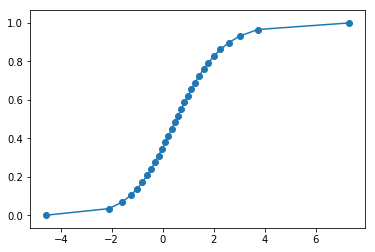

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.83907380214
NCOMPS 2
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 2
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 1
q minval is -1.83907380214
NCOMPS 2
q minval is -1.97260634969
NCOMPS 1
q minval is -1.97260634969
NCOMPS 2
q minval is -1.97260634969
NCOMPS 1
q minval is -1.97260634969
NCOMPS 2
q minval is -1.97260634969
NCOMPS 1
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 1
q minval is -2.0750495784
NCOMPS 2
q minval is -2.0750495784


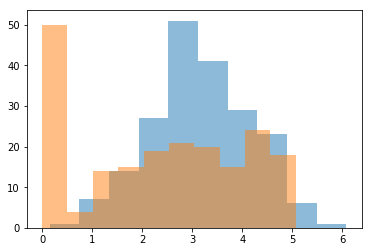

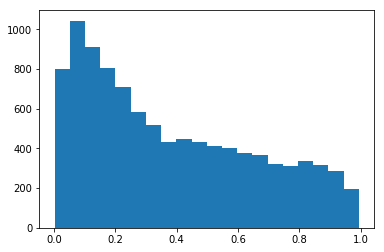

2 FACTORS
100 STUDENTS: [ 0.2] [ 1.03]
100 QUEST/NS: 4.152487153262674
Offset 0.53204746933
(100, 100, 0.19896525993699243, 1.0283844658888055, 0.53204746933021974, 4.152487153262674)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


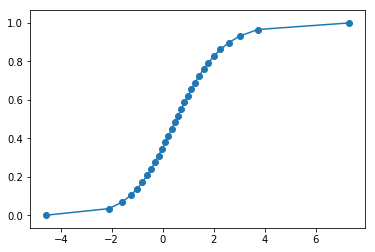

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.0661989402453
NCOMPS 1
q minval is -0.0661989402453
NCOMPS 1
q minval is -0.0661989402453
NCOMPS 1
q minval is -0.0842194892932
NCOMPS 2
q minval is -0.530444706446
NCOMPS 1
q minval is -0.530444706446
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 2
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678597814
NCOMPS 1
q minval is -0.909678

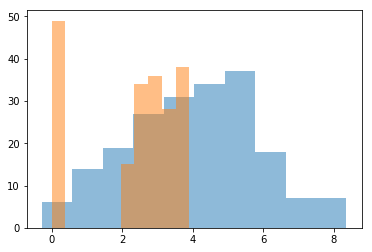

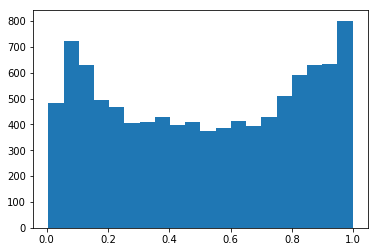

2 FACTORS
100 STUDENTS: [ 0.84] [ 1.88]
100 QUEST/NS: 1.834630577016495
Offset 0.53204746933
(100, 100, 0.8404919835430255, 1.8795183228635346, 0.53204746933021974, 1.834630577016495)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


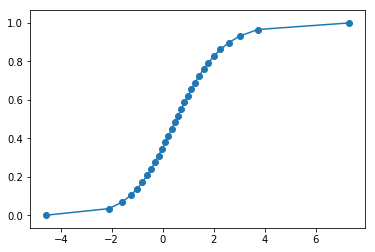

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.97731106975
NCOMPS 2
q minval is -0.97731106975
NCOMPS 1
q minval is -1.31198309684
NCOMPS 2
q minval is -1.31198309684
NCOMPS 1
q minval is -1.31198309684
NCOMPS 1
q minval is -1.31198309684
NCOMPS 2
q minval is -1.31198309684
NCOMPS 2
q minval is -1.31198309684
NCOMPS 2
q minval is -1.31198309684
NCOMPS 1
q minval is -1.60733184932
NCOMPS 1
q minval is -1.60733184932
NCOMPS 1
q minval is -1.60733184932
NCOMPS 1
q minval is -1.60733184932
NCOMPS 2
q minval is -1.60733184932
NCOMPS 1
q minval is -1.60733184932
NCOMPS 1
q minval is -1.60733184932
NCOMPS 1
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 1
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 1
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 1
q minval is -1.91963472014
NCOMPS 2
q minval is -1.91963472014
NCOMPS 2
q minval is -1

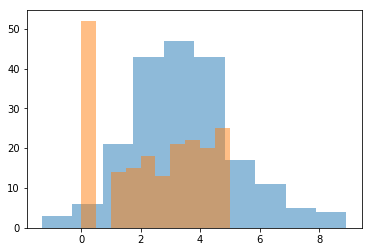

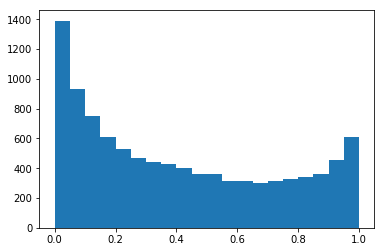

2 FACTORS
100 STUDENTS: [ 0.35] [ 1.65]
100 QUEST/NS: 4.004269536625586
Offset 0.53204746933
(100, 100, 0.352310235101304, 1.6538858772147864, 0.53204746933021974, 4.004269536625586)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


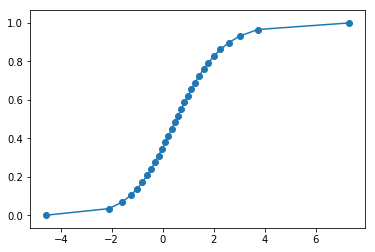

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.767215011155
NCOMPS 2
q minval is -0.767215011155
NCOMPS 2
q minval is -0.767215011155
NCOMPS 1
q minval is -0.767215011155
NCOMPS 2
q minval is -0.885212801575
NCOMPS 1
q minval is -0.885212801575
NCOMPS 2
q minval is -0.885212801575
NCOMPS 1
q minval is -0.885212801575
NCOMPS 1
q minval is -0.885212801575
NCOMPS 1
q minval is -0.885212801575
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 2
q minval is -0.921708504927
NCOMPS 1
q minval is -0.921708504927
NCOMPS 1
q minval is -0.9217085049

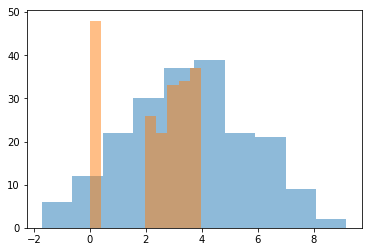

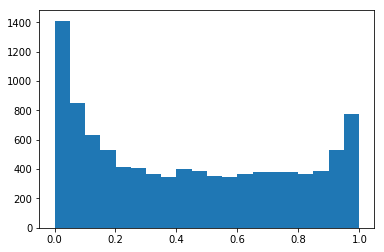

2 FACTORS
100 STUDENTS: [ 0.53] [ 1.97]
100 QUEST/NS: 1.926013577508542
Offset 0.53204746933
(100, 100, 0.529417583577247, 1.9702003737106546, 0.53204746933021974, 1.926013577508542)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


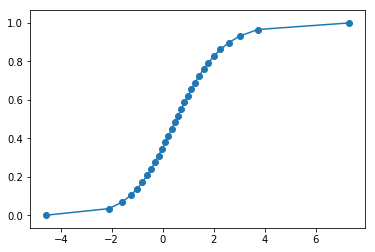

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.897601963491
NCOMPS 2
q minval is -0.860679966769
NCOMPS 2
q minval is -1.0607968295
NCOMPS 1
q minval is -1.0607968295
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 2
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 2
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 2
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 2
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 1
q minval is -1.85575230352
NCOMPS 2
q minval is -1.

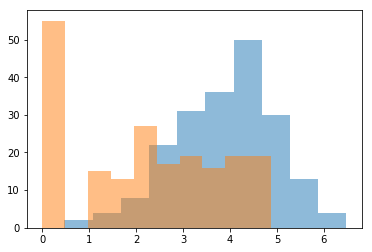

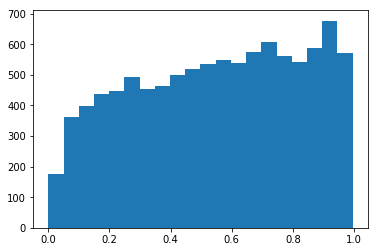

2 FACTORS
100 STUDENTS: [ 0.86] [ 1.07]
100 QUEST/NS: 3.7683062691537677
Offset 0.53204746933
(100, 100, 0.8616613259891654, 1.065143614205056, 0.53204746933021974, 3.7683062691537677)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


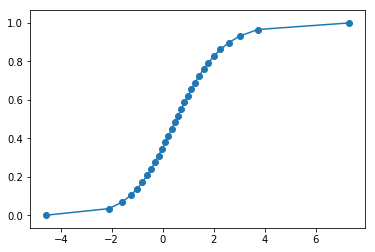

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.97788430813
NCOMPS 1
q minval is -1.97788430813
NCOMPS 1
q minval is -1.97788430813
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 1
q minval is -2.34341464427
NCOMPS 2
q minval is -2.34341464427
NCOMPS 2
q minval is -2

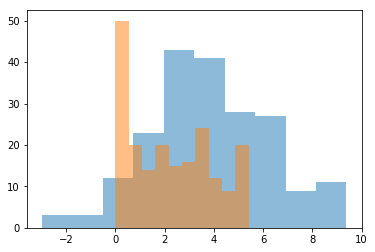

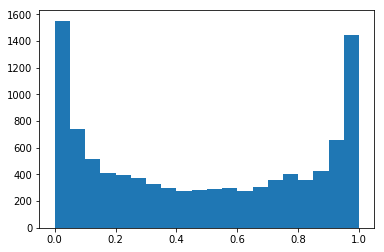

2 FACTORS
100 STUDENTS: [ 0.97] [ 2.39]
100 QUEST/NS: 4.991688752030308
Offset 0.53204746933
(100, 100, 0.9698324859190876, 2.3923012772697883, 0.53204746933021974, 4.991688752030308)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


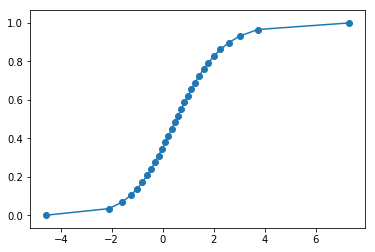

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.24877478689
NCOMPS 2
q minval is -0.380976099671
NCOMPS 1
q minval is -0.380976099671
NCOMPS 1
q minval is -0.461057098206
NCOMPS 1
q minval is -0.534345355882
NCOMPS 2
q minval is -0.534345355882
NCOMPS 1
q minval is -0.534345355882
NCOMPS 1
q minval is -0.534345355882
NCOMPS 1
q minval is -0.534345355882
NCOMPS 2
q minval is -0.534345355882
NCOMPS 1
q minval is -0.534345355882
NCOMPS 2
q minval is -0.534345355882
NCOMPS 1
q minval is -0.534345355882
NCOMPS 2
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 1
q minval is -0.549781432971
NCOMPS 1
q minval is -0.549781432971
NCOMPS 1
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 1
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 2
q minval is -0.549781432971
NCOMPS 1
q minval is -0.549781432971
NCOMPS 2
q minval is -0.57050169860

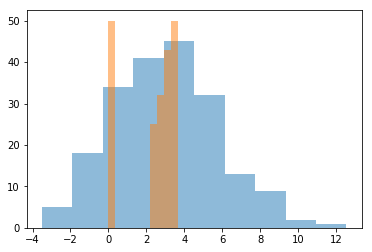

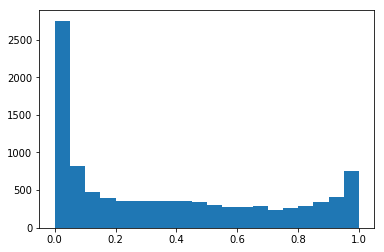

2 FACTORS
100 STUDENTS: [ 0.05] [ 2.65]
100 QUEST/NS: 1.3041695713659922
Offset 0.53204746933
(100, 100, 0.05453723852103759, 2.6522079930469973, 0.53204746933021974, 1.3041695713659922)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


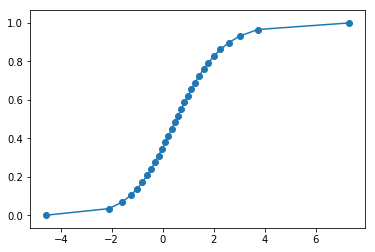

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.267981382561
NCOMPS 1
q minval is -0.267981382561
NCOMPS 1
q minval is -0.267981382561
NCOMPS 1
q minval is -0.267981382561
NCOMPS 1
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 1
q minval is -0.31715832108
NCOMPS 2
q minval is -0.31715832108
NCOMPS 2
q minval is -0.318499569377
NCOMPS 2
q minval is -0.318499569377
NCOMPS 1
q minval is -0.318499569377
NCOMPS 1
q minva

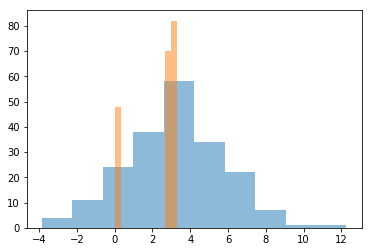

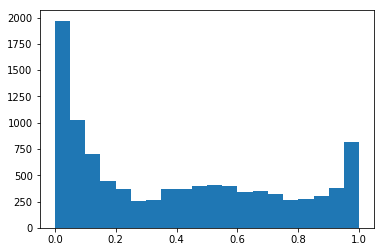

2 FACTORS
100 STUDENTS: [ 0.21] [ 2.37]
100 QUEST/NS: 0.644954197157449
Offset 0.53204746933
(100, 100, 0.20820034921556685, 2.3721494645855277, 0.53204746933021974, 0.644954197157449)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


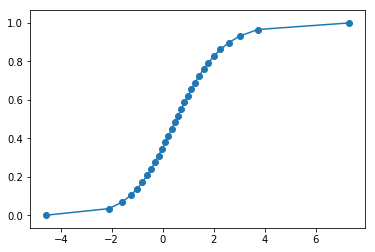

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.0759355117225
NCOMPS 2
q minval is -0.74955348038
NCOMPS 2
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 1
q minval is -0.852863137279
NCOMPS 2
q minval is -0.852863137279
NCOMPS 2
q minval is -0.990658219083
NCOMPS 1
q minval is -0.990658219083
NCOMPS 2
q minval is -0.990658219083
NCOMPS 1
q minval is -0.990658219083
NCOMPS 2
q minval is -0.990658219083
NCOMPS 2
q minval is -0.990658219083
NCOMPS 1
q minval is -0.990658219083
NCOMPS 1
q minval is -0.99065821908

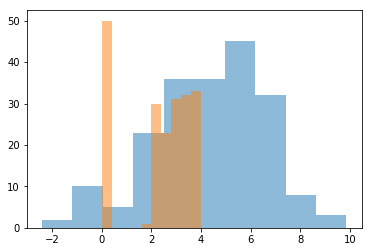

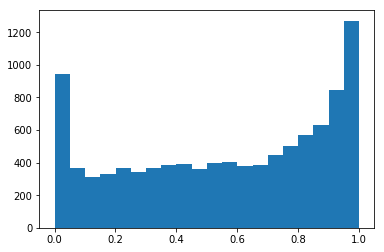

2 FACTORS
100 STUDENTS: [ 0.96] [ 2.19]
100 QUEST/NS: 2.040830630020139
Offset 0.53204746933
(100, 100, 0.9631929293155603, 2.1888820014376953, 0.53204746933021974, 2.040830630020139)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


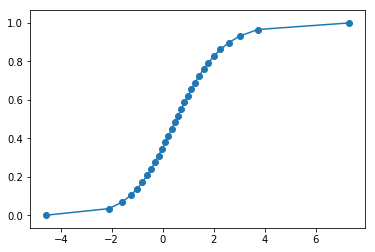

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 2
q minval is -0.671644275016
NCOMPS 1
q minval is -0.671644275016
NCOMPS 1
q minval is -0.6716442750

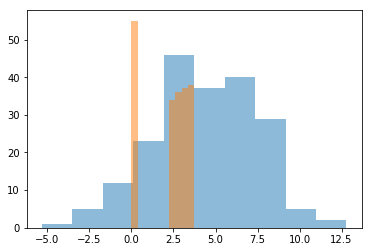

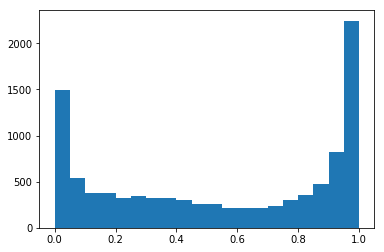

2 FACTORS
100 STUDENTS: [ 1.32] [ 3.06]
100 QUEST/NS: 1.4845049817162463
Offset 0.53204746933
(100, 100, 1.3165039816490351, 3.061650170946433, 0.53204746933021974, 1.4845049817162463)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


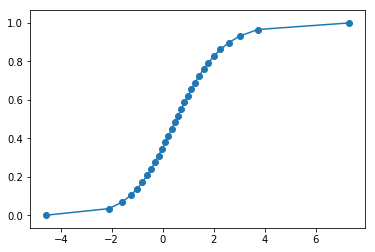

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.766898494549
NCOMPS 2
q minval is -0.766898494549
NCOMPS 1
q minval is -0.766898494549
NCOMPS 2
q minval is -0.766898494549
NCOMPS 1
q minval is -0.766898494549
NCOMPS 2
q minval is -0.766898494549
NCOMPS 2
q minval is -0.766898494549
NCOMPS 1
q minval is -0.766898494549
NCOMPS 1
q minval is -0.766898494549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 1
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 2
q minval is -0.783939491549
NCOMPS 2
q minval is -0.7839394915

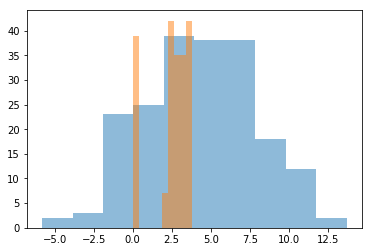

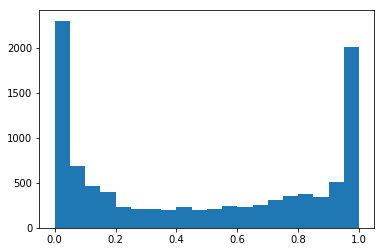

2 FACTORS
100 STUDENTS: [ 1.33] [ 3.48]
100 QUEST/NS: 1.5692791595954922
Offset 0.53204746933
(100, 100, 1.327690508456444, 3.479775925923571, 0.53204746933021974, 1.5692791595954922)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


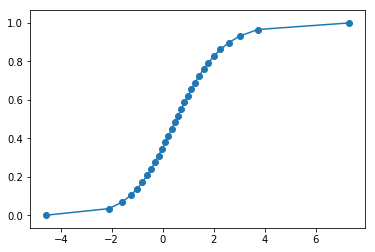

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.0703678669773
NCOMPS 1
q minval is -0.00331976860518
NCOMPS 2
q minval is -0.00331976860518
NCOMPS 2
q minval is -0.249953486583
NCOMPS 1
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 1
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715872655
NCOMPS 2
q minval is -0.306715

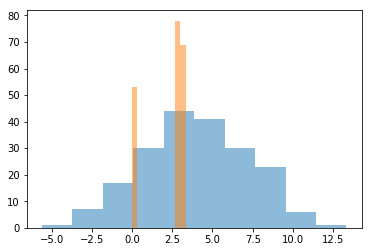

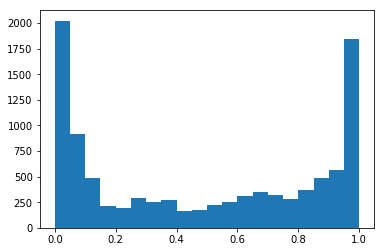

2 FACTORS
100 STUDENTS: [ 1.35] [ 3.48]
100 QUEST/NS: 0.6599976460550017
Offset 0.53204746933
(100, 100, 1.3455972398789136, 3.4832376089978796, 0.53204746933021974, 0.6599976460550017)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


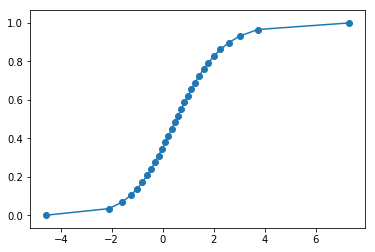

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.0412409713214
NCOMPS 2
q minval is -1.31825344623
NCOMPS 2
q minval is -1.31825344623
NCOMPS 1
q minval is -1.31825344623
NCOMPS 1
q minval is -1.31825344623
NCOMPS 2
q minval is -1.31825344623
NCOMPS 2
q minval is -1.31825344623
NCOMPS 2
q minval is -1.31825344623
NCOMPS 2
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 2
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 2
q minval is -1.85626907628
NCOMPS 2
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 2
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 1
q minval is -1.85626907628
NCOMPS 1
q minval is -2.26516290679
NCOMPS 1
q minval is -2.26516290679
NCOMPS 2
q minval is -2.26516290679
NCOMPS 2
q minval is -2.26516290679
NCOMPS 2
q minval is -2.26516290679
NCOMPS 2
q minval is -2.26516290679
NCOMPS 2
q minval is 

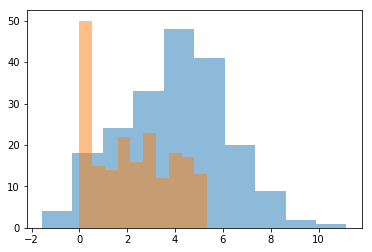

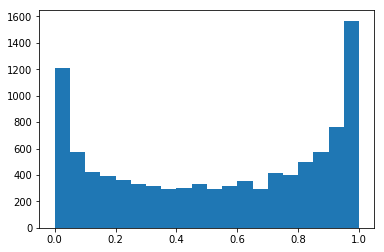

2 FACTORS
100 STUDENTS: [ 1.25] [ 2.27]
100 QUEST/NS: 4.844519158323378
Offset 0.53204746933
(100, 100, 1.2494697632433207, 2.2723532315943316, 0.53204746933021974, 4.844519158323378)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


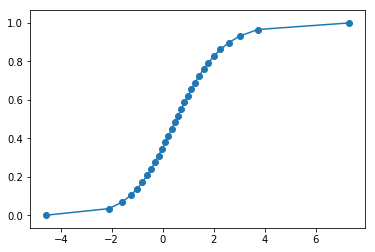

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 2
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 1
q minval is -0.40400158221
NCOMPS 2
q minval is -0

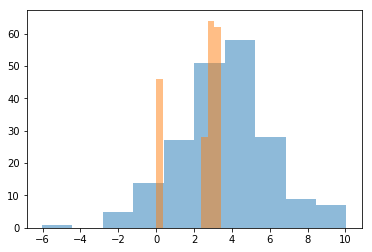

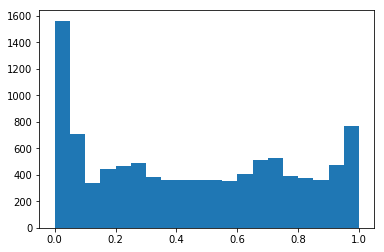

2 FACTORS
100 STUDENTS: [ 0.53] [ 2.65]
100 QUEST/NS: 0.8458914941390527
Offset 0.53204746933
(100, 100, 0.5265168353146716, 2.646415727327682, 0.53204746933021974, 0.8458914941390527)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


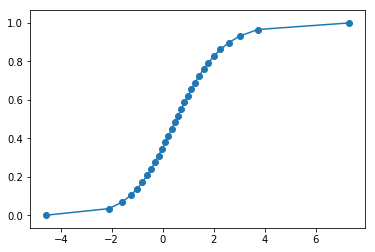

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.832313345419
NCOMPS 1
q minval is 0.658012298498
NCOMPS 1
q minval is 0.658012298498
NCOMPS 1
q minval is -0.421726733301
NCOMPS 1
q minval is -0.421726733301
NCOMPS 2
q minval is -0.955114934994
NCOMPS 1
q minval is -0.955114934994
NCOMPS 2
q minval is -0.955114934994
NCOMPS 2
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 1
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 2
q minval is -1.40775060971
NCOMPS 1
q minval 

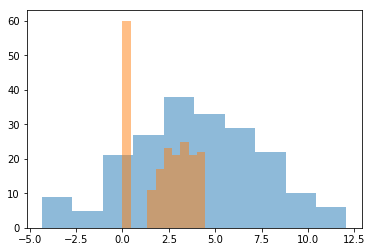

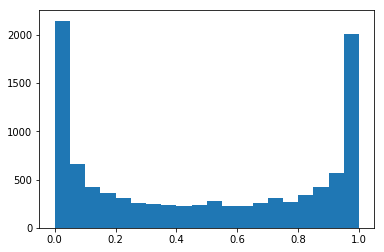

2 FACTORS
100 STUDENTS: [ 1.43] [ 3.42]
100 QUEST/NS: 2.941764443236189
Offset 0.53204746933
(100, 100, 1.4288799756438344, 3.419577647890604, 0.53204746933021974, 2.941764443236189)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


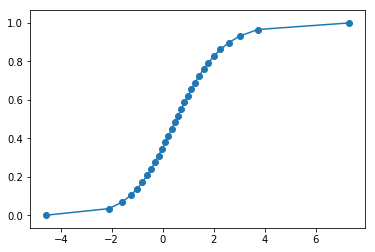

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.338048351315
NCOMPS 2
q minval is -1.09094253564
NCOMPS 2
q minval is -1.09094253564
NCOMPS 2
q minval is -1.09094253564
NCOMPS 2
q minval is -1.09094253564
NCOMPS 1
q minval is -1.09094253564
NCOMPS 1
q minval is -1.09094253564
NCOMPS 2
q minval is -1.09094253564
NCOMPS 2
q minval is -1.21858164341
NCOMPS 2
q minval is -1.21858164341
NCOMPS 1
q minval is -1.21858164341
NCOMPS 2
q minval is -1.21858164341
NCOMPS 2
q minval is -1.21858164341
NCOMPS 1
q minval is -1.21858164341
NCOMPS 2
q minval is -1.21858164341
NCOMPS 2
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 2
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 2
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 2
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 1
q minval is -1.24472009186
NCOMPS 1
q minval is -1

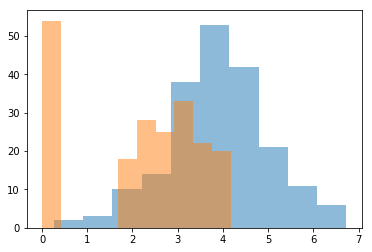

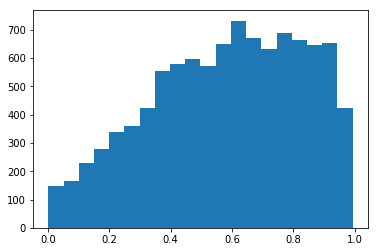

2 FACTORS
100 STUDENTS: [ 0.89] [ 1.09]
100 QUEST/NS: 2.5223267112615515
Offset 0.53204746933
(100, 100, 0.8894071241913948, 1.0931050010474046, 0.53204746933021974, 2.5223267112615515)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


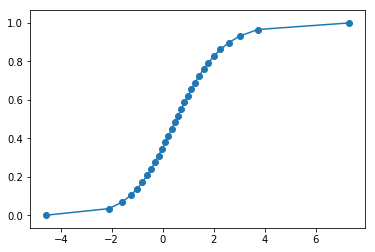

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.185374736463
NCOMPS 2
q minval is -0.185374736463
NCOMPS 2
q minval is -0.186839820886
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 2
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 1
q minval is -0.456972352081
NCOMPS 1
q minval is -0.4569723520

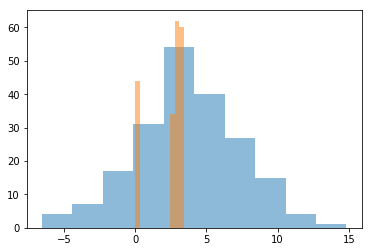

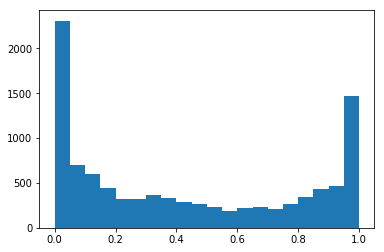

2 FACTORS
100 STUDENTS: [ 0.54] [ 3.29]
100 QUEST/NS: 0.919821564898909
Offset 0.53204746933
(100, 100, 0.541415256159862, 3.288120905988823, 0.53204746933021974, 0.919821564898909)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


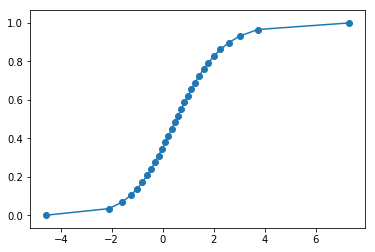

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.872634056013
NCOMPS 2
q minval is -0.872634056013
NCOMPS 2
q minval is -0.872634056013
NCOMPS 1
q minval is -0.872634056013
NCOMPS 1
q minval is -0.872634056013
NCOMPS 1
q minval is -1.04731715202
NCOMPS 1
q minval is -1.04731715202
NCOMPS 1
q minval is -1.04731715202
NCOMPS 2
q minval is -1.04731715202
NCOMPS 1
q minval is -1.04731715202
NCOMPS 1
q minval is -1.04731715202
NCOMPS 2
q minval is -1.04731715202
NCOMPS 1
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 1
q minval is -1.39226650404
NCOMPS 1
q minval is -1.39226650404
NCOMPS 1
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 1
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 1
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 2
q minval is -1.39226650404
NCOMPS 1
q minval 

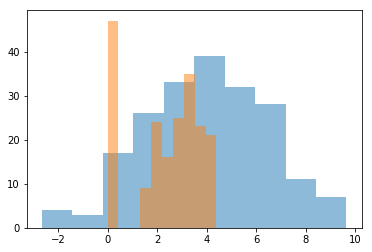

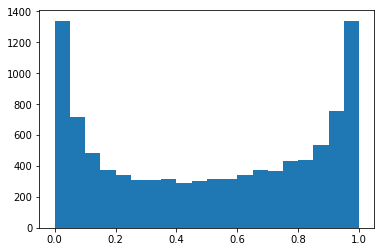

2 FACTORS
100 STUDENTS: [ 1.13] [ 2.34]
100 QUEST/NS: 2.7977954304704244
Offset 0.53204746933
(100, 100, 1.1269911119139164, 2.344540733962221, 0.53204746933021974, 2.7977954304704244)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


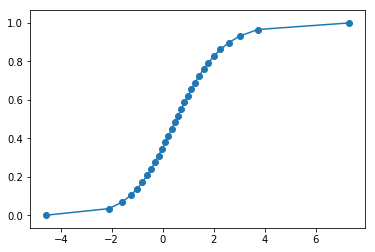

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.112404797981
NCOMPS 2
q minval is -0.112404797981
NCOMPS 1
q minval is -0.112404797981
NCOMPS 1
q minval is -0.112404797981
NCOMPS 2
q minval is -0.265797848183
NCOMPS 1
q minval is -0.265797848183
NCOMPS 1
q minval is -0.265797848183
NCOMPS 2
q minval is -0.265797848183
NCOMPS 1
q minval is -0.265797848183
NCOMPS 1
q minval is -0.265797848183
NCOMPS 2
q minval is -0.312793514555
NCOMPS 1
q minval is -0.312793514555
NCOMPS 1
q minval is -0.312793514555
NCOMPS 1
q minval is -0.312793514555
NCOMPS 2
q minval is -0.312793514555
NCOMPS 2
q minval is -0.312793514555
NCOMPS 2
q minval is -0.312793514555
NCOMPS 1
q minval is -0.312793514555
NCOMPS 1
q minval is -0.312793514555
NCOMPS 2
q minval is -0.312793514555
NCOMPS 2
q minval is -0.312793514555
NCOMPS 2
q minval is -0.340847502968
NCOMPS 2
q minval is -0.340847502968
NCOMPS 2
q minval is -0.410690531691
NCOMPS 2
q minval is -0.410690531691
NCOMPS 2
q minval is -0.4106905316

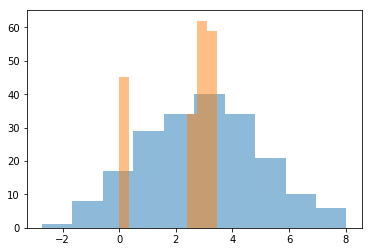

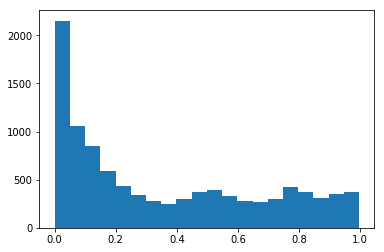

2 FACTORS
100 STUDENTS: [ 0.12] [ 2.45]
100 QUEST/NS: 0.898120514695528
Offset 0.53204746933
(100, 100, 0.11615806150917707, 2.4502853169345933, 0.53204746933021974, 0.898120514695528)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


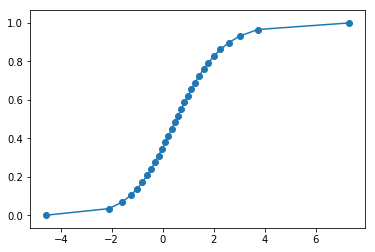

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.343584322435
NCOMPS 1
q minval is -0.240893866689
NCOMPS 1
q minval is -0.240893866689
NCOMPS 1
q minval is -0.446043179233
NCOMPS 1
q minval is -0.446043179233
NCOMPS 2
q minval is -1.11740818188
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 1
q minval is -1.22420531404
NCOMPS 2
q minval i

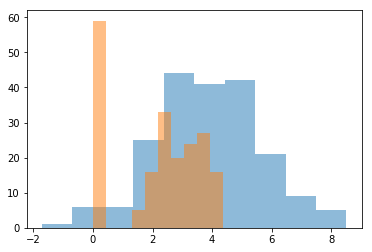

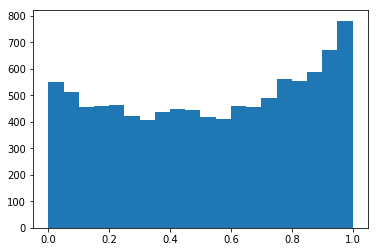

2 FACTORS
100 STUDENTS: [ 0.85] [ 1.65]
100 QUEST/NS: 2.7723361662201564
Offset 0.53204746933
(100, 100, 0.8504665322201779, 1.6499849311538395, 0.53204746933021974, 2.7723361662201564)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


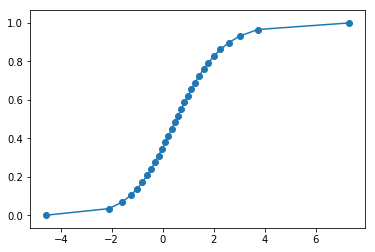

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.346472634237
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 2
q minval is -1.17226520547
NCOMPS 1
q minval is -1.17226520547
NCOMPS 1
q minval is -1.18188305085
NCOMPS 2
q minval is -1.18188305085
NCOMPS 1
q minval is -

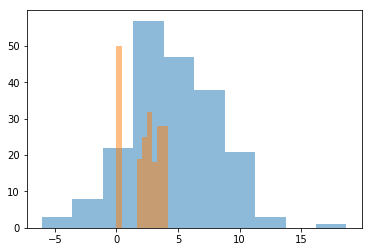

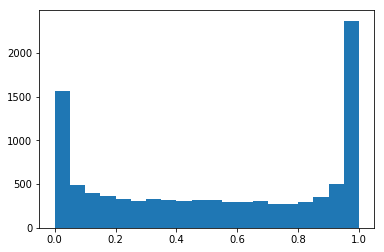

2 FACTORS
100 STUDENTS: [ 1.32] [ 3.5]
100 QUEST/NS: 2.373996899543668
Offset 0.53204746933
(100, 100, 1.3187587915679284, 3.4978940615788536, 0.53204746933021974, 2.373996899543668)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


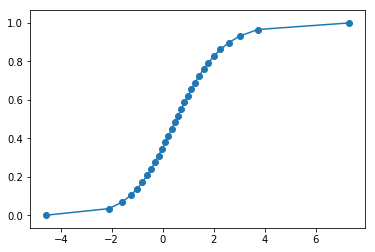

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.00861814471849
NCOMPS 2
q minval is -0.0228736333513
NCOMPS 2
q minval is -0.0228736333513
NCOMPS 2
q minval is -0.560307898981
NCOMPS 1
q minval is -0.560307898981
NCOMPS 1
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 2
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 1
q minval is -0.650040678421
NCOMPS 1
q minval is -0.657676267823
NCOMPS 2
q minval is -0.657676267823
NCOMPS 1
q minval is -0.657676267823
NCOMPS 2
q minval is -0.6576762

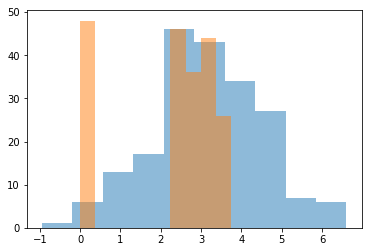

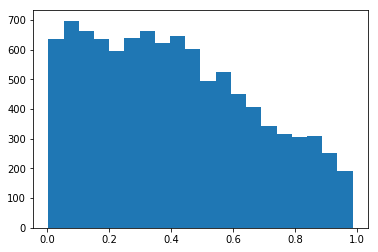

2 FACTORS
100 STUDENTS: [ 0.24] [ 1.51]
100 QUEST/NS: 1.4769654294288204
Offset 0.53204746933
(100, 100, 0.2385983980120036, 1.5102763925143172, 0.53204746933021974, 1.4769654294288204)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


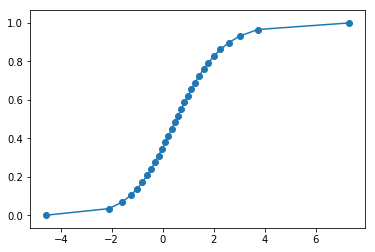

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.274422509173
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 2
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.414153850683
NCOMPS 1
q minval is -0.41415385068

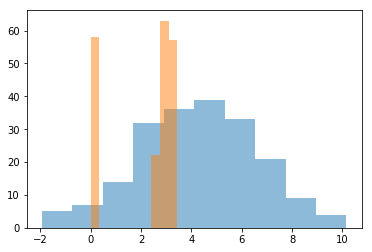

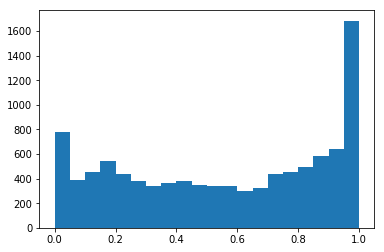

2 FACTORS
100 STUDENTS: [ 1.36] [ 2.65]
100 QUEST/NS: 0.8934883088421951
Offset 0.53204746933
(100, 100, 1.3616867038847127, 2.6522170442293658, 0.53204746933021974, 0.8934883088421951)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


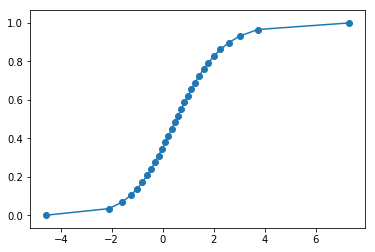

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.307153010462
NCOMPS 2
q minval is 0.307153010462
NCOMPS 1
q minval is 0.307153010462
NCOMPS 1
q minval is -0.767260385462
NCOMPS 1
q minval is -0.767260385462
NCOMPS 1
q minval is -0.767260385462
NCOMPS 1
q minval is -0.767260385462
NCOMPS 2
q minval is -0.767260385462
NCOMPS 1
q minval is -0.767260385462
NCOMPS 1
q minval is -0.848708741382
NCOMPS 2
q minval is -0.848708741382
NCOMPS 1
q minval is -0.848708741382
NCOMPS 2
q minval is -0.848708741382
NCOMPS 1
q minval is -0.848708741382
NCOMPS 2
q minval is -0.848708741382
NCOMPS 1
q minval is -1.30941606236
NCOMPS 1
q minval is -1.30941606236
NCOMPS 1
q minval is -1.90780800739
NCOMPS 2
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval is -2.2360155681
NCOMPS 1
q minval i

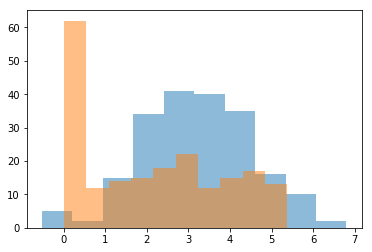

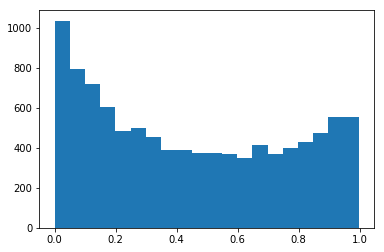

2 FACTORS
100 STUDENTS: [ 0.19] [ 1.26]
100 QUEST/NS: 4.776137874421405
Offset 0.53204746933
(100, 100, 0.18903030467823068, 1.2616151714016526, 0.53204746933021974, 4.776137874421405)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


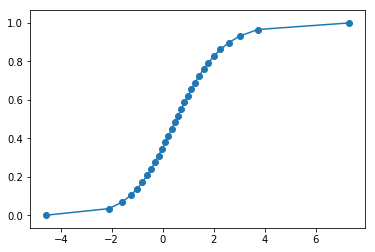

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 2
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 2
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 2
q minval is -1.54591536813
NCOMPS 2
q minval is -1.54591536813
NCOMPS 2
q minval is -1.54591536813
NCOMPS 1
q minval is -1.54591536813
NCOMPS 2
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 1
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 2
q minval is -1.68328877712
NCOMPS 1
q minval is -1

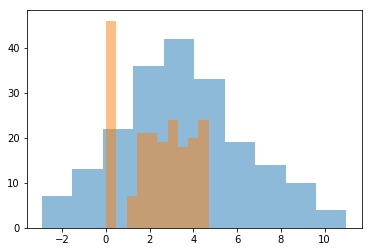

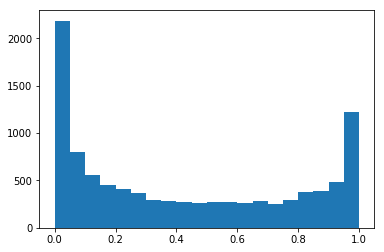

2 FACTORS
100 STUDENTS: [ 0.19] [ 2.57]
100 QUEST/NS: 3.408062077094443
Offset 0.53204746933
(100, 100, 0.19370474267062188, 2.574302130345278, 0.53204746933021974, 3.408062077094443)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


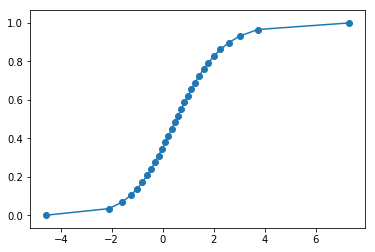

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.529750260486
NCOMPS 1
q minval is 0.455133471249
NCOMPS 2
q minval is -0.179820739444
NCOMPS 1
q minval is -0.179820739444
NCOMPS 2
q minval is -0.179820739444
NCOMPS 2
q minval is -0.179820739444
NCOMPS 1
q minval is -0.179820739444
NCOMPS 1
q minval is -0.179820739444
NCOMPS 2
q minval is -1.72272314023
NCOMPS 2
q minval is -1.76694242875
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 2
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 1
q minval is -2.01835708385
NCOMPS 2
q minval

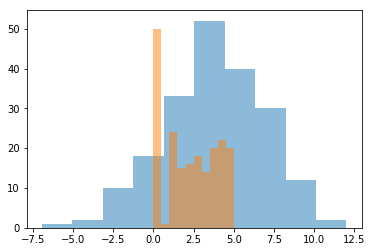

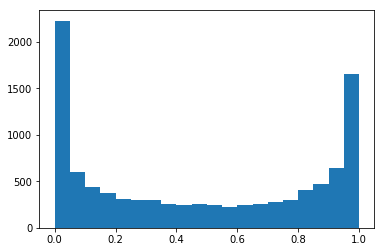

2 FACTORS
100 STUDENTS: [ 0.67] [ 3.33]
100 QUEST/NS: 4.037108260945269
Offset 0.53204746933
(100, 100, 0.6675122908775686, 3.329044510814398, 0.53204746933021974, 4.037108260945269)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


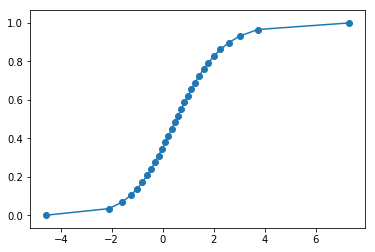

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.358563337437
NCOMPS 1
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 1
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 1
q minval is -0.358563337437
NCOMPS 1
q minval is -0.358563337437
NCOMPS 2
q minval is -0.358563337437
NCOMPS 1
q minval is -0.358563337437
NCOMPS 2
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 2
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 1
q minval is -0.385776182391
NCOMPS 1
q minval is -0.3857761823

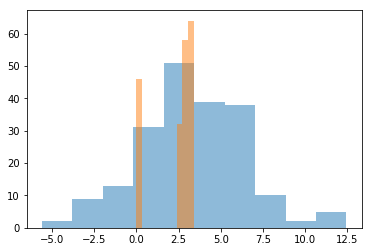

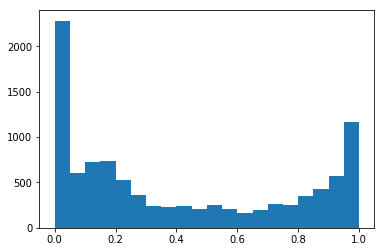

2 FACTORS
100 STUDENTS: [ 0.7] [ 3.37]
100 QUEST/NS: 0.8319557303189797
Offset 0.53204746933
(100, 100, 0.7020841994656999, 3.36594578155418, 0.53204746933021974, 0.8319557303189797)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


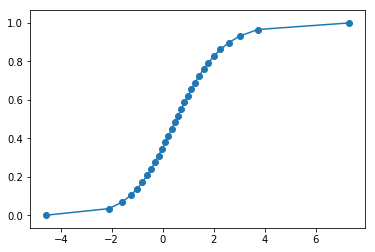

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.735290034144
NCOMPS 1
q minval is -0.735290034144
NCOMPS 2
q minval is -0.735290034144
NCOMPS 2
q minval is -1.2732663703
NCOMPS 1
q minval is -1.2732663703
NCOMPS 1
q minval is -1.2732663703
NCOMPS 2
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 1
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 2
q minval is -1.29791656736
NCOMPS 1
q minval is -1

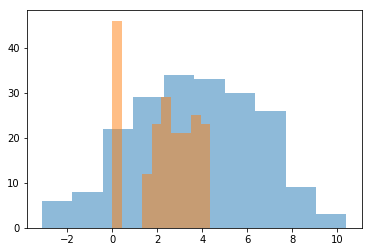

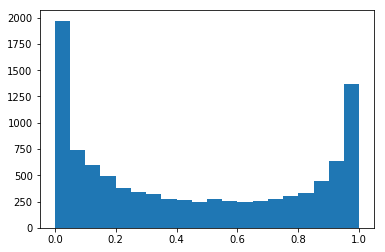

2 FACTORS
100 STUDENTS: [ 0.52] [ 2.84]
100 QUEST/NS: 2.80305096120618
Offset 0.53204746933
(100, 100, 0.5172738743223377, 2.8386169423524668, 0.53204746933021974, 2.80305096120618)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


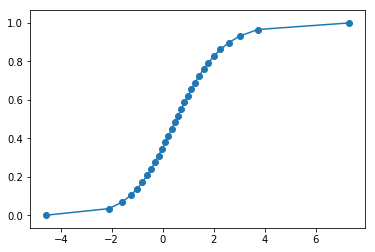

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.136461725325
NCOMPS 2
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 1
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 2
q minval is -0.290871945634
NCOMPS 2
q minval is -0.2908719456

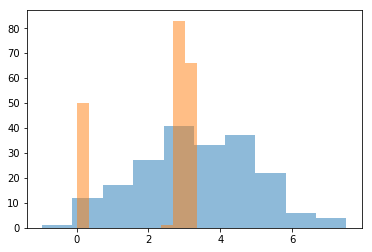

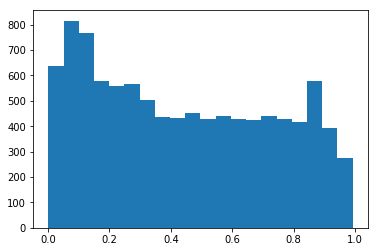

2 FACTORS
100 STUDENTS: [ 0.45] [ 1.65]
100 QUEST/NS: 0.6823882485190271
Offset 0.53204746933
(100, 100, 0.44875771039286505, 1.651154345172965, 0.53204746933021974, 0.6823882485190271)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


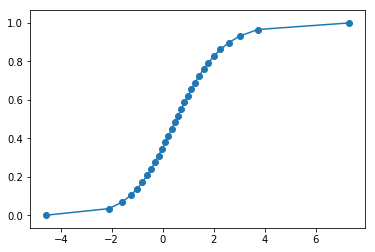

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.863948053826
NCOMPS 2
q minval is -0.863948053826
NCOMPS 2
q minval is -1.23531526801
NCOMPS 2
q minval is -1.73283123876
NCOMPS 2
q minval is -1.91629290248
NCOMPS 1
q minval is -1.91629290248
NCOMPS 2
q minval is -1.91629290248
NCOMPS 1
q minval is -1.91629290248
NCOMPS 1
q minval is -1.91629290248
NCOMPS 1
q minval is -1.91629290248
NCOMPS 2
q minval is -2.33805285535
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 1
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is -2.45804504954
NCOMPS 2
q minval is 

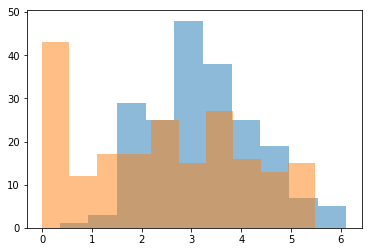

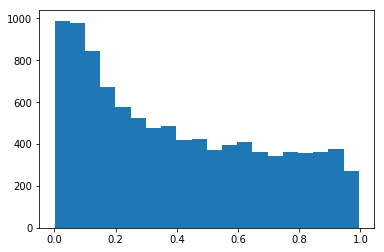

2 FACTORS
100 STUDENTS: [ 0.24] [ 1.05]
100 QUEST/NS: 4.9813068192145105
Offset 0.53204746933
(100, 100, 0.239794538837102, 1.0516152047747647, 0.53204746933021974, 4.9813068192145105)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


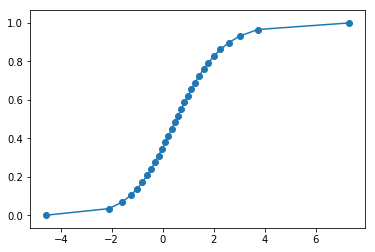

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.0797921747065
NCOMPS 1
q minval is -0.934515755909
NCOMPS 1
q minval is -0.934515755909
NCOMPS 2
q minval is -0.934515755909
NCOMPS 2
q minval is -0.934515755909
NCOMPS 1
q minval is -0.934515755909
NCOMPS 1
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 2
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 1
q minval is -1.4802122429
NCOMPS 2
q minval is -1.76192045275
NCOMPS 1
q minval is -1.76192045275
NCOMPS 1
q minval is -1.76192045275
NCOMPS 2
q minval is -1.76192045275
NCOMPS 1
q minval is -1.76192045275
NCOMPS 1
q minval is -1.76192045275
NCOMPS 1
q minval is -1.761920

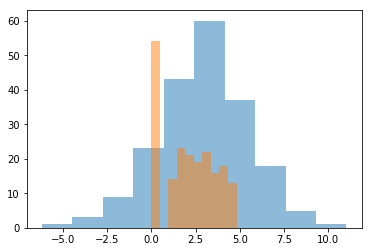

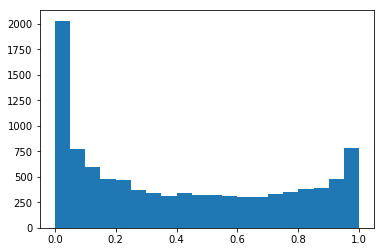

2 FACTORS
100 STUDENTS: [ 0.09] [ 2.49]
100 QUEST/NS: 3.7241638092107503
Offset 0.53204746933
(100, 100, 0.08688506251087613, 2.4890492538888824, 0.53204746933021974, 3.7241638092107503)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


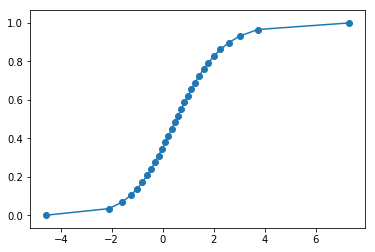

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.215526586
NCOMPS 2
q minval is -1.46073505456
NCOMPS 2
q minval is -1.46073505456
NCOMPS 1
q minval is -1.46073505456
NCOMPS 1
q minval is -1.46073505456
NCOMPS 2
q minval is -1.46073505456
NCOMPS 1
q minval is -1.46073505456
NCOMPS 1
q minval is -1.46073505456
NCOMPS 1
q minval is -1.46073505456
NCOMPS 2
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 1
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 1
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 1
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 1
q minval is -1.87874778738
NCOMPS 2
q minval is -1.87874778738
NCOMPS 2
q minval is -1.95816033664
NCOMPS 1
q minval is -1.95816033664
NCOMPS 2
q minval is -1.95816033664
NCOMPS 2
q minval is -1.95816033664
NCOMPS 1
q minval is -1.95

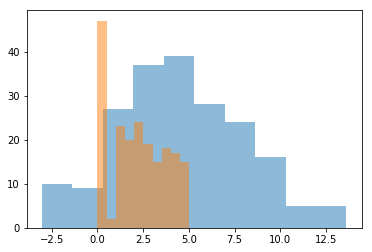

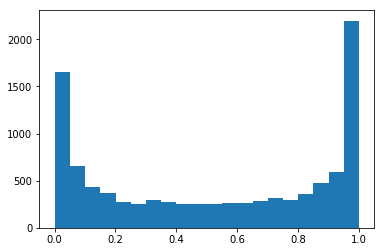

2 FACTORS
100 STUDENTS: [ 1.51] [ 3.38]
100 QUEST/NS: 4.1698676585250265
Offset 0.53204746933
(100, 100, 1.5101048523563618, 3.3845217478216356, 0.53204746933021974, 4.1698676585250265)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


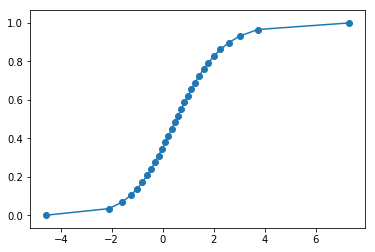

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.359205673161
NCOMPS 2
q minval is -0.799747504912
NCOMPS 2
q minval is -0.799747504912
NCOMPS 1
q minval is -0.799747504912
NCOMPS 2
q minval is -0.799747504912
NCOMPS 1
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -0.998543231487
NCOMPS 1
q minval is -0.998543231487
NCOMPS 2
q minval is -1.01453156198
NCOMPS 1
q minval is -1.01453156198
NCOMPS 2
q minval is -1.01453156198
NCOMPS 1
q minval is -1.01453156198
NCOMPS 1
q minval is -1.01453156198
NC

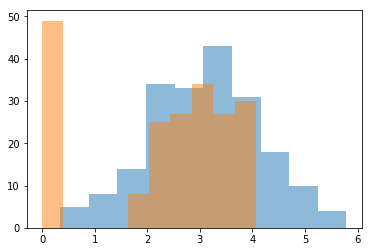

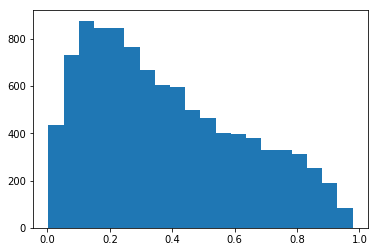

2 FACTORS
100 STUDENTS: [ 0.06] [ 1.04]
100 QUEST/NS: 2.1437060683920146
Offset 0.53204746933
(100, 100, 0.05500060165583309, 1.0360863244975043, 0.53204746933021974, 2.1437060683920146)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


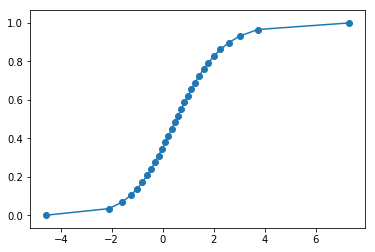

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.21540264707
NCOMPS 2
q minval is -0.222347337823
NCOMPS 2
q minval is -0.222347337823
NCOMPS 2
q minval is -0.222347337823
NCOMPS 2
q minval is -0.222347337823
NCOMPS 1
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 1
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362
NCOMPS 2
q minval is -0.279766318362

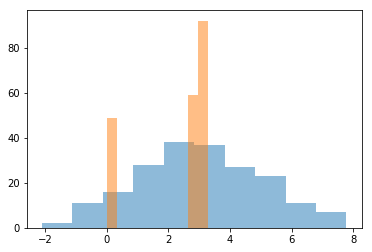

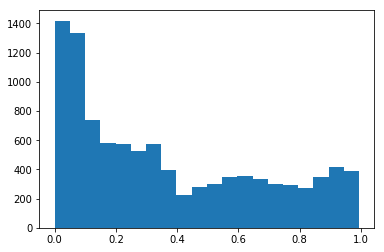

2 FACTORS
100 STUDENTS: [ 0.11] [ 2.]
100 QUEST/NS: 0.5693795568429554
Offset 0.53204746933
(100, 100, 0.10959403159677211, 2.0046824402519245, 0.53204746933021974, 0.5693795568429554)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


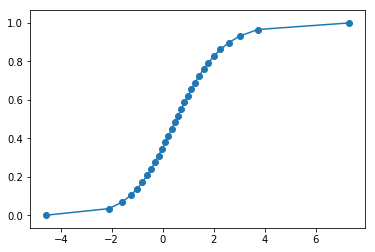

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.73078094057
NCOMPS 2
q minval is -0.73078094057
NCOMPS 2
q minval is -0.73078094057
NCOMPS 1
q minval is -0.73078094057
NCOMPS 1
q minval is -0.73078094057
NCOMPS 1
q minval is -0.73078094057
NCOMPS 2
q minval is -0.73078094057
NCOMPS 1
q minval is -0.73078094057
NCOMPS 1
q minval is -0.73078094057
NCOMPS 2
q minval is -0.73078094057
NCOMPS 2
q minval is -0.73078094057
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 2
q minval is -0.822920233537
NCOMPS 1

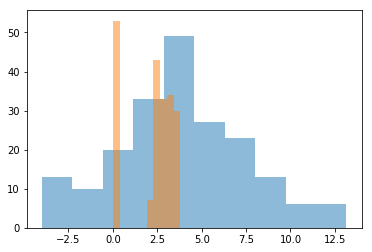

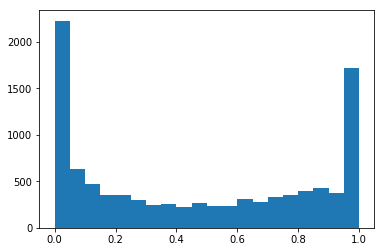

2 FACTORS
100 STUDENTS: [ 0.57] [ 3.44]
100 QUEST/NS: 1.6569966393441946
Offset 0.53204746933
(100, 100, 0.5739811645083919, 3.4395536444218804, 0.53204746933021974, 1.6569966393441946)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


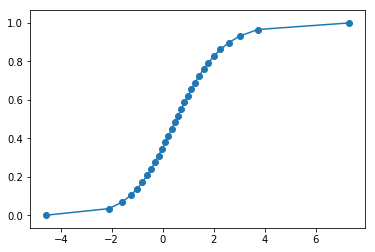

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.346170397947
NCOMPS 1
q minval is -0.346170397947
NCOMPS 2
q minval is -0.346170397947
NCOMPS 2
q minval is -0.411898760266
NCOMPS 2
q minval is -0.527110056074
NCOMPS 1
q minval is -0.527110056074
NCOMPS 1
q minval is -0.527110056074
NCOMPS 2
q minval is -0.566697794826
NCOMPS 2
q minval is -0.566697794826
NCOMPS 1
q minval is -0.566697794826
NCOMPS 2
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 2
q minval is -0.675611323467
NCOMPS 2
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.675611323467
NCOMPS 1
q minval is -0.6756113234

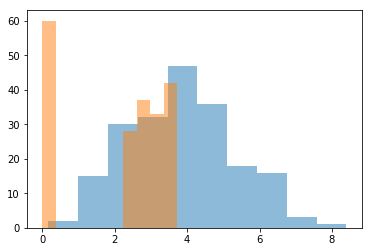

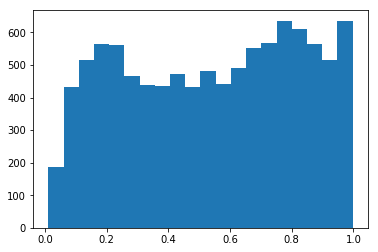

2 FACTORS
100 STUDENTS: [ 0.86] [ 1.55]
100 QUEST/NS: 1.4634920184368392
Offset 0.53204746933
(100, 100, 0.8565655699972947, 1.5528287007333799, 0.53204746933021974, 1.4634920184368392)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


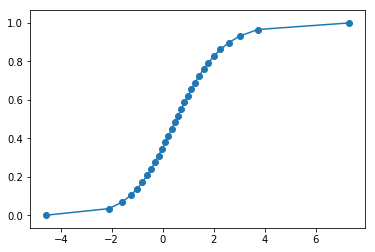

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.420557117003
NCOMPS 2
q minval is -0.420557117003
NCOMPS 2
q minval is -0.420557117003
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 2
q minval is -0.625386347897
NCOMPS 1
q minval is -0.625386347897
NCOMPS 1
q minval is -0.6253863478

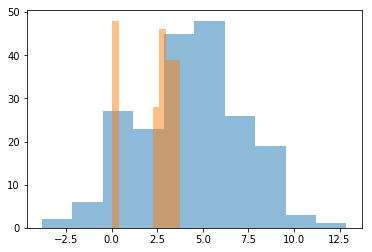

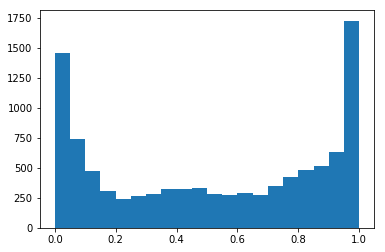

2 FACTORS
100 STUDENTS: [ 1.05] [ 2.81]
100 QUEST/NS: 1.469442082134928
Offset 0.53204746933
(100, 100, 1.0542378893707738, 2.814147772815862, 0.53204746933021974, 1.469442082134928)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


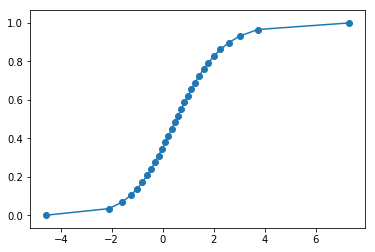

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.724650428984
NCOMPS 1
q minval is -0.724650428984
NCOMPS 1
q minval is -0.724650428984
NCOMPS 1
q minval is -0.724650428984
NCOMPS 1
q minval is -0.724650428984
NCOMPS 2
q minval is -0.900471630944
NCOMPS 1
q minval is -0.900471630944
NCOMPS 2
q minval is -0.900471630944
NCOMPS 2
q minval is -0.900471630944
NCOMPS 1
q minval is -0.900471630944
NCOMPS 2
q minval is -0.900471630944
NCOMPS 2
q minval is -0.900471630944
NCOMPS 1
q minval is -0.900471630944
NCOMPS 2
q minval is -0.902607171631
NCOMPS 1
q minval is -0.902607171631
NCOMPS 1
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 1
q minval is -0.902607171631
NCOMPS 1
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 1
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 2
q minval is -0.902607171631
NCOMPS 2
q minval is -0.9026071716

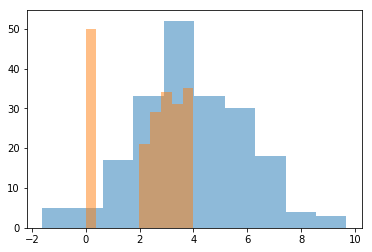

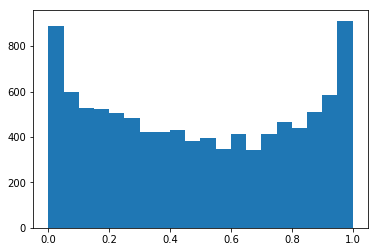

2 FACTORS
100 STUDENTS: [ 0.78] [ 1.97]
100 QUEST/NS: 2.013528927803817
Offset 0.53204746933
(100, 100, 0.7846236303828653, 1.9714030065337882, 0.53204746933021974, 2.013528927803817)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


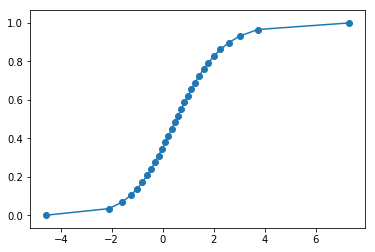

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.195728468237
NCOMPS 2
q minval is 0.130858094687
NCOMPS 2
q minval is -0.411359506278
NCOMPS 1
q minval is -0.411359506278
NCOMPS 1
q minval is -0.411359506278
NCOMPS 1
q minval is -0.411359506278
NCOMPS 1
q minval is -0.411359506278
NCOMPS 1
q minval is -0.411359506278
NCOMPS 1
q minval is -0.427466238908
NCOMPS 1
q minval is -0.427466238908
NCOMPS 2
q minval is -0.427466238908
NCOMPS 2
q minval is -0.427466238908
NCOMPS 2
q minval is -0.427466238908
NCOMPS 1
q minval is -0.427466238908
NCOMPS 2
q minval is -0.461671476955
NCOMPS 2
q minval is -0.461671476955
NCOMPS 2
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 2
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 1
q minval is -0.461671476955
NCOMPS 2
q minval is -0.461671476955
NCOMPS 2
q minval is -0.461671476955

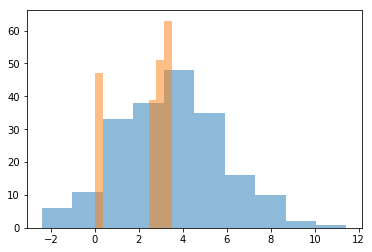

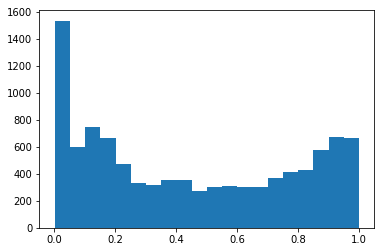

2 FACTORS
100 STUDENTS: [ 0.47] [ 2.28]
100 QUEST/NS: 0.9734986224370588
Offset 0.53204746933
(100, 100, 0.47167371773319927, 2.2793949341918625, 0.53204746933021974, 0.9734986224370588)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


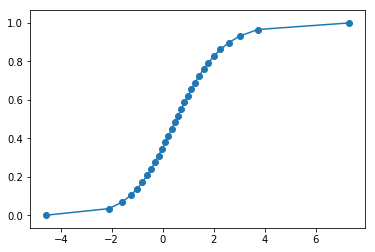

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.140829488714
NCOMPS 1
q minval is -1.12109500645
NCOMPS 2
q minval is -1.97457244515
NCOMPS 2
q minval is -2.03331371488
NCOMPS 1
q minval is -2.03331371488
NCOMPS 2
q minval is -2.03331371488
NCOMPS 2
q minval is -2.03331371488
NCOMPS 1
q minval is -2.03331371488
NCOMPS 2
q minval is -2.03331371488
NCOMPS 2
q minval is -2.03331371488
NCOMPS 2
q minval is -2.03331371488
NCOMPS 1
q minval is -2.03331371488
NCOMPS 1
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 1
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 1
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 1
q minval is -2.07331957956
NCOMPS 2
q minval is -2.07331957956
NCOMPS 1
q minval is -2.07331957956
NCOMPS 1
q minval is -2.07331957956
NCOMPS 1
q minval is -

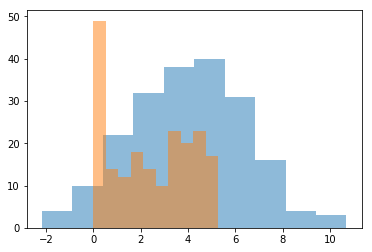

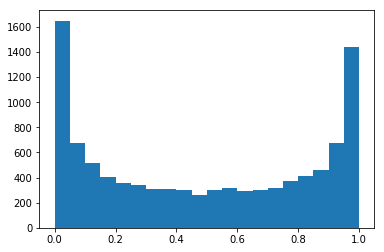

2 FACTORS
100 STUDENTS: [ 0.98] [ 2.44]
100 QUEST/NS: 4.5733811969632
Offset 0.53204746933
(100, 100, 0.9812145522626714, 2.435786474451834, 0.53204746933021974, 4.5733811969632)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


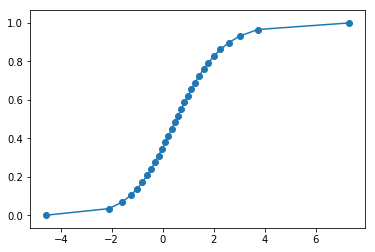

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.214024097829
NCOMPS 2
q minval is -0.227076216103
NCOMPS 1
q minval is -0.227076216103
NCOMPS 1
q minval is -0.227076216103
NCOMPS 2
q minval is -0.387098557789
NCOMPS 2
q minval is -0.387098557789
NCOMPS 1
q minval is -0.387098557789
NCOMPS 1
q minval is -0.387098557789
NCOMPS 2
q minval is -0.519527099389
NCOMPS 1
q minval is -0.519527099389
NCOMPS 2
q minval is -0.519527099389
NCOMPS 2
q minval is -0.519527099389
NCOMPS 1
q minval is -0.519527099389
NCOMPS 2
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 2
q minval is -0.555094564731
NCOMPS 2
q minval is -0.555094564731
NCOMPS 2
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 1
q minval is -0.555094564731
NCOMPS 2
q minval is -0.555094564731
NCOMPS 2
q minval is -0.555094564731
NCOMPS 1
q minval is -0.5550945647

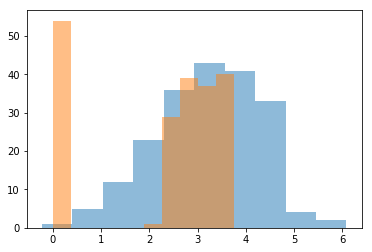

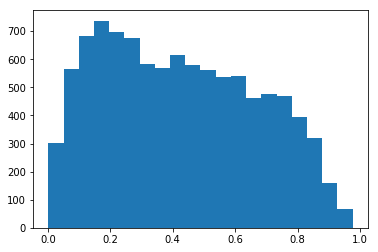

2 FACTORS
100 STUDENTS: [ 0.07] [ 1.09]
100 QUEST/NS: 1.5327891389009025
Offset 0.53204746933
(100, 100, 0.07042107239357182, 1.085494769736496, 0.53204746933021974, 1.5327891389009025)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


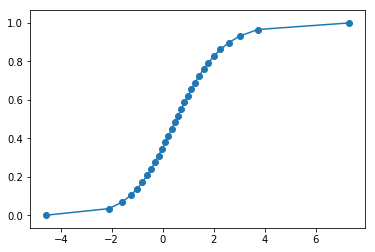

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 1
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 2
q minval is -1.18471275265
NCOMPS 2
q minval is -1

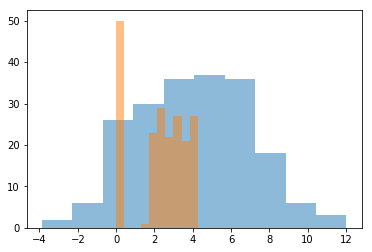

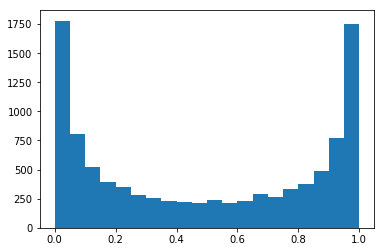

2 FACTORS
100 STUDENTS: [ 0.93] [ 3.18]
100 QUEST/NS: 2.5921855480363067
Offset 0.53204746933
(100, 100, 0.930619248747278, 3.182013027671876, 0.53204746933021974, 2.5921855480363067)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


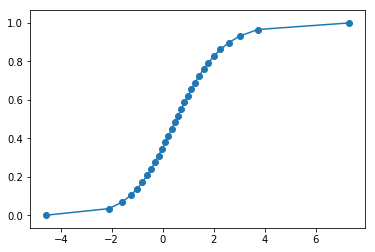

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1.85360720726
NCOMPS 1
q minval is -1.85360720726
NCOMPS 2
q minval is -1

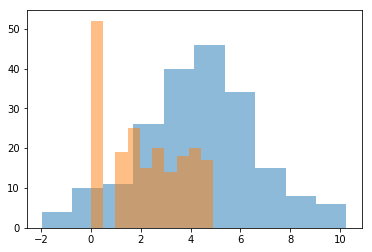

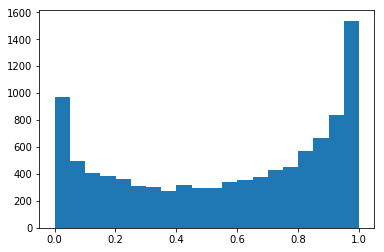

2 FACTORS
100 STUDENTS: [ 1.41] [ 2.55]
100 QUEST/NS: 3.896885055077534
Offset 0.53204746933
(100, 100, 1.4145390538390263, 2.545327965485976, 0.53204746933021974, 3.896885055077534)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


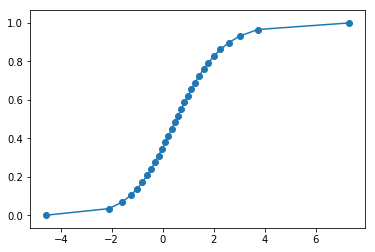

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.0877454617308
NCOMPS 2
q minval is 0.0840340113552
NCOMPS 2
q minval is 0.0840340113552
NCOMPS 2
q minval is -0.482773436378
NCOMPS 1
q minval is -0.482773436378
NCOMPS 1
q minval is -0.482773436378
NCOMPS 1
q minval is -0.617321177506
NCOMPS 1
q minval is -0.617321177506
NCOMPS 2
q minval is -0.617321177506
NCOMPS 2
q minval is -0.617321177506
NCOMPS 1
q minval is -0.617321177506
NCOMPS 2
q minval is -0.617321177506
NCOMPS 1
q minval is -0.617321177506
NCOMPS 2
q minval is -0.617321177506
NCOMPS 2
q minval is -0.617321177506
NCOMPS 1
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 2
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 2
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 1
q minval is -0.63747585324
NCOMPS 2
q minval is -0.63747585324
NCOMPS 1

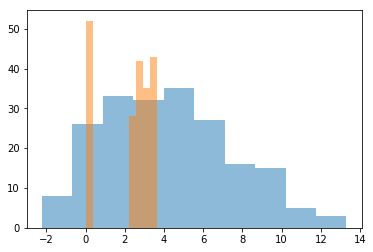

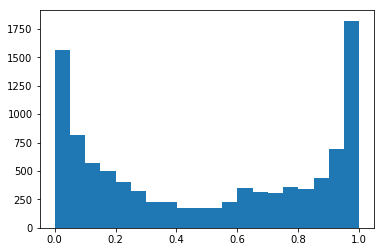

2 FACTORS
100 STUDENTS: [ 0.96] [ 2.9]
100 QUEST/NS: 1.3107427638702147
Offset 0.53204746933
(100, 100, 0.963554131320254, 2.8983078220973493, 0.53204746933021974, 1.3107427638702147)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


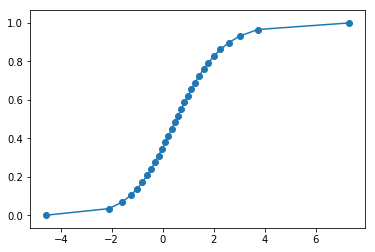

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.320697952267
NCOMPS 1
q minval is 0.320697952267
NCOMPS 2
q minval is -0.858247761852
NCOMPS 1
q minval is -0.858247761852
NCOMPS 2
q minval is -1.67189536221
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 1
q minval is -1.84560028219
NCOMPS 2
q minval is -1.84560028219
NCOMPS 2
q minval is 

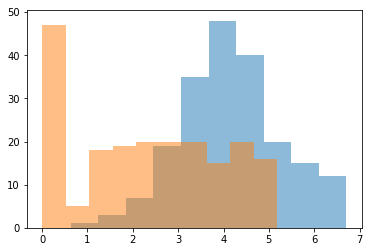

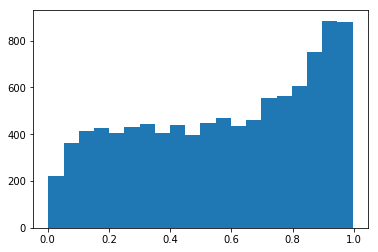

2 FACTORS
100 STUDENTS: [ 1.14] [ 1.15]
100 QUEST/NS: 4.369821279422547
Offset 0.53204746933
(100, 100, 1.1355746278985814, 1.1511276215775823, 0.53204746933021974, 4.369821279422547)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


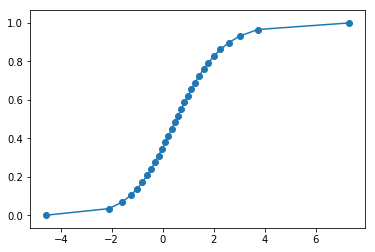

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.67639020182
NCOMPS 1
q minval is -1.67639020182
NCOMPS 2
q minval is -1.67639020182
NCOMPS 1
q minval is -1.67639020182
NCOMPS 1
q minval is -1.6845404606
NCOMPS 2
q minval is -1.6845404606
NCOMPS 1
q minval is -1.6845404606
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 1
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72352130487
NCOMPS 2
q minval is -1.72

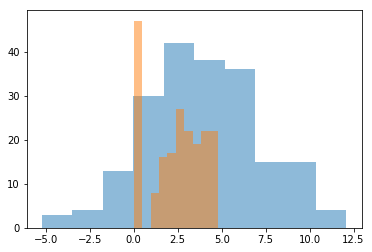

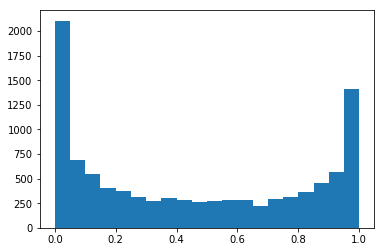

2 FACTORS
100 STUDENTS: [ 0.99] [ 3.41]
100 QUEST/NS: 3.6020969575090724
Offset 0.53204746933
(100, 100, 0.9870840818926366, 3.412349442160087, 0.53204746933021974, 3.6020969575090724)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


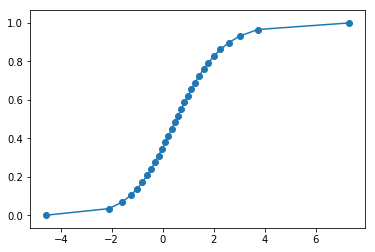

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.0693253426806
NCOMPS 1
q minval is -0.0693253426806
NCOMPS 1
q minval is -0.489270103952
NCOMPS 1
q minval is -0.489270103952
NCOMPS 2
q minval is -1.18721563604
NCOMPS 1
q minval is -1.18721563604
NCOMPS 1
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 2
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval is -1.25793953175
NCOMPS 1
q minval

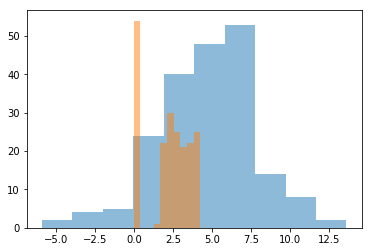

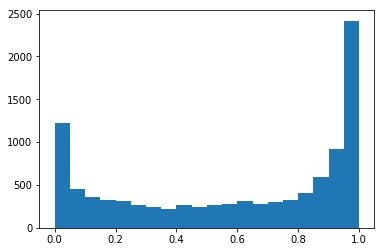

2 FACTORS
100 STUDENTS: [ 1.51] [ 2.91]
100 QUEST/NS: 2.5880293458579016
Offset 0.53204746933
(100, 100, 1.5092891710677627, 2.909949723040243, 0.53204746933021974, 2.5880293458579016)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


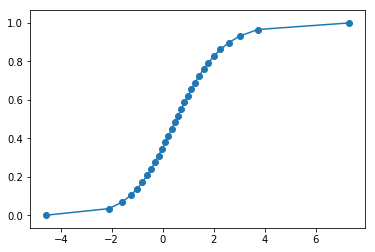

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.316931784317
NCOMPS 2
q minval is -0.363443943525
NCOMPS 1
q minval is -0.426422301952
NCOMPS 1
q minval is -0.426422301952
NCOMPS 1
q minval is -0.426422301952
NCOMPS 2
q minval is -0.426422301952
NCOMPS 1
q minval is -0.642554893896
NCOMPS 1
q minval is -0.642554893896
NCOMPS 1
q minval is -0.642554893896
NCOMPS 2
q minval is -0.642554893896
NCOMPS 2
q minval is -0.642554893896
NCOMPS 2
q minval is -0.642554893896
NCOMPS 1
q minval is -0.642554893896
NCOMPS 2
q minval is -0.642554893896
NCOMPS 2
q minval is -0.642554893896
NCOMPS 2
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 2
q minval is -0.704704770269
NCOMPS 2
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 1
q minval is -0.704704770269
NCOMPS 2
q minval is -0.704704770269
NCOMPS 1
q minval is -0.8113972044

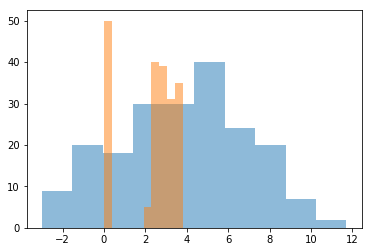

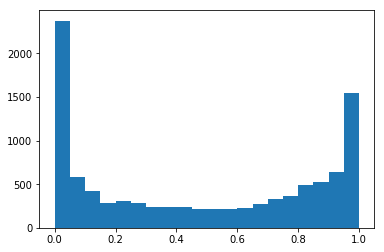

2 FACTORS
100 STUDENTS: [ 0.49] [ 3.27]
100 QUEST/NS: 1.6408956974118434
Offset 0.53204746933
(100, 100, 0.485582538960538, 3.2675770092477645, 0.53204746933021974, 1.6408956974118434)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


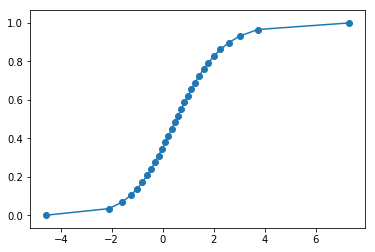

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.79762708133
NCOMPS 1
q minval is 1.79762708133
NCOMPS 1
q minval is 1.79762708133
NCOMPS 2
q minval is -0.580174322742
NCOMPS 2
q minval is -0.580174322742
NCOMPS 1
q minval is -0.580174322742
NCOMPS 1
q minval is -0.580174322742
NCOMPS 2
q minval is -1.50391383351
NCOMPS 1
q minval is -1.50391383351
NCOMPS 1
q minval is -1.50391383351
NCOMPS 2
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 2
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 2
q minval is -1.87627901366
NCOMPS 2
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 2
q minval is -1.87627901366
NCOMPS 1
q minval is -1.87627901366
NCOMPS 2
q minval is -1.87627901366
NCOMPS 2
q minval is -

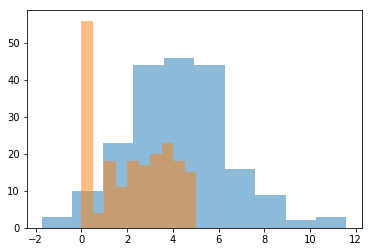

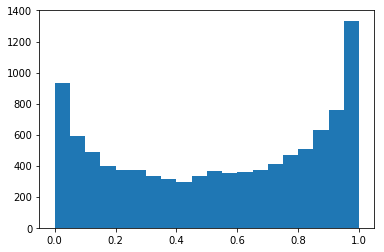

2 FACTORS
100 STUDENTS: [ 1.29] [ 2.13]
100 QUEST/NS: 4.16705270439517
Offset 0.53204746933
(100, 100, 1.2857036618378588, 2.1345854034119633, 0.53204746933021974, 4.16705270439517)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


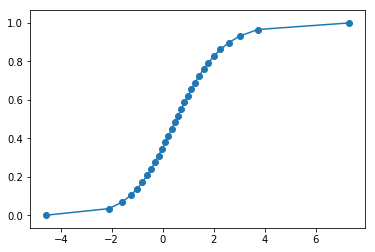

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.141625712275
NCOMPS 1
q minval is -0.141625712275
NCOMPS 2
q minval is -0.217211923847
NCOMPS 2
q minval is -0.217211923847
NCOMPS 2
q minval is -0.309738132803
NCOMPS 2
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 2
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.387623144736
NCOMPS 1
q minval is -0.421934918203
NCOMPS 2
q minval is -0.421934918203
NCOMPS 2
q minval is -0.421934918203
NCOMPS 1
q minval is -0.4219349182

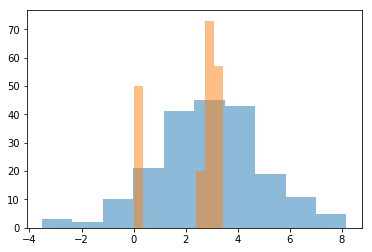

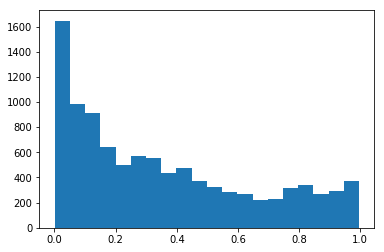

2 FACTORS
100 STUDENTS: [ 0.21] [ 2.19]
100 QUEST/NS: 0.8449055816781594
Offset 0.53204746933
(100, 100, 0.2113766792033997, 2.1886332867196767, 0.53204746933021974, 0.8449055816781594)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


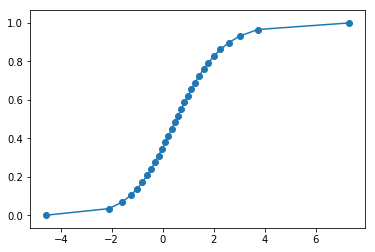

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.0689288182511
NCOMPS 2
q minval is -0.0689288182511
NCOMPS 2
q minval is -0.27128623413
NCOMPS 1
q minval is -0.27128623413
NCOMPS 1
q minval is -0.27128623413
NCOMPS 2
q minval is -0.27128623413
NCOMPS 2
q minval is -0.27128623413
NCOMPS 2
q minval is -0.286076575695
NCOMPS 2
q minval is -0.286076575695
NCOMPS 2
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 2
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 2
q minval is -0.286076575695
NCOMPS 2
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 1
q minval is -0.286076575695
NCOMPS 2
q minval is -0.373482061468
NCOMPS 1
q minval is -0.373482061468
NCOMPS 1
q minval is -0.373482061468
NCOMPS 2
q minval is -0.373482061468
NCOMPS 1
q minval is -0.373482061468
NCOMPS 2
q minval is -0.373482061468
NCOMPS 2
q minval is -0.373482061468


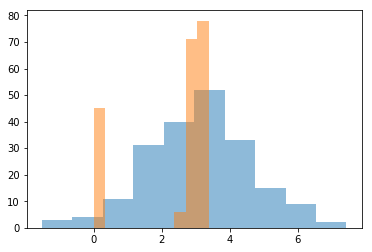

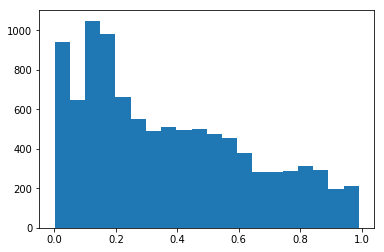

2 FACTORS
100 STUDENTS: [ 0.13] [ 1.44]
100 QUEST/NS: 0.7575583754916678
Offset 0.53204746933
(100, 100, 0.13227357728121397, 1.4429798824248254, 0.53204746933021974, 0.7575583754916678)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


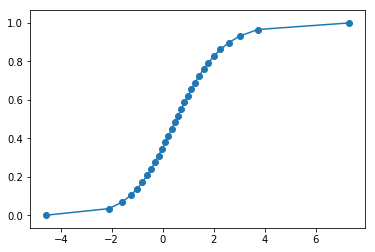

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.792560922319
NCOMPS 2
q minval is -0.792560922319
NCOMPS 2
q minval is -0.792560922319
NCOMPS 2
q minval is -0.792560922319
NCOMPS 1
q minval is -0.792560922319
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 1
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 2
q minval is -1.69971534706
NCOMPS 1
q minval 

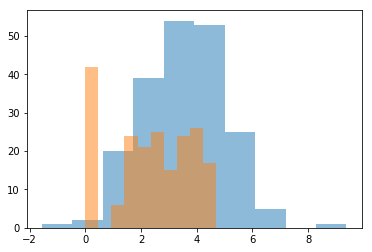

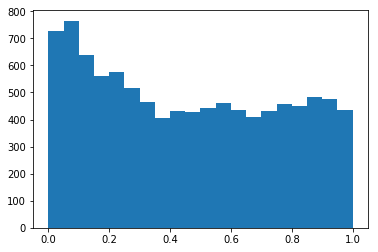

2 FACTORS
100 STUDENTS: [ 0.39] [ 1.42]
100 QUEST/NS: 3.4359462581744262
Offset 0.53204746933
(100, 100, 0.3865306231689239, 1.4212583496465863, 0.53204746933021974, 3.4359462581744262)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


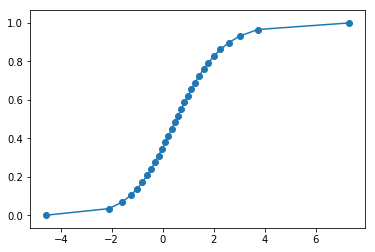

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.376636295179
NCOMPS 2
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 2
q minval is -1.16493994782
NCOMPS 1
q minval is -1.16493994782
NCOMPS 1
q minval is -

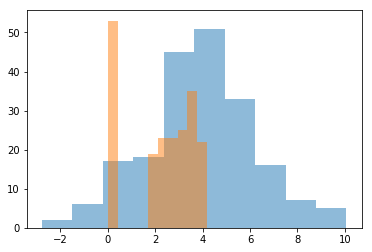

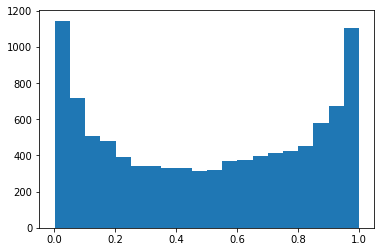

2 FACTORS
100 STUDENTS: [ 0.61] [ 2.5]
100 QUEST/NS: 2.4025203384275726
Offset 0.53204746933
(100, 100, 0.6120686569956716, 2.4978562351721694, 0.53204746933021974, 2.4025203384275726)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


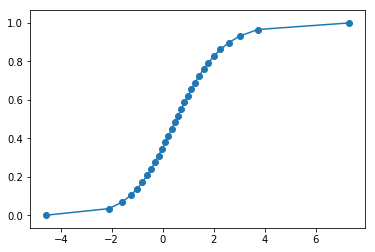

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 2
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 1
q minval is -1.72782882811
NCOMPS 2
q minval is -1.77134354317
NCOMPS 1
q minval is -1.77134354317
NCOMPS 2
q minval is -1.77134354317
NCOMPS 2
q minval is -1.77134354317
NCOMPS 2
q minval is -1.77134354317
NCOMPS 1
q minval is -1.77134354317
NCOMPS 2
q minval is -1.77134354317
NCOMPS 1
q minval is -1.77134354317
NCOMPS 1
q minval is -1.77134354317
NCOMPS 2
q minval is -1

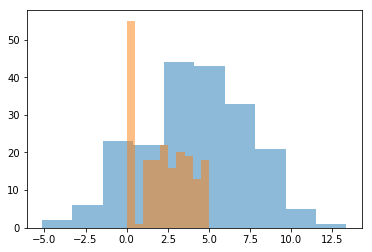

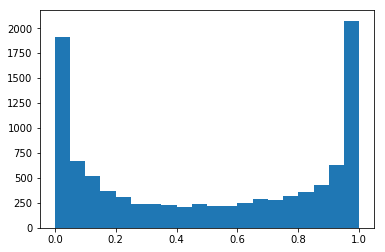

2 FACTORS
100 STUDENTS: [ 1.48] [ 3.02]
100 QUEST/NS: 4.198968881310636
Offset 0.53204746933
(100, 100, 1.4801321406394259, 3.0247776562095328, 0.53204746933021974, 4.198968881310636)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


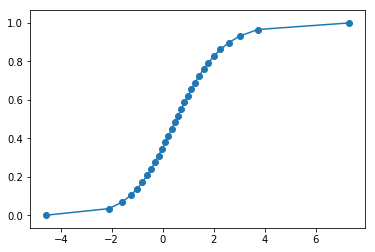

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.38416847906
NCOMPS 1
q minval is 0.316126601912
NCOMPS 2
q minval is -0.309484167126
NCOMPS 1
q minval is -0.309484167126
NCOMPS 1
q minval is -0.424470841688
NCOMPS 2
q minval is -0.424470841688
NCOMPS 1
q minval is -0.424470841688
NCOMPS 2
q minval is -0.886375900303
NCOMPS 1
q minval is -0.886375900303
NCOMPS 1
q minval is -0.886375900303
NCOMPS 2
q minval is -0.886375900303
NCOMPS 2
q minval is -0.91865270732
NCOMPS 1
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 1
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 1
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 2
q minval is -0.91865270732
NCOMPS 1
q minv

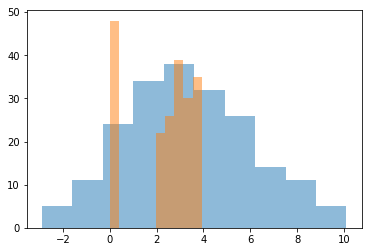

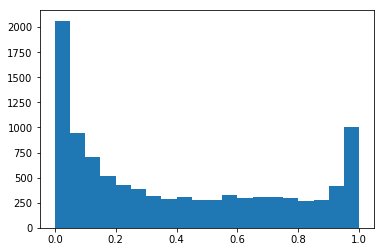

2 FACTORS
100 STUDENTS: [ 0.36] [ 2.78]
100 QUEST/NS: 1.8614695141867548
Offset 0.53204746933
(100, 100, 0.3645688591338717, 2.77543949714647, 0.53204746933021974, 1.8614695141867548)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


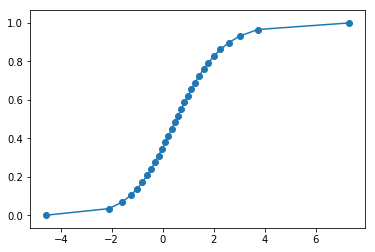

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.778657351578
NCOMPS 1
q minval is -0.451069360624
NCOMPS 1
q minval is -0.451069360624
NCOMPS 2
q minval is -0.451069360624
NCOMPS 2
q minval is -1.29668857107
NCOMPS 1
q minval is -1.29668857107
NCOMPS 2
q minval is -1.29668857107
NCOMPS 2
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 1
q minval is -1.78028911851
NCOMPS 2
q minval is -1.78028911851
NCOMPS 2
q minval is

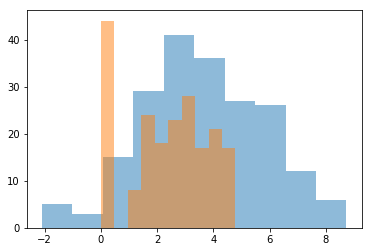

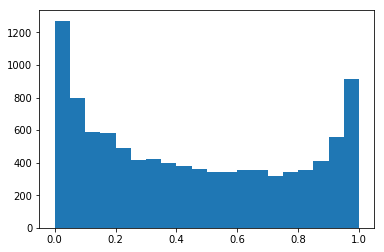

2 FACTORS
100 STUDENTS: [ 0.61] [ 2.13]
100 QUEST/NS: 3.5793569151811573
Offset 0.53204746933
(100, 100, 0.6116922362270081, 2.1299966065675937, 0.53204746933021974, 3.5793569151811573)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


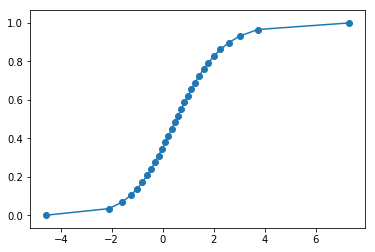

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.569841105555
NCOMPS 2
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 2
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -1.29937683427
NCOMPS 1
q minval is -

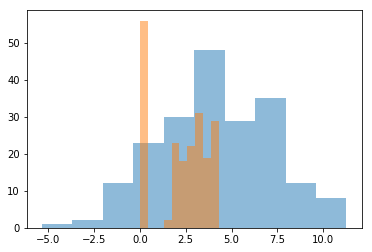

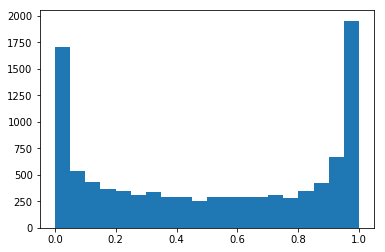

2 FACTORS
100 STUDENTS: [ 1.25] [ 3.17]
100 QUEST/NS: 2.640182402270426
Offset 0.53204746933
(100, 100, 1.2496485022624264, 3.1663234487938956, 0.53204746933021974, 2.640182402270426)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


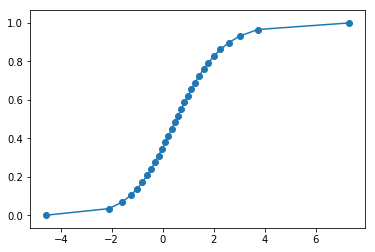

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.851979052281
NCOMPS 1
q minval is -0.851979052281
NCOMPS 2
q minval is -0.851979052281
NCOMPS 2
q minval is -0.851979052281
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 1
q minval is -1.31671303136
NCOMPS 2
q minval i

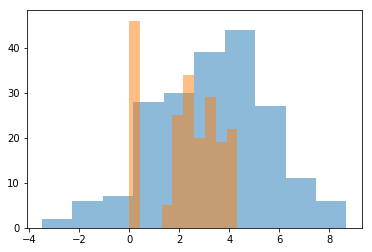

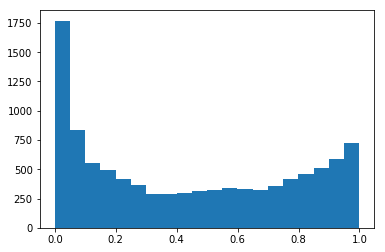

2 FACTORS
100 STUDENTS: [ 0.27] [ 2.24]
100 QUEST/NS: 2.666518473471649
Offset 0.53204746933
(100, 100, 0.26788267428719004, 2.2392970800213967, 0.53204746933021974, 2.666518473471649)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


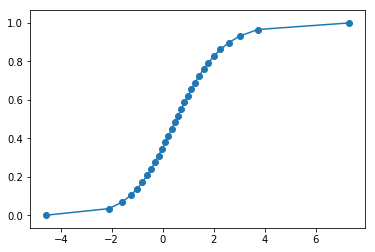

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.139949019717
NCOMPS 1
q minval is -1.11710401678
NCOMPS 2
q minval is -1.11710401678
NCOMPS 1
q minval is -1.11710401678
NCOMPS 1
q minval is -1.11710401678
NCOMPS 1
q minval is -1.11710401678
NCOMPS 1
q minval is -1.11710401678
NCOMPS 2
q minval is -1.11710401678
NCOMPS 1
q minval is -1.11710401678
NCOMPS 1
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 1
q minval is -2.16964764461
NCOMPS 2
q minval is -2.16964764461
NCOMPS 2
q minval is -

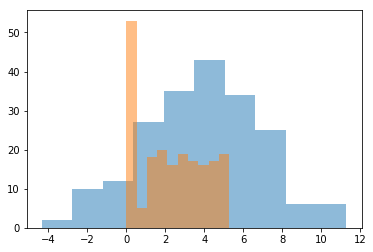

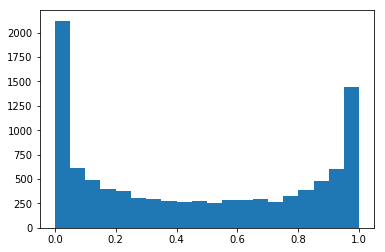

2 FACTORS
100 STUDENTS: [ 0.81] [ 3.15]
100 QUEST/NS: 4.597390246241302
Offset 0.53204746933
(100, 100, 0.8147629922675972, 3.1468089130618355, 0.53204746933021974, 4.597390246241302)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


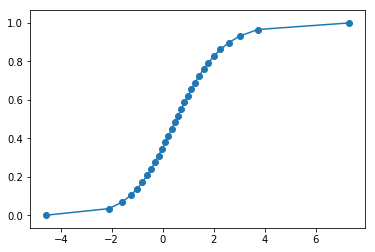

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.709331524878
NCOMPS 2
q minval is -1.38203880369
NCOMPS 1
q minval is -1.38203880369
NCOMPS 1
q minval is -1.38203880369
NCOMPS 1
q minval is -1.38203880369
NCOMPS 1
q minval is -1.38203880369
NCOMPS 2
q minval is -1.38203880369
NCOMPS 2
q minval is -1.38203880369
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 1
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 1
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 1
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 1
q minval is -1.56464246479
NCOMPS 1
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -1.56464246479
NCOMPS 2
q minval is -

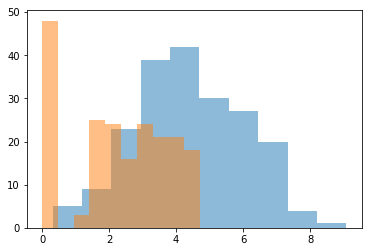

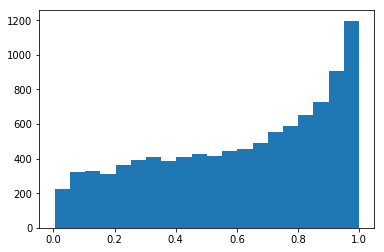

2 FACTORS
100 STUDENTS: [ 1.21] [ 1.55]
100 QUEST/NS: 3.57771414136011
Offset 0.53204746933
(100, 100, 1.2117893743350852, 1.5472994707663625, 0.53204746933021974, 3.57771414136011)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


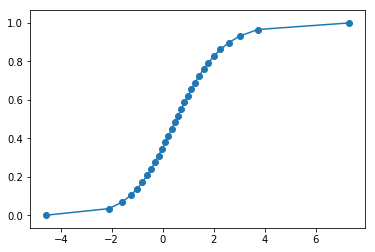

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.849079679392
NCOMPS 1
q minval is -0.849079679392
NCOMPS 1
q minval is -0.849079679392
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 1
q minval is -0.958952899641
NCOMPS 2
q minval is -0.958952899641
NCOMPS 2
q minval is -0.9589528996

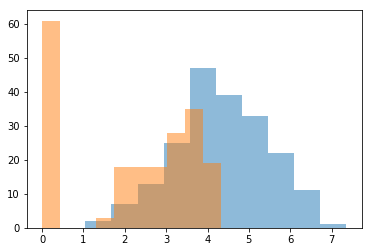

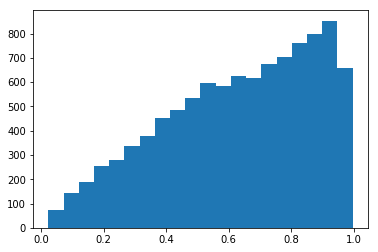

2 FACTORS
100 STUDENTS: [ 1.29] [ 1.26]
100 QUEST/NS: 2.6822059556839637
Offset 0.53204746933
(100, 100, 1.2865060650946456, 1.2625164914963074, 0.53204746933021974, 2.6822059556839637)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


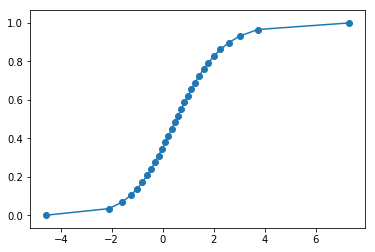

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.44651716061
NCOMPS 1
q minval is -1.47714447959
NCOMPS 2
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 2
q minval is -1.47714447959
NCOMPS 1
q minval is -1.47714447959
NCOMPS 2
q minval is -1.47714447959
NCOMPS 2
q minval is -1.63524374795
NCOMPS 2
q minval is -1.63524374795
NCOMPS 1
q minval is -1.63524374795
NCOMPS 1
q minval is -1.63524374795
NCOMPS 1
q minval is -1.63524374795
NCOMPS 1
q minval is -1.63524374795
NCOMPS 2
q minval is -1.63524374795
NCOMPS 1
q minval is -1.63524374795
NCOMPS 2
q minval is -1.73975275412
NCOMPS 2
q minval is -1.73975275412
NCOMPS 1
q minval is -1.73975275412
NCOMPS 1
q minval is -1.73975275412
NCOMPS 2
q minval is -1.74805183325
NCOMPS 2
q minval is -1.74805183325
NCOMPS 2
q minval is -1

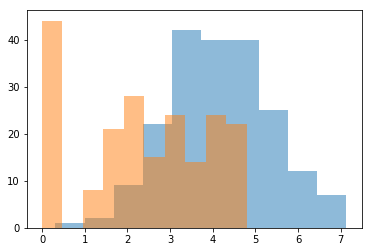

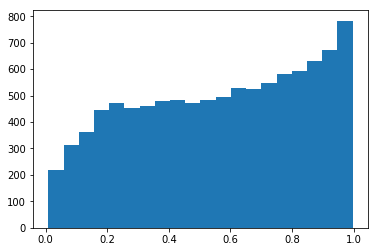

2 FACTORS
100 STUDENTS: [ 1.14] [ 1.18]
100 QUEST/NS: 3.6006189217626248
Offset 0.53204746933
(100, 100, 1.1445173850350017, 1.179800162311258, 0.53204746933021974, 3.6006189217626248)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


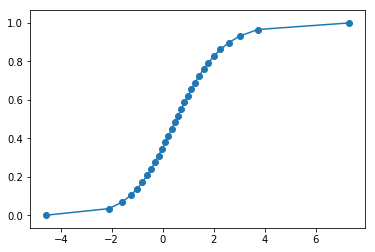

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 2
q minval is -1.00526925123
NCOMPS 2
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 2
q minval is -1.00526925123
NCOMPS 2
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 1
q minval is -1.00526925123
NCOMPS 2
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 2
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 2
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 1
q minval is -1.09342914247
NCOMPS 2
q minval is -1.09342914247
NCOMPS 2
q minval is -1.1998993554
NCOMPS 2
q minval is -1.1998993554
NCOMPS 1
q minval is -1.1998993554
NCOMPS 1
q minval is -1.19

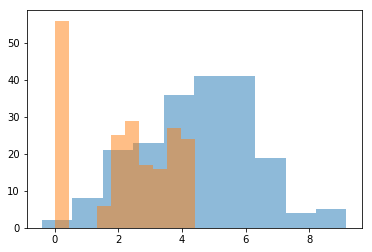

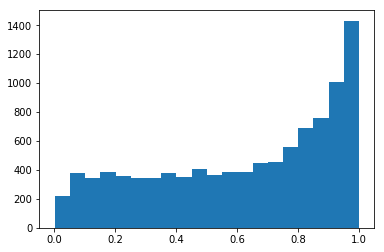

2 FACTORS
100 STUDENTS: [ 1.45] [ 1.79]
100 QUEST/NS: 2.799719052555987
Offset 0.53204746933
(100, 100, 1.4523606920863976, 1.7850214025454882, 0.53204746933021974, 2.799719052555987)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


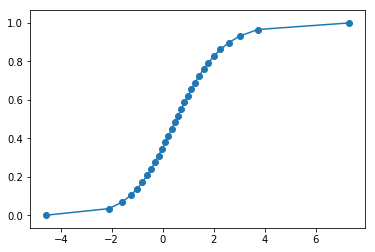

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.07101038694
NCOMPS 2
q minval is 0.995208452596
NCOMPS 2
q minval is -1.63995156664
NCOMPS 2
q minval is -1.63995156664
NCOMPS 1
q minval is -1.63995156664
NCOMPS 2
q minval is -1.63995156664
NCOMPS 1
q minval is -1.63995156664
NCOMPS 1
q minval is -1.63995156664
NCOMPS 2
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 2
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 1
q minval is -2.14345682536
NCOMPS 2
q minval is -2.19561487842
NCOMPS 1
q minval is -2.19561487842
NCOMPS 1
q minval is -2.19561487842
NCOMPS 2
q minval is -2.19561487842
NCOMPS 2
q minval is -2.21909859803
NCOMPS 2
q minval is -2.21909859803
NCOMPS 2
q minval is -2.21909859803
NCOMPS 1
q minval is -2.

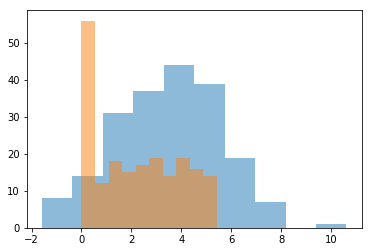

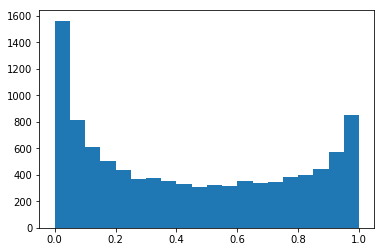

2 FACTORS
100 STUDENTS: [ 0.3] [ 1.87]
100 QUEST/NS: 4.90017959080839
Offset 0.53204746933
(100, 100, 0.29981308839469767, 1.8730668029665534, 0.53204746933021974, 4.90017959080839)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


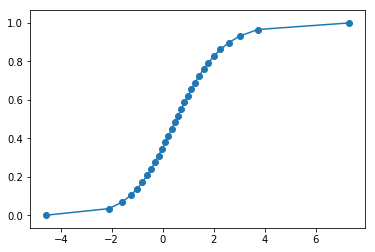

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.59153662857
NCOMPS 1
q minval is -1.59153662857
NCOMPS 1
q minval is -1.59153662857
NCOMPS 2
q minval is -1.79053428269
NCOMPS 1
q minval is -1.79053428269
NCOMPS 1
q minval is -1.79053428269
NCOMPS 2
q minval is -1.79053428269
NCOMPS 2
q minval is -1.79053428269
NCOMPS 1
q minval is -1.79053428269
NCOMPS 1
q minval is -1.79053428269
NCOMPS 2
q minval is -1.79053428269
NCOMPS 1
q minval is -1.79053428269
NCOMPS 2
q minval is -1.79053428269
NCOMPS 1
q minval is -1.93846473514
NCOMPS 2
q minval is -1.93846473514
NCOMPS 1
q minval is -1.93846473514
NCOMPS 2
q minval is -1.93846473514
NCOMPS 2
q minval is -1.93846473514
NCOMPS 1
q minval is -1.97545249108
NCOMPS 2
q minval is -1.97545249108
NCOMPS 2
q minval is -1.97545249108
NCOMPS 2
q minval is -1.97545249108
NCOMPS 2
q minval is -1.97545249108
NCOMPS 1
q minval is -1.97545249108
NCOMPS 1
q minval is -1.97545249108
NCOMPS 1
q minval is -1.97545249108
NCOMPS 1
q minval is -1

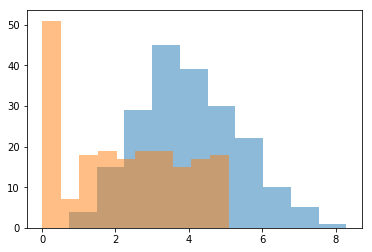

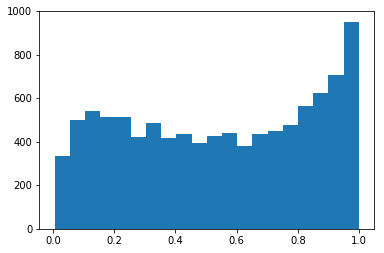

2 FACTORS
100 STUDENTS: [ 1.04] [ 1.35]
100 QUEST/NS: 4.2699041955455685
Offset 0.53204746933
(100, 100, 1.041628997443857, 1.3503360155481117, 0.53204746933021974, 4.2699041955455685)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


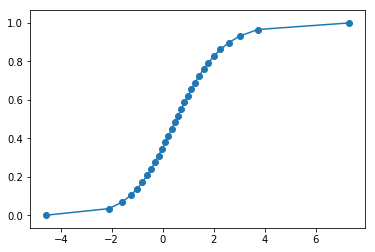

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.266147327625
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 2
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 1
q minval is -0.521169821522
NCOMPS 2
q minval is -0.528727260435
NCOMPS 2
q minval is -0.528727260435
NCOMPS 2
q minval is -0.528727260435
NCOMPS 2
q minval is -0.528727260435
NCOMPS 1
q minval is -0.528727260435
NCOMPS 2
q minval is -0.528727260435
NCOMPS 1
q minval is -0.5287272604

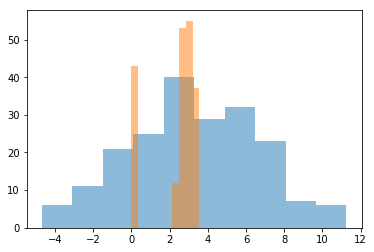

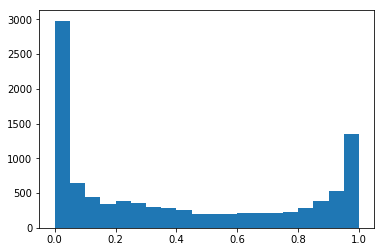

2 FACTORS
100 STUDENTS: [ 0.18] [ 3.34]
100 QUEST/NS: 1.1431706259257737
Offset 0.53204746933
(100, 100, 0.18419367831554845, 3.3417480551320002, 0.53204746933021974, 1.1431706259257737)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


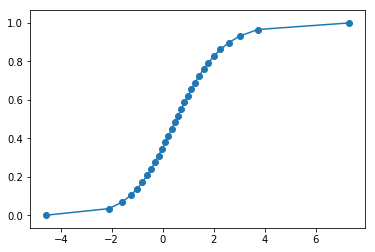

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.385037871249
NCOMPS 2
q minval is 0.385037871249
NCOMPS 2
q minval is -1.68657587661
NCOMPS 2
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 2
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 1
q minval is -2.05060176475
NCOMPS 2
q minval is -2.1177585712
NCOMPS 1
q minval is -2.1177585712
NCOMPS 2
q minval is -2.1177585712
NCOMPS 2
q minval is -2.1177585712
NCOMPS 1
q minval is -2.1177585712
NCOMPS 2
q minval is -2.1177585712
NCOMPS 1
q minval is -2.11775

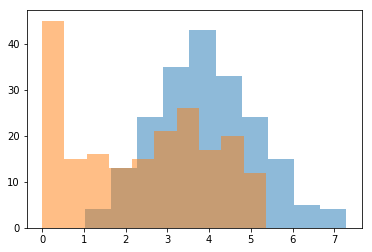

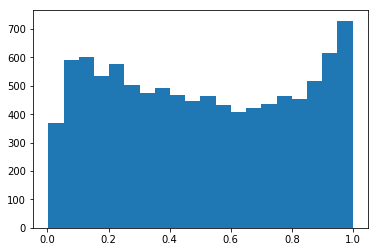

2 FACTORS
100 STUDENTS: [ 0.81] [ 1.23]
100 QUEST/NS: 4.866816265088689
Offset 0.53204746933
(100, 100, 0.8075249720319999, 1.226045061890756, 0.53204746933021974, 4.866816265088689)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


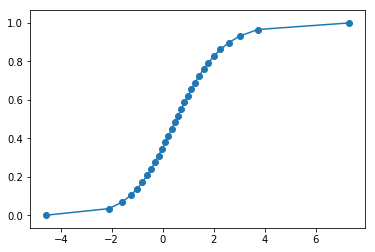

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.342928796348
NCOMPS 2
q minval is -0.342928796348
NCOMPS 1
q minval is -0.369130416151
NCOMPS 1
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 1
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 1
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 1
q minval is -0.369130416151
NCOMPS 1
q minval is -0.369130416151
NCOMPS 2
q minval is -0.369130416151
NCOMPS 2
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 2
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 2
q minval is -0.381453274663
NCOMPS 1
q minval is -0.381453274663
NCOMPS 2
q minval is -0.3814532746

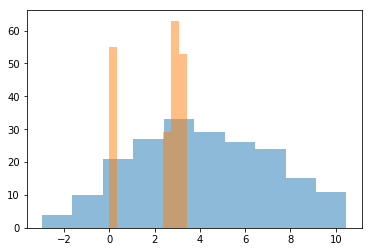

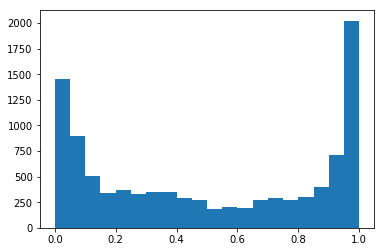

2 FACTORS
100 STUDENTS: [ 1.09] [ 2.84]
100 QUEST/NS: 0.8364937927215266
Offset 0.53204746933
(100, 100, 1.0869791289136361, 2.836746662276523, 0.53204746933021974, 0.8364937927215266)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


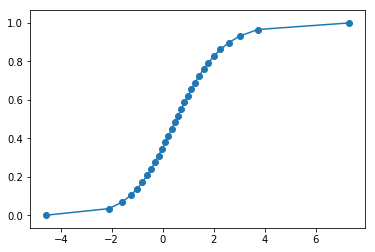

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.600637099863
NCOMPS 2
q minval is -0.915724884882
NCOMPS 2
q minval is -0.915724884882
NCOMPS 2
q minval is -0.915724884882
NCOMPS 1
q minval is -0.915724884882
NCOMPS 1
q minval is -0.915724884882
NCOMPS 2
q minval is -0.915724884882
NCOMPS 1
q minval is -0.915724884882
NCOMPS 2
q minval is -0.915724884882
NCOMPS 1
q minval is -0.929334119968
NCOMPS 2
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 2
q minval is -0.929334119968
NCOMPS 2
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 2
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 2
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 1
q minval is -0.929334119968
NCOMPS 2
q minval is -0.9293341199

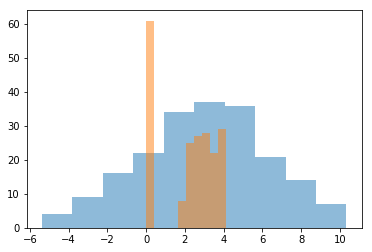

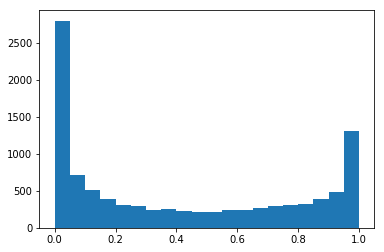

2 FACTORS
100 STUDENTS: [ 0.43] [ 3.3]
100 QUEST/NS: 2.257844395932008
Offset 0.53204746933
(100, 100, 0.4326077507421316, 3.2956155067673576, 0.53204746933021974, 2.257844395932008)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


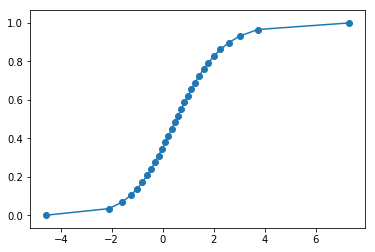

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.532512392012
NCOMPS 1
q minval is -0.592128744091
NCOMPS 1
q minval is -0.592128744091
NCOMPS 1
q minval is -1.15470551289
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 2
q minval is -1.2141666019
NCOMPS 1

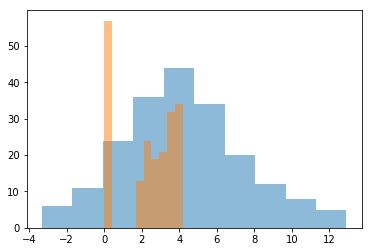

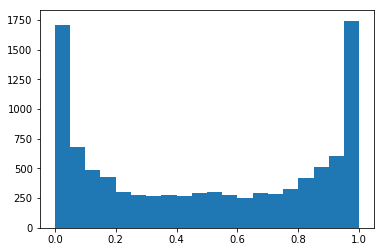

2 FACTORS
100 STUDENTS: [ 1.15] [ 3.44]
100 QUEST/NS: 2.433536216835396
Offset 0.53204746933
(100, 100, 1.147510327957854, 3.4382153823414585, 0.53204746933021974, 2.433536216835396)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


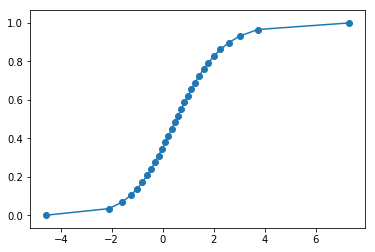

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.78897524823
NCOMPS 1
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 1
q minval is -0.78897524823
NCOMPS 1
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 1
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 1
q minval is -0.78897524823
NCOMPS 2
q minval is -0.78897524823
NCOMPS 2
q minval is -0

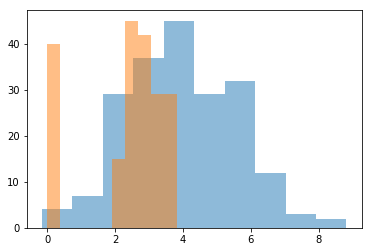

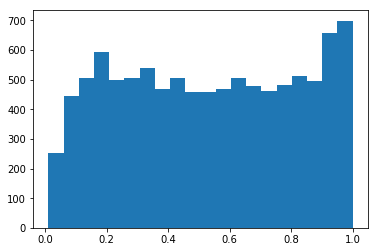

2 FACTORS
100 STUDENTS: [ 1.09] [ 1.61]
100 QUEST/NS: 1.6637339735457535
Offset 0.53204746933
(100, 100, 1.0933160588026476, 1.6134596069960168, 0.53204746933021974, 1.6637339735457535)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


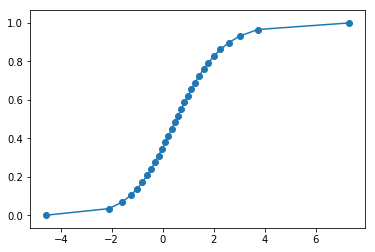

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.192998957739
NCOMPS 1
q minval is -0.192998957739
NCOMPS 1
q minval is -0.244986518308
NCOMPS 1
q minval is -0.612800242718
NCOMPS 2
q minval is -0.612800242718
NCOMPS 2
q minval is -0.629922105098
NCOMPS 2
q minval is -0.629922105098
NCOMPS 2
q minval is -0.629922105098
NCOMPS 2
q minval is -0.629922105098
NCOMPS 1
q minval is -0.629922105098
NCOMPS 1
q minval is -0.629922105098
NCOMPS 2
q minval is -0.658055638283
NCOMPS 2
q minval is -0.658055638283
NCOMPS 2
q minval is -0.761786950333
NCOMPS 2
q minval is -0.761786950333
NCOMPS 1
q minval is -0.761786950333
NCOMPS 1
q minval is -0.761786950333
NCOMPS 2
q minval is -0.761786950333
NCOMPS 1
q minval is -0.761786950333
NCOMPS 1
q minval is -0.761786950333
NCOMPS 2
q minval is -0.761786950333
NCOMPS 2
q minval is -0.761786950333
NCOMPS 2
q minval is -0.78602929775
NCOMPS 2
q minval is -0.78602929775
NCOMPS 1
q minval is -0.78602929775
NCOMPS 2
q minval is -0.78602929775
N

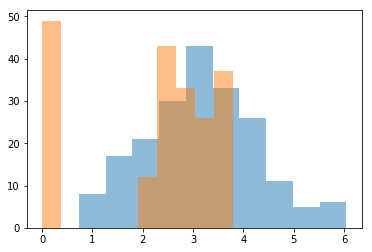

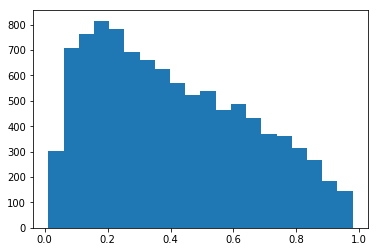

2 FACTORS
100 STUDENTS: [ 0.14] [ 1.07]
100 QUEST/NS: 1.6341276267431764
Offset 0.53204746933
(100, 100, 0.14220439773417048, 1.070874825703755, 0.53204746933021974, 1.6341276267431764)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


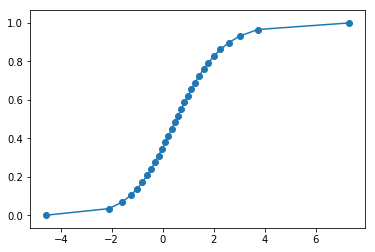

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.595781984501
NCOMPS 2
q minval is -0.595781984501
NCOMPS 2
q minval is -0.595781984501
NCOMPS 1
q minval is -0.595781984501
NCOMPS 2
q minval is -0.595781984501
NCOMPS 1
q minval is -0.595781984501
NCOMPS 2
q minval is -0.595781984501
NCOMPS 2
q minval is -0.595781984501
NCOMPS 1
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 1
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 2
q minval is -0.62479927719
NCOMPS 1
q minval is -0.645217360953
NCOMPS 1
q minval is -0.645217360953
NCOMPS 2
q minval is -0.645217360953
NCOMPS 1
q m

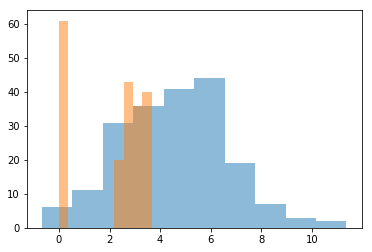

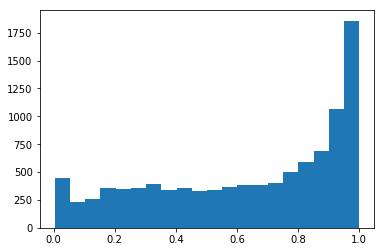

2 FACTORS
100 STUDENTS: [ 1.5] [ 2.13]
100 QUEST/NS: 1.33857757650361
Offset 0.53204746933
(100, 100, 1.5005776424985549, 2.1269821917080143, 0.53204746933021974, 1.33857757650361)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


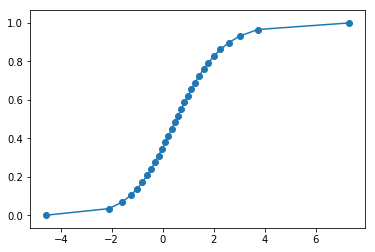

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -1.34103486255
NCOMPS 2
q minval is -1.34103486255
NCOMPS 1
q minval is -1.59749970588
NCOMPS 1
q minval is -1.59749970588
NCOMPS 2
q minval is -1.59749970588
NCOMPS 2
q minval is -1.59749970588
NCOMPS 1
q minval is -1.59749970588
NCOMPS 2
q minval is -1.59749970588
NCOMPS 2
q minval is -1.59749970588
NCOMPS 1
q minval is -1.59749970588
NCOMPS 2
q minval is -2.26539004494
NCOMPS 2
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 2
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 2
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 2
q minval is -2.26539004494
NCOMPS 1
q minval is -2.26539004494
NCOMPS 2
q minval is -2.30059965987
NCOMPS 1
q minval is -2.30059965987
NCOMPS 1
q minval is -2.30059965987
NCOMPS 1
q minval is -2.30059965987
NCOMPS 2
q minval is -2

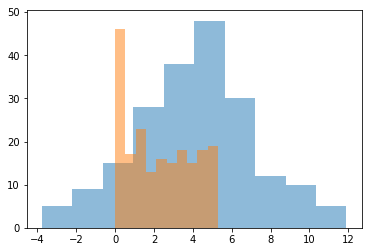

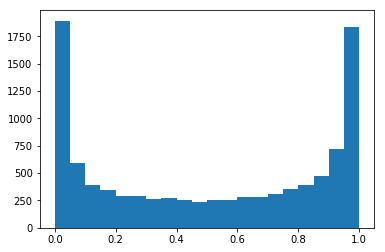

2 FACTORS
100 STUDENTS: [ 1.05] [ 3.41]
100 QUEST/NS: 4.7711758027326745
Offset 0.53204746933
(100, 100, 1.0500272872436132, 3.410575347877389, 0.53204746933021974, 4.7711758027326745)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


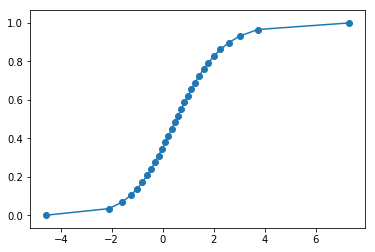

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.0123581990214
NCOMPS 2
q minval is -0.258943387566
NCOMPS 2
q minval is -0.258943387566
NCOMPS 1
q minval is -0.258943387566
NCOMPS 2
q minval is -0.258943387566
NCOMPS 2
q minval is -0.258943387566
NCOMPS 2
q minval is -0.258943387566
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 1
q minval is -0.330393238601
NCOMPS 2
q minval is -0.330393238

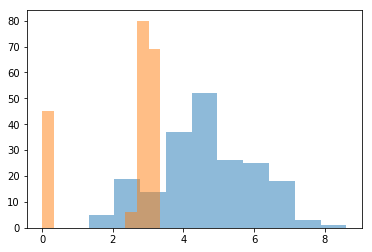

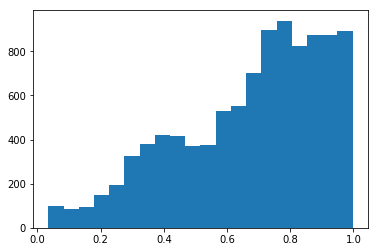

2 FACTORS
100 STUDENTS: [ 1.46] [ 1.44]
100 QUEST/NS: 0.7253508807640756
Offset 0.53204746933
(100, 100, 1.4601422158590749, 1.4419965664350014, 0.53204746933021974, 0.7253508807640756)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


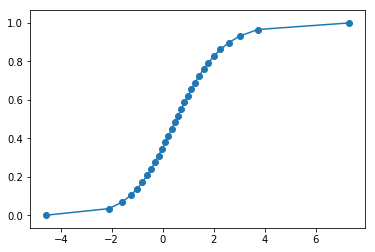

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.278264848243
NCOMPS 2
q minval is -0.278264848243
NCOMPS 2
q minval is -0.278264848243
NCOMPS 1
q minval is -0.96186829023
NCOMPS 1
q minval is -0.96186829023
NCOMPS 2
q minval is -1.27236688894
NCOMPS 1
q minval is -1.27236688894
NCOMPS 1
q minval is -1.27236688894
NCOMPS 2
q minval is -1.31193903895
NCOMPS 1
q minval is -1.31193903895
NCOMPS 2
q minval is -1.33781317621
NCOMPS 1
q minval is -1.33781317621
NCOMPS 2
q minval is -1.63281378582
NCOMPS 1
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 1
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 1
q minval is -1.63281378582
NCOMPS 1
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 1
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 2
q minval is -1.63281378582
NCOMPS 2
q minval is

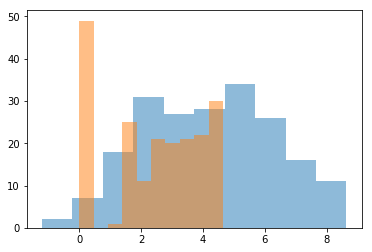

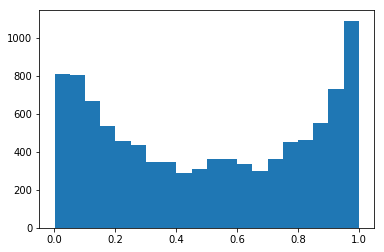

2 FACTORS
100 STUDENTS: [ 1.17] [ 2.05]
100 QUEST/NS: 3.499443013312259
Offset 0.53204746933
(100, 100, 1.1663672497399886, 2.0475112546424095, 0.53204746933021974, 3.499443013312259)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


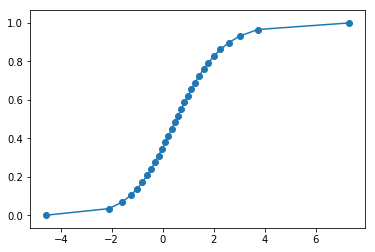

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.123470316657
NCOMPS 2
q minval is -0.123470316657
NCOMPS 1
q minval is -0.123470316657
NCOMPS 2
q minval is -0.123470316657
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 2
q minval is -0.274684950221
NCOMPS 1
q minval is -0.274684950221
NCOMPS 1
q minval is -0.2746849502

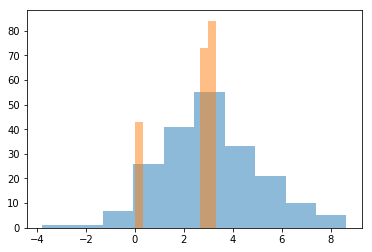

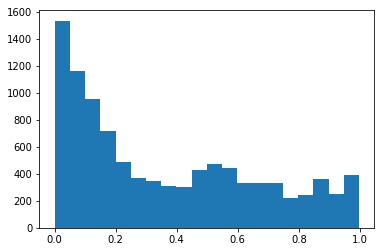

2 FACTORS
100 STUDENTS: [ 0.18] [ 2.21]
100 QUEST/NS: 0.6115402998371664
Offset 0.53204746933
(100, 100, 0.18296791552781544, 2.2149737894907475, 0.53204746933021974, 0.6115402998371664)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


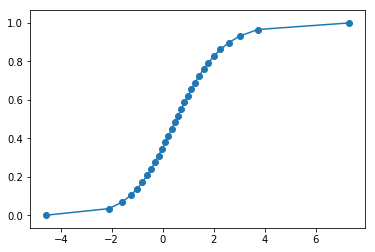

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.486540935822
NCOMPS 2
q minval is 0.241091330664
NCOMPS 2
q minval is -0.303948847363
NCOMPS 2
q minval is -0.303948847363
NCOMPS 2
q minval is -0.510150373301
NCOMPS 2
q minval is -0.510150373301
NCOMPS 2
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 1
q minval is -0.9346781207
NCOMPS 2
q minval is -0.9346781207
NCOM

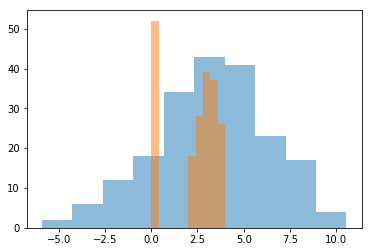

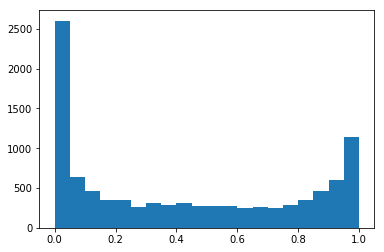

2 FACTORS
100 STUDENTS: [ 0.57] [ 3.18]
100 QUEST/NS: 2.028587971061807
Offset 0.53204746933
(100, 100, 0.5673339040822476, 3.184275366848609, 0.53204746933021974, 2.028587971061807)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


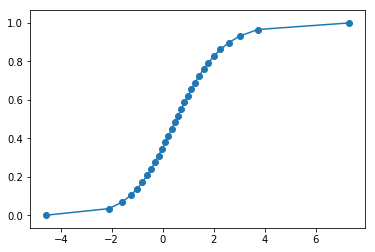

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.947290245413
NCOMPS 1
q minval is -0.947290245413
NCOMPS 1
q minval is -1.56925121729
NCOMPS 2
q minval is -1.56925121729
NCOMPS 2
q minval is -1.71258111905
NCOMPS 1
q minval is -1.71258111905
NCOMPS 1
q minval is -1.71258111905
NCOMPS 2
q minval is -1.71258111905
NCOMPS 2
q minval is -1.71258111905
NCOMPS 1
q minval is -1.71258111905
NCOMPS 2
q minval is -1.71258111905
NCOMPS 2
q minval is -1.71258111905
NCOMPS 1
q minval is -1.71258111905
NCOMPS 2
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 2
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 2
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 2
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 1
q minval is -1.78448539882
NCOMPS 2
q minval is -1.78448539882
NCOMPS 2
q minval is -1.78448539882
NCOMPS 2
q minval is 

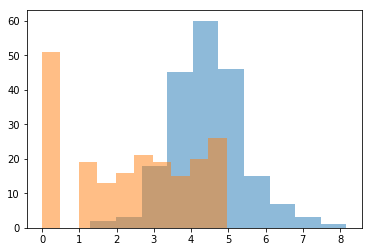

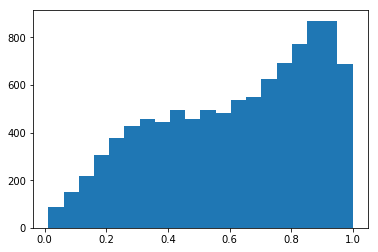

2 FACTORS
100 STUDENTS: [ 1.45] [ 1.02]
100 QUEST/NS: 3.958884872713032
Offset 0.53204746933
(100, 100, 1.4462575081042541, 1.018874497065711, 0.53204746933021974, 3.958884872713032)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


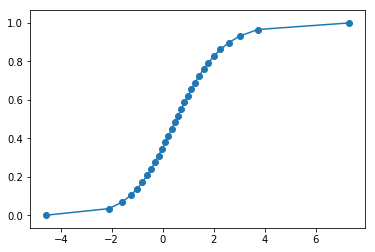

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.210504305618
NCOMPS 1
q minval is -0.210504305618
NCOMPS 2
q minval is -0.71544132714
NCOMPS 2
q minval is -0.983564446482
NCOMPS 2
q minval is -0.983564446482
NCOMPS 1
q minval is -0.983564446482
NCOMPS 1
q minval is -1.16294388007
NCOMPS 1
q minval is -1.16294388007
NCOMPS 1
q minval is -1.16294388007
NCOMPS 1
q minval is -1.16294388007
NCOMPS 1
q minval is -1.16294388007
NCOMPS 2
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 2
q minval is -1.22350741896
NCOMPS 1
q minval is -1.22350741896
NCOMPS 1
q minval 

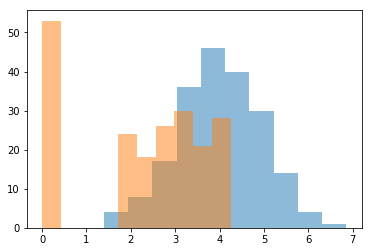

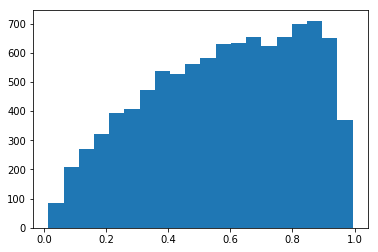

2 FACTORS
100 STUDENTS: [ 1.07] [ 1.01]
100 QUEST/NS: 2.5926226639019196
Offset 0.53204746933
(100, 100, 1.0650457259535824, 1.014472291912235, 0.53204746933021974, 2.5926226639019196)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


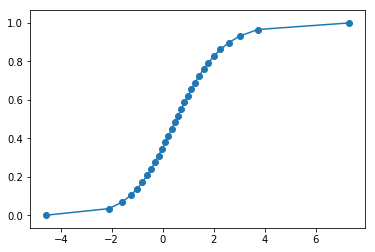

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.09117468315
NCOMPS 1
q minval is -0.185829604443
NCOMPS 1
q minval is -0.185829604443
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 1
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q minval is -2.1001490262
NCOMPS 2
q

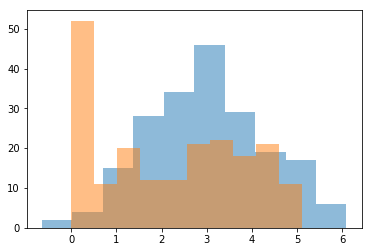

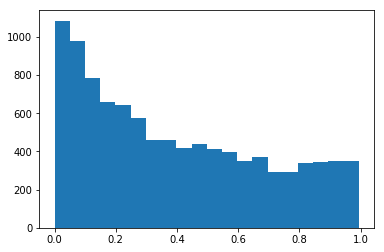

2 FACTORS
100 STUDENTS: [ 0.08] [ 1.41]
100 QUEST/NS: 4.264727473644722
Offset 0.53204746933
(100, 100, 0.08158779373764596, 1.4121645272993915, 0.53204746933021974, 4.264727473644722)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


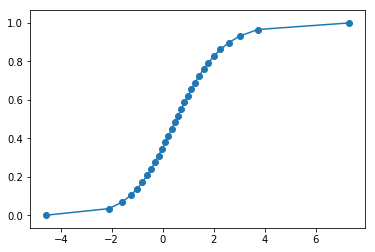

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.343614780842
NCOMPS 1
q minval is -0.715581721153
NCOMPS 1
q minval is -0.715581721153
NCOMPS 2
q minval is -0.715581721153
NCOMPS 1
q minval is -0.715581721153
NCOMPS 1
q minval is -0.715581721153
NCOMPS 2
q minval is -0.757305250201
NCOMPS 2
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 2
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 2
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 2
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 2
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.757305250201
NCOMPS 1
q minval is -0.75730525020

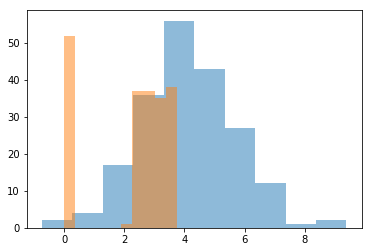

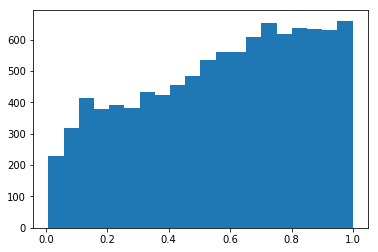

2 FACTORS
100 STUDENTS: [ 1.06] [ 1.55]
100 QUEST/NS: 1.5155900663291733
Offset 0.53204746933
(100, 100, 1.0589890089686147, 1.5535050202275191, 0.53204746933021974, 1.5155900663291733)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


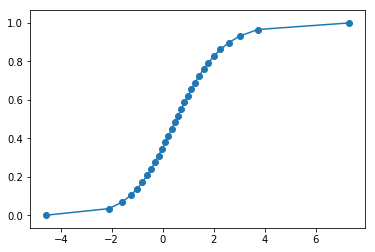

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -0.189988431056
NCOMPS 1
q minval is -0.692352099422
NCOMPS 2
q minval is -0.692352099422
NCOMPS 1
q minval is -0.692352099422
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 1
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 2
q minval is -0.918161151034
NCOMPS 1
q minval is -0.939285353108
NCOMPS 1
q minval is -0.939285353108
NCOMPS 1
q minval is -0.939285353108
NCOMPS 1
q minval is -0.9392853531

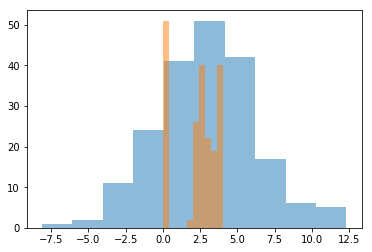

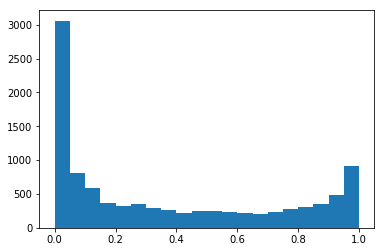

2 FACTORS
100 STUDENTS: [ 0.24] [ 3.42]
100 QUEST/NS: 2.0899165533467263
Offset 0.53204746933
(100, 100, 0.23536783390728733, 3.4156746126102617, 0.53204746933021974, 2.0899165533467263)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


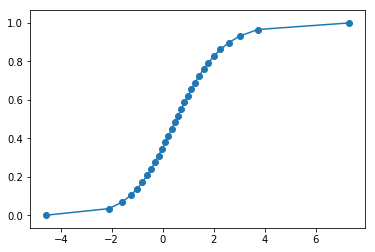

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.685223015262
NCOMPS 1
q minval is -0.872298402539
NCOMPS 1
q minval is -0.981714908766
NCOMPS 2
q minval is -0.981714908766
NCOMPS 2
q minval is -0.981714908766
NCOMPS 2
q minval is -0.981714908766
NCOMPS 2
q minval is -0.981714908766
NCOMPS 2
q minval is -0.981714908766
NCOMPS 1
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 2
q minval is -1.0203113294
NCOMPS 1
q minval is -1.0203113294
NCOMPS 1
q minval is -1.020311329

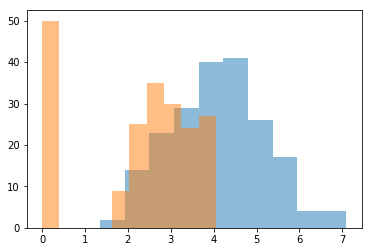

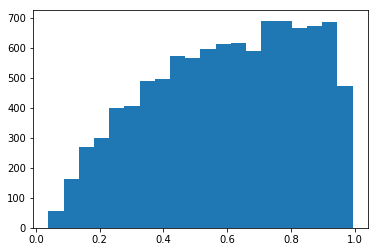

2 FACTORS
100 STUDENTS: [ 1.1] [ 1.17]
100 QUEST/NS: 2.176214305040283
Offset 0.53204746933
(100, 100, 1.0952621480138502, 1.172002218794827, 0.53204746933021974, 2.176214305040283)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


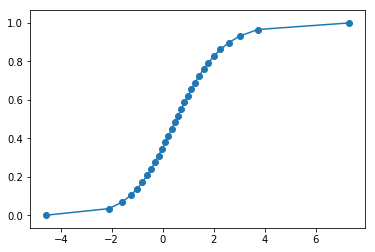

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -1.59362028822
NCOMPS 1
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 2
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 1
q minval is -1.80007900663
NCOMPS 2
q minval is -1.85068833241
NCOMPS 2
q minval is -1.85068833241
NCOMPS 2
q minval is -1.9545830289
NCOMPS 1
q minval is -1.9545830289
NCOMPS 1
q minval is -1.9545830289
NCOMPS 2
q minval is -1.9545830289
NCOMPS 1
q minval is -1.9545830289
NCOMPS 2
q minval is -1.9545830289
NCOMPS 2
q minval is -1.9545830289
NCOMPS 1
q minval is -1.954583

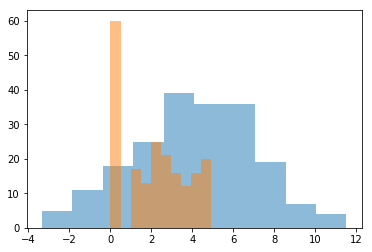

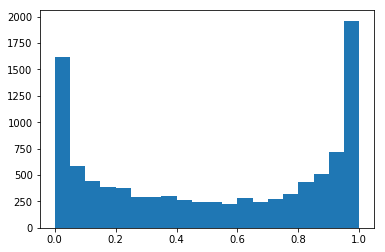

2 FACTORS
100 STUDENTS: [ 0.96] [ 3.]
100 QUEST/NS: 3.920428110921308
Offset 0.53204746933
(100, 100, 0.9604165918691789, 3.0048818641491497, 0.53204746933021974, 3.920428110921308)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


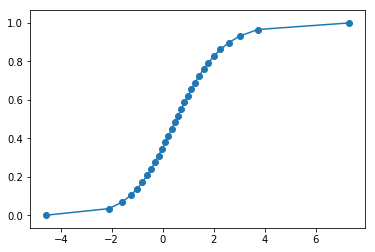

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.972784688185
NCOMPS 1
q minval is -0.972784688185
NCOMPS 1
q minval is -0.972784688185
NCOMPS 1
q minval is -0.972784688185
NCOMPS 2
q minval is -0.972784688185
NCOMPS 1
q minval is -0.972784688185
NCOMPS 2
q minval is -0.972784688185
NCOMPS 2
q minval is -0.972784688185
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 2
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 1
q minval is -1.107931574
NCOMPS 1
q minval

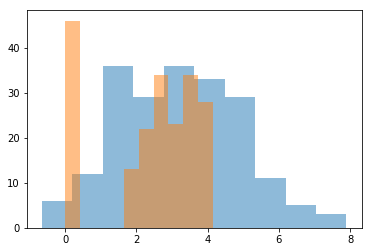

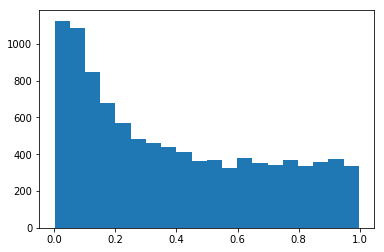

2 FACTORS
100 STUDENTS: [ 0.41] [ 1.54]
100 QUEST/NS: 2.325393661757076
Offset 0.53204746933
(100, 100, 0.4078428272881361, 1.5393945996829874, 0.53204746933021974, 2.325393661757076)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


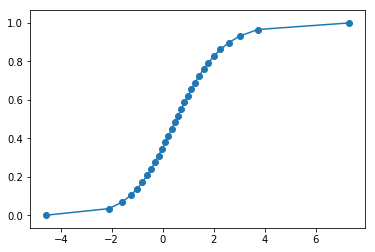

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is -1.37715210594
NCOMPS 1
q minval is -1.37715210594
NCOMPS 2
q minval is -1.37715210594
NCOMPS 1
q minval is -1.37715210594
NCOMPS 1
q minval is -1.37715210594
NCOMPS 2
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 2
q minval is -1.55969722278
NCOMPS 1
q minval is -1.55969722278
NCOMPS 2
q minval is -1.64227862572
NCOMPS 2
q minval is -1.64227862572
NCOMPS 1
q minval is -1.64227862572
NCOMPS 2
q minval is -1.64227862572
NCOMPS 1
q minval is -1

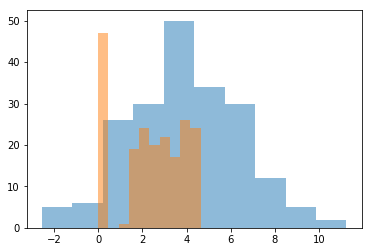

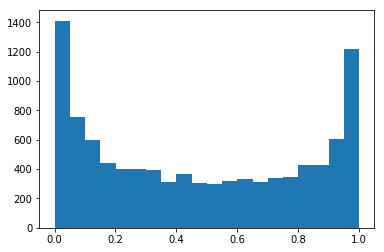

2 FACTORS
100 STUDENTS: [ 0.98] [ 2.47]
100 QUEST/NS: 3.318001432761173
Offset 0.53204746933
(100, 100, 0.9815407183289008, 2.466186084359582, 0.53204746933021974, 3.318001432761173)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


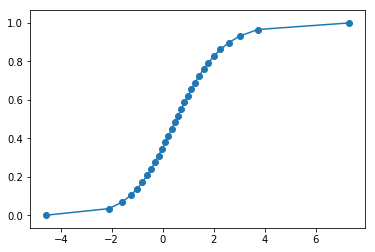

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 0.32731916579
NCOMPS 1
q minval is -0.641001934275
NCOMPS 1
q minval is -0.641001934275
NCOMPS 2
q minval is -0.641001934275
NCOMPS 1
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952
NCOMPS 1
q minval is -0.667718276952
NCOMPS 2
q minval is -0.667718276952

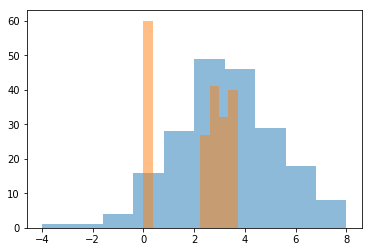

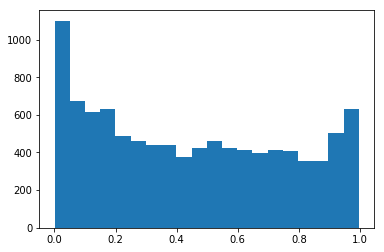

2 FACTORS
100 STUDENTS: [ 0.09] [ 1.99]
100 QUEST/NS: 1.458049752127272
Offset 0.53204746933
(100, 100, 0.08674158606976723, 1.988337997076992, 0.53204746933021974, 1.458049752127272)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


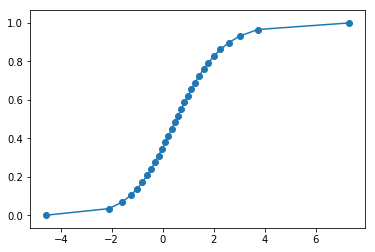

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is 0.0281367568083
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 1
q minval is -2.43331115883
NCOMPS 2
q minval is -

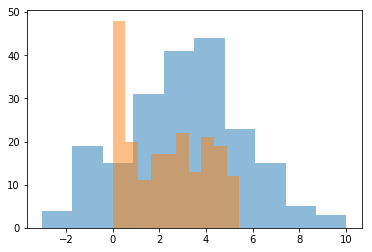

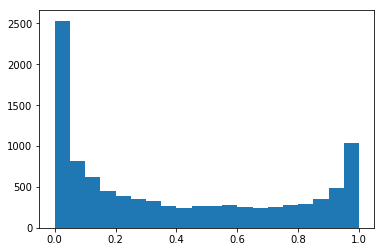

2 FACTORS
100 STUDENTS: [ 0.15] [ 2.41]
100 QUEST/NS: 4.886443952997799
Offset 0.53204746933
(100, 100, 0.14623807428542135, 2.407358928326402, 0.53204746933021974, 4.886443952997799)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


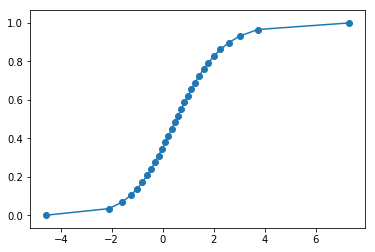

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.55406806452
NCOMPS 1
q minval is -1.61390797816
NCOMPS 2
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 2
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 2
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61390797816
NCOMPS 1
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 1
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 1
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 2
q minval is -1.61676046278
NCOMPS 1
q minval is -1.61676046278
NCOMPS 1
q minval is -1.70536876977
NCOMPS 1
q minval is -1.70536876977
NCOMPS 1
q minval is -1.70536876977
NCOMPS 1
q minval is -1.70536876977
NCOMPS 1
q minval is -1.70536876977
NCOMPS 2
q minval is -1.

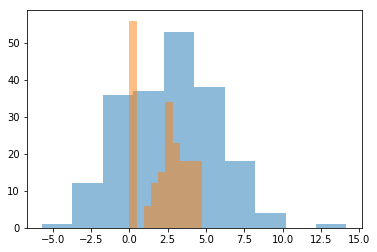

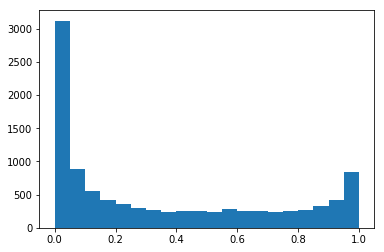

2 FACTORS
100 STUDENTS: [ 0.08] [ 3.11]
100 QUEST/NS: 3.4533577572940413
Offset 0.53204746933
(100, 100, 0.07672634599510908, 3.110732352932533, 0.53204746933021974, 3.4533577572940413)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


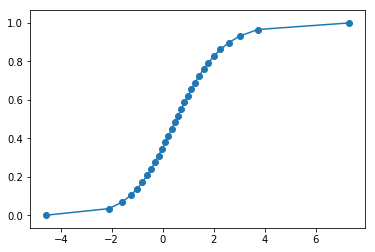

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -1.08636161497
NCOMPS 1
q minval is -1.08636161497
NCOMPS 1
q minval is -1.53473067171
NCOMPS 2
q minval is -1.53473067171
NCOMPS 1
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 1
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 2
q minval is -2.21207433673
NCOMPS 1
q minval is -2

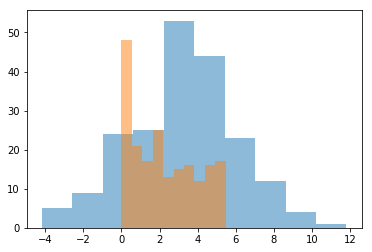

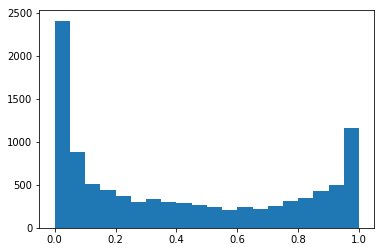

2 FACTORS
100 STUDENTS: [ 0.6] [ 2.97]
100 QUEST/NS: 4.970300235394963
Offset 0.53204746933
(100, 100, 0.6034923451076628, 2.966258477513641, 0.53204746933021974, 4.970300235394963)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


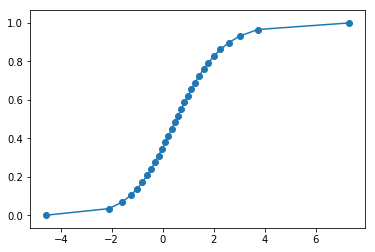

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 1
q minval is 1.00894220359
NCOMPS 2
q minval is -0.929135051174
NCOMPS 2
q minval is -0.929135051174
NCOMPS 1
q minval is -1.09670488954
NCOMPS 1
q minval is -1.09670488954
NCOMPS 1
q minval is -1.09670488954
NCOMPS 2
q minval is -1.40031116807
NCOMPS 1
q minval is -1.40031116807
NCOMPS 1
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 1
q minval is -1.5117172874
NCOMPS 2
q minval is -1.5117172874
NCOMP

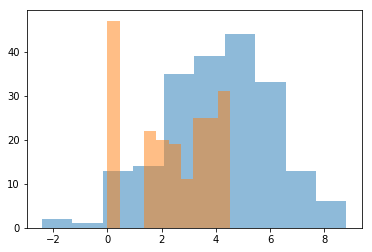

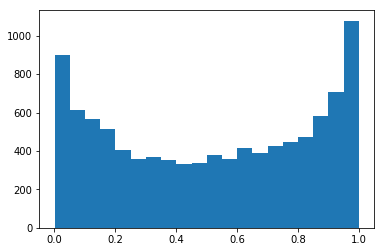

2 FACTORS
100 STUDENTS: [ 1.34] [ 1.99]
100 QUEST/NS: 3.0550418092358678
Offset 0.53204746933
(100, 100, 1.343309090432547, 1.9851472114393096, 0.53204746933021974, 3.0550418092358678)
dvals -4.59511985013 0.53204746933 7.31238665998
inv_logistic curve


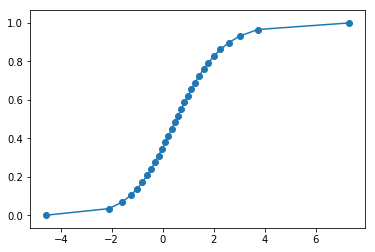

tru spread d50= 0.53204746933 (prob=0.5)
NCOMPS 2
q minval is -0.166768384526
NCOMPS 1
q minval is -0.166768384526
NCOMPS 2
q minval is -0.222219299038
NCOMPS 2
q minval is -0.222219299038
NCOMPS 1
q minval is -0.222219299038
NCOMPS 2
q minval is -0.222219299038
NCOMPS 1
q minval is -0.222219299038
NCOMPS 2
q minval is -0.222219299038
NCOMPS 2
q minval is -0.222219299038
NCOMPS 2
q minval is -0.222219299038
NCOMPS 1
q minval is -0.222219299038
NCOMPS 1
q minval is -0.222219299038
NCOMPS 2
q minval is -0.241329410502
NCOMPS 1
q minval is -0.241329410502
NCOMPS 1
q minval is -0.241329410502
NCOMPS 2
q minval is -0.241329410502
NCOMPS 2
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 2
q minval is -0.241626701589
NCOMPS 1
q minval is -0.241626701589
NCOMPS 1
q minval is -0.2416267015

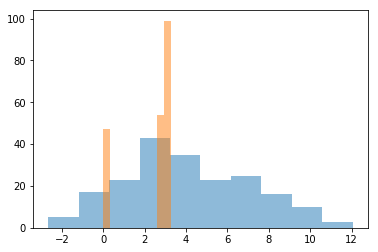

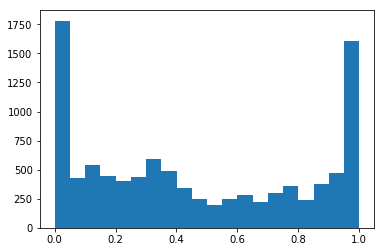

2 FACTORS
100 STUDENTS: [ 1.02] [ 3.2]
100 QUEST/NS: 0.5071251994647494
Offset 0.53204746933
(100, 100, 1.0171360601887771, 3.202541514647981, 0.53204746933021974, 0.5071251994647494)


In [17]:
# n_factors, a0, a1, min_active, max_active = (5, 9, 1, 1, 3)
# n_factors, a0, a1, min_active, max_active = (100, 0, 1, 1, 5)
n_factors, min_active, max_active = (2,1,2)

for a in range(100):
    n_students = 100 # int(10**(scipy.stats.truncnorm.rvs(2,4, size=1)))
    n_questions = 100 # int(numpy.random.uniform(15,35, size=1))
    a1 = numpy.random.uniform(1, 3.5, size=1)
    a0 = numpy.random.uniform(-0.5,1, size=1)
    av_c = (min_active + max_active)/2
    offset = pr_to_spread(0.5, comps=av_c, as_A_and_D=False)
    a0 = a0 + offset
    test_w = numpy.random.uniform(0.5, 5)

    obs, probz, students, questions  = gen_run(n_factors, a0, a1, min_active, max_active, s_gen="truncnorm", q_gen="u_uniform", test_w = test_w)

    print("~ ~ ~ ~~ ATTEMPT",a)
    plt.hist(students.flatten(), alpha=0.5)
    plt.hist(questions.flatten(), alpha=0.5)
    plt.show()
    plt.hist(probz.flatten(), bins=20)
    plt.show()
    print("{} FACTORS".format(n_factors))
    print("{} STUDENTS: {} {}".format(n_students, a0, a1))
    print("{} QUEST/NS: {}".format(n_questions, test_w))
    print("Offset", offset)
    print((n_students, n_questions, float(a0), float(a1), offset, test_w))

In [ ]:
for orow in obs:
    srow = map(str, map(int, list(orow)))
    srow = "".join(srow)
    print(srow)

In [ ]:
def check_object_invariance(students, questions, probs):
    all_ok = True
    false_ixs = []
    for six,srow in enumerate(students):
        for iix, qrow1 in enumerate(questions):
            for jix, qrow2 in enumerate(questions):
                spd_si = srow - qrow1
                spd_sj = srow - qrow2
                p_si_1 = probs[six,iix] #logistic(spd_si, 1,0)
                p_si_0 = (1 - p_si_1)
                p_sj_1 = probs[six,jix] #logistic(spd_sj, 1,0)
                p_sj_0 = (1 - p_sj_1)
#                 print(round(float((p_si_1 * p_sj_0)/(p_si_0 * p_sj_1)),5),"=?",round(math.exp(qrow2 - qrow1),5))
                istrue = (numpy.isclose((p_si_1 * p_sj_0)/float(p_si_0 * p_sj_1), math.exp(qrow2 - qrow1)))
#                 print(istrue)
                if not istrue:
                    all_ok=False
                    false_ixs.append((srow, qrow1, qrow2))
    return all_ok, false_ixs

all_ok, fixs = check_object_invariance(students, questions, probz)
print(all_ok)
print(fixs)

In [ ]:
# students = gen_students(100, 9, 1, 100)
# questions, minval = gen_questions(100, 9, 1, 1,5, gen_mode="uniform")
# # plt.hist(questions.flatten())
# print(minval)
# q2 = questions
# q2[q2>0] = q2[q2>0] - minval +6
# s2 = students - minval +6
# plt.hist(q2.flatten(), alpha=0.5)
# plt.hist(s2.flatten(), alpha=0.5)

# plt.show()

In [4]:
from keras.regularizers import l1
from keras.layers import multiply, subtract, Dense
from keras import backend as K
from keras.optimizers import Adam
def generate_qs_model(optimiser, comp_lims=True, q_train=True, s_train=True):
    psi_row = Input(shape=(n_questions,), name="psi_in")
    qn_row = Input(shape=(n_students,), name="q_in")

    alphaz = Dense(n_factors, activation="relu", name="alphas", use_bias=False)(psi_row)
    deltaz = Dense(n_factors, activation="relu", name="deltas", use_bias=False)(qn_row)
    q_masque = Lambda(lambda q: K.clip(q,0,1))(deltaz)
    
    difs = subtract([alphaz, deltaz])
    
    Prs = Lambda(lambda z: (1.0 / (1.0 + K.exp(-z))), name="Pr_sigmoid1")(difs)
#     Prs = Lambda(lambda ps_q:  ps_q[0]*ps_q[1] + (1.0-ps_q[1]) ) ([Prs, q_masque])
    Prs = Lambda(lambda ps_q:  K.pow(ps_q[0],ps_q[1]) ) ([Prs, q_masque])
    score = Lambda(lambda ps: K.prod(ps, keepdims=True, axis=1), name="score")(Prs)
            
    model = Model(inputs=[qn_row, psi_row], outputs=score)
    model.compile(optimizer=optimiser, loss="mse", metrics=["accuracy"])# metrics=[ident_loss(five_loss), ident_loss(one_loss),"accuracy"])
        
    print(model.summary())

    return model

In [ ]:
from collections import defaultdict
# from keras import regularizers


# n_factors = 100
# n_students = 1000
# n_questions = 100

frak = 1
pairs_to_use = [(v,m) for v in range(n_students) for m in range(n_questions)]
seenkeys = []
seen = defaultdict(list)
# if frak != 1:
#     all_pair_ixs = list(range(len(all_pairs)))
#     print(all_pairs[0:10])
#     pairs_to_use = numpy.random.choice(all_pair_ixs, size=int(max(frak*len(all_pairs),10000)), replace=True)
#

# av_c = (min_active + max_active)/2
av_c=n_factors
inv_sigmoid = lambda p: -numpy.log(1/p - 1)
p50 = inv_sigmoid( 0.5**(1/av_c) )
print("p50 is ", p50, "for comps", av_c)

# s_table =  BigTable((n_students, n_factors), 6, 12, init_hilo=9)#, regulariser=regularizers.l1(10e-6))
# qn_table = BigTable((n_questions, n_factors), 0, 12, init_hilo=9-p50)#, regulariser=regularizers.l1(10e-6))

smin = min(students.flatten())
smax = max(students.flatten())
qmin = min(questions.flatten())
qmax = max(questions.flatten())
students = students - smin
questions = questions - smin


smin = min(students.flatten())
smax = max(students.flatten())
qmin = min(questions.flatten())
qmax = max(questions.flatten())
print(smin, smax, "s/q", qmin, qmax)


w=n_factors
# s_table =  BigTable((n_students, w), 0, 20, init_hilo=10)#, regulariser=regularizers.l1(10e-6))
# qn_table = BigTable((n_questions, w), 0, 20, init_hilo=10-p50)#, regulariser=regularizers.l1(10e-6))
# qn_table = BigTable((n_questions, w), 0, 20, init_hilo=0)#, regulariser=regularizers.l1(10e-6))

# s_table =  BigTable((n_students, w), 0, 12, init_hilo=6)#, regulariser=regularizers.l2(10e-6))
# # qn_table = BigTable((n_questions, w), 0, 10, init_hilo=5-p50)#, regulariser=regularizers.l1(10e-6))
# qn_table = BigTable((n_questions, w), 0, 12, init_hilo=6-p50)#, regulariser=regularizers.l1(10e-6))


In [ ]:
print(len(students))
print(len(questions))

In [5]:
def tvt_split(sws, qws):

    all_sz = []
    all_qz = []
    all_pfz = []

    sig = lambda z : 1/(1+numpy.exp(-z))
    obs = numpy.zeros((len(sws), len(qws)))
    probs = numpy.zeros((len(sws), len(qws)))
    #obs = numpy.matmul(viewers, movies.T)/n_factors
    vz = []
    mz = []
    scz =[]
    all_pfz=[]
    all_pairs = set()
    attempt_lookup = defaultdict(list)
    cts=[]
    for vi in range(len(sws)):
        for mi in range(len(qws)):
            for _ in range(1):
                all_pairs.add((vi,mi))
                zmask = (qws[mi]<0.0001).astype(int)
                deltas = sws[vi]-qws[mi]
                prs = logistic(deltas,1,0)
                prs = numpy.maximum(zmask,prs)

        #         print(vi,mi)
        #         print("S", students[vi])
        #         print("Q", questions[mi])
        #         print("Z", zmask)
        #         print("D", deltas)
        #         print("p", prs)
        #         print("P", numpy.prod(prs))
                pr = numpy.prod(prs)
                ct=0

                rd = random.random()
#                     print(vi, mi, pr, rd)
                ob = (rd < pr)
                obs[vi,mi] = ob
                probs[vi,mi] = pr
                all_pfz.append(ob)
    #             print(vi,mi, numpy.prod(prs))

    for vi in range(obs.shape[0]):
        for mi in range(obs.shape[1]):
            attempt_lookup[(vi,mi)] = [obs[vi,mi],]
            
    print("len all_pfz", len(all_pfz))
    plt.hist(all_pfz)
    plt.show()

    plt.hist(probs.flatten())
    plt.show()
    
    plt.hist(cts, range=[0,10])
    plt.show()

    print("OBS SSHAPE", obs.shape)

    frak=1
    all_pair_ixs = list(range(len(all_pairs)))
    # ixs_to_use = numpy.random.choice(all_pair_ixs, size=int(max(frak*len(all_pairs),10)), replace=True)
    # pairs_to_use = numpy.array(all_pairs)[ixs_to_use]

    all_ixs = all_pair_ixs
    
    val_ixs = numpy.random.choice(all_pair_ixs, size=1000, replace=False) #len(attempts)//100, replace=False)
    trn_ixs = list(set(all_ixs) - set(val_ixs))
    test_ixs = numpy.random.choice(trn_ixs, size=1000, replace=False) #len(attempts)//100, replace=False)
    trn_ixs = list(set(trn_ixs) - set(test_ixs))
    print("tvt:", len(all_ixs), len(trn_ixs), len(test_ixs))

    all_sz = numpy.array(all_sz)
    all_qz = numpy.array(all_qz)
    all_pfz = numpy.array(all_pfz)
    print("len all_pfz", len(all_pfz))

    all_pairs = sorted(list(all_pairs))
    test_pairs = [all_pairs[ix] for ix in test_ixs]
    val_pairs = [all_pairs[ix] for ix in val_ixs]
    train_pairs = [all_pairs[ix] for ix in trn_ixs]
    
    tsz=[]
    tqz=[]
    tpfz=[]
    
    vsz=[]
    vqz=[]
    vpfz=[]
    
    sz=[]
    qz=[]
    pfz=[]
    
    for tp in test_pairs:
        scores = attempt_lookup[tp]
        for sc in scores:
            tsz.append(obs[tp[0],:])
            tqz.append(obs[:,tp[1]])
            tpfz.append(sc)
            
    for tp in val_pairs:
        scores = attempt_lookup[tp]
        for sc in scores:
            vsz.append(obs[tp[0],:])
            vqz.append(obs[:,tp[1]])
            vpfz.append(sc)

    for tp in train_pairs:
        scores = attempt_lookup[tp]
        for sc in scores:
            sz.append(obs[tp[0],:])
            qz.append(obs[:,tp[1]])
            pfz.append(sc)

    tsz=numpy.array(tsz)
    tqz=numpy.array(tqz)
    tpfz=numpy.array(tpfz)
    
    vsz=numpy.array(vsz)
    vqz=numpy.array(vqz)
    vpfz=numpy.array(vpfz)
    
    sz=numpy.array(sz)
    qz=numpy.array(qz)
    pfz=numpy.array(pfz)
    
    
#     tsz = all_sz[test_ixs]
#     tqz = all_qz[test_ixs]
#     tpfz = all_pfz[test_ixs]

#     vsz = all_sz[val_ixs]
#     vqz = all_qz[val_ixs]
#     vpfz = all_pfz[val_ixs]

#     sz = all_sz[trn_ixs]
#     qz = all_qz[trn_ixs]
#     pfz = all_pfz[trn_ixs]

    print("best train score is", max(sum(pfz >= 0.5), sum(pfz < 0.5))/len(pfz))
    print("best test score is", max(sum(tpfz >= 0.5), sum(tpfz < 0.5))/len(tpfz))
    print("best val score is", max(sum(vpfz >= 0.5), sum(vpfz < 0.5))/len(vpfz))
    
    return (sz,qz,pfz), (vsz,vqz,vpfz), (tsz,tqz,tpfz), obs, probs, (test_pairs, val_pairs, train_pairs)

len all_pfz 100000


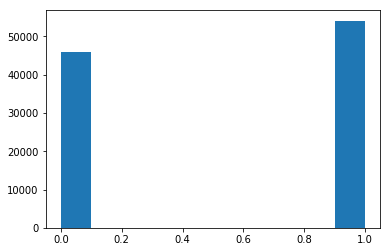

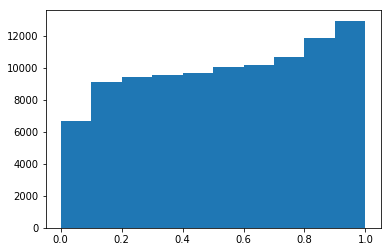

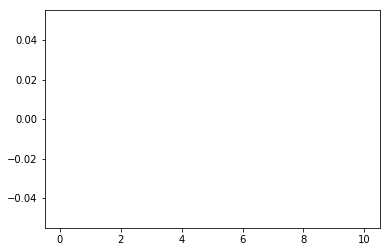

OBS SSHAPE (1000, 100)
tvt: 100000 98000 1000
len all_pfz 100000
best train score is 0.5415
best test score is 0.534
best val score is 0.508
[[ 1.  1.  0. ...,  1.  1.  1.]
 [ 1.  1.  0. ...,  1.  1.  1.]
 [ 1.  1.  0. ...,  1.  1.  1.]
 ..., 
 [ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]
 [ 1.  1.  1. ...,  1.  1.  1.]]
[ 1.  0.  0.  1.  0.  0.  0.  0.  0.  0.  0.  1.  0.  1.  1.  0.  0.  1.
  0.  1.  0.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.
  0.  0.  1.  1.  0.  1.  1.  0.  1.  0.  1.  0.  0.  0.  1.  0.  1.  1.
  0.  0.  0.  0.  0.  0.  0.  1.  0.  0.  1.  1.  0.  1.  1.  1.  1.  1.
  0.  0.  1.  0.  1.  1.  1.  0.  0.  1.  1.  1.  0.  0.  1.  0.  0.  0.
  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  1.  0.  1.  0.  1.  1.  0.
  0.  0.  1.  1.  0.  0.  0.  1.  0.  0.  0.  1.  0.  1.  0.  0.  0.  1.
  0.  1.  1.  1.  0.  0.  1.  0.  1.  0.  1.  1.  1.  1.  0.  1.  1.  0.
  0.  1.  1.  0.  1.  0.  1.  1.  0.  1.  1.  1.  1.  1.  0.  0.  1.  1.
  

In [20]:
(sz,qz,pfz), (vsz,vqz,vpfz), (tsz,tqz,tpfz), obs, probs, (test_pairs, val_pairs, train_pairs) = tvt_split(students, questions)
print(sz)
print(vpfz)

In [ ]:
print(obs.shape)
rho_mx = numpy.corrcoef(obs.T)
print(rho_mx)
print(rho_mx.shape)

In [ ]:
import sklearn
rho_mx2 = sklearn.metrics.pairwise.(obs.T,obs.T)
numpy.set_printoptions(threshold=100)
print(rho_mx2)
print(rho_mx2.shape)

In [ ]:
data_items = obs

# Get the artists the user has likd.
scores = []
for user_index in range(len(students)):
    known_user_likes = data_items[user_index,:]
#     print(known_user_likes)
    # known_user_likes = known_user_likes[known_user_likes >0].index.values
    # known_user_likes = numpy.argwhere(known_user_likes)

#     print(rho_mx2.sum(axis=0))

    # Calculate the score.
#     score = rho_mx2.dot(known_user_likes) / (rho_mx2.sum(axis=0))

    for i in range(len(questions)):
        sum_nom=0
        sum_denom=0
        wi = rho_mx[i,:]
        ru = (data_items[user_index, :]*2)-1
        for j in range(len(questions)):
            if i!=j:
                sum_nom += wi[j]*ru[j]
#             sum_denom += abs(wij)
        score = sum_nom
        numpy.set_printoptions(precision=5)
        scores.append(score)

def softmax(x):
    return numpy.exp(x) / numpy.sum(numpy.exp(x), axis=0)
        
max_mag = len(questions)-1
scores = [(sc + max_mag)/(2*max_mag) for sc in scores]

k=0
for user_index in range(len(students)):
    for i in range(len(questions)):
        print(user_index, i, scores[k])
        k+=1

#         print(students[user_index])
    # Remove the known likes from the recommendation.
    # score = numpy.delete(score, known_user_likes)

    # Print the known likes and the top 20 recommendations.

    # print (score.argsort()[::-1][:20])
    

In [ ]:
for ix in range(len(qws)):
    flags = (qws[ix]>1).astype(int) 
    print(flags, sum(flags))
# print((qws>=1).astype(int))

In [ ]:
numpy.set_printoptions(precision=2)
for vi,mi,sc in zip(sz,qz,pfz):
    print(vi,mi,sc)

In [ ]:
print("TRUE VALS")
# print(numpy.min(questions), numpy.min(questions[questions.nonzero()]), numpy.max(questions))
print(numpy.min(questions), numpy.max(questions))
print(numpy.min(students), numpy.max(students))
print("--- EMB VALS (prior):")
qws = qn_table.get_weights()[0]
sws = s_table.get_weights()[0]
# print(numpy.min(qws), numpy.min(qws[qws>=1]), numpy.max(qn_table.get_weights()[0]))
print(numpy.min(qws), numpy.max(qn_table.get_weights()[0]))
print(numpy.min(s_table.get_weights()[0]), numpy.max(s_table.get_weights()[0]))


# print(qws)

In [ ]:
print(qz)

preds = m.predict(x=[qz,sz])
for sc_true, sc_hat in zip(pfz[0:100],preds[0:100]):
    print(sc_true, sc_hat)

# print(m.evaluate(x=[mz,vz], y=scz))
from sklearn.metrics import accuracy_score, mean_absolute_error
print(accuracy_score(numpy.around(pfz), numpy.around(preds)  ))

s_scores = defaultdict(list)

for six in range(len(students)):
    scs = m.predict(x=[numpy.array(range(len(questions))).reshape(-1,1), numpy.array(six).repeat(len(questions))])
    s_scores[six].extend(scs)

for six in range(len(students)):
    s_av = float(numpy.median(s_scores[six]))
    print(six, s_av)


In [7]:
# wz = m.get_weights()
# s_table =  BigTable((n_students, n_factors), 6, 100, init_hilo=10)#, regulariser=regularizers.l1(10e-6))
# qn_table = BigTable((n_questions, n_factors), 0, 100, init_hilo=10-p50)#, regulariser=regularizers.l1(10e-6))
# qm = generate_qs_model(qn_table, s_table, Adam(), comp_lims=False, s_train=False, q_train=True)
# sm = generate_qs_model(qn_table, s_table, Adam(), comp_lims=False, s_train=True, q_train=False)
def generate_and_train(qz,sz,pfz, vqz,vsz,vpfz):
    m = generate_qs_model(Adam(), comp_lims=False, s_train=True, q_train=True)
    es = EarlyStopping(monitor="loss", restore_best_weights=True, patience=10)
    h = m.fit(x=[qz,sz], y=numpy.array(pfz).reshape(-1,1), batch_size=1000, shuffle=True, epochs=10000, verbose=1, callbacks=[es])#, validation_data=[[vqz,vsz], vpfz])
    return m, h

In [21]:
m, h = generate_and_train(qz,sz,pfz, vqz,vsz,vpfz)

__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
psi_in (InputLayer)             (None, 100)          0                                            
__________________________________________________________________________________________________
q_in (InputLayer)               (None, 1000)         0                                            
__________________________________________________________________________________________________
alphas (Dense)                  (None, 2)            200         psi_in[0][0]                     
__________________________________________________________________________________________________
deltas (Dense)                  (None, 2)            2000        q_in[0][0]                       
__________________________________________________________________________________________________
subtract_2

In [22]:
print(len(m.layers))
for L in m.layers:
    print(L.name)

names = [weight.name for layer in m.layers for weight in layer.weights]
weights = m.get_weights()

for name, weight in zip(names, weights):
    print(name)
    print(weight)

psi_row = Input(shape=(n_questions,), name="psi_in")
# alphaz = Dense((n_questions+n_factors)//2, weights=m.layers[2].get_weights(), activation="relu", name="alphas", use_bias=False)(psi_row)
alphaz = Dense(n_factors, weights=m.layers[2].get_weights(), activation="relu", name="alphas2", use_bias=False)(psi_row)
# alphaz = Dense(n_factors, weights=m.layers[6].get_weights(), activation="relu", name="alphas3")(alphaz)
amod = Model(inputs=psi_row, outputs=alphaz)
amod.compile(optimizer=Adam(), loss="binary_crossentropy", metrics=["accuracy"])# metrics=[ident_loss(five_loss), ident_loss(one_loss),"accuracy"])

qn_row = Input(shape=(n_students,), name="q_in")
# deltaz = Dense((n_students+n_factors)//2, weights=m.layers[3].get_weights(), activation="relu", name="deltas", use_bias=False)(qn_row)
deltaz = Dense(n_factors, weights=m.layers[3].get_weights(), activation="relu", name="deltas2", use_bias=False)(qn_row)
# deltaz = Dense(n_factors, weights=m.layers[7].get_weights(), activation="relu", name="deltas3")(deltaz)
qmod = Model(inputs=qn_row, outputs=deltaz)
qmod.compile(optimizer=Adam(), loss="binary_crossentropy", metrics=["accuracy"])# metrics=[ident_loss(five_loss), ident_loss(one_loss),"accuracy"])

# for six, s in enumerate(students):
#     shat = amod.predict(obs[six,:].reshape(1,-1))
#     print("STRU:", s)
#     print("SHAT:", shat)

# for qix, q in enumerate(questions):
#     qhat = qmod.predict(obs[:,qix].reshape(1,-1))
#     print("QTRU:",q)
#     print("QHAT:",qhat)

9
psi_in
q_in
alphas
deltas
subtract_2
Pr_sigmoid1
lambda_3
lambda_4
score
alphas_1/kernel:0
[[  4.49e-02   5.84e-02]
 [  5.83e-02  -1.26e-02]
 [ -8.89e-02   1.16e-01]
 [  2.99e-02   9.49e-02]
 [ -5.05e-02   1.84e-01]
 [  6.93e-02   2.82e-02]
 [  2.93e-02   4.08e-02]
 [  3.48e-03   5.46e-02]
 [  1.06e-02   1.35e-01]
 [  9.87e-05   8.03e-02]
 [  8.18e-02  -8.04e-03]
 [  1.63e-01  -2.00e-02]
 [  2.64e-02   8.19e-02]
 [  8.80e-02   2.29e-02]
 [  2.05e-01  -3.62e-02]
 [  1.41e-01  -3.01e-02]
 [  2.12e-02   3.13e-03]
 [  1.47e-01  -4.87e-02]
 [  5.79e-02   3.67e-02]
 [ -2.73e-02   9.31e-02]
 [ -7.08e-02   1.17e-01]
 [  2.15e-01  -4.54e-02]
 [  5.38e-02   6.00e-02]
 [ -9.77e-03   1.31e-01]
 [  6.49e-02   5.99e-02]
 [  1.91e-01  -2.63e-02]
 [  9.46e-02  -2.18e-02]
 [  1.58e-01  -2.46e-02]
 [  1.88e-01  -5.28e-02]
 [ -4.20e-03   5.47e-02]
 [ -3.86e-02   1.38e-01]
 [  2.28e-01  -6.86e-03]
 [ -1.96e-02   1.38e-01]
 [  1.09e-01   1.49e-02]
 [  1.19e-02   4.10e-02]
 [ -4.46e-02   1.26e-01]
 [ -2.2

In [ ]:
for six in range(len(students)):
    for qix in range(len(questions)):
        Xs = obs[six,:].reshape(1,-1)
        Xq = obs[:,qix].reshape(1,-1)
        shat = amod.predict(Xs)
        qhat = qmod.predict(Xq)
        s = students[six]
        q = questions[qix]
        pred = m.predict([Xq,Xs])
        true = obs[six,qix]
        pr = probs[six,qix]

        print(six, qix)
        print(s, shat)
        print(q, qhat)
        print(true, pr, pred)
        print("----")

In [10]:
sws = amod.predict(obs)
qws = qmod.predict(obs.T)

In [ ]:
for six in range(len(students)):
    print("....",six)
    scs = m.predict(x=[numpy.array(range(len(questions))).reshape(-1,1), numpy.array(six).repeat(len(questions))])
    for qix in range(len(questions)):
        print(qix, " : ", scs[qix], obs[six,qix])
#     s_scores[six].extend(scs)

# for six in range(len(students)):
#     s_av = float(numpy.median(s_scores[six]))
#     print(six, s_av)
    
    
    

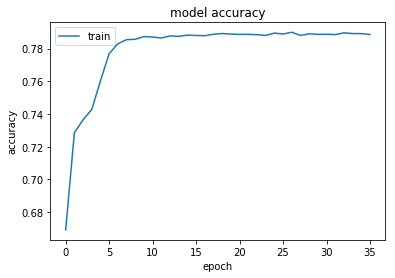

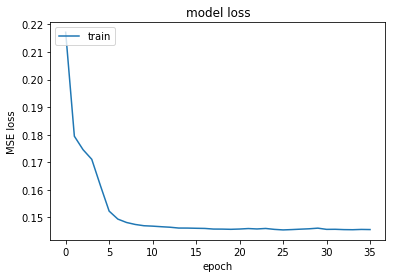

In [11]:
def plot_history(history):
    plt.plot(history.history['acc'])
#     plt.plot(history.history['val_acc'])
    plt.title('model accuracy')
    plt.ylabel('accuracy')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()

    plt.plot(history.history['loss'])
#     plt.plot(history.history['val_loss'])
    plt.title('model loss')
    plt.ylabel('MSE loss')
    plt.xlabel('epoch')
    plt.legend(['train', 'val'], loc='upper left')
    plt.show()
    
plot_history(h)

In [ ]:
right_ct=0
# preds = m.predict(x=[qz,sz])
# for q,s, sc_obsv, sc_hat in zip(qz,sz,pfz,preds):
#     print(q,s, sc_obsv, sc_hat, "right" if (numpy.around(sc_obsv)==numpy.around(sc_hat)) else "X")

print(len(pfz), len(tpfz))
right_ct=0
preds = m.predict(x=[tqz,tsz]).flatten()
print(preds)
# flags = numpy.random.random(size=len(preds))
# print(flags)
# preds = flags <= preds
ground_truths = []
zipd_list = sorted(list(zip(tsz, tqz,tpfz,preds)))
for s,q, sc_obsv, sc_hat in zipd_list:
#     sc_hat_stoc = (random.random() < sc_hat)
    pr = probs[s,q]
    print(q,s, sc_obsv, pr, sc_hat, "right" if (numpy.around(pr)==numpy.around(sc_hat)) else "X")
    ground_truths.append((pr,sc_hat))
#     print(sc_obsv, sc_hat, res)

# print(m.evaluate(x=[tmz,tvz], y=tscz))

from sklearn.metrics import accuracy_score, mean_absolute_error
print(preds.shape)

# print(right_ct / len(tpfz))

print("#########")
for (g,p) in ground_truths:
    print(g,p)

print("obvsd acc", accuracy_score(numpy.around([g[0] for g in ground_truths]), numpy.around([g[1] for g in ground_truths])))
# print("non-stoch acc", accuracy_score(numpy.around(t_probz), numpy.around(preds)))
# print(mean_absolute_error(t_probz, preds))
#0.000302638761699 MSE MxMul


In [ ]:
for qix in range(len(questions)):
    kcs = numpy.argwhere(questions[qix] > 1)
    
    klevs = questions[qix][kcs.flatten()] 
    print(qix, ["{}={}".format(k,round(klev,2)) for (k,klev) in zip(kcs.flatten(),klevs)])

In [12]:
# qws = qn_table.get_weights()[0]
# sws = s_table.get_weights()[0]
# # qmin = min(qws)

#(test_pairs, val_pairs, train_pairs)

offset = numpy.mean(students) - numpy.mean(sws) 
qws = qws #+ offset
sws = sws #S+ offset
print(len(qws.flatten()))
print(len(questions.flatten()))
item_RMSE = numpy.sqrt(numpy.mean(numpy.square(numpy.sort(qws.flatten()) - numpy.sort(questions.flatten()))))
item_MAE = numpy.mean(numpy.abs(numpy.sort(qws.flatten()) - numpy.sort(questions.flatten())))
# item_RMSE = numpy.sqrt(numpy.mean(numpy.square(qws.flatten() - questions.flatten())))
# item_MAE = numpy.mean(numpy.abs(qws.flatten() - questions.flatten()))

print(item_RMSE, item_MAE)

200
200
0.291810886224 0.241857370732


STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.88] 0.88349850426
[ 1.    0.88] 0.87793725729
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.37] 0.369125384566
[ 1.    0.24] 0.235400334001
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.38] 0.382452462614
[ 1.    0.29] 0.289457380772
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.51] 0.512299236854
[ 1.    0.32] 0.318885564804
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.91] 0.905048053178
[ 1.    0.84] 0.842864155769
STUDENT 5
[ 6.43  4.85]
[ 5.4   4.71]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.85] 0.85292915146
[ 1.    0.88] 0.883823156357
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.08] 0.0843334950864
[ 1.    0.12] 0.118584908545
STUDENT 

[ 1.   0.9] 0.897718071938
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.68] 0.683351650006
[ 1.    0.48] 0.481746196747
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.77] 0.769967926281
[ 1.    0.76] 0.757566332817
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.82] 0.820100573676
[ 1.    0.74] 0.742881238461
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.76] 0.75527399409
[ 1.    0.75] 0.753816246986
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.   0.6] 0.597731991657
[ 1.    0.37] 0.370258688927
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.95] 0.952733022558
[ 1.    0.85] 0.852917671204
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.   0.2] 0.203733442876
[ 1

[ 0.    2.68]
Comp. Prs:
[ 1.    0.31] 0.305152850679
[ 1.    0.22] 0.221527978778
STUDENT 198
[ 4.48  3.12]
[ 4.12  3.07]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.51] 0.506734561856
[ 1.    0.59] 0.594759225845
STUDENT 199
[ 3.32  0.93]
[ 2.6   0.12]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.   0.1] 0.103439734291
[ 1.    0.07] 0.0715508908033
STUDENT 200
[ 1.71  5.87]
[ 0.48  5.12]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.94] 0.941496127793
[ 1.    0.92] 0.919283151627
STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.57] 0.566404883087
[ 1.    0.66] 0.657810926437
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.66] 0.661779522418
[ 1.    0.69] 0.685898542404
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.27] 0.26855124104
[ 1.    0.21] 0.212790280581
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 0
[ 0.    

STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.57] 0.568985927569
[ 1.    0.57] 0.568992078304
STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.28] 0.28303714092
[ 1.    0.21] 0.213277161121
STUDENT 295
[ 2.54  5.56]
[ 2.49  4.69]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.92] 0.921965703991
[ 1.    0.88] 0.88103312254
STUDENT 296
[ 6.86  1.84]
[ 4.93  0.98]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.22] 0.2217203772
[ 1.    0.15] 0.15455417335
STUDENT 297
[ 4.16  4.83]
[ 3.47  4.23]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.85] 0.850369748281
[ 1.    0.82] 0.824442386627
STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.38] 0.381565675628
[ 1.    0.25] 0.252211540937
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.55] 0.548636678516
[ 1.    0.43] 0.431293100119

[ 3.87  5.52]
[ 4.12  5.05]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.92] 0.919154976753
[ 1.    0.91] 0.913949966431
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.75] 0.750615563592
[ 1.    0.55] 0.552841186523
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.32] 0.32196597523
[ 1.    0.23] 0.231638655066
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.26] 0.256286126821
[ 1.    0.19] 0.187824517488
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.83] 0.834123524524
[ 1.    0.83] 0.829501450062
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.21] 0.208941234545
[ 1.   0.2] 0.204590961337
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.42] 0.419929993129
[ 1.   0.4] 0.39957088232
STUDENT 39

[ 1.    0.17] 0.174988478422
STUDENT 469
[ 5.06  3.51]
[ 4.92  2.64]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.   0.6] 0.603166330036
[ 1.    0.49] 0.48934417963
STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.99] 0.991266120441
[ 1.    0.96] 0.959355473518
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.79] 0.785557649503
[ 1.    0.83] 0.825437903404
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.83] 0.832840321796
[ 1.    0.89] 0.889121592045
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.71] 0.712439031129
[ 1.    0.84] 0.837855577469
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.31] 0.312539723795
[ 1.   0.4] 0.397814452648
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.63] 0.6310146761

STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.17] 0.174754255268
[ 1.    0.09] 0.0929658859968
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.67] 0.673276078269
[ 1.    0.79] 0.794505894184
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.57] 0.568632664436
[ 1.    0.35] 0.346435010433
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.87] 0.873157020786
[ 1.    0.74] 0.744534254074
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.94] 0.944480445563
[ 1.    0.95] 0.948330104351
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.59] 0.586922845847
[ 1.    0.65] 0.6477445364
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.23] 0.228469210704
[ 1.    0.13] 0.129244

STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.67] 0.674365609624
[ 1.   0.8] 0.804189264774
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.64] 0.635973354686
[ 1.    0.62] 0.622300744057
STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.07] 0.0718074281475
[ 1.    0.11] 0.110459446907
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.65] 0.649495784117
[ 1.    0.68] 0.681457877159
STUDENT 655
[ 5.49  2.9 ]
[ 4.86  1.96]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.45] 0.450709807333
[ 1.    0.33] 0.326685130596
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.49] 0.492308322674
[ 1.    0.41] 0.405624449253
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.93] 0.931377130674
[ 1.    0.84] 0.8367197513

STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.98] 0.977847421074
[ 1.    0.96] 0.958779752254
STUDENT 746
[ 3.66  3.01]
[ 3.74  2.21]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.48] 0.47817137304
[ 1.    0.38] 0.382987737656
STUDENT 747
[ 6.21  2.48]
[ 4.61  1.22]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.35] 0.350430476889
[ 1.    0.19] 0.187372669578
STUDENT 748
[ 3.96  3.19]
[ 3.28  2.61]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.53] 0.525260510173
[ 1.    0.48] 0.481021404266
STUDENT 749
[ 3.97  3.8 ]
[ 3.46  3.06]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.67] 0.669373796794
[ 1.    0.59] 0.592278659344
STUDENT 750
[ 4.09  5.01]
[ 3.41  4.78]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.87] 0.872084451985
[ 1.    0.89] 0.890877962112
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.59] 0.590653900256
[ 1.    0.67] 0.668734

STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.22] 0.218702104603
[ 1.    0.13] 0.129633277655
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.64] 0.635232135931
[ 1.    0.42] 0.423931956291
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.37] 0.366812120115
[ 1.    0.25] 0.252701193094
STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.71] 0.714588541396
[ 1.    0.82] 0.815256357193
STUDENT 845
[ 1.63  5.19]
[ 1.83  3.71]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.89] 0.890338374551
[ 1.    0.74] 0.735771298409
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.98] 0.980545920148
[ 1.    0.93] 0.932779490948
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.   0.3] 0.299544943059
[ 1.    0.26] 0.2620367

STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.65] 0.649632260533
[ 1.    0.61] 0.607551217079
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.76] 0.755742093409
[ 1.    0.72] 0.719126522541
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.23] 0.234264760403
[ 1.    0.15] 0.153586566448
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.38] 0.380333879307
[ 1.    0.18] 0.181626215577
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.43] 0.431994801009
[ 1.   0.3] 0.299136430025
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.21] 0.208233115222
[ 1.    0.17] 0.173062071204
STUDENT 948
[ 3.16  2.83]
[ 2.15  1.42]
VS Q 0
[ 0.    3.09]
[ 0.    2.68]
Comp. Prs:
[ 1.    0.44] 0.435178514509
[ 1.    0.22] 0.220168590

[ 0.34  0.18] 0.0609310974786
[ 0.43  0.11] 0.0461392419497
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.1   0.87] 0.088473697554
[ 0.03  0.82] 0.0270791294009
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.38  0.93] 0.354198892137
[ 0.49  0.96] 0.471787664149
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.21  0.33] 0.0705324505985
[ 0.14  0.16] 0.0220846989761
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.55  0.79] 0.432791640516
[ 0.56  0.85] 0.474930763396
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.47  0.91] 0.423010048808
[ 0.38  0.89] 0.338803373992
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.08  0.36] 0.0306383778544
[ 0.06  0.24] 0.013859650135
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp

STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.77  0.03] 0.0258047359788
[ 0.65  0.08] 0.0535419495505
STUDENT 142
[ 5.14  1.42]
[ 4.89  1.34]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.78  0.21] 0.163926559148
[ 0.81  0.25] 0.207223634683
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.32  0.24] 0.0753415749469
[ 0.36  0.14] 0.0504386365182
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.35  0.19] 0.0647997026566
[ 0.52  0.08] 0.0422955760173
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.58  0.85] 0.492858032566
[ 0.52  0.85] 0.440168410827
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.53  0.89] 0.473402540471
[ 0.62  0.89] 0.555628549899
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.54  0.8 ] 0.434829177355
[ 0.72  0.68] 0

[ 0.08  0.74] 0.0569914564869
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.3  0.4] 0.119423723215
[ 0.23  0.26] 0.0590536895464
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.1  0.3] 0.0295371902125
[ 0.08  0.27] 0.0218388041558
STUDENT 242
[ 4.88  0.62]
[ 4.03  0.  ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.73  0.11] 0.0778755031915
[ 0.65  0.08] 0.0534219541305
STUDENT 243
[ 1.6   0.43]
[ 1.15  0.07]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.09  0.09] 0.00836050830015
[ 0.09  0.09] 0.00827292241413
STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.53  0.59] 0.314865579892
[ 0.55  0.5 ] 0.276257314413
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.66  0.83] 0.548060664343
[ 0.63  0.86] 0.539155200123
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.56  0.95] 0

STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.17  0.71] 0.121588469121
[ 0.13  0.57] 0.0727471758579
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.21  0.87] 0.182089789892
[ 0.13  0.86] 0.113999252129
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.27  0.89] 0.242211415899
[ 0.21  0.81] 0.171094099547
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.65  0.49] 0.314518101198
[ 0.58  0.53] 0.308699299093
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.37  0.59] 0.219007715756
[ 0.51  0.47] 0.238805400493
STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.52  0.55] 0.288014149644
[ 0.33  0.46] 0.153017619524
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.05  0.28] 0.0131141229599
[ 0.07  0.28] 0.020

STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.03  0.93] 0.0304142047758
[ 0.03  0.91] 0.0290566835215
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.26  0.42] 0.110886003435
[ 0.33  0.35] 0.115653843059
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.31  0.14] 0.0444381237842
[ 0.33  0.08] 0.0267338787465
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.99  0.43] 0.424818142306
[ 0.87  0.21] 0.180626542288
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.55  0.45] 0.248566009618
[ 0.5   0.43] 0.218027413524
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.84  0.71] 0.595831448497
[ 0.83  0.71] 0.58323832082
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.06  0.18] 0.0112604966766
[ 0.04  0.1 ] 0.004

[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.49  0.66] 0.326258578864
[ 0.65  0.49] 0.317532001449
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.2   0.82] 0.162747840037
[ 0.19  0.78] 0.151203768268
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.46  0.17] 0.078983379759
[ 0.44  0.25] 0.110910285354
STUDENT 528
[ 2.54  1.39]
[ 2.6   0.61]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.21  0.21] 0.0425599073897
[ 0.31  0.14] 0.043519755118
STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.63  0.57] 0.361691985257
[ 0.78  0.41] 0.325403307431
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.11  0.67] 0.0748967173105
[ 0.05  0.58] 0.0270544028099
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.31  0.35] 0.108762881581
[ 0.34  0.35] 0.116493649859
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.

STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.02  0.07] 0.00171176730344
[ 0.06  0.11] 0.00682756840669
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.21  0.63] 0.134304176064
[ 0.42  0.44] 0.184358116868
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.74  0.94] 0.69648438392
[ 0.64  0.92] 0.58799702138
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.72  0.73] 0.520202660832
[ 0.73  0.8 ] 0.588331586413
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.02  0.67] 0.0149190786809
[ 0.03  0.59] 0.0187992293174
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.12  0.79] 0.0920840484981
[ 0.09  0.67] 0.0608378977345
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.56  0.91] 0.511949009135
[ 0.52  0.86] 0

STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.15  0.17] 0.0257955127071
[ 0.1   0.15] 0.0146234600223
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.45  0.91] 0.410555334921
[ 0.37  0.87] 0.320805981974
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.3   0.88] 0.266192986513
[ 0.33  0.83] 0.271145577617
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.07  0.35] 0.0251723600762
[ 0.13  0.32] 0.0408986751265
STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.91  0.73] 0.667380980418
[ 0.91  0.55] 0.504512280942
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.52  0.3 ] 0.159153039804
[ 0.31  0.39] 0.121733812806
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.35  0.38] 0.134177665125
[ 0.29  0.44] 0.1

STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.47  0.86] 0.4031542575
[ 0.61  0.88] 0.53397019097
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.35  0.82] 0.287053590805
[ 0.26  0.91] 0.234987831096
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.08  0.92] 0.0726507680511
[ 0.06  0.77] 0.0493499365417
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.18  0.28] 0.0495495189876
[ 0.11  0.26] 0.0289241594052
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.27  0.21] 0.057057230329
[ 0.17  0.15] 0.0256283873862
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.43  0.15] 0.0654783574471
[ 0.42  0.11] 0.0461951809676
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.04  0.96] 0.0349588825725
[ 0.04  0.87] 0.

[ 0.03  0.71] 0.0236952317576
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.    0.03] 0.000103406156389
[ 0.03  0.08] 0.00263052161739
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.09  0.11] 0.00971899189301
[ 0.14  0.12] 0.0171882984312
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.3   0.88] 0.25909305097
[ 0.29  0.9 ] 0.26221739448
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.44  0.45] 0.194498061201
[ 0.39  0.26] 0.101994617737
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.12  0.52] 0.0648275916371
[ 0.09  0.42] 0.0367172107834
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.99  0.83] 0.820713071071
[ 0.91  0.83] 0.752766466324
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 1
[ 3.88  2.74]
[ 3.41  2.41]
Comp. Prs:
[ 0.82  0.51] 0.

[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.921831674835
[ 0.83  1.  ] 0.825453877449
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.243730985813
[ 0.14  1.  ] 0.14478957653
STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.087221777204
[ 0.11  1.  ] 0.105465069413
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.123052404187
[ 0.09  1.  ] 0.0853126496077
STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.989630059623
[ 0.84  1.  ] 0.84194290638
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.618605284108
[ 0.26  1.  ] 0.26352006197
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.950338345718
[ 0.84  1.  ] 0.839308679104
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 2
[ 3.9

[ 0.63  1.  ] 0.630101978779
STUDENT 100
[ 6.43  3.49]
[ 5.47  3.3 ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.921636646811
[ 0.84  1.  ] 0.835349977016
STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.29257746919
[ 0.25  1.  ] 0.252343833447
STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.104767216179
[ 0.11  1.  ] 0.105465248227
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.171239519182
[ 0.15  1.  ] 0.145901218057
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.387969413092
[ 0.16  1.  ] 0.157259881496
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.117565430047
[ 0.09  1.  ] 0.0901920124888
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.179947409

STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.194027414437
[ 0.09  1.  ] 0.0917583778501
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.347461368365
[ 0.37  1.  ] 0.370953649282
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.309296080406
[ 0.21  1.  ] 0.207206174731
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.119606188421
[ 0.06  1.  ] 0.0599941238761
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.101026491077
[ 0.07  1.  ] 0.0671699121594
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.363942108228
[ 0.21  1.  ] 0.209902271628
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.584248596117
[ 0.59  1.  ] 0.5918

STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.28019479039
[ 0.26  1.  ] 0.256137758493
STUDENT 295
[ 2.54  5.56]
[ 2.49  4.69]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.19436828636
[ 0.21  1.  ] 0.205428034067
STUDENT 296
[ 6.86  1.84]
[ 4.93  0.98]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.948034796531
[ 0.75  1.  ] 0.746647179127
STUDENT 297
[ 4.16  4.83]
[ 3.47  4.23]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.550150338515
[ 0.41  1.  ] 0.406878679991
STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0726393002829
[ 0.04  1.  ] 0.0373450182378
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.639837013682
[ 0.58  1.  ] 0.58251452446
STUDENT 300
[ 3.11  1.42]
[ 2.18  0.89]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.300246924777
[ 0.16  1.  ] 0.1584520190

STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0402869656521
[ 0.07  1.  ] 0.068652741611
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.795099249232
[ 0.79  1.  ] 0.789773762226
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.273221730072
[ 0.22  1.  ] 0.219175323844
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.317214044811
[ 0.17  1.  ] 0.173274964094
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.293539707056
[ 0.24  1.  ] 0.235136762261
STUDENT 394
[ 4.1   1.77]
[ 3.21  1.58]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.53510507903
[ 0.35  1.  ] 0.345284432173
STUDENT 395
[ 4.5  3.9]
[ 4.59  3.33]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.63228708401
[ 0.68  1.  ] 0.6771973967

STUDENT 484
[ 2.3   2.03]
[ 1.74  1.24]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.159409317392
[ 0.11  1.  ] 0.108218900859
STUDENT 485
[ 3.    5.52]
[ 2.32  4.69]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.276679946895
[ 0.18  1.  ] 0.178131476045
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.245938752903
[ 0.36  1.  ] 0.357636332512
STUDENT 487
[ 1.9  3.7]
[ 1.88  3.19]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.113451568703
[ 0.12  1.  ] 0.122588679194
STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.028839970679
[ 0.02  1.  ] 0.0241459608078
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.781637979576
[ 0.76  1.  ] 0.758294403553
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.800256745325
[ 0.67  1.  ] 0.66975879

[ 3.85  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.593637709618
[ 0.37  1.  ] 0.36591270566
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.26136013224
[ 0.13  1.  ] 0.131882056594
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0357336747663
[ 0.03  1.  ] 0.0250780358911
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.121157488983
[ 0.08  1.  ] 0.0792653784156
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.188072014898
[ 0.21  1.  ] 0.210391104221
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0440634472224
[ 0.04  1.  ] 0.0352191403508
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.922761921157
[ 0.68  1.  ] 0.679763436317
STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 2
[ 3.9

[ 3.85  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.418682691079
[ 0.32  1.  ] 0.320628881454
STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.355456267731
[ 0.33  1.  ] 0.325171917677
STUDENT 683
[ 4.1   2.68]
[ 4.2   1.71]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.535022534412
[ 0.59  1.  ] 0.588217556477
STUDENT 684
[ 4.74  3.74]
[ 4.15  4.41]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.686064463715
[ 0.57  1.  ] 0.574455440044
STUDENT 685
[ 3.43  3.24]
[ 3.04  2.42]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.371490412846
[ 0.31  1.  ] 0.308519780636
STUDENT 686
[ 3.78  3.3 ]
[ 3.86  2.54]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.455646850009
[ 0.5  1. ] 0.502883255482
STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.268272941735
[ 0.32  1.  ] 0.322338730097
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 2
[ 3.96  

STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.4165033132
[ 0.5  1. ] 0.500253975391
STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.815672543916
[ 0.75  1.  ] 0.747459769249
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.681564168655
[ 0.79  1.  ] 0.789849042892
STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.596303794005
[ 0.52  1.  ] 0.51726859808
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0663172877257
[ 0.03  1.  ] 0.0301783420146
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.030372051059
[ 0.02  1.  ] 0.0236729942262
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.278056030032
[ 0.06  1.  ] 0.062082864

STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.207167852151
[ 0.24  1.  ] 0.241926029325
STUDENT 872
[ 3.53  2.75]
[ 3.11  3.02]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.393785929946
[ 0.32  1.  ] 0.32396954298
STUDENT 873
[ 4.86  6.05]
[ 4.41  5.8 ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.71117199698
[ 0.64  1.  ] 0.636493980885
STUDENT 874
[ 0.83  4.75]
[ 0.63  4.16]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0420437935369
[ 0.04  1.  ] 0.0387358926237
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.138710636501
[ 0.04  1.  ] 0.0434040129185
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.821557814385
[ 0.68  1.  ] 0.678067445755
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.495206540275
[ 0.33  1.  ] 0.331780

STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.858384716366
[ 0.83  1.  ] 0.828840732574
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.309248530499
[ 0.2  1. ] 0.19788004458
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0496095430995
[ 0.04  1.  ] 0.04025477916
STUDENT 977
[ 1.18  1.82]
[ 0.24  1.32]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0585298045373
[ 0.03  1.  ] 0.0265210196376
STUDENT 978
[ 5.22  1.22]
[ 4.48  0.  ]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.77902483624
[ 0.65  1.  ] 0.652819693089
STUDENT 979
[ 3.86  3.27]
[ 3.08  3.09]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.473938686479
[ 0.32  1.  ] 0.317170262337
STUDENT 980
[ 3.4   3.39]
[ 2.87  3.52]
VS Q 2
[ 3.96  0.  ]
[ 3.85  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.362375193823
[ 0.27  1.  ] 0.2740879

STUDENT 76
[ 1.4   3.37]
[ 0.74  2.85]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.171181186014
[ 0.11  1.  ] 0.106723427773
STUDENT 77
[ 5.28  2.74]
[ 5.03  2.23]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.90924676578
[ 0.9  1. ] 0.897713661194
STUDENT 78
[ 4.61  3.72]
[ 4.62  3.1 ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.836498754278
[ 0.85  1.  ] 0.852914810181
STUDENT 79
[ 3.31  0.7 ]
[ 3.32  0.  ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.581561190601
[ 0.61  1.  ] 0.61155807972
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0252617250671
[ 0.05  1.  ] 0.0540223605931
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.15377277232
[ 0.11  1.  ] 0.105531580746
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.155312555852
[ 0.13  1.  ] 0.130275562406
ST

[ 2.86  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.120979543196
[ 0.08  1.  ] 0.0783817991614
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.546511149
[ 0.56  1.  ] 0.557892799377
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.484862547906
[ 0.34  1.  ] 0.340882837772
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958892092343
[ 0.9  1. ] 0.89748364687
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.115063705229
[ 0.06  1.  ] 0.0604382269084
STUDENT 171
[ 1.81  1.49]
[ 2.2   0.55]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.236922817718
[ 0.34  1.  ] 0.340397894382
STUDENT 172
[ 1.19  3.16]
[ 0.82  2.37]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.142905624113
[ 0.12  1.  ] 0.115161299706
STUDENT 173
[ 5.66  1.13]
[ 4.56  0.46]
VS Q 3
[ 2.98  0.

STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.29807429932
[ 0.27  1.  ] 0.268618911505
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.73753963303
[ 0.49  1.  ] 0.494781941175
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.594675728456
[ 0.59  1.  ] 0.586959898472
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.340696003746
[ 0.22  1.  ] 0.217650592327
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.479938478486
[ 0.4  1. ] 0.398592591286
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.643642433701
[ 0.4  1. ] 0.401856094599
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.898009359209
[ 0.79  1.  ] 0.787457644939
ST

[ 2.86  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.245207915243
[ 0.26  1.  ] 0.255443871021
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.942877572609
[ 0.9  1. ] 0.902228415012
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.863992253608
[ 0.81  1.  ] 0.813177168369
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.58]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.275540183956
[ 0.12  1.  ] 0.117439731956
STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.140903663197
[ 0.1  1. ] 0.0991007015109
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.173315664071
[ 0.14  1.  ] 0.143404826522
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.401942088529
[ 0.2  1. ] 0.1950276196
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 3
[ 2.98  0.  ]
[

[ 0.86  1.  ] 0.860227385415
[ 0.92  1.  ] 0.916750729084
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.627624255967
[ 0.52  1.  ] 0.517794787884
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.21454321438
[ 0.14  1.  ] 0.139305844903
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.806484618532
[ 0.84  1.  ] 0.839116692543
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.292512548965
[ 0.23  1.  ] 0.228160589933
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.416676432918
[ 0.41  1.  ] 0.405018061399
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.840881099499
[ 0.81  1.  ] 0.814832448959
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp

[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.481032305233
[ 0.56  1.  ] 0.555995047092
STUDENT 534
[ 1.1   0.94]
[ 0.75  0.68]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.132834700438
[ 0.11  1.  ] 0.107532925904
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.97064929109
[ 0.95  1.  ] 0.945516347885
STUDENT 536
[ 4.11  3.55]
[ 3.21  3.78]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.755660918162
[ 0.59  1.  ] 0.586065113544
STUDENT 537
[ 2.08  1.6 ]
[ 0.59  1.03]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.289709291264
[ 0.09  1.  ] 0.0937592834234
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.178025383026
[ 0.06  1.  ] 0.0576460957527
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.539204020638
[ 0.37  1.  ] 0.371610283852
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83

[ 0.    2.76]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0534469380188
[ 0.05  1.  ] 0.0540223605931
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.246309161418
[ 0.15  1.  ] 0.146405160427
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.760259942673
[ 0.65  1.  ] 0.652811288834
STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.737786853816
[ 0.53  1.  ] 0.534096181393
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.798095160407
[ 0.72  1.  ] 0.718329787254
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.527939918676
[ 0.36  1.  ] 0.35959893465
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.692331985754
[ 0.73  1.  ] 0.732128024101
STUDENT 631
[ 0.3  

[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.459833968588
[ 0.34  1.  ] 0.342175513506
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.605772953293
[ 0.56  1.  ] 0.557663142681
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.410772120401
[ 0.3  1. ] 0.303428292274
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.323126138645
[ 0.23  1.  ] 0.234654307365
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.295034867758
[ 0.25  1.  ] 0.248104482889
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.380233689601
[ 0.14  1.  ] 0.135486379266
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.915189121773
[ 0.9  1. ] 0.900491595268
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 

[ 0.9  1. ] 0.903983950615
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.34082420852
[ 0.2  1. ] 0.195544019341
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.164271784164
[ 0.07  1.  ] 0.0663546770811
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.50786282503
[ 0.37  1.  ] 0.3707472682
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.685761532885
[ 0.73  1.  ] 0.729362249374
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.570205575705
[ 0.38  1.  ] 0.376511961222
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.174165860035
[ 0.1  1. ] 0.104968331754
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.343925547719
[

STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0327968120164
[ 0.06  1.  ] 0.0561083890498
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.00745850399372
[ 0.05  1.  ] 0.0540223605931
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.186836078622
[ 0.22  1.  ] 0.217475190759
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.507961154827
[ 0.41  1.  ] 0.413633823395
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.65632134458
[ 0.53  1.  ] 0.525225579739
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.259341071658
[ 0.14  1.  ] 0.141007900238
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.993933458441
[ 0.94  1.  ] 0.94425

[ 0.58  1.  ] 0.582138344322
[ 0.74  1.  ] 0.739521503448
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.970021099825
[ 0.94  1.  ] 0.941360712051
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.807370846593
[ 0.82  1.  ] 0.822610676289
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.159240650064
[ 0.12  1.  ] 0.115213192999
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.850627692678
[ 0.81  1.  ] 0.806632876396
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.404528724527
[ 0.27  1.  ] 0.269337654114
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.854194314708
[ 0.78  1.  ] 0.784774184227
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 3
[ 2.98  0.  ]
[ 2.86  0.  ]
Comp.

STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.43  0.74] 0.318000436886
[ 0.4   0.71] 0.287952808474
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.93  0.13] 0.121395859435
[ 0.9   0.05] 0.0487374670338
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.59  0.8 ] 0.472765750412
[ 0.59  0.84] 0.491647246251
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.31  0.26] 0.0820439719232
[ 0.3   0.11] 0.0318461228136
STUDENT 94
[ 2.68  3.2 ]
[ 2.64  3.11]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.34  0.3 ] 0.101038171225
[ 0.49  0.31] 0.153304620915
STUDENT 95
[ 1.91  2.58]
[ 1.65  1.43]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.19  0.19] 0.0354125503243
[ 0.26  0.08] 0.0205810589399
STUDENT 96
[ 1.5   5.73]
[ 0.52  4.77]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.14  0.84] 0.114431265907
[ 0.1   0.71] 0.072047979

STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.32  0.86] 0.274543189295
[ 0.19  0.76] 0.14125443182
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.09  0.26] 0.0229033711719
[ 0.08  0.17] 0.0128923935298
STUDENT 197
[-0.21  2.27]
[ 0.18  1.43]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.03  0.14] 0.00396604086644
[ 0.07  0.08] 0.00590464912336
STUDENT 198
[ 4.48  3.12]
[ 4.12  3.07]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.76  0.28] 0.213584659031
[ 0.81  0.31] 0.247358497582
STUDENT 199
[ 3.32  0.93]
[ 2.6   0.12]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.49  0.04] 0.0208375829502
[ 0.48  0.02] 0.0108005302539
STUDENT 200
[ 1.71  5.87]
[ 0.48  5.12]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.16  0.86] 0.139714228436
[ 0.1   0.77] 0.0759762411547
STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.31  0.33] 0.102231622979
[ 0.24  0.37]

STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.19  0.78] 0.147007430453
[ 0.21  0.64] 0.136984194673
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.91  0.37] 0.34197663289
[ 0.94  0.4 ] 0.37046098873
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.13  0.53] 0.0717905650333
[ 0.19  0.33] 0.0611252692559
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.53  0.34] 0.180106293298
[ 0.71  0.24] 0.172169378747
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.79  0.32] 0.250265323461
[ 0.8   0.15] 0.120508911849
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.15  0.05] 0.00786410410339
[ 0.12  0.05] 0.00625910494156
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.85  0.63] 0.53055588855
[ 0.89  0.57] 0.50

[ 3.34  4.  ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.63  0.58] 0.367659366076
[ 0.65  0.53] 0.345860592729
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.65  0.15] 0.0954442531605
[ 0.65  0.12] 0.0780113061521
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.03  0.08] 0.00252541955079
[ 0.09  0.06] 0.00550964399268
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.08  0.17] 0.0137750688235
[ 0.08  0.14] 0.0111532645346
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.39  0.5 ] 0.196048848496
[ 0.51  0.57] 0.287709165919
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.29  0.33] 0.0955683314638
[ 0.24  0.28] 0.0677682678885
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.91  0.61] 0.557623510442
[ 0.91  0.54] 0.492698994854
STUDENT 

STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.14  0.02] 0.00214738836312
[ 0.11  0.03] 0.00368403542826
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.52  0.89] 0.463355265935
[ 0.67  0.71] 0.472270329319
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.8   0.96] 0.766799999579
[ 0.88  0.84] 0.740190208804
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.11  0.37] 0.0412734769009
[ 0.11  0.25] 0.0287705535238
STUDENT 508
[ 2.77 -0.11]
[ 1.23  0.1 ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.36  0.02] 0.00551040535671
[ 0.19  0.02] 0.00416857988137
STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.61  0.83] 0.504269898758
[ 0.65  0.84] 0.540990124808
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.96  0.18] 0.167634979442
[ 0.93  0.0

STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.54  0.88] 0.477508437936
[ 0.64  0.71] 0.453253927157
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.2   0.34] 0.0668832090267
[ 0.12  0.25] 0.0283779870911
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.74  0.79] 0.581840572196
[ 0.9   0.79] 0.707145152734
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.64  0.56] 0.361596599761
[ 0.55  0.67] 0.36711587936
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.67  0.94] 0.634296783592
[ 0.82  0.82] 0.67314311852
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.48  0.17] 0.0823716417301
[ 0.57  0.08] 0.043773258721
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.19  0.64] 0.123084034154
[ 0.2   0.57] 0.1131

[ 0.21  0.41] 0.0837273088669
[ 0.12  0.29] 0.0355008595313
STUDENT 716
[ 3.94  2.54]
[ 4.21  1.05]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.64  0.18] 0.116457478817
[ 0.82  0.06] 0.0456496654364
STUDENT 717
[ 3.74  3.27]
[ 3.41  3.77]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.59  0.31] 0.186829182427
[ 0.67  0.47] 0.317790698011
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.87  0.97] 0.841347003398
[ 0.91  0.82] 0.740525145243
STUDENT 719
[ 1.2   0.57]
[ 0.96  0.64]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.1   0.03] 0.00310812375245
[ 0.15  0.04] 0.00562417755192
STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.6   0.09] 0.0512102233741
[ 0.67  0.04] 0.0271223493207
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.05  0.36] 0.0185167117759
[ 0.06  0.35] 0.0222913660163
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 4
[ 3.35  4.05]
[ 2.7 

[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.78  0.51] 0.399724262678
[ 0.92  0.48] 0.441420271296
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.21  0.6 ] 0.124202399222
[ 0.2   0.41] 0.083410793541
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.94  0.27] 0.253208072652
[ 0.9   0.12] 0.104614292086
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.5   0.06] 0.0295807749467
[ 0.49  0.02] 0.0110369961157
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.74  0.4 ] 0.293041418792
[ 0.8   0.37] 0.297774007608
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.79  0.63] 0.501536269993
[ 0.93  0.66] 0.612969577174
STUDENT 813
[ 1.55  4.35]
[ 0.26  3.39]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.14  0.57] 0.0808296506059
[ 0.08  0.38] 0.0306262712004
STUDENT 814
[ 3.04  4.84]
[ 2.52  4

STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.88  0.22] 0.194217359108
[ 0.92  0.11] 0.100543346203
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.93  0.11] 0.103609585097
[ 0.9   0.06] 0.0505488415875
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.31  0.18] 0.0540902494678
[ 0.48  0.15] 0.0731325150825
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.81  0.31] 0.253580462716
[ 0.77  0.26] 0.199664182678
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.2   0.17] 0.0339903101679
[ 0.21  0.09] 0.0194973579136
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.52  0.69] 0.362680125087
[ 0.6   0.63] 0.380991390984
STUDENT 922
[ 2.28  0.58]
[ 1.33  0.38]
VS Q 4
[ 3.35  4.05]
[ 2.7   3.88]
Comp. Prs:
[ 0.25  0.03] 0.0076257557112
[ 0.2   0.03] 0

STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.08  0.21] 0.016641202713
[ 0.04  0.16] 0.00593207794801
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.88  0.15] 0.132382896529
[ 0.82  0.1 ] 0.0825883676072
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.44  0.09] 0.0395869813205
[ 0.44  0.07] 0.031270860758
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.07  0.47] 0.033269723681
[ 0.04  0.48] 0.0174870036409
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.46  0.23] 0.106584212967
[ 0.41  0.12] 0.0494783995674
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.88  0.73] 0.637259170058
[ 0.86  0.81] 0.701946405494
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.32  0.49] 0.157689441531
[ 0.22  0.49] 0.106338

[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.95  0.63] 0.596064431585
[ 0.83  0.57] 0.47411118286
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.92  0.95] 0.87751366327
[ 0.84  0.9 ] 0.757453629722
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.12  0.83] 0.0987714980189
[ 0.06  0.76] 0.0439391731787
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.07  0.26] 0.0191655487246
[ 0.05  0.24] 0.0120919327511
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.19  0.1 ] 0.0184131912281
[ 0.07  0.13] 0.0094842230556
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.87  0.28] 0.242246875575
[ 0.72  0.21] 0.149338488123
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.62  0.74] 0.458555509461
[ 0.5   0.76] 0.37923110841
S

STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.07  0.23] 0.0151453346062
[ 0.09  0.3 ] 0.0261747276557
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.02  0.98] 0.0168089043822
[ 0.02  0.76] 0.0159582893976
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.22  0.09] 0.0204326826386
[ 0.1   0.08] 0.00836426611996
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.12  0.43] 0.0498448804257
[ 0.12  0.46] 0.054935483033
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.89  0.81] 0.718314903939
[ 0.86  0.79] 0.682383242087
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.1   0.64] 0.0616690555966
[ 0.05  0.61] 0.0311991365558
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.3  0.2] 0.0621811941028
[ 0.16  0.16

STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.76  0.87] 0.659933626206
[ 0.71  0.91] 0.650680910287
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.51  0.08] 0.0416228511358
[ 0.51  0.06] 0.030982200357
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.11  0.07] 0.00835003693683
[ 0.05  0.09] 0.00458837098171
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.52  0.37] 0.196154230895
[ 0.41  0.29] 0.117732195092
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.97  0.67] 0.648780072147
[ 0.85  0.78] 0.668966827653
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.44  0.33] 0.142597114592
[ 0.51  0.29] 0.148136611825
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.08  0.96] 0.0806913159587
[ 0.06  0.85] 0

STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.86  0.54] 0.464478090608
[ 0.83  0.66] 0.544804782676
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.3  0.8] 0.237343734884
[ 0.17  0.88] 0.146551376338
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.24  0.06] 0.0152368448028
[ 0.11  0.06] 0.00597989303973
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.29  0.57] 0.161513463055
[ 0.22  0.62] 0.138905617116
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.35  0.67] 0.233668176974
[ 0.25  0.54] 0.132727977894
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.22  0.26] 0.0573888234181
[ 0.4   0.19] 0.0762911728926
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.73  0.5 ] 0.363120988049
[ 0.62  0.54] 0.3370

[ 3.85  3.02]
Comp. Prs:
[ 0.85  0.86] 0.731459437164
[ 0.8   0.88] 0.704107152812
STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.53  0.86] 0.456876473602
[ 0.51  0.9 ] 0.457610005814
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.15  0.47] 0.0687092319881
[ 0.11  0.49] 0.056298899197
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.28  0.6 ] 0.168762264892
[ 0.18  0.73] 0.133895031881
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.76  0.43] 0.331322775411
[ 0.79  0.36] 0.28007316095
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.64  0.18] 0.117908952545
[ 0.6   0.15] 0.0916982173267
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.56  0.49] 0.274067688414
[ 0.51  0.5 ] 0.256750717704
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 5
[ 3.8

[ 0.56  0.45] 0.249259913011
[ 0.65  0.43] 0.279259600034
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.35  0.21] 0.0711999818628
[ 0.17  0.29] 0.0485708569013
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.04  0.8 ] 0.0357576607248
[ 0.03  0.83] 0.0206996773866
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.03  0.03] 0.000709070635301
[ 0.04  0.06] 0.00259440466324
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.22  0.4 ] 0.0861538303481
[ 0.32  0.3 ] 0.0955346653066
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.75  0.85] 0.6361763236
[ 0.53  0.86] 0.46017522216
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.72  0.51] 0.36662530264
[ 0.64  0.69] 0.441423113248
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.

STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.47  0.12] 0.0562095208489
[ 0.39  0.09] 0.03574391416
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.03  0.45] 0.0141061953125
[ 0.02  0.56] 0.0118055247517
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.82  0.25] 0.200740286795
[ 0.65  0.31] 0.199287171114
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.27  0.42] 0.111558668875
[ 0.18  0.5 ] 0.0902886931815
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.99  0.64] 0.637753428456
[ 0.83  0.54] 0.449008602499
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.21  0.56] 0.116019526353
[ 0.21  0.52] 0.106960847186
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.69  0.35] 0.240539185752
[ 0.69  0.29] 0.20

[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.43  0.07] 0.0284976355243
[ 0.32  0.06] 0.0202166807612
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.04  0.91] 0.0335338916942
[ 0.02  0.79] 0.0197872978
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.03  0.02] 0.000492342658849
[ 0.04  0.05] 0.00176343818572
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.45  0.25] 0.114296025542
[ 0.33  0.18] 0.0600301055275
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.62  0.52] 0.319870977653
[ 0.53  0.66] 0.348436018262
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.25  0.73] 0.186327517231
[ 0.28  0.71] 0.196341434655
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.07  0.09] 0.00660244956009
[ 0.06  0.09] 0.0059343038938
STUDENT 838
[ 4.75  2.93]
[ 4

[ 3.85  3.02]
Comp. Prs:
[ 0.15  0.08] 0.0119923868539
[ 0.09  0.13] 0.0118542570942
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.58  0.51] 0.293537514093
[ 0.43  0.53] 0.226994004106
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.35  0.63] 0.222898917754
[ 0.34  0.65] 0.218821310877
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.32  0.15] 0.0458096388479
[ 0.3   0.12] 0.0350384989981
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.19  0.25] 0.0476052650143
[ 0.08  0.14] 0.0114692630222
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.02  0.3 ] 0.00657230121917
[ 0.02  0.23] 0.00505467024269
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 5
[ 3.87  3.68]
[ 3.85  3.02]
Comp. Prs:
[ 0.42  0.13] 0.0528677303042
[ 0.26  0.13] 0.0337673032742
STUDENT 948
[ 3.16  2.83]
[ 2.15  1.42]
VS 

STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.72  0.01] 0.00861028348258
[ 0.76  0.01] 0.00944394559119
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.04  0.09] 0.00409679284825
[ 0.06  0.03] 0.00162983913622
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.33  0.57] 0.187592340795
[ 0.46  0.52] 0.239106330862
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.17  0.03] 0.00485294241567
[ 0.22  0.01] 0.0029762420582
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.81  0.97] 0.787335709518
[ 0.89  0.8 ] 0.706439429965
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.01  0.62] 0.00361045772306
[ 0.06  0.2 ] 0.0120312599708
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.07  0.43] 0.0277513673861
[ 0.14  0.34]

STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.16  0.35] 0.0561618742359
[ 0.19  0.27] 0.0523871676918
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.81  0.08] 0.0683090367665
[ 0.84  0.03] 0.0244400783462
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.78  0.01] 0.00564810987345
[ 0.78  0.01] 0.00969644716651
STUDENT 142
[ 5.14  1.42]
[ 4.89  1.34]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.79  0.05] 0.0418519985267
[ 0.89  0.05] 0.040886669946
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.33  0.06] 0.0202999529016
[ 0.52  0.02] 0.0115399165015
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.36  0.05] 0.0166079317802
[ 0.67  0.01] 0.00830679540937
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.6   0.54] 0.320117416885
[ 0.67 

[ 0.31  0.12] 0.0380562144511
[ 0.36  0.05] 0.0167446700235
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.11  0.08] 0.00854312086619
[ 0.14  0.05] 0.00712596422637
STUDENT 242
[ 4.88  0.62]
[ 4.03  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.74  0.02] 0.0181567798777
[ 0.78  0.01] 0.00968276343063
STUDENT 243
[ 1.6   0.43]
[ 1.15  0.07]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.1   0.02] 0.00199653306606
[ 0.17  0.01] 0.0022060231142
STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.55  0.23] 0.128028380021
[ 0.7   0.12] 0.0869191742998
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.67  0.51] 0.34213132208
[ 0.76  0.46] 0.347776565054
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.57  0.8 ] 0.454582173501
[ 0.83  0.69] 0.578529782115
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 6
[ 3.82  4.3 ]
[ 2.7

[ 3.33  2.44]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.53  0.18] 0.0941931297486
[ 0.64  0.13] 0.0799516951892
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.04  0.2 ] 0.00807534830373
[ 0.16  0.12] 0.0193917136677
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.16  0.62] 0.102733928769
[ 0.32  0.31] 0.0996882131772
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.28  0.03] 0.00909947161886
[ 0.39  0.04] 0.0144118263865
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.77  0.78] 0.597511051725
[ 0.88  0.73] 0.644989903751
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.52  0.05] 0.0237471874498
[ 0.75  0.02] 0.012356599212
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.12  0.04] 0.00483469379031
[ 0.14  0.02] 0.00335791362078
STUD

STUDENT 442
[ 2.01  5.09]
[ 1.74  3.72]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.14  0.69] 0.0966763748506
[ 0.26  0.34] 0.0907172179956
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.26  0.15] 0.0378387418608
[ 0.28  0.11] 0.0302235876705
STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.03  0.78] 0.0262212625345
[ 0.06  0.47] 0.0301309530526
STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.79  0.9 ] 0.710332707821
[ 0.89  0.75] 0.670204606891
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.29  0.13] 0.0385160052896
[ 0.32  0.04] 0.0134807359793
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.73  0.52] 0.37614339165
[ 0.92  0.55] 0.509849192344
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.42  0.  ] 0.00198795819111
[ 0.54  0.01

STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.25  0.09] 0.0212068949507
[ 0.34  0.03] 0.0095013476143
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.54  0.56] 0.307572886133
[ 0.63  0.54] 0.340589758132
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.06  0.01] 0.000625599802485
[ 0.2   0.01] 0.00244536684708
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.11  0.46] 0.0514722226714
[ 0.1   0.48] 0.0471619571819
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.81  0.48] 0.39139818816
[ 0.87  0.52] 0.452731733225
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.5   0.88] 0.440665432175
[ 0.55  0.77] 0.424553835676
STUDENT 546
[ 0.79  2.44]
[ 0.4   2.35]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.05  0.13] 0.00616585868707
[ 0.09  0.1

STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.36  0.51] 0.184032368439
[ 0.44  0.42] 0.183528492587
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.06  0.27] 0.0156074687362
[ 0.17  0.11] 0.0181837373931
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.26  0.58] 0.151515750187
[ 0.31  0.55] 0.173515743478
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.16  0.27] 0.0442339076851
[ 0.36  0.2 ] 0.0719944014111
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.06  0.03] 0.00176012859388
[ 0.21  0.02] 0.00350277281673
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.33  0.38] 0.12429139178
[ 0.32  0.43] 0.138143712532
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.01  0.34] 0.00384130708824
[ 0.07  0.23

[ 3.43  5.57]
[ 2.92  4.27]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.4   0.78] 0.314703772808
[ 0.54  0.47] 0.256074420874
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.05  0.67] 0.0336377358352
[ 0.07  0.49] 0.0343349399028
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.19  0.36] 0.0674534089357
[ 0.27  0.1 ] 0.0265852566677
STUDENT 757
[ 2.74  3.58]
[ 2.37  2.97]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.25  0.33] 0.0831065134507
[ 0.4  0.2] 0.0793194311978
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.97  0.47] 0.461237144169
[ 0.95  0.41] 0.387026015182
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.78  0.97] 0.760875958424
[ 0.85  0.8 ] 0.676813867966
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.33  0.17] 0.0552026882883
[ 0.41  0.14] 0.0567267203532


[ 4.86  0.42]
[ 4.2   0.05]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.74  0.02] 0.0148432521047
[ 0.81  0.01] 0.010530608804
STUDENT 853
[ 2.27  2.63]
[ 1.52  2.55]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.17  0.16] 0.0275323857811
[ 0.22  0.14] 0.0311281705505
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.71  0.73] 0.523763504092
[ 0.78  0.65] 0.505017634811
STUDENT 855
[ 6.65  2.14]
[ 4.96  1.65]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.94  0.1 ] 0.0970878731066
[ 0.9   0.06] 0.055021486389
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.61  0.61] 0.370690797949
[ 0.88  0.41] 0.361025132547
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.87  0.13] 0.115665881585
[ 0.88  0.08] 0.0680025391635
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.73  0.54] 0.390145086744
[ 0.82  0.4 ] 0.323725286867

[ 0.15  0.03] 0.00422736717897
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.1   0.09] 0.00892646511831
[ 0.14  0.04] 0.00524580318798
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.66  0.03] 0.0197165103377
[ 0.78  0.01] 0.010180821417
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.2   0.51] 0.103935269678
[ 0.4  0.3] 0.119095258097
STUDENT 961
[ 1.91  2.94]
[ 1.    3.32]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.13  0.2 ] 0.0263183080107
[ 0.15  0.26] 0.0375710389106
STUDENT 962
[ 5.86  5.49]
[ 5.13  5.11]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.88  0.77] 0.678046179114
[ 0.91  0.68] 0.617542258279
STUDENT 963
[ 4.89  4.06]
[ 4.99  2.74]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.74  0.44] 0.32780673518
[ 0.9   0.16] 0.147328084989
STUDENT 964
[ 4.27  0.54]
[ 4.07  0.49]
VS Q 6
[ 3.82  4.3 ]
[ 2.76  4.38]
Comp. Prs:
[ 0.61  0.02] 0

[-1.32  4.79]
[ 0.    3.01]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.00631268492064
[ 0.03  1.  ] 0.0322600863874
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.07  1.  ] 0.0702946525575
[ 0.08  1.  ] 0.0779683962464
STUDENT 47
[ 2.77  3.86]
[ 1.85  3.45]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.273790343448
[ 0.18  1.  ] 0.175135925412
STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.81  1.  ] 0.810868656165
[ 0.68  1.  ] 0.675890386105
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.891994995842
[ 0.9  1. ] 0.90339744091
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.89333702873
[ 0.71  1.  ] 0.7120013237
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.79  1.  ] 0.794950486776
[ 0.82  1.  ] 0.822507619858
STUDENT 52
[ 0.44  4.97]


[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.347637132972
[ 0.36  1.  ] 0.364560872316
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.378610236695
[ 0.52  1.  ] 0.517100036144
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.62  1.  ] 0.615809526151
[ 0.52  1.  ] 0.521333992481
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.565416687535
[ 0.62  1.  ] 0.623592913151
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.58  1.  ] 0.576971738916
[ 0.72  1.  ] 0.717487692833
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.82  1.  ] 0.818975500837
[ 0.84  1.  ] 0.835814237595
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.86  1.  ] 0.864305188932
[ 0.82  1.  ] 0.818563401699
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 7
[ 3.74

[ 3.4  0. ]
Comp. Prs:
[ 0.33  1.  ] 0.331758757469
[ 0.23  1.  ] 0.232393547893
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.113168917117
[ 0.08  1.  ] 0.0802784636617
STUDENT 242
[ 4.88  0.62]
[ 4.03  0.  ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.76  1.  ] 0.756978739594
[ 0.65  1.  ] 0.652564108372
STUDENT 243
[ 1.6   0.43]
[ 1.15  0.07]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.105180993702
[ 0.09  1.  ] 0.0948470830917
STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.565091990708
[ 0.55  1.  ] 0.551405787468
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.69  1.  ] 0.689855097599
[ 0.63  1.  ] 0.631374835968
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.59  1.  ] 0.591209286123
[ 0.73  1.  ] 0.727017641068
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 7
[ 3.74  0.  ]
[ 3.

STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0535554731977
[ 0.07  1.  ] 0.0737537592649
STUDENT 331
[ 3.96  2.76]
[ 3.33  2.44]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.55  1.  ] 0.553926114839
[ 0.48  1.  ] 0.481443703175
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0426685676655
[ 0.09  1.  ] 0.0923456549644
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.18  1.  ] 0.175775547139
[ 0.2  1. ] 0.200935080647
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.3  1. ] 0.301333901862
[ 0.25  1.  ] 0.252227693796
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.78  1.  ] 0.784620493311
[ 0.79  1.  ] 0.793563008308
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.542828874151
[ 0.62  1.  ] 0.615228414536
STUDEN

STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.872627438075
[ 0.88  1.  ] 0.880654156208
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.321704286256
[ 0.24  1.  ] 0.238655671477
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.26  1.  ] 0.264552471752
[ 0.16  1.  ] 0.159038186073
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.311414835093
[ 0.31  1.  ] 0.309113532305
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.379608047779
[ 0.34  1.  ] 0.33799251914
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.243682021105
[ 0.51  1.  ] 0.505835235119
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.76  1.  ] 0.755956667002
[ 0.72  1.  ] 0.720456600189
STUDENT 4

[ 3.4  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.01886018788
[ 0.05  1.  ] 0.0453051552176
STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0318918597358
[ 0.04  1.  ] 0.0386322513223
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.867855633648
[ 0.86  1.  ] 0.862196803093
STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.561058365955
[ 0.62  1.  ] 0.616200327873
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.163060452767
[ 0.17  1.  ] 0.167019888759
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.309543645009
[ 0.26  1.  ] 0.258497595787
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.78  1.  ] 0.783936754583
[ 0.85  1.  ] 0.853379666805
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 7
[ 3.74  0.  ]
[ 3.

STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.964992647132
[ 0.88  1.  ] 0.879811644554
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.267200020242
[ 0.15  1.  ] 0.154559358954
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.0230295798226
[ 0.03  1.  ] 0.0322600863874
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.505130792256
[ 0.71  1.  ] 0.713353216648
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.94  1.  ] 0.937816582004
[ 0.85  1.  ] 0.847831845284
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.47  1.  ] 0.470817319037
[ 0.48  1.  ] 0.477785170078
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.4  1. ] 0.402467598933
[ 0.28  1.  ] 0.28069588542
STUDENT

[ 3.4  0. ]
Comp. Prs:
[ 0.84  1.  ] 0.839298792621
[ 0.89  1.  ] 0.892518818378
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.566979712747
[ 0.54  1.  ] 0.536711812019
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.41  1.  ] 0.410071286641
[ 0.33  1.  ] 0.328650206327
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.09  1.  ] 0.0867480365065
[ 0.06  1.  ] 0.0590019896626
STUDENT 694
[ 3.65  3.39]
[ 2.58  2.96]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.48  1.  ] 0.476776253949
[ 0.31  1.  ] 0.305980294943
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.23  1.  ] 0.226621118744
[ 0.16  1.  ] 0.158211439848
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.71  1.  ] 0.712692682814
[ 0.7  1. ] 0.696554899216
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 7
[ 3.74  0.  ]
[ 3.4 

STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0375119778812
[ 0.04  1.  ] 0.0364397317171
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.323967797037
[ 0.09  1.  ] 0.0935784578323
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.13  1.  ] 0.126368635662
[ 0.11  1.  ] 0.11191432178
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.349007265847
[ 0.38  1.  ] 0.377340197563
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.65  1.  ] 0.654366084552
[ 0.59  1.  ] 0.585483253002
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.41  1.  ] 0.406579059967
[ 0.39  1.  ] 0.391279190779
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.48  1.  ] 0.478863772778
[ 0.5  1. ] 0.496724188328
STUDEN

STUDENT 874
[ 0.83  4.75]
[ 0.63  4.16]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0517810105452
[ 0.06  1.  ] 0.0591339655221
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.17  1.  ] 0.166934296128
[ 0.07  1.  ] 0.0660912618041
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.85  1.  ] 0.851380012851
[ 0.77  1.  ] 0.766632258892
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.55  1.  ] 0.54967406476
[ 0.44  1.  ] 0.4364323318
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.42  1.  ] 0.422642011046
[ 0.2  1. ] 0.198397263885
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.960212417569
[ 0.89  1.  ] 0.887030720711
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.17  1.  ] 0.174278833926
[ 0.18  1.  ] 0.184254765511
STUDENT 

[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.45  1.  ] 0.44887946893
[ 0.47  1.  ] 0.468021601439
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.36  1.  ] 0.35989025979
[ 0.41  1.  ] 0.410055667162
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0474631171488
[ 0.06  1.  ] 0.0566464364529
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.121706174186
[ 0.11  1.  ] 0.111449182034
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.88  1.  ] 0.875247842284
[ 0.86  1.  ] 0.863111078739
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.88  1.  ] 0.882929245245
[ 0.88  1.  ] 0.883079469204
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 7
[ 3.74  0.  ]
[ 3.4  0. ]
Comp. Prs:
[ 0.36  1.  ] 0.357758428754
[ 0.28  1.  ] 0.277858346701
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 7
[ 3.74

[ 0.05  1.  ] 0.0531981777874
[ 0.06  1.  ] 0.0564418435097
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.353242832297
[ 0.34  1.  ] 0.338429242373
STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.33680268049
[ 0.4  1. ] 0.401192635298
STUDENT 72
[ 3.01  2.3 ]
[ 2.58  1.66]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.181921413626
[ 0.15  1.  ] 0.150719091296
STUDENT 73
[ 2.26  4.21]
[ 1.89  3.4 ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.094581656167
[ 0.08  1.  ] 0.0814998373389
STUDENT 74
[ 7.06  3.3 ]
[ 5.5   3.31]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.927499748876
[ 0.77  1.  ] 0.766131043434
STUDENT 75
[ 1.39  2.22]
[ 1.36  2.  ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0420780259239
[ 0.05  1.  ] 0.0499401539564
STUDENT 76
[ 1.4   3.37]
[ 0.74  2.85]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Pr

[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.116656168449
[ 0.05  1.  ] 0.0463147051632
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.298215074342
[ 0.2  1. ] 0.199469104409
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.490874297943
[ 0.48  1.  ] 0.477128893137
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.277838649566
[ 0.22  1.  ] 0.216932401061
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0287813320296
[ 0.02  1.  ] 0.0196034703404
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.206025085469
[ 0.23  1.  ] 0.228800445795
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.16851250866
[ 0.11  1.  ] 0.108411185443
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
V

[ 4.31  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.203217536538
[ 0.18  1.  ] 0.177650660276
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.370907919511
[ 0.33  1.  ] 0.333307117224
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.720842982344
[ 0.77  1.  ] 0.770716607571
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.936652221411
[ 0.72  1.  ] 0.724896788597
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.210042335931
[ 0.12  1.  ] 0.122875787318
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679615814196
[ 0.57  1.  ] 0.570435583591
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.775303387842
[ 0.6  1. ] 0.601927340031
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 8
[ 4.51  0.

STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.664246109975
[ 0.65  1.  ] 0.64719158411
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.320961113166
[ 0.31  1.  ] 0.311643630266
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.388031887569
[ 0.3  1. ] 0.29940199852
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.354190354288
[ 0.28  1.  ] 0.283449590206
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.0101308856182
[ 0.01  1.  ] 0.0132485236973
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0563112351738
[ 0.05  1.  ] 0.0464924126863
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0519403236503
[ 0.03  1.  ] 0.0269

[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.132004559855
[ 0.13  1.  ] 0.12985548377
STUDENT 455
[ 2.74  0.63]
[ 2.59  0.14]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.144430064957
[ 0.15  1.  ] 0.152343973517
STUDENT 456
[ 7.37  6.01]
[ 5.5   5.21]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.945688081494
[ 0.77  1.  ] 0.766295135021
STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.507879549593
[ 0.44  1.  ] 0.436970919371
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0261017684606
[ 0.01  1.  ] 0.0132485236973
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.798873037315
[ 0.8  1. ] 0.801272809505
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.205983585669
[ 0.17  1.  ] 0.16923160851
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS 

[ 0.4  1. ] 0.397939948937
[ 0.23  1.  ] 0.233220085502
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.262057071717
[ 0.23  1.  ] 0.230767697096
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.292747605011
[ 0.25  1.  ] 0.250354856253
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.837083095586
[ 0.73  1.  ] 0.726179718971
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.376107911162
[ 0.24  1.  ] 0.242283195257
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.889737720308
[ 0.75  1.  ] 0.750114738941
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.04247078585
[ 0.06  1.  ] 0.0561481378973
STUDENT 563
[ 2.18  2.74]
[ 1.77  1.8 ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp.

[ 0.63  1.  ] 0.634524583817
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.115987273015
[ 0.05  1.  ] 0.0528623461723
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0465862377144
[ 0.02  1.  ] 0.0169257074594
STUDENT 658
[ 1.41  3.46]
[ 0.17  2.72]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.042847942548
[ 0.02  1.  ] 0.0156429372728
STUDENT 659
[ 2.56  8.61]
[ 1.98  5.3 ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.124503987925
[ 0.09  1.  ] 0.0882942080498
STUDENT 660
[ 3.18  6.24]
[ 2.62  5.12]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.208525099859
[ 0.16  1.  ] 0.156197085977
STUDENT 661
[ 4.62  5.07]
[ 4.29  5.39]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.526624833525
[ 0.49  1.  ] 0.494083315134
STUDENT 662
[ 4.53  3.34]
[ 3.87  3.48]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.5032

VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.181240321215
[ 0.1  1. ] 0.10067268461
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.252898770941
[ 0.2  1. ] 0.199962079525
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0259085077671
[ 0.02  1.  ] 0.0156717244536
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.104733628757
[ 0.07  1.  ] 0.0731737464666
STUDENT 757
[ 2.74  3.58]
[ 2.37  2.97]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.145468479175
[ 0.13  1.  ] 0.125682458282
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.951104819597
[ 0.8  1. ] 0.800936222076
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.645704467028
[ 0.55  1.  ] 0.548973023891
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]


[ 2.64  4.23]
[ 2.12  3.21]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.133456567067
[ 0.1  1. ] 0.100728601217
STUDENT 851
[ 5.73  4.74]
[ 4.61  5.19]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.771146403924
[ 0.58  1.  ] 0.575531303883
STUDENT 852
[ 4.86  0.42]
[ 4.2   0.05]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.585769691459
[ 0.47  1.  ] 0.473426014185
STUDENT 853
[ 2.27  2.63]
[ 1.52  2.55]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.0957743295682
[ 0.06  1.  ] 0.0578095726669
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.55530005585
[ 0.43  1.  ] 0.428390562534
STUDENT 855
[ 6.65  2.14]
[ 4.96  1.65]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.894016637126
[ 0.66  1.  ] 0.6558573246
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.436847998042
[ 0.61  1.  ] 0.607987105846
STUDENT 8

VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.901261772486
[ 0.67  1.  ] 0.669664800167
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0734827565946
[ 0.02  1.  ] 0.0228832978755
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0817752506548
[ 0.06  1.  ] 0.058720394969
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.418407463643
[ 0.32  1.  ] 0.322894096375
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.221908224957
[ 0.24  1.  ] 0.24293461442
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.194486151169
[ 0.22  1.  ] 0.215560078621
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 8
[ 4.51  0.  ]
[ 4.31  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.107693716815
[ 0.05  1.  ] 0.0541690848768
STUDENT 946
[ 0.08  2.82]
[ 0.03 

[ 1.92  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.961479544452
[ 0.9  1. ] 0.901910007
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979625823907
[ 0.98  1.  ] 0.976321816444
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979903518433
[ 0.92  1.  ] 0.91596955061
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.957574253377
[ 0.95  1.  ] 0.953341126442
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.175903316032
[ 0.13  1.  ] 0.12814591825
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.937401479212
[ 0.88  1.  ] 0.882356584072
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.810403300789
[ 0.69  1.  ] 0.694588959217
STUDENT 55
[ 2.65  1.87]
[ 2.38  0.74]
VS Q 9
[ 1.98  0.  ]
[ 1.92

[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.888149189582
[ 0.92  1.  ] 0.918017745018
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.963421884905
[ 0.96  1.  ] 0.957347810268
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.973741013885
[ 0.95  1.  ] 0.95213508606
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.806635060645
[ 0.72  1.  ] 0.719102084637
STUDENT 151
[ 1.63  5.21]
[ 0.53  4.29]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.412903673124
[ 0.2  1. ] 0.200596451759
STUDENT 152
[ 2.5   4.06]
[ 2.14  3.51]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.627610259735
[ 0.55  1.  ] 0.554848432541
STUDENT 153
[ 5.89  2.99]
[ 4.6   2.87]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.980334268968
[ 0.94  1.  ] 0.935766994953
STUDENT 154
[ 7.04  5.19]
[ 5.35  4.78]
VS

STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.893840650857
[ 0.92  1.  ] 0.921523094177
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.735945900241
[ 0.56  1.  ] 0.556995689869
STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979529544676
[ 0.95  1.  ] 0.954981029034
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.961588679365
[ 0.96  1.  ] 0.956391274929
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.897848229282
[ 0.83  1.  ] 0.825644433498
STUDENT 251
[ 0.11  3.66]
[ 0.    2.83]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.13311854482
[ 0.13  1.  ] 0.12814591825
STUDENT 252
[ 0.95  4.81]
[ 0.12  4.05]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.2634107263
[ 0.14  1.  ] 0.14275003969

[ 1.92  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679658997807
[ 0.61  1.  ] 0.614219963551
STUDENT 349
[ 1.89  2.34]
[ 0.58  1.32]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.476712766365
[ 0.21  1.  ] 0.208144634962
STUDENT 350
[ 3.6   2.67]
[ 3.24  1.99]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.835024488039
[ 0.79  1.  ] 0.789105296135
STUDENT 351
[ 3.96  3.28]
[ 3.86  2.2 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.878513847988
[ 0.88  1.  ] 0.875068128109
STUDENT 352
[ 1.85  1.41]
[ 1.53  1.18]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.466916956364
[ 0.4  1. ] 0.404856324196
STUDENT 353
[ 1.85  0.46]
[ 1.79  0.04]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.468577762819
[ 0.47  1.  ] 0.468935728073
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978166206426
[ 0.96  1.  ] 0.95959675312
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 9
[ 1.98  0

STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.715760618623
[ 0.52  1.  ] 0.519340693951
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.943516264275
[ 0.97  1.  ] 0.965919792652
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.820614936538
[ 0.73  1.  ] 0.734305381775
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.425735159433
[ 0.29  1.  ] 0.294069856405
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.918774304476
[ 0.93  1.  ] 0.930670797825
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.528785312333
[ 0.43  1.  ] 0.432082802057
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.659720512756
[ 0.64  1.  ] 0.63663

[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.968454024776
[ 0.93  1.  ] 0.932174086571
STUDENT 548
[ 0.66  2.61]
[ 0.15  1.89]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.210142592075
[ 0.15  1.  ] 0.146276459098
STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.77820364959
[ 0.78  1.  ] 0.775709033012
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.94545365299
[ 0.84  1.  ] 0.838949203491
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.764999339089
[ 0.56  1.  ] 0.562381446362
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.982732220722
[ 0.97  1.  ] 0.968302607536
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.607726794174
[ 0.39  1.  ] 0.386306077242
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
V

VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.318953659255
[ 0.22  1.  ] 0.215431958437
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.881530971691
[ 0.87  1.  ] 0.868610024452
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.965171604079
[ 0.96  1.  ] 0.959951519966
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.939097960867
[ 0.97  1.  ] 0.96862667799
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.780766481246
[ 0.64  1.  ] 0.643846154213
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.275471649235
[ 0.32  1.  ] 0.315504848957
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.692254382556
[ 0.52  1.  ] 0.51652765274
STUDENT 649
[ 2.17  3.33]
[ 2.2   

[ 1.36  5.18]
[ 1.18  4.32]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.350698484719
[ 0.32  1.  ] 0.323445856571
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.697932093511
[ 0.57  1.  ] 0.572425425053
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.806598749231
[ 0.76  1.  ] 0.764417231083
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.654234860103
[ 0.53  1.  ] 0.528554618359
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.564400009544
[ 0.44  1.  ] 0.441063761711
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.531813523003
[ 0.46  1.  ] 0.459245860577
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.624788794618
[ 0.29  1.  ] 0.287424087524
STUDEN

STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.692876167383
[ 0.72  1.  ] 0.7239844203
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.333860083548
[ 0.32  1.  ] 0.319713294506
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.94077620962
[ 0.89  1.  ] 0.889637947083
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.764478230007
[ 0.79  1.  ] 0.7941442132
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.91270223154
[ 0.85  1.  ] 0.850075721741
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.812930722146
[ 0.57  1.  ] 0.572549283504
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.605619887654
[ 0.4  1. ] 0.396977484226


[ 0.79  1.  ] 0.791221857071
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.597929194302
[ 0.51  1.  ] 0.508373498917
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.97066989252
[ 0.95  1.  ] 0.954778909683
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.878227980565
[ 0.84  1.  ] 0.839633226395
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.757870915265
[ 0.56  1.  ] 0.556519687176
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979904816698
[ 0.96  1.  ] 0.958683431149
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.934163761885
[ 0.84  1.  ] 0.839256227016
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 9
[ 1.98  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.99053757

[ 1.    0.28] 0.281387329102
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.02] 0.0188813400388
[ 1.    0.03] 0.0333545915782
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.14] 0.138182009004
[ 1.    0.07] 0.072018712759
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.68] 0.679599327153
[ 1.    0.75] 0.752066552639
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.04] 0.0446420992141
[ 1.    0.04] 0.0363409221172
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.98] 0.980193436509
[ 1.    0.91] 0.914641797543
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.72] 0.720903051659
[ 1.    0.41] 0.411400198936
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.54] 0.5

STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.31] 0.312315456375
[ 1.    0.22] 0.219917580485
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.59] 0.589525327413
[ 1.    0.48] 0.483288198709
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.94] 0.940681646637
[ 1.    0.87] 0.869546234608
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.81] 0.806766862278
[ 1.    0.69] 0.688987612724
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.23] 0.234450497439
[ 1.    0.18] 0.180293232203
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.08] 0.0838345997455
[ 1.   0.1] 0.0969328358769
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.25] 0.247996048737
[ 1.    0.16] 

STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.33] 0.327691760026
[ 1.    0.28] 0.280497163534
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.62] 0.621977905356
[ 1.   0.7] 0.696423470974
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.86] 0.860378150783
[ 1.    0.86] 0.86131721735
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.29] 0.289547362704
[ 1.    0.42] 0.41568377614
STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.96] 0.955924371618
[ 1.    0.89] 0.892600178719
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.55] 0.552339669729
[ 1.   0.6] 0.602687895298
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.93] 0.933016282703
[ 1.   0.9] 0.898646

[ 1.    0.25] 0.253839584884
[ 1.    0.28] 0.282675415277
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.29] 0.289761991593
[ 1.    0.27] 0.272788017988
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.73] 0.725442126657
[ 1.    0.55] 0.551543414593
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.05] 0.0498280845487
[ 1.   0.1] 0.095455467701
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.85] 0.845624712343
[ 1.    0.88] 0.883270561695
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.07] 0.0702713226923
[ 1.    0.04] 0.0438959002495
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.06] 0.0640863716314
[ 1.    0.06] 0.0619747899473
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 10
[ 0.    3.84]
[ 0.   

STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.94] 0.937059077842
[ 1.    0.89] 0.892617762089
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.2] 0.198650965954
[ 1.    0.11] 0.108817487955
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.63] 0.630789090915
[ 1.    0.77] 0.771734774113
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.01] 0.00749169855575
[ 1.    0.03] 0.0333545915782
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.46] 0.459710596151
[ 1.   0.5] 0.50359994173
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.03] 0.0347005922653
[ 1.    0.05] 0.046733956784
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.79] 0.786248728879
[ 1.    0.65] 0

STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.1] 0.100431507638
[ 1.    0.04] 0.038452245295
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.06] 0.0615538901782
[ 1.    0.08] 0.0796420201659
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.24] 0.239494748669
[ 1.    0.37] 0.372985929251
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.36] 0.359312549176
[ 1.    0.19] 0.18677406013
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.06] 0.0632170115494
[ 1.    0.06] 0.0607418231666
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.79] 0.793470299997
[ 1.    0.85] 0.851040303707
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.09] 0.091140214334
[ 1.    0.05]

[ 0.31  1.94]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.23] 0.229584957393
[ 1.    0.19] 0.19368852675
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.91] 0.912398561404
[ 1.    0.85] 0.853425145149
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.91] 0.90980718969
[ 1.    0.75] 0.752148449421
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.04] 0.0384986607913
[ 1.    0.04] 0.0367504172027
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.8] 0.804897471894
[ 1.    0.87] 0.867253363132
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.14] 0.135323291403
[ 1.    0.15] 0.153583481908
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.17] 0.167406133439
[ 1.    0.18] 0.177721440792
STUDENT 644
[

[ 1.    0.34] 0.339147210121
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.27] 0.273454748575
[ 1.    0.22] 0.216459438205
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.18] 0.181800290349
[ 1.    0.06] 0.0605633854866
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.95] 0.947212494154
[ 1.    0.87] 0.868151843548
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.69] 0.688239918939
[ 1.    0.73] 0.730373442173
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.37] 0.372755054922
[ 1.    0.25] 0.247416436672
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.95] 0.954344843367
[ 1.    0.92] 0.921558618546
STUDENT 746
[ 3.66  3.01]
[ 3.74  2.21]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.3] 0

STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.54] 0.542468391279
[ 1.    0.69] 0.690298557281
STUDENT 845
[ 1.63  5.19]
[ 1.83  3.71]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.79] 0.793591377674
[ 1.    0.58] 0.584454417229
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.96] 0.95978855924
[ 1.    0.88] 0.875138044357
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.17] 0.168407353004
[ 1.    0.15] 0.152073830366
STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.59] 0.590005895137
[ 1.    0.36] 0.356056153774
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.7] 0.695132924093
[ 1.    0.65] 0.649912238121
STUDENT 850
[ 2.64  4.23]
[ 2.12  3.21]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.   0.6] 0.597041104028
[ 1.    0.46] 0.461

STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.07] 0.0712468610328
[ 1.   0.1] 0.096177585423
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.47] 0.467528753344
[ 1.    0.44] 0.43881136179
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.59] 0.594351602631
[ 1.    0.56] 0.563926935196
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.13] 0.126543108302
[ 1.    0.08] 0.0839567780495
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.23] 0.225198866444
[ 1.   0.1] 0.100798249245
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.26] 0.264792119005
[ 1.    0.18] 0.177346244454
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 10
[ 0.    3.84]
[ 0.    3.37]
Comp. Prs:
[ 1.    0.11] 0.110750293348
[ 1.   0.1] 0.09560

[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.49  1.  ] 0.487699918612
[ 0.48  1.  ] 0.483708351851
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.17  1.  ] 0.173113291592
[ 0.04  1.  ] 0.0404201596975
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.53  1.  ] 0.532291026897
[ 0.54  1.  ] 0.542527318001
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.33  1.  ] 0.334803602269
[ 0.17  1.  ] 0.167183548212
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.69  1.  ] 0.693755167869
[ 0.61  1.  ] 0.612110853195
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.62  1.  ] 0.617527309743
[ 0.43  1.  ] 0.433275014162
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.145679307572
[ 0.07  1.  ] 0.0705255493522
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 11
[ 3.

STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.83  1.  ] 0.826416826278
[ 0.73  1.  ] 0.732802689075
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0333737450886
[ 0.04  1.  ] 0.0392333269119
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.25  1.  ] 0.247536250427
[ 0.13  1.  ] 0.132857650518
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.88  1.  ] 0.878199432388
[ 0.78  1.  ] 0.778341472149
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.86  1.  ] 0.858914335469
[ 0.7  1. ] 0.698402285576
STUDENT 142
[ 5.14  1.42]
[ 4.89  1.34]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.867349804735
[ 0.84  1.  ] 0.843944072723
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.461582123577
[ 0.41  1.  ] 0.412728995085

[ 0.2  1. ] 0.203584435179
[ 0.09  1.  ] 0.0891284197569
STUDENT 216
[ 5.71  5.18]
[ 5.44  4.71]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.92  1.  ] 0.920135492554
[ 0.9  1. ] 0.903788983822
STUDENT 217
[ 3.08  4.74]
[ 2.86  3.82]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.45  1.  ] 0.45313150479
[ 0.42  1.  ] 0.416961580515
STUDENT 218
[ 0.06  5.42]
[ 0.    4.35]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0388804108979
[ 0.04  1.  ] 0.0392333269119
STUDENT 219
[ 5.42  5.5 ]
[ 5.1   5.25]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.9  1. ] 0.895809879377
[ 0.87  1.  ] 0.870142877102
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.79  1.  ] 0.793535840974
[ 0.77  1.  ] 0.767839610577
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0483469381322
[ 0.06  1.  ] 0.0588661469519
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[

STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.67  1.  ] 0.668152532461
[ 0.51  1.  ] 0.514125823975
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.00885579561848
[ 0.04  1.  ] 0.0392333269119
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.22  1.  ] 0.223429117138
[ 0.05  1.  ] 0.0546136274934
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.95  1.  ] 0.954343136968
[ 0.91  1.  ] 0.907815933228
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.050558664099
[ 0.04  1.  ] 0.0392333269119
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.87187995714
[ 0.91  1.  ] 0.906884014606
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.72  1.  ] 0.715570280004
[ 0.66  1.  ] 0.66356503

[ 3.2  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.322607762216
[ 0.13  1.  ] 0.132715940475
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.912616220063
[ 0.87  1.  ] 0.871833622456
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.2  1. ] 0.20400206065
[ 0.22  1.  ] 0.224444314837
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.1  1. ] 0.101272454958
[ 0.05  1.  ] 0.0510533489287
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0587242936658
[ 0.04  1.  ] 0.0392333269119
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.4  1. ] 0.395401776115
[ 0.38  1.  ] 0.380058288574
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.457459771769
[ 0.37  1.  ] 0.373376131058
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 11
[ 3.27  0.  ]
[ 3

[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.67  1.  ] 0.672810726694
[ 0.66  1.  ] 0.662930130959
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.238637470336
[ 0.2  1. ] 0.197186991572
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.42  1.  ] 0.419022619992
[ 0.3  1. ] 0.299251586199
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.85  1.  ] 0.853737887873
[ 0.88  1.  ] 0.876996040344
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.76  1.  ] 0.764141621096
[ 0.74  1.  ] 0.738575100899
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.7  1. ] 0.698399705444
[ 0.67  1.  ] 0.666875958443
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.98  1.  ] 0.975568541774
[ 0.93  1.  ] 0.928489863873
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 11
[ 3.2

[ 3.2  0. ]
Comp. Prs:
[ 0.59  1.  ] 0.588702266202
[ 0.53  1.  ] 0.528471589088
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.52  1.  ] 0.520057437754
[ 0.32  1.  ] 0.323423087597
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.278477253568
[ 0.17  1.  ] 0.172971338034
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.82  1.  ] 0.823226618966
[ 0.75  1.  ] 0.752622425556
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.540000459776
[ 0.36  1.  ] 0.363465279341
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.562244937532
[ 0.52  1.  ] 0.519929409027
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.21  1.  ] 0.214058758267
[ 0.07  1.  ] 0.0730663388968
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 11
[ 3.27  0.  

STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.42  1.  ] 0.423259336382
[ 0.48  1.  ] 0.4761107862
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.93  1.  ] 0.927569162321
[ 0.83  1.  ] 0.828592717648
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.319843057876
[ 0.15  1.  ] 0.146789252758
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.893641262924
[ 0.91  1.  ] 0.910492181778
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.68  1.  ] 0.67808949101
[ 0.59  1.  ] 0.58662712574
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.53  1.  ] 0.527919940002
[ 0.37  1.  ] 0.374872714281
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.13  1.  ] 0.132556974116
[ 0.07  1.  ] 0.0713296160102
STUD

Comp. Prs:
[ 0.55  1.  ] 0.550769980436
[ 0.51  1.  ] 0.513335168362
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.19  1.  ] 0.18954648146
[ 0.06  1.  ] 0.0593378245831
STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.53  1.  ] 0.527252303285
[ 0.49  1.  ] 0.487475067377
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.43  1.  ] 0.434765310706
[ 0.24  1.  ] 0.243292912841
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.66  1.  ] 0.659092525543
[ 0.62  1.  ] 0.623281598091
STUDENT 795
[ 3.19  3.49]
[ 2.71  2.06]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.48  1.  ] 0.48061256901
[ 0.38  1.  ] 0.380767941475
STUDENT 796
[ 2.09  2.76]
[ 1.94  1.51]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.23622630124
[ 0.22  1.  ] 0.221852600574
STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Com

STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.66  1.  ] 0.66258173393
[ 0.49  1.  ] 0.486821442842
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.54079157391
[ 0.23  1.  ] 0.232648864388
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.97  1.  ] 0.97489019429
[ 0.91  1.  ] 0.905824959278
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.25  1.  ] 0.253480679899
[ 0.22  1.  ] 0.21672488749
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.75  1.  ] 0.75441112084
[ 0.68  1.  ] 0.678802132607
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.81  1.  ] 0.805592488209
[ 0.73  1.  ] 0.733088970184
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.120035028437
[ 0.1  1. ] 0.0975107476115
STUDE

STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.309129989729
[ 0.3  1. ] 0.299955785275
STUDENT 961
[ 1.91  2.94]
[ 1.    3.32]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.2  1. ] 0.204840699789
[ 0.1  1. ] 0.0996823310852
STUDENT 962
[ 5.86  5.49]
[ 5.13  5.11]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.93  1.  ] 0.930131202924
[ 0.87  1.  ] 0.873302221298
STUDENT 963
[ 4.89  4.06]
[ 4.99  2.74]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.84  1.  ] 0.83520371416
[ 0.86  1.  ] 0.857720077038
STUDENT 964
[ 4.27  0.54]
[ 4.07  0.49]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.73  1.  ] 0.732539106558
[ 0.7  1. ] 0.704945266247
STUDENT 965
[ 3.22  3.03]
[ 2.66  1.55]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.49  1.  ] 0.487399731914
[ 0.37  1.  ] 0.368670195341
STUDENT 966
[ 2.71  3.13]
[ 2.46  2.6 ]
VS Q 11
[ 3.27  0.  ]
[ 3.2  0. ]
Comp. Prs:
[ 0.36  1.  ] 0.363566566556
[ 0.32  1.  ] 0.32284706831
STUDENT 

[ 0.78  0.95] 0.737402883178
[ 0.68  0.97] 0.660595439711
STUDENT 60
[ 3.53  4.32]
[ 2.94  4.21]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.72  0.91] 0.656326981172
[ 0.62  0.94] 0.584935592934
STUDENT 61
[ 6.45  5.61]
[ 5.61  4.57]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.98  0.97] 0.954770872859
[ 0.96  0.96] 0.920290968544
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.65  0.99] 0.646142259346
[ 0.51  0.98] 0.503047439673
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.08  0.97] 0.0756790139204
[ 0.08  0.95] 0.0760774697439
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.04  0.99] 0.0433594085706
[ 0.08  0.95] 0.0759499564364
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.07  0.43] 0.0309940649268
[ 0.09  0.52] 0.0447225275996
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.4

[ 3.14  2.16]
[ 1.91  1.59]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.63  0.55] 0.350249961512
[ 0.37  0.54] 0.201637861263
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.47  0.33] 0.158095355115
[ 0.24  0.28] 0.0675024116766
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.74  0.99] 0.73814868273
[ 0.62  0.98] 0.607941104705
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.87  0.15] 0.130853008725
[ 0.86  0.2 ] 0.166880324905
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.72  0.87] 0.626856101152
[ 0.64  0.93] 0.598402785366
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.17  0.9 ] 0.152025250582
[ 0.11  0.93] 0.107136170427
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.64  0.98] 0.627644510422
[ 0.66  0.97] 0.6405271855

STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.71  0.99] 0.706236975318
[ 0.46  0.98] 0.450130409976
STUDENT 260
[ 3.15  3.27]
[ 2.78  2.12]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.64  0.79] 0.502045829234
[ 0.58  0.67] 0.389804539048
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.8   0.88] 0.706946964294
[ 0.76  0.83] 0.633104933066
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.95  0.99] 0.938621633516
[ 0.96  0.98] 0.940998312697
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.99  0.63] 0.621087653928
[ 0.94  0.58] 0.548120753194
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.65  0.29] 0.186429013613
[ 0.48  0.31] 0.146297433368
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.94  0.5 ] 0.470466650645
[ 0.9  0.4] 0.

STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.56  0.55] 0.307422151491
[ 0.63  0.46] 0.288849686844
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.92  0.97] 0.890790371594
[ 0.91  0.96] 0.869081883316
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.88  1.  ] 0.883382817351
[ 0.89  0.99] 0.881174379199
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.93  0.99] 0.920859368007
[ 0.92  0.99] 0.909328686487
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.76  0.95] 0.722219991816
[ 0.75  0.95] 0.706317113702
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.81  0.43] 0.35181239936
[ 0.73  0.41] 0.297676769712
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.79  0.84] 0.661990159525
[ 0.72  0.81] 0

[ 0.09  4.24]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.11  0.97] 0.103711974029
[ 0.09  0.94] 0.08210432511
STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.93  0.99] 0.91704969897
[ 0.92  0.98] 0.903534774571
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.58  0.62] 0.35903131089
[ 0.39  0.46] 0.180049676478
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.9   0.92] 0.827593398692
[ 0.94  0.96] 0.905587715961
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.71  0.05] 0.0339870221568
[ 0.62  0.2 ] 0.121068053401
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.29  0.85] 0.24366518038
[ 0.2   0.88] 0.173380138124
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.86  0.19] 0.165559468639
[ 0.89  0.26] 0.227537333023
STUDENT 451
[ 

VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.94  0.72] 0.683776946993
[ 0.89  0.63] 0.556625535984
STUDENT 548
[ 0.66  2.61]
[ 0.15  1.89]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.13  0.66] 0.0832980139172
[ 0.09  0.62] 0.0566040836154
STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.66  0.43] 0.278934431034
[ 0.67  0.22] 0.147322632824
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.9  0.3] 0.274031906985
[ 0.75  0.38] 0.285456635881
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.64  0.68] 0.431776864201
[ 0.43  0.81] 0.348497565637
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.97  0.79] 0.763411437323
[ 0.95  0.62] 0.585009376011
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.46  0.31] 0.141209015494
[ 0.27  0.31] 0.084766334368
STUDENT 554
[ 3.64  5.19]

[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.85  0.87] 0.73794075396
[ 0.77  0.84] 0.64668980445
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.08  0.66] 0.051843325386
[ 0.11  0.63] 0.0668312594616
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.72  0.99] 0.711225499799
[ 0.49  0.98] 0.475540067666
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.03  0.99] 0.0252364506989
[ 0.08  0.96] 0.0764086305383
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.21  0.21] 0.0443449897038
[ 0.16  0.21] 0.034591674143
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.95  0.96] 0.918731807982
[ 0.93  0.98] 0.912016521474
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.2   0.51] 0.103195467573
[ 0.14  0.56] 0.0783082619355
STUDENT 643
[ 3.99  2.24]
[ 3.

STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.69  0.92] 0.63378276941
[ 0.81  0.94] 0.757327748679
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.99  0.94] 0.928301889429
[ 0.96  0.95] 0.907950137982
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.13  0.85] 0.112409730313
[ 0.08  0.89] 0.0713299830007
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.68  0.32] 0.21822718272
[ 0.52  0.28] 0.146385122817
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.89  0.46] 0.407943925706
[ 0.85  0.49] 0.414915937133
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.95  0.3 ] 0.287093737352
[ 0.83  0.29] 0.240033123884
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.98  0.92] 0.901625618073
[ 0.96  0.95] 0

[ 0.24  0.96] 0.228236785011
[ 0.15  0.9 ] 0.136845176577
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.44  0.47] 0.203002396086
[ 0.25  0.48] 0.121007491881
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.58  0.37] 0.21273963683
[ 0.36  0.32] 0.113585789203
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.73  0.29] 0.209281522826
[ 0.66  0.25] 0.164268869508
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.12  0.98] 0.11823064827
[ 0.09  0.95] 0.0896937231281
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.1   0.08] 0.00860128039693
[ 0.14  0.2 ] 0.0268650946999
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.75  0.66] 0.490828036934
[ 0.67  0.52] 0.349126462941
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 12
[ 2.59  1.95]
[ 2.44  

[ 0.63  0.08] 0.0534966693044
[ 0.43  0.2 ] 0.0831328665697
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.96  0.96] 0.921664072783
[ 0.93  0.98] 0.915095355347
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.89  0.4 ] 0.354050645717
[ 0.76  0.48] 0.363250765209
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.98  0.96] 0.944776753698
[ 0.95  0.97] 0.927284095929
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.98  0.57] 0.565312025716
[ 0.93  0.3 ] 0.279946972782
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.35  0.81] 0.284706472441
[ 0.13  0.66] 0.0868389694782
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 12
[ 2.59  1.95]
[ 2.44  1.42]
Comp. Prs:
[ 0.38  0.34] 0.127650159504
[ 0.29  0.43] 0.12309344165
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 12
[ 2.59  1.95]
[ 2.44  

[ 0.86  1.  ] 0.863827586174
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.374346144517
[ 0.23  1.  ] 0.233306571841
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.868590003821
[ 0.85  1.  ] 0.846930265427
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.982641575431
[ 0.98  1.  ] 0.980387985706
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.788394340779
[ 0.69  1.  ] 0.687255680561
STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.611383614897
[ 0.47  1.  ] 0.473682165146
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0842777622072
[ 0.15  1.  ] 0.14551217854
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.7234105908
[ 0.58  

STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.640985935886
[ 0.58  1.  ] 0.576460599899
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.845620668478
[ 0.6  1. ] 0.597874999046
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.535147995946
[ 0.44  1.  ] 0.441293179989
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.65471051702
[ 0.6  1. ] 0.595833003521
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.984325113673
[ 0.98  1.  ] 0.976266384125
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.12992827495
[ 0.15  1.  ] 0.14551217854
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.972970060169
[ 0.97  1.  ] 0.968563437462
STUDENT 11

[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0497825306155
[ 0.15  1.  ] 0.14551217854
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.869501695753
[ 0.82  1.  ] 0.815062344074
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.459187883803
[ 0.21  1.  ] 0.207581281662
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.976891775826
[ 0.97  1.  ] 0.966128468513
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.823959858403
[ 0.79  1.  ] 0.794637799263
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.330942187234
[ 0.21  1.  ] 0.211358517408
STUDENT 215
[ 1.9   4.25]
[ 0.87  3.68]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.524599758047
[ 0.29  1.  ] 0.289798915386
STUDENT 216
[ 5.71  5.18]
[ 5.44  4.71]
VS Q 13

[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.86563749281
[ 0.75  1.  ] 0.750260770321
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.920870244212
[ 0.8  1. ] 0.799923658371
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 1.  1.] 0.99764451508
[ 0.98  1.  ] 0.982107520103
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.951766844454
[ 0.93  1.  ] 0.934816479683
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.798859183102
[ 0.75  1.  ] 0.749217092991
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.893160355598
[ 0.84  1.  ] 0.844980239868
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.294777002995
[ 0.17  1.  ] 0.165655404329
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 13
[ 1.8  0.

[ 0.83  1.  ] 0.833810210228
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.133368378729
[ 0.15  1.  ] 0.14551217854
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.472922196851
[ 0.38  1.  ] 0.38211786747
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.451691921357
[ 0.26  1.  ] 0.25971019268
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.803269745827
[ 0.61  1.  ] 0.608339190483
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.618641236449
[ 0.41  1.  ] 0.4134978652
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.980482054897
[ 0.95  1.  ] 0.954608917236
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.959787183573
[ 0.96

[ 1.77  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.968666398731
[ 0.95  1.  ] 0.951365888119
STUDENT 468
[ 1.18  2.03]
[ 0.87  1.13]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.347998587843
[ 0.29  1.  ] 0.289829879999
STUDENT 469
[ 5.06  3.51]
[ 4.92  2.64]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.962863825748
[ 0.96  1.  ] 0.958941698074
STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.853367112824
[ 0.76  1.  ] 0.759669780731
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.843853262344
[ 0.92  1.  ] 0.92175334692
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.928120042201
[ 0.95  1.  ] 0.949958562851
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.9891002685
[ 0.98  1.  ] 0.976089179516
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 13
[ 1.8  0. ]
[ 

STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.861571998324
[ 0.81  1.  ] 0.809006690979
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.987221976276
[ 0.97  1.  ] 0.971128821373
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.900642481588
[ 0.8  1. ] 0.802197694778
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.991825680447
[ 0.97  1.  ] 0.974407076836
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.400098494824
[ 0.43  1.  ] 0.430040419102
STUDENT 563
[ 2.18  2.74]
[ 1.77  1.8 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.593390141074
[ 0.5  1. ] 0.500913381577
STUDENT 564
[ 3.21  6.12]
[ 3.    5.15]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.803091144609
[ 0.77  1.  ] 0.773319661617
STUDENT 5

[ 0.15  1.  ] 0.14551217854
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.370713673628
[ 0.28  1.  ] 0.277047157288
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.97772881407
[ 0.96  1.  ] 0.964023292065
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.358422285144
[ 0.24  1.  ] 0.241352602839
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.898746581718
[ 0.88  1.  ] 0.884518623352
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.970637620487
[ 0.97  1.  ] 0.96524310112
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.948437401034
[ 0.97  1.  ] 0.972804486752
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.809459922971
[ 0.

[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.391835262612
[ 0.36  1.  ] 0.356458097696
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.733770194673
[ 0.61  1.  ] 0.608012139797
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.832635979895
[ 0.79  1.  ] 0.789889812469
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.6929766938
[ 0.57  1.  ] 0.565018057823
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.60716357517
[ 0.48  1.  ] 0.477606028318
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.575369313431
[ 0.5  1. ] 0.495957821608
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.67  1.  ] 0.665141255383
[ 0.32  1.  ] 0.318490535021
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 13
[ 1.

[ 0.72  3.65]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.40575581297
[ 0.26  1.  ] 0.259105682373
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.629249386943
[ 0.4  1. ] 0.396388411522
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.751245092765
[ 0.52  1.  ] 0.52132242918
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.855496846385
[ 0.79  1.  ] 0.789887368679
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.231106494603
[ 0.17  1.  ] 0.16963391006
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.199436946121
[ 0.24  1.  ] 0.238222852349
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.867335612275
[ 0.8  1. ] 0.799686849117
STUDENT 835
[ 4.36  3.74]
[ 3.96  

[ 1.77  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.769713540438
[ 0.68  1.  ] 0.677785813808
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.860780839328
[ 0.77  1.  ] 0.767378270626
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.531321667509
[ 0.33  1.  ] 0.328634917736
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 1.  1.] 0.998118361029
[ 0.98  1.  ] 0.980588018894
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.972666314328
[ 0.97  1.  ] 0.966625928879
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.983378933917
[ 0.96  1.  ] 0.95683658123
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 13
[ 1.8  0. ]
[ 1.77  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.675996641973
[ 0.7  1. ] 0.696938037872
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 13
[ 1.8  0. ]
[ 1.77

[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.09  0.16] 0.0142063533758
[ 0.14  0.15] 0.0209394571469
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.16  0.22] 0.0355366256353
[ 0.11  0.14] 0.0149841046754
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.94  0.16] 0.152625358073
[ 0.94  0.09] 0.0807611626461
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.63  0.1 ] 0.0617467651521
[ 0.71  0.06] 0.0431234716815
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.14  0.49] 0.070016612244
[ 0.11  0.43] 0.0466090437633
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.65  0.25] 0.161618526826
[ 0.69  0.1 ] 0.0714014307397
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.94  0.74] 0.698848357535
[ 0.95  0.79] 0.7492011881
STUDENT 24
[ 3.12  3.64]
[ 2.56 

STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.96  0.95] 0.918762617297
[ 0.94  0.89] 0.837378147124
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.23  0.84] 0.191268370169
[ 0.16  0.73] 0.117951398292
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.15  0.28] 0.0410216143395
[ 0.14  0.21] 0.0301556020023
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.34  0.11] 0.0355117464619
[ 0.2   0.11] 0.0223514235789
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.94  0.3 ] 0.278044362352
[ 0.89  0.18] 0.16153471175
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.78  0.76] 0.590687652596
[ 0.76  0.72] 0.550155455223
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.35  0.89] 0.312840616441
[ 0.29  0.8

STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.48  0.74] 0.355471748573
[ 0.42  0.68] 0.286340164555
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.5   0.45] 0.226796631873
[ 0.61  0.48] 0.295324849816
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.11  0.47] 0.0502075498464
[ 0.11  0.28] 0.0316473202628
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.77  0.87] 0.670286796688
[ 0.73  0.85] 0.619953022646
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.13  0.25] 0.0322442715651
[ 0.16  0.14] 0.022523337405
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.78  0.94] 0.738765873141
[ 0.87  0.91] 0.788574970055
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.14  0.24] 0.0327227261925
[ 0.23  0.

[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.31  0.51] 0.160228152148
[ 0.23  0.38] 0.0874346623683
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.37  0.74] 0.27320742594
[ 0.24  0.74] 0.17582566296
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.45  0.78] 0.350722802802
[ 0.35  0.66] 0.233840824996
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.8   0.29] 0.231476873152
[ 0.74  0.34] 0.252976340822
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.57  0.38] 0.215643737734
[ 0.68  0.29] 0.196552575728
STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.71  0.35] 0.244740392345
[ 0.51  0.28] 0.14207845442
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.1   0.14] 0.0139607363289
[ 0.14  0.15] 0.0214002492262
STUDENT 331
[ 3.96  2.76]
[ 3.33 

[ 0.09  0.12] 0.0103961650239
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.1   0.24] 0.0252440779059
[ 0.08  0.24] 0.0196707952831
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.46  0.61] 0.279924404181
[ 0.5   0.73] 0.366768362175
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.35  0.44] 0.151902193125
[ 0.24  0.44] 0.105898833179
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.93  0.71] 0.664269957625
[ 0.91  0.7 ] 0.641255112502
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.49  0.07] 0.033174783603
[ 0.58  0.04] 0.0249278083762
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.8   0.96] 0.770667865902
[ 0.73  0.93] 0.675262881394
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.97  0.

STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.26  0.41] 0.105161931836
[ 0.17  0.32] 0.0540123302186
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.26  0.05] 0.0131851093829
[ 0.26  0.08] 0.0220836713759
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.63  0.12] 0.076616438427
[ 0.62  0.08] 0.0524800992779
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.17  0.02] 0.00421261217334
[ 0.11  0.06] 0.00716029200583
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.59  0.92] 0.544034350948
[ 0.67  0.83] 0.552754224208
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.84  0.97] 0.816566687538
[ 0.88  0.91] 0.805431907313
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.14  0.48] 0.0677881981602
[ 0.11 

STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.86  0.89] 0.761577739468
[ 0.83  0.83] 0.686836598651
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.91  0.4 ] 0.369549553152
[ 0.94  0.46] 0.432120406369
STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.96  0.96] 0.925158573732
[ 0.96  0.92] 0.881503245719
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.66  0.82] 0.537153234625
[ 0.53  0.81] 0.427176181012
STUDENT 597
[ 3.41  4.53]
[ 2.97  4.15]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.58  0.72] 0.416457186356
[ 0.57  0.72] 0.411939380403
STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.75  0.25] 0.183343391516
[ 0.67  0.15] 0.0982788657807
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.47  0.61] 0.283516253243
[ 0.31  0.57]

STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.47  0.16] 0.0735734791262
[ 0.6   0.09] 0.0551347182927
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.94  0.14] 0.126720478238
[ 0.89  0.18] 0.158889721069
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.36  0.33] 0.119212022318
[ 0.22  0.27] 0.059225429268
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.91  0.69] 0.628309846683
[ 0.94  0.74] 0.694489009416
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.72  0.8 ] 0.573028114487
[ 0.7   0.63] 0.439029729915
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.57  0.9 ] 0.513574731862
[ 0.5   0.87] 0.433171641085
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.15  0.66] 0.101258084877
[ 0.11  0.51] 

STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.64  0.39] 0.250764072251
[ 0.67  0.38] 0.255158102761
STUDENT 790
[ 3.47  4.6 ]
[ 3.25  3.91]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.59  0.73] 0.434791224374
[ 0.63  0.68] 0.428568176106
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.22  0.46] 0.100861556876
[ 0.09  0.6 ] 0.0562266749152
STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.57  0.24] 0.13560245139
[ 0.61  0.17] 0.10271134914
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.48  0.1 ] 0.0479286420931
[ 0.35  0.08] 0.028631426002
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.7   0.44] 0.306627507982
[ 0.73  0.32] 0.235843802404
STUDENT 795
[ 3.19  3.49]
[ 2.71  2.06]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.52  0.47] 0.249220957048
[ 0.5   0.25] 0.

[ 2.31  5.57]
[ 1.93  4.37]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.32  0.88] 0.276912783125
[ 0.32  0.77] 0.243079201624
STUDENT 889
[ 0.87  1.64]
[ 0.75  0.8 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.1   0.12] 0.01227116961
[ 0.12  0.08] 0.010501941798
STUDENT 890
[ 2.21  4.78]
[ 1.22  4.29]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.29  0.77] 0.224497689794
[ 0.19  0.75] 0.139909727432
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.74  0.46] 0.33817543822
[ 0.76  0.59] 0.45193149053
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.04  0.47] 0.0164778588935
[ 0.06  0.39] 0.0247671630316
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.6   0.29] 0.176432711489
[ 0.45  0.36] 0.1627499417
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.71  0.43] 0.304332360634
[ 0.74  0.32] 0.236653556799


Comp. Prs:
[ 0.8   0.84] 0.672011679016
[ 0.81  0.73] 0.596172035524
STUDENT 982
[ 4.06  2.68]
[ 3.35  1.66]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.72  0.29] 0.20799305675
[ 0.66  0.18] 0.117942874857
STUDENT 983
[ 1.81  3.68]
[ 0.66  3.86]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.22  0.52] 0.113097490836
[ 0.12  0.66] 0.0767108229977
STUDENT 984
[ 5.08  4.49]
[ 5.01  4.1 ]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.88  0.71] 0.624234808856
[ 0.91  0.72] 0.650666612387
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.76  0.53] 0.405130446387
[ 0.78  0.66] 0.514095797633
STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.35  0.28] 0.0980041933857
[ 0.24  0.35] 0.083375122311
STUDENT 987
[ 4.29  4.77]
[ 3.92  4.99]
VS Q 14
[ 3.09  3.59]
[ 2.7   3.18]
Comp. Prs:
[ 0.77  0.77] 0.588590662417
[ 0.77  0.86] 0.664397721927
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 14
[ 3.09  3.59

[ 0.25  1.  ] 0.25396583627
[ 0.33  1.  ] 0.326180547476
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.00630782993515
[ 0.02  1.  ] 0.0172558389604
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.042612153527
[ 0.04  1.  ] 0.0350061915815
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0430955308293
[ 0.04  1.  ] 0.0440280400217
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.293097785848
[ 0.2  1. ] 0.19559648633
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.170998259108
[ 0.19  1.  ] 0.189859449863
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.345153466307
[ 0.28  1.  ] 0.28361415863
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Co

[ 0.63  1.  ] 0.626234412193
STUDENT 174
[ 0.74  1.71]
[ 0.75  1.13]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0254937653766
[ 0.04  1.  ] 0.0357257723808
STUDENT 175
[ 3.88  6.36]
[ 3.37  5.56]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.376375815038
[ 0.34  1.  ] 0.338916420937
STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.197605139236
[ 0.23  1.  ] 0.225215360522
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.441185416936
[ 0.55  1.  ] 0.554135322571
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.09343973025
[ 0.06  1.  ] 0.059882953763
STUDENT 179
[ 5.2   4.06]
[ 4.44  3.62]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.693612940975
[ 0.6  1. ] 0.599331796169
STUDENT 180
[ 3.08  3.85]
[ 3.64  3.06]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.2

STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.184365466644
[ 0.17  1.  ] 0.169284000993
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.306709416191
[ 0.17  1.  ] 0.171204522252
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.683205472767
[ 0.53  1.  ] 0.532526791096
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.632254459843
[ 0.4  1. ] 0.402304500341
STUDENT 276
[ 1.54  4.81]
[ 0.    4.43]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0548145274586
[ 0.02  1.  ] 0.0172558389604
STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.682122248448
[ 0.7  1. ] 0.70474678278
STUDENT 278
[ 2.28  4.62]
[ 2.6   3.41]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.108714710081
[ 0.19  1.  ] 0.1

STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0586658038164
[ 0.03  1.  ] 0.0349105708301
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.235997975688
[ 0.14  1.  ] 0.138045489788
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.109308952591
[ 0.07  1.  ] 0.0677687451243
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.791683934937
[ 0.68  1.  ] 0.684392154217
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.643576563074
[ 0.69  1.  ] 0.690162599087
STUDENT 374
[ 4.44  2.21]
[ 3.81  1.55]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.513467659903
[ 0.44  1.  ] 0.44214630127
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0427922274915
[ 0.05  1. 

[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.818786348653
[ 0.84  1.  ] 0.84058701992
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.227861338982
[ 0.21  1.  ] 0.210361301899
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.244813958119
[ 0.15  1.  ] 0.147426351905
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.827764925713
[ 0.83  1.  ] 0.832917928696
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.879628480054
[ 0.73  1.  ] 0.72686457634
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0424017168656
[ 0.12  1.  ] 0.116461500525
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.249113777418
[ 0.24  1.  ] 0.241197451949
STUDENT 466
[ 5.53  2.07]
[ 4.82  

VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.320125309649
[ 0.3  1. ] 0.303986281157
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.853905124093
[ 0.78  1.  ] 0.776200294495
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.406797444922
[ 0.29  1.  ] 0.294865638018
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.901760945609
[ 0.8  1. ] 0.796985268593
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0480322270825
[ 0.07  1.  ] 0.0721822082996
STUDENT 563
[ 2.18  2.74]
[ 1.77  1.8 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.0994271071727
[ 0.09  1.  ] 0.093782402575
STUDENT 564
[ 3.21  6.12]
[ 3.    5.15]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.235794329497
[ 0.26  1.  ] 0.260224103928
STUDENT 565
[ 2.67  3.97]
[ 2.

STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.265009899232
[ 0.24  1.  ] 0.241480335593
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.900367180985
[ 0.83  1.  ] 0.828539252281
STUDENT 655
[ 5.49  2.9 ]
[ 4.86  1.96]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.751371460927
[ 0.69  1.  ] 0.694238722324
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.129869827145
[ 0.07  1.  ] 0.0680257230997
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0526569509769
[ 0.02  1.  ] 0.0220204517245
STUDENT 658
[ 1.41  3.46]
[ 0.17  2.72]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0484562721982
[ 0.02  1.  ] 0.0203595589846
STUDENT 659
[ 2.56  8.61]
[ 1.98  5.3 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.139245344511
[ 0.11  1.  ] 0

[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.397026428717
[ 0.36  1.  ] 0.358974635601
STUDENT 750
[ 4.09  5.01]
[ 3.41  4.78]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.426095452279
[ 0.35  1.  ] 0.347133994102
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.220357832458
[ 0.16  1.  ] 0.156522899866
STUDENT 752
[ 2.18  3.67]
[ 2.02  2.13]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.0989794050142
[ 0.12  1.  ] 0.11706712842
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.201155843262
[ 0.13  1.  ] 0.127701222897
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.278014735503
[ 0.25  1.  ] 0.24634578824
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0293676781838
[ 0.02  1.  ] 0.0203968398273
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16

STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0184979998808
[ 0.03  1.  ] 0.0312374010682
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.330925794444
[ 0.29  1.  ] 0.291601717472
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.493420117858
[ 0.48  1.  ] 0.479398757219
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.169153574814
[ 0.24  1.  ] 0.238588601351
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.043271892821
[ 0.05  1.  ] 0.0531594231725
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.589075233722
[ 0.49  1.  ] 0.490576803684
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.226558296903
[ 0.32  1. 

STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0341014319476
[ 0.04  1.  ] 0.0371470339596
STUDENT 927
[ 7.86  4.72]
[ 5.6   3.97]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.970038394074
[ 0.83  1.  ] 0.825638890266
STUDENT 928
[ 3.09  5.99]
[ 3.06  4.99]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.214538397787
[ 0.27  1.  ] 0.273282647133
STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.119817331486
[ 0.13  1.  ] 0.133953049779
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0779623285541
[ 0.06  1.  ] 0.057588737458
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.371471488483
[ 0.31  1.  ] 0.311645120382
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 15
[ 4.39  0.  ]
[ 4.04  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.118324411964
[ 0.11  1. 

STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.32  0.02] 0.00733222501693
[ 0.17  0.02] 0.0028727500996
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.96  0.43] 0.414869804815
[ 0.93  0.5 ] 0.466185251238
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.69  0.58] 0.401570707335
[ 0.7   0.49] 0.34667198017
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.05  0.08] 0.00348716560018
[ 0.09  0.05] 0.00480248305604
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.09  0.11] 0.00943349804772
[ 0.07  0.05] 0.00335575652526
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.89  0.08] 0.068240587503
[ 0.9   0.03] 0.0263165589142
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.46  0.04] 0.0203915292034
[ 0.6   0

[ 0.79  0.  ] 0.000871752874741
[ 0.73  0.01] 0.00947829466011
STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.81  0.02] 0.0137597380741
[ 0.74  0.01] 0.00971941860414
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.54  0.04] 0.0188069877706
[ 0.42  0.02] 0.00814871026735
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.75  0.69] 0.521213496414
[ 0.86  0.75] 0.645411693563
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.72  0.01] 0.00770622023723
[ 0.74  0.01] 0.00965704257236
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.32  0.61] 0.195708372185
[ 0.43  0.71] 0.306820144872
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.21  0.61] 0.129858902889
[ 0.14  0.53] 0.0726038676292
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 16
[ 3.79  

STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.1   0.06] 0.00587205328454
[ 0.06  0.04] 0.00261748348726
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.85  0.04] 0.0309867806328
[ 0.87  0.01] 0.0116594075705
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.39  0.84] 0.32625656917
[ 0.48  0.63] 0.303678732366
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.06  0.14] 0.00865682547304
[ 0.06  0.11] 0.00653862321205
STUDENT 215
[ 1.9   4.25]
[ 0.87  3.68]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.13  0.45] 0.0594461234232
[ 0.09  0.34] 0.0307941969342
STUDENT 216
[ 5.71  5.18]
[ 5.44  4.71]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.87  0.68] 0.591794621832
[ 0.9  0.6] 0.538974758573
STUDENT 217
[ 3.08  4.74]
[ 2.86  3.82]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.33  0.58] 0.189405503382
[ 0.4

STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.71  0.24] 0.169704192214
[ 0.71  0.1 ] 0.0726641834243
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.1   0.04] 0.00370956014803
[ 0.08  0.03] 0.00261466455588
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.78  0.53] 0.416421719059
[ 0.83  0.46] 0.380083640711
STUDENT 311
[ 5.33  4.06]
[ 4.6  3.7]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.82  0.41] 0.334689607143
[ 0.8   0.35] 0.280828079359
STUDENT 312
[ 4.69  3.86]
[ 3.83  3.81]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.71  0.36] 0.256413562453
[ 0.65  0.37] 0.24524871654
STUDENT 313
[ 3.01  5.48]
[ 3.07  4.85]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.31  0.74] 0.232155162513
[ 0.47  0.63] 0.295033038785
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.24  0.47] 0.114240268545
[ 0.13  0.49

[-0.03  1.56]
[ 0.34  1.19]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.02  0.05] 0.00115050121102
[ 0.05  0.04] 0.00227836248816
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.05  0.12] 0.00658532741816
[ 0.05  0.09] 0.00472886998335
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.29  0.4 ] 0.119025087254
[ 0.38  0.46] 0.175886598967
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.21  0.25] 0.052292746329
[ 0.16  0.2 ] 0.0324827395508
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.87  0.52] 0.449659451916
[ 0.87  0.43] 0.371552272765
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.32  0.03] 0.00977404302309
[ 0.46  0.01] 0.00645500490501
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.66  0.92] 0.610984001616
[ 0.62  0.8 ]

STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.15  0.02] 0.00332227936798
[ 0.18  0.03] 0.00507353312855
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.46  0.06] 0.0257600406253
[ 0.5   0.03] 0.0143132153256
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.09  0.01] 0.000996472819226
[ 0.07  0.02] 0.00152233147866
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.41  0.84] 0.348605309341
[ 0.55  0.61] 0.334336442195
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.72  0.94] 0.677834688014
[ 0.82  0.77] 0.631370399272
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.08  0.28] 0.0213969192317
[ 0.07  0.18] 0.0129246972361
STUDENT 508
[ 2.77 -0.11]
[ 1.23  0.1 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.26  0.01] 0.00278450022928
[

[ 0.19  0.92] 0.170765947768
[ 0.17  0.68] 0.118462073785
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.73  0.03] 0.0240047771672
[ 0.75  0.01] 0.00984000743821
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.41  0.11] 0.0443352555594
[ 0.36  0.07] 0.0248988065472
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.43  0.84] 0.361609501792
[ 0.52  0.61] 0.316358733362
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.14  0.26] 0.0354058161257
[ 0.07  0.17] 0.0127215294535
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.64  0.72] 0.46266131031
[ 0.84  0.71] 0.593200038945
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.54  0.47] 0.250748259371
[ 0.43  0.56] 0.239983394463
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 16
[ 3.79  4.44]
[ 3.

[ 0.46  0.26] 0.120519627466
[ 0.35  0.2 ] 0.0716457143646
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.22  0.07] 0.0156535175246
[ 0.19  0.03] 0.0055766373432
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.7   0.62] 0.436705509625
[ 0.74  0.5 ] 0.366818715474
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.97  0.08] 0.0733372878692
[ 0.91  0.03] 0.0259432687968
STUDENT 698
[ 5.52  4.59]
[ 4.86  4.27]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.85  0.54] 0.456502108497
[ 0.84  0.49] 0.408475737623
STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.12  0.16] 0.0189986161713
[ 0.13  0.08] 0.0104814911471
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.93  0.1 ] 0.0899965830132
[ 0.88  0.05] 0.0461575272958
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 16
[ 3.79  4.44]
[

STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.34  0.2 ] 0.0687680578654
[ 0.43  0.14] 0.0605662004705
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.64  0.23] 0.149711438704
[ 0.63  0.21] 0.13208447524
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.39  0.05] 0.021533888278
[ 0.44  0.04] 0.0159719693955
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.47  0.22] 0.101496920417
[ 0.55  0.17] 0.0907656870081
STUDENT 790
[ 3.47  4.6 ]
[ 3.25  3.91]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.42  0.54] 0.226944690278
[ 0.51  0.4 ] 0.205100203672
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.12  0.27] 0.0327784193454
[ 0.06  0.32] 0.0191177874413
STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.4   0.12] 0.04691157396
[ 0.49  0.

[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.5   0.81] 0.403225724086
[ 0.41  0.79] 0.32736944751
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.49  0.02] 0.0101283586541
[ 0.28  0.01] 0.00409959872578
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.95  0.08] 0.0738750889399
[ 0.86  0.02] 0.0175425313352
STUDENT 868
[ 2.32  3.76]
[ 1.87  2.93]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.19  0.34] 0.0628250039882
[ 0.21  0.2 ] 0.0416554638703
STUDENT 869
[ 7.5   3.34]
[ 5.46  2.87]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.98  0.25] 0.245148497046
[ 0.91  0.19] 0.171660127642
STUDENT 870
[ 5.25  5.27]
[ 4.87  4.59]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.81  0.7 ] 0.565011782199
[ 0.84  0.57] 0.475816536072
STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.24  0.4 ] 0.0953076628203
[ 0.38  0.37] 0.142321332839
STUDENT 872
[ 3.53  2.75]


[ 0.71  0.02] 0.0149413479454
STUDENT 965
[ 3.22  3.03]
[ 2.66  1.55]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.36  0.2 ] 0.0706561241406
[ 0.37  0.06] 0.0216774588439
STUDENT 966
[ 2.71  3.13]
[ 2.46  2.6 ]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.25  0.21] 0.0538014196459
[ 0.32  0.15] 0.0489831721354
STUDENT 967
[ 5.27  2.26]
[ 4.52  0.96]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.81  0.1 ] 0.0833680833679
[ 0.79  0.03] 0.02632113131
STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.52  0.07] 0.0352453794682
[ 0.51  0.05] 0.026619415673
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.44  0.02] 0.00768906013565
[ 0.52  0.02] 0.00809945182457
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.35  0.78] 0.271911213033
[ 0.46  0.65] 0.298228074281
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 16
[ 3.79  4.44]
[ 3.19  4.32]
Comp. Prs:
[ 0.

[ 0.89  0.94] 0.837406817664
[ 0.77  0.88] 0.677597119915
STUDENT 58
[ 3.86  1.72]
[ 3.07  0.49]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.31] 0.266038773854
[ 0.8   0.14] 0.108796775103
STUDENT 59
[ 3.85  4.82]
[ 3.2   4.87]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.91] 0.778235644854
[ 0.82  0.93] 0.757051428617
STUDENT 60
[ 3.53  4.32]
[ 2.94  4.21]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.81  0.86] 0.695632246078
[ 0.77  0.87] 0.670537875941
STUDENT 61
[ 6.45  5.61]
[ 5.61  4.57]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.99  0.96] 0.944795609686
[ 0.98  0.9 ] 0.885980840144
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.76  0.99] 0.749427404565
[ 0.69  0.95] 0.652004504174
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.13  0.94] 0.117779794031
[ 0.15  0.89] 0.135796529179
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Com

[ 1.71  2.33]
Comp. Prs:
[ 0.99  0.84] 0.836528705546
[ 0.98  0.73] 0.70828352506
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.99  0.98] 0.970389209585
[ 0.98  0.95] 0.928264189141
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.45  0.94] 0.421473446843
[ 0.34  0.86] 0.295161494861
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.32  0.54] 0.171399301968
[ 0.31  0.38] 0.119469705112
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.59  0.26] 0.149948379711
[ 0.4   0.23] 0.0919543668653
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.98  0.55] 0.540142805029
[ 0.96  0.34] 0.327701048775
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.91  0.9 ] 0.818078563448
[ 0.9   0.86] 0.76988413443
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 17


[ 0.38  0.84] 0.317652085913
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.79  0.71] 0.558135393991
[ 0.69  0.54] 0.371978448682
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.9   0.32] 0.29059007062
[ 0.92  0.24] 0.218322179504
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.76  0.43] 0.326823000341
[ 0.72  0.27] 0.190965889771
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.04  0.06] 0.00224001673179
[ 0.15  0.1 ] 0.0154510663105
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.84  0.94] 0.789836479981
[ 0.82  0.93] 0.768830782429
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.39  0.29] 0.114005654514
[ 0.22  0.25] 0.0552161665389
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.97  0.2

VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.94  0.84] 0.784797350356
[ 0.94  0.7 ] 0.659760640622
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.75  0.89] 0.670212704312
[ 0.76  0.89] 0.679782918452
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.62] 0.540278329425
[ 0.85  0.38] 0.325743626048
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.24  0.99] 0.240440580395
[ 0.17  0.91] 0.1585514347
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.82  0.83] 0.680801482459
[ 0.81  0.84] 0.683462698162
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.98  0.7 ] 0.685848588294
[ 0.96  0.65] 0.629620974958
STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.72  0.41] 0.297287311865
[ 0.74  0.28] 0.207558223724
STUDENT 295
[ 2.54  5.56]
[

[ 3.46  1.03]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.88  0.3 ] 0.265686783568
[ 0.85  0.21] 0.183122717824
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.75] 0.644285485515
[ 0.84  0.63] 0.532147512947
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.11  0.79] 0.0833913889322
[ 0.15  0.61] 0.0932827129577
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.41  0.97] 0.39393096352
[ 0.4   0.93] 0.370479652417
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.39  0.84] 0.32610531425
[ 0.27  0.85] 0.229535673021
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.76  0.99] 0.753187818001
[ 0.62  0.95] 0.589294936122
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.55  0.35] 0.194842531734
[ 0.43  0.35] 0.149496824405
STUDENT 372

[ 2.01  5.09]
[ 1.74  3.72]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.48  0.93] 0.450470635535
[ 0.51  0.8 ] 0.407489225937
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.66  0.51] 0.338238867032
[ 0.52  0.49] 0.255111936325
STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.17  0.95] 0.159414281884
[ 0.17  0.87] 0.144135841133
STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.95  0.98] 0.938096400253
[ 0.96  0.96] 0.920148719175
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.7   0.48] 0.336176651823
[ 0.57  0.26] 0.146310300514
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.94  0.87] 0.81205116742
[ 0.97  0.91] 0.87993255169
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.81  0.03] 0.0222700420345
[ 0.77  0.09] 0.06859381498

STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.91  0.42] 0.384400799912
[ 0.93  0.27] 0.245649185005
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.88  0.76] 0.667700183061
[ 0.9   0.67] 0.599404946867
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.99  0.95] 0.938750833398
[ 0.98  0.95] 0.930900901269
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.65  0.67] 0.438096171326
[ 0.48  0.38] 0.18513121632
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.72  0.97] 0.694607862273
[ 0.61  0.94] 0.57162671711
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.71] 0.608678367193
[ 0.91  0.51] 0.463795754047
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.6   0.86] 0.513336789179
[ 0.57  0.8 ] 0.

STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.91  0.95] 0.860328079179
[ 0.96  0.95] 0.907389202524
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.87  0.86] 0.742107189544
[ 0.77  0.9 ] 0.693659969914
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.88  0.99] 0.86997655053
[ 0.92  0.96] 0.882874985922
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.77  0.49] 0.376704989528
[ 0.78  0.28] 0.220643898076
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.46  0.89] 0.412778881632
[ 0.4   0.86] 0.342971772786
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.88  0.72] 0.638376769453
[ 0.94  0.6 ] 0.565211655643
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.76  0.45] 0.345872298916
[ 0.63  0.44] 0

[ 4.28  0.  ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.95  0.13] 0.126603064448
[ 0.93  0.09] 0.0824430633319
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.83  0.21] 0.177448034431
[ 0.84  0.1 ] 0.082299911637
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.89] 0.769976641833
[ 0.9  0.8] 0.722165108808
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.83  0.44] 0.362090404662
[ 0.81  0.26] 0.206447394349
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.08  0.49] 0.0378321457089
[ 0.16  0.36] 0.0580881900767
STUDENT 707
[ 1.07  3.52]
[ 0.35  2.93]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.27  0.73] 0.197323386251
[ 0.2   0.65] 0.131749339949
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.53  0.2 ] 0.106147306741
[ 0.37  0.16] 0.0598108672423
STUDENT 7

[ 3.36  1.58]
[ 2.96  1.04]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.78  0.28] 0.22167593614
[ 0.78  0.22] 0.168245854074
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.83  0.65] 0.543565097533
[ 0.84  0.59] 0.500159512524
STUDENT 790
[ 3.47  4.6 ]
[ 3.25  3.91]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.8   0.89] 0.71290524075
[ 0.82  0.83] 0.683699444244
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.44  0.72] 0.31199164567
[ 0.22  0.78] 0.169670803755
STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.79  0.48] 0.375408645468
[ 0.81  0.32] 0.260413517222
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.72  0.25] 0.176541545114
[ 0.59  0.17] 0.102682006303
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.7 ] 0.60255097269
[ 0.88  0.53] 0.464486591003
STU

STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.53  0.78] 0.412730636904
[ 0.55  0.81] 0.444205468652
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.91  0.93] 0.851014417471
[ 0.9   0.93] 0.838160502296
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.93  0.95] 0.880899385088
[ 0.92  0.94] 0.865611460785
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.31  0.29] 0.0908026677862
[ 0.32  0.18] 0.0594410180659
STUDENT 884
[ 3.69  3.03]
[ 2.68  3.46]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.83  0.63] 0.523050476651
[ 0.72  0.76] 0.548062724707
STUDENT 885
[ 4.46  4.55]
[ 4.77  4.54]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.92  0.88] 0.809729779018
[ 0.96  0.9 ] 0.86115513029
STUDENT 886
[ 3.87  2.45]
[ 3.7  1.7]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.48] 0.415432631824
[ 0.88  0.35] 0

STUDENT 979
[ 3.86  3.27]
[ 3.08  3.09]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.86  0.68] 0.581437985313
[ 0.8   0.68] 0.543771373637
STUDENT 980
[ 3.4   3.39]
[ 2.87  3.52]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.79  0.71] 0.557547410815
[ 0.76  0.77] 0.584386829479
STUDENT 981
[ 4.5   5.22]
[ 4.16  4.2 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.92  0.94] 0.861329058656
[ 0.92  0.87] 0.797868124623
STUDENT 982
[ 4.06  2.68]
[ 3.35  1.66]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.88  0.54] 0.476016887333
[ 0.84  0.34] 0.284331791905
STUDENT 983
[ 1.81  3.68]
[ 0.66  3.86]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.43  0.76] 0.330545528079
[ 0.26  0.82] 0.213819652781
STUDENT 984
[ 5.08  4.49]
[ 5.01  4.1 ]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.95  0.88] 0.836212808991
[ 0.96  0.86] 0.824707985265
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 17
[ 2.07  2.52]
[ 1.71  2.33]
Comp. Prs:
[ 0.9   0.77] 0.690889998545
[ 0.91  0.82] 

STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.99] 0.988709256904
[ 1.    0.95] 0.951704382896
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.94] 0.939098983307
[ 1.    0.89] 0.893665134907
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.98] 0.980099446806
[ 1.    0.89] 0.890417098999
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.29] 0.292501438595
[ 1.    0.32] 0.317177414894
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.07] 0.0671829840084
[ 1.    0.14] 0.141092613339
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.843746401796
[ 1.    0.87] 0.874513804913
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.91] 0.905633799214
[ 1.    0.88] 0.8781

[ 0.    2.26]
Comp. Prs:
[ 1.    0.83] 0.828215602869
[ 1.    0.71] 0.714802622795
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.83] 0.826120331304
[ 1.    0.86] 0.85942363739
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.89] 0.885905806003
[ 1.    0.87] 0.867557644844
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.34] 0.335754550065
[ 1.    0.41] 0.409690260887
STUDENT 151
[ 1.63  5.21]
[ 0.53  4.29]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.93] 0.933797195799
[ 1.    0.88] 0.884616076946
STUDENT 152
[ 2.5   4.06]
[ 2.14  3.51]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.82] 0.816684762898
[ 1.    0.78] 0.77829682827
STUDENT 153
[ 5.89  2.99]
[ 4.6   2.87]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.61] 0.605727497211
[ 1.    0.65] 0.649864315987
STUDENT 154
[ 7.04  5.19]
[ 5.35  4.78]
VS Q 18
[

[ 1.    0.77] 0.773253917694
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.44] 0.439368699985
[ 1.    0.29] 0.286868065596
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.33] 0.334118205131
[ 1.    0.31] 0.306476324797
STUDENT 242
[ 4.88  0.62]
[ 4.03  0.  ]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.12] 0.124882533311
[ 1.    0.09] 0.0948951393366
STUDENT 243
[ 1.6   0.43]
[ 1.15  0.07]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.11] 0.10588933981
[ 1.   0.1] 0.101369768381
STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.64] 0.635721462583
[ 1.    0.54] 0.542239308357
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.85] 0.85488459588
[ 1.    0.87] 0.874536812305
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.96] 0.9

[ 1.    0.36] 0.360950916797
[ 1.    0.27] 0.273634433746
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.75] 0.74508094462
[ 1.    0.61] 0.610866189003
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.89] 0.88863587906
[ 1.    0.88] 0.880070269108
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.91] 0.906182699222
[ 1.    0.83] 0.832734823227
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.53] 0.531465413997
[ 1.    0.57] 0.567318856716
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.63] 0.632193662444
[ 1.    0.51] 0.507101655006
STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.6] 0.597413464909
[ 1.   0.5] 0.497606098652
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Co

[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.47] 0.472222939483
[ 1.    0.45] 0.446590602398
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.81] 0.814714714478
[ 1.    0.87] 0.870807290077
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.69] 0.686854739906
[ 1.    0.67] 0.666599214077
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.87] 0.874339571431
[ 1.    0.86] 0.85631531477
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.17] 0.167854353972
[ 1.   0.1] 0.102256767452
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.99] 0.986936008362
[ 1.    0.97] 0.970118224621
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.73] 0.733449879106
[ 1.    0.75] 0.754085063934
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.

STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.69] 0.685457084975
[ 1.    0.63] 0.634137511253
STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.9] 0.899345190218
[ 1.    0.87] 0.872692525387
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.28] 0.278166920724
[ 1.    0.27] 0.26824632287
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.98] 0.981204753027
[ 1.    0.95] 0.95243948698
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.88] 0.881947739133
[ 1.    0.83] 0.833093464375
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.72] 0.723288455696
[ 1.    0.62] 0.621948957443
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.66] 0.661333567341
[ 1.    0.54] 0.54

STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.37] 0.366159120888
[ 1.    0.21] 0.206499293447
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.837967222864
[ 1.    0.67] 0.673619508743
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.12] 0.115309647739
[ 1.    0.09] 0.0948951393366
STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.96] 0.955923145114
[ 1.    0.92] 0.922752201557
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.65] 0.654517504416
[ 1.    0.68] 0.682600557804
STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.99] 0.985285064733
[ 1.    0.97] 0.967081904411
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.93] 0.926118508165
[ 1.    0.91] 0

VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.86] 0.85533993011
[ 1.    0.82] 0.823129355907
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.3] 0.299079669929
[ 1.    0.18] 0.182874307036
STUDENT 674
[ 5.14  2.89]
[ 5.2  1.3]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.58] 0.579360803033
[ 1.    0.28] 0.278573900461
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.63] 0.628369386635
[ 1.    0.69] 0.693789362907
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.24] 0.235709827885
[ 1.    0.11] 0.105862431228
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.19] 0.186974093341
[ 1.    0.17] 0.172045633197
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.57] 0.571554048925
[ 1.    0.29] 0.292257964611
STUDENT 679
[ 4.28  6.2 ]
[ 4.

STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.836284528415
[ 1.    0.85] 0.85161536932
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.99] 0.994539443403
[ 1.    0.97] 0.970066845417
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.53] 0.533063622249
[ 1.    0.58] 0.575700104237
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.46] 0.463084404895
[ 1.   0.3] 0.295177102089
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.81] 0.811774862363
[ 1.    0.88] 0.880388855934
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.56] 0.564271738324
[ 1.    0.38] 0.381141096354
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.33] 0.333157732035
[ 1.   0.2] 0.20285

Comp. Prs:
[ 1.    0.99] 0.988433938135
[ 1.    0.96] 0.955149412155
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.42] 0.420317123729
[ 1.    0.35] 0.352727979422
STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.837463486625
[ 1.    0.63] 0.626875281334
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.89] 0.890875228601
[ 1.    0.85] 0.849413871765
STUDENT 850
[ 2.64  4.23]
[ 2.12  3.21]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.841393965673
[ 1.    0.72] 0.722679376602
STUDENT 851
[ 5.73  4.74]
[ 4.61  5.19]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.9] 0.897940307987
[ 1.    0.95] 0.949492514133
STUDENT 852
[ 4.86  0.42]
[ 4.2   0.05]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.1] 0.10447167143
[ 1.   0.1] 0.0991972610354
STUDENT 853
[ 2.27  2.63]
[ 1.52  2.55]
VS Q 18
[ 0.    2.56]
[ 0. 

[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.42] 0.421432185321
[ 1.    0.16] 0.157167777419
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.   0.7] 0.696557922557
[ 1.    0.46] 0.45575428009
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.22] 0.215479492475
[ 1.    0.24] 0.244331181049
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.76] 0.758672853697
[ 1.   0.7] 0.703781485558
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.84] 0.839898026774
[ 1.   0.8] 0.79713332653
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.34] 0.341550899607
[ 1.    0.22] 0.217822089791
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 18
[ 0.    2.56]
[ 0.    2.26]
Comp. Prs:
[ 1.    0.51] 0.509964358362
[ 1.    0.25] 0.254068791866
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS 

VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.06  0.19] 0.0111130166975
[ 0.03  0.08] 0.00277571672452
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.85  0.13] 0.111812782908
[ 0.81  0.05] 0.0397349187205
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.36  0.08] 0.0287652279757
[ 0.42  0.03] 0.0143594156851
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.05  0.43] 0.0230204467096
[ 0.03  0.3 ] 0.0100674246533
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.38  0.21] 0.0794834780761
[ 0.39  0.06] 0.0233166677442
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.84  0.7 ] 0.584928265739
[ 0.85  0.67] 0.570433960954
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.26  0.45] 0.117326124748
[ 0.2   0.31] 0.0628049518385
STUDENT 25
[ 2.26  5

[ 4.26  0.  ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.74  0.03] 0.0227964346883
[ 0.58  0.02] 0.0129142785695
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.44  0.06] 0.027563284041
[ 0.26  0.03] 0.00848306211565
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.67  0.81] 0.542849070692
[ 0.75  0.84] 0.625582423691
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.64  0.02] 0.0123770309082
[ 0.58  0.02] 0.0127799894431
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.25  0.74] 0.181477296813
[ 0.27  0.81] 0.216810621198
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.16  0.74] 0.11564850743
[ 0.07  0.66] 0.0468347553794
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.4   0.16] 0.0623370055345
[ 0.23  0.13] 0.031166046389
STUD

STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.28  0.17] 0.0473910009016
[ 0.22  0.08] 0.0169860716564
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.    0.02] 7.95668710439e-05
[ 0.02  0.03] 0.000492116898165
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.38  0.82] 0.315517576728
[ 0.34  0.76] 0.258498275104
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.07  0.1 ] 0.00726244543428
[ 0.03  0.07] 0.00215838987629
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.8   0.06] 0.0515830915062
[ 0.77  0.02] 0.017373821299
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.3  0.9] 0.275043506821
[ 0.31  0.74] 0.23057616162
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.04  0.22] 0.00993369388339
[ 

[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.98  0.78] 0.762784521703
[ 0.86  0.59] 0.505966465278
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.65  0.58] 0.375791291952
[ 0.62  0.35] 0.221658973311
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.27  0.69] 0.18610104455
[ 0.26  0.66] 0.170413007347
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.44  0.31] 0.135626669698
[ 0.39  0.13] 0.048647836455
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.04  0.97] 0.0366278862538
[ 0.02  0.7 ] 0.0158103393708
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.35  0.57] 0.202658195335
[ 0.32  0.55] 0.177243921888
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.84  0.39] 0.325825352624
[ 0.75  0.3 ] 0.226926339921
STUDENT 294
[ 3.02  2.16]
[ 2.78

[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.25  0.1 ] 0.0243555573005
[ 0.22  0.08] 0.0175354278359
STUDENT 394
[ 4.1   1.77]
[ 3.21  1.58]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.48  0.11] 0.0543347229144
[ 0.33  0.1 ] 0.0324974977741
STUDENT 395
[ 4.5  3.9]
[ 4.59  3.33]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.58  0.52] 0.300280044634
[ 0.66  0.39] 0.255913860134
STUDENT 396
[ 2.69  2.75]
[ 2.51  2.47]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.19  0.25] 0.0468152214142
[ 0.2   0.21] 0.0415644912679
STUDENT 397
[ 5.44  5.71]
[ 5.12  4.96]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.78  0.87] 0.677033102243
[ 0.77  0.76] 0.587252314024
STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.19  0.92] 0.175732702744
[ 0.12  0.83] 0.0956292313751
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.05  0.71] 0.0332906004966
[ 0.04  0.39] 0.0156632843182
STUDENT 400
[ 6.98  1.79]


[ 0.87  0.28] 0.24669373344
[ 0.77  0.16] 0.124059898195
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.06  0.15] 0.00958916189386
[ 0.03  0.1 ] 0.00291192118408
STUDENT 481
[ 2.98  5.34]
[ 2.46  4.84]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.23  0.82] 0.189996256469
[ 0.19  0.74] 0.139358983781
STUDENT 482
[ 4.31  5.74]
[ 4.18  5.13]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.53  0.87] 0.465194016075
[ 0.56  0.79] 0.44613889988
STUDENT 483
[ 1.82  2.29]
[ 1.32  1.31]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.09  0.18] 0.0153174262822
[ 0.07  0.08] 0.00529171564352
STUDENT 484
[ 2.3   2.03]
[ 1.74  1.24]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.13  0.14] 0.0188420647168
[ 0.1   0.07] 0.00730670557078
STUDENT 485
[ 3.    5.52]
[ 2.32  4.69]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.24  0.84] 0.199585705478
[ 0.17  0.71] 0.118777028232
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 19
[ 4.17  3.83]
[ 

STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.78  0.77] 0.594918449487
[ 0.71  0.72] 0.513694042379
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.59  0.74] 0.433871781599
[ 0.44  0.77] 0.335611134476
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.55  0.17] 0.0910564644706
[ 0.54  0.09] 0.0474687358323
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.76  0.37] 0.284184808521
[ 0.73  0.26] 0.185948365226
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.7   0.82] 0.573472975827
[ 0.79  0.71] 0.561402578267
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.25  0.87] 0.215235963725
[ 0.16  0.8 ] 0.125465184424
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.28  0.7 ] 0.198994369165
[ 0.3  0.5] 

[ 3.37  0.53]
[ 2.9  0.6]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.31  0.04] 0.011005738495
[ 0.26  0.04] 0.0104200774902
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.92  0.47] 0.431222005683
[ 0.84  0.41] 0.350311053759
STUDENT 655
[ 5.49  2.9 ]
[ 4.86  1.96]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.79  0.28] 0.222331333616
[ 0.72  0.14] 0.0995131705352
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.16  0.32] 0.0493883366844
[ 0.08  0.18] 0.0139939870605
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.06  0.87] 0.0557661666755
[ 0.02  0.63] 0.0155497718627
STUDENT 658
[ 1.41  3.46]
[ 0.17  2.72]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.06  0.41] 0.0241656125034
[ 0.02  0.25] 0.00582340269357
STUDENT 659
[ 2.56  8.61]
[ 1.98  5.3 ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.17  0.99] 0.165409237466
[ 0.12  0.82] 0.10217

[ 4.61  1.22]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.88  0.21] 0.181306135876
[ 0.66  0.07] 0.0471797942565
STUDENT 748
[ 3.96  3.19]
[ 3.28  2.61]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.45  0.35] 0.15508606285
[ 0.35  0.23] 0.0810773736239
STUDENT 749
[ 3.97  3.8 ]
[ 3.46  3.06]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.45  0.49] 0.220847772627
[ 0.39  0.32] 0.125578604501
STUDENT 750
[ 4.09  5.01]
[ 3.41  4.78]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.48  0.77] 0.366432374633
[ 0.37  0.73] 0.273282964467
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.26  0.41] 0.105793726174
[ 0.17  0.4 ] 0.0692223764487
STUDENT 752
[ 2.18  3.67]
[ 2.02  2.13]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.12  0.46] 0.0550590709292
[ 0.13  0.16] 0.0208057819531
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.24  0.14] 0.0342834088667
[ 0.14  0.07] 0.0098823329048
STUDE

[ 0.24  0.67] 0.159105399253
[ 0.17  0.55] 0.0932849357016
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.4   0.67] 0.26750098043
[ 0.48  0.64] 0.309046922844
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.29  0.61] 0.173947690917
[ 0.17  0.71] 0.122539364677
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.06  0.8 ] 0.0480264753817
[ 0.04  0.47] 0.0181554137608
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.14  0.12] 0.0160769362708
[ 0.07  0.08] 0.00565607930594
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.22  0.08] 0.017919448105
[ 0.11  0.04] 0.00467616797582
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.36  0.06] 0.0205893397191
[ 0.3   0.03] 0.00915772313278
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 19
[ 4.17  3.83]


[ 3.92  3.79]
Comp. Prs:
[ 0.85  0.14] 0.114877226259
[ 0.72  0.06] 0.0443124175304
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.16  0.21] 0.034403458333
[ 0.21  0.17] 0.0349748768585
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.65  0.36] 0.236585171894
[ 0.49  0.28] 0.137500327691
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.1   0.21] 0.0201446558671
[ 0.07  0.1 ] 0.00728647414695
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.33  0.74] 0.24072572874
[ 0.31  0.66] 0.200736861029
STUDENT 922
[ 2.28  0.58]
[ 1.33  0.38]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.13  0.04] 0.0048505675924
[ 0.07  0.03] 0.00223147302796
STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 19
[ 4.17  3.83]
[ 3.92  3.79]
Comp. Prs:
[ 0.03  0.41] 0.0107057724915
[ 0.02  0.24] 0.00565742450713
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.0

STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.94  0.62] 0.586170540597
[ 0.88  0.47] 0.410479168227
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.08  0.51] 0.0383545920361
[ 0.05  0.53] 0.0253669536851
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.14  0.47] 0.0659158287585
[ 0.15  0.36] 0.0543828466136
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.24  0.03] 0.00817221238095
[ 0.13  0.02] 0.00297736758833
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.94  0.53] 0.500053222284
[ 0.91  0.58] 0.523336666889
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.6   0.68] 0.405421386686
[ 0.64  0.57] 0.361465884311
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.03  0.11] 0.00345568602018
[ 0.07  0.0

[ 0.3   0.29] 0.0850642824768
STUDENT 95
[ 1.91  2.58]
[ 1.65  1.43]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.09  0.19] 0.0175972138937
[ 0.14  0.07] 0.00944106624752
STUDENT 96
[ 1.5   5.73]
[ 0.52  4.77]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.06  0.84] 0.0546754802999
[ 0.05  0.68] 0.03268120892
STUDENT 97
[ 1.66  5.21]
[ 1.12  4.26]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.07  0.76] 0.0569541696494
[ 0.08  0.56] 0.0473116647825
STUDENT 98
[ 3.79  6.85]
[ 4.21  5.31]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.41  0.94] 0.383116410683
[ 0.67  0.78] 0.525769001157
STUDENT 99
[ 4.62  4.08]
[ 4.38  3.39]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.61  0.51] 0.310285235025
[ 0.71  0.35] 0.245560416988
STUDENT 100
[ 6.43  3.49]
[ 5.47  3.3 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.9   0.36] 0.329895956999
[ 0.88  0.33] 0.287212924933
STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.25  0.04]

[ 3.5   4.02]
Comp. Prs:
[ 0.25  0.45] 0.113248785907
[ 0.53  0.28] 0.147650978663
STUDENT 181
[ 4.11  4.92]
[ 4.85  3.86]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.48  0.71] 0.341969970167
[ 0.79  0.46] 0.363878456277
STUDENT 182
[ 4.53  5.32]
[ 3.39  5.48]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.59  0.78] 0.459963120633
[ 0.47  0.81] 0.383224293279
STUDENT 183
[ 3.83  2.98]
[ 3.36  2.73]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.42  0.26] 0.106637684991
[ 0.46  0.21] 0.0998628944951
STUDENT 184
[ 3.2   5.31]
[ 2.08  4.19]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.27  0.78] 0.214511595422
[ 0.2   0.54] 0.105566926684
STUDENT 185
[ 1.05  5.1 ]
[ 0.77  4.25]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.04  0.74] 0.03140639059
[ 0.06  0.56] 0.0340075125388
STUDENT 186
[ 4.58  2.1 ]
[ 4.06  1.65]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.6   0.13] 0.0752854950318
[ 0.64  0.09] 0.0540470980206
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q

STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.73  0.49] 0.357135171934
[ 0.8   0.34] 0.277190474935
STUDENT 278
[ 2.28  4.62]
[ 2.6   3.41]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.13  0.64] 0.0838280082575
[ 0.29  0.35] 0.10196884808
STUDENT 279
[ 3.06  3.82]
[ 2.38  2.68]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.25  0.44] 0.110208570735
[ 0.25  0.21] 0.0508775246948
STUDENT 280
[ 2.28  3.  ]
[ 1.66  1.63]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.13  0.26] 0.0341194487282
[ 0.14  0.08] 0.0114774728711
STUDENT 281
[ 3.86  3.6 ]
[ 2.97  4.02]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.42  0.39] 0.165287354481
[ 0.37  0.5 ] 0.184872633249
STUDENT 282
[ 4.29  2.68]
[ 3.41  1.61]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.53  0.2 ] 0.107977594754
[ 0.48  0.08] 0.0394033636408
STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.27  0.08] 0.0208445266335
[ 0.28  0

[ 0.8   0.84] 0.674017821856
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.4   0.68] 0.272296619689
[ 0.5   0.57] 0.287461806312
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.47  0.09] 0.0405443499726
[ 0.49  0.05] 0.0234845002392
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.44  0.39] 0.169905010777
[ 0.47  0.24] 0.112949422721
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.01  0.45] 0.0064217553943
[ 0.03  0.22] 0.00651685088036
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.08  0.87] 0.0671728455208
[ 0.1   0.72] 0.0714180454218
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.07  0.54] 0.0386108171314
[ 0.06  0.5 ] 0.0293284792376
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.2

[ 0.85  0.39] 0.33097155172
[ 0.9   0.27] 0.24025490918
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.27  0.2 ] 0.0542360189909
[ 0.31  0.11] 0.0338153650315
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.29  0.54] 0.153099420494
[ 0.23  0.47] 0.107445613141
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.86  0.56] 0.478614887989
[ 0.9   0.58] 0.517526860606
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.9   0.17] 0.154684028866
[ 0.82  0.1 ] 0.0852663979702
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.05  0.18] 0.00939818518527
[ 0.18  0.09] 0.0163407668178
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.29  0.04] 0.0111303138528
[ 0.35  0.04] 0.0126803685755
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 20
[ 4.17  4.04]
[ 3.

[ 4.1   3.82]
[ 3.12  4.04]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.48  0.44] 0.213777001436
[ 0.41  0.5 ] 0.204332063902
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.33  0.34] 0.112543238023
[ 0.4   0.12] 0.0491379753457
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.37  0.73] 0.267525679734
[ 0.43  0.43] 0.185673297725
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.88  0.87] 0.762635679379
[ 0.86  0.83] 0.708969046935
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.46  0.35] 0.162821407151
[ 0.42  0.33] 0.135997723716
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.92  0.1 ] 0.0945345376473
[ 0.87  0.04] 0.0326420959749
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.06  0.09] 0.00510941400506
[ 0.12  0.03] 0.00392

STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.47  0.86] 0.403250227549
[ 0.51  0.79] 0.407865199039
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.14  0.03] 0.00470610101782
[ 0.17  0.04] 0.00634901980513
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.02  0.25] 0.0045051821263
[ 0.03  0.2 ] 0.00588454053617
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.9   0.66] 0.59166387488
[ 0.89  0.42] 0.379563106921
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.88  0.17] 0.145141781325
[ 0.79  0.08] 0.0655215153644
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.15  0.17] 0.0262226813837
[ 0.14  0.1 ] 0.0132175260524
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.02  0.22] 0.00420610222563
[ 0

VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.45  0.3 ] 0.134349406554
[ 0.45  0.2 ] 0.0871878682284
STUDENT 749
[ 3.97  3.8 ]
[ 3.46  3.06]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.45  0.44] 0.197174462186
[ 0.49  0.28] 0.135260563241
STUDENT 750
[ 4.09  5.01]
[ 3.41  4.78]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.48  0.73] 0.347072111812
[ 0.48  0.68] 0.325314789781
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.26  0.36] 0.0928039911207
[ 0.24  0.35] 0.0836537791522
STUDENT 752
[ 2.18  3.67]
[ 2.02  2.13]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.12  0.41] 0.0488122536003
[ 0.19  0.13] 0.0243465861861
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.24  0.12] 0.0285208873585
[ 0.2   0.06] 0.0112792731674
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.32  0.82] 0.264888719999
[ 0.36  0.56] 0.20226355893
STUDENT 755
[ 0.89 

STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.64  0.25] 0.158516271325
[ 0.62  0.07] 0.0452286307188
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.27  0.68] 0.179604200792
[ 0.44  0.47] 0.209444536748
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.54  0.47] 0.251677345877
[ 0.54  0.23] 0.122357156291
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.33  0.1 ] 0.0319261763261
[ 0.22  0.04] 0.00810453374851
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.15  0.4 ] 0.0588981656952
[ 0.12  0.16] 0.0192495396744
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.1   0.18] 0.0175145643506
[ 0.08  0.08] 0.00686862815939
STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.38  0.49] 0.185098125884
[ 0.4

Comp. Prs:
[ 0.1   0.34] 0.0345063264288
[ 0.05  0.13] 0.00625538998659
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.11  0.06] 0.00656849883259
[ 0.12  0.05] 0.00643486146354
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.5   0.42] 0.210154561742
[ 0.52  0.29] 0.149352370719
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.29  0.55] 0.156008719849
[ 0.42  0.4 ] 0.168261226528
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.25  0.11] 0.0268435334005
[ 0.38  0.05] 0.017339569924
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.15  0.19] 0.0278589076166
[ 0.11  0.06] 0.00626890992717
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 20
[ 4.17  4.04]
[ 3.5   4.02]
Comp. Prs:
[ 0.02  0.23] 0.00372929933555
[ 0.03  0.1 ] 0.00303744605201
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 20


STUDENT 37
[ 3.37  0.23]
[ 2.36  0.  ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.493434057354
[ 0.29  1.  ] 0.287529945374
STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.233416158017
[ 0.18  1.  ] 0.177035719156
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.614604505051
[ 0.55  1.  ] 0.546678781509
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.796510997843
[ 0.66  1.  ] 0.658799171448
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0666333769162
[ 0.04  1.  ] 0.0368071608245
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.426990509661
[ 0.34  1.  ] 0.336540341377
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.237945309242
[ 0.15  1.  ] 0.145798191428
STUDEN

STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.497855470362
[ 0.46  1.  ] 0.458343029022
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.873032951357
[ 0.57  1.  ] 0.574795782566
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.111847297452
[ 0.08  1.  ] 0.0780960693955
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.226261288717
[ 0.17  1.  ] 0.172339856625
STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.600646421855
[ 0.57  1.  ] 0.567620456219
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.436593624001
[ 0.35  1.  ] 0.351729273796
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.379496670728
[ 0.38  1.  ] 0.379178762436
ST

[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.500753295492
[ 0.32  1.  ] 0.322030544281
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.711267314459
[ 0.72  1.  ] 0.721680104733
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.461333295843
[ 0.35  1.  ] 0.352637410164
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.0105165518773
[ 0.04  1.  ] 0.0368071608245
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.574773514524
[ 0.5  1. ] 0.497231841087
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.146938391171
[ 0.06  1.  ] 0.0555202886462
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.895573552767
[ 0.86  1.  ] 0.864877104759
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 21
[ 

Comp. Prs:
[ 0.7  1. ] 0.702456751263
[ 0.47  1.  ] 0.47290122509
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.988495484772
[ 0.92  1.  ] 0.924909353256
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.800123677417
[ 0.76  1.  ] 0.762932479382
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.446202437199
[ 0.4  1. ] 0.401341766119
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.629070464689
[ 0.55  1.  ] 0.550190865993
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0781681308095
[ 0.04  1.  ] 0.0426535308361
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.543393010849
[ 0.48  1.  ] 0.478102147579
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp

[ 3.26  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.738904420725
[ 0.63  1.  ] 0.633016824722
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.107047031156
[ 0.11  1.  ] 0.108933895826
STUDENT 376
[ 5.47  2.4 ]
[ 5.03  0.28]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.887591683968
[ 0.85  1.  ] 0.853868722916
STUDENT 377
[ 4.4  -0.21]
[ 4.3  0. ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.730591050463
[ 0.74  1.  ] 0.738193750381
STUDENT 378
[-3.03  5.82]
[ 0.   4.2]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.  1.] 0.00161376604028
[ 0.04  1.  ] 0.0368071608245
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.86262177358
[ 0.87  1.  ] 0.865938007832
STUDENT 380
[ 6.01  2.22]
[ 4.58  1.19]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.931728730509
[ 0.79  1.  ] 0.787638604641
STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 21
[ 3.4  0. ]
[ 3.2

STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.075576521748
[ 0.04  1.  ] 0.0368071608245
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.923758504998
[ 0.92  1.  ] 0.91984474659
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.441758452101
[ 0.37  1.  ] 0.366999208927
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.465040335563
[ 0.27  1.  ] 0.273429095745
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.92799343161
[ 0.92  1.  ] 0.915605783463
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.951446401168
[ 0.85  1.  ] 0.852759420872
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.106135165031
[ 0.22  1.  ] 0.22291880846
S

[ 0.89  1.  ] 0.889795202357
[ 0.67  1.  ] 0.670362830162
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.67  1.  ] 0.668458885063
[ 0.46  1.  ] 0.464000821114
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.519983091641
[ 0.46  1.  ] 0.460579365492
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.558037806053
[ 0.49  1.  ] 0.487315267324
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.940024072189
[ 0.88  1.  ] 0.883014976978
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.647753229977
[ 0.48  1.  ] 0.476459503174
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.960959923272
[ 0.9  1. ] 0.895218908787
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[

STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0842560806488
[ 0.11  1.  ] 0.10701353848
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.352479069105
[ 0.22  1.  ] 0.217384472489
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.226709174602
[ 0.26  1.  ] 0.256192952394
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0830813421983
[ 0.14  1.  ] 0.137265950441
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.424268584717
[ 0.22  1.  ] 0.222760081291
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0170180010628
[ 0.04  1.  ] 0.0438913889229
STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.491577923932
[ 0.41  1.  ] 0.40927979350

[ 3.26  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.358617444668
[ 0.26  1.  ] 0.258198201656
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.50230484273
[ 0.46  1.  ] 0.457587867975
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.314075706245
[ 0.23  1.  ] 0.225697740912
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.238703450455
[ 0.17  1.  ] 0.170236155391
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.215613638817
[ 0.18  1.  ] 0.180866524577
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.287221859255
[ 0.09  1.  ] 0.0949159264565
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.876354068579
[ 0.86  1.  ] 0.858265578747
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 21
[ 3.4  0. ]
[

[ 0.05  1.  ] 0.0453981682658
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.40398094717
[ 0.28  1.  ] 0.282772034407
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.589045030848
[ 0.64  1.  ] 0.643284618855
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.465637038611
[ 0.29  1.  ] 0.287794470787
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.121666282575
[ 0.07  1.  ] 0.0727671086788
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.256124908236
[ 0.13  1.  ] 0.128436401486
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.379907216958
[ 0.2  1. ] 0.196395426989
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.545666175675
[ 

[ 0.98  1.  ] 0.979886853287
[ 0.88  1.  ] 0.876868546009
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.342111445569
[ 0.36  1.  ] 0.364792585373
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.394847163696
[ 0.28  1.  ] 0.281794130802
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.698179279891
[ 0.56  1.  ] 0.558787167072
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.802181066388
[ 0.8  1. ] 0.796081066132
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.603276716787
[ 0.63  1.  ] 0.628496110439
STUDENT 907
[ 5.14  2.9 ]
[ 4.72  2.26]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.850787374295
[ 0.81  1.  ] 0.810252487659
STUDENT 908
[ 4.01  5.85]
[ 3.41  4.9 ]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.65 

[ 0.85  1.  ] 0.851169407368
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.703480710453
[ 0.67  1.  ] 0.669715762138
STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.284440397957
[ 0.15  1.  ] 0.152876466513
STUDENT 987
[ 4.29  4.77]
[ 3.92  4.99]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.709922385157
[ 0.66  1.  ] 0.659234404564
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.477814302842
[ 0.66  1.  ] 0.655147254467
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.95506082865
[ 0.91  1.  ] 0.914837181568
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.733539891075
[ 0.76  1.  ] 0.756280720234
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 21
[ 3.4  0. ]
[ 3.26  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.110637315057
[ 

[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.   0.3] 0.297693549634
[ 1.    0.17] 0.174815177917
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.87] 0.87406372121
[ 1.    0.79] 0.794892847538
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.85] 0.848463479045
[ 1.    0.87] 0.871495842934
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.993717202901
[ 1.    0.96] 0.961773455143
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.18] 0.184794788628
[ 1.    0.22] 0.222301572561
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.95] 0.946837833679
[ 1.    0.92] 0.919954121113
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.98] 0.984554681937
[ 1.    0.97] 0.972284436226
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS 

[ 1.    0.86] 0.857701182365
STUDENT 171
[ 1.81  1.49]
[ 2.2   0.55]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.48] 0.482382248687
[ 1.    0.27] 0.269047021866
STUDENT 172
[ 1.19  3.16]
[ 0.82  2.37]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.83] 0.831099012858
[ 1.    0.69] 0.6942679286
STUDENT 173
[ 5.66  1.13]
[ 4.56  0.46]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.39] 0.392780210006
[ 1.    0.25] 0.251716464758
STUDENT 174
[ 0.74  1.71]
[ 0.75  1.13]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.54] 0.537592620979
[ 1.   0.4] 0.396730482578
STUDENT 175
[ 3.88  6.36]
[ 3.37  5.56]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.991792541815
[ 1.    0.98] 0.982216238976
STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.69] 0.685071605898
[ 1.    0.51] 0.509314894676
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.76] 0.76

[ 4.72  3.51]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.92] 0.924100550043
[ 1.    0.88] 0.876133263111
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.92] 0.918684057266
[ 1.    0.89] 0.893565952778
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.87] 0.870978312064
[ 1.    0.81] 0.805870175362
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.74] 0.735386748742
[ 1.    0.44] 0.435151696205
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.95] 0.948646140433
[ 1.   0.9] 0.899491488934
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.57] 0.571975180764
[ 1.    0.29] 0.294747024775
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.68] 0.679300310036
[ 1.    0.78] 0.783373117447
STUDENT 273
[

[ 0.    1.55]
Comp. Prs:
[ 1.    0.27] 0.268581483269
[ 1.    0.18] 0.17583553493
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.88] 0.878108181089
[ 1.    0.78] 0.779986441135
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.89] 0.894373512496
[ 1.    0.88] 0.881295144558
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.64] 0.639341797055
[ 1.    0.42] 0.422279894352
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.98] 0.980463451433
[ 1.    0.95] 0.948956727982
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.  1.] 0.999596159223
[ 1.    0.98] 0.984296619892
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.992446994012
[ 1.    0.98] 0.983870506287
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 22
[ 0.

[ 1.04  3.38]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.89] 0.892557988253
[ 1.    0.86] 0.861661434174
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.26] 0.259795141415
[ 1.    0.23] 0.231356993318
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.97] 0.972909504414
[ 1.    0.92] 0.920569002628
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.22] 0.219835433724
[ 1.    0.17] 0.174815177917
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.92] 0.924226714828
[ 1.    0.86] 0.859285116196
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.58] 0.576126442011
[ 1.    0.54] 0.539047420025
STUDENT 455
[ 2.74  0.63]
[ 2.59  0.14]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.28] 0.282085014403
[ 1.   0.2] 0.19531878829
STUDENT 456
[ 

[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.990061950289
[ 1.    0.97] 0.969405353069
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.59] 0.592146344744
[ 1.    0.33] 0.327855527401
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.95] 0.952636689883
[ 1.    0.95] 0.952074587345
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.15] 0.147209421448
[ 1.    0.17] 0.174815177917
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.93] 0.92887100968
[ 1.    0.94] 0.939675867558
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.94] 0.935742912092
[ 1.    0.95] 0.948168337345
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.991215352028
[ 1.    0.98] 0.982604622841
STUDENT 546
[ 0.79  2.44]
[ 0.4   

[ 4.2   1.97]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.68] 0.681408815183
[ 1.   0.6] 0.603991448879
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.   0.9] 0.897115760505
[ 1.    0.83] 0.83294904232
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.63] 0.626051497674
[ 1.    0.52] 0.51629793644
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.68] 0.682670138698
[ 1.    0.54] 0.53906840086
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.91] 0.9099546793
[ 1.    0.82] 0.819859921932
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.74] 0.74421481351
[ 1.   0.6] 0.595931053162
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.99] 0.990261939065
[ 1.    0.97] 0.972787261009
STUDENT 639
[-1.05  6.1

[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.87] 0.87192076772
[ 1.    0.85] 0.848575532436
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.73] 0.731289588952
[ 1.    0.66] 0.658341646194
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.86] 0.857027311604
[ 1.    0.81] 0.810799002647
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.94] 0.937131908118
[ 1.    0.84] 0.83518320322
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.92] 0.915281660949
[ 1.    0.82] 0.823506236076
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.82] 0.815765579581
[ 1.    0.64] 0.637566804886
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.94] 0.941888444151
[ 1.    0.93] 0.92980158329
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.

[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.43] 0.432278432653
[ 1.    0.19] 0.192006245255
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.89] 0.888030985871
[ 1.    0.86] 0.858721852303
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.95] 0.954316302887
[ 1.    0.95] 0.952803969383
STUDENT 813
[ 1.55  4.35]
[ 0.26  3.39]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.94] 0.941948784896
[ 1.    0.86] 0.863102197647
STUDENT 814
[ 3.04  4.84]
[ 2.52  4.3 ]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.96] 0.963534436674
[ 1.    0.94] 0.939899861813
STUDENT 815
[ 1.64  5.6 ]
[ 1.09  4.12]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.98] 0.982616860067
[ 1.    0.93] 0.92846673727
STUDENT 816
[ 3.03  5.7 ]
[ 2.42  4.97]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.98] 0.98424429324
[ 1.    0.97] 0.968189001083
STUDENT 817
[ 2.5  6.3]
[ 2.41  4.8

[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.87] 0.870828356115
[ 1.    0.75] 0.746018052101
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.45] 0.445526379778
[ 1.    0.29] 0.292324751616
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.97] 0.967852205028
[ 1.    0.94] 0.943335056305
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.78] 0.777660808449
[ 1.    0.45] 0.445054918528
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.72] 0.7154379542
[ 1.    0.57] 0.568459928036
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.97] 0.96668406837
[ 1.    0.94] 0.937739372253
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 22
[ 0.    1.56]
[ 0.    1.55]
Comp. Prs:
[ 1.    0.96] 0.962098820849
[ 1.    0.96] 0.955080091953
STUDENT 907
[ 5.14  2.9 ]
[ 4.72  2.

STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.06  0.44] 0.0255412119885
[ 0.08  0.58] 0.0445400015668
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.08  0.92] 0.0769031168487
[ 0.06  0.95] 0.0586059437402
STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.98  0.52] 0.514156572916
[ 0.79  0.72] 0.571358324822
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.51  0.02] 0.00978638106179
[ 0.2   0.12] 0.0249982224382
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.93  0.82] 0.757298974352
[ 0.79  0.87] 0.684569154589
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.06  0.74] 0.045198581886
[ 0.02  0.89] 0.0221905983348
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.12  0.71] 0.0815354774928
[ 0.08  0.81] 0

[ 3.05  4.87]
[ 2.92  5.22]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.21  0.86] 0.178072440644
[ 0.22  0.96] 0.211190967551
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.13  0.86] 0.111130086833
[ 0.06  0.92] 0.0510302825435
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.35  0.29] 0.100445426837
[ 0.19  0.49] 0.0908848589765
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.27  0.46] 0.122638286689
[ 0.25  0.53] 0.133501743925
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.72  0.13] 0.0946529189932
[ 0.35  0.2 ] 0.0699185929262
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.04  0.42] 0.0186831209805
[ 0.03  0.59] 0.0191915710281
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.1   0.52] 0.0508479191315
[ 0.08  0.67] 0.050

[ 0.18  0.34] 0.0597128321979
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.    0.04] 0.000137378482955
[ 0.01  0.14] 0.00203186018492
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.33  0.91] 0.302826587534
[ 0.28  0.95] 0.267606732831
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.06  0.19] 0.0115918847831
[ 0.02  0.32] 0.00735665084625
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.76  0.13] 0.100228422422
[ 0.72  0.12] 0.0882125661598
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.26  0.95] 0.247337565505
[ 0.26  0.95] 0.241975628315
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.04  0.39] 0.0138871889123
[ 0.02  0.56] 0.0129291442411
STUDENT 215
[ 1.9   4.25]
[ 0.87  3.68]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 

STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.15  0.78] 0.117129376827
[ 0.05  0.91] 0.0467842480129
STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.22  0.97] 0.216165614553
[ 0.13  0.97] 0.122285109329
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.39  0.84] 0.332200445778
[ 0.28  0.89] 0.251058074779
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.    0.33] 0.000960466371462
[ 0.01  0.28] 0.00411929739212
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.09  0.5 ] 0.0424473312239
[ 0.02  0.57] 0.0119415003245
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.87  0.84] 0.729844104196
[ 0.78  0.94] 0.735692776908
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.02  0.21] 0.00351700143717
[ 0.

[ 0.    4.68]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.02  0.91] 0.0179873423887
[ 0.01  0.94] 0.0139537959433
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.17  0.35] 0.0616793935467
[ 0.18  0.45] 0.0833450744404
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.21  0.11] 0.0233925269191
[ 0.18  0.12] 0.0218013908367
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.99  0.36] 0.352268247611
[ 0.75  0.29] 0.215811004417
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.42  0.38] 0.160102268238
[ 0.32  0.54] 0.170700112824
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.75  0.65] 0.487814888075
[ 0.68  0.79] 0.537668535519
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.04  0.14] 0.00536641493965
[ 0.02  0.15] 0.00316905759413
STU

[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.4   0.92] 0.368083438235
[ 0.42  0.96] 0.405692772604
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.09  0.63] 0.0575161563924
[ 0.08  0.73] 0.0610596567789
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.19  0.74] 0.139112037322
[ 0.14  0.89] 0.120829252563
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.65  0.59] 0.387679001698
[ 0.73  0.61] 0.439883238295
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.51  0.3 ] 0.153339263518
[ 0.51  0.34] 0.172325057284
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.43  0.65] 0.276226823831
[ 0.43  0.74] 0.31426365796
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.93  0.91] 0.846076171802
[ 0.83  0.96] 0.796212784356
STUDENT 523
[ 2.69  3.24]
[ 1.64

STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.07  0.73] 0.0537493460804
[ 0.04  0.76] 0.0329690188951
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.43  0.88] 0.383413985601
[ 0.33  0.91] 0.301116687395
STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.41  0.7 ] 0.283887295052
[ 0.23  0.86] 0.201315555912
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.49  0.57] 0.280067097714
[ 0.4   0.74] 0.298043518416
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.21  0.63] 0.133368188645
[ 0.13  0.79] 0.101982940282
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.35  0.63] 0.223913699165
[ 0.42  0.56] 0.236809836507
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.02  0.39] 0.00638783571892
[ 0.02  0.

STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.05  0.89] 0.0411519406812
[ 0.05  0.91] 0.0427419935032
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.17  0.73] 0.124001649887
[ 0.12  0.89] 0.107523077433
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.27  0.41] 0.112229930866
[ 0.25  0.67] 0.167932448193
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.14  0.46] 0.065806440901
[ 0.1   0.52] 0.0541201277736
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.1   0.33] 0.0342632217003
[ 0.08  0.2 ] 0.0153156876211
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.09  0.98] 0.0898331078334
[ 0.08  0.96] 0.0773847160056
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.13  0.83] 0.107511792963
[ 0.04 

[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.04  0.16] 0.00700575687083
[ 0.05  0.22] 0.0102659208003
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.59  0.47] 0.27710488103
[ 0.45  0.37] 0.169807160349
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.22  0.85] 0.190956000359
[ 0.28  0.87] 0.248137165329
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.48  0.7 ] 0.340157175841
[ 0.37  0.69] 0.255202095428
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.28  0.23] 0.0635806586943
[ 0.12  0.23] 0.0278777984234
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.12  0.65] 0.0779979247943
[ 0.06  0.6 ] 0.0378241600716
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.08  0.38] 0.0295345210117
[ 0.04  0.4 ] 0.0178464508721
STUDENT 844
[ 3.67  4.01]

[ 0.7  0.2] 0.136379677743
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.08  0.59] 0.0481419941438
[ 0.03  0.52] 0.0134331080918
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.09  0.15] 0.0132622185945
[ 0.07  0.3 ] 0.0195120194232
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.45  0.66] 0.295762306938
[ 0.35  0.76] 0.264339796723
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.24  0.76] 0.185877172181
[ 0.27  0.84] 0.222208503912
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.21  0.24] 0.0520171273726
[ 0.24  0.27] 0.0631068156931
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.12  0.39] 0.0469162477615
[ 0.06  0.31] 0.0186755654658
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 23
[ 4.4   3.04]
[ 4.19  1.99]
Comp. Prs:
[ 0.01  0.

[ 0.    0.81]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.06  0.41] 0.0227635915539
[ 0.03  0.32] 0.00893755941847
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.38  0.9 ] 0.344777227404
[ 0.27  0.95] 0.259503016301
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.21  0.17] 0.0342346410121
[ 0.11  0.19] 0.0212496870571
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.85  1.  ] 0.842426924105
[ 0.78  0.99] 0.768421223865
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.01  0.92] 0.00678267035918
[ 0.03  0.81] 0.0223796426147
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.08  0.83] 0.067920558334
[ 0.07  0.9 ] 0.0601775401324
STUDENT 47
[ 2.77  3.86]
[ 1.85  3.45]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.31  0.81] 0.249240088549
[ 0.15  0.87] 0.13311254
STUDENT 48
[

STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.58  0.8 ] 0.462248606789
[ 0.66  0.78] 0.514163221394
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.87  0.94] 0.82239631311
[ 0.73  0.96] 0.698962494129
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.08  0.84] 0.063654651136
[ 0.04  0.88] 0.0331907918231
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.39  0.44] 0.172990573137
[ 0.16  0.51] 0.0825116548134
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.25  0.24] 0.0609794887911
[ 0.09  0.26] 0.023899376024
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.52  0.99] 0.512835035222
[ 0.34  0.98] 0.338667852115
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.71  0.1 ] 0.072575041701
[ 0.66  0.18

STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.36  0.63] 0.228154546296
[ 0.2   0.81] 0.158978967632
STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.91  0.99] 0.896348003571
[ 0.8   0.98] 0.788192971679
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.83  0.84] 0.701076790674
[ 0.81  0.9 ] 0.730837557025
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.64  0.98] 0.628596541907
[ 0.48  0.98] 0.468703511221
STUDENT 251
[ 0.11  3.66]
[ 0.    2.83]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.03  0.78] 0.0234174171766
[ 0.03  0.78] 0.0215995679133
STUDENT 252
[ 0.95  4.81]
[ 0.12  4.05]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.07  0.92] 0.0617484978756
[ 0.03  0.92] 0.0287529784515
STUDENT 253
[ 4.61  4.69]
[ 4.33  4.4 ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.74  0.91] 0.668535396051
[ 0.68  0.

VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.74  1.  ] 0.738135794575
[ 0.73  0.98] 0.72071442685
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.83  0.98] 0.819756273023
[ 0.79  0.98] 0.782003102172
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.55  0.92] 0.500786030859
[ 0.49  0.94] 0.459547520824
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.62  0.33] 0.202859999923
[ 0.47  0.37] 0.177807761103
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.58  0.77] 0.447761311519
[ 0.46  0.79] 0.359474799519
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.03  0.81] 0.0205666415971
[ 0.03  0.77] 0.0213104174559
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.13  0.97] 0.12790759901
[ 0.09  0.97] 0.0904106794268
STUDENT 369
[ 1.61  4.2 

[ 0.03  0.35] 0.00895087019091
[ 0.05  0.35] 0.0175594645427
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.41  0.3 ] 0.1230308279
[ 0.39  0.41] 0.159856216962
STUDENT 479
[ 6.1  2.9]
[ 5.16  2.13]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.93  0.62] 0.577510753304
[ 0.83  0.64] 0.534150982977
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.11  0.42] 0.0469781093179
[ 0.04  0.5 ] 0.0214641871112
STUDENT 481
[ 2.98  5.34]
[ 2.46  4.84]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.35  0.95] 0.335345782963
[ 0.25  0.96] 0.240464767849
STUDENT 482
[ 4.31  5.74]
[ 4.18  5.13]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.67  0.97] 0.651153327255
[ 0.65  0.97] 0.631423609335
STUDENT 483
[ 1.82  2.29]
[ 1.32  1.31]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.15  0.47] 0.0695127868932
[ 0.1   0.44] 0.0421294487971
STUDENT 484
[ 2.3   2.03]
[ 1.74  1.24]
VS Q 24
[ 3.58  2.39]
[ 3.56 

STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.57  0.68] 0.386414994005
[ 0.34  0.83] 0.277507353376
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.52  0.74] 0.384802960807
[ 0.57  0.78] 0.446718516631
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.64  0.9 ] 0.574960481834
[ 0.75  0.94] 0.701061965551
STUDENT 581
[ 4.8  5.6]
[ 4.88  4.89]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.77  0.96] 0.741322095245
[ 0.79  0.97] 0.762215974152
STUDENT 582
[ 2.15  2.87]
[ 0.31  1.34]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.19  0.62] 0.118451398871
[ 0.04  0.45] 0.0167050537635
STUDENT 583
[ 3.98  2.21]
[ 3.84  1.19]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.6   0.45] 0.272593485608
[ 0.57  0.41] 0.234121260323
STUDENT 584
[ 3.31  3.3 ]
[ 2.66  2.45]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.43  0.71] 0.309206379089
[ 0.29  0.71] 0

[ 0.13  0.56] 0.0727180145119
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.03  0.6 ] 0.0200441486245
[ 0.03  0.75] 0.0233596203595
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.1   0.43] 0.0428943297539
[ 0.07  0.38] 0.0281985397913
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.21  0.88] 0.184800969113
[ 0.12  0.9 ] 0.108373306377
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.48  0.34] 0.162867894261
[ 0.32  0.31] 0.0990431573308
STUDENT 674
[ 5.14  2.89]
[ 5.2  1.3]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.83  0.62] 0.512696271007
[ 0.84  0.44] 0.368441739439
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.85  0.67] 0.566234133783
[ 0.75  0.82] 0.615848166337
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.51  0.

[ 3.56  1.54]
Comp. Prs:
[ 0.22  0.94] 0.20539213441
[ 0.09  0.92] 0.0841477912035
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.79  0.96] 0.762403632723
[ 0.74  0.96] 0.710756653014
STUDENT 777
[ 5.99  6.78]
[ 5.42  5.16]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.92  0.99] 0.906465659107
[ 0.87  0.97] 0.842391018521
STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.51  0.99] 0.50493634235
[ 0.57  0.98] 0.559679754774
STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.87  0.97] 0.836399391145
[ 0.8   0.98] 0.782758518267
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.76  0.66] 0.502709481988
[ 0.83  0.68] 0.564565800261
STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.68  0.72] 0.493039884667
[ 0.59  0.45] 0.261606990259
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 24


[ 5.47  4.97]
[ 5.32  4.4 ]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.87  0.93] 0.807125741235
[ 0.85  0.95] 0.806609540914
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.49  0.81] 0.401550305156
[ 0.41  0.92] 0.375433727264
STUDENT 864
[ 3.85  4.02]
[ 3.13  3.57]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.57  0.84] 0.474164344961
[ 0.39  0.88] 0.346717109732
STUDENT 865
[ 3.77  5.91]
[ 2.85  5.65]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.55  0.97] 0.532187456577
[ 0.33  0.98] 0.323309684599
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.54  0.14] 0.0759973306153
[ 0.21  0.19] 0.0409002046091
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.96  0.39] 0.378347034813
[ 0.81  0.25] 0.203816227067
STUDENT 868
[ 2.32  3.76]
[ 1.87  2.93]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.22  0.8 ] 0.17570107625
[ 0.16  0.8 ] 0.124057912

STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.96  0.46] 0.444837610893
[ 0.81  0.28] 0.22302711733
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.17  0.73] 0.122731200729
[ 0.05  0.63] 0.0296853851738
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.18  0.25] 0.0454126668237
[ 0.12  0.4 ] 0.0461814655765
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.65  0.79] 0.509910635017
[ 0.5   0.83] 0.415667848934
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.42  0.86] 0.362090127156
[ 0.4   0.89] 0.358916522547
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.38  0.38] 0.145008113137
[ 0.37  0.36] 0.132806497284
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 24
[ 3.58  2.39]
[ 3.56  1.54]
Comp. Prs:
[ 0.23  0.55] 0.12976853324
[ 0.11  0.41] 0

VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.97  0.58] 0.564073554869
[ 0.86  0.46] 0.395687763106
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.93  0.54] 0.506397315869
[ 0.92  0.27] 0.246389188544
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.12  0.96] 0.109950841331
[ 0.08  0.92] 0.0695013609566
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.9   0.34] 0.303674870332
[ 0.81  0.61] 0.489638060558
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.72  0.71] 0.512123783699
[ 0.56  0.77] 0.430784661248
STUDENT 55
[ 2.65  1.87]
[ 2.38  0.74]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.54  0.49] 0.26772765124
[ 0.47  0.32] 0.148628626111
STUDENT 56
[ 4.95  1.21]
[ 4.85  0.36]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.92  0.34] 0.309965629853
[ 0.91  0.24] 0.220010786204
STUDENT 57
[ 4.19  5.24]
[ 2.93

STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.99  0.91] 0.898173648492
[ 0.95  0.86] 0.814470295414
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.98  0.99] 0.97142187038
[ 0.95  0.98] 0.929940959603
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.35  0.97] 0.339996526189
[ 0.19  0.93] 0.177411567428
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.24  0.68] 0.163275268201
[ 0.17  0.59] 0.0994181930195
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.49  0.39] 0.18996379003
[ 0.23  0.41] 0.0930951943397
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.96  0.7 ] 0.673376281946
[ 0.91  0.54] 0.493310800985
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.87  0.94] 0.819291360334
[ 0.79  0.93] 

STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.9   0.59] 0.534194082279
[ 0.89  0.43] 0.380352733488
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.99  0.99] 0.985708101434
[ 0.96  0.99] 0.946672562272
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.63  0.94] 0.591753140329
[ 0.47  0.92] 0.430896908706
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.65  0.82] 0.533458141106
[ 0.65  0.84] 0.54550308997
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.18  0.83] 0.149557304826
[ 0.13  0.68] 0.0895696276023
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.86  0.97] 0.839420258254
[ 0.77  0.97] 0.741075976052
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.21  0.65] 0.138014195896
[ 0.19  0.47] 

[ 6.72  1.99]
[ 4.51  1.28]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.99  0.53] 0.518300058981
[ 0.88  0.44] 0.391754498538
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.46  0.85] 0.389332611892
[ 0.26  0.77] 0.202782493958
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.52  0.94] 0.487814961054
[ 0.27  0.94] 0.2560440508
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.6   0.95] 0.573487592929
[ 0.4   0.91] 0.362891789787
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.88  0.69] 0.608278660978
[ 0.78  0.74] 0.570999537732
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.71  0.77] 0.544939399846
[ 0.72  0.69] 0.493917235581
STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.82  0.74] 0.606957006751
[ 0.55  0.68] 0.374455043005

STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.96  0.67] 0.645159981554
[ 0.93  0.63] 0.583729123508
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.36  0.88] 0.316295052767
[ 0.37  0.87] 0.318598843935
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.2   0.25] 0.0503661443905
[ 0.1   0.27] 0.0257011432368
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.12  0.97] 0.117186977711
[ 0.08  0.96] 0.072284694836
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.59  0.63] 0.374129027966
[ 0.55  0.57] 0.314134287307
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.65  0.28] 0.181759408412
[ 0.54  0.18] 0.0989282216328
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 1.    0.64] 0.636333872367
[ 0.94  0.4

STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.79  0.98] 0.771105117419
[ 0.69  0.98] 0.675632701896
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.98  0.65] 0.636162515389
[ 0.94  0.53] 0.495354374464
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.63  0.47] 0.294529400975
[ 0.44  0.42] 0.184370806066
STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.94  0.9 ] 0.848376948756
[ 0.95  0.93] 0.87839208784
STUDENT 513
[-0.21  1.22]
[ 0.35  0.61]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.06  0.34] 0.0215124472536
[ 0.1   0.29] 0.0302228307618
STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.1   0.16] 0.0163662541909
[ 0.09  0.3 ] 0.0268147499868
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.96  0.97] 0.932995958727
[ 0.94  0.9

STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.38  0.81] 0.305183033561
[ 0.14  0.78] 0.105860310999
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.87  0.97] 0.844141276522
[ 0.91  0.98] 0.890794490255
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.81  0.92] 0.745491539891
[ 0.6   0.96] 0.570999516989
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.83  0.99] 0.826576091968
[ 0.84  0.98] 0.826589497507
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.69  0.64] 0.443169028207
[ 0.61  0.47] 0.291045498939
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.37  0.94] 0.343095065065
[ 0.23  0.94] 0.213735174622
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.83  0.83] 0.692102711241
[ 0.87  0.78] 

[ 0.1   0.81] 0.0833251589592
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.43  0.32] 0.136567598469
[ 0.21  0.3 ] 0.064102487758
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.77  0.96] 0.738905477531
[ 0.59  0.94] 0.55627831783
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.64  0.94] 0.603638050627
[ 0.55  0.92] 0.503242327393
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.24  0.55] 0.134201289678
[ 0.27  0.54] 0.143133747488
STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.98  0.86] 0.844557984067
[ 0.96  0.76] 0.726830020867
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.82  0.51] 0.414133041809
[ 0.53  0.61] 0.324109551348
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.69  0.59] 

STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.21  0.96] 0.203996721381
[ 0.09  0.93] 0.0845307950416
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.44  0.41] 0.18413560056
[ 0.41  0.43] 0.177170288847
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.98  0.58] 0.570623672907
[ 0.95  0.39] 0.366799737933
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.65  0.22] 0.14557330304
[ 0.41  0.28] 0.115985603486
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.9  0.9] 0.807887726464
[ 0.94  0.91] 0.849743931056
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.39  0.93] 0.359995719063
[ 0.24  0.88] 0.209050632097
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.97  0.76] 0.741816378848
[ 0.91  0.59] 0.5

[ 2.11  3.47]
[ 0.9   2.63]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.41  0.83] 0.338950219287
[ 0.17  0.76] 0.125657143723
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.99  0.37] 0.36347612067
[ 0.94  0.3 ] 0.28413253929
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.57  0.96] 0.541765603672
[ 0.55  0.95] 0.520525962722
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.62  0.72] 0.444763816006
[ 0.46  0.46] 0.208319379185
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.85  0.64] 0.549647558681
[ 0.73  0.58] 0.423734347145
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.91  0.95] 0.869115070519
[ 0.89  0.94] 0.839661425272
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 25
[ 2.48  1.89]
[ 2.51  1.5 ]
Comp. Prs:
[ 0.79  0.95] 0.751634158936
[ 0.78  0.96] 0.749297900162

[ 0.    4.02]
Comp. Prs:
[ 1.    0.13] 0.130751003978
[ 1.    0.07] 0.0746063143015
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.14] 0.137345363599
[ 1.   0.1] 0.0963939279318
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.21] 0.212627907997
[ 1.    0.11] 0.109210848808
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.71] 0.71017888843
[ 1.    0.58] 0.584133565426
STUDENT 5
[ 6.43  4.85]
[ 5.4   4.71]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.6] 0.598543007646
[ 1.    0.67] 0.665792226791
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.02] 0.023129681925
[ 1.    0.03] 0.0340320244431
STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.16] 0.160450233393
[ 1.    0.15] 0.151867359877
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 26
[ 0.    4.45]
[

[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.1] 0.100123788958
[ 1.    0.13] 0.128920078278
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.06] 0.0555951643797
[ 1.    0.06] 0.057210944593
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.46] 0.462195748773
[ 1.    0.62] 0.623794078827
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.12] 0.118195205494
[ 1.    0.05] 0.0515565350652
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.65] 0.653721342422
[ 1.    0.68] 0.684844136238
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.09] 0.0917592309474
[ 1.    0.05] 0.0473589524627
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.73] 0.726988927743
[ 1.    0.82] 0.817642092705
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]


STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.11] 0.107902943691
[ 1.    0.08] 0.0805864259601
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.15] 0.150518335053
[ 1.    0.08] 0.0822447314858
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.84] 0.841621882946
[ 1.    0.73] 0.733639538288
STUDENT 179
[ 5.2   4.06]
[ 4.44  3.62]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.4] 0.402767028631
[ 1.   0.4] 0.40022751689
STUDENT 180
[ 3.08  3.85]
[ 3.64  3.06]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.35] 0.35454205511
[ 1.    0.28] 0.27625271678
STUDENT 181
[ 4.11  4.92]
[ 4.85  3.86]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.62] 0.615833239058
[ 1.    0.46] 0.457993984222
STUDENT 182
[ 4.53  5.32]
[ 3.39  5.48]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.7] 0.704214209815
[ 1.    0.81] 0.81101

[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.03] 0.032188887244
[ 1.    0.03] 0.0317369140685
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.08] 0.0764660670775
[ 1.    0.05] 0.0476221702993
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.4] 0.403690963658
[ 1.    0.37] 0.373938471079
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.39] 0.385819153817
[ 1.    0.41] 0.414844274521
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.27] 0.272914743223
[ 1.    0.26] 0.259556651115
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.13] 0.133843588699
[ 1.    0.06] 0.0610807910562
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.51] 0.506693325731
[ 1.    0.43] 0.430433481932
STUDENT 271
[ 2.32  1.85]
[ 1.5

[ 0.    4.02]
Comp. Prs:
[ 1.    0.74] 0.736181925908
[ 1.    0.61] 0.610881626606
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.99] 0.992786526721
[ 1.    0.84] 0.841092646122
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.88] 0.879606290094
[ 1.    0.84] 0.837422430515
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.59] 0.587445647024
[ 1.    0.57] 0.569813966751
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.06] 0.0588120476882
[ 1.    0.05] 0.0478727146983
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.3] 0.298192587389
[ 1.    0.24] 0.239777475595
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.35] 0.35446231099
[ 1.    0.22] 0.222386628389
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 26


STUDENT 467
[ 5.24  0.9 ]
[ 4.74  0.  ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.03] 0.0279679004271
[ 1.    0.02] 0.017574980855
STUDENT 468
[ 1.18  2.03]
[ 0.87  1.13]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.08] 0.0813703200362
[ 1.    0.05] 0.052619881928
STUDENT 469
[ 5.06  3.51]
[ 4.92  2.64]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.28] 0.280963306709
[ 1.   0.2] 0.200598329306
STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.97] 0.966863094901
[ 1.    0.86] 0.860742270947
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.49] 0.485001707378
[ 1.    0.55] 0.553223609924
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.56] 0.561568047821
[ 1.    0.68] 0.67740470171
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.39] 0.389098158584
[ 1.    0.58] 0

[ 1.    0.04] 0.0353403120125
[ 1.    0.03] 0.0324404984713
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.68] 0.675923216745
[ 1.    0.75] 0.747603654861
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.05] 0.0516288864855
[ 1.    0.03] 0.0261380672455
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.35] 0.346304284326
[ 1.   0.5] 0.503093481064
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.25] 0.253110811282
[ 1.    0.12] 0.121887512505
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.64] 0.638948069883
[ 1.    0.43] 0.432843506336
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.81] 0.813897313947
[ 1.    0.83] 0.827769100666
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 26
[ 0.    4.45]
[ 0.    

[ 0.    4.02]
Comp. Prs:
[ 1.    0.02] 0.0212744306682
[ 1.    0.02] 0.019396526739
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.69] 0.691324088051
[ 1.    0.77] 0.772059559822
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.08] 0.0783079602157
[ 1.    0.09] 0.0859846398234
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.1] 0.0984118991367
[ 1.   0.1] 0.100763209164
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.23] 0.232822977557
[ 1.    0.16] 0.160465717316
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.69] 0.687538456083
[ 1.    0.65] 0.646960735321
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.47] 0.472937017862
[ 1.    0.51] 0.507866024971
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 26

[ 1.    0.03] 0.0283608362079
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.06] 0.0642919171634
[ 1.    0.07] 0.0660846158862
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.03] 0.0344430094184
[ 1.    0.03] 0.0292754266411
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.49] 0.494925337362
[ 1.    0.57] 0.572559833527
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.12] 0.123308273518
[ 1.    0.09] 0.092209212482
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.66] 0.656127188263
[ 1.    0.67] 0.672469615936
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.1] 0.102040182573
[ 1.    0.11] 0.11186722666
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.67

[ 1.    0.68] 0.681670419461
[ 1.    0.41] 0.407845884562
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.07] 0.0666572919629
[ 1.    0.06] 0.06423112005
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.05] 0.0454177996737
[ 1.    0.03] 0.0332420356572
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.03] 0.0318942001385
[ 1.    0.02] 0.0239888709038
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.83] 0.826520182702
[ 1.    0.58] 0.581694364548
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.01] 0.00749895435676
[ 1.    0.02] 0.017574980855
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.13] 0.134950052612
[ 1.    0.07] 0.0741379037499
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 26
[ 0.    4.45]
[ 0

[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.12] 0.124271761539
[ 1.    0.12] 0.124743536115
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.07] 0.0731889114203
[ 1.    0.05] 0.0547244623303
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.72] 0.717105958923
[ 1.    0.58] 0.578962385654
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.24] 0.243356846784
[ 1.    0.44] 0.435489207506
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.   0.6] 0.596732120821
[ 1.   0.6] 0.604343593121
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.76] 0.7555677181
[ 1.    0.64] 0.63979613781
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 26
[ 0.    4.45]
[ 0.    4.02]
Comp. Prs:
[ 1.    0.01] 0.00754554084683
[ 1.    0.02] 0.017574980855
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.

STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.989053426231
[ 0.97  1.  ] 0.972415685654
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.889952955992
[ 0.86  1.  ] 0.86121660471
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.149789223144
[ 0.2  1. ] 0.200150728226
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.255315881016
[ 0.16  1.  ] 0.163485482335
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.967519509539
[ 0.96  1.  ] 0.958228468895
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.755369227886
[ 0.8  1. ] 0.79863268137
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.232078067897
[ 0.16  1.  ] 0.15984058380

[ 4.88  4.17]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.929883728303
[ 0.93  1.  ] 0.9335744977
STUDENT 111
[ 5.1  -2.37]
[ 4.17  0.  ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.931645370479
[ 0.87  1.  ] 0.872929036617
STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.938397459887
[ 0.88  1.  ] 0.883073806763
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.810296580157
[ 0.66  1.  ] 0.655376851559
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.917593485359
[ 0.94  1.  ] 0.940875411034
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.903806154404
[ 0.88  1.  ] 0.880475759506
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.637613841718
[ 0.66  1.  ] 0.664531946182
STUDENT 117
[ 2

VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.859815095374
[ 0.88  1.  ] 0.878408849239
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.680752420941
[ 0.6  1. ] 0.602806210518
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0257803398417
[ 0.1  1. ] 0.0962221994996
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.770928627276
[ 0.73  1.  ] 0.73371720314
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.30014439708
[ 0.14  1.  ] 0.140729054809
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955263154667
[ 0.95  1.  ] 0.946901202202
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.70274670208
[ 0.71  1.  ] 0.707532584667
STUDENT 214
[ 1.1   2.59]
[ 0.45  

[ 2.18  0.89]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.651898252885
[ 0.48  1.  ] 0.483981817961
STUDENT 301
[ 2.09  4.19]
[ 2.07  3.9 ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.402340349901
[ 0.46  1.  ] 0.458652347326
STUDENT 302
[ 3.87  3.66]
[ 3.85  2.89]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.799133555538
[ 0.83  1.  ] 0.833002984524
STUDENT 303
[ 2.6   3.27]
[ 1.67  3.13]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.528681046502
[ 0.36  1.  ] 0.36182141304
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.355734739393
[ 0.3  1. ] 0.299363046885
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.961110745421
[ 0.96  1.  ] 0.958789408207
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.270589524426
[ 0.27  1.  ] 0.265540927649
STUDENT 307
[ 3.46

[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.559596246325
[ 0.41  1.  ] 0.412999629974
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.210882724207
[ 0.19  1.  ] 0.185201704502
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.988893663976
[ 0.95  1.  ] 0.946134209633
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.865065958688
[ 0.71  1.  ] 0.713694512844
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.804615784831
[ 0.75  1.  ] 0.749446630478
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.814553479382
[ 0.75  1.  ] 0.748904407024
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0748543603436
[ 0.13  1.  ] 0.130577549338
STUDENT 405
[ 0.94  2.45]
[ 0.27  

[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.625398347275
[ 0.52  1.  ] 0.519150137901
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.587375159472
[ 0.73  1.  ] 0.734983980656
STUDENT 487
[ 1.9  3.7]
[ 1.88  3.19]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.358370485216
[ 0.41  1.  ] 0.410367906094
STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.114739970215
[ 0.11  1.  ] 0.109730258584
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.93984290501
[ 0.94  1.  ] 0.939859628677
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.945905787895
[ 0.91  1.  ] 0.909930825233
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.883570890216
[ 0.89  1.  ] 0.888357639313
STUDENT 492
[ 5.61  3.49]
[ 5.4   2.

STUDENT 584
[ 3.31  3.3 ]
[ 2.66  2.45]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.695767321613
[ 0.6  1. ] 0.603520572186
STUDENT 585
[ 3.48  4.12]
[ 2.98  4.  ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.730138402283
[ 0.68  1.  ] 0.67689460516
STUDENT 586
[ 4.34  3.06]
[ 3.3   2.69]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.864425064165
[ 0.74  1.  ] 0.741907119751
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.606972709946
[ 0.43  1.  ] 0.43076685071
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.139223057476
[ 0.11  1.  ] 0.113581463695
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.375662848997
[ 0.3  1. ] 0.30013102293
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.502732294312
[ 0.57  1.  ] 0.570312678

STUDENT 674
[ 5.14  2.89]
[ 5.2  1.3]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.934119602794
[ 0.95  1.  ] 0.950776934624
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.943426145941
[ 0.92  1.  ] 0.918259143829
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.759145873241
[ 0.73  1.  ] 0.730748176575
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.297162643842
[ 0.28  1.  ] 0.276225686073
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.543369232945
[ 0.45  1.  ] 0.453846424818
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.856979805192
[ 0.91  1.  ] 0.909868717194
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.11877300544
[ 0.1  1. ] 0.10212

[ 0.99  1.  ] 0.993276716352
[ 0.97  1.  ] 0.969609558582
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.93262302228
[ 0.91  1.  ] 0.906117975712
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.652018994891
[ 0.54  1.  ] 0.535394370556
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.360548502757
[ 0.35  1.  ] 0.351432263851
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.516115943752
[ 0.48  1.  ] 0.482445240021
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.392968050005
[ 0.44  1.  ] 0.436965733767
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.894503468374
[ 0.79  1.  ] 0.79430782795
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  

STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.778993384191
[ 0.5  1. ] 0.500652849674
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.986656979559
[ 0.94  1.  ] 0.942165851593
STUDENT 868
[ 2.32  3.76]
[ 1.87  2.93]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.458188922324
[ 0.41  1.  ] 0.408204346895
STUDENT 869
[ 7.5   3.34]
[ 5.46  2.87]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.993403502104
[ 0.96  1.  ] 0.961501777172
STUDENT 870
[ 5.25  5.27]
[ 4.87  4.59]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.940701293357
[ 0.93  1.  ] 0.932460904121
STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.532811229323
[ 0.61  1.  ] 0.613855361938
STUDENT 872
[ 3.53  2.75]
[ 3.11  3.02]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.739253119548
[ 0.7  1. ] 0.70

[ 0.55  1.  ] 0.554177224636
STUDENT 967
[ 5.27  2.26]
[ 4.52  0.96]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.941936243139
[ 0.91  1.  ] 0.907392382622
STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.801204191755
[ 0.73  1.  ] 0.728703320026
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.740734295156
[ 0.74  1.  ] 0.737520456314
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.663548336626
[ 0.69  1.  ] 0.6894338727
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.148781734782
[ 0.16  1.  ] 0.160919412971
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.327088339847
[ 0.29  1.  ] 0.28601577878
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 27
[ 2.49  0.  ]
[ 2.24  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.960

[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.72716308489
[ 0.65  1.  ] 0.653669238091
STUDENT 56
[ 4.95  1.21]
[ 4.85  0.36]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.964053209852
[ 0.96  1.  ] 0.957042396069
STUDENT 57
[ 4.19  5.24]
[ 2.93  4.3 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.925629960789
[ 0.77  1.  ] 0.765953958035
STUDENT 58
[ 3.86  1.72]
[ 3.07  0.49]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.900181072935
[ 0.79  1.  ] 0.790432095528
STUDENT 59
[ 3.85  4.82]
[ 3.2   4.87]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.899002924418
[ 0.81  1.  ] 0.811679542065
STUDENT 60
[ 3.53  4.32]
[ 2.94  4.21]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.865279715942
[ 0.77  1.  ] 0.767423212528
STUDENT 61
[ 6.45  5.61]
[ 5.61  4.57]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.99169312466
[ 0.98  1.  ] 0.97953158617
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 28

[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.75960363475
[ 0.7  1. ] 0.698810517788
STUDENT 157
[ 4.43  4.04]
[ 4.37  3.3 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.940778458993
[ 0.93  1.  ] 0.932690083981
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.90372002088
[ 0.92  1.  ] 0.923026502132
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979273434863
[ 0.94  1.  ] 0.942194521427
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.358461043368
[ 0.19  1.  ] 0.194252043962
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.813598780535
[ 0.54  1.  ] 0.542988598347
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.695185970934
[ 0.39  1.  ] 0.387865751982
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
V

STUDENT 258
[ 5.34  3.04]
[ 4.47  2.3 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.975148582973
[ 0.94  1.  ] 0.938529968262
STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.862840431503
[ 0.63  1.  ] 0.631383895874
STUDENT 260
[ 3.15  3.27]
[ 2.78  2.12]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.81497349384
[ 0.74  1.  ] 0.738123059273
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.910571856623
[ 0.87  1.  ] 0.867072284222
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978067478035
[ 0.98  1.  ] 0.977707147598
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 1.  1.] 0.996099076446
[ 0.97  1.  ] 0.971735179424
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.821169474145
[ 0.65  1.  ] 0.646

[ 0.76  1.  ] 0.764662204585
[ 0.78  1.  ] 0.777425646782
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.965361236705
[ 0.95  1.  ] 0.953172385693
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.950561736754
[ 0.94  1.  ] 0.944121599197
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971563566048
[ 0.96  1.  ] 0.959894061089
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.890864563018
[ 0.86  1.  ] 0.855219066143
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.916320220604
[ 0.85  1.  ] 0.847927093506
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.904503007951
[ 0.84  1.  ] 0.837693750858
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  

[ 1.74  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.726490921504
[ 0.68  1.  ] 0.676179945469
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.95157589742
[ 0.93  1.  ] 0.93102824688
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.724243850511
[ 0.66  1.  ] 0.660684287548
STUDENT 455
[ 2.74  0.63]
[ 2.59  0.14]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.744594777381
[ 0.7  1. ] 0.70103853941
STUDENT 456
[ 7.37  6.01]
[ 5.5   5.21]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 1.  1.] 0.996685505898
[ 0.98  1.  ] 0.97715896368
STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.946873115046
[ 0.91  1.  ] 0.910121321678
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.316405007878
[ 0.15  1.  ] 0.14906540513
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 28
[ 1.67  0.

[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.98733711885
[ 0.97  1.  ] 0.973268389702
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679746936868
[ 0.43  1.  ] 0.428649395704
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.878330100218
[ 0.88  1.  ] 0.883003115654
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978591639943
[ 0.9  1. ] 0.90312486887
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.919450558814
[ 0.8  1. ] 0.798728227615
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.859803275731
[ 0.8  1. ] 0.796506345272
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.877276073897
[ 0.81  1.  ] 0.813340127468
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
V

STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.755011583497
[ 0.56  1.  ] 0.560117125511
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.624031352985
[ 0.61  1.  ] 0.612245380878
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.339053144955
[ 0.42  1.  ] 0.421754509211
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.806653062754
[ 0.57  1.  ] 0.567818760872
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0892654384081
[ 0.17  1.  ] 0.173855915666
STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.845533500358
[ 0.76  1.  ] 0.760544657707
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992763763175
[ 0.98  1.  ] 0

[ 0.36  1.  ] 0.362974256277
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.759932988214
[ 0.61  1.  ] 0.614734232426
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.851055231785
[ 0.79  1.  ] 0.794546842575
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.721627480371
[ 0.57  1.  ] 0.571958303452
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.639658226525
[ 0.48  1.  ] 0.484668940306
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.608799418938
[ 0.5  1. ] 0.503030836582
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.695247256298
[ 0.32  1.  ] 0.324662774801
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.97

[ 1.74  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.776214340665
[ 0.53  1.  ] 0.528377950191
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.871787560987
[ 0.79  1.  ] 0.794544398785
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.256622524847
[ 0.17  1.  ] 0.173656448722
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.222468084281
[ 0.24  1.  ] 0.243395090103
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.882475021226
[ 0.8  1. ] 0.804180502892
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.936657391546
[ 0.9  1. ] 0.901836276054
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.755551345307
[ 0.76  1.  ] 0.757645666599
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 28
[ 1

[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.87656180948
[ 0.77  1.  ] 0.772390425205
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.565601405865
[ 0.33  1.  ] 0.334907203913
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 1.  1.] 0.998361288245
[ 0.98  1.  ] 0.981119334698
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.976116575937
[ 0.97  1.  ] 0.967526733875
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.985497131083
[ 0.96  1.  ] 0.957990109921
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.705558709923
[ 0.7  1. ] 0.702880322933
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 28
[ 1.67  0.  ]
[ 1.74  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958602888652
[ 0.9  1. ] 0.896706461906
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS

[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.32  0.31] 0.0985999165203
[ 0.39  0.29] 0.112963689506
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.48  0.4 ] 0.191857771266
[ 0.33  0.26] 0.0872881371358
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.31] 0.30402936164
[ 0.98  0.18] 0.173170589892
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.89  0.2 ] 0.178915282196
[ 0.91  0.13] 0.115381594858
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.45  0.69] 0.30962378108
[ 0.33  0.63] 0.206777931654
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.9   0.43] 0.39055961761
[ 0.9   0.21] 0.186838303091
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.87] 0.85842560262
[ 0.99  0.89] 0.882127352451
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS

STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.91  0.72] 0.654093868806
[ 0.9   0.58] 0.527327699729
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.84  0.8 ] 0.671073727872
[ 0.79  0.74] 0.586596996015
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.8   0.46] 0.37273298859
[ 0.81  0.37] 0.304571085584
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.82  0.8 ] 0.651562805003
[ 0.83  0.79] 0.651596125732
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.97] 0.95451842735
[ 0.98  0.96] 0.94173692576
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.57] 0.564580844298
[ 0.96  0.43] 0.417460224159
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 1.    0.81] 0.805161461308
[ 0.98  0.72] 0.7

STUDENT 218
[ 0.06  5.42]
[ 0.    4.35]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.19  0.93] 0.178868008657
[ 0.21  0.88] 0.187298736032
STUDENT 219
[ 5.42  5.5 ]
[ 5.1   5.25]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.98  0.94] 0.921080932168
[ 0.98  0.95] 0.925956801015
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.96  0.97] 0.926850217907
[ 0.96  0.93] 0.889107069776
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.23  0.34] 0.0775028954092
[ 0.29  0.21] 0.0627856313115
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.68  0.87] 0.590346972913
[ 0.58  0.78] 0.453269086953
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.97  0.65] 0.629653272893
[ 0.97  0.7 ] 0.680847839565
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.95  0.83] 0.787135082936
[ 0.91  0.85

[ 0.98  0.58] 0.572313474911
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.94  0.12] 0.116204739293
[ 0.93  0.15] 0.14350446149
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.32] 0.315951342839
[ 0.96  0.25] 0.242165113221
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.69  0.71] 0.488340031365
[ 0.54  0.58] 0.317275865844
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.74  0.87] 0.643430339088
[ 0.55  0.87] 0.481181172272
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.8   0.89] 0.712344449155
[ 0.69  0.82] 0.560599378621
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.95  0.48] 0.459906596877
[ 0.92  0.54] 0.496567856646
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.86  0.59] 0

[ 1.31  2.37]
Comp. Prs:
[ 0.97  0.71] 0.688901418618
[ 0.95  0.69] 0.661324454757
STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.97  0.64] 0.618464946535
[ 0.93  0.56] 0.522542730617
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.8  0.7] 0.565871804787
[ 0.79  0.59] 0.462852574301
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.89  0.9 ] 0.801725011856
[ 0.8   0.91] 0.726019586326
STUDENT 434
[ 5.71  1.2 ]
[ 4.22  1.17]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.17] 0.171765008443
[ 0.95  0.23] 0.219690872997
STUDENT 435
[ 5.74  1.3 ]
[ 5.06  0.11]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.19] 0.18623135884
[ 0.98  0.1 ] 0.0929129682805
STUDENT 436
[ 0.57  3.32]
[ 0.97  2.54]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.28  0.64] 0.180584717653
[ 0.42  0.54] 0.226224977851
STUDENT 437
[ 3.09  4.69]
[ 2.78  4.81]
VS Q 29
[

STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.91  0.66] 0.601871757816
[ 0.94  0.5 ] 0.469018250169
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.73  0.82] 0.597899075304
[ 0.66  0.79] 0.52383915539
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.9   0.17] 0.152844817603
[ 0.87  0.26] 0.224531655988
STUDENT 528
[ 2.54  1.39]
[ 2.6   0.61]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.74  0.2 ] 0.150309923564
[ 0.78  0.15] 0.115498064789
STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.95  0.57] 0.539077372577
[ 0.97  0.43] 0.412607458935
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.58  0.66] 0.383505659471
[ 0.29  0.59] 0.168696725971
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.83  0.34] 0.28645569172
[ 0.81  0.36] 0.

[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.83  0.69] 0.572633221178
[ 0.73  0.72] 0.521531085006
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.91  0.7 ] 0.633440716626
[ 0.93  0.47] 0.435708214144
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.23  0.46] 0.106391730211
[ 0.24  0.21] 0.051042766404
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.97]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.97  0.39] 0.379248440524
[ 0.95  0.4 ] 0.381876214218
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.83  0.72] 0.603121857222
[ 0.66  0.69] 0.457005726896
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.71  0.34] 0.240106245675
[ 0.49  0.32] 0.158566885016
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 1.    0.39] 0.392912099146
[ 0.98  0.34] 0.334200041507
STUDENT 636
[ 4.29  3.87]
[ 3.66 

STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.73  0.43] 0.317818226826
[ 0.62  0.35] 0.215960406408
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.93  0.91] 0.850029568967
[ 0.89  0.91] 0.812854601955
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.92  0.38] 0.352787386098
[ 0.88  0.4 ] 0.350207624761
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.47  0.92] 0.428122293761
[ 0.47  0.88] 0.410134300616
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.79  0.78] 0.613687004264
[ 0.71  0.84] 0.600836967963
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.87  0.48] 0.421319004635
[ 0.86  0.58] 0.498861234441
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.75  0.53] 0.396588232527
[ 0.67  0.43] 

[ 1.31  2.37]
Comp. Prs:
[ 0.91  0.86] 0.775824394305
[ 0.93  0.88] 0.816732442255
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.85  0.82] 0.698379674153
[ 0.74  0.91] 0.674240704047
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.48  0.92] 0.4426043166
[ 0.36  0.78] 0.279708852429
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.7   0.28] 0.194922738843
[ 0.51  0.26] 0.135097753753
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.8   0.21] 0.165147059854
[ 0.63  0.15] 0.0967745225912
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.89  0.15] 0.135059268651
[ 0.86  0.11] 0.0977534493908
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.29  0.96] 0.278686594393
[ 0.25  0.88] 0.215488189689
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 29

STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.98  0.89] 0.87311255279
[ 0.97  0.89] 0.86666007207
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.92  0.94] 0.869277346031
[ 0.91  0.9 ] 0.818120491059
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.83  0.04] 0.0331411202809
[ 0.7   0.09] 0.0598262147495
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.91] 0.895902205203
[ 0.98  0.95] 0.932347301446
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.96  0.23] 0.219232638571
[ 0.91  0.26] 0.238903058156
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.92] 0.911865139694
[ 0.98  0.94] 0.921250983676
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 29
[ 1.5   2.76]
[ 1.31  2.37]
Comp. Prs:
[ 0.99  0.38] 0.373146412728
[ 0.98  0.14] 

STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.89  0.68] 0.602180528995
[ 0.88  0.61] 0.53190287202
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.46  0.11] 0.04967646709
[ 0.42  0.06] 0.0245525310151
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.94] 0.928775321899
[ 0.99  0.85] 0.837396979197
STUDENT 37
[ 3.37  0.23]
[ 2.36  0.  ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.85  0.02] 0.0144161720947
[ 0.8   0.02] 0.0140535740044
STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.63  0.27] 0.168951650879
[ 0.68  0.21] 0.146631431039
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.9   0.36] 0.319756462985
[ 0.92  0.17] 0.155475149255
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.96  0.01] 0.0116999673897
[ 0.95  0.02] 0.016

[ 5.44  3.3 ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.48] 0.477535877248
[ 0.99  0.33] 0.322223119553
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.91] 0.90254511877
[ 0.99  0.78] 0.766743002941
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.55  0.73] 0.398598831496
[ 0.52  0.53] 0.280139052384
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.41  0.16] 0.0677806221475
[ 0.49  0.1 ] 0.0500366840684
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.68  0.06] 0.0376727915724
[ 0.58  0.05] 0.0305462234836
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.98  0.18] 0.172181255115
[ 0.98  0.09] 0.0853414971011
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.94  0.61] 0.571680338508
[ 0.95  0.53] 0.501882157338
STUDENT

STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.39  0.14] 0.053968423308
[ 0.63  0.13] 0.0852663097583
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.13  0.97] 0.130197654279
[ 0.28  0.54] 0.149680135856
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.72  0.05] 0.0379141242759
[ 0.67  0.03] 0.0210149193219
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.54  0.29] 0.158348585023
[ 0.71  0.24] 0.168092230635
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.7 ] 0.691443299269
[ 0.99  0.58] 0.575682470885
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.49  0.5 ] 0.24143466131
[ 0.49  0.37] 0.179914490653
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.8   0.12] 0.0983651596216
[ 0.78  0.0

STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.91  0.25] 0.224573859353
[ 0.93  0.13] 0.118772989316
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 1.    0.52] 0.523260646307
[ 0.99  0.57] 0.564077669697
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.87  0.21] 0.183786091668
[ 0.95  0.13] 0.122425089074
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.45  0.92] 0.416744890744
[ 0.53  0.67] 0.357259914073
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.94  0.73] 0.683018635908
[ 0.98  0.77] 0.753688636495
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.35  0.39] 0.13742856377
[ 0.37  0.28] 0.101627535341
STUDENT 344
[ 6.91  3.33]
[ 5.33  1.78]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.28] 0.278130265244
[ 0.99  0.1 ] 0

[ 0.25  0.28] 0.068947203126
[ 0.5   0.19] 0.0929592091606
STUDENT 437
[ 3.09  4.69]
[ 2.78  4.81]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.8  0.6] 0.483664341475
[ 0.86  0.69] 0.591192287291
STUDENT 438
[ 5.73  3.91]
[ 5.72  4.2 ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.98  0.41] 0.401268670264
[ 0.99  0.54] 0.537901037988
STUDENT 439
[ 3.32  2.09]
[ 2.87  2.43]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.84  0.1 ] 0.0841509215834
[ 0.87  0.17] 0.147365011097
STUDENT 440
[ 1.43  1.08]
[ 1.02  0.75]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.44  0.04] 0.0170826150846
[ 0.51  0.04] 0.0187271996952
STUDENT 441
[ 3.84  4.88]
[ 3.13  4.65]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.9   0.65] 0.578824466902
[ 0.9   0.65] 0.584536489491
STUDENT 442
[ 2.01  5.09]
[ 1.74  3.72]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.58  0.69] 0.403830322801
[ 0.69  0.42] 0.291918193378
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 30
[ 1.68  4.28]
[ 0.96  

[ 1.36  0.  ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.34  0.01] 0.00382512374346
[ 0.6   0.02] 0.010496160737
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.52  0.46] 0.240691259072
[ 0.4   0.57] 0.22618478525
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.97  0.49] 0.476547778231
[ 0.98  0.61] 0.591762305777
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.9   0.88] 0.789561519915
[ 0.88  0.83] 0.728795855479
STUDENT 546
[ 0.79  2.44]
[ 0.4   2.35]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.29  0.14] 0.0398991871939
[ 0.36  0.16] 0.0572920872728
STUDENT 547
[ 5.4   2.92]
[ 4.54  1.93]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.98  0.2 ] 0.198771339437
[ 0.97  0.11] 0.106290797151
STUDENT 548
[ 0.66  2.61]
[ 0.15  1.89]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.27  0.16] 0.0420679817484
[ 0.31  0.11] 0.0325113744811
STUDEN

STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.8   0.33] 0.262319733715
[ 0.79  0.33] 0.257539625808
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.89  0.33] 0.298612449899
[ 0.95  0.14] 0.136570471112
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.2   0.16] 0.0315173581856
[ 0.31  0.05] 0.015105761031
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.97]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.96  0.12] 0.118563783484
[ 0.96  0.11] 0.10951224138
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.81  0.36] 0.294122615151
[ 0.74  0.3 ] 0.217928338864
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.68  0.1 ] 0.0673164302771
[ 0.58  0.08] 0.0478908720993
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 1.    0.12] 0.12376911414
[ 0.99  0.09]

[ 0.84  0.04] 0.0366615180821
[ 0.83  0.03] 0.0233269581068
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.95  0.08] 0.0719005677719
[ 0.96  0.07] 0.0633127709884
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.98  0.04] 0.0396617662281
[ 0.95  0.03] 0.0278690982265
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.54] 0.532356867068
[ 0.99  0.57] 0.566121366982
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.7   0.14] 0.0997002972856
[ 0.7   0.09] 0.0643368001116
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.92  0.69] 0.637903544246
[ 0.92  0.67] 0.61711953401
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.91  0.12] 0.108095163882
[ 0.91  0.11] 0.101830549061
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 30
[ 1.68  4.28]
[ 0

[ 0.79  0.11] 0.083059651088
[ 0.62  0.08] 0.0523733311214
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.72  0.03] 0.0245225932108
[ 0.72  0.02] 0.0126201125659
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.92  0.92] 0.853003130483
[ 0.96  0.77] 0.739905151969
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.99  0.65] 0.643426590997
[ 0.98  0.74] 0.730866873533
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.66  0.31] 0.200059540961
[ 0.62  0.19] 0.11777885386
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.42  0.46] 0.194918031677
[ 0.32  0.38] 0.122188042391
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.79  0.56] 0.444514337185
[ 0.8   0.49] 0.392431874271
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.

[ 0.21  2.63]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.24  0.31] 0.0756065856958
[ 0.32  0.2 ] 0.0634913100124
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.63  0.83] 0.525268061638
[ 0.6   0.73] 0.437605492197
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.87  0.05] 0.0426908319917
[ 0.91  0.02] 0.0198457581101
STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.35  0.72] 0.25047705045
[ 0.46  0.44] 0.199931085195
STUDENT 927
[ 7.86  4.72]
[ 5.6   3.97]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 1.    0.61] 0.607763277618
[ 0.99  0.49] 0.481032285943
STUDENT 928
[ 3.09  5.99]
[ 3.06  4.99]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.8   0.85] 0.680784527182
[ 0.89  0.72] 0.644657194328
STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 30
[ 1.68  4.28]
[ 0.96  4.03]
Comp. Prs:
[ 0.67  0.14] 0.0967043075051
[ 0.77  0.12] 0.0960039582109
STUDEN

[ 0.    2.13]
Comp. Prs:
[ 1.    0.83] 0.833629051781
[ 1.   0.9] 0.899760305882
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.9] 0.902739692905
[ 1.   0.9] 0.896566450596
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.35] 0.353152192913
[ 1.    0.34] 0.341201037169
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.45] 0.451251618863
[ 1.    0.31] 0.31094121933
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.35] 0.353852491913
[ 1.    0.21] 0.212798461318
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.24] 0.235954574419
[ 1.    0.16] 0.155156359076
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.73] 0.734005640355
[ 1.    0.69] 0.686942517757
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 31
[ 0.    2.55]

STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.1] 0.102852597191
[ 1.    0.11] 0.105984158814
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.19] 0.193183913836
[ 1.    0.15] 0.149724185467
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.94] 0.937266739075
[ 1.    0.96] 0.96426320076
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.07] 0.0667449666924
[ 1.    0.11] 0.105984158814
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.91] 0.910191129464
[ 1.    0.96] 0.956228971481
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.91] 0.911605199444
[ 1.    0.91] 0.909660518169
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.4] 0.39881723117
[ 1.    0.45] 0.449

[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.42] 0.419643403721
[ 1.    0.31] 0.30500203371
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.06] 0.0562855823638
[ 1.    0.12] 0.120126880705
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.94] 0.942998741419
[ 1.    0.94] 0.944324195385
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.28] 0.28253300996
[ 1.    0.29] 0.292583942413
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.2] 0.19911918091
[ 1.    0.11] 0.108148656785
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.97] 0.970925536886
[ 1.    0.94] 0.93841612339
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.51] 0.510177972052
[ 1.    0.52] 0.5200548172
STUDENT 215
[ 1.9   4.25]
[ 0.87  3.68]


STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.73] 0.728929445823
[ 1.    0.79] 0.790294349194
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.84] 0.836354541111
[ 1.    0.74] 0.737420737743
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.7] 0.700306252234
[ 1.    0.65] 0.649238884449
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.68] 0.675954908965
[ 1.   0.5] 0.503586173058
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.2] 0.199039685082
[ 1.    0.24] 0.236382037401
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.88] 0.882084354743
[ 1.    0.88] 0.882970094681
STUDENT 311
[ 5.33  4.06]
[ 4.6  3.7]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.82] 0.818606747481
[ 1.    0.83] 0.827919

STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.98] 0.976998996634
[ 1.    0.96] 0.961866378784
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.9] 0.896013554971
[ 1.    0.77] 0.767829537392
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.32] 0.318004954034
[ 1.    0.32] 0.322941422462
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.39] 0.393046064499
[ 1.    0.41] 0.408397078514
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.86] 0.861082765984
[ 1.    0.87] 0.865739107132
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.44] 0.436239910487
[ 1.    0.44] 0.438139200211
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.27] 0.271821171484
[ 1.    0.28] 0.

STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.69] 0.688648377319
[ 1.    0.66] 0.662141621113
STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.9] 0.900680846202
[ 1.    0.89] 0.885727345943
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.28] 0.281156945254
[ 1.    0.29] 0.293034017086
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.98] 0.981476532787
[ 1.    0.96] 0.957704901695
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.88] 0.883484344414
[ 1.    0.85] 0.849483549595
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.73] 0.726249208195
[ 1.    0.65] 0.650371670723
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.66] 0.664649870558
[ 1.    0.57] 0.

STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.37] 0.369610668737
[ 1.    0.23] 0.227353960276
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.84] 0.839972419913
[ 1.   0.7] 0.700031101704
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.12] 0.116832451481
[ 1.    0.11] 0.105984158814
STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.96] 0.956544307062
[ 1.    0.93] 0.931066393852
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.66] 0.657866022581
[ 1.    0.71] 0.708599805832
STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.99] 0.985498715065
[ 1.    0.97] 0.970776021481
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.93] 0.927127678225
[ 1.    0.92] 0.92

[ 1.    0.67] 0.666409462271
[ 1.    0.57] 0.572235524654
STUDENT 686
[ 3.78  3.3 ]
[ 3.86  2.54]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.68] 0.68011337437
[ 1.   0.6] 0.600536048412
STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.35] 0.346416739535
[ 1.    0.22] 0.224598541856
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.31] 0.306617687208
[ 1.    0.38] 0.383872270584
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.58] 0.584390288729
[ 1.    0.51] 0.511645615101
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.86] 0.86366783877
[ 1.    0.89] 0.888543367386
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.92] 0.919394819745
[ 1.    0.83] 0.827670156956
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Co

[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.53] 0.531434309963
[ 1.    0.55] 0.545052170753
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.72] 0.716454879765
[ 1.    0.71] 0.706656813622
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.45] 0.453261718658
[ 1.    0.41] 0.412303835154
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.91] 0.908705645832
[ 1.    0.91] 0.907801628113
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.63] 0.627650881854
[ 1.   0.6] 0.596887767315
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.67] 0.666790854005
[ 1.   0.7] 0.70189011097
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.28] 0.275670438565
[ 1.    0.25] 0.251644074917
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71

STUDENT 886
[ 3.87  2.45]
[ 3.7  1.7]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.48] 0.476019009987
[ 1.    0.39] 0.392937988043
STUDENT 887
[ 4.11  5.66]
[ 3.63  5.15]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.96] 0.957181540055
[ 1.    0.95] 0.953160583973
STUDENT 888
[ 2.31  5.57]
[ 1.93  4.37]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.95] 0.953666828178
[ 1.   0.9] 0.903706550598
STUDENT 889
[ 0.87  1.64]
[ 0.75  0.8 ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.29] 0.287806255781
[ 1.    0.21] 0.208172768354
STUDENT 890
[ 2.21  4.78]
[ 1.22  4.29]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.9] 0.902899536567
[ 1.   0.9] 0.896567881107
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.7] 0.702999065978
[ 1.    0.81] 0.8063403368
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.71] 0.713985186707
[ 1.    0.65] 0.6490967869

STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.18] 0.184147340487
[ 1.    0.16] 0.164718523622
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.03] 0.0257540947419
[ 1.    0.11] 0.113122835755
STUDENT 977
[ 1.18  1.82]
[ 0.24  1.32]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.33] 0.325255655471
[ 1.    0.31] 0.306863218546
STUDENT 978
[ 5.22  1.22]
[ 4.48  0.  ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.21] 0.208493125151
[ 1.    0.11] 0.105984158814
STUDENT 979
[ 3.86  3.27]
[ 3.08  3.09]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.67] 0.671550394908
[ 1.    0.72] 0.723084449768
STUDENT 980
[ 3.4   3.39]
[ 2.87  3.52]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.   0.7] 0.698797747471
[ 1.   0.8] 0.800477802753
STUDENT 981
[ 4.5   5.22]
[ 4.16  4.2 ]
VS Q 31
[ 0.    2.55]
[ 0.    2.13]
Comp. Prs:
[ 1.    0.94] 0.935408811415
[ 1.    0.89] 0.8

[-0.67  3.5 ]
[ 0.    2.91]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.04  0.34] 0.0118951298351
[ 0.18  0.19] 0.0348391061182
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.2   0.29] 0.0594498921512
[ 0.31  0.3 ] 0.0922768782733
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.21  0.92] 0.18900612644
[ 0.37  0.61] 0.222666768384
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.7   0.02] 0.0115849239014
[ 0.75  0.02] 0.013067216189
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.54  0.57] 0.307739192101
[ 0.75  0.42] 0.309762919133
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.75  0.82] 0.619653178529
[ 0.83  0.68] 0.569498813081
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.34  0.13] 0.0443544345368
[ 0.52  0.1 ] 0.05062973460

[ 0.13  0.08] 0.0103077215946
[ 0.32  0.04] 0.0123797182766
STUDENT 175
[ 3.88  6.36]
[ 3.37  5.56]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.78  0.9 ] 0.697572826418
[ 0.87  0.77] 0.669201998334
STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.59  0.14] 0.080995043496
[ 0.78  0.06] 0.0472881837744
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.82  0.19] 0.15598186284
[ 0.94  0.06] 0.057827456152
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.37  0.88] 0.325296461617
[ 0.44  0.67] 0.29665169518
STUDENT 179
[ 5.2   4.06]
[ 4.44  3.62]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.93  0.47] 0.438601865826
[ 0.95  0.33] 0.3114740934
STUDENT 180
[ 3.08  3.85]
[ 3.64  3.06]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.61  0.42] 0.256147204724
[ 0.89  0.22] 0.194988570603
STUDENT 181
[ 4.11  4.92]
[ 4.85  3.86]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.3

[ 0.72  0.1 ] 0.0686322744563
[ 0.72  0.05] 0.0378431424483
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.93  0.13] 0.117855275367
[ 0.93  0.05] 0.0452983422597
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.91  0.05] 0.0483266545694
[ 0.89  0.04] 0.036141070349
STUDENT 276
[ 1.54  4.81]
[ 0.    4.43]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.25  0.66] 0.163756595033
[ 0.18  0.52] 0.0942525615605
STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.92  0.46] 0.42572104921
[ 0.97  0.28] 0.268677350556
STUDENT 278
[ 2.28  4.62]
[ 2.6   3.41]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.41  0.61] 0.251125794044
[ 0.75  0.28] 0.212721682521
STUDENT 279
[ 3.06  3.82]
[ 2.38  2.68]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.6   0.41] 0.250027715063
[ 0.7   0.16] 0.112752102602
STUDENT 280
[ 2.28  3.  ]
[ 1.66  1.63]
VS Q 32
[ 2.64  4.17]
[ 1.51

STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.26  0.51] 0.133815128708
[ 0.31  0.42] 0.132131892924
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.64  0.97] 0.620704146463
[ 0.67  0.7 ] 0.46964670656
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.41  0.09] 0.0389181540507
[ 0.48  0.07] 0.0320481067191
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.96  0.07] 0.0625442437172
[ 0.96  0.03] 0.0291875382782
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.91  0.57] 0.518860920619
[ 0.97  0.45] 0.432042920227
STUDENT 374
[ 4.44  2.21]
[ 3.81  1.55]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.86  0.12] 0.106208693685
[ 0.91  0.06] 0.0530215009521
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.2   0.13] 0.0262829021662
[ 0.41  0

STUDENT 469
[ 5.06  3.51]
[ 4.92  2.64]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.92  0.34] 0.313684243125
[ 0.97  0.16] 0.1501610359
STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.72  0.97] 0.698197653704
[ 0.8   0.82] 0.657836574745
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.7   0.56] 0.389452372456
[ 0.94  0.48] 0.4460594025
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.85  0.63] 0.534291815447
[ 0.96  0.61] 0.582037065694
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.98  0.46] 0.446826257795
[ 0.98  0.5 ] 0.488273319695
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.74  0.13] 0.0992265604401
[ 0.83  0.11] 0.0937393754413
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.72  0.37] 0.264946390255
[ 0.74  0.2 ] 0.

STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.85  0.12] 0.105903582597
[ 0.93  0.05] 0.0493845341513
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.94  0.3 ] 0.280432214197
[ 0.97  0.17] 0.160492917652
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.91  0.77] 0.703056736369
[ 0.98  0.59] 0.577216230378
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.6   0.82] 0.497659187341
[ 0.68  0.69] 0.46904668015
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.65  0.63] 0.406330413785
[ 0.83  0.37] 0.304909588777
STUDENT 577
[ 3.03  2.5 ]
[ 2.8   1.69]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.6   0.16] 0.0949816552999
[ 0.78  0.07] 0.0521539009176
STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.77  0.27] 0.204690799841
[ 0.8   0.23

[ 0.08  0.23] 0.0178419070574
[ 0.18  0.15] 0.0279886448673
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.98  0.63] 0.61251596325
[ 0.98  0.35] 0.344613069379
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.97  0.15] 0.144595340866
[ 0.96  0.06] 0.059926088488
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.46  0.15] 0.0699910947241
[ 0.54  0.07] 0.0388156073683
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.08  0.2 ] 0.0165379311444
[ 0.2   0.16] 0.0310576510237
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.22  0.11] 0.0250961890611
[ 0.38  0.04] 0.0138876486418
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.41  0.54] 0.22125800693
[ 0.51  0.37] 0.188828922735
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 32
[ 2.64  4.17]
[ 1.

[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.27  0.51] 0.138569957013
[ 0.32  0.25] 0.0812315663783
STUDENT 772
[ 2.73  5.3 ]
[ 1.98  4.46]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.52  0.76] 0.395105309457
[ 0.61  0.53] 0.326042986994
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.95  0.12] 0.115467065327
[ 0.97  0.04] 0.0382052116335
STUDENT 774
[ 1.89  4.73]
[ 1.49  3.99]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.32  0.64] 0.20394391495
[ 0.5   0.41] 0.20489999002
STUDENT 775
[ 2.3   5.23]
[ 1.27  3.98]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.42  0.74] 0.309560270913
[ 0.44  0.41] 0.180626717927
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.91  0.82] 0.741802652304
[ 0.96  0.59] 0.5648254528
STUDENT 777
[ 5.99  6.78]
[ 5.42  5.16]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.97  0.93] 0.900272839313
[ 0.98  0.69] 0.680736852957
STUDENT 778
[ 3.62  6.93]
[ 3.85  5

STUDENT 865
[ 3.77  5.91]
[ 2.85  5.65]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.76  0.85] 0.643900200626
[ 0.79  0.79] 0.623817863389
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.75  0.03] 0.0202413884849
[ 0.67  0.01] 0.00982241249379
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.98  0.1 ] 0.097527188394
[ 0.97  0.02] 0.0195412668962
STUDENT 868
[ 2.32  3.76]
[ 1.87  2.93]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.42  0.4 ] 0.167856667505
[ 0.59  0.2 ] 0.11565568433
STUDENT 869
[ 7.5   3.34]
[ 5.46  2.87]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.99  0.3 ] 0.302538733627
[ 0.98  0.19] 0.184259868314
STUDENT 870
[ 5.25  5.27]
[ 4.87  4.59]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.93  0.75] 0.698637289388
[ 0.97  0.56] 0.543590590469
STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.49  0.47] 0.232202919601
[ 0.77  0.3

STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.63  0.82] 0.517321784456
[ 0.82  0.64] 0.529332067469
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.13  0.27] 0.0355313650216
[ 0.28  0.12] 0.0354390426553
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.29  0.53] 0.156837561483
[ 0.45  0.34] 0.152897330972
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.95  0.35] 0.337905163955
[ 0.98  0.33] 0.324599245709
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.96  0.52] 0.50267646919
[ 0.98  0.44] 0.43408335283
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.63  0.04] 0.0268471145239
[ 0.72  0.02] 0.0152902104166
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 32
[ 2.64  4.17]
[ 1.51  4.34]
Comp. Prs:
[ 0.16  0.01] 0.000853331635749
[ 0.3   0

STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.43  0.97] 0.414954160166
[ 0.5   0.97] 0.484361892612
STUDENT 72
[ 3.01  2.3 ]
[ 2.58  1.66]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.25  0.54] 0.131311543596
[ 0.21  0.58] 0.122097875038
STUDENT 73
[ 2.26  4.21]
[ 1.89  3.4 ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.13  0.89] 0.117210047669
[ 0.12  0.89] 0.103844488183
STUDENT 74
[ 7.06  3.3 ]
[ 5.5   3.31]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.95  0.76] 0.718319812026
[ 0.83  0.88] 0.730203158766
STUDENT 75
[ 1.39  2.22]
[ 1.36  2.  ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.06  0.51] 0.0310098765824
[ 0.07  0.66] 0.0482028827707
STUDENT 76
[ 1.4   3.37]
[ 0.74  2.85]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.06  0.77] 0.0469851014087
[ 0.04  0.82] 0.0330164095168
STUDENT 77
[ 5.28  2.74]
[ 5.03  2.23]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.76  0.64] 0.486788170317
[ 0.75  0.71] 0.5

[ 3.91  1.33]
Comp. Prs:
[ 0.04  0.88] 0.0365757592173
[ 0.03  0.94] 0.0272385485061
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.27  0.98] 0.268475925468
[ 0.31  0.98] 0.299590342028
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.23  0.68] 0.1552332724
[ 0.15  0.48] 0.0735225463897
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.88  0.14] 0.124345936888
[ 0.75  0.22] 0.163879285445
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.04  0.87] 0.0340026177669
[ 0.02  0.88] 0.0194961025292
STUDENT 171
[ 1.81  1.49]
[ 2.2   0.55]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.09  0.34] 0.0301277408989
[ 0.15  0.32] 0.0484345316479
STUDENT 172
[ 1.19  3.16]
[ 0.82  2.37]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.05  0.73] 0.0363667285874
[ 0.04  0.74] 0.0323281505655
STUDENT 173
[ 5.66  1.13]
[ 4.56  0.46]


STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.32  0.91] 0.287374064909
[ 0.33  0.92] 0.305528447408
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.14  0.42] 0.0591894215866
[ 0.09  0.34] 0.0305922088964
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.22  0.54] 0.120990209987
[ 0.19  0.82] 0.154608261386
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.36  0.44] 0.159624516287
[ 0.19  0.53] 0.100963465566
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.73  0.52] 0.382637817207
[ 0.57  0.51] 0.287371202874
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.69  0.3 ] 0.20308602675
[ 0.43  0.46] 0.200285202008
STUDENT 276
[ 1.54  4.81]
[ 0.    4.43]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.07  0.93] 0.064733322315
[ 0.02  0.96]

STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.28  1.  ] 0.282806471053
[ 0.15  0.98] 0.151395607311
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.14  0.44] 0.0594104523976
[ 0.08  0.59] 0.0455108991676
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.83  0.34] 0.284338685084
[ 0.71  0.39] 0.276222738839
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.7   0.91] 0.634091815186
[ 0.72  0.94] 0.676550978176
STUDENT 374
[ 4.44  2.21]
[ 3.81  1.55]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.58  0.51] 0.294917499564
[ 0.47  0.56] 0.264631935569
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.05  0.52] 0.028443834096
[ 0.06  0.48] 0.0287143948875
STUDENT 376
[ 5.47  2.4 ]
[ 5.03  0.28]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.79  0.56] 0.442919565245
[ 0.75  0.2

STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.39  0.54] 0.207789779174
[ 0.31  0.72] 0.22629517376
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.36  0.81] 0.295988270474
[ 0.21  0.84] 0.172763106871
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.29  0.93] 0.268212610083
[ 0.37  0.94] 0.344209022314
STUDENT 477
[-0.06  1.77]
[ 0.62  0.93]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.01  0.4 ] 0.00601122399115
[ 0.04  0.4 ] 0.0144524831186
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.28  0.35] 0.100071621442
[ 0.31  0.47] 0.144172252854
STUDENT 479
[ 6.1  2.9]
[ 5.16  2.13]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.88  0.68] 0.593425009144
[ 0.78  0.69] 0.536954266268
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.07  0.48] 0.0321871745997
[ 0.03  0.56]

STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.43  0.73] 0.313442306079
[ 0.26  0.86] 0.225247509643
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.38  0.79] 0.299417116682
[ 0.49  0.81] 0.397075461417
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.5   0.92] 0.463591556611
[ 0.68  0.95] 0.643351893757
STUDENT 581
[ 4.8  5.6]
[ 4.88  4.89]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.66  0.97] 0.639155931772
[ 0.73  0.97] 0.705780938617
STUDENT 582
[ 2.15  2.87]
[ 0.31  1.34]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.12  0.67] 0.0805167644812
[ 0.03  0.5 ] 0.0133991567687
STUDENT 583
[ 3.98  2.21]
[ 3.84  1.19]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.46  0.51] 0.236983626252
[ 0.48  0.47] 0.224594830767
STUDENT 584
[ 3.31  3.3 ]
[ 2.66  2.45]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.31  0.76] 0.231615919666
[ 0.22  0.75] 

STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.06  0.49] 0.0291875313226
[ 0.05  0.43] 0.0232216232087
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.13  0.9 ] 0.119772288464
[ 0.09  0.92] 0.0809488185884
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.35  0.39] 0.136641383979
[ 0.25  0.36] 0.0892729717001
STUDENT 674
[ 5.14  2.89]
[ 5.2  1.3]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.73  0.67] 0.492890496734
[ 0.78  0.49] 0.387944533261
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.76  0.72] 0.546597168642
[ 0.68  0.85] 0.578238518265
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.38  0.32] 0.119290872656
[ 0.34  0.23] 0.0780507450178
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.08  0.26] 0.0192722960572
[ 0.07  0.

[ 0.55  0.77] 0.423844464868
[ 0.5  0.5] 0.250767149648
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.06  0.63] 0.0352220181455
[ 0.03  0.73] 0.0206575923451
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.03  0.79] 0.0201987524598
[ 0.02  0.84] 0.0187558847968
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.24  0.55] 0.134446274134
[ 0.06  0.61] 0.0357227510982
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.09  0.94] 0.0832203093744
[ 0.07  0.96] 0.0673687487875
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.27  0.71] 0.189451547139
[ 0.27  0.77] 0.205207406816
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.56  0.75] 0.419015537838
[ 0.46  0.84] 0.38605517612
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 33
[ 4.14  2.16]
[ 3.91

STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.12  0.42] 0.0495866098191
[ 0.04  0.48] 0.0197834468714
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.79  0.5 ] 0.393356996348
[ 0.66  0.31] 0.205863124255
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.45  0.76] 0.341783933125
[ 0.32  0.71] 0.224721722307
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.33  0.64] 0.21218628419
[ 0.13  0.72] 0.0934831367391
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.94  0.68] 0.638436154315
[ 0.83  0.61] 0.507425767667
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.12  0.84] 0.104128807599
[ 0.12  0.92] 0.109893703578
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.56  0.95] 0.536707787508
[ 0.51  0.97

STUDENT 980
[ 3.4   3.39]
[ 2.87  3.52]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.32  0.77] 0.249956177743
[ 0.26  0.9 ] 0.235297456848
STUDENT 981
[ 4.5   5.22]
[ 4.16  4.2 ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.59  0.96] 0.563247073864
[ 0.56  0.95] 0.531395109722
STUDENT 982
[ 4.06  2.68]
[ 3.35  1.66]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.48  0.63] 0.301444536808
[ 0.36  0.58] 0.212211804242
STUDENT 983
[ 1.81  3.68]
[ 0.66  3.86]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.09  0.82] 0.0727909952781
[ 0.04  0.93] 0.0347057498539
STUDENT 984
[ 5.08  4.49]
[ 5.01  4.1 ]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.72  0.91] 0.655120633263
[ 0.75  0.94] 0.70611626906
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.53  0.83] 0.438918271421
[ 0.52  0.93] 0.476720833502
STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 33
[ 4.14  2.16]
[ 3.91  1.33]
Comp. Prs:
[ 0.16  0.62] 0.098822171539
[ 0.09  0.77]

[ 0.03  1.  ] 0.0250128244634
[ 0.03  1.  ] 0.0274872686714
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.0136501537384
[ 0.03  1.  ] 0.0274872686714
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0227045388807
[ 0.03  1.  ] 0.0298114642501
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.146428689478
[ 0.15  1.  ] 0.148498207331
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.43933426853
[ 0.31  1.  ] 0.313026696444
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.494058227274
[ 0.53  1.  ] 0.527903616428
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.103937986735
[ 0.11  1.  ] 0.111840724945
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]


[ 1.    4.17]
[ 0.4   4.08]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0576506697031
[ 0.04  1.  ] 0.0403925590217
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.348826045946
[ 0.38  1.  ] 0.384444653988
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.294972267401
[ 0.2  1. ] 0.203801527619
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.912039108159
[ 0.81  1.  ] 0.812484204769
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0546390902915
[ 0.03  1.  ] 0.0308545287699
STUDENT 171
[ 1.81  1.49]
[ 2.2   0.55]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.12127490015
[ 0.2  1. ] 0.203451409936
STUDENT 172
[ 1.19  3.16]
[ 0.82  2.37]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0690001091884
[ 0.06  1.  ] 0.0605166852

STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.814097422025
[ 0.74  1.  ] 0.736528038979
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.876895451943
[ 0.76  1.  ] 0.760946273804
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0370336268671
[ 0.03  1.  ] 0.0274872686714
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.15878819701
[ 0.15  1.  ] 0.153815940022
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.555379921334
[ 0.33  1.  ] 0.326466053724
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.394733349675
[ 0.41  1.  ] 0.412915080786
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.186793459868
[ 0.12  1.  ]

VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0852474160885
[ 0.08  1.  ] 0.0765174552798
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.230025531124
[ 0.11  1.  ] 0.107071846724
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.279750722513
[ 0.36  1.  ] 0.36043342948
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.769132318828
[ 0.77  1.  ] 0.76658219099
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.696823651263
[ 0.73  1.  ] 0.731621861458
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.803312050419
[ 0.79  1.  ] 0.794307589531
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.493873319914
[ 0.49  1.  ] 0.487983673811
STUDENT 365
[ 4.06  1.68]
[ 3

[ 3.57  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.258434359177
[ 0.27  1.  ] 0.274489611387
STUDENT 456
[ 7.37  6.01]
[ 5.5   5.21]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.97293351679
[ 0.87  1.  ] 0.873457431793
STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.68056538247
[ 0.62  1.  ] 0.620320141315
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.052428439985
[ 0.03  1.  ] 0.0274872686714
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.891302602966
[ 0.89  1.  ] 0.894602477551
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.348768416986
[ 0.3  1. ] 0.300123274326
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.370401241094
[ 0.22  1.  ] 0.217738747597
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 34
[ 

[ 0.15  1.89]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0417529853428
[ 0.03  1.  ] 0.031897302717
STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.364927634339
[ 0.4  1. ] 0.399421960115
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.739495028147
[ 0.5  1. ] 0.500430643559
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.347741431786
[ 0.2  1. ] 0.198153570294
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.903106308858
[ 0.85  1.  ] 0.854532659054
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.202377343274
[ 0.11  1.  ] 0.107976980507
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.463216611408
[ 0.55  1.  ] 0.549084365368
STUDENT 555
[ 5.49  

STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.00787280105038
[ 0.03  1.  ] 0.0274872686714
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0748277629627
[ 0.06  1.  ] 0.0598007254303
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.857698432024
[ 0.82  1.  ] 0.816427052021
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0712362196997
[ 0.05  1.  ] 0.0501542650163
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.549274562514
[ 0.56  1.  ] 0.559717774391
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.819446854053
[ 0.82  1.  ] 0.821725785732
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.716341229761
[ 0.86 

[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.709470931382
[ 0.75  1.  ] 0.747817158699
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.403387734665
[ 0.58  1.  ] 0.576595306396
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.957631686321
[ 0.89  1.  ] 0.886946558952
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0442216538137
[ 0.03  1.  ] 0.0274872686714
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.39596229679
[ 0.26  1.  ] 0.257732242346
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.717703713231
[ 0.64  1.  ] 0.643902599812
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.84041605022
[ 0.61  1.  ] 0.609067559242
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.3

[ 0.15  1.  ] 0.153088986874
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.448371297405
[ 0.38  1.  ] 0.384220808744
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0396309053322
[ 0.03  1.  ] 0.0327947624028
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0330715294406
[ 0.05  1.  ] 0.0493426211178
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.473018456644
[ 0.4  1. ] 0.398533433676
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.638682097643
[ 0.6  1. ] 0.597145736217
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.269793947171
[ 0.34  1.  ] 0.335281074047
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.08  1.  ] 

[ 3.57  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.180544771172
[ 0.1  1. ] 0.0966867953539
STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0375347365195
[ 0.03  1.  ] 0.0335623212159
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.173257063551
[ 0.1  1. ] 0.098315551877
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.449569241435
[ 0.44  1.  ] 0.4416872859
STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0602138612332
[ 0.06  1.  ] 0.0584707520902
STUDENT 927
[ 7.86  4.72]
[ 5.6   3.97]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.983265201617
[ 0.88  1.  ] 0.884020507336
STUDENT 928
[ 3.09  5.99]
[ 3.06  4.99]
VS Q 34
[ 3.79  0.  ]
[ 3.57  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.331410352208
[ 0.38  1.  ] 0.377072423697
STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 34


STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.59  0.16] 0.0920524250288
[ 0.63  0.12] 0.0720506655621
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.12  0.62] 0.0761682896109
[ 0.07  0.61] 0.0452795403536
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.61  0.36] 0.219664965559
[ 0.59  0.19] 0.11305876941
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.93  0.83] 0.773092975408
[ 0.93  0.88] 0.820091215584
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.46  0.64] 0.298235676434
[ 0.37  0.62] 0.229225078133
STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.27  0.94] 0.251252481396
[ 0.19  0.9 ] 0.17376630471
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.02  0.88] 0.0183900237122
[ 0.04  0.84] 0.03

STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.31  0.86] 0.270749720014
[ 0.15  0.88] 0.130364449942
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.62  0.29] 0.178112778783
[ 0.41  0.37] 0.148855679208
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.53  0.45] 0.241533503686
[ 0.5   0.41] 0.204845064265
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.89  0.13] 0.115668428459
[ 0.61  0.13] 0.0817507469261
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.13  0.42] 0.0525727275491
[ 0.09  0.47] 0.0426366688925
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.25  0.52] 0.130039341025
[ 0.2   0.55] 0.108022033698
STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.63  0.66] 0.414458339036
[ 0.61  0.5

[ 0.88  0.94] 0.828714952036
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.79  0.96] 0.760115169266
[ 0.78  0.92] 0.72355672888
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.05  0.28] 0.0133241516348
[ 0.06  0.2 ] 0.0126506004611
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.26  0.84] 0.220321469663
[ 0.19  0.76] 0.142559178229
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.84  0.58] 0.486242785867
[ 0.86  0.68] 0.580008128588
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.78  0.78] 0.605947946901
[ 0.61  0.83] 0.510237127898
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.96  0.98] 0.940334298063
[ 0.94  0.96] 0.901924306598
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.81  0.31]

[ 3.1   2.48]
Comp. Prs:
[ 0.95  0.84] 0.797905256466
[ 0.92  0.9 ] 0.825601274898
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.05  0.21] 0.0104176751308
[ 0.04  0.16] 0.00693071230389
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.87  0.47] 0.408792836286
[ 0.91  0.55] 0.506715316137
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.72  0.1 ] 0.068120806873
[ 0.68  0.14] 0.0962470543474
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.97  0.26] 0.248887157794
[ 0.8   0.23] 0.186191405031
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.28  0.64] 0.177650865571
[ 0.17  0.56] 0.0919649467448
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.33  0.83] 0.273227152137
[ 0.17  0.85] 0.146560536587
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS

STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.11  0.14] 0.0151923502875
[ 0.06  0.1 ] 0.00588456321317
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.92  0.69] 0.630972346456
[ 0.91  0.77] 0.698575944512
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.43  0.88] 0.383432316773
[ 0.3   0.92] 0.274701993955
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.37  0.11] 0.0411294877465
[ 0.2   0.09] 0.0185344337154
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.42  0.71] 0.299087184948
[ 0.38  0.74] 0.278370434635
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.5   0.79] 0.391699412753
[ 0.41  0.67] 0.271900560759
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.34  0.4 ] 0.135194789479
[ 0.58  0.29]

[ 3.1   2.48]
Comp. Prs:
[ 0.85  0.59] 0.503734871866
[ 0.89  0.49] 0.430502461197
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.76  0.3 ] 0.226980332004
[ 0.76  0.24] 0.17955839953
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.7   0.64] 0.448798111896
[ 0.69  0.63] 0.435621831076
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.98  0.91] 0.888319097323
[ 0.93  0.94] 0.877749040793
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.36  0.55] 0.196924276439
[ 0.19  0.35] 0.0658123102687
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.44  0.94] 0.412153268159
[ 0.28  0.94] 0.258528586911
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.64  0.59] 0.378780954982
[ 0.72  0.47] 0.338454615083
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 35

STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.68  0.7 ] 0.473419213079
[ 0.47  0.8 ] 0.377903240276
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.75  0.57] 0.425716592231
[ 0.67  0.63] 0.423704094205
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.46  0.62] 0.284144238159
[ 0.31  0.69] 0.213053733069
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.63  0.63] 0.396711785505
[ 0.68  0.44] 0.301725139003
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.05  0.39] 0.0189892152951
[ 0.05  0.19] 0.00972030687078
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.97]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.83  0.32] 0.268771533358
[ 0.75  0.38] 0.282616729334
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.46  0.66] 0.303651572279
[ 0.25  0.6

STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.9   0.13] 0.113100467332
[ 0.71  0.12] 0.0883165874491
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.96  0.8 ] 0.762817339527
[ 0.92  0.86] 0.794787625504
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.32  0.36] 0.115984577533
[ 0.21  0.32] 0.0692484210844
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.7   0.89] 0.620612702402
[ 0.57  0.91] 0.516104671825
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.68  0.31] 0.212241520938
[ 0.55  0.37] 0.204670672802
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.13  0.89] 0.116210042429
[ 0.13  0.86] 0.110272510815
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.39  0.72] 0.281823818798
[ 0.29  0.83

[ 0.32  0.9 ] 0.290318368911
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.14  0.9 ] 0.12263849557
[ 0.08  0.76] 0.064605331747
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.28  0.22] 0.0632224029179
[ 0.15  0.24] 0.0360144746797
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.65]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.41  0.16] 0.0663708762678
[ 0.22  0.14] 0.0310377040356
STUDENT 831
[ 3.58  1.04]
[ 3.09  0.32]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.58  0.12] 0.0679073926857
[ 0.5  0.1] 0.0515121393907
STUDENT 832
[ 0.6   6.01]
[ 0.18  4.35]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.07  0.95] 0.0620048948168
[ 0.05  0.87] 0.0444142518868
STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.05  0.03] 0.00161723510928
[ 0.08  0.08] 0.00590908774375
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.6

[ 0.67  0.93] 0.616902668662
[ 0.62  0.89] 0.549847116221
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.46  0.03] 0.0138179739448
[ 0.28  0.08] 0.0214871006304
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.93  0.88] 0.818342386278
[ 0.88  0.95] 0.831964937732
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.8   0.18] 0.14382771746
[ 0.62  0.24] 0.149342225161
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.97  0.89] 0.861882376451
[ 0.91  0.93] 0.846325428382
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.97  0.31] 0.298839061933
[ 0.87  0.13] 0.113193013553
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 35
[ 3.26  3.06]
[ 3.1   2.48]
Comp. Prs:
[ 0.22  0.58] 0.126642650782
[ 0.07  0.4 ] 0.0292055711499
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 35
[ 3.26  3.06]
[ 3.1   

STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.17  0.72] 0.120707499971
[ 0.12  0.81] 0.093928304085
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.51  0.8 ] 0.408344867882
[ 0.42  0.76] 0.322247198196
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.72  0.08] 0.0585789367691
[ 0.54  0.22] 0.118578828135
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.04  0.42] 0.0190351411153
[ 0.02  0.39] 0.00880429369252
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.33  0.91] 0.298295149505
[ 0.24  0.96] 0.226673626472
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.17  0.18] 0.0301416177308
[ 0.09  0.24] 0.0221195997814
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.81  1.  ] 0.809571386369
[ 0.74  0.99] 0

STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.2  0.3] 0.0585887812189
[ 0.08  0.47] 0.0361867348426
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.87  0.6 ] 0.527225170373
[ 0.73  0.6 ] 0.44173864263
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.63  0.92] 0.578729668087
[ 0.52  0.95] 0.495112742724
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.21  0.97] 0.200724916009
[ 0.12  0.96] 0.119920219994
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.73  0.48] 0.350766723583
[ 0.61  0.66] 0.401947666551
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.02  0.44] 0.00862530590195
[ 0.02  0.62] 0.0141775190634
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.16  0.8 ] 0.127410902558
[ 0.08  0.89

[ 1.68  1.88]
[ 0.96  1.44]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.11  0.39] 0.041444136022
[ 0.06  0.54] 0.0311278866178
STUDENT 242
[ 4.88  0.62]
[ 4.03  0.  ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.74  0.15] 0.115076135779
[ 0.57  0.22] 0.12448772657
STUDENT 243
[ 1.6   0.43]
[ 1.15  0.07]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.1   0.13] 0.0129704240433
[ 0.07  0.23] 0.0158220851679
STUDENT 244
[ 4.    3.12]
[ 3.61  2.42]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.55  0.69] 0.377765822708
[ 0.46  0.76] 0.351100563837
STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.67  0.88] 0.594709714596
[ 0.54  0.95] 0.516706672128
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.57  0.97] 0.55311154959
[ 0.65  0.98] 0.637455837934
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.31  0.65] 0.200378426938
[ 0.17  0.85] 0.141494850

STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.09  0.99] 0.0872193240998
[ 0.06  0.97] 0.0622866673015
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.65  0.95] 0.620449394983
[ 0.72  0.98] 0.703462211602
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.06  0.82] 0.0489479481885
[ 0.03  0.86] 0.0290742170482
STUDENT 344
[ 6.91  3.33]
[ 5.33  1.78]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.96  0.74] 0.703042722263
[ 0.83  0.62] 0.517092178247
STUDENT 345
[ 3.22  1.16]
[ 2.33  0.68]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.36  0.24] 0.0854751106043
[ 0.19  0.36] 0.0691509229562
STUDENT 346
[ 2.91 -0.58]
[ 2.79  0.  ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.29  0.05] 0.0149805813581
[ 0.27  0.22] 0.060238342802
STUDENT 347
[ 4.38  3.62]
[ 3.74  3.08]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.64  0.79] 0.501512045685
[ 0.5  

STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.74  0.74] 0.541481435844
[ 0.55  0.79] 0.436684792058
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.29  0.79] 0.226327849136
[ 0.24  0.81] 0.195731034504
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.44  0.94] 0.408411384351
[ 0.25  0.97] 0.244363858428
STUDENT 434
[ 5.71  1.2 ]
[ 4.22  1.17]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.87  0.25] 0.215226656125
[ 0.61  0.47] 0.290435861506
STUDENT 435
[ 5.74  1.3 ]
[ 5.06  0.11]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.87  0.27] 0.232274569706
[ 0.79  0.24] 0.188374103689
STUDENT 436
[ 0.57  3.32]
[ 0.97  2.54]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.04  0.73] 0.0274492435665
[ 0.06  0.78] 0.0450326624731
STUDENT 437
[ 3.09  4.69]
[ 2.78  4.81]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.32  0.92] 0.297046189211
[ 0.27  0.97

[ 3.14  6.16]
[ 2.34  5.01]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.34  0.98] 0.328720745411
[ 0.19  0.98] 0.189541890009
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.25  0.41] 0.100921113334
[ 0.16  0.39] 0.0622684969012
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.55  0.9 ] 0.493563879207
[ 0.39  0.96] 0.371315861372
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.06  0.08] 0.00428991258343
[ 0.08  0.22] 0.0182210345138
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.11  0.86] 0.097165994255
[ 0.04  0.95] 0.0368337010207
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.81  0.87] 0.705995311392
[ 0.71  0.96] 0.683540618953
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.5   0.98] 0.492824816442
[ 0.31  0.99] 0.30771

STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.54  0.48] 0.260516822715
[ 0.51  0.64] 0.326088108776
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.82  0.72] 0.586938846316
[ 0.79  0.75] 0.593728538264
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.71  0.95] 0.674300219344
[ 0.83  0.97] 0.802201614366
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.36  0.88] 0.319683589343
[ 0.22  0.94] 0.209464981447
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.06  0.73] 0.0418982321806
[ 0.07  0.73] 0.0499379735687
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.26  0.91] 0.239503114303
[ 0.14  0.97] 0.139515347736
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.16  0.73] 0.118700394914
[ 0.17  0.85

[ 1.68  0.63]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.17  0.51] 0.0864095805103
[ 0.11  0.34] 0.0382273982749
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.15  0.99] 0.151253019632
[ 0.12  0.98] 0.116266728245
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.21  0.91] 0.190696722587
[ 0.06  0.96] 0.0573805649155
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.82  0.73] 0.602847433724
[ 0.79  0.73] 0.572776892163
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.88  0.99] 0.867361083525
[ 0.81  0.99] 0.797959943141
STUDENT 746
[ 3.66  3.01]
[ 3.74  2.21]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.46  0.67] 0.306333282884
[ 0.5   0.72] 0.356306060836
STUDENT 747
[ 6.21  2.48]
[ 4.61  1.22]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.92  0.54] 0.494816212187
[ 0.7   0.49] 0.340963801481
STUDENT 

STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.46  0.85] 0.390661634178
[ 0.36  0.95] 0.3419173883
STUDENT 845
[ 1.63  5.19]
[ 1.83  3.71]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.1   0.95] 0.0951313693356
[ 0.13  0.92] 0.116680719457
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.43  0.99] 0.424861112637
[ 0.3   0.98] 0.29610438464
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.    0.48] 0.00235605963167
[ 0.02  0.59] 0.0134925844482
STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.1   0.87] 0.0894928680021
[ 0.07  0.82] 0.0564341050413
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.87  0.91] 0.796812576113
[ 0.86  0.94] 0.803719788814
STUDENT 850
[ 2.64  4.23]
[ 2.12  3.21]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.24  0.87] 0.205821452059
[ 0.16  0.8

STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.94  0.95] 0.891764109432
[ 0.84  0.98] 0.821819077591
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.95  0.48] 0.458424409549
[ 0.78  0.33] 0.259515865414
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.14  0.75] 0.102502271648
[ 0.04  0.69] 0.02696914806
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.15  0.26] 0.03953771938
[ 0.1   0.46] 0.0452862355875
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.59  0.8 ] 0.473470776641
[ 0.45  0.86] 0.390955820987
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.36  0.87] 0.316886485356
[ 0.36  0.91] 0.326246231751
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 36
[ 3.82  2.31]
[ 3.76  1.27]
Comp. Prs:
[ 0.33  0.4 ] 0.130498347229
[ 0.32  0.43] 0

STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.408958506254
[ 0.21  1.  ] 0.213805109262
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.985506689531
[ 0.98  1.  ] 0.976712465286
STUDENT 37
[ 3.37  0.23]
[ 2.36  0.  ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.818623343979
[ 0.61  1.  ] 0.60717433691
STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.585208543929
[ 0.45  1.  ] 0.451725721359
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.880799433238
[ 0.82  1.  ] 0.822024047375
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.947744633411
[ 0.88  1.  ] 0.880881845951
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.248565258316
[ 0.13  1.  ] 0.127672

Comp. Prs:
[ 0.37  1.  ] 0.368491060467
[ 0.24  1.  ] 0.244966521859
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.5753638067
[ 0.44  1.  ] 0.443671762943
STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.874513854528
[ 0.83  1.  ] 0.834105789661
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.782162847568
[ 0.68  1.  ] 0.675115525723
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.739164079612
[ 0.7  1. ] 0.700530529022
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.757792090218
[ 0.72  1.  ] 0.723021566868
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979597934825
[ 0.97  1.  ] 0.966285705566
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 37
[ 1.87  0.  ]
[ 1

STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.954545976292
[ 0.95  1.  ] 0.951731085777
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.934366290431
[ 0.84  1.  ] 0.83819437027
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.990341921369
[ 0.98  1.  ] 0.980393707752
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.944840444987
[ 0.93  1.  ] 0.933607518673
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 1.  1.] 0.995331432563
[ 0.98  1.  ] 0.977223157883
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.757649157991
[ 0.61  1.  ] 0.613428175449
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.775757671983
[ 0.77  1.  ] 0.772

[ 0.54  1.  ] 0.538631036331
[ 0.17  1.  ] 0.171532377601
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.988347294768
[ 0.97  1.  ] 0.972448468208
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.1776847415
[ 0.13  1.  ] 0.127672076225
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.965051655372
[ 0.97  1.  ] 0.972149908543
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.910781943261
[ 0.88  1.  ] 0.87606972456
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992235027417
[ 0.93  1.  ] 0.930183887482
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.608046513301
[ 0.39  1.  ] 0.39151057601
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]


[ 0.28  1.  ] 0.283029433921
[ 0.16  1.  ] 0.16143797338
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.741575665599
[ 0.69  1.  ] 0.688775599003
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.641972332309
[ 0.41  1.  ] 0.406961888075
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978593331205
[ 0.96  1.  ] 0.958267509937
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.76729176184
[ 0.75  1.  ] 0.74912083149
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.931184951564
[ 0.85  1.  ] 0.85327911377
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992002610881
[ 0.97  1.  ] 0.974373400211
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]


[ 3.24  2.75]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.790053016947
[ 0.79  1.  ] 0.789537847042
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.538550003861
[ 0.31  1.  ] 0.306282907724
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.539611305168
[ 0.43  1.  ] 0.432903081179
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.854822914253
[ 0.78  1.  ] 0.78212338686
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.414751166176
[ 0.22  1.  ] 0.215366959572
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.829331797287
[ 0.81  1.  ] 0.812139928341
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.946353889137
[ 0.94  1.  ] 0.942307770252
STUDENT 507
[ 

[ 0.51  1.  ] 0.509873747826
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.231359154244
[ 0.15  1.  ] 0.149764969945
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.52824664866
[ 0.37  1.  ] 0.370878279209
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.652950698114
[ 0.65  1.  ] 0.645965099335
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.272408003832
[ 0.2  1. ] 0.199984386563
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.989799848258
[ 0.94  1.  ] 0.935631930828
STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.95417570647
[ 0.92  1.  ] 0.915194690228
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.9730

STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.440350324247
[ 0.34  1.  ] 0.344108521938
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.688908086536
[ 0.53  1.  ] 0.533221423626
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.917702610807
[ 0.93  1.  ] 0.932783603668
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.200528323413
[ 0.14  1.  ] 0.135213121772
STUDENT 681
[ 3.63  1.23]
[ 3.09  1.12]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.854014149323
[ 0.76  1.  ] 0.763693392277
STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.81749706044
[ 0.77  1.  ] 0.767422795296
STUDENT 683
[ 4.1   2.68]
[ 4.2   1.71]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.903343672515
[ 0.91  1.  ] 0.907

VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.680224541421
[ 0.45  1.  ] 0.452977031469
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.447308423602
[ 0.24  1.  ] 0.238816708326
STUDENT 772
[ 2.73  5.3 ]
[ 1.98  4.46]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.70380297466
[ 0.51  1.  ] 0.51410806179
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.974781286189
[ 0.96  1.  ] 0.962251007557
STUDENT 774
[ 1.89  4.73]
[ 1.49  3.99]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.505740415719
[ 0.39  1.  ] 0.394910365343
STUDENT 775
[ 2.3   5.23]
[ 1.27  3.98]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.607085163663
[ 0.34  1.  ] 0.342257678509
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.95468542555
[ 0.94  1.  ] 0.936621665955
STUDENT 777
[ 5.99  6.78]
[ 5.

[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.973435001094
[ 0.97  1.  ] 0.967687189579
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.844814697957
[ 0.78  1.  ] 0.78022557497
STUDENT 864
[ 3.85  4.02]
[ 3.13  3.57]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.879550850579
[ 0.77  1.  ] 0.769346892834
STUDENT 865
[ 3.77  5.91]
[ 2.85  5.65]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.870868986714
[ 0.72  1.  ] 0.716581285
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.867716236483
[ 0.58  1.  ] 0.579527556896
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992785591368
[ 0.96  1.  ] 0.95725530386
STUDENT 868
[ 2.32  3.76]
[ 1.87  2.93]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.611463870553
[ 0.49  1.  ] 0.486710548401
STUDENT 869
[ 7.5   3.34]
[ 5.46  2.87

[ 1.92  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.888329309443
[ 0.84  1.  ] 0.841246008873
STUDENT 950
[ 2.29  2.41]
[ 2.69  1.96]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.603597065571
[ 0.68  1.  ] 0.683747470379
STUDENT 951
[ 3.09  1.54]
[ 2.53  0.43]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.773317932587
[ 0.65  1.  ] 0.648230910301
STUDENT 952
[ 4.87  2.64]
[ 4.7  1.9]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.952584347685
[ 0.94  1.  ] 0.941306650639
STUDENT 953
[ 3.4   1.45]
[ 1.89  0.92]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.821880503811
[ 0.49  1.  ] 0.490860819817
STUDENT 954
[ 2.67  3.34]
[ 1.6   2.24]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.690594956096
[ 0.42  1.  ] 0.421285450459
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 37
[ 1.87  0.  ]
[ 1.92  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.948036621054
[ 0.93  1.  ] 0.92887288332
STUDENT 956
[ 1.95  1.76]
[ 1.71  0.55]
VS Q 37
[ 1.

[ 3.37  5.65]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.31  0.98] 0.307396934601
[ 0.37  0.99] 0.369650581769
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.17  0.64] 0.107140200212
[ 0.09  0.39] 0.0356743514922
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.48  0.93] 0.442821128488
[ 0.44  0.95] 0.420266518465
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.39  0.97] 0.382667142022
[ 0.28  0.96] 0.267755123413
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.06  0.67] 0.0429763976604
[ 0.04  0.52] 0.0189918435799
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.87  1.  ] 0.867420201516
[ 0.85  0.99] 0.845812542533
STUDENT 37
[ 3.37  0.23]
[ 2.36  0.  ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.31  0.22] 0.06902311501
[ 0.18  0.23] 0.0415267803924
STUDENT 38
[ 2

STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.24  0.97] 0.236992653277
[ 0.28  0.98] 0.271881747115
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.16  0.97] 0.150356933649
[ 0.07  0.96] 0.07113454726
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.4   0.66] 0.26379839672
[ 0.24  0.68] 0.16125733978
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.31  0.8 ] 0.250932334482
[ 0.31  0.72] 0.223915363
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.76  0.42] 0.320472768404
[ 0.42  0.36] 0.150316529372
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.05  0.78] 0.042478602538
[ 0.04  0.76] 0.0332347987837
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.12  0.84] 0.0994136603058
[ 0.1   0.81] 0.08

[ 0.01  0.69] 0.00845242216755
[ 0.02  0.56] 0.0134128733833
STUDENT 198
[ 4.48  3.12]
[ 4.12  3.07]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.58  0.84] 0.482380015279
[ 0.56  0.87] 0.48519586922
STUDENT 199
[ 3.32  0.93]
[ 2.6   0.12]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.3   0.37] 0.109666849173
[ 0.22  0.25] 0.0552423618518
STUDENT 200
[ 1.71  5.87]
[ 0.48  5.12]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.08  0.99] 0.0774793044924
[ 0.03  0.98] 0.0314633105501
STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.16  0.87] 0.14093629834
[ 0.09  0.9 ] 0.0793065317116
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.3   0.91] 0.272413665902
[ 0.36  0.91] 0.328163576944
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.26  0.65] 0.172102810196
[ 0.2   0.55] 0.109615908017
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 38
[ 4.18  1.47]
[ 3.8

[ 0.18  0.82] 0.148272931157
STUDENT 280
[ 2.28  3.  ]
[ 1.66  1.63]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.13  0.82] 0.106891423384
[ 0.1   0.61] 0.0591967373641
STUDENT 281
[ 3.86  3.6 ]
[ 2.97  4.02]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.42  0.89] 0.375996818439
[ 0.29  0.94] 0.270021036961
STUDENT 282
[ 4.29  2.68]
[ 3.41  1.61]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.53  0.77] 0.405831226087
[ 0.38  0.6 ] 0.231561272567
STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.27  0.52] 0.140782144914
[ 0.21  0.49] 0.104419817051
STUDENT 284
[ 1.6   3.26]
[ 0.77  2.48]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.07  0.86] 0.0605064388798
[ 0.04  0.78] 0.0331380968857
STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.38  0.45] 0.167787672419
[ 0.27  0.4 ] 0.106576429458
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.52  0.9

STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.47  0.55] 0.25919958157
[ 0.4   0.46] 0.182060006386
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.43  0.89] 0.387937262688
[ 0.38  0.84] 0.317862011989
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.01  0.92] 0.0129316822746
[ 0.02  0.83] 0.0167058428279
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.08  0.99] 0.0762311382266
[ 0.07  0.98] 0.0679634069916
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.07  0.94] 0.0668863284412
[ 0.04  0.94] 0.0383916468845
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.28  1.  ] 0.274960832466
[ 0.16  0.98] 0.155130938602
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.13  0.61] 0.0795713046815
[ 0.08  

[ 0.85  0.89] 0.756944203042
[ 0.86  0.86] 0.740398889478
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.27  0.77] 0.204811752225
[ 0.24  0.67] 0.159682771558
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.29  0.94] 0.267444062853
[ 0.17  0.94] 0.157874133589
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.86  0.94] 0.806670617828
[ 0.85  0.96] 0.818460044298
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.9   0.73] 0.657124588656
[ 0.76  0.66] 0.501550058254
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.05  0.74] 0.0383878020015
[ 0.13  0.62] 0.0831591003538
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.29  0.34] 0.0990930573897
[ 0.27  0.39] 0.10490336683
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 38
[ 4.18  1.47]
[ 3.88  

STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.28  0.54] 0.152448950751
[ 0.33  0.26] 0.084819286504
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.66  0.41] 0.270926251506
[ 0.42  0.43] 0.182140823042
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.27  0.77] 0.204668290163
[ 0.15  0.84] 0.127939064427
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.86  0.86] 0.739765639764
[ 0.81  0.67] 0.54196006502
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.15  0.42] 0.0614576155125
[ 0.08  0.36] 0.0293382807718
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.37  0.98] 0.360447634474
[ 0.47  0.98] 0.460613115244
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.79  0.52] 0.407002581215
[ 0.52  0.31]

[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.01  0.99] 0.00530492829558
[ 0.02  0.96] 0.019422973174
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.05  0.3 ] 0.0155650970371
[ 0.04  0.25] 0.0111089438023
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.8   0.98] 0.785633803181
[ 0.76  0.98] 0.75085510868
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.05  0.63] 0.0309286027317
[ 0.04  0.61] 0.0227411509997
STUDENT 643
[ 3.99  2.24]
[ 3.81  1.83]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.45  0.68] 0.308640479796
[ 0.48  0.66] 0.314817603938
STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.75  0.86] 0.646413986859
[ 0.77  0.76] 0.58867178893
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.63  0.98] 0.617146446928
[ 0.81  0.97] 0.786707213744
STUDENT 646
[ 3.25  4.34]
[ 2

[ 4.01  0.52]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.78  0.41] 0.321934709771
[ 0.53  0.34] 0.179762500912
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.9   0.95] 0.852335416091
[ 0.84  0.96] 0.806970416044
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.16  0.73] 0.116782712861
[ 0.11  0.63] 0.0702269307443
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.48  0.97] 0.47235513063
[ 0.38  0.97] 0.366420859863
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.45  0.69] 0.314073683384
[ 0.36  0.68] 0.244789878039
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.06  0.98] 0.0552516824093
[ 0.06  0.96] 0.0600732117564
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.2   0.93] 0.189313909404
[ 0.16  0.95] 0.149278871924
STUDENT 7

STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.81  0.78] 0.63034340051
[ 0.7   0.62] 0.436776096624
STUDENT 819
[ 2.97  2.15]
[ 1.45  1.64]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.23  0.66] 0.152785161536
[ 0.08  0.61] 0.0491818696678
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.17  0.37] 0.0643005430975
[ 0.12  0.23] 0.0282198395431
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.5  1. ] 0.493076092352
[ 0.54  0.98] 0.527957974211
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.93  0.97] 0.903414809186
[ 0.77  0.98] 0.756797730408
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.13  0.88] 0.11859314348
[ 0.08  0.8 ] 0.0643487782564
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.06  0.93] 0.0523150619076
[ 0.02  0.91] 0

STUDENT 899
[ 2.1   4.21]
[ 1.95  3.72]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.11  0.94] 0.104745356851
[ 0.13  0.93] 0.116855054757
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.11  0.88] 0.0986520698662
[ 0.05  0.81] 0.0387650594877
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.96  0.47] 0.44744506302
[ 0.79  0.37] 0.294732070584
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.19  0.97] 0.187039608998
[ 0.24  0.96] 0.22658985538
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.23  0.79] 0.182689068521
[ 0.17  0.53] 0.093186822998
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.52  0.73] 0.377562518881
[ 0.41  0.65] 0.26487977128
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.65  0.97] 0.630661174322
[ 0.68  0.96] 0

[ 4.16  0.65]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.64  0.48] 0.303866634966
[ 0.57  0.37] 0.208855077805
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.29  0.84] 0.246369141394
[ 0.4   0.65] 0.264837245855
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.81  0.72] 0.577064926942
[ 0.71  0.61] 0.435208708726
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.28  0.97] 0.273850775538
[ 0.1   0.97] 0.099111247041
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.14  0.97] 0.13470105146
[ 0.11  0.96] 0.10244473053
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 38
[ 4.18  1.47]
[ 3.88  1.19]
Comp. Prs:
[ 0.34  0.56] 0.191548397952
[ 0.16  0.56] 0.0918171173017
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.85] 0.852437871715
[ 1.    0.86] 0.856868565083
STUDENT 1
[ 4.03

[ 1.    0.87] 0.871017932892
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.04] 0.0360030267473
[ 1.    0.07] 0.0712554231286
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.75] 0.745829102774
[ 1.    0.76] 0.755185961723
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.91] 0.913060708237
[ 1.   0.9] 0.903992474079
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.25] 0.247941688124
[ 1.    0.32] 0.319921970367
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.15] 0.148523453725
[ 1.    0.16] 0.161692768335
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.72] 0.718032593535
[ 1.    0.84] 0.840518891811
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.28] 0.28426

[ 4.22  0.  ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.04] 0.0412549332798
[ 1.    0.05] 0.0538022145629
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.61] 0.608650471319
[ 1.    0.76] 0.762626707554
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.69] 0.691012938538
[ 1.    0.77] 0.769984841347
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.93] 0.927275575196
[ 1.   0.9] 0.897513687611
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.39] 0.388854612756
[ 1.    0.16] 0.16417388618
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.05] 0.047000245579
[ 1.    0.06] 0.0560453385115
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.66] 0.659015848738
[ 1.    0.62] 0.617999970913
STUDENT 171

STUDENT 245
[ 4.54  4.34]
[ 3.94  4.2 ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.73] 0.725778496731
[ 1.    0.79] 0.790811419487
STUDENT 246
[ 4.11  5.66]
[ 4.38  5.19]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.91] 0.908361510845
[ 1.    0.91] 0.910989165306
STUDENT 247
[ 3.01  2.94]
[ 2.15  3.03]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.4] 0.395984057173
[ 1.    0.54] 0.539661943913
STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.97] 0.972135143824
[ 1.    0.93] 0.931952774525
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.66] 0.664961836464
[ 1.    0.71] 0.7142624259
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.96] 0.957275955706
[ 1.    0.94] 0.935942590237
STUDENT 251
[ 0.11  3.66]
[ 0.    2.83]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.57] 0.572655760876
[ 1.    0.49] 0.49

VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.4] 0.399616316718
[ 1.    0.32] 0.320585072041
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.97] 0.967360811688
[ 1.    0.87] 0.867606759071
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.87] 0.868572221106
[ 1.    0.92] 0.91511207819
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.62] 0.617262035488
[ 1.    0.55] 0.550102114677
STUDENT 344
[ 6.91  3.33]
[ 5.33  1.78]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.49] 0.492436160948
[ 1.    0.25] 0.251763641834
STUDENT 345
[ 3.22  1.16]
[ 2.33  0.68]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.1] 0.0997306082486
[ 1.   0.1] 0.101245842874
STUDENT 346
[ 2.91 -0.58]
[ 2.79  0.  ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.02] 0.0189330012715
[ 1.    0.05] 0.0538022145629
STUDENT 347
[ 4.38  3.62]
[ 3

STUDENT 435
[ 5.74  1.3 ]
[ 5.06  0.11]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.11] 0.112658458531
[ 1.    0.06] 0.0599074959755
STUDENT 436
[ 0.57  3.32]
[ 0.97  2.54]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.49] 0.488943868789
[ 1.    0.42] 0.420024126768
STUDENT 437
[ 3.09  4.69]
[ 2.78  4.81]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.79] 0.790717743711
[ 1.    0.87] 0.874849200249
STUDENT 438
[ 5.73  3.91]
[ 5.72  4.2 ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.63] 0.632965168148
[ 1.    0.79] 0.790830552578
STUDENT 439
[ 3.32  2.09]
[ 2.87  2.43]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.22] 0.218159394861
[ 1.    0.39] 0.39348962903
STUDENT 440
[ 1.43  1.08]
[ 1.02  0.75]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.09] 0.0919512901486
[ 1.    0.11] 0.107415951788
STUDENT 441
[ 3.84  4.88]
[ 3.13  4.65]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.82] 0.819849527037
[ 1.    0.86]

STUDENT 534
[ 1.1   0.94]
[ 0.75  0.68]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.08] 0.0812816432631
[ 1.   0.1] 0.101162657142
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.83] 0.82525329077
[ 1.    0.72] 0.715658187866
STUDENT 536
[ 4.11  3.55]
[ 3.21  3.78]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.54] 0.544938587871
[ 1.    0.71] 0.712838411331
STUDENT 537
[ 2.08  1.6 ]
[ 0.59  1.03]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.15] 0.146520574489
[ 1.    0.14] 0.137511149049
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.71] 0.707415114503
[ 1.    0.69] 0.694848239422
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.94] 0.942573362682
[ 1.    0.89] 0.894787013531
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.19] 0.193029226491
[ 1.    0.12] 0.

[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.66] 0.664679573782
[ 1.    0.57] 0.566286921501
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.84] 0.844461573365
[ 1.   0.8] 0.799834787846
STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.63] 0.628483995074
[ 1.    0.73] 0.72585606575
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.49] 0.492298601634
[ 1.    0.54] 0.540570318699
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.55] 0.547384167921
[ 1.    0.61] 0.606408178806
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.56] 0.557005127647
[ 1.    0.35] 0.34913033247
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.32] 0.316082844062
[ 1.    0.14] 0.140369445086
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.9

STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.42] 0.421803755066
[ 1.    0.32] 0.320725470781
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.73] 0.727550686101
[ 1.    0.78] 0.780466496944
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.79] 0.793686676715
[ 1.   0.8] 0.802948832512
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.57] 0.570889674105
[ 1.    0.66] 0.658868193626
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.1] 0.101892152873
[ 1.    0.08] 0.0848995745182
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.17] 0.16915328481
[ 1.    0.18] 0.183615863323
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.1] 0.0955939027671
[ 1.    0.09] 0.087

[ 1.    0.95] 0.949783781538
[ 1.    0.88] 0.879073560238
STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.35] 0.35023050343
[ 1.    0.24] 0.235440686345
STUDENT 819
[ 2.97  2.15]
[ 1.45  1.64]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.23] 0.228158022984
[ 1.    0.23] 0.227172464132
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.08] 0.0809445372574
[ 1.    0.05] 0.0538022145629
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.97] 0.96822215715
[ 1.    0.92] 0.916144788265
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.82] 0.820961698976
[ 1.   0.9] 0.901864945889
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.52] 0.523381553467
[ 1.    0.43] 0.427695244551
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]


[ 0.    2.87]
Comp. Prs:
[ 1.    0.92] 0.923227289615
[ 1.    0.88] 0.883911192417
STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.58] 0.57516914142
[ 1.    0.61] 0.610095441341
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.02] 0.0185748341079
[ 1.    0.05] 0.0538022145629
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.06] 0.0646607843679
[ 1.    0.08] 0.0824863985181
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.79] 0.794260379723
[ 1.    0.86] 0.855676054955
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.   0.3] 0.301581873366
[ 1.    0.18] 0.183425351977
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 39
[ 0.    3.37]
[ 0.    2.87]
Comp. Prs:
[ 1.    0.37] 0.369089522983
[ 1.    0.32] 0.317473769188
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 39
[ 

[ 0.98  0.25] 0.24344386487
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.83  0.01] 0.00466781494145
[ 0.73  0.02] 0.0128681734728
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.98  0.57] 0.55812975288
[ 0.98  0.46] 0.448434126918
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.23  0.45] 0.102635775397
[ 0.21  0.52] 0.110031119101
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.37  0.41] 0.153227755601
[ 0.48  0.36] 0.17275594171
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.54  0.03] 0.0144263781854
[ 0.44  0.02] 0.00987588893342
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.98  0.47] 0.464152605145
[ 0.98  0.57] 0.559019046117
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.84  0.62] 0.52

[ 0.9  0. ] 0.0011731514059
[ 0.91  0.02] 0.0156586020852
STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.91  0.02] 0.0182409950337
[ 0.92  0.02] 0.0157847672152
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.74  0.04] 0.0303327628857
[ 0.74  0.03] 0.0187387871236
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.88  0.73] 0.641051228792
[ 0.96  0.8 ] 0.767003119554
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.86  0.01] 0.0108629793151
[ 0.92  0.02] 0.0157525417495
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.54  0.64] 0.348157208008
[ 0.75  0.76] 0.571022211448
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.4   0.65] 0.259310755354
[ 0.38  0.6 ] 0.228677992632
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 40
[ 2.89  4.27]
[ 1.

STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.57  0.1 ] 0.0573826875667
[ 0.66  0.06] 0.0427861871722
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.28  0.58] 0.164970718809
[ 0.32  0.48] 0.155893442392
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.25  0.62] 0.152373419337
[ 0.35  0.48] 0.169014814401
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.63  0.29] 0.18292523753
[ 0.67  0.17] 0.114732020731
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.8   0.08] 0.0607815812915
[ 0.92  0.05] 0.0481086101572
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.59  0.11] 0.0671516101461
[ 0.69  0.06] 0.0422294700168
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.02  0.01] 0.000183148717407
[ 0.14

STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.27  0.74] 0.199832349511
[ 0.39  0.6 ] 0.23612621364
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.94  0.32] 0.305587782756
[ 0.97  0.36] 0.347217488241
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.2   0.48] 0.094847694304
[ 0.35  0.29] 0.102999804191
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.64  0.29] 0.187797778123
[ 0.85  0.21] 0.182549803972
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.86  0.27] 0.231969937998
[ 0.91  0.13] 0.117993964444
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.22  0.04] 0.00930095671636
[ 0.25  0.04] 0.0108569648736
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.9   0.57] 0.513944867234
[ 0.95  0.53

[ 1.89  5.36]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.46  0.88] 0.406031590947
[ 0.51  0.79] 0.404776982929
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.15  0.61] 0.0919200603883
[ 0.25  0.33] 0.0833761288719
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.98  0.08] 0.0754841917766
[ 0.96  0.07] 0.0632991378033
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.81  0.1 ] 0.0839432268566
[ 0.79  0.09] 0.0728908774655
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.73  0.52] 0.385229733599
[ 0.82  0.49] 0.398572885014
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.75  0.12] 0.0904662411964
[ 0.82  0.1 ] 0.0842835619688
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.05  0.06] 0.00320624619998
[ 0.18  0.05] 0.00999351881312

STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.51  0.07] 0.0332934933923
[ 0.52  0.06] 0.0299105341207
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.75  0.9 ] 0.679675194405
[ 0.81  0.77] 0.621659181294
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.71  0.57] 0.409462397866
[ 0.71  0.45] 0.321460308068
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.58  0.32] 0.184679414484
[ 0.8   0.22] 0.172987976209
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.3   0.26] 0.0772038985772
[ 0.33  0.17] 0.0538651240411
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.3   0.03] 0.00790782985372
[ 0.45  0.04] 0.0171359088454
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.68  0.06] 0.0441099553358
[ 0.8   

STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.97  0.92] 0.896186905983
[ 0.98  0.83] 0.815161572991
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.7   0.69] 0.486299924748
[ 0.73  0.64] 0.465584376605
STUDENT 597
[ 3.41  4.53]
[ 2.97  4.15]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.63  0.56] 0.353755154258
[ 0.76  0.53] 0.398802471814
STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.78  0.14] 0.110473097318
[ 0.83  0.07] 0.0558697747339
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.52  0.44] 0.226522937035
[ 0.52  0.36] 0.185943911902
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.98  0.25] 0.241742882169
[ 0.97  0.21] 0.204089079194
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.46  0.12] 0.0558743024259
[ 0.47  0.05

STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.95  0.07] 0.0693658476083
[ 0.95  0.08] 0.0799028480443
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.41  0.2 ] 0.0815843249297
[ 0.4   0.13] 0.0538338853068
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.92  0.53] 0.490405046638
[ 0.98  0.54] 0.527056629891
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.75  0.67] 0.505839683745
[ 0.85  0.41] 0.351289575035
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.62  0.82] 0.506776985476
[ 0.7   0.74] 0.519378541134
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.18  0.49] 0.0896117475672
[ 0.23  0.3 ] 0.0699624713668
STUDENT 694
[ 3.65  3.39]
[ 2.58  2.96]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.68  0.29] 0.198871117695
[ 0.68  0.

[ 0.74  0.18] 0.133297846167
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.82  0.26] 0.214668663867
[ 0.87  0.26] 0.224514820932
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.62  0.06] 0.0391858464013
[ 0.75  0.05] 0.0356602927315
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.68  0.25] 0.168362942411
[ 0.83  0.21] 0.171393543745
STUDENT 790
[ 3.47  4.6 ]
[ 3.25  3.91]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.64  0.58] 0.371957604209
[ 0.8   0.47] 0.375919268
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.25  0.3 ] 0.0770645469626
[ 0.2   0.38] 0.0761166058028
STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.62  0.14] 0.0842142231427
[ 0.79  0.08] 0.0619523910503
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.53  0.05]

[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.69  0.22] 0.154896338673
[ 0.7   0.36] 0.250058920417
STUDENT 885
[ 4.46  4.55]
[ 4.77  4.54]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.83  0.57] 0.470279827366
[ 0.95  0.62] 0.59009453843
STUDENT 886
[ 3.87  2.45]
[ 3.7  1.7]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.73  0.14] 0.101255665198
[ 0.87  0.09] 0.0754518131272
STUDENT 887
[ 4.11  5.66]
[ 3.63  5.15]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.77  0.8 ] 0.616893460039
[ 0.86  0.75] 0.643536756917
STUDENT 888
[ 2.31  5.57]
[ 1.93  4.37]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.36  0.79] 0.282968209096
[ 0.52  0.58] 0.304404512282
STUDENT 889
[ 0.87  1.64]
[ 0.75  0.8 ]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.12  0.07] 0.00790874330493
[ 0.25  0.04] 0.00943529130698
STUDENT 890
[ 2.21  4.78]
[ 1.22  4.29]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.34  0.62] 0.20978993939
[ 0.35  0.56] 0.197360001788
STUDENT 891
[ 4.15  3.41]
[ 3.86

[ 6.46  4.44]
[ 5.64  4.33]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.97  0.54] 0.526268337914
[ 0.98  0.57] 0.5586115656
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.82  0.69] 0.565692731572
[ 0.93  0.66] 0.614364662747
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.17  0.85] 0.146553930936
[ 0.27  0.65] 0.173314583194
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.86  0.7 ] 0.599969475412
[ 0.92  0.65] 0.596764984077
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.43  0.88] 0.376077010122
[ 0.51  0.67] 0.34248365215
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.87  0.05] 0.0452195084941
[ 0.91  0.03] 0.029553511724
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 40
[ 2.89  4.27]
[ 1.83  4.05]
Comp. Prs:
[ 0.6   0.24] 0.145322644843
[ 0.84  0.1 ] 0.082882875540

[ 0.73  0.07] 0.0526460337198
[ 0.59  0.14] 0.0801462599158
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.57  0.86] 0.491108625632
[ 0.58  0.86] 0.501125940769
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.77  0.96] 0.739274175517
[ 0.7   0.95] 0.66575550706
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.37  0.41] 0.151658453375
[ 0.34  0.49] 0.165094934978
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.23  0.27] 0.0619237377459
[ 0.33  0.28] 0.0924717899828
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.99  0.84] 0.832101914092
[ 0.97  0.92] 0.887200326186
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.84  0.45] 0.38155200738
[ 0.83  0.26] 0.216370195291
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Com

STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.84  0.11] 0.0956828327694
[ 0.83  0.13] 0.109167379756
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.11  0.96] 0.106361629239
[ 0.09  0.93] 0.0871978603293
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.82  0.64] 0.527000071691
[ 0.76  0.58] 0.442296615822
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.29  0.58] 0.170373682309
[ 0.18  0.69] 0.125353701884
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.96  0.21] 0.201921407889
[ 0.93  0.19] 0.174449116394
STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.52  0.96] 0.498657013381
[ 0.26  0.95] 0.246550259966
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.18  0.59] 0.108312982138
[ 0.11  0.53

[ 0.85  0.51] 0.438522318637
[ 0.76  0.37] 0.280162597793
STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.66  0.25] 0.168233470617
[ 0.58  0.27] 0.155945221273
STUDENT 284
[ 1.6   3.26]
[ 0.77  2.48]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.29  0.65] 0.186000580034
[ 0.18  0.58] 0.10580982745
STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.76  0.2 ] 0.154128315356
[ 0.65  0.2 ] 0.132062383977
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.85  0.9 ] 0.763317791393
[ 0.71  0.91] 0.643930843026
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 1.    0.92] 0.918204776316
[ 0.97  0.88] 0.853666483622
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.91  0.82] 0.743564777245
[ 0.9   0.74] 0.663293117448
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.1

[ 5.32  4.71]
[ 5.17  4.27]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.94  0.89] 0.837691942656
[ 0.95  0.89] 0.846110068818
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.61  0.3 ] 0.181431147263
[ 0.58  0.31] 0.17591296478
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.66  0.54] 0.354418770586
[ 0.5   0.53] 0.268071451486
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.64  0.26] 0.167358325818
[ 0.6   0.31] 0.18391010217
STUDENT 394
[ 4.1   1.77]
[ 3.21  1.58]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.83  0.3 ] 0.246212845434
[ 0.72  0.36] 0.26023562609
STUDENT 395
[ 4.5  3.9]
[ 4.59  3.33]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.88  0.78] 0.685631849812
[ 0.91  0.77] 0.697088482068
STUDENT 396
[ 2.69  2.75]
[ 2.51  2.47]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.54  0.53] 0.287247161384
[ 0.56  0.58] 0.32607468508
STU

STUDENT 485
[ 3.    5.52]
[ 2.32  4.69]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.62  0.95] 0.585275641739
[ 0.51  0.93] 0.474980574215
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.58  0.21] 0.121132905299
[ 0.73  0.2 ] 0.142535102973
STUDENT 487
[ 1.9  3.7]
[ 1.88  3.19]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.35  0.75] 0.261603143199
[ 0.4   0.74] 0.298670700126
STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.11  0.23] 0.0259645199979
[ 0.11  0.26] 0.0282596831421
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.94  0.76] 0.717110757179
[ 0.94  0.82] 0.767202496662
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.94  0.68] 0.644682993918
[ 0.91  0.71] 0.647610777016
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.88  0.72] 0.63742704494
[ 0.89  0.72] 0

[ 3.3   2.69]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.86  0.61] 0.522190314031
[ 0.74  0.63] 0.466310013886
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.6   0.83] 0.500182278731
[ 0.42  0.89] 0.379064204986
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.14  0.97] 0.131283212079
[ 0.11  0.93] 0.103628481526
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.37  0.25] 0.0918364202193
[ 0.29  0.2 ] 0.0581535618589
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.49  0.35] 0.173732746536
[ 0.56  0.22] 0.126564517414
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.16  0.83] 0.135095712348
[ 0.15  0.7 ] 0.104735132887
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.98  0.11] 0.106770117822
[ 0.91  0.1 ] 0.0952272608002
STUDENT 59

STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.75  0.22] 0.168903503786
[ 0.73  0.12] 0.0844401805979
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.29  0.18] 0.0514967728429
[ 0.27  0.19] 0.050857526162
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.54  0.56] 0.297407449467
[ 0.45  0.31] 0.140761773318
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.85  0.97] 0.829493188244
[ 0.91  0.97] 0.876851554574
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.12  0.88] 0.101649519059
[ 0.1   0.86] 0.0852622200993
STUDENT 681
[ 3.63  1.23]
[ 3.09  1.12]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.75  0.2 ] 0.14869203731
[ 0.7   0.26] 0.182810586953
STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.7   0.85] 0.59422350674
[ 0.7   0.82]

STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.51  0.8 ] 0.40720240852
[ 0.48  0.89] 0.42387038862
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.39  0.55] 0.21120234104
[ 0.43  0.41] 0.17496315443
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.89  0.32] 0.284322541104
[ 0.79  0.22] 0.174306067642
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.99  0.93] 0.912534588524
[ 0.97  0.96] 0.922341432644
STUDENT 766
[ 2.26  3.99]
[ 1.1   2.78]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.44  0.8 ] 0.3459294491
[ 0.24  0.65] 0.155153834963
STUDENT 767
[ 3.85  3.49]
[ 2.93  3.21]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.79  0.7 ] 0.554419630821
[ 0.66  0.74] 0.489396222066
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.9   0.93] 0.831217340415
[ 0.92  0.94] 0.8655

VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.98  0.38] 0.37339806339
[ 0.94  0.38] 0.352953432193
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.85  0.89] 0.759613256383
[ 0.92  0.87] 0.799315807521
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.96  0.45] 0.433109096326
[ 0.92  0.44] 0.403933897699
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.91  0.86] 0.780837534348
[ 0.88  0.86] 0.755870281628
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.1   0.96] 0.100668174693
[ 0.1   0.89] 0.0917985878279
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6 ]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 1.    0.59] 0.592875337458
[ 0.96  0.61] 0.587313892836
STUDENT 861
[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.56  0.88] 0.491010550607
[ 0.51  0.88] 0.450293135664
STUDENT 862
[ 5.47  4.97]

VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.3   0.33] 0.0997826802517
[ 0.22  0.26] 0.0563188474565
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.88  0.14] 0.124017957346
[ 0.86  0.11] 0.0932509474332
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.49  0.85] 0.411164637716
[ 0.52  0.8 ] 0.415904093312
STUDENT 961
[ 1.91  2.94]
[ 1.    3.32]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.35  0.58] 0.203537441775
[ 0.22  0.76] 0.167301493213
STUDENT 962
[ 5.86  5.49]
[ 5.13  5.11]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.97  0.95] 0.913529983135
[ 0.95  0.95] 0.899392947979
STUDENT 963
[ 4.89  4.06]
[ 4.99  2.74]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.91  0.81] 0.738593298302
[ 0.94  0.64] 0.604647819579
STUDENT 964
[ 4.27  0.54]
[ 4.07  0.49]
VS Q 41
[ 2.52  2.63]
[ 2.27  2.15]
Comp. Prs:
[ 0.85  0.11] 0.0935377885419
[ 0.86  0.16] 0.13746221187
STUDENT 965
[ 3.22  3.

[ 1.67  4.36]
Comp. Prs:
[ 0.58  0.34] 0.194042952335
[ 0.55  0.29] 0.156444156956
STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.94  0.01] 0.0118897724811
[ 0.92  0.02] 0.0141761605492
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.97  0.78] 0.753942008256
[ 0.98  0.72] 0.702246072663
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.97  0.09] 0.0872472618435
[ 0.93  0.05] 0.0436116839594
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.93  0.08] 0.0725216049129
[ 0.96  0.02] 0.0197971542987
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.12  0.61] 0.0709323186149
[ 0.16  0.41] 0.0645957813601
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.9   0.03] 0.0313732855969
[ 0.91  0.08] 0.0737466400659
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q

STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.87  0.55] 0.476831969203
[ 0.9   0.45] 0.400995594796
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.51  0.76] 0.382214660616
[ 0.53  0.55] 0.293848358821
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.91  0.09] 0.0826499509913
[ 0.93  0.08] 0.0748079558967
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.07  0.08] 0.00568862463258
[ 0.16  0.07] 0.0110905722185
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.42  0.3 ] 0.128311199522
[ 0.41  0.28] 0.114638216799
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.94  0.07] 0.064325318522
[ 0.94  0.03] 0.027675471445
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.93  0.01] 0.00536258114476
[ 0.91 

STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.23  0.11] 0.0250467011768
[ 0.46  0.1 ] 0.0458994253591
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.07  0.96] 0.0636480242319
[ 0.16  0.46] 0.0722725129522
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.54  0.04] 0.022253378185
[ 0.5   0.02] 0.0113250552342
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.35  0.24] 0.0848700945511
[ 0.54  0.18] 0.0990096705858
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.97  0.64] 0.625368894159
[ 0.98  0.5 ] 0.488941644983
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.3   0.43] 0.13089045075
[ 0.32  0.29] 0.0939699979011
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.64  0.1 ] 0.063079580712
[ 0.63 

STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.9   0.22] 0.200289382632
[ 0.92  0.1 ] 0.0905538045004
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.3   0.03] 0.00992982461811
[ 0.28  0.03] 0.00904813459184
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.93  0.51] 0.471767978976
[ 0.96  0.45] 0.429188632985
STUDENT 311
[ 5.33  4.06]
[ 4.6  3.7]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.95  0.38] 0.361641652977
[ 0.95  0.34] 0.323943443026
STUDENT 312
[ 4.69  3.86]
[ 3.83  3.81]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.9   0.34] 0.305037816261
[ 0.9   0.37] 0.328326377521
STUDENT 313
[ 3.01  5.48]
[ 3.07  4.85]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.63  0.72] 0.456589655638
[ 0.8   0.62] 0.498020143447
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.55  0.44] 0.243685125815
[ 0.4   0.4

Comp. Prs:
[ 0.65  0.05] 0.0326893208304
[ 0.73  0.05] 0.0337973671586
STUDENT 394
[ 4.1   1.77]
[ 3.21  1.58]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.84  0.06] 0.0493782046356
[ 0.82  0.06] 0.0480856931676
STUDENT 395
[ 4.5  3.9]
[ 4.59  3.33]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.89  0.34] 0.305171290123
[ 0.95  0.26] 0.249725978934
STUDENT 396
[ 2.69  2.75]
[ 2.51  2.47]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.56  0.14] 0.0797388934217
[ 0.7   0.13] 0.0920450953933
STUDENT 397
[ 5.44  5.71]
[ 5.12  4.96]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.95  0.76] 0.726867870387
[ 0.97  0.65] 0.626622406835
STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.57  0.85] 0.483674809825
[ 0.55  0.73] 0.405144063612
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.22  0.54] 0.116823721152
[ 0.29  0.26] 0.0752590058387
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 42
[ 2.46  

[ 1.67  4.36]
Comp. Prs:
[ 0.68  0.27] 0.18006900449
[ 0.83  0.17] 0.13818204747
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.39  0.21] 0.0837841330506
[ 0.36  0.13] 0.045839943298
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.39  0.02] 0.00810956899611
[ 0.5   0.03] 0.01377448009
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.77  0.05] 0.0387587918217
[ 0.82  0.03] 0.022649776112
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.28  0.01] 0.00271103291234
[ 0.26  0.02] 0.00536968639807
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.73  0.83] 0.60264783655
[ 0.85  0.6 ] 0.510071567852
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.91  0.94] 0.848691104907
[ 0.95  0.76] 0.728204410634
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 

[ 0.74  0.4 ] 0.292237780131
[ 0.79  0.41] 0.323989343289
STUDENT 586
[ 4.34  3.06]
[ 3.3   2.69]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.87  0.19] 0.161639251381
[ 0.84  0.16] 0.132619606005
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.61  0.43] 0.263073364094
[ 0.57  0.48] 0.274388395414
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.14  0.83] 0.118169853631
[ 0.18  0.61] 0.112781789714
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.38  0.05] 0.0179803277429
[ 0.43  0.03] 0.0113045113258
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.51  0.07] 0.0379205601423
[ 0.7   0.03] 0.0215268532338
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.17  0.42] 0.0717801790784
[ 0.24  0.2 ] 0.0488439038727
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 42
[ 2.46  4.54]
[ 1.67

[ 3.55  3.7 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.83  0.61] 0.503329275931
[ 0.87  0.34] 0.295598945346
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.72  0.77] 0.553932930478
[ 0.73  0.68] 0.496355600065
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.26  0.43] 0.108827379018
[ 0.26  0.24] 0.062935858773
STUDENT 694
[ 3.65  3.39]
[ 2.58  2.96]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.77  0.24] 0.184433049199
[ 0.71  0.2 ] 0.141233415648
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.51  0.07] 0.0335823605222
[ 0.51  0.03] 0.0147645404979
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.9  0.6] 0.537549361165
[ 0.93  0.49] 0.452733567315
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.99  0.07] 0.0682612548588
[ 0.98  0.03] 0.0269661222462
STUDENT 6

STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.76  0.92] 0.698472531395
[ 0.9   0.76] 0.681834701094
STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.95  0.77] 0.731137892446
[ 0.96  0.77] 0.739342706614
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.91  0.19] 0.169819574172
[ 0.97  0.11] 0.108469592687
STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.87  0.23] 0.202237534341
[ 0.9   0.05] 0.0414807687045
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.24  0.13] 0.0325390244058
[ 0.22  0.11] 0.0245711704255
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.12  0.26] 0.0317307861429
[ 0.18  0.21] 0.0362342250732
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.63  0.1 ] 0.0646400592873
[ 0.37  

[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.82  0.22] 0.182705922793
[ 0.81  0.1 ] 0.0846604159835
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.73  0.14] 0.10346973083
[ 0.58  0.11] 0.0645685508336
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.99  0.16] 0.161324840951
[ 0.98  0.07] 0.069640111687
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.43  0.32] 0.138637542598
[ 0.56  0.35] 0.19805078804
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.87  0.66] 0.572349179234
[ 0.91  0.63] 0.568582595554
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.9  0.7] 0.628208575282
[ 0.93  0.66] 0.611591049179
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.23  0.05] 0.0121589799126
[ 0.33  0.03] 0.00951636958442
STUDENT 884
[ 3.69  3.03]
[ 2.68

STUDENT 964
[ 4.27  0.54]
[ 4.07  0.49]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.86  0.02] 0.0154393356855
[ 0.92  0.02] 0.0187270833878
STUDENT 965
[ 3.22  3.03]
[ 2.66  1.55]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.68  0.18] 0.123093652997
[ 0.73  0.06] 0.0413269688512
STUDENT 966
[ 2.71  3.13]
[ 2.46  2.6 ]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.56  0.2 ] 0.11041353768
[ 0.69  0.15] 0.100837981162
STUDENT 967
[ 5.27  2.26]
[ 4.52  0.96]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.94  0.09] 0.0880665661979
[ 0.95  0.03] 0.0303875268506
STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.81  0.06] 0.0494453699369
[ 0.83  0.05] 0.0417819711746
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.75  0.02] 0.01189260258
[ 0.83  0.02] 0.0125169821248
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 42
[ 2.46  4.54]
[ 1.67  4.36]
Comp. Prs:
[ 0.67  0.76] 0.510808548099
[ 0.8   

[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.916868358874
[ 0.8  1. ] 0.797612726688
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955047603213
[ 0.95  1.  ] 0.946447253227
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955645124589
[ 0.82  1.  ] 0.823699295521
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.908868963526
[ 0.9  1. ] 0.897515714169
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0861876211036
[ 0.06  1.  ] 0.0592650473118
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.868712728023
[ 0.76  1.  ] 0.762737870216
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.653823230284
[ 0.49  1.  ] 0.493618488312
STUDENT 55
[ 2.65  

[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.578210692955
[ 0.52  1.  ] 0.520205974579
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.610502013704
[ 0.67  1.  ] 0.669277191162
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.804816379587
[ 0.67  1.  ] 0.673020601273
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.769953636731
[ 0.76  1.  ] 0.757921457291
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.778203617022
[ 0.83  1.  ] 0.827573120594
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.920875037304
[ 0.91  1.  ] 0.905842721462
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.942480529329
[ 0.9  1. ] 0.895025551319
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 43
[ 2

[ 2.76  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.551965413204
[ 0.41  1.  ] 0.40583845973
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.576859355741
[ 0.59  1.  ] 0.593173801899
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.137456861635
[ 0.1  1. ] 0.104847051203
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.8204731876
[ 0.72  1.  ] 0.716352701187
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.163654305681
[ 0.15  1.  ] 0.151553526521
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.828230348937
[ 0.86  1.  ] 0.85836905241
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.173660852147
[ 0.22  1.  ] 0.219925418496
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 43
[ 2.8  0. ]
[ 2.7

[ 3.25  4.1 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.76300914457
[ 0.62  1.  ] 0.62012565136
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.0140861001538
[ 0.06  1.  ] 0.0592650473118
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.315099241139
[ 0.08  1.  ] 0.0818293690681
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.970950571508
[ 0.94  1.  ] 0.938243985176
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0784690547788
[ 0.06  1.  ] 0.0592650473118
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.915837653949
[ 0.94  1.  ] 0.937598466873
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.800911503304
[ 0.75  1.  ] 0.752647995949
STUDENT 323
[ 6.72  1.99

STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.530700138928
[ 0.49  1.  ] 0.487867385149
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.41404117543
[ 0.23  1.  ] 0.228027880192
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.947409435593
[ 0.91  1.  ] 0.908120989799
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.565094108763
[ 0.56  1.  ] 0.56241953373
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.842083987768
[ 0.71  1.  ] 0.714555561543
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979952341517
[ 0.94  1.  ] 0.942417025566
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.851410614224
[ 0.74  1.  ] 0.73725259304
ST

[ 5.24  3.81]
[ 4.99  3.65]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.919726722545
[ 0.9  1. ] 0.902413129807
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.927660951184
[ 0.86  1.  ] 0.856690824032
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.847687199295
[ 0.82  1.  ] 0.824820578098
STUDENT 492
[ 5.61  3.49]
[ 5.4   2.98]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.943382640001
[ 0.93  1.  ] 0.933110296726
STUDENT 493
[ 4.35  5.29]
[ 3.61  4.64]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.825359766739
[ 0.7  1. ] 0.698761701584
STUDENT 494
[ 5.45  4.14]
[ 4.75  4.13]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.934157560995
[ 0.88  1.  ] 0.87956905365
STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.583457810556
[ 0.38  1.  ] 0.377533435822
STUDENT 496
[ 2.

[ 2.76  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.742034022838
[ 0.53  1.  ] 0.528542935848
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.701456016268
[ 0.75  1.  ] 0.749714434147
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.795491623351
[ 0.87  1.  ] 0.869285643101
STUDENT 581
[ 4.8  5.6]
[ 4.88  4.89]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.880846748277
[ 0.89  1.  ] 0.892740905285
STUDENT 582
[ 2.15  2.87]
[ 0.31  1.34]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.342510887349
[ 0.08  1.  ] 0.0791987627745
STUDENT 583
[ 3.98  2.21]
[ 3.84  1.19]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.766171141138
[ 0.75  1.  ] 0.745080292225
STUDENT 584
[ 3.31  3.3 ]
[ 2.66  2.45]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.626471494779
[ 0.47  1.  ] 0.473883211613
STUDENT 585
[ 3.48  4.12]
[ 2.98  4.  ]
VS Q 43
[ 2.8  0. ]
[ 2.

[ 3.87  3.48]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.849438045282
[ 0.75  1.  ] 0.751224935055
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.912158229223
[ 0.9  1. ] 0.901546597481
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.779364629902
[ 0.69  1.  ] 0.688575565815
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.386063937922
[ 0.29  1.  ] 0.293036460876
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0666078029978
[ 0.06  1.  ] 0.0594135522842
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.973346243367
[ 0.95  1.  ] 0.946239888668
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.965427503206
[ 0.89  1.  ] 0.885797381401
STUDENT 669
[ 2.48  2.45]

[ 2.76  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.784264487565
[ 0.66  1.  ] 0.656084895134
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.580520516396
[ 0.4  1. ] 0.399685889482
STUDENT 752
[ 2.18  3.67]
[ 2.02  2.13]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.34975336993
[ 0.32  1.  ] 0.32236045599
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.552161255858
[ 0.34  1.  ] 0.344369500875
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.653432635711
[ 0.54  1.  ] 0.539755642414
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.129030268851
[ 0.07  1.  ] 0.0695119202137
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.394525801463
[ 0.27  1.  ] 0.27031224966
STUDENT 757
[ 2.74  3.58]
[ 2.37  2.97]
VS Q 43
[ 2.8  0. ]
[ 2

[ 2.76  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.181306159739
[ 0.17  1.  ] 0.1676633358
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.875297901172
[ 0.78  1.  ] 0.775539457798
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.589196522108
[ 0.62  1.  ] 0.623140633106
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.822055970469
[ 0.71  1.  ] 0.708478450775
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.657555937852
[ 0.36  1.  ] 0.364721477032
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.404245087499
[ 0.22  1.  ] 0.220069020987
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.295131533003
[ 0.16  1.  ] 0.161338046193
STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 43
[ 2.8  0. ]
[ 2.7

[ 0.23  1.  ] 0.234645754099
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.553193685292
[ 0.44  1.  ] 0.437630444765
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.696075563801
[ 0.55  1.  ] 0.549627840519
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.295741339364
[ 0.15  1.  ] 0.153323993087
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.994936481257
[ 0.95  1.  ] 0.949206769466
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.929485300689
[ 0.91  1.  ] 0.914638459682
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.95636216709
[ 0.89  1.  ] 0.89131462574
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 43
[ 2.8  0. ]
[ 2.76  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.435934790151
[ 0.4

[ 0.95  1.  ] 0.953911721706
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.568794512714
[ 0.43  1.  ] 0.425606846809
STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.281148385952
[ 0.34  1.  ] 0.34036770463
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.36480469654
[ 0.29  1.  ] 0.289874941111
STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 1.  1.] 0.997446380074
[ 0.96  1.  ] 0.958870232105
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.869085731045
[ 0.61  1.  ] 0.610286235809
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.987393443139
[ 0.96  1.  ] 0.958087742329
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.292268787436
[ 

STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.35287557371
[ 0.3  1. ] 0.302583664656
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.473166482164
[ 0.45  1.  ] 0.447450518608
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.967474009361
[ 0.96  1.  ] 0.957618415356
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0660605160153
[ 0.09  1.  ] 0.0855398178101
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.944598894987
[ 0.94  1.  ] 0.944208860397
STUDENT 110
[ 5.07  4.24]
[ 4.88  4.17]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.925577201501
[ 0.93  1.  ] 0.925083577633
STUDENT 111
[ 5.1  -2.37]
[ 4.17  0.  ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.927438600251
[ 0.86  1.  ] 0.8

[ 2.37  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.276487081601
[ 0.2  1. ] 0.200689807534
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.720143782451
[ 0.57  1.  ] 0.565611004829
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.620539236568
[ 0.64  1.  ] 0.641902685165
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.836115378225
[ 0.82  1.  ] 0.816207766533
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.107913426068
[ 0.09  1.  ] 0.0855398178101
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.816230700472
[ 0.74  1.  ] 0.741021513939
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.286925308796
[ 0.17  1.  ] 0.165882363915
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 44


[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.811657984573
[ 0.62  1.  ] 0.615997970104
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.692307351412
[ 0.7  1. ] 0.699492156506
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.442112152842
[ 0.31  1.  ] 0.313040822744
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.585965250252
[ 0.52  1.  ] 0.520522475243
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.734740442513
[ 0.52  1.  ] 0.523914694786
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.931047934882
[ 0.86  1.  ] 0.858530402184
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.914998820852
[ 0.78  1.  ] 0.781934261322
STUDENT 276
[ 1.54  4.81]
[ 0.    4

[ 5.09  4.36]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.961996750498
[ 0.94  1.  ] 0.937946915627
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.906907913066
[ 0.88  1.  ] 0.876992940903
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.58]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.368398587332
[ 0.18  1.  ] 0.178956598043
STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.200976097432
[ 0.15  1.  ] 0.15267303586
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.243293197294
[ 0.22  1.  ] 0.215206116438
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.507554474825
[ 0.28  1.  ] 0.28410333395
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.572654269705
[ 0.65  1.  ] 0.650974333286
STUDENT 361
[ 4

Comp. Prs:
[ 0.78  1.  ] 0.783541264081
[ 0.68  1.  ] 0.682361066341
STUDENT 442
[ 2.01  5.09]
[ 1.74  3.72]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.368027752742
[ 0.35  1.  ] 0.3484762609
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.549991020914
[ 0.36  1.  ] 0.363439381123
STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.11043771749
[ 0.09  1.  ] 0.0929557532072
STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.929061100783
[ 0.92  1.  ] 0.924283087254
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.587259501468
[ 0.41  1.  ] 0.407454580069
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.904199282394
[ 0.95  1.  ] 0.947472751141
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 44
[ 2.55  0.  ]
[ 2

[ 1.1   0.94]
[ 0.75  0.68]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.190228774829
[ 0.16  1.  ] 0.164829611778
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.980663754262
[ 0.97  1.  ] 0.966016292572
STUDENT 536
[ 4.11  3.55]
[ 3.21  3.78]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.825870051087
[ 0.7  1. ] 0.698716044426
STUDENT 537
[ 2.08  1.6 ]
[ 0.59  1.03]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.384806417944
[ 0.14  1.  ] 0.144908592105
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.249330976548
[ 0.09  1.  ] 0.0910741612315
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.642156982356
[ 0.49  1.  ] 0.492039233446
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.539960644985
[ 0.43  1.  ] 0.43096241354

STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0874739378483
[ 0.16  1.  ] 0.164019867778
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.506318679207
[ 0.67  1.  ] 0.673232734203
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.916471223432
[ 0.83  1.  ] 0.833360552788
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.904838155272
[ 0.88  1.  ] 0.884816527367
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0796920939698
[ 0.09  1.  ] 0.0855398178101
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.333856248311
[ 0.22  1.  ] 0.219324052334
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.829445842568
[ 0.75  1.  ]

STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.980123608639
[ 0.95  1.  ] 0.945142865181
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.447798063273
[ 0.2  1. ] 0.204258576035
STUDENT 702
[ 5.12  0.64]
[ 4.28  0.  ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.92880453013
[ 0.87  1.  ] 0.870953500271
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.745775869135
[ 0.73  1.  ] 0.725137591362
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.795468619887
[ 0.83  1.  ] 0.827323794365
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.75124625827
[ 0.69  1.  ] 0.686668455601
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0497677901856
[ 0.09  1.  ] 0.089

[ 0.61  1.  ] 0.611313506356
[ 0.42  1.  ] 0.42412635684
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.798110141944
[ 0.79  1.  ] 0.791229665279
STUDENT 795
[ 3.19  3.49]
[ 2.71  2.06]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.654229482932
[ 0.58  1.  ] 0.584812998772
STUDENT 796
[ 2.09  2.76]
[ 1.94  1.51]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.387410596187
[ 0.4  1. ] 0.395070016384
STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.54031523154
[ 0.35  1.  ] 0.34845739603
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.613861041665
[ 0.43  1.  ] 0.431397736073
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.839877753161
[ 0.85  1.  ] 0.847073554993
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Com

[ 2.37  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.440783330911
[ 0.39  1.  ] 0.392265200615
STUDENT 889
[ 0.87  1.64]
[ 0.75  0.8 ]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.157421881389
[ 0.17  1.  ] 0.165356636047
STUDENT 890
[ 2.21  4.78]
[ 1.22  4.29]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.415172417616
[ 0.24  1.  ] 0.241095945239
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.832021562739
[ 0.82  1.  ] 0.816857099533
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.058813156771
[ 0.09  1.  ] 0.0855398178101
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.723641203301
[ 0.53  1.  ] 0.529090583324
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.807627208685
[ 0.8  1. ] 0.798099517822
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 44


VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.728205913787
[ 0.71  1.  ] 0.711707651615
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.649057236194
[ 0.66  1.  ] 0.661065399647
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.14082705465
[ 0.14  1.  ] 0.144200503826
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.313107069984
[ 0.26  1.  ] 0.260332286358
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958469765072
[ 0.95  1.  ] 0.946503281593
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.961253763729
[ 0.95  1.  ] 0.954942047596
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 44
[ 2.55  0.  ]
[ 2.37  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.646943692428
[ 0.52  1.  ] 0.519158303738
STUDENT 976
[ 1.01 -1.08]


STUDENT 59
[ 3.85  4.82]
[ 3.2   4.87]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.54  0.9 ] 0.487254120192
[ 0.43  0.94] 0.407129738488
STUDENT 60
[ 3.53  4.32]
[ 2.94  4.21]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.46  0.84] 0.387719585745
[ 0.37  0.9 ] 0.329227627673
STUDENT 61
[ 6.45  5.61]
[ 5.61  4.57]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.94  0.95] 0.893937119612
[ 0.89  0.93] 0.827209949458
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.39  0.99] 0.381026655779
[ 0.27  0.96] 0.261984778179
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.03  0.93] 0.0260571756357
[ 0.03  0.91] 0.0272650753571
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.02  0.98] 0.0149278221043
[ 0.03  0.91] 0.0271825398215
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.03  0.27] 0.00688412103292
[ 0.03  0.36] 0

Comp. Prs:
[ 0.37  0.38] 0.138537175224
[ 0.17  0.39] 0.066922486798
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.23  0.2 ] 0.0457341022269
[ 0.1   0.17] 0.0172968025282
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.5   0.98] 0.487679637901
[ 0.36  0.97] 0.353600869126
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.69  0.08] 0.0548503605364
[ 0.68  0.11] 0.0770695407843
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.47  0.76] 0.356511164652
[ 0.39  0.88] 0.341755094192
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.06  0.82] 0.0524390949123
[ 0.04  0.88] 0.0387781147289
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.38  0.96] 0.360893118099
[ 0.41  0.95] 0.385746409484
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 45
[ 3.68 

STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.2   0.31] 0.062685795642
[ 0.13  0.2 ] 0.0264063133191
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.31  0.41] 0.129631637058
[ 0.26  0.69] 0.181006824523
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.47  0.32] 0.152197059234
[ 0.27  0.35] 0.0937211688597
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.81  0.4 ] 0.32181532552
[ 0.67  0.33] 0.222219472176
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.78  0.2 ] 0.156340913174
[ 0.54  0.29] 0.158457497811
STUDENT 276
[ 1.54  4.81]
[ 0.    4.43]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.11  0.9 ] 0.0944096253636
[ 0.03  0.91] 0.02736631386
STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.81  0.79] 0.644667879329
[ 0.81  0.79]

STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.56  0.72] 0.400515952922
[ 0.48  0.69] 0.330228239036
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.02  0.77] 0.0176959931462
[ 0.03  0.67] 0.0201173592687
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.12  0.96] 0.116740803824
[ 0.1   0.95] 0.0956150370805
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.11  0.82] 0.0924637272659
[ 0.06  0.88] 0.0524587233665
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.39  0.99] 0.383175122838
[ 0.22  0.96] 0.210479612282
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.2   0.32] 0.0634418677393
[ 0.11  0.41] 0.0469039298703
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.89  0.24] 0.211233365286
[ 0.79 

[ 5.06  3.51]
[ 4.92  2.64]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.8  0.7] 0.558850100329
[ 0.81  0.64] 0.520130379498
STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.47  0.99] 0.469575237302
[ 0.36  0.98] 0.355992163602
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.45  0.85] 0.385070927774
[ 0.68  0.9 ] 0.611998754646
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.67  0.88] 0.587840986288
[ 0.77  0.94] 0.726466519632
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.93  0.79] 0.738140772708
[ 0.88  0.91] 0.798647744967
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.5   0.41] 0.20519190575
[ 0.41  0.55] 0.22917153344
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.48  0.72] 0.343904094391
[ 0.29  0.72] 0.204184908242
S

STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.85  0.91] 0.776673226233
[ 0.8   0.94] 0.744553787352
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.7  0.9] 0.63117057168
[ 0.55  0.95] 0.51956799435
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.66  0.39] 0.258988880691
[ 0.64  0.36] 0.228672196173
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.84  0.66] 0.550207778546
[ 0.81  0.66] 0.532867482181
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.79  0.94] 0.740527565422
[ 0.85  0.93] 0.795328168827
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.35  0.95] 0.335597033854
[ 0.23  0.96] 0.216014522704
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.39  0.88] 0.347362492981
[ 0.4   0.85] 0.34

STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.94  0.88] 0.828010300557
[ 0.9   0.84] 0.753536180669
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.92  0.44] 0.404536051093
[ 0.79  0.39] 0.311871394658
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.23  0.45] 0.103213489651
[ 0.14  0.43] 0.0605853609895
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.03  0.53] 0.0162317458049
[ 0.03  0.64] 0.0217550625885
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.09  0.36] 0.0333337101171
[ 0.08  0.27] 0.0216172485968
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.2   0.84] 0.1648865764
[ 0.13  0.85] 0.109763493491
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.46  0.28] 0.127903856369
[ 0.33  0.2

[ 0.78  0.95] 0.738439835732
[ 0.76  0.93] 0.706896216155
STUDENT 777
[ 5.99  6.78]
[ 5.42  5.16]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.91  0.98] 0.895653323414
[ 0.87  0.96] 0.837145977547
STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.49  0.99] 0.480011889181
[ 0.59  0.97] 0.572814269908
STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.85  0.96] 0.816574457194
[ 0.81  0.97] 0.786608194175
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.74  0.6 ] 0.443381080956
[ 0.84  0.56] 0.471805820836
STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.66  0.66] 0.439098215503
[ 0.61  0.33] 0.198067688055
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.09  0.5 ] 0.0432715797932
[ 0.04  0.56] 0.0242705644725
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 45
[ 3.68  2.67]
[ 3.48  

STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.02  0.69] 0.0137018524938
[ 0.03  0.67] 0.0199570735899
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.46  0.51] 0.23391622436
[ 0.27  0.64] 0.17286288213
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.58  0.65] 0.37698007142
[ 0.57  0.59] 0.335605201686
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.19  0.79] 0.149336952463
[ 0.34  0.69] 0.23058692245
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.45  0.93] 0.418590365735
[ 0.2   0.95] 0.19385970814
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.71]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.93  0.55] 0.507681073881
[ 0.91  0.66] 0.596025604355
STUDENT 898
[ 1.08  2.59]
[ 0.72  0.79]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.07  0.48] 0.0332406148037
[ 0.06  0.22] 0.

STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.74  0.22] 0.160468926033
[ 0.66  0.2 ] 0.131155199366
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.41  0.61] 0.249502386754
[ 0.5   0.45] 0.224809194632
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.87  0.43] 0.377922696315
[ 0.79  0.4 ] 0.313924050742
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.4   0.89] 0.353435719643
[ 0.15  0.94] 0.136386994241
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.21  0.91] 0.191392402599
[ 0.15  0.9 ] 0.137806027106
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 45
[ 3.68  2.67]
[ 3.48  2.05]
Comp. Prs:
[ 0.46  0.28] 0.129108935866
[ 0.23  0.35] 0.0797958697129
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.4  1. ] 0.40049571305
[ 0.22  1.  ] 0.221697

STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0613589826899
[ 0.06  1.  ] 0.0553982071579
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.375710966834
[ 0.24  1.  ] 0.236428380013
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.23  1.  ] 0.23041380085
[ 0.23  1.  ] 0.229835882783
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.43  1.  ] 0.433442600276
[ 0.34  1.  ] 0.335164397955
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.117494788131
[ 0.1  1. ] 0.098517306149
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0635690310622
[ 0.09  1.  ] 0.0945751592517
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.95  1.  ] 0.95157168264
[ 0.87  1.  ] 0.871814787388
STUDEN

STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.37  1.  ] 0.373650120775
[ 0.24  1.  ] 0.2373624295
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.274895139377
[ 0.3  1. ] 0.299951523542
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.541861715103
[ 0.51  1.  ] 0.514921188354
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0272785232709
[ 0.02  1.  ] 0.021870303899
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.507312396321
[ 0.41  1.  ] 0.406156778336
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.09  1.  ] 0.0853228832572
[ 0.05  1.  ] 0.0453793741763
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.83  1.  ] 0.82732423793
[ 0.75  1.  ] 0.749349057674
S

[ 3.8  0. ]
Comp. Prs:
[ 0.08  1.  ] 0.0776414083857
[ 0.02  1.  ] 0.021870303899
STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.76  1.  ] 0.756969268012
[ 0.75  1.  ] 0.752444207668
STUDENT 278
[ 2.28  4.62]
[ 2.6   3.41]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.150415656709
[ 0.23  1.  ] 0.232084184885
STUDENT 279
[ 3.06  3.82]
[ 2.38  2.68]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.279155361877
[ 0.19  1.  ] 0.194596245885
STUDENT 280
[ 2.28  3.  ]
[ 1.66  1.63]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.149829854176
[ 0.1  1. ] 0.104860007763
STUDENT 281
[ 3.86  3.6 ]
[ 2.97  4.02]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.461286503772
[ 0.3  1. ] 0.303368836641
STUDENT 282
[ 4.29  2.68]
[ 3.41  1.61]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.567578559672
[ 0.4  1. ] 0.403457313776
STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 46
[ 4.01  0.  ]
[ 3.

STUDENT 378
[-3.03  5.82]
[ 0.   4.2]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[  8.74e-04   1.00e+00] 0.000874157697774
[ 0.02  1.  ] 0.021870303899
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.77  1.  ] 0.772667095462
[ 0.79  1.  ] 0.790767788887
STUDENT 380
[ 6.01  2.22]
[ 4.58  1.19]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.88  1.  ] 0.880770518805
[ 0.68  1.  ] 0.684558033943
STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.14  1.  ] 0.14468116068
[ 0.11  1.  ] 0.111414648592
STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.81  1.  ] 0.808848047355
[ 0.78  1.  ] 0.783802986145
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.08  1.  ] 0.0813226125557
[ 0.1  1. ] 0.0983113497496
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.4  1. ] 0.396838688461
[ 0.26  1.  ] 0.2599

[ 0.29  1.  ] 0.293302118778
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.37  1.  ] 0.372424628153
[ 0.61  1.  ] 0.607339203358
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.59  1.  ] 0.586411944317
[ 0.71  1.  ] 0.713674366474
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.908798000307
[ 0.84  1.  ] 0.842765629292
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.42  1.  ] 0.417159174889
[ 0.34  1.  ] 0.338420808315
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.39  1.  ] 0.392985193624
[ 0.22  1.  ] 0.224370628595
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.314745271552
[ 0.39  1.  ] 0.390847235918
STUDENT 477
[-0.06  1.77]
[ 0.62  0.93]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.016812511107

[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.21  1.  ] 0.206286963024
[ 0.19  1.  ] 0.188124448061
STUDENT 566
[ 2.02  3.36]
[ 1.44  2.63]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.119596571777
[ 0.09  1.  ] 0.0865614637733
STUDENT 567
[-1.16  1.22]
[ 0.41  0.21]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.00565179238025
[ 0.03  1.  ] 0.0326601788402
STUDENT 568
[ 2.84  3.08]
[ 1.94  2.98]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.235389349482
[ 0.13  1.  ] 0.134207963943
STUDENT 569
[ 4.57  3.98]
[ 3.9   3.91]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.64  1.  ] 0.635302852886
[ 0.52  1.  ] 0.524103045464
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.8  1. ] 0.802845003055
[ 0.74  1.  ] 0.738462805748
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.63  1.  ] 0.626865453007
[ 0.47  1.  ] 0.4668392241
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 46

STUDENT 661
[ 4.62  5.07]
[ 4.29  5.39]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.65  1.  ] 0.647501259614
[ 0.62  1.  ] 0.619246661663
STUDENT 662
[ 4.53  3.34]
[ 3.87  3.48]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.63  1.  ] 0.625814009803
[ 0.52  1.  ] 0.517314314842
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.75  1.  ] 0.754799559734
[ 0.76  1.  ] 0.764706254005
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.511514832695
[ 0.44  1.  ] 0.4396943748
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.157123556998
[ 0.13  1.  ] 0.128246471286
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.020716233264
[ 0.02  1.  ] 0.0219272896647
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.92  1.  ] 0.915437382017
[ 0.86  1.  ] 0.862011015415


[ 3.8  0. ]
Comp. Prs:
[ 0.14  1.  ] 0.137522256112
[ 0.14  1.  ] 0.144449397922
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.267666699211
[ 0.16  1.  ] 0.157128185034
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.36  1.  ] 0.358532807332
[ 0.29  1.  ] 0.293901115656
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0420691738068
[ 0.03  1.  ] 0.0258291698992
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.16189064458
[ 0.12  1.  ] 0.116200856864
STUDENT 757
[ 2.74  3.58]
[ 2.37  2.97]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.22  1.  ] 0.219407855268
[ 0.19  1.  ] 0.193150803447
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.97  1.  ] 0.969805008688
[ 0.87  1.  ] 0.870137572289
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 46
[ 4.01  0.  ]


[ 0.2  1. ] 0.202739006724
[ 0.16  1.  ] 0.157209962606
STUDENT 851
[ 5.73  4.74]
[ 4.61  5.19]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.85  1.  ] 0.847647672594
[ 0.69  1.  ] 0.693062245846
STUDENT 852
[ 4.86  0.42]
[ 4.2   0.05]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.7  1. ] 0.70014283049
[ 0.6  1. ] 0.599557876587
STUDENT 853
[ 2.27  2.63]
[ 1.52  2.55]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.148854882636
[ 0.09  1.  ] 0.0927059873939
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.67  1.  ] 0.673395388984
[ 0.56  1.  ] 0.555174052715
STUDENT 855
[ 6.65  2.14]
[ 4.96  1.65]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.93  1.  ] 0.933012701074
[ 0.76  1.  ] 0.760405957699
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.561563347871
[ 0.72  1.  ] 0.720889568329
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.8

STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.0191951335085
[ 0.02  1.  ] 0.0225492250174
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.380234124991
[ 0.27  1.  ] 0.267531782389
STUDENT 948
[ 3.16  2.83]
[ 2.15  1.42]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.3  1. ] 0.299173471734
[ 0.16  1.  ] 0.160515531898
STUDENT 949
[ 3.94  5.39]
[ 3.59  4.93]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.48  1.  ] 0.481675486201
[ 0.45  1.  ] 0.447374731302
STUDENT 950
[ 2.29  2.41]
[ 2.69  1.96]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.151017419273
[ 0.25  1.  ] 0.248287886381
STUDENT 951
[ 3.09  1.54]
[ 2.53  0.43]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.284962513499
[ 0.22  1.  ] 0.219678655267
STUDENT 952
[ 4.87  2.64]
[ 4.7  1.9]
VS Q 46
[ 4.01  0.  ]
[ 3.8  0. ]
Comp. Prs:
[ 0.7  1. ] 0.701218526592
[ 0.71  1.  ] 0.710153639317
STU

STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.58] 0.583516061672
[ 1.    0.49] 0.491070985794
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.68] 0.678575241945
[ 1.    0.42] 0.41693893075
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.05] 0.0452472364169
[ 1.    0.06] 0.0592786297202
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.28] 0.283074071113
[ 1.    0.12] 0.1241344437
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.84] 0.839314916095
[ 1.    0.85] 0.847082912922
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.1] 0.103196647446
[ 1.    0.06] 0.0644313022494
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.99] 0.991861237009
[ 1.    0.95] 0.9513816

STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.91] 0.911359271984
[ 1.   0.8] 0.80180734396
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.43] 0.429928968759
[ 1.    0.29] 0.286565423012
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.18] 0.183900315941
[ 1.    0.16] 0.163893327117
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.45] 0.448156914151
[ 1.    0.25] 0.25238224864
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.86] 0.857378974217
[ 1.   0.8] 0.799131810665
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.94] 0.938784935872
[ 1.    0.86] 0.857545375824
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.33] 0.329549224462
[ 1.   0.3] 0.302484

[ 0.    2.76]
Comp. Prs:
[ 1.   0.8] 0.797857202809
[ 1.    0.79] 0.786379694939
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.98] 0.979906805665
[ 1.    0.95] 0.948191463947
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.34] 0.336714682163
[ 1.    0.18] 0.175238713622
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.98] 0.983689330412
[ 1.    0.95] 0.95331633091
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.85] 0.846787919938
[ 1.    0.76] 0.762558043003
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.61] 0.610785194558
[ 1.    0.59] 0.588718831539
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.63] 0.632271908786
[ 1.    0.38] 0.376825541258
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 47
[ 

[ 1.   0.8] 0.800416231155
STUDENT 311
[ 5.33  4.06]
[ 4.6  3.7]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.75] 0.753583592846
[ 1.    0.72] 0.718895077705
STUDENT 312
[ 4.69  3.86]
[ 3.83  3.81]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.72] 0.71617130835
[ 1.    0.74] 0.740325450897
STUDENT 313
[ 3.01  5.48]
[ 3.07  4.85]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.93] 0.926902833341
[ 1.    0.89] 0.889979064465
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.8] 0.796683142972
[ 1.    0.82] 0.818801105022
STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.98] 0.975122835603
[ 1.    0.95] 0.945078194141
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.86] 0.856007308739
[ 1.    0.79] 0.791213691235
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.36] 0.35697

[ 1.    0.71] 0.71316711616
[ 1.    0.66] 0.655910491943
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.11] 0.106208348614
[ 1.    0.09] 0.092672586441
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.92] 0.91831967396
[ 1.    0.87] 0.872095048428
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.38] 0.377501114146
[ 1.    0.27] 0.273612767458
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.12] 0.11971663762
[ 1.    0.06] 0.0592786297202
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.38] 0.381469732009
[ 1.    0.16] 0.156112372875
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.41] 0.405515523504
[ 1.    0.35] 0.350180774927
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 47
[ 0.    2.94]
[ 0.    2.76

[ 1.    0.94] 0.940783321857
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.64] 0.638872497761
[ 1.    0.51] 0.509479939938
STUDENT 508
[ 2.77 -0.11]
[ 1.23  0.1 ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.05] 0.0454093242789
[ 1.    0.07] 0.0650221183896
STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.94] 0.935817105874
[ 1.    0.94] 0.940283298492
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.39] 0.392123946285
[ 1.    0.24] 0.239426225424
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.24] 0.235232724486
[ 1.    0.17] 0.167962491512
STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.77] 0.765756431881
[ 1.    0.78] 0.777390956879
STUDENT 513
[-0.21  1.22]
[ 0.35  0.61]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.15

[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.5] 0.50410531439
[ 1.    0.28] 0.279940694571
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.59] 0.59119203577
[ 1.    0.63] 0.625481128693
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.31] 0.313090502324
[ 1.    0.47] 0.469368547201
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.98] 0.9806513308
[ 1.    0.91] 0.911123871803
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.13] 0.131302534838
[ 1.    0.06] 0.0592786297202
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.35] 0.351540454388
[ 1.    0.26] 0.258864939213
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.96] 0.958447524822
[ 1.    0.88] 0.880479872227
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76

STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.45] 0.450794583208
[ 1.    0.29] 0.287193328142
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.32] 0.322569981664
[ 1.    0.21] 0.207977458835
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.97] 0.973221574311
[ 1.    0.91] 0.910002470016
STUDENT 702
[ 5.12  0.64]
[ 4.28  0.  ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.09] 0.0909953780956
[ 1.    0.06] 0.0592786297202
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.15] 0.151989374654
[ 1.    0.07] 0.0659702569246
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.84] 0.844732172903
[ 1.    0.72] 0.72140198946
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.34] 0.336367709464
[ 1.    0.18

[ 1.    0.35] 0.354086786509
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.94] 0.942749197997
[ 1.   0.9] 0.903241634369
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.99] 0.99287444301
[ 1.    0.93] 0.927858531475
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.6] 0.603372808324
[ 1.    0.35] 0.354701161385
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.64] 0.641207381797
[ 1.    0.51] 0.508381724358
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.89] 0.885809458386
[ 1.    0.79] 0.786100625992
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.2] 0.198535563202
[ 1.    0.18] 0.178402453661
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.33] 0.32655

VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.62] 0.615975526048
[ 1.    0.69] 0.688783824444
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.63] 0.628479479719
[ 1.   0.5] 0.495776861906
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.44] 0.441792701138
[ 1.    0.47] 0.465372234583
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.59] 0.590139512377
[ 1.    0.42] 0.416951060295
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.74] 0.742055390973
[ 1.    0.52] 0.516354501247
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.91] 0.911082999259
[ 1.   0.9] 0.895753502846
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.71]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.48] 0.481409133763
[ 1.    0.49] 0.48601397872
STUDENT 898
[ 1.08  2.59]
[ 0.

STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.43] 0.426211463886
[ 1.    0.45] 0.445440709591
STUDENT 987
[ 4.29  4.77]
[ 3.92  4.99]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.86] 0.862143014425
[ 1.   0.9] 0.902830719948
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.14] 0.136790762272
[ 1.    0.09] 0.0897563174367
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.82] 0.817594618478
[ 1.    0.83] 0.827579438686
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.89] 0.893841027423
[ 1.    0.88] 0.875813364983
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.    0.96] 0.956736820508
[ 1.    0.87] 0.869542658329
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 47
[ 0.    2.94]
[ 0.    2.76]
Comp. Prs:
[ 1.   0.9] 0.897020237299
[ 1.    0.87] 0.8

[ 0.    2.55]
Comp. Prs:
[ 1.    0.46] 0.462876440059
[ 1.    0.42] 0.422337681055
STUDENT 78
[ 4.61  3.72]
[ 4.62  3.1 ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.   0.7] 0.696984235587
[ 1.    0.64] 0.635891199112
STUDENT 79
[ 3.31  0.7 ]
[ 3.32  0.  ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.   0.1] 0.100965965571
[ 1.    0.07] 0.0726788341999
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.65] 0.647745755507
[ 1.    0.59] 0.589113712311
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.   0.6] 0.597333816689
[ 1.    0.72] 0.715017318726
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.98] 0.976692694803
[ 1.   0.9] 0.902988135815
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.06] 0.0566563762092
[ 1.   0.1] 0.0956365913153
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 48
[ 0.    2.89]

[ 0.    2.55]
Comp. Prs:
[ 1.   0.2] 0.198017345372
[ 1.    0.12] 0.119851745665
STUDENT 172
[ 1.19  3.16]
[ 0.82  2.37]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.57] 0.565915144112
[ 1.    0.46] 0.456554114819
STUDENT 173
[ 5.66  1.13]
[ 4.56  0.46]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.15] 0.146305964216
[ 1.    0.11] 0.110676422715
STUDENT 174
[ 0.74  1.71]
[ 0.75  1.13]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.24] 0.235488070921
[ 1.   0.2] 0.195685967803
STUDENT 175
[ 3.88  6.36]
[ 3.37  5.56]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.97] 0.969711735481
[ 1.    0.95] 0.953343153
STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.37] 0.365619887864
[ 1.    0.28] 0.277457624674
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.46] 0.457787532536
[ 1.    0.28] 0.28192487359
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 48
[ 0.   

STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.98] 0.979174373537
[ 1.    0.95] 0.952770829201
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.   0.4] 0.396203075377
[ 1.    0.31] 0.308870404959
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.14] 0.136799934366
[ 1.    0.13] 0.125568166375
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.28] 0.28291015373
[ 1.    0.18] 0.179702311754
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.76] 0.76335811172
[ 1.    0.72] 0.723510086536
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.75] 0.749578963494
[ 1.    0.76] 0.75645160675
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.64] 0.641390495544
[ 1.    0.61] 0.605

STUDENT 353
[ 1.85  0.46]
[ 1.79  0.04]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.08] 0.0808424403549
[ 1.    0.08] 0.075079806149
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.86] 0.861507668476
[ 1.    0.86] 0.859824001789
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.67] 0.67032866455
[ 1.    0.73] 0.73309892416
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.58]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.89] 0.890821438457
[ 1.    0.88] 0.883991539478
STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.09] 0.088663521064
[ 1.    0.07] 0.0731558874249
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.66] 0.656199591976
[ 1.    0.57] 0.56739127636
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.69] 0.69167934815
[ 1.    0.73] 0.

STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.94] 0.935327381687
[ 1.    0.85] 0.845005750656
STUDENT 445
[ 5.12  6.54]
[ 4.87  5.48]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.97] 0.974691127748
[ 1.    0.95] 0.949700474739
STUDENT 446
[ 2.9   2.45]
[ 1.99  1.26]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.39] 0.390709361564
[ 1.    0.22] 0.21712654829
STUDENT 447
[ 4.8   4.38]
[ 5.26  4.58]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.82] 0.815480044817
[ 1.    0.88] 0.88478243351
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.02] 0.0191517436153
[ 1.    0.07] 0.0726788341999
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.69] 0.687596819437
[ 1.   0.7] 0.697366058826
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.09] 0.0850783575131
[ 1.   0.1] 0.1

[ 1.    0.87] 0.87126147747
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.97] 0.967632389648
[ 1.    0.95] 0.954332709312
STUDENT 546
[ 0.79  2.44]
[ 0.4   2.35]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.39] 0.389338522053
[ 1.    0.45] 0.451449930668
STUDENT 547
[ 5.4   2.92]
[ 4.54  1.93]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.51] 0.506722363701
[ 1.    0.35] 0.350244492292
STUDENT 548
[ 0.66  2.61]
[ 0.15  1.89]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.43] 0.431282811834
[ 1.    0.34] 0.340624064207
STUDENT 549
[ 3.24  1.65]
[ 3.16  0.15]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.22] 0.224083981626
[ 1.    0.08] 0.083268776536
STUDENT 550
[ 4.83  1.12]
[ 3.57  0.92]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.15] 0.14505842347
[ 1.    0.16] 0.16426448524
STUDENT 551
[ 3.16  2.68]
[ 2.17  2.85]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.45] 0.4

STUDENT 644
[ 5.3   3.26]
[ 5.09  2.37]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.59] 0.59118095618
[ 1.    0.46] 0.455748766661
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.91] 0.912928270573
[ 1.    0.89] 0.889240264893
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.81] 0.810449087764
[ 1.    0.82] 0.818877995014
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.61] 0.608562701192
[ 1.    0.44] 0.43573641777
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.85] 0.84822970085
[ 1.    0.88] 0.884941458702
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.61] 0.608578979797
[ 1.    0.61] 0.607341468334
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.12] 0.117581050919
[ 1.   0.1] 0.096

STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.91] 0.907984932396
[ 1.    0.86] 0.855341672897
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.75] 0.75438526397
[ 1.    0.82] 0.819625675678
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.45] 0.45101057572
[ 1.    0.54] 0.538247525692
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.49] 0.493313201792
[ 1.    0.39] 0.385555565357
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.36] 0.364987437605
[ 1.    0.13] 0.127727434039
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.98] 0.978910496216
[ 1.    0.94] 0.937327027321
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.85] 0.850981432902
[ 1.    0.86] 0.

STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.86] 0.857214827634
[ 1.   0.8] 0.797703802586
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.19] 0.185501486348
[ 1.    0.14] 0.140617802739
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.51] 0.510569035708
[ 1.    0.25] 0.25496929884
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.87] 0.868250367092
[ 1.   0.8] 0.797703266144
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.74] 0.735257177737
[ 1.    0.56] 0.562995672226
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.26] 0.255341979049
[ 1.    0.15] 0.14593616128
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.68] 0.680844164974
[ 1.    0.46] 0.4577

VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.   0.4] 0.403405276068
[ 1.    0.38] 0.384389251471
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.27] 0.273404581084
[ 1.   0.2] 0.202318221331
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.92] 0.923539541587
[ 1.    0.86] 0.857638478279
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.61] 0.605139344452
[ 1.    0.77] 0.771677553654
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.88] 0.875790358043
[ 1.    0.87] 0.869992733002
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.94] 0.936423254476
[ 1.    0.89] 0.886127114296
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 48
[ 0.    2.89]
[ 0.    2.55]
Comp. Prs:
[ 1.    0.03] 0.0349609899576
[ 1.    0.07] 0.0726788341999
STUDENT 936
[ 5.87  5.04]
[

[ 0.28  0.07] 0.0202393478877
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.79  0.66] 0.517220353887
[ 0.76  0.69] 0.524229767925
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.72  0.84] 0.605855493239
[ 0.6   0.76] 0.456686322575
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.22  0.23] 0.049792951557
[ 0.13  0.11] 0.0148615619067
STUDENT 36
[ 6.09  7.03]
[ 5.66  5.72]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.96  0.97] 0.939946745257
[ 0.96  0.92] 0.880022017916
STUDENT 37
[ 3.37  0.23]
[ 2.36  0.  ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.64  0.04] 0.0260884768938
[ 0.46  0.04] 0.016266681251
STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.36  0.47] 0.170081397283
[ 0.31  0.36] 0.112168021692
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.75  0.57] 0.42

STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.53  0.31] 0.167303356736
[ 0.56  0.19] 0.107013749803
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.56  0.67] 0.374981143275
[ 0.59  0.59] 0.348111397836
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.95  0.94] 0.895333249396
[ 0.94  0.9 ] 0.848832914523
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.95  0.42] 0.39519883528
[ 0.88  0.23] 0.203964128574
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.98  0.69] 0.680272184951
[ 0.95  0.5 ] 0.473242354563
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.97  0.96] 0.935586013478
[ 0.95  0.88] 0.833475251363
STUDENT 131
[ 1.86  5.27]
[ 1.06  4.16]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.29  0.87] 0.247721188116
[ 0.19  0.7 ] 0

STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.18  0.28] 0.049234446188
[ 0.26  0.24] 0.0643302595619
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.05  0.99] 0.0483840111867
[ 0.07  0.71] 0.0526402897284
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.46  0.12] 0.0546722674205
[ 0.3   0.06] 0.0187557244533
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.28  0.5 ] 0.140442787056
[ 0.34  0.39] 0.131788239984
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.96  0.85] 0.815773879817
[ 0.96  0.74] 0.710153070725
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.24  0.7 ] 0.168893771488
[ 0.17  0.54] 0.0912507963247
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.56  0.26] 0.144184078767
[ 0.42  

STUDENT 331
[ 3.96  2.76]
[ 3.33  2.44]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.76  0.35] 0.265740358724
[ 0.69  0.3 ] 0.204258356768
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.1   0.39] 0.0406738865804
[ 0.2   0.29] 0.0562300335861
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.36  0.81] 0.288221666375
[ 0.38  0.57] 0.214059182509
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.53  0.08] 0.040221339219
[ 0.45  0.1 ] 0.0452979147567
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.9  0.9] 0.810482217599
[ 0.9   0.89] 0.802955153284
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.76  0.11] 0.080057504745
[ 0.79  0.05] 0.0369897959775
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.27  0.1 ] 0.0264234363776
[ 0.18  0.0

[ 2.61  2.63]
[ 3.42  1.58]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.46  0.32] 0.145688330072
[ 0.71  0.15] 0.107919916563
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.89  0.57] 0.505672158795
[ 0.86  0.47] 0.404142200097
STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.89  0.49] 0.431099572841
[ 0.81  0.33] 0.268625324137
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.53  0.56] 0.296932530002
[ 0.52  0.36] 0.187797082843
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.69  0.83] 0.57116876076
[ 0.54  0.8 ] 0.430963805208
STUDENT 434
[ 5.71  1.2 ]
[ 4.22  1.17]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.95  0.1 ] 0.0956558404354
[ 0.84  0.11] 0.0892280945667
STUDENT 435
[ 5.74  1.3 ]
[ 5.06  0.11]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.95  0.11] 0.104582687169
[ 0.93  0.04] 0.036638447

STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.59  0.94] 0.553120229374
[ 0.45  0.85] 0.384425874131
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.48  0.19] 0.0911573617195
[ 0.39  0.08] 0.0307424849228
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.77  0.76] 0.589415222066
[ 0.68  0.77] 0.530418615286
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.15  0.03] 0.0039271639391
[ 0.24  0.04] 0.00844579336194
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.26  0.68] 0.178884852005
[ 0.12  0.73] 0.0890258815261
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.92  0.7 ] 0.646143385664
[ 0.9   0.76] 0.680527056285
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.74  0.95] 0.701151534514
[ 0.61  

STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.99  0.26] 0.253962598487
[ 0.94  0.17] 0.157635325781
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.82  0.62] 0.506560232493
[ 0.76  0.44] 0.333730066311
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.07  0.32] 0.0208363948926
[ 0.1  0.2] 0.0202048169506
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.68  0.94] 0.642510721547
[ 0.47  0.86] 0.402740640335
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.02  0.94] 0.0200186139797
[ 0.07  0.76] 0.0568440106378
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.18  0.06] 0.0107085473263
[ 0.15  0.04] 0.00597940699761
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.94  0.87] 0.816559859691
[ 0.93  0

STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.87  0.42] 0.361344734709
[ 0.89  0.23] 0.208892642973
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.65  0.72] 0.469103526092
[ 0.79  0.7 ] 0.553693987866
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.98  0.79] 0.776760700128
[ 0.96  0.72] 0.693543562753
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.11  0.56] 0.0635119737477
[ 0.07  0.55] 0.0413177602008
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.64  0.1 ] 0.0639118084346
[ 0.5   0.06] 0.0280919893879
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.87  0.17] 0.144685672472
[ 0.84  0.13] 0.106179257124
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.94  0.09] 0.0872735988955
[ 0.82  0

STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.71  0.31] 0.220693241393
[ 0.65  0.14] 0.0922348025622
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.83  0.59] 0.486643021602
[ 0.81  0.59] 0.478554551394
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.5   0.78] 0.394595400495
[ 0.59  0.65] 0.38239366298
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.18  0.12] 0.022257500791
[ 0.2   0.07] 0.0145651439054
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.88  0.39] 0.339520427892
[ 0.82  0.14] 0.112637681658
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.59  0.8 ] 0.474169482269
[ 0.68  0.65] 0.440253644062
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.82  0.63] 0.516948977398
[ 0.76  0.38]

STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.75  0.88] 0.656421596476
[ 0.67  0.74] 0.498170959264
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.4   0.48] 0.192678181688
[ 0.36  0.61] 0.221495088551
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.94  0.81] 0.759128345275
[ 0.92  0.76] 0.697768948239
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.76  0.9 ] 0.686971979957
[ 0.74  0.78] 0.581714503266
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.58  0.02] 0.0125403196552
[ 0.41  0.04] 0.0144193132866
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.96  0.84] 0.801886268371
[ 0.93  0.89] 0.825727147707
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 49
[ 2.78  3.39]
[ 2.52  3.3 ]
Comp. Prs:
[ 0.86  0.14] 0.117577435468
[ 0.74  0.12

[ 3.3  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.347703223338
[ 0.23  1.  ] 0.228150367737
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.63  1.  ] 0.634979166189
[ 0.62  1.  ] 0.619493544102
STUDENT 29
[ 3.22  1.22]
[ 3.13  0.29]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.45579457321
[ 0.46  1.  ] 0.458679795265
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.155539823089
[ 0.04  1.  ] 0.0366983041167
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.5  1. ] 0.500317449696
[ 0.52  1.  ] 0.517505884171
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.30690845743
[ 0.15  1.  ] 0.153658524156
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.67  1.  ] 0.665891264089
[ 0.59  1.  ] 0.588005185127
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0.

[ 3.3  0. ]
Comp. Prs:
[ 0.6  1. ] 0.601752368623
[ 0.56  1.  ] 0.559229671955
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.44  1.  ] 0.437728596956
[ 0.34  1.  ] 0.343990892172
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.380583478869
[ 0.37  1.  ] 0.371182262897
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.4  1. ] 0.404177613295
[ 0.4  1. ] 0.397121310234
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.912360654477
[ 0.88  1.  ] 0.878527879715
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.912680993034
[ 0.78  1.  ] 0.777551710606
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.97  1.  ] 0.968451316986
[ 0.89  1.  ] 0.894731760025
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 50
[ 3.39  0.  ]
[ 3.3

[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.79  1.  ] 0.78786189593
[ 0.78  1.  ] 0.780142843723
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.98  1.  ] 0.978824815821
[ 0.92  1.  ] 0.915444135666
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.4  1. ] 0.403990130566
[ 0.29  1.  ] 0.285931140184
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.43  1.  ] 0.428594500384
[ 0.46  1.  ] 0.460847586393
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.08  1.  ] 0.0806122925775
[ 0.06  1.  ] 0.0642525479198
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.72  1.  ] 0.715464698161
[ 0.6  1. ] 0.596862435341
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.1  1. ] 0.0971967421477
[ 0.09  1.  ] 0.0947902202606
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 50
[ 

[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0447529022625
[ 0.04  1.  ] 0.0356167033315
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.86  1.  ] 0.856879425001
[ 0.9  1. ] 0.898046016693
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.69  1.  ] 0.68880088561
[ 0.64  1.  ] 0.640780448914
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.97  1.  ] 0.965163650607
[ 0.77  1.  ] 0.770748794079
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.25  1.  ] 0.251695009238
[ 0.14  1.  ] 0.13968116045
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.3  1. ] 0.30109780283
[ 0.15  1.  ] 0.145218938589
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.378270530947
[ 0.23  1.  ] 0.230122581124
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 50
[ 3.

VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.99  1.  ] 0.994670703678
[ 0.88  1.  ] 0.880900502205
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.66  1.  ] 0.663808171211
[ 0.53  1.  ] 0.530439376831
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.892597403904
[ 0.84  1.  ] 0.840336859226
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.1  1. ] 0.100030926249
[ 0.05  1.  ] 0.0498212687671
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.906513151041
[ 0.89  1.  ] 0.891009926796
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.4  1. ] 0.401658801712
[ 0.26  1.  ] 0.257767319679
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.34  1.  ] 0.337367617162
[ 0.17  1.  ] 0.173224687576
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 5

Comp. Prs:
[ 0.51  1.  ] 0.513046590055
[ 0.52  1.  ] 0.521736681461
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.79  1.  ] 0.792737632489
[ 0.8  1. ] 0.804747641087
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.108252199691
[ 0.07  1.  ] 0.0655066370964
STUDENT 508
[ 2.77 -0.11]
[ 1.23  0.1 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.348348525775
[ 0.11  1.  ] 0.112210683525
STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.6  1. ] 0.599836491471
[ 0.5  1. ] 0.499816328287
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.955447558167
[ 0.88  1.  ] 0.87741714716
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.4  1. ] 0.404797110049
[ 0.26  1.  ] 0.26488494873
STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Pr

[ 0.89  1.  ] 0.890231370926
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.34  1.  ] 0.340406586755
[ 0.17  1.  ] 0.168426349759
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0322865746698
[ 0.04  1.  ] 0.0356167033315
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.59  1.  ] 0.590955387179
[ 0.73  1.  ] 0.733838260174
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.955249007584
[ 0.86  1.  ] 0.860584676266
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.557378333995
[ 0.5  1. ] 0.503385066986
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.49  1.  ] 0.488051898573
[ 0.3  1. ] 0.301839441061
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.25  1.  ] 0.253486741696
[

[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.65  1.  ] 0.649520311551
[ 0.56  1.  ] 0.562070727348
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.5  1. ] 0.49593051983
[ 0.35  1.  ] 0.351640045643
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.118510490095
[ 0.06  1.  ] 0.064954303205
STUDENT 694
[ 3.65  3.39]
[ 2.58  2.96]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.56326670481
[ 0.33  1.  ] 0.328159481287
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.29  1.  ] 0.293157653739
[ 0.17  1.  ] 0.172339305282
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.78  1.  ] 0.778317831751
[ 0.72  1.  ] 0.717765450478
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.98  1.  ] 0.979293473115
[ 0.9  1. ] 0.899501204491
STUDENT 698
[ 5.5

STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.886272563584
[ 0.84  1.  ] 0.836451053619
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.79  1.  ] 0.79032576053
[ 0.87  1.  ] 0.866569519043
STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.72  1.  ] 0.72232189642
[ 0.65  1.  ] 0.649319112301
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.111177913006
[ 0.05  1.  ] 0.0510262101889
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0522788253593
[ 0.04  1.  ] 0.0402131639421
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.4  1. ] 0.40414968168
[ 0.1  1. ] 0.102638490498
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.17  1.  ] 0.169938557319
[ 0.12  1.  ] 0.122509658337
STU

[ 3.3  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.508862925508
[ 0.22  1.  ] 0.215196251869
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.97  1.  ] 0.97155684026
[ 0.9  1. ] 0.896897852421
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.23  1.  ] 0.230018238508
[ 0.2  1. ] 0.200155258179
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.73  1.  ] 0.729917535027
[ 0.66  1.  ] 0.656515300274
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.78  1.  ] 0.784746976125
[ 0.71  1.  ] 0.712976098061
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.107151534559
[ 0.09  1.  ] 0.0890197232366
STUDENT 884
[ 3.69  3.03]
[ 2.68  3.46]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.573254452942
[ 0.35  1.  ] 0.349611341953
STUDENT 885
[ 4.46  4.55]
[ 4.77  4.54]
VS Q 50
[ 3.39  0.  ]
[ 3

STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.535488546019
[ 0.49  1.  ] 0.493592858315
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.44  1.  ] 0.443135075815
[ 0.44  1.  ] 0.435049891472
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.07  1.  ] 0.0658791701086
[ 0.06  1.  ] 0.0623768679798
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.163970269221
[ 0.12  1.  ] 0.122006542981
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.908509522539
[ 0.87  1.  ] 0.874772489071
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.914343325729
[ 0.89  1.  ] 0.893250226974
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 50
[ 3.39  0.  ]
[ 3.3  0. ]
Comp. Prs:
[ 0.44  1.  ] 0.440849745774
[ 0.3  1. ] 0.298876971006

[ 3.55  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.935454840882
[ 0.89  1.  ] 0.886997759342
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.362919285443
[ 0.26  1.  ] 0.259054332972
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0253923415913
[ 0.03  1.  ] 0.0279305614531
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.013859716961
[ 0.03  1.  ] 0.0279305614531
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0230498606131
[ 0.03  1.  ] 0.0302910748869
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.148370093412
[ 0.15  1.  ] 0.150590866804
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.443142975915
[ 0.32  1.  ] 0.316575914621
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 51
[

VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.658532170881
[ 0.69  1.  ] 0.694450557232
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.5326028683
[ 0.66  1.  ] 0.662943899632
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.851540169596
[ 0.73  1.  ] 0.727776765823
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0635236284555
[ 0.04  1.  ] 0.0380387045443
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.346355815007
[ 0.16  1.  ] 0.163095280528
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.216838705203
[ 0.09  1.  ] 0.0941445752978
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.471153748071
[ 0.35  1.  ] 0.347785055637
STUDENT 164
[ 4.48  0.22

[ 3.55  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0561396348938
[ 0.03  1.  ] 0.031526658684
STUDENT 253
[ 4.61  4.69]
[ 4.33  4.4 ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.696602616273
[ 0.68  1.  ] 0.684862196445
STUDENT 254
[ 4.75 -0.28]
[ 4.05  0.07]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.726333500748
[ 0.62  1.  ] 0.623620390892
STUDENT 255
[ 5.41  2.69]
[ 5.28  1.43]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.836472342435
[ 0.85  1.  ] 0.849107086658
STUDENT 256
[ 2.93  3.17]
[ 2.2   2.85]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.301070337745
[ 0.21  1.  ] 0.206687748432
STUDENT 257
[ 5.2   5.27]
[ 4.69  4.42]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.805482908351
[ 0.76  1.  ] 0.756889820099
STUDENT 258
[ 5.34  3.04]
[ 4.47  2.3 ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.82649861315
[ 0.71  1.  ] 0.714636087418
STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 51
[ 3

[ 3.55  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0620848817378
[ 0.04  1.  ] 0.0415389314294
STUDENT 344
[ 6.91  3.33]
[ 5.33  1.78]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958212860763
[ 0.86  1.  ] 0.855909883976
STUDENT 345
[ 3.22  1.16]
[ 2.33  0.68]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.365442532856
[ 0.23  1.  ] 0.228413641453
STUDENT 346
[ 2.91 -0.58]
[ 2.79  0.  ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.29551316414
[ 0.32  1.  ] 0.318512231112
STUDENT 347
[ 4.38  3.62]
[ 3.74  3.08]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.647925058477
[ 0.55  1.  ] 0.548043906689
STUDENT 348
[ 2.73  5.84]
[ 2.38  5.11]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.2608384795
[ 0.24  1.  ] 0.237367421389
STUDENT 349
[ 1.89  2.34]
[ 0.58  1.32]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.131582722301
[ 0.05  1.  ] 0.0488741025329
STUDENT 350
[ 3.6   2.67]
[ 3.24  1.99]
VS Q 51
[

[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.372054524162
[ 0.31  1.  ] 0.305588304996
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.2377964761
[ 0.47  1.  ] 0.468733042479
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.74996722891
[ 0.69  1.  ] 0.689579606056
STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.745156085563
[ 0.6  1. ] 0.603116571903
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.296509667873
[ 0.28  1.  ] 0.282359033823
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.447242065267
[ 0.29  1.  ] 0.294324100018
STUDENT 434
[ 5.71  1.2 ]
[ 4.22  1.17]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.874155381879
[ 0.66  1.  ] 0.660475254059
STUDENT 435
[ 5.74  1.3 ]
[ 5.06  0.11]


[ 4.43  3.03]
[ 4.7   2.07]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.657347170443
[ 0.76  1.  ] 0.759414494038
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.123412485829
[ 0.04  1.  ] 0.0409764871001
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.336016001447
[ 0.31  1.  ] 0.306440085173
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.4 ]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.433748131725
[ 0.31  1.  ] 0.305577754974
STUDENT 533
[ 2.9   3.04]
[ 3.09  2.54]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.294995016246
[ 0.39  1.  ] 0.386520653963
STUDENT 534
[ 1.1   0.94]
[ 0.75  0.68]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.0646783886107
[ 0.06  1.  ] 0.0571581050754
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.937221636918
[ 0.9  1. ] 0.897241652

[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.503926183978
[ 0.58  1.  ] 0.578973650932
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0301199319327
[ 0.03  1.  ] 0.0325514003634
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.97]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.74433945629
[ 0.66  1.  ] 0.657571256161
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.337453637022
[ 0.17  1.  ] 0.173514440656
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.204817859801
[ 0.09  1.  ] 0.0940103977919
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.972908325961
[ 0.84  1.  ] 0.837859153748
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.626413410455
[ 0.53  1.  ] 0.526456832886
STUDENT 637
[ 0.12  2.63]
[ 0.31  1

[ 3.55  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.842477045572
[ 0.61  1.  ] 0.612978279591
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.928482382903
[ 0.88  1.  ] 0.881988227367
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.220656429279
[ 0.15  1.  ] 0.148540154099
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.584995420618
[ 0.46  1.  ] 0.45807531476
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.555279910225
[ 0.44  1.  ] 0.439426988363
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0824291549856
[ 0.09  1.  ] 0.0854708403349
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.27760952523
[ 0.21  1.  ] 0.207427993417
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 51

STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.95431800147
[ 0.83  1.  ] 0.825693905354
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.189238986969
[ 0.11  1.  ] 0.108973860741
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.081501384675
[ 0.03  1.  ] 0.0345239788294
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.317803318124
[ 0.23  1.  ] 0.228659242392
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.496259718835
[ 0.58  1.  ] 0.575543344021
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.374572682635
[ 0.23  1.  ] 0.23303283751
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0869287503677
[ 0.06  1.  ] 0.

STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0380968235393
[ 0.03  1.  ] 0.0341001413763
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.175481041216
[ 0.1  1. ] 0.0997839123011
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.453394925265
[ 0.45  1.  ] 0.445748776197
STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.06  1.  ] 0.061094012689
[ 0.06  1.  ] 0.0593831911683
STUDENT 927
[ 7.86  4.72]
[ 5.6   3.97]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.983517510364
[ 0.89  1.  ] 0.885696947575
STUDENT 928
[ 3.09  5.99]
[ 3.06  4.99]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.334842212314
[ 0.38  1.  ] 0.380945146084
STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 51
[ 3.77  0.  ]
[ 3.55  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.200568798753
[ 0.2  1. ] 0.

STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 1.    0.62] 0.614728505483
[ 0.94  0.65] 0.612975196002
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.82  0.03] 0.0227489108551
[ 0.52  0.09] 0.0476911296962
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.98  0.87] 0.852762572698
[ 0.94  0.83] 0.777723520982
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.22  0.81] 0.173575705735
[ 0.1   0.86] 0.0843522816731
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.35  0.78] 0.276463844408
[ 0.27  0.76] 0.207604286443
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.52  0.12] 0.0635246057097
[ 0.24  0.11] 0.0276136058113
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.98  0.82] 0.804248202825
[ 0.96  0.88] 0.8

[ 2.92  5.22]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.52  0.9 ] 0.471511606676
[ 0.55  0.95] 0.517853542611
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.38  0.9 ] 0.346165691907
[ 0.2   0.89] 0.179305074322
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.69  0.37] 0.258773480398
[ 0.5  0.4] 0.200026528004
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.61  0.55] 0.336065478636
[ 0.59  0.45] 0.264237060626
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.91  0.18] 0.167278937496
[ 0.7   0.15] 0.10587401087
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.16  0.52] 0.0845415719571
[ 0.13  0.51] 0.063888748474
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.31  0.62] 0.192587681728
[ 0.26  0.59] 0.153041312728
STUDENT 123
[

STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.61  0.68] 0.411631478692
[ 0.45  0.54] 0.240386504963
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.79  0.29] 0.231639259616
[ 0.81  0.24] 0.193259885858
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.57  0.39] 0.225037796782
[ 0.48  0.27] 0.127811132827
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.02  0.05] 0.000827212108244
[ 0.06  0.1 ] 0.00617025819794
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.68  0.94] 0.634680344827
[ 0.63  0.93] 0.58466977157
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.21  0.26] 0.0552248447453
[ 0.09  0.25] 0.0230896156546
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.93  0.18] 0.170097452896
[ 0.92  

STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.26  0.94] 0.239516919801
[ 0.21  0.9 ] 0.184749662346
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.94  0.71] 0.664532627541
[ 0.93  0.76] 0.707077297702
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.19  0.82] 0.1543379319
[ 0.18  0.7 ] 0.126026896321
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.62  0.68] 0.421619986899
[ 0.7  0.6] 0.422875590441
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.85  0.65] 0.552498333201
[ 0.8   0.46] 0.363998505788
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.21  0.18] 0.0379020691885
[ 0.12  0.2 ] 0.0241140548115
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.89  0.87] 0.777271181792
[ 0.89  0.86] 0.

[ 2.74  2.32]
Comp. Prs:
[ 0.05  0.25] 0.0120812394588
[ 0.08  0.24] 0.0204001737511
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.12  0.45] 0.0525488766609
[ 0.08  0.43] 0.0337612383498
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.49  0.8 ] 0.392516749298
[ 0.49  0.86] 0.427043019915
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.38  0.67] 0.250394537631
[ 0.23  0.65] 0.151762888017
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.94  0.86] 0.811124182514
[ 0.91  0.85] 0.771870330652
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.52  0.16] 0.0816834985579
[ 0.57  0.1 ] 0.0547811793192
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.82  0.99] 0.807620971283
[ 0.72  0.97] 0.69721924497
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS

[ 0.11  0.14] 0.0150530063073
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.62  0.97] 0.600404510817
[ 0.66  0.92] 0.604661407241
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.86  0.99] 0.846457023865
[ 0.88  0.96] 0.844307682375
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.16  0.7 ] 0.110824902074
[ 0.11  0.62] 0.0676248031983
STUDENT 508
[ 2.77 -0.11]
[ 1.23  0.1 ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.45  0.06] 0.0268884103848
[ 0.18  0.1 ] 0.0177118264713
STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.7   0.95] 0.664214609749
[ 0.64  0.96] 0.611729112789
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.97  0.46] 0.447941820083
[ 0.93  0.33] 0.304443025522
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.51  0.

STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.66  0.66] 0.434436819254
[ 0.64  0.72] 0.46210808721
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.6   0.38] 0.224653262501
[ 0.43  0.58] 0.249738528565
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.34  0.99] 0.339153304587
[ 0.25  0.94] 0.234412109219
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.86  0.17] 0.144400441024
[ 0.83  0.09] 0.0739413545599
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.61  0.42] 0.257395249978
[ 0.48  0.35] 0.167308225355
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.64  0.97] 0.615805740423
[ 0.63  0.92] 0.581338868825
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.27  0.67] 0.181187331878
[ 0.11  0.61] 

STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.66  0.19] 0.127129492894
[ 0.65  0.1 ] 0.0639679944295
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.72  0.88] 0.633511132064
[ 0.77  0.8 ] 0.615560679849
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.67  0.4 ] 0.268620251097
[ 0.6   0.26] 0.15451934884
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.03  0.45] 0.0151605545965
[ 0.06  0.36] 0.0232686903302
STUDENT 707
[ 1.07  3.52]
[ 0.35  2.93]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.13  0.7 ] 0.092843134993
[ 0.08  0.65] 0.0543881862783
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.31  0.18] 0.0565713300077
[ 0.17  0.16] 0.0282725118151
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.67  0.92] 0.617936703924
[ 0.53  0

[ 2.74  2.32]
Comp. Prs:
[ 0.28  0.86] 0.240860403943
[ 0.2   0.77] 0.151858803976
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.96  0.6 ] 0.573182684447
[ 0.9   0.39] 0.344990716883
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.6  0.2] 0.120985647812
[ 0.48  0.1 ] 0.0474162612399
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.81  0.73] 0.586454618291
[ 0.8   0.74] 0.586658134901
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.85  0.87] 0.742649523706
[ 0.92  0.9 ] 0.833299519624
STUDENT 813
[ 1.55  4.35]
[ 0.26  3.39]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.2   0.84] 0.165381081333
[ 0.08  0.74] 0.0578035267099
STUDENT 814
[ 3.04  4.84]
[ 2.52  4.3 ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.52  0.9 ] 0.46720504389
[ 0.45  0.88] 0.391223505273
STUDENT 815
[ 1.64  5.6 ]
[ 1.09  4.12]
VS Q 52


[ 0.04  3.31]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.03  0.73] 0.02452050568
[ 0.06  0.73] 0.0460805740251
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.01  0.04] 0.000281869222016
[ 0.06  0.09] 0.0054302378408
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.19  0.12] 0.0233986736741
[ 0.24  0.13] 0.0321576863317
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.51  0.89] 0.454929657045
[ 0.44  0.91] 0.404867229222
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.66  0.47] 0.308927076928
[ 0.56  0.28] 0.155329006836
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.26  0.54] 0.142963905896
[ 0.16  0.44] 0.069849100227
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 52
[ 2.96  2.66]
[ 2.74  2.32]
Comp. Prs:
[ 0.99  0.85] 0.839981384408
[ 0.95  0.84] 0.8003770172
STUDENT 916

STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.153332580303
[ 0.1  1. ] 0.0972566381097
STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0509602135015
[ 0.07  1.  ] 0.0697884857655
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.07  1.  ] 0.07308738322
[ 0.06  1.  ] 0.0560262203217
STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.98  1.  ] 0.981694045438
[ 0.77  1.  ] 0.77219325304
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.48  1.  ] 0.476833085943
[ 0.19  1.  ] 0.185461953282
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.91  1.  ] 0.914917954639
[ 0.77  1.  ] 0.768715798855
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.05365545104
[ 0.02  1.  ] 0.0223725028336
STUDENT 13

[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0531138709298
[ 0.04  1.  ] 0.0400563776493
STUDENT 98
[ 3.79  6.85]
[ 4.21  5.31]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.322361553886
[ 0.48  1.  ] 0.478580355644
STUDENT 99
[ 4.62  4.08]
[ 4.38  3.39]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.52  1.  ] 0.521366718667
[ 0.52  1.  ] 0.520147979259
STUDENT 100
[ 6.43  3.49]
[ 5.47  3.3 ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.868576193917
[ 0.76  1.  ] 0.763508021832
STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.19  1.  ] 0.188579727187
[ 0.18  1.  ] 0.176801517606
STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.061704417353
[ 0.07  1.  ] 0.0697886124253
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.1  1. ] 0.104029354768
[ 0.1  1. ] 0.0980451777577
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 53
[ 4

[ 0.21  1.  ] 0.20855965147
[ 0.1  1. ] 0.0985536724329
STUDENT 185
[ 1.05  5.1 ]
[ 0.77  4.25]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0298189612716
[ 0.03  1.  ] 0.0285763479769
STUDENT 186
[ 4.58  2.1 ]
[ 4.06  1.65]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.511244139645
[ 0.44  1.  ] 0.440060466528
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0498506588813
[ 0.04  1.  ] 0.0352203547955
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.26  1.  ] 0.261061587843
[ 0.16  1.  ] 0.159182816744
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.18  1.  ] 0.183352723639
[ 0.21  1.  ] 0.206745564938
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.41  1.  ] 0.411921124354
[ 0.39  1.  ] 0.392354995012
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Pr

[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.43  1.  ] 0.430784696945
[ 0.24  1.  ] 0.24203056097
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.964965866912
[ 0.81  1.  ] 0.814258575439
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.56  1.  ] 0.562027079198
[ 0.53  1.  ] 0.533884763718
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.21  1.  ] 0.205265955456
[ 0.19  1.  ] 0.192638635635
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.352186173712
[ 0.3  1. ] 0.303299337626
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0264633323973
[ 0.02  1.  ] 0.0156096508726
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.276145044843
[ 0.25  1.  ] 0.245876803994
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 53


STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.71  1.  ] 0.714771732947
[ 0.69  1.  ] 0.688011884689
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0498131400551
[ 0.06  1.  ] 0.0621956586838
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.280390836815
[ 0.18  1.  ] 0.176013156772
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.026189579116
[ 0.02  1.  ] 0.0234505496919
STUDENT 386
[ 3.87  5.52]
[ 4.12  5.05]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.34  1.  ] 0.33998157951
[ 0.46  1.  ] 0.456726044416
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.265742194835
[ 0.23  1.  ] 0.233165696263
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.243408534038
[ 0.32  1.  ] 0.3177298009

[ 4.3  0. ]
Comp. Prs:
[ 0.26  1.  ] 0.260052047149
[ 0.48  1.  ] 0.48475843668
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.456431554337
[ 0.6  1. ] 0.602566540241
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.86  1.  ] 0.855100309329
[ 0.77  1.  ] 0.765275776386
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.3  1. ] 0.297691465789
[ 0.24  1.  ] 0.237313345075
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.277148527995
[ 0.15  1.  ] 0.149630516768
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.21  1.  ] 0.213846106031
[ 0.28  1.  ] 0.280722916126
STUDENT 477
[-0.06  1.77]
[ 0.62  0.93]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.0100255185274
[ 0.02  1.  ] 0.0247136037797
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 53
[ 4.54  0.  ]
[ 

[ 4.3  0. ]
Comp. Prs:
[ 0.71  1.  ] 0.706884904907
[ 0.63  1.  ] 0.632014274597
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.5  1. ] 0.498730978413
[ 0.35  1.  ] 0.347518622875
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.455769059952
[ 0.44  1.  ] 0.442885458469
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.69  1.  ] 0.685228783964
[ 0.65  1.  ] 0.646716296673
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.61  1.  ] 0.614235632592
[ 0.72  1.  ] 0.716376543045
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.19  1.  ] 0.186626373458
[ 0.11  1.  ] 0.113917805254
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.22  1.  ] 0.215081798346
[ 0.23  1.  ] 0.229256525636
STUDENT 577
[ 3.03  2.5 ]
[ 2.8   1.69]
VS Q 53
[ 4.54  0.  ]
[

STUDENT 661
[ 4.62  5.07]
[ 4.29  5.39]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.52  1.  ] 0.521038753831
[ 0.5  1. ] 0.497306376696
STUDENT 662
[ 4.53  3.34]
[ 3.87  3.48]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.5  1. ] 0.497607840321
[ 0.39  1.  ] 0.394641876221
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.65  1.  ] 0.645772354097
[ 0.66  1.  ] 0.664080321789
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.382771407977
[ 0.32  1.  ] 0.323107153177
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.1  1. ] 0.0994225829213
[ 0.08  1.  ] 0.082135528326
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.0123731908192
[ 0.01  1.  ] 0.0134534006938
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.87  1.  ] 0.865068413018
[ 0.79  1.  ] 0.791661143303
ST

STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0253492695663
[ 0.02  1.  ] 0.0158718638122
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.1  1. ] 0.102652244097
[ 0.07  1.  ] 0.0740529820323
STUDENT 757
[ 2.74  3.58]
[ 2.37  2.97]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.14  1.  ] 0.142706605611
[ 0.13  1.  ] 0.12710608542
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.95  1.  ] 0.950052747746
[ 0.8  1. ] 0.802983939648
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.64  1.  ] 0.640564501879
[ 0.55  1.  ] 0.552163362503
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.19  1.  ] 0.194355001393
[ 0.13  1.  ] 0.128319397569
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.07  1.  ] 0.0676811673336
[ 0.06  1.  ] 0.0647388026118
S

[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0516585539546
[ 0.08  1.  ] 0.0783313885331
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.267858141965
[ 0.2  1. ] 0.201429024339
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.  1.] 0.0023872988856
[ 0.01  1.  ] 0.0134181389585
STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0530153914789
[ 0.04  1.  ] 0.0415246933699
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.77  1.  ] 0.769803439745
[ 0.78  1.  ] 0.777824044228
STUDENT 850
[ 2.64  4.23]
[ 2.12  3.21]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.13  1.  ] 0.130887820834
[ 0.1  1. ] 0.101902529597
STUDENT 851
[ 5.73  4.74]
[ 4.61  5.19]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.77  1.  ] 0.767170086634
[ 0.58  1.  ] 0.578677892685
STUDENT 852
[ 4.86  0.42]
[ 4.2   0.05]
VS Q 53
[ 4.54  0.  ]
[

[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.22  1.  ] 0.218065412049
[ 0.25  1.  ] 0.245313763618
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.19  1.  ] 0.191001640972
[ 0.22  1.  ] 0.217748209834
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.105560442121
[ 0.05  1.  ] 0.0548334755003
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.01  1.  ] 0.0114575158529
[ 0.01  1.  ] 0.0138383898884
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.266505824038
[ 0.18  1.  ] 0.181783899665
STUDENT 948
[ 3.16  2.83]
[ 2.15  1.42]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.2  1. ] 0.201796184725
[ 0.1  1. ] 0.104188941419
STUDENT 949
[ 3.94  5.39]
[ 3.59  4.93]
VS Q 53
[ 4.54  0.  ]
[ 4.3  0. ]
Comp. Prs:
[ 0.35  1.  ] 0.354984583931
[ 0.33  1.  ] 0.329950273037
STUDENT 950
[ 2.29  2.41]
[ 2.69  1.96]
VS Q 53
[ 

STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.03] 0.0252814231647
[ 1.    0.03] 0.0346085838974
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.88] 0.87715774403
[ 1.    0.85] 0.852358818054
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.17] 0.166957014801
[ 1.   0.1] 0.101139374077
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.15] 0.145626350341
[ 1.    0.05] 0.0459488406777
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.76] 0.757227654523
[ 1.    0.61] 0.612404942513
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.07] 0.0678926633399
[ 1.    0.17] 0.169046625495
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.26] 0.258730545612
[ 1.    0.31] 0.3088

STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.12] 0.124485827479
[ 1.    0.16] 0.162376388907
STUDENT 151
[ 1.63  5.21]
[ 0.53  4.29]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.8] 0.79869988207
[ 1.    0.68] 0.681675493717
STUDENT 152
[ 2.5   4.06]
[ 2.14  3.51]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.56] 0.556186138775
[ 1.   0.5] 0.49509075284
STUDENT 153
[ 5.89  2.99]
[ 4.6   2.87]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.3] 0.301753821081
[ 1.    0.34] 0.341422140598
STUDENT 154
[ 7.04  5.19]
[ 5.35  4.78]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.79] 0.794464819202
[ 1.    0.78] 0.77755433321
STUDENT 155
[ 3.38  0.33]
[ 3.19  0.  ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.03] 0.0291865271111
[ 1.    0.03] 0.0284516699612
STUDENT 156
[ 2.82  4.93]
[ 2.58  4.37]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.75] 0.749659541523
[ 1.   0.7] 0.6973496

STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.98] 0.977447038253
[ 1.    0.66] 0.65815538168
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.08] 0.0802202665059
[ 1.    0.05] 0.0502649061382
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.39] 0.394259799865
[ 1.    0.34] 0.338036239147
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.79] 0.786114179959
[ 1.    0.69] 0.694699525833
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.61] 0.605440439816
[ 1.    0.49] 0.487845003605
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.18] 0.18063182749
[ 1.   0.1] 0.101010218263
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.12] 0.123687401289
[ 1.    0.11] 0.

STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.7] 0.700972539199
[ 1.    0.76] 0.761938035488
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.11] 0.106373180436
[ 1.    0.06] 0.0627428740263
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.29] 0.288635280608
[ 1.   0.3] 0.302368015051
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.05] 0.0461224427631
[ 1.    0.05] 0.0539864897728
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.14] 0.137100097644
[ 1.   0.1] 0.0952058508992
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.45] 0.451205461518
[ 1.   0.3] 0.304819583893
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.69] 0.691797073327
[ 1.    0.67] 0.67

[ 2.95  3.95]
[ 2.6   3.52]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.53] 0.528709926129
[ 1.   0.5] 0.497331082821
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.63] 0.631930574843
[ 1.    0.41] 0.41077119112
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.23] 0.231246829488
[ 1.    0.12] 0.124755486846
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.46] 0.458256294785
[ 1.    0.41] 0.413434416056
STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.38] 0.377840192236
[ 1.    0.28] 0.283668607473
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.45] 0.448021164515
[ 1.    0.31] 0.308123320341
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.76] 0.76198150378
[ 1.    0.76] 0.761439740658
S

VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.07] 0.065064719334
[ 1.   0.1] 0.0984144285321
STUDENT 528
[ 2.54  1.39]
[ 2.6   0.61]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.08] 0.0802810515495
[ 1.    0.05] 0.0511895790696
STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.31] 0.30972043172
[ 1.    0.19] 0.188487544656
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.4] 0.402512475647
[ 1.    0.31] 0.308287233114
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.15] 0.152189939654
[ 1.    0.15] 0.14729142189
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.4 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.06] 0.0647965905974
[ 1.    0.04] 0.041979264468
STUDENT 533
[ 2.9   3.04]
[ 3.09  2.54]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.31] 0.311769800969
[ 1.    0.27] 0.269950538874
STUDENT 534
[ 1.1   0.94]
[

VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.77] 0.774655918685
[ 1.    0.74] 0.74004471302
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.02] 0.0244081655729
[ 1.    0.04] 0.0370542034507
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.36] 0.363594307025
[ 1.   0.2] 0.202792063355
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.83] 0.832214624416
[ 1.    0.79] 0.790350914001
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.47] 0.472581681128
[ 1.    0.57] 0.574341654778
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.4] 0.401814712942
[ 1.    0.32] 0.317147791386
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.55] 0.553790745701
[ 1.   0.4] 0.402074366808
STUDENT 626
[ 4.13  5.06]
[ 3.

STUDENT 715
[ 2.    3.68]
[ 0.72  2.99]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.46] 0.460797427383
[ 1.    0.37] 0.36840441823
STUDENT 716
[ 3.94  2.54]
[ 4.21  1.05]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.22] 0.215848066797
[ 1.    0.08] 0.0773952305317
STUDENT 717
[ 3.74  3.27]
[ 3.41  3.77]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.36] 0.362956399416
[ 1.    0.56] 0.560540139675
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.97] 0.974441797009
[ 1.    0.86] 0.863458752632
STUDENT 719
[ 1.2   0.57]
[ 0.96  0.64]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.04] 0.0369624538527
[ 1.    0.05] 0.0524920448661
STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.   0.1] 0.104121444835
[ 1.    0.06] 0.0565458238125
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.41] 0.412543298611
[ 1.    0.44]

Comp. Prs:
[ 1.    0.45] 0.449986214035
[ 1.    0.46] 0.456586718559
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.68] 0.683032417012
[ 1.    0.74] 0.736196517944
STUDENT 813
[ 1.55  4.35]
[ 0.26  3.39]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.63] 0.626004643034
[ 1.    0.47] 0.465677142143
STUDENT 814
[ 3.04  4.84]
[ 2.52  4.3 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.73] 0.731594798919
[ 1.    0.68] 0.683727383614
STUDENT 815
[ 1.64  5.6 ]
[ 1.09  4.12]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.85] 0.853610940931
[ 1.    0.64] 0.642117261887
STUDENT 816
[ 3.03  5.7 ]
[ 2.42  4.97]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.87] 0.865664921056
[ 1.    0.81] 0.807960152626
STUDENT 817
[ 2.5  6.3]
[ 2.41  4.85]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.92] 0.922132242859
[ 1.    0.79] 0.789204895496
STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 54
[ 0.    3.83]
[

[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.75] 0.74957091814
[ 1.    0.68] 0.675536930561
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.72] 0.723646883247
[ 1.    0.75] 0.74613571167
STUDENT 907
[ 5.14  2.9 ]
[ 4.72  2.26]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.28] 0.281962858669
[ 1.    0.22] 0.218307599425
STUDENT 908
[ 4.01  5.85]
[ 3.41  4.9 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.88] 0.882757550544
[ 1.   0.8] 0.796806693077
STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.46] 0.458782103882
[ 1.    0.45] 0.44625005126
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.01] 0.011711333977
[ 1.    0.03] 0.0284516699612
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.04] 0.0414881536336
[ 1.    0.04] 0.044252526015
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]


STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.72] 0.724629877418
[ 1.    0.78] 0.776358067989
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.76] 0.762643290048
[ 1.    0.68] 0.684137523174
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 54
[ 0.    3.83]
[ 0.    3.53]
Comp. Prs:
[ 1.    0.11] 0.108749876803
[ 1.    0.11] 0.110483802855
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.79  0.97] 0.770620047872
[ 0.54  0.97] 0.523772722994
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.85  0.72] 0.618273853895
[ 0.85  0.54] 0.461435365892
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.43  0.74] 0.317621334943
[ 0.26  0.61] 0.160190668407
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.11  0.82] 0.0948119741996
[ 0.09  0.64] 0.05508

[ 0.35  0.97] 0.343169376329
[ 0.22  0.95] 0.210912901384
STUDENT 98
[ 3.79  6.85]
[ 4.21  5.31]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.82  0.99] 0.817631718799
[ 0.86  0.98] 0.846926337647
STUDENT 99
[ 4.62  4.08]
[ 4.38  3.39]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.91  0.92] 0.843124898092
[ 0.88  0.89] 0.782012065379
STUDENT 100
[ 6.43  3.49]
[ 5.47  3.3 ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.98  0.87] 0.855835295079
[ 0.96  0.88] 0.839939813183
STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.69  0.34] 0.235870659539
[ 0.6   0.29] 0.17000910936
STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.39  0.99] 0.386176941993
[ 0.34  0.97] 0.329619624641
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.53  0.91] 0.4800677533
[ 0.43  0.78] 0.333989112369
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Com

[ 5.58  1.31]
[ 4.9   0.68]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.96  0.43] 0.415451763128
[ 0.93  0.34] 0.317651251283
STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.58  0.99] 0.5729098868
[ 0.24  0.98] 0.234631251802
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.23  0.8 ] 0.180566835981
[ 0.1   0.72] 0.0741950089002
STUDENT 197
[-0.21  2.27]
[ 0.18  1.43]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.08  0.66] 0.0514398626705
[ 0.1   0.52] 0.0526086027245
STUDENT 198
[ 4.48  3.12]
[ 4.12  3.07]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.9   0.82] 0.740877736773
[ 0.85  0.85] 0.724620759909
STUDENT 199
[ 3.32  0.93]
[ 2.6   0.12]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.74  0.34] 0.25290204262
[ 0.56  0.23] 0.127939631123
STUDENT 200
[ 1.71  5.87]
[ 0.48  5.12]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.37  0.99] 0.360654423672
[ 0.13  0.98] 0.1275940831

STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.21  1.  ] 0.208028045196
[ 0.1   0.97] 0.0944925608687
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.79  0.93] 0.728998600211
[ 0.69  0.94] 0.645715708008
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.97  0.86] 0.832287343527
[ 0.93  0.84] 0.780179894541
STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.68  0.64] 0.434295185796
[ 0.6   0.51] 0.3075020178
STUDENT 295
[ 2.54  5.56]
[ 2.49  4.69]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.57  0.98] 0.557518303837
[ 0.53  0.97] 0.511847158064
STUDENT 296
[ 6.86  1.84]
[ 4.93  0.98]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.99  0.56] 0.555292601144
[ 0.93  0.41] 0.384870514343
STUDENT 297
[ 4.16  4.83]
[ 3.47  4.23]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.87  0.96] 0.836715971316
[ 0.75  0.95] 0

VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.76  0.68] 0.515283365814
[ 0.76  0.54] 0.410287006166
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.19  0.61] 0.113039961695
[ 0.24  0.47] 0.11491689916
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.95  0.96] 0.914301318277
[ 0.94  0.95] 0.894976319373
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.67  0.54] 0.364355709092
[ 0.55  0.5 ] 0.274706677896
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.72  0.76] 0.548047051227
[ 0.48  0.72] 0.343970519393
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.69  0.5 ] 0.347732570752
[ 0.57  0.5 ] 0.287319044234
STUDENT 394
[ 4.1   1.77]
[ 3.21  1.58]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.86  0.54] 0.468824462599
[ 0.7   0.56] 0.39229643061
STUDENT 395
[ 4.5  3.9]
[ 4

STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.14  0.46] 0.0642824434881
[ 0.1   0.45] 0.0436610205407
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.95  0.9 ] 0.857606750055
[ 0.93  0.91] 0.848485828214
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.96  0.86] 0.820983708927
[ 0.9   0.85] 0.76332951527
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.9   0.88] 0.796964731531
[ 0.87  0.85] 0.747399087221
STUDENT 492
[ 5.61  3.49]
[ 5.4   2.98]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.97  0.87] 0.840452255585
[ 0.95  0.84] 0.80012168812
STUDENT 493
[ 4.35  5.29]
[ 3.61  4.64]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.89  0.98] 0.867962088469
[ 0.77  0.96] 0.746917843012
STUDENT 494
[ 5.45  4.14]
[ 4.75  4.13]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.96  0.93] 0.890224622265
[ 0.92  0.94] 

[ 2.98  4.  ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.77  0.93] 0.714594882742
[ 0.65  0.94] 0.605190624948
STUDENT 586
[ 4.34  3.06]
[ 3.3   2.69]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.89  0.81] 0.722466404874
[ 0.72  0.8 ] 0.569904219368
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.66  0.93] 0.615393710348
[ 0.4   0.95] 0.378429893146
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.17  0.99] 0.166227861915
[ 0.1   0.97] 0.0977541303077
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.43  0.48] 0.207654859691
[ 0.27  0.36] 0.0977809899775
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.56  0.6 ] 0.337249088367
[ 0.54  0.4 ] 0.213109569724
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.2   0.93] 0.18711468418
[ 0.14  0.84] 0.115121576916
STUDENT 59

STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.75  0.94] 0.705973375933
[ 0.68  0.91] 0.618507881137
STUDENT 683
[ 4.1   2.68]
[ 4.2   1.71]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.86  0.75] 0.644690369912
[ 0.86  0.59] 0.511725395542
STUDENT 684
[ 4.74  3.74]
[ 4.15  4.41]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.92  0.9 ] 0.826237623558
[ 0.85  0.96] 0.817139821306
STUDENT 685
[ 3.43  3.24]
[ 3.04  2.42]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.76  0.84] 0.640135641131
[ 0.66  0.75] 0.494771762664
STUDENT 686
[ 3.78  3.3 ]
[ 3.86  2.54]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.82  0.85] 0.694791481198
[ 0.82  0.77] 0.628092030629
STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.67  0.58] 0.386555079144
[ 0.67  0.39] 0.265042046614
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.97  0.54] 0.520410919088
[ 0.92  0.58] 

STUDENT 774
[ 1.89  4.73]
[ 1.49  3.99]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.41  0.96] 0.390111845031
[ 0.29  0.93] 0.274168440355
STUDENT 775
[ 2.3   5.23]
[ 1.27  3.98]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.51  0.97] 0.496042719703
[ 0.25  0.93] 0.232274835838
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.93  0.98] 0.918398076348
[ 0.9   0.97] 0.873876738298
STUDENT 777
[ 5.99  6.78]
[ 5.42  5.16]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.98  0.99] 0.971127750227
[ 0.95  0.98] 0.934380812053
STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.8  1. ] 0.791724453207
[ 0.81  0.98] 0.801201912464
STUDENT 779
[ 5.45  5.73]
[ 4.93  5.56]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.96  0.98] 0.945170319661
[ 0.93  0.99] 0.914688130839
STUDENT 780
[ 4.72  3.07]
[ 5.17  2.29]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.92  0.81] 0.750112384891
[ 0.94  0.72] 0.

STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.47  0.56] 0.260551824559
[ 0.17  0.48] 0.0798777478244
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.96  0.63] 0.609451778218
[ 0.9   0.31] 0.279028856983
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.84  0.85] 0.712734032406
[ 0.68  0.71] 0.483319107573
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.76  0.76] 0.57918838838
[ 0.41  0.72] 0.294747458857
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.99  0.79] 0.780240168098
[ 0.96  0.61] 0.587403732313
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.48  0.9 ] 0.432228763131
[ 0.39  0.92] 0.355473681684
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.89  0.97] 0.869180754902
[ 0.83  0.97] 

STUDENT 978
[ 5.22  1.22]
[ 4.48  0.  ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.95  0.41] 0.386844844999
[ 0.89  0.21] 0.186660449054
STUDENT 979
[ 3.86  3.27]
[ 3.08  3.09]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.83  0.84] 0.69949793447
[ 0.67  0.85] 0.571330619673
STUDENT 980
[ 3.4   3.39]
[ 2.87  3.52]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.76  0.86] 0.648649244529
[ 0.62  0.9 ] 0.559483098004
STUDENT 981
[ 4.5   5.22]
[ 4.16  4.2 ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.9   0.97] 0.879885424092
[ 0.86  0.95] 0.810266893853
STUDENT 982
[ 4.06  2.68]
[ 3.35  1.66]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.86  0.75] 0.641407861511
[ 0.73  0.58] 0.42341463562
STUDENT 983
[ 1.81  3.68]
[ 0.66  3.86]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.39  0.89] 0.344665796721
[ 0.15  0.93] 0.141832446775
STUDENT 984
[ 5.08  4.49]
[ 5.01  4.1 ]
VS Q 55
[ 2.26  1.59]
[ 2.37  1.33]
Comp. Prs:
[ 0.94  0.95] 0.89379254999
[ 0.93  0.94] 0.8

[ 0.    3.22]
Comp. Prs:
[ 1.    0.84] 0.843782044604
[ 1.    0.76] 0.762715876102
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.95] 0.945208866003
[ 1.    0.76] 0.756557524204
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.13] 0.126496776833
[ 1.    0.15] 0.150858432055
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.02] 0.024606795398
[ 1.    0.06] 0.0591139569879
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.65] 0.654152523193
[ 1.    0.73] 0.72718000412
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.77] 0.770727404778
[ 1.    0.73] 0.733819544315
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.06] 0.057128309019
[ 1.    0.06] 0.0602897815406
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 56
[ 0. 

STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.96] 0.959851327472
[ 1.    0.91] 0.914143562317
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.03] 0.0324597866012
[ 1.    0.04] 0.0385536253452
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.55] 0.548037022267
[ 1.    0.69] 0.693786680698
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.64] 0.635516935355
[ 1.   0.7] 0.702446162701
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.91] 0.908601123952
[ 1.    0.86] 0.860643744469
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.33] 0.331583937173
[ 1.    0.12] 0.121666125953
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.04] 0.0370275592689
[ 1.    0.04]

[ 1.    0.41] 0.408224463463
STUDENT 257
[ 5.2   5.27]
[ 4.69  4.42]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.84] 0.840359477084
[ 1.    0.77] 0.770008206367
STUDENT 258
[ 5.34  3.04]
[ 4.47  2.3 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.36] 0.361416706803
[ 1.    0.29] 0.285517394543
STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.95] 0.948023044447
[ 1.    0.89] 0.888188362122
STUDENT 260
[ 3.15  3.27]
[ 2.78  2.12]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.42] 0.415467812221
[ 1.    0.25] 0.250083178282
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.59] 0.586267995837
[ 1.    0.44] 0.444434374571
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.96] 0.957975358554
[ 1.    0.91] 0.911672055721
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.24] 

[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.22] 0.219353331859
[ 1.    0.13] 0.130316540599
STUDENT 350
[ 3.6   2.67]
[ 3.24  1.99]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.28] 0.280384602928
[ 1.    0.23] 0.22660599649
STUDENT 351
[ 3.96  3.28]
[ 3.86  2.2 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.42] 0.417285951977
[ 1.    0.27] 0.2655184865
STUDENT 352
[ 1.85  1.41]
[ 1.53  1.18]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.   0.1] 0.0992240325765
[ 1.    0.12] 0.115765914321
STUDENT 353
[ 1.85  0.46]
[ 1.79  0.04]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.04] 0.0408980482764
[ 1.    0.04] 0.0398757383227
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.75] 0.750991899802
[ 1.    0.76] 0.758356571198
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.   0.5] 0.496428153011
[ 1.    0.58] 0.584254622459
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.5

STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.01] 0.00937784153761
[ 1.    0.04] 0.0385536253452
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.52] 0.516231416318
[ 1.    0.54] 0.541069209576
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.04] 0.0431392217761
[ 1.    0.05] 0.0539021603763
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.82] 0.821847715252
[ 1.    0.69] 0.68688416481
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.03] 0.0349312545542
[ 1.    0.04] 0.0385536253452
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.61] 0.610406178877
[ 1.    0.54] 0.53615039587
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.15] 0.148641016172
[ 1.    0

[ 1.    0.72] 0.720953056244
[ 1.    0.79] 0.789927184582
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.02] 0.0216926685198
[ 1.    0.04] 0.0385536253452
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.63] 0.626512260413
[ 1.    0.75] 0.746738374233
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.65] 0.651640268144
[ 1.    0.78] 0.775915443897
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.94] 0.935458867821
[ 1.    0.91] 0.91447108984
STUDENT 546
[ 0.79  2.44]
[ 0.4   2.35]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.24] 0.23612314531
[ 1.   0.3] 0.296305626631
STUDENT 547
[ 5.4   2.92]
[ 4.54  1.93]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.33] 0.332462502137
[ 1.    0.22] 0.21617397666
STUDENT 548
[ 0.66  2.61]
[ 0.15  1.89]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]

[ 0.    3.22]
Comp. Prs:
[ 1.    0.43] 0.429795645832
[ 1.    0.28] 0.283204227686
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.73] 0.730433626437
[ 1.   0.8] 0.797370791435
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.43] 0.429812393236
[ 1.    0.44] 0.441768497229
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.06] 0.0606824761045
[ 1.    0.05] 0.051854159683
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.55] 0.551556655948
[ 1.    0.71] 0.70680475235
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.51] 0.509222617212
[ 1.    0.49] 0.491639494896
STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.04] 0.0439277920784
[ 1.    0.07] 0.06793653965
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 56
[ 0

STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.83] 0.827114824317
[ 1.    0.75] 0.751567006111
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.   0.6] 0.598250172736
[ 1.   0.7] 0.699238598347
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.28] 0.284846258617
[ 1.    0.37] 0.373589277267
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.32] 0.320666974535
[ 1.    0.24] 0.243023857474
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.22] 0.217934931032
[ 1.    0.07] 0.0696977004409
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.96] 0.957454543907
[ 1.    0.88] 0.884419381618
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.73] 0.734652992796
[ 1.    0.76] 0.7

[ 1.    0.02] 0.0171554452986
[ 1.    0.04] 0.0385536253452
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.26] 0.264919621874
[ 1.    0.15] 0.152175471187
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.53] 0.532365225714
[ 1.    0.61] 0.613105356693
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.74] 0.744290197073
[ 1.    0.67] 0.668601214886
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.   0.1] 0.0994393797764
[ 1.    0.08] 0.0772503092885
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.34] 0.335887089387
[ 1.    0.15] 0.149005681276
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.76] 0.761626435424
[ 1.    0.67] 0.668600559235
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 56
[ 0.    3.61]
[ 0.    

STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.25] 0.246892327897
[ 1.    0.24] 0.242118835449
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.15] 0.154285546058
[ 1.    0.11] 0.114862561226
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.85] 0.854144045554
[ 1.    0.76] 0.755039691925
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.43] 0.426282769428
[ 1.    0.63] 0.633594691753
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.77] 0.773677891685
[ 1.    0.77] 0.773950815201
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.88] 0.877165766641
[ 1.   0.8] 0.799254000187
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 56
[ 0.    3.61]
[ 0.    3.22]
Comp. Prs:
[ 1.    0.02] 0.0172609784458
[ 1.    0.04] 0

STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.33  0.  ] 0.00144436232786
[ 0.25  0.07] 0.0164464285202
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.62  0.43] 0.26339511432
[ 0.64  0.24] 0.154576870639
STUDENT 29
[ 3.22  1.22]
[ 3.13  0.29]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.44  0.13] 0.0577862677284
[ 0.48  0.09] 0.0423132363253
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.15  0.82] 0.119710554448
[ 0.04  0.78] 0.031596730959
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.48  0.9 ] 0.433432120939
[ 0.54  0.95] 0.516238485053
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.29  0.26] 0.0742547642453
[ 0.17  0.13] 0.0217791342683
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.65  0.72] 0.466360244296
[ 0.61  0.82] 0

STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.42  0.74] 0.30954946296
[ 0.37  0.68] 0.250592552893
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.36  0.38] 0.137696343114
[ 0.39  0.31] 0.123995874409
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.39  0.73] 0.282885900919
[ 0.42  0.74] 0.310393072153
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.91  0.96] 0.865807167484
[ 0.89  0.95] 0.842018501734
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.91  0.49] 0.441675198421
[ 0.79  0.37] 0.293451951415
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.97  0.75] 0.724888169921
[ 0.9   0.66] 0.596786515829
STUDENT 130
[ 6.38  6.6 ]
[ 5.49  5.26]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.95  0.97] 0.920180617819
[ 0.91  0.93] 0

[ 0.43  1.07]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.04  0.27] 0.0105463322287
[ 0.06  0.17] 0.0101277937922
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.22  0.83] 0.186518460279
[ 0.17  0.73] 0.126073498027
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.81  0.57] 0.459668563508
[ 0.85  0.64] 0.541730291954
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.74  0.77] 0.570290648907
[ 0.59  0.81] 0.476425359451
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.95  0.98] 0.931084296087
[ 0.93  0.95] 0.890159004397
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.77  0.3 ] 0.233430847677
[ 0.8   0.19] 0.15517443973
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.98  0.98] 0.958412400669
[ 0.92  0.96] 0.884576546549
STUDENT 22

[ 3.01  5.48]
[ 3.07  4.85]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.39  0.92] 0.353179586697
[ 0.47  0.9 ] 0.421040869212
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.31  0.77] 0.236672064559
[ 0.13  0.84] 0.106768516046
STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.42  0.97] 0.405852188789
[ 0.28  0.95] 0.265042956432
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.62  0.83] 0.518034455015
[ 0.51  0.81] 0.416568913291
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.01  0.32] 0.00231018341461
[ 0.04  0.17] 0.00651462927501
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.19  0.48] 0.091731322121
[ 0.05  0.41] 0.0222931995307
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.94  0.83] 0.783596516225
[ 0.91  0.89] 0.80487

STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.99  0.34] 0.342041004126
[ 0.89  0.17] 0.155037183945
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.65  0.37] 0.237049943385
[ 0.55  0.38] 0.210862770073
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.88  0.63] 0.560976003462
[ 0.85  0.66] 0.562378219487
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.09  0.13] 0.0120990681217
[ 0.05  0.09] 0.00464134202649
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.9   0.68] 0.610223308828
[ 0.9   0.74] 0.665856061814
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.38  0.88] 0.336744562393
[ 0.28  0.91] 0.252274675934
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.32  0.11] 0.0344212321666
[ 0.19  0.08] 

STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.72  0.29] 0.208408406855
[ 0.74  0.21] 0.155063339144
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.65  0.63] 0.412479304527
[ 0.67  0.6 ] 0.397002211595
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.97  0.91] 0.879671543277
[ 0.93  0.93] 0.862800955398
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.31  0.54] 0.167792667603
[ 0.17  0.31] 0.054564658479
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.39  0.94] 0.363179945083
[ 0.26  0.93] 0.237396696879
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.59  0.58] 0.343084897277
[ 0.7   0.43] 0.301658369332
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.27  0.77] 0.206807935673
[ 0.23  0.75] 

STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.61  0.77] 0.472537816073
[ 0.43  0.87] 0.372120474659
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.65  0.98] 0.631696919773
[ 0.73  0.94] 0.686273755052
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.45  0.35] 0.157067588556
[ 0.44  0.23] 0.0996373956965
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.18  0.82] 0.143566554118
[ 0.13  0.82] 0.106195542706
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.65  0.59] 0.384700293264
[ 0.78  0.53] 0.409326947814
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.44  0.32] 0.139023389084
[ 0.28  0.37] 0.103645614472
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.06  0.88] 0.0568243707203
[ 0.05  0.87

[ 0.55  0.76] 0.418732700189
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.85  0.99] 0.843847480284
[ 0.85  0.94] 0.802906829144
STUDENT 719
[ 1.2   0.57]
[ 0.96  0.64]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.09  0.07] 0.00688080747878
[ 0.1   0.12] 0.0114935611891
STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.57  0.19] 0.110852185518
[ 0.55  0.13] 0.0706023064221
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.05  0.59] 0.027155306704
[ 0.04  0.66] 0.0255944557396
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.87  0.37] 0.319709408813
[ 0.78  0.4 ] 0.306831849537
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.35  0.56] 0.196824684033
[ 0.3   0.59] 0.175671856648
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 1.    0

VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.47  0.14] 0.0656445615625
[ 0.37  0.07] 0.0272522230134
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.71  0.63] 0.449827409172
[ 0.71  0.67] 0.47740632352
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.77  0.82] 0.629663978819
[ 0.88  0.87] 0.769511656526
STUDENT 813
[ 1.55  4.35]
[ 0.26  3.39]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.13  0.78] 0.0986123273965
[ 0.05  0.68] 0.0341773665508
STUDENT 814
[ 3.04  4.84]
[ 2.52  4.3 ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.39  0.85] 0.333893230011
[ 0.34  0.84] 0.281878439454
STUDENT 815
[ 1.64  5.6 ]
[ 1.09  4.12]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.14  0.92] 0.126903531552
[ 0.11  0.81] 0.0876509704769
STUDENT 816
[ 3.03  5.7 ]
[ 2.42  4.97]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.39  0.93] 0.363889389345
[ 0.31  0.91] 0.285434489171
STUDENT 817
[ 2.5  6.

STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.99  0.78] 0.76958408043
[ 0.92  0.8 ] 0.735154232497
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.87  0.42] 0.366673115287
[ 0.87  0.3 ] 0.261824757345
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.92  0.25] 0.225269670156
[ 0.84  0.17] 0.144852481875
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.28  0.36] 0.100378444327
[ 0.35  0.39] 0.137229969766
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.79  0.54] 0.427747351718
[ 0.67  0.55] 0.367433112937
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.18  0.35] 0.0625566989007
[ 0.14  0.27] 0.0361976947219
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 57
[ 3.47  3.1 ]
[ 3.2   2.63]
Comp. Prs:
[ 0.49  0.85] 0.421009206337
[ 0.48  0.86]

[ 0.99  0.92] 0.904898495815
[ 0.96  0.88] 0.840458759645
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.3   0.87] 0.257548226821
[ 0.14  0.9 ] 0.122284150446
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.46  0.85] 0.389130055363
[ 0.35  0.82] 0.290291532571
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.62  0.19] 0.116265615481
[ 0.32  0.16] 0.0509381398416
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.99  0.88] 0.871285768389
[ 0.97  0.92] 0.888680276083
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.88  0.93] 0.825056469417
[ 0.84  0.91] 0.772743490307
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.14  0.45] 0.0642384616216
[ 0.18  0.39] 0.0702972742185
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]


STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.63  0.94] 0.586980496829
[ 0.63  0.96] 0.61202494663
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.49  0.94] 0.456989444744
[ 0.27  0.93] 0.246169809983
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.77  0.5 ] 0.384023995954
[ 0.59  0.5 ] 0.2949777307
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.7   0.67] 0.471417734311
[ 0.67  0.55] 0.370028253742
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.94  0.27] 0.253957696493
[ 0.77  0.21] 0.162483556171
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.23  0.64] 0.146614843378
[ 0.17  0.61] 0.104257705126
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.41  0.73] 0.297166279206
[ 0.34  0.68] 0.2

STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.89  0.98] 0.872794761691
[ 0.88  0.95] 0.842484825131
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.1   0.48] 0.0460369864435
[ 0.13  0.3 ] 0.0374262848592
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.43  0.93] 0.394092946763
[ 0.32  0.85] 0.274308570629
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.91  0.77] 0.70684450267
[ 0.93  0.78] 0.726856612092
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.88  0.9 ] 0.787998607287
[ 0.77  0.9 ] 0.687492436839
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.98  0.99] 0.972174820786
[ 0.97  0.98] 0.947374784793
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.9   0.53] 0.472414071286
[ 0.9   0.33]

STUDENT 312
[ 4.69  3.86]
[ 3.83  3.81]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.9   0.85] 0.758587839126
[ 0.81  0.87] 0.705777025541
STUDENT 313
[ 3.01  5.48]
[ 3.07  4.85]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.62  0.97] 0.594757753345
[ 0.67  0.95] 0.634079539648
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.53  0.9 ] 0.476177476263
[ 0.25  0.91] 0.229454200648
STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.65  0.99] 0.639787992533
[ 0.47  0.98] 0.458512558835
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.81  0.93] 0.74925503126
[ 0.71  0.9 ] 0.635528495084
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.02  0.55] 0.00998313567025
[ 0.09  0.29] 0.0247868115297
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.37  0.71] 0.264408838679
[ 0.12  0.59

STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.11  0.96] 0.11011548881
[ 0.09  0.94] 0.0803337468173
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.58  0.57] 0.328342944464
[ 0.58  0.47] 0.27271420537
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.64  0.23] 0.145966305404
[ 0.58  0.13] 0.0737939927141
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 1.    0.57] 0.57318852639
[ 0.95  0.3 ] 0.285795397581
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.82  0.6 ] 0.493023658298
[ 0.74  0.56] 0.412185037507
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.95  0.82] 0.777232493473
[ 0.93  0.8 ] 0.742483095872
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.21  0.28] 0.0576979878013
[ 0.12  0.16] 0.

STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.81  0.97] 0.78282191199
[ 0.82  0.97] 0.789578526875
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.39  0.8 ] 0.316030461215
[ 0.36  0.75] 0.26809815539
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.6   0.87] 0.522221925311
[ 0.49  0.89] 0.440533511592
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.92  0.78] 0.720251736195
[ 0.94  0.62] 0.586510396452
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.87  0.51] 0.443644413163
[ 0.87  0.35] 0.305068865494
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.83  0.82] 0.674920784807
[ 0.82  0.75] 0.61640868452
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.99  0.96] 0.950137615007
[ 0.97  0.96] 0.9

[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.83  0.79] 0.651421420331
[ 0.89  0.69] 0.617517118411
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.67  0.54] 0.362664375061
[ 0.47  0.55] 0.257425400903
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.15  0.95] 0.142576318319
[ 0.1   0.93] 0.0943452722233
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.09  0.12] 0.0104674237513
[ 0.16  0.16] 0.0264713301928
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.51  0.75] 0.384265727102
[ 0.67  0.56] 0.377023521195
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.92  0.96] 0.884261308058
[ 0.83  0.95] 0.791213928804
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.91  0.83] 0.749747470008
[ 0.88  0.87] 0.770640566068
STUDENT 624
[ 0.1   3.44]
[ 0.

STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.77  0.38] 0.295959171146
[ 0.74  0.23] 0.170481532176
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.11  0.79] 0.0861842423715
[ 0.09  0.8 ] 0.0679002992593
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.94  0.6 ] 0.566532084393
[ 0.89  0.57] 0.50806383485
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.58  0.77] 0.444605568347
[ 0.49  0.75] 0.367999750769
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 1.    0.89] 0.890325217446
[ 0.96  0.78] 0.74389652311
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.49  0.86] 0.423474899067
[ 0.53  0.76] 0.40590466535
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.9   0.71] 0.635376884122
[ 0.91  0.55] 0

STUDENT 817
[ 2.5  6.3]
[ 2.41  4.85]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.49  0.98] 0.483877667827
[ 0.51  0.95] 0.483837029322
STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.96  0.64] 0.615109549449
[ 0.91  0.44] 0.405044613016
STUDENT 819
[ 2.97  2.15]
[ 1.45  1.64]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.61  0.5 ] 0.30231406357
[ 0.28  0.43] 0.122740535767
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.52  0.23] 0.11885606102
[ 0.39  0.13] 0.0492861821633
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.84  0.99] 0.827098947868
[ 0.84  0.97] 0.811619267036
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.99  0.94] 0.926040620827
[ 0.94  0.96] 0.901005446881
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.45  0.79] 0.3505562698
[ 0.28  0.66] 0.18728

STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 1.   0.9] 0.896335434969
[ 0.97  0.89] 0.857677427298
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.94  0.65] 0.616175375844
[ 0.94  0.47] 0.438921877066
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.97  0.46] 0.440349867918
[ 0.92  0.3 ] 0.275675512331
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.5   0.59] 0.294097426114
[ 0.56  0.56] 0.314281101443
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.91  0.75] 0.681431886257
[ 0.82  0.71] 0.587068582548
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.36  0.58] 0.207527683124
[ 0.27  0.42] 0.113044987903
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 58
[ 2.54  2.16]
[ 2.37  1.92]
Comp. Prs:
[ 0.71  0.94] 0.668562182461
[ 0.68  0.92] 0.

[ 1.    0.76] 0.757424793679
[ 1.    0.85] 0.84843558073
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.85] 0.852593290947
[ 1.    0.84] 0.843890190125
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.25] 0.253852848484
[ 1.    0.24] 0.244137629867
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.34] 0.338816878916
[ 1.    0.22] 0.219616383314
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.25] 0.254433690789
[ 1.    0.14] 0.14426368475
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.16] 0.161387006768
[ 1.   0.1] 0.102762632072
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.63] 0.632297417536
[ 1.    0.58] 0.577784001827
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.

STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.97] 0.965715987995
[ 1.   0.9] 0.904747664928
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.   0.7] 0.698275245629
[ 1.   0.5] 0.501489043236
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.78] 0.782110936215
[ 1.    0.77] 0.771779537201
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.83] 0.830180841762
[ 1.    0.76] 0.75767993927
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.77] 0.767958913276
[ 1.    0.77] 0.768181920052
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.61] 0.614413915554
[ 1.    0.39] 0.388860791922
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.96] 0.95578222584
[ 1.    0.86] 0.862554907799
STUDENT 109

STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.58] 0.583480658902
[ 1.    0.68] 0.675366342068
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.68] 0.677239606232
[ 1.   0.7] 0.702664315701
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.28] 0.282497850918
[ 1.    0.23] 0.226324319839
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.83] 0.828708330582
[ 1.   0.8] 0.797790467739
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.85] 0.848871633319
[ 1.   0.8] 0.798026561737
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.59] 0.590824955766
[ 1.    0.47] 0.46858394146
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.22] 0.222270209528
[ 1.    0.19] 0.190020978451
STUDEN

STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.   0.4] 0.398186386344
[ 1.    0.27] 0.26740115881
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.57] 0.56587587587
[ 1.    0.45] 0.450766682625
STUDENT 300
[ 3.11  1.42]
[ 2.18  0.89]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.17] 0.167343921187
[ 1.    0.15] 0.152505427599
STUDENT 301
[ 2.09  4.19]
[ 2.07  3.9 ]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.76] 0.762833247869
[ 1.    0.78] 0.784549713135
STUDENT 302
[ 3.87  3.66]
[ 3.85  2.89]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.65] 0.654275043714
[ 1.    0.57] 0.570183217525
STUDENT 303
[ 2.6   3.27]
[ 1.67  3.13]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.56] 0.561300684273
[ 1.    0.63] 0.62812012434
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.91] 0.908848801754
[ 1.    0.87] 0.865961492062
STUDEN

[ 1.    0.92] 0.924197964291
[ 1.    0.92] 0.919963479042
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.76] 0.763466324072
[ 1.    0.57] 0.572280287743
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.34] 0.337406964746
[ 1.    0.25] 0.245996892452
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.27] 0.269830749779
[ 1.   0.2] 0.200174421072
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.84] 0.843567926315
[ 1.    0.84] 0.840385854244
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.22] 0.220726312287
[ 1.    0.22] 0.217747762799
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.44] 0.437040861527
[ 1.    0.42] 0.418666571379
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[

STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.99] 0.991850807049
[ 1.    0.96] 0.962326705456
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.   0.8] 0.797094572877
[ 1.    0.84] 0.83653062582
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.84] 0.842343975381
[ 1.   0.9] 0.89667403698
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.73] 0.726540334792
[ 1.    0.85] 0.848304152489
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.33] 0.327747165109
[ 1.    0.42] 0.416884511709
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.65] 0.647131186788
[ 1.    0.59] 0.591995835304
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.85] 0.845688199584
[ 1.    0.82] 0.820875883102
STUDE

[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.96] 0.956752173953
[ 1.    0.93] 0.92753559351
STUDENT 565
[ 2.67  3.97]
[ 2.34  3.52]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.72] 0.71960394841
[ 1.    0.71] 0.714699566364
STUDENT 566
[ 2.02  3.36]
[ 1.44  2.63]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.58] 0.583762789174
[ 1.    0.51] 0.505439043045
STUDENT 567
[-1.16  1.22]
[ 0.41  0.21]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.14] 0.141797809639
[ 1.    0.08] 0.0837610065937
STUDENT 568
[ 2.84  3.08]
[ 1.94  2.98]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.51] 0.513573493114
[ 1.    0.59] 0.592427253723
STUDENT 569
[ 4.57  3.98]
[ 3.9   3.91]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.72] 0.723281817901
[ 1.    0.79] 0.786745011806
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.88] 0.880282432763
[ 1.    0.89] 0.893430292606
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 59


STUDENT 662
[ 4.53  3.34]
[ 3.87  3.48]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.58] 0.578955331163
[ 1.    0.71] 0.706412732601
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.16] 0.155564725512
[ 1.    0.07] 0.0704585686326
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.94] 0.942500940146
[ 1.    0.94] 0.94062513113
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.09] 0.0896859021308
[ 1.    0.14] 0.141296193004
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.49] 0.486100112784
[ 1.    0.51] 0.508599758148
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.84] 0.840707984818
[ 1.    0.75] 0.752717792988
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.35] 0.354913047244
[ 1.    0.27] 0.27229657769

[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.73] 0.731740402503
[ 1.    0.84] 0.838455557823
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.45] 0.450265888516
[ 1.   0.3] 0.302790701389
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.24] 0.240114642241
[ 1.    0.15] 0.152147769928
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.89] 0.89321963739
[ 1.    0.93] 0.931267619133
STUDENT 766
[ 2.26  3.99]
[ 1.1   2.78]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.72] 0.723515460769
[ 1.    0.54] 0.544206857681
STUDENT 767
[ 3.85  3.49]
[ 2.93  3.21]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.61] 0.613479851039
[ 1.    0.65] 0.646220386028
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.89] 0.893896367919
[ 1.   0.9] 0.904878616333
STUDENT 769
[ 3.48  4.42]
[ 2.39  3.98]
VS Q 59
[ 0.

[ 0.   2.6]
Comp. Prs:
[ 1.   0.4] 0.402254947352
[ 1.    0.49] 0.487531453371
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.91] 0.908318641862
[ 1.    0.92] 0.915664374828
STUDENT 855
[ 6.65  2.14]
[ 4.96  1.65]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.29] 0.292025385684
[ 1.    0.28] 0.27713406086
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.85] 0.848976930337
[ 1.   0.8] 0.803887367249
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.36] 0.357018572333
[ 1.    0.33] 0.330277323723
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.81] 0.807245438722
[ 1.    0.79] 0.794407010078
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.95] 0.946861867607
[ 1.    0.84] 0.841684341431
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6 ]
VS Q 59
[ 0.    3.02]
[ 0.

[ 0.   2.6]
Comp. Prs:
[ 1.    0.59] 0.592146639642
[ 1.    0.37] 0.371267467737
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.15] 0.14800676919
[ 1.    0.19] 0.185666978359
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.67] 0.665366829652
[ 1.    0.63] 0.626219987869
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.77] 0.768410189321
[ 1.    0.73] 0.734804391861
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.25] 0.247032137545
[ 1.    0.16] 0.164140224457
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.   0.4] 0.396935372507
[ 1.    0.19] 0.193665772676
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 59
[ 0.    3.02]
[ 0.   2.6]
Comp. Prs:
[ 1.    0.45] 0.449216566536
[ 1.    0.32] 0.315958082676
STUDENT 947
[ 3.52  1.76]
[ 2.79  1.12]
VS Q 59
[ 0.    3.02]
[ 0.

STUDENT 29
[ 3.22  1.22]
[ 3.13  0.29]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.62  0.14] 0.088278577998
[ 0.67  0.09] 0.0598196957841
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.26  0.84] 0.218868739602
[ 0.08  0.79] 0.0654589499361
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.66  0.91] 0.599049261433
[ 0.72  0.95] 0.685409351893
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.46  0.27] 0.125673695336
[ 0.3   0.13] 0.0401928708253
STUDENT 33
[ 4.08  4.05]
[ 3.65  4.12]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.79  0.74] 0.584877800531
[ 0.77  0.82] 0.632187860229
STUDENT 34
[ 3.75  5.03]
[ 2.93  4.46]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.73  0.88] 0.645966754799
[ 0.62  0.86] 0.536822223188
STUDENT 35
[ 1.5   2.18]
[ 0.62  1.26]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.22  0.3 ] 0.0679378075098
[ 0.14  0.21] 0.0

[ 0.    1.77]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.06  0.28] 0.0156282725817
[ 0.08  0.3 ] 0.024387561799
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.36  0.67] 0.238051054032
[ 0.25  0.69] 0.170384939538
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.92  0.25] 0.232930264654
[ 0.88  0.15] 0.131074198726
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.91  0.03] 0.0236219798409
[ 0.83  0.07] 0.0569897869584
STUDENT 142
[ 5.14  1.42]
[ 4.89  1.34]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.92  0.17] 0.155067912844
[ 0.92  0.22] 0.201737547171
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.59  0.19] 0.114008257805
[ 0.6   0.12] 0.0704378650827
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.62  0.15] 0.0933036288448
[ 0.74  0.07] 0.0505185490856
STUDE

STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.18  0.36] 0.0659105029595
[ 0.28  0.39] 0.11027988795
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.05  0.99] 0.0505632387393
[ 0.08  0.83] 0.0668189099204
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.47  0.17] 0.0773988136091
[ 0.32  0.12] 0.0375096202686
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.29  0.6 ] 0.171573215635
[ 0.36  0.56] 0.200672281104
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.96  0.89] 0.857414924273
[ 0.96  0.85] 0.818909575501
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.25  0.78] 0.192179133561
[ 0.18  0.71] 0.126984509229
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.57  0.33] 0.191834490388
[ 0.44  0.

[ 0.57  0.41] 0.233848830072
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.13  0.23] 0.0305357417639
[ 0.17  0.24] 0.0423934808158
STUDENT 331
[ 3.96  2.76]
[ 3.33  2.44]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.77  0.44] 0.337810988457
[ 0.71  0.46] 0.323752978765
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.11  0.48] 0.0522682238386
[ 0.21  0.44] 0.0937844647576
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.37  0.86] 0.315299696135
[ 0.4   0.72] 0.288184687087
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.54  0.11] 0.0578705377022
[ 0.47  0.18] 0.0862801677034
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.91  0.93] 0.841322601828
[ 0.91  0.94] 0.856861536817
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.76  

STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.63  0.8 ] 0.497463429793
[ 0.57  0.64] 0.364761287229
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.47  0.41] 0.189744762346
[ 0.73  0.26] 0.192104014387
STUDENT 430
[ 4.87  3.67]
[ 4.35  3.18]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.89  0.66] 0.588030318547
[ 0.87  0.64] 0.556702012305
STUDENT 431
[ 4.85  3.33]
[ 3.97  2.6 ]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.89  0.58] 0.516916470479
[ 0.82  0.5 ] 0.410012277925
STUDENT 432
[ 2.91  3.62]
[ 2.62  2.72]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.54  0.65] 0.351720946916
[ 0.55  0.53] 0.287982307843
STUDENT 433
[ 3.56  5.  ]
[ 2.68  4.69]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.69  0.88] 0.610775378595
[ 0.56  0.89] 0.497952758632
STUDENT 434
[ 5.71  1.2 ]
[ 4.22  1.17]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.95  0.14] 0.133797414879
[ 0.86  0.19] 

STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.75  0.6 ] 0.451376784668
[ 0.83  0.44] 0.365202501198
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.43  0.78] 0.340322402014
[ 0.39  0.75] 0.290343053788
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.73  0.14] 0.0993664688655
[ 0.68  0.21] 0.145937902747
STUDENT 528
[ 2.54  1.39]
[ 2.6   0.61]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.45  0.17] 0.0743121915476
[ 0.54  0.12] 0.0644780060851
STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.84  0.5 ] 0.425860266053
[ 0.91  0.37] 0.333575064289
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.28  0.6 ] 0.171577978547
[ 0.12  0.53] 0.0609196700338
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.59  0.29] 0.170146513965
[ 0.57  0.

STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.07  0.6 ] 0.0404195345936
[ 0.08  0.54] 0.0434038560868
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.29  0.74] 0.216502249108
[ 0.21  0.63] 0.130929769238
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.8   0.89] 0.709236202635
[ 0.74  0.84] 0.62230341377
STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.78  0.71] 0.551941402182
[ 0.64  0.77] 0.493554792823
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.83  0.58] 0.483389239794
[ 0.8  0.6] 0.480566438091
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.59  0.63] 0.371086883453
[ 0.46  0.67] 0.308270416222
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.74  0.64] 0.475109526069
[ 0.81  0.41] 0

STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.44  0.72] 0.318235474446
[ 0.52  0.62] 0.318898253538
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.87  0.51] 0.445388468514
[ 0.9   0.38] 0.341788824006
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.66  0.79] 0.521572892744
[ 0.81  0.82] 0.664111478665
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.98  0.85] 0.832587113359
[ 0.96  0.84] 0.80724140748
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.12  0.65] 0.0763838635827
[ 0.08  0.71] 0.0575800265624
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.65  0.14] 0.0905788283519
[ 0.52  0.11] 0.0555266276999
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.88  0.22] 0.197375628989
[ 0.85  0.2

STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.81  0.98] 0.787153765964
[ 0.83  0.93] 0.776844346723
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.98  0.87] 0.852548242388
[ 0.94  0.92] 0.862682701383
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.4   0.61] 0.241642993029
[ 0.27  0.49] 0.133567157577
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.2   0.76] 0.150834588023
[ 0.1   0.71] 0.0703391177392
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.57  0.82] 0.465072656745
[ 0.48  0.8 ] 0.379748058346
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.73  0.82] 0.604556988275
[ 0.81  0.85] 0.686730349461
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.63  0.78] 0.487849419021
[ 0.48  0.89]

STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.31  0.37] 0.115627966923
[ 0.25  0.27] 0.0686021451904
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.67  0.86] 0.579045379853
[ 0.66  0.86] 0.569927829534
STUDENT 922
[ 2.28  0.58]
[ 1.33  0.38]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.39  0.08] 0.0310465658569
[ 0.25  0.1 ] 0.0242105252536
STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.1   0.61] 0.0616321550112
[ 0.1  0.5] 0.0490851126542
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.37  0.94] 0.35383660836
[ 0.25  0.92] 0.232331732837
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.7   0.15] 0.108385577745
[ 0.71  0.08] 0.0594855490031
STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 60
[ 2.74  3.01]
[ 2.43  2.61]
Comp. Prs:
[ 0.15  0.9 ] 0.13966077556
[ 0.16  0.76

STUDENT 5
[ 6.43  4.85]
[ 5.4   4.71]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.64] 0.643651715849
[ 1.    0.67] 0.671106815338
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.03] 0.0278849791894
[ 1.    0.03] 0.0348292291164
STUDENT 7
[ 1.61  2.8 ]
[ 1.71  2.3 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.19] 0.188004222393
[ 1.    0.15] 0.154982000589
STUDENT 8
[ 2.    5.54]
[ 1.47  4.87]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.78] 0.783159963345
[ 1.   0.7] 0.704208016396
STUDENT 9
[ 8.52  3.13]
[ 5.52  2.95]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.24] 0.244732988421
[ 1.    0.26] 0.258514583111
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.01] 0.00573788858405
[ 1.    0.02] 0.0185182467103
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.57] 0.571796605943
[ 1.    0.47] 0.47168046236
STUDENT 12
[ 1.67  4.08

STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.59] 0.586742742248
[ 1.    0.44] 0.436605393887
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.49] 0.490108411389
[ 1.    0.45] 0.45093870163
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.32] 0.316373348153
[ 1.    0.14] 0.136218935251
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.86] 0.862594696091
[ 1.    0.61] 0.608669281006
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.07] 0.0738066362684
[ 1.    0.06] 0.0562857277691
STUDENT 110
[ 5.07  4.24]
[ 4.88  4.17]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.49] 0.4949150415
[ 1.    0.54] 0.542993545532
STUDENT 111
[ 5.1  -2.37]
[ 4.17  0.  ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.  0.] 0.00132141535518
[ 1.    0.02] 0.0179938599467
STUDENT 112
[ 5.2

[ 0.    4.72]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.82] 0.818703593207
[ 1.    0.67] 0.672405302525
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.26] 0.259996614466
[ 1.    0.18] 0.179355740547
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.21] 0.213434505656
[ 1.    0.26] 0.263104885817
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.05] 0.0499010182903
[ 1.    0.03] 0.0348737090826
STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.84] 0.838019269791
[ 1.    0.73] 0.734520554543
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.22] 0.219414573892
[ 1.    0.15] 0.152612328529
STUDENT 197
[-0.21  2.27]
[ 0.18  1.43]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.12] 0.120321205334
[ 1.    0.07] 0.0709140375257
STUDENT 198
[ 4.48  3.12]
[ 4.12  3.

[ 0.  4.]
Comp. Prs:
[ 1.    0.64] 0.63539979765
[ 1.    0.61] 0.605191349983
STUDENT 277
[ 5.15  4.01]
[ 4.91  3.38]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.44] 0.437676184167
[ 1.    0.35] 0.349824726582
STUDENT 278
[ 2.28  4.62]
[ 2.6   3.41]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.59] 0.588291637288
[ 1.    0.36] 0.357290327549
STUDENT 279
[ 3.06  3.82]
[ 2.38  2.68]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.39] 0.391485327184
[ 1.    0.21] 0.210721373558
STUDENT 280
[ 2.28  3.  ]
[ 1.66  1.63]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.22] 0.221647165123
[ 1.    0.09] 0.0858705639839
STUDENT 281
[ 3.86  3.6 ]
[ 2.97  4.02]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.34] 0.341460203094
[ 1.    0.51] 0.505296647549
STUDENT 282
[ 4.29  2.68]
[ 3.41  1.61]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.17] 0.17141591475
[ 1.    0.08] 0.0843045488
STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. 

[ 4.3  0. ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.01] 0.0112731046109
[ 1.    0.02] 0.0179938599467
STUDENT 378
[-3.03  5.82]
[ 0.   4.2]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.83] 0.825983495916
[ 1.    0.55] 0.549993753433
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.89] 0.887069896025
[ 1.    0.73] 0.726561307907
STUDENT 380
[ 6.01  2.22]
[ 4.58  1.19]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.11] 0.114622600393
[ 1.    0.06] 0.0567029155791
STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.72] 0.723834798946
[ 1.    0.51] 0.506235778332
STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.72] 0.716513933864
[ 1.    0.59] 0.585152089596
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.   0.1] 0.10197602965
[ 1.    0.05] 0.0467417277396
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS

[ 1.    0.51] 0.505032210884
[ 1.    0.58] 0.583356678486
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.14] 0.143002237891
[ 1.    0.11] 0.105996653438
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.15] 0.151028784976
[ 1.    0.09] 0.0903515294194
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.03] 0.0310167824946
[ 1.    0.04] 0.0366891138256
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.   0.1] 0.100938642384
[ 1.    0.08] 0.0782883688807
STUDENT 467
[ 5.24  0.9 ]
[ 4.74  0.  ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.03] 0.0336836023319
[ 1.    0.02] 0.0179938599467
STUDENT 468
[ 1.18  2.03]
[ 0.87  1.13]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.   0.1] 0.0969115950969
[ 1.    0.05] 0.0538282394409
STUDENT 469
[ 5.06  3.51]
[ 4.92  2.64]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0

STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.68] 0.681929364786
[ 1.    0.44] 0.438739746809
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.84] 0.841227106293
[ 1.    0.83] 0.831161141396
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.31] 0.306772056787
[ 1.    0.33] 0.330304294825
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.08] 0.084440517063
[ 1.    0.04] 0.0382870174944
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.07] 0.0712196376733
[ 1.    0.03] 0.0339938737452
STUDENT 563
[ 2.18  2.74]
[ 1.77  1.8 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.18] 0.179133663077
[ 1.   0.1] 0.0993469208479
STUDENT 564
[ 3.21  6.12]
[ 3.    5.15]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.87] 0.865320739564
[ 1.    0.76] 0.760328829288
STUDENT 565

[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.03] 0.0327682986596
[ 1.    0.02] 0.0243813935667
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.39] 0.392094704022
[ 1.    0.52] 0.524165511131
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.35] 0.352382442148
[ 1.    0.31] 0.306480884552
STUDENT 653
[ 3.37  0.53]
[ 2.9  0.6]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.02] 0.0235277866189
[ 1.    0.03] 0.0322328582406
STUDENT 654
[ 6.59  3.71]
[ 5.62  3.44]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.37] 0.36593650724
[ 1.    0.36] 0.364596486092
STUDENT 655
[ 5.49  2.9 ]
[ 4.86  1.96]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.   0.2] 0.203539724566
[ 1.    0.12] 0.115151777864
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.23] 0.23195908609
[ 1.    0.15] 0.154722422361
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 61
[ 0.    4.26]
[ 0

[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.17] 0.172783673742
[ 1.    0.21] 0.214160367846
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.   0.2] 0.198421990672
[ 1.    0.13] 0.127934023738
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.13] 0.127502999481
[ 1.    0.03] 0.0331013202667
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.92] 0.921884199341
[ 1.    0.78] 0.777608633041
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.59] 0.592155168094
[ 1.    0.59] 0.589908599854
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.28] 0.281014026155
[ 1.    0.15] 0.148632138968
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.93] 0.932193785129
[ 1.    0.86] 0.861855089664
STUDENT 746
[ 3.66  3.01]
[ 3.74  2.21]
VS Q 61
[ 0.    4.26]


STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.41] 0.41387331852
[ 1.    0.23] 0.231477275491
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.08] 0.0801906998607
[ 1.    0.04] 0.0384143032134
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.35] 0.351652458657
[ 1.    0.16] 0.164846390486
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.15] 0.152848764283
[ 1.    0.08] 0.0831569805741
STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.44] 0.438134191819
[ 1.    0.54] 0.54204672575
STUDENT 845
[ 1.63  5.19]
[ 1.83  3.71]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.72] 0.71660624503
[ 1.    0.43] 0.427552372217
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.94] 0.9401129536
[ 1.    0.79] 0.788222074509
STUDENT 847
[-1

[ 1.    0.73] 0.728484511375
STUDENT 929
[ 2.39  2.5 ]
[ 2.18  2.08]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.15] 0.146698459836
[ 1.    0.13] 0.127385467291
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.09] 0.0873161093335
[ 1.    0.06] 0.0559782981873
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.75] 0.754359954386
[ 1.    0.58] 0.584796667099
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.28] 0.280393278463
[ 1.    0.44] 0.441393405199
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.64] 0.641922575725
[ 1.    0.61] 0.610063076019
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.79] 0.789245307919
[ 1.    0.65] 0.64530390501
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 61
[ 0.    4.26]
[ 0.  4.]
Comp. Prs:
[ 1.    0.01] 0.00912678459009
[ 1.    0.

STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.25  0.98] 0.247603533653
[ 0.19  0.97] 0.187153576805
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.02  0.95] 0.0185324946373
[ 0.04  0.94] 0.0408663560017
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.36  0.01] 0.00434778308876
[ 0.27  0.21] 0.0548003653171
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.65  0.67] 0.437074132104
[ 0.67  0.53] 0.355730838819
STUDENT 29
[ 3.22  1.22]
[ 3.13  0.29]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.47  0.3 ] 0.139873181618
[ 0.51  0.26] 0.131265831246
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.16  0.93] 0.151644515189
[ 0.04  0.93] 0.0415920242379
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.51  0.96] 0.495538395955
[ 0.57  0.99] 0

VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.43  0.94] 0.40440986338
[ 0.46  0.98] 0.448603879847
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.3   0.94] 0.281883058415
[ 0.15  0.96] 0.143298853154
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.61  0.51] 0.312012790655
[ 0.41  0.64] 0.26183456516
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.51  0.69] 0.353413377359
[ 0.5   0.68] 0.342066819891
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.88  0.28] 0.250117077461
[ 0.62  0.32] 0.198058662096
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.12  0.65] 0.0774426487104
[ 0.09  0.73] 0.0669809376976
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.24  0.74] 0.175850816147
[ 0.2   0.79] 0.156591172712
STUDENT 123
[ 3.81  3.7 ]

[ 0.31  0.78] 0.242497436583
[ 0.18  0.88] 0.155400779997
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.5   0.84] 0.420316933243
[ 0.56  0.89] 0.496183284928
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.46  0.5 ] 0.228659532343
[ 0.36  0.51] 0.180636793871
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.2   0.93] 0.187200850348
[ 0.12  0.93] 0.11136380586
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.17  0.94] 0.162140669368
[ 0.13  0.93] 0.123760192029
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.52  0.79] 0.406577998673
[ 0.36  0.76] 0.272525963337
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.72  0.42] 0.306059665467
[ 0.76  0.45] 0.340404361904
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.3

STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.19  0.96] 0.183847326538
[ 0.15  0.96] 0.147643458487
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.91  0.81] 0.740994617456
[ 0.91  0.89] 0.809989921111
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.14  0.89] 0.121989745278
[ 0.13  0.86] 0.114883359895
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.53  0.79] 0.418179857722
[ 0.62  0.8 ] 0.4967909895
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.79  0.77] 0.60850136322
[ 0.73  0.69] 0.506141855383
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.15  0.28] 0.0432098751232
[ 0.09  0.4 ] 0.0346821614638
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.85  0.92] 0.785144678969
[ 0.85  0.94] 0

[ 0.88  0.97] 0.860836238869
STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.35  0.99] 0.346989704669
[ 0.23  0.98] 0.226737813341
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.1   0.93] 0.0956249733415
[ 0.09  0.88] 0.0776383106178
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.97  0.43] 0.415858656543
[ 0.88  0.51] 0.449994044162
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.73  0.51] 0.372505085495
[ 0.52  0.6 ] 0.309768060265
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.64  0.91] 0.579324056034
[ 0.56  0.93] 0.523446124556
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.65  0.55] 0.360688555837
[ 0.56  0.63] 0.352696858009
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.03  0.37

[ 0.54  0.8 ] 0.431618520263
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.21  0.76] 0.160713756766
[ 0.12  0.75] 0.0899038212121
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.21  0.2 ] 0.0418064730058
[ 0.19  0.37] 0.0702983044119
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.58  0.38] 0.220509138101
[ 0.53  0.36] 0.192293220899
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.14  0.1 ] 0.0142513549527
[ 0.08  0.3 ] 0.0234511993845
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.53  0.98] 0.518275111226
[ 0.57  0.97] 0.554833336289
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.8   0.99] 0.797443341653
[ 0.84  0.98] 0.822609608316
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.11  0.8

[ 0.35  0.55] 0.195348608481
[ 0.2   0.43] 0.0854594247491
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.03  0.97] 0.0329874674955
[ 0.04  0.96] 0.041703810823
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.6   0.42] 0.253286121153
[ 0.77  0.35] 0.271284776331
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.96  0.71] 0.675612386014
[ 0.88  0.61] 0.54327252127
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.57  0.77] 0.441990490452
[ 0.55  0.87] 0.484257084001
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.5   0.52] 0.260271973812
[ 0.35  0.78] 0.272182694235
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.26  0.99] 0.262474046181
[ 0.19  0.98] 0.184342800159
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1

STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.98  0.46] 0.453760471228
[ 0.92  0.36] 0.334532401121
STUDENT 698
[ 5.52  4.59]
[ 4.86  4.27]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.9   0.92] 0.830607253877
[ 0.85  0.95] 0.810119867503
STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.18  0.66] 0.118863926406
[ 0.15  0.62] 0.0914638669725
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.96  0.53] 0.506229829601
[ 0.89  0.52] 0.46341782344
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.27  0.99] 0.266879826307
[ 0.11  0.98] 0.108216497393
STUDENT 702
[ 5.12  0.64]
[ 4.28  0.  ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.86  0.19] 0.163392842007
[ 0.77  0.21] 0.157492607421
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.57  0.3 ] 0.169919126642
[ 0.56  0.22] 

[ 3.09  1.35]
Comp. Prs:
[ 0.25  0.37] 0.0932785649642
[ 0.28  0.47] 0.130871944603
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.96  0.53] 0.512295955719
[ 0.91  0.42] 0.385160651051
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.45  0.19] 0.0850399534086
[ 0.28  0.31] 0.0879430030615
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.79  0.88] 0.694329092531
[ 0.89  0.92] 0.81879740376
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.21  0.91] 0.193376558325
[ 0.15  0.9 ] 0.132473655133
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.94  0.73] 0.681337188588
[ 0.86  0.62] 0.534281013592
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.5   0.31] 0.156436017844
[ 0.39  0.22] 0.0881075867602
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q

STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.71  0.6 ] 0.4260937052
[ 0.6   0.62] 0.370530273587
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.81  0.95] 0.767465209726
[ 0.82  0.95] 0.780276768824
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.62  0.94] 0.57979344785
[ 0.67  0.96] 0.643091092627
STUDENT 907
[ 5.14  2.9 ]
[ 4.72  2.26]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.86  0.69] 0.595410913077
[ 0.84  0.71] 0.594472074606
STUDENT 908
[ 4.01  5.85]
[ 3.41  4.9 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.66  0.98] 0.646684537669
[ 0.58  0.97] 0.562498638989
STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.02  0.83] 0.0192302228916
[ 0.05  0.88] 0.0395833049196
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.01  0.06] 0.000334141743565
[ 0.04  0.21] 0.

STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.27  0.95] 0.257948723172
[ 0.21  0.95] 0.198878340184
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 62
[ 3.34  2.08]
[ 3.09  1.35]
Comp. Prs:
[ 0.54  0.41] 0.224628558394
[ 0.3   0.52] 0.157505270998
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.42  0.81] 0.344853584988
[ 0.21  0.76] 0.162254840566
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.53  0.25] 0.133788726159
[ 0.56  0.12] 0.065742885344
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.13  0.26] 0.0335636547868
[ 0.08  0.15] 0.0112537429789
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.02  0.38] 0.00917587050743
[ 0.02  0.17] 0.00353206385962
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.06  0.85] 0.0517076204456
[ 0.03  0.7 ] 0.0

STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.4   0.66] 0.262614342626
[ 0.16  0.57] 0.0904774196684
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.12  0.73] 0.0884751488206
[ 0.09  0.55] 0.0501602742698
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.19  0.64] 0.119434079151
[ 0.16  0.57] 0.0890528950694
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.88  0.46] 0.408987368721
[ 0.84  0.2 ] 0.169156641118
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.02  0.92] 0.0162991796334
[ 0.02  0.71] 0.0149973936098
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.81  0.13] 0.105065238174
[ 0.8   0.09] 0.0693939808281
STUDENT 110
[ 5.07  4.24]
[ 4.88  4.17]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.76  0.65] 0.491023183687
[ 0.74  0.6

[ 3.84  3.53]
Comp. Prs:
[ 0.1  0.9] 0.089672678344
[ 0.03  0.83] 0.0277689082067
STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.2   0.43] 0.0864793155804
[ 0.09  0.45] 0.0416813049553
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.36  0.53] 0.189754584885
[ 0.37  0.48] 0.180107595169
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.32  0.18] 0.0558811056427
[ 0.21  0.1 ] 0.0216465516933
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.12  0.72] 0.0897456019645
[ 0.06  0.61] 0.0367726755101
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.1   0.75] 0.078887608822
[ 0.07  0.61] 0.0411932131856
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.37  0.44] 0.163846637517
[ 0.21  0.26] 0.054637688184
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
V

[ 4.11  2.15]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.68  0.41] 0.280377225218
[ 0.57  0.2 ] 0.113870744362
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.09  0.08] 0.00703823281801
[ 0.04  0.07] 0.00303319372815
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.76  0.72] 0.545005922068
[ 0.72  0.65] 0.469548303989
STUDENT 311
[ 5.33  4.06]
[ 4.6  3.7]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.8  0.6] 0.485411998584
[ 0.68  0.54] 0.370806077244
STUDENT 312
[ 4.69  3.86]
[ 3.83  3.81]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.68  0.56] 0.380508702118
[ 0.5   0.57] 0.284373839119
STUDENT 313
[ 3.01  5.48]
[ 3.07  4.85]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.29  0.86] 0.247920937891
[ 0.32  0.79] 0.249765810713
STUDENT 314
[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.22  0.66] 0.146581889244
[ 0.07  0.68] 0.048563409533
STUDENT 315

STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.65  0.98] 0.635275349205
[ 0.49  0.89] 0.436784976187
STUDENT 413
[ 2.52  1.99]
[ 1.32  0.56]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.2   0.16] 0.0320775711703
[ 0.07  0.05] 0.00364951346296
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.84  0.26] 0.223190866509
[ 0.78  0.18] 0.141644212567
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.12  0.55] 0.0651034368144
[ 0.13  0.47] 0.0621179227879
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.06  0.06] 0.00309367569491
[ 0.03  0.05] 0.00124976554422
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.03  0.85] 0.0266903869305
[ 0.02  0.76] 0.0159834554709
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.25  0.23] 0.0588785367687
[ 

[ 3.84  3.53]
Comp. Prs:
[ 0.93  0.24] 0.225224139773
[ 0.81  0.13] 0.10315997385
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.29  0.13] 0.0380903180001
[ 0.17  0.09] 0.014891676649
STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.79  0.62] 0.486313991179
[ 0.83  0.62] 0.515522270519
STUDENT 513
[-0.21  1.22]
[ 0.35  0.61]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.02  0.08] 0.0012913308196
[ 0.03  0.05] 0.00152191888066
STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.03  0.03] 0.000841608409408
[ 0.03  0.05] 0.00134905415249
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.85  0.86] 0.730287556633
[ 0.8   0.81] 0.652346779618
STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.52  0.87] 0.448345524832
[ 0.51  0.85] 0.430650163603
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]

[ 0.35  0.24] 0.0821742317881
[ 0.29  0.11] 0.031367679365
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.12  0.73] 0.0870648473667
[ 0.07  0.66] 0.0476219840981
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.54  0.46] 0.249484211527
[ 0.65  0.31] 0.20272100185
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.33  0.21] 0.0712632825163
[ 0.17  0.19] 0.0330180597276
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.04  0.81] 0.0343132371073
[ 0.03  0.74] 0.0186382261871
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.02  0.03] 0.000703807950405
[ 0.04  0.04] 0.00160089095432
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.21  0.41] 0.0849104961748
[ 0.32  0.2 ] 0.0652504340009
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 63
[ 3.92  3.6

STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.03  0.46] 0.0137404510376
[ 0.02  0.44] 0.00918766256786
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.81  0.25] 0.205575590487
[ 0.65  0.21] 0.136497178772
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.26  0.43] 0.110142873241
[ 0.18  0.37] 0.0678661884284
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.99  0.65] 0.647761219604
[ 0.83  0.41] 0.343602202148
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.2   0.58] 0.113438875761
[ 0.21  0.39] 0.0812528902435
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.68  0.36] 0.243626483598
[ 0.69  0.2 ] 0.135780249825
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.37  0.67] 0.249822738443
[ 0.51  0

[ 1.9  0. ]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.21  0.06] 0.0135048096333
[ 0.13  0.03] 0.00359205337475
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.56  0.96] 0.536736831303
[ 0.55  0.85] 0.465196669411
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.95  0.78] 0.736649918693
[ 0.78  0.83] 0.644006168461
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.17  0.46] 0.0765138839975
[ 0.08  0.28] 0.023315172001
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.07  0.62] 0.044398162335
[ 0.03  0.5 ] 0.013014740301
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.29  0.71] 0.203709064004
[ 0.18  0.61] 0.111358394232
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.46  0.71] 0.328078108415
[ 0.5  0.7] 0.351293217148
STUDENT 827

Comp. Prs:
[ 0.71  0.41] 0.288890098553
[ 0.52  0.33] 0.17171779715
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.12  0.24] 0.029338461372
[ 0.08  0.13] 0.00990947114034
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.38  0.77] 0.297167252832
[ 0.32  0.71] 0.230711046088
STUDENT 922
[ 2.28  0.58]
[ 1.33  0.38]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.16  0.04] 0.00725043513382
[ 0.08  0.04] 0.00309806074165
STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.03  0.46] 0.0152659364174
[ 0.03  0.29] 0.00743219724345
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.16  0.9 ] 0.140197209524
[ 0.08  0.82] 0.0626302110269
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 63
[ 3.92  3.64]
[ 3.84  3.53]
Comp. Prs:
[ 0.42  0.09] 0.0373248968878
[ 0.38  0.04] 0.013223720144
STUDENT 926
[ 1.04  5.24]
[ 0.79  3.77]
VS Q 63
[ 3

STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.24  0.25] 0.0616352659234
[ 0.3   0.24] 0.0733617529439
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.38  0.34] 0.130164850228
[ 0.25  0.22] 0.0551687397374
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.25] 0.249274900293
[ 0.98  0.14] 0.140933145713
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.85  0.16] 0.136721731134
[ 0.87  0.1 ] 0.0897433804521
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.36  0.63] 0.224558007112
[ 0.25  0.58] 0.142131670665
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.86  0.37] 0.317736608515
[ 0.86  0.17] 0.147103850317
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.84] 0.820409375734
[ 0.98  0.87] 0.85267566461
STU

STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.87  0.66] 0.577590937072
[ 0.86  0.53] 0.453559170115
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.78  0.75] 0.5876621161
[ 0.72  0.69] 0.498776731774
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.74  0.4 ] 0.292971676742
[ 0.74  0.32] 0.239457821614
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.75  0.75] 0.564975325664
[ 0.76  0.74] 0.569372624588
STUDENT 127
[ 5.74  6.18]
[ 5.28  5.53]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.96] 0.939033175975
[ 0.97  0.95] 0.923443267858
STUDENT 128
[ 5.74  3.05]
[ 4.55  2.1 ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.51] 0.495771611789
[ 0.95  0.38] 0.356408964848
STUDENT 129
[ 6.82  4.2 ]
[ 5.44  3.3 ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.99  0.76] 0.758825871504
[ 0.98  0.67] 0.652035764451
S

STUDENT 218
[ 0.06  5.42]
[ 0.    4.35]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.14  0.92] 0.127071013205
[ 0.15  0.85] 0.13144507353
STUDENT 219
[ 5.42  5.5 ]
[ 5.1   5.25]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.97  0.92] 0.896040318616
[ 0.97  0.93] 0.903432731611
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.94  0.96] 0.899846488219
[ 0.94  0.91] 0.854761656412
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.17  0.28] 0.0472846186307
[ 0.22  0.18] 0.0387075924555
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.59  0.84] 0.493162588321
[ 0.48  0.74] 0.35609088412
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.95  0.59] 0.560186489112
[ 0.96  0.65] 0.622491052077
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.93  0.78] 0.731128256018
[ 0.87  0.81] 0.703343372758

STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.6   0.65] 0.391191629153
[ 0.44  0.53] 0.234008216499
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.66  0.83] 0.551338779869
[ 0.46  0.84] 0.38243678345
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.73  0.86] 0.630069520083
[ 0.6   0.78] 0.464169133613
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.93  0.42] 0.388111204234
[ 0.89  0.48] 0.426003590843
STUDENT 328
[ 3.36  3.11]
[ 3.45  2.28]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.81  0.52] 0.422860941976
[ 0.85  0.42] 0.358639035282
STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.89  0.48] 0.429545501949
[ 0.73  0.41] 0.302340069273
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.27  0.23] 0.0601901542521
[ 0.3   0.25] 0.074714258688

STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.9   0.38] 0.346022311611
[ 0.85  0.39] 0.328882221402
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.97  0.65] 0.634496877396
[ 0.96  0.67] 0.641759254762
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.33  0.14] 0.0464344555443
[ 0.21  0.09] 0.0179994237067
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.69] 0.67910581427
[ 0.98  0.75] 0.72780931166
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.75  0.89] 0.667965536328
[ 0.63  0.91] 0.577692677403
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.7   0.12] 0.0802620229567
[ 0.51  0.08] 0.0413570844327
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.74  0.72] 0.531837441083
[ 0.71  0.71] 0.507272387676
S

[ 0.93  0.3 ] 0.281448770662
[ 0.93  0.22] 0.199627064452
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.9   0.65] 0.585604131729
[ 0.9  0.6] 0.542976805807
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.99  0.91] 0.907256012158
[ 0.98  0.93] 0.915775143015
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.69  0.55] 0.382786816551
[ 0.49  0.32] 0.155654838919
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.75  0.95] 0.71396961326
[ 0.61  0.93] 0.563531749027
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.88  0.6 ] 0.523448034687
[ 0.91  0.44] 0.402036413617
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.64  0.78] 0.502504340822
[ 0.57  0.75] 0.426535351845
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 

[ 4.31  0.  ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.95  0.12] 0.115477710717
[ 0.93  0.07] 0.0642464778446
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.82  0.33] 0.273474932398
[ 0.72  0.29] 0.209104075788
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.84  0.95] 0.798629572481
[ 0.83  0.9 ] 0.742892689211
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.52  0.58] 0.303784908028
[ 0.26  0.54] 0.14067583388
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.92  0.91] 0.843665021187
[ 0.96  0.93] 0.892619904763
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.89  0.78] 0.693163260251
[ 0.77  0.88] 0.674555722018
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.9   0.98] 0.880132048022
[ 0.92  0.94] 0.871615031239
STUDENT 615
[ 3.28  2.47]

STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.86  0.88] 0.758438343381
[ 0.76  0.85] 0.64557529861
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.76  0.84] 0.642428573983
[ 0.73  0.8 ] 0.580989156057
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.37  0.28] 0.10431548598
[ 0.45  0.28] 0.124866381932
STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.99  0.67] 0.662918052883
[ 0.98  0.51] 0.498186434916
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.89  0.25] 0.220968311705
[ 0.72  0.34] 0.246122917106
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.8   0.32] 0.255030875181
[ 0.69  0.4 ] 0.272226261242
STUDENT 715
[ 2.    3.68]
[ 0.72  2.99]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.53  0.66] 0.347737729719
[ 0.27  0.6 ] 0.162788374266
S

STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.59  0.19] 0.109417715576
[ 0.61  0.2 ] 0.123409928774
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.99  0.31] 0.304819275783
[ 0.98  0.17] 0.169261959379
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.77  0.08] 0.0651115676771
[ 0.61  0.11] 0.0703158245472
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.94  0.74] 0.698968338769
[ 0.97  0.77] 0.744366876709
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.53  0.8 ] 0.429305370985
[ 0.41  0.71] 0.292233459887
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.51] 0.499873995345
[ 0.96  0.32] 0.308666498983
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.81  0.15] 0.121489142288
[ 0.72  0.08] 0.0553258822

[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.85  0.38] 0.321041293806
[ 0.78  0.23] 0.176456425663
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.51  0.45] 0.230429885479
[ 0.34  0.38] 0.129777584806
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 1.    0.79] 0.788433145457
[ 0.98  0.8 ] 0.786617383528
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.97  0.44] 0.426877242006
[ 0.97  0.31] 0.296753155081
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.98  0.26] 0.255032369672
[ 0.96  0.18] 0.169600757023
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.66  0.37] 0.245785169661
[ 0.71  0.39] 0.280667382732
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 64
[ 1.89  3.03]
[ 1.7  2.6]
Comp. Prs:
[ 0.95  0.56] 0.53059664265
[ 0.9   0.56] 0.502001963057
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 64


STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.06  0.46] 0.026533174786
[ 0.04  0.49] 0.0183459522669
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.11  0.43] 0.0460671104871
[ 0.12  0.33] 0.0394440416709
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.19  0.03] 0.00544563563283
[ 0.1   0.02] 0.00205657495711
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.93  0.48] 0.448898617175
[ 0.88  0.54] 0.479651039859
STUDENT 16
[ 4.58  4.78]
[ 4.07  4.29]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.53  0.64] 0.33496763253
[ 0.57  0.53] 0.305927182342
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.02  0.09] 0.00220513814077
[ 0.05  0.06] 0.00328844336069
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.05  0.13] 0.00603746869554
[ 0.04  0

[ 4.24  0.  ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.56  0.01] 0.00748180883704
[ 0.61  0.02] 0.00947560039643
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.2   0.66] 0.127942168563
[ 0.3   0.74] 0.222752926341
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.12  0.66] 0.0796862582448
[ 0.08  0.57] 0.0468202054664
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.33  0.11] 0.0367834071969
[ 0.26  0.1 ] 0.0252632311449
STUDENT 119
[ 3.39  2.87]
[ 3.1   2.12]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.25  0.21] 0.0523221622744
[ 0.34  0.12] 0.038837223839
STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.7   0.04] 0.031361608453
[ 0.45  0.03] 0.0125092059242
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.04  0.18] 0.00756078785242
[ 0.05  0.14] 0.006898357506

STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.54  0.88] 0.469030429497
[ 0.65  0.69] 0.448078633806
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.02  0.11] 0.0015900384985
[ 0.03  0.04] 0.00148452976517
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.1   0.61] 0.0594714538369
[ 0.11  0.37] 0.0392763307522
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.61  0.3 ] 0.18317148812
[ 0.76  0.28] 0.21176789902
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.51  0.52] 0.268149959198
[ 0.45  0.48] 0.214562334409
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.88  0.93] 0.822769520256
[ 0.89  0.82] 0.727351786241
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.56  0.12] 0.0689962090809
[ 0.69  0.

[ 2.66  4.3 ]
[ 1.28  4.27]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.14  0.52] 0.0735317532299
[ 0.08  0.53] 0.0404357586696
STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.21  0.92] 0.192249025858
[ 0.18  0.81] 0.145425536199
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.38  0.62] 0.234593843781
[ 0.37  0.49] 0.181268550883
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.    0.13] 0.00035714249425
[ 0.02  0.04] 0.000941558966615
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.08  0.23] 0.0186539417105
[ 0.03  0.13] 0.00415130707637
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.86  0.61] 0.529492899798
[ 0.85  0.63] 0.534937843303
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.02  0.07] 0.00117592650584
[ 0.02  0.03] 

[ 0.74  0.36] 0.266994456059
[ 0.77  0.3 ] 0.22763301589
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.04  0.05] 0.00169937839432
[ 0.03  0.02] 0.000629222567232
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.77  0.41] 0.313012195553
[ 0.84  0.38] 0.320099125076
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.19  0.71] 0.131565112232
[ 0.18  0.69] 0.123446861459
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.15  0.04] 0.00560664382973
[ 0.12  0.02] 0.00212301766744
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.18  0.43] 0.0774923678703
[ 0.24  0.35] 0.0817015077536
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.23  0.54] 0.122769355933
[ 0.26  0.27] 0.0708134003739
STUDENT 429
[ 2.61  2.63]
[ 3.42  1.58]
VS Q 65
[ 4.47  4.22]
[ 3

STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.07  0.31] 0.0205866197688
[ 0.03  0.19] 0.00637318512032
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.2   0.11] 0.0218804462772
[ 0.26  0.08] 0.0221169076981
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.4 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.28  0.04] 0.0124102742548
[ 0.26  0.02] 0.00597067549175
STUDENT 533
[ 2.9   3.04]
[ 3.09  2.54]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.17  0.23] 0.0405958687641
[ 0.34  0.17] 0.0554018771781
STUDENT 534
[ 1.1   0.94]
[ 0.75  0.68]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.03  0.04] 0.00120772836874
[ 0.05  0.03] 0.00139330367086
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.88  0.67] 0.588258830584
[ 0.87  0.41] 0.358266010501
STUDENT 536
[ 4.11  3.55]
[ 3.21  3.78]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.41  0.34] 0.138408541758


STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.58  0.38] 0.220262170693
[ 0.65  0.42] 0.274192282183
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.01  0.31] 0.00393119872642
[ 0.02  0.2 ] 0.00447887057154
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.07  0.46] 0.03134076334
[ 0.06  0.26] 0.0171109454549
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.42  0.7 ] 0.29064654897
[ 0.43  0.52] 0.225951851935
STUDENT 627
[ 4.01  3.89]
[ 3.    3.84]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.39  0.42] 0.162174901038
[ 0.32  0.42] 0.133322943776
STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.47  0.29] 0.137370043728
[ 0.51  0.24] 0.124102980865
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.2   0.34] 0.0682795754095
[ 0.18  0.

VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.25  0.05] 0.0114603205846
[ 0.22  0.02] 0.00549517564521
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.56  0.08] 0.0447946624756
[ 0.6   0.06] 0.0347538876386
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.73  0.04] 0.0312412262009
[ 0.56  0.03] 0.0143906092404
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.87  0.55] 0.478286050288
[ 0.86  0.54] 0.462562219985
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.12  0.15] 0.0186136418613
[ 0.12  0.08] 0.0100181598654
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.41  0.71] 0.291532384112
[ 0.4   0.64] 0.259490188886
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.38  0.13] 0.0480170334293
[ 0.39  0.1 ] 0.0383262588342
STUDENT 737
[ 

[ 3.77  4.16]
Comp. Prs:
[ 0.91  0.66] 0.602814360372
[ 0.79  0.72] 0.567388054225
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.1   0.32] 0.0331765084096
[ 0.09  0.17] 0.0152391232342
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.04  0.48] 0.0203248586001
[ 0.03  0.35] 0.00969536716496
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.19  0.58] 0.108691189972
[ 0.19  0.46] 0.0881490084995
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.33  0.58] 0.191418918932
[ 0.52  0.55] 0.287574936384
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.23  0.51] 0.117457771736
[ 0.2   0.63] 0.122931856188
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.05  0.73] 0.0330818759826
[ 0.05  0.38] 0.0169861703544
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]

[ 5.48  4.84]
[ 4.97  4.45]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.73  0.65] 0.476924581159
[ 0.77  0.57] 0.439359915109
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.37  0.8 ] 0.297887034198
[ 0.45  0.61] 0.274268370061
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.21  0.01] 0.00195382696311
[ 0.16  0.02] 0.00253386455662
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.8   0.69] 0.556214096348
[ 0.78  0.78] 0.609142475292
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.54  0.06] 0.0347421725488
[ 0.45  0.06] 0.0254086214405
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.9   0.72] 0.645246568355
[ 0.84  0.71] 0.59626054037
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 65
[ 4.47  4.22]
[ 3.77  4.16]
Comp. Prs:
[ 0.91  0.12] 0.110420084809
[ 0.78  0.03] 0.02105

[ 0.52  0.1 ] 0.0521430469012
STUDENT 38
[ 2.21  3.28]
[ 1.73  2.73]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.47  0.65] 0.306086913846
[ 0.37  0.63] 0.230592550032
STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.82  0.74] 0.607263454521
[ 0.76  0.56] 0.42665305732
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.92  0.06] 0.0547190585123
[ 0.84  0.1 ] 0.0841179283255
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.17  0.35] 0.0593640366328
[ 0.09  0.2 ] 0.0186269505904
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.68  0.87] 0.59848646667
[ 0.58  0.91] 0.522728347679
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.48  0.13] 0.0633994206723
[ 0.31  0.11] 0.0341011742241
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.95  0.99] 0.

[ 0.39  0.93] 0.359169590064
[ 0.23  0.88] 0.199653619367
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.27  0.5 ] 0.133739927672
[ 0.2   0.42] 0.0848318566256
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.52  0.23] 0.120663042663
[ 0.27  0.26] 0.0695982741083
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.97  0.52] 0.503972100775
[ 0.92  0.37] 0.345800087697
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.88  0.89] 0.785110013442
[ 0.83  0.88] 0.725400485351
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.54  0.95] 0.511980663764
[ 0.38  0.91] 0.351738155834
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.92  0.4 ] 0.366111782792
[ 0.87  0.43] 0.379200352819
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 66
[ 2.33  2.65]
[ 2.28  

[ 0.96  3.48]
[ 0.62  2.26]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.2  0.7] 0.141036350278
[ 0.16  0.52] 0.082665768527
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.88  0.94] 0.829532681718
[ 0.8   0.94] 0.754469151177
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.24  0.46] 0.110474897827
[ 0.22  0.31] 0.0687587542908
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.88  0.98] 0.86483436101
[ 0.91  0.96] 0.875770990952
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.25  0.45] 0.112691104612
[ 0.31  0.49] 0.15514736321
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.07  0.99] 0.0743805494962
[ 0.09  0.88] 0.0817083734938
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.57  0.22] 0.126271425624
[ 0.35  0.17] 0.05947888086

STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.47  0.9 ] 0.418221704415
[ 0.44  0.8 ] 0.348148637141
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.64  0.15] 0.0939444672462
[ 0.51  0.25] 0.129443161113
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.94  0.95] 0.88792951869
[ 0.92  0.96] 0.885694378855
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.83  0.2 ] 0.165147341916
[ 0.83  0.13] 0.107398908107
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.37  0.18] 0.0680730986502
[ 0.21  0.18] 0.0375087443228
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.84  0.63] 0.524259039515
[ 0.77  0.48] 0.368296571869
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.85] 0.844203655095
[ 0.97  0.89

[ 2.68  0.  ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.68  0.15] 0.1048778554
[ 0.6  0.1] 0.0601246255456
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 1.    0.45] 0.450820837369
[ 0.95  0.25] 0.235273667531
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.85  0.48] 0.405737959928
[ 0.76  0.49] 0.37008318256
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.96  0.73] 0.702127385143
[ 0.94  0.75] 0.702431350324
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.24  0.19] 0.0462821693701
[ 0.13  0.13] 0.01601504916
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.97  0.77] 0.741720227657
[ 0.96  0.82] 0.78102108572
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.66  0.92] 0.607607340651
[ 0.49  0.94] 0.461789234521
STUDENT 426
[ 2.72  

VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.86  0.73] 0.623640960849
[ 0.83  0.7 ] 0.580726900408
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.94] 0.929438399934
[ 0.97  0.95] 0.925070619086
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.59  0.64] 0.379185134539
[ 0.35  0.42] 0.143883244447
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.66  0.96] 0.638074719141
[ 0.46  0.95] 0.44189946756
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.82  0.68] 0.560480265156
[ 0.85  0.54] 0.462866943527
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.54  0.84] 0.449621789604
[ 0.42  0.82] 0.34797038339
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.8   0.19] 0.148316451479
[ 0.71  0.29] 0.20898895459
STUDENT 528
[ 2.54  1.39]
[ 

[ 2.28  2.19]
Comp. Prs:
[ 0.68  0.75] 0.509588511282
[ 0.43  0.72] 0.309873697495
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.52  0.36] 0.188060023481
[ 0.27  0.36] 0.0971214905892
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.42] 0.417431787713
[ 0.95  0.38] 0.361549171352
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.88  0.77] 0.677462254697
[ 0.8   0.71] 0.563377904669
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.1   0.49] 0.0489957038809
[ 0.12  0.44] 0.0537601426835
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.77  0.97] 0.748851078075
[ 0.53  0.95] 0.501281046696
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.03  0.97] 0.0320136805379
[ 0.09  0.91] 0.0842602490187
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS

STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.55  0.78] 0.428038562455
[ 0.55  0.71] 0.393982326521
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.91  0.6 ] 0.546562755217
[ 0.91  0.48] 0.439969326402
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.74  0.85] 0.628801093401
[ 0.83  0.87] 0.727172688364
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.89] 0.878161665769
[ 0.97  0.89] 0.858621938946
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.17  0.73] 0.121277312472
[ 0.09  0.79] 0.0734638334107
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.74  0.19] 0.138959956248
[ 0.56  0.15] 0.0857909282478
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.92  0.29] 0.269268131729
[ 0.87  0.31

STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.26  0.22] 0.0585540162462
[ 0.25  0.19] 0.0465875328883
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.92  0.57] 0.523329152759
[ 0.85  0.33] 0.278074856214
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.7   0.89] 0.621388201209
[ 0.73  0.85] 0.618549850331
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.88  0.78] 0.686067349309
[ 0.8   0.65] 0.516381451763
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.75  0.3 ] 0.22879908052
[ 0.48  0.2 ] 0.0944311363736
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.52  0.73] 0.379504102859
[ 0.31  0.55] 0.1715792667
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.4   0.47] 0.189770813354
[ 0.24  0.36] 

[ 0.42  0.83] 0.346596766228
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.96  0.9 ] 0.862612143666
[ 0.94  0.91] 0.847374760847
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.84  0.95] 0.793073405524
[ 0.78  0.92] 0.719785936716
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.69  0.04] 0.0302850026528
[ 0.47  0.1 ] 0.0468125258212
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.97  0.92] 0.890055071441
[ 0.94  0.96] 0.905187599485
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.91  0.25] 0.225848779218
[ 0.78  0.3 ] 0.234431873969
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.93] 0.912724905158
[ 0.96  0.95] 0.906803698351
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 66
[ 2.33  2.65]
[ 2.28  2.19]
Comp. Prs:
[ 0.99  0.4 

[ 0.57  1.  ] 0.573996637795
[ 0.47  1.  ] 0.472306698561
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0730638710858
[ 0.14  1.  ] 0.144827440381
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.691360447718
[ 0.58  1.  ] 0.575451612473
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.879666447471
[ 0.88  1.  ] 0.881875574589
STUDENT 29
[ 3.22  1.22]
[ 3.13  0.29]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.778742448963
[ 0.8  1. ] 0.795313239098
STUDENT 30
[ 1.7   4.64]
[ 0.03  3.93]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.436308332694
[ 0.15  1.  ] 0.148714125156
STUDENT 31
[ 3.4   5.33]
[ 3.37  5.65]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.807975279659
[ 0.83  1.  ] 0.831032991409
STUDENT 32
[ 2.58  2.03]
[ 1.59  0.74]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp

[ 0.95  1.  ] 0.952815055847
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.916274292831
[ 0.89  1.  ] 0.8887180686
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.627331023957
[ 0.51  1.  ] 0.508525967598
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.946241988037
[ 0.92  1.  ] 0.919185698032
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.113198406071
[ 0.14  1.  ] 0.144827440381
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.548786146862
[ 0.39  1.  ] 0.388533681631
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.963842793024
[ 0.94  1.  ] 0.935744285583
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.

[ 0.76  1.  ] 0.759154503839
[ 0.8  1. ] 0.796730339527
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.269252336513
[ 0.24  1.  ] 0.23946583271
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.913545307248
[ 0.87  1.  ] 0.871615946293
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.311497012343
[ 0.32  1.  ] 0.324408143759
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.917684391636
[ 0.94  1.  ] 0.942170679569
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.32700879555
[ 0.43  1.  ] 0.431135565042
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.105169778332
[ 0.14  1.  ] 0.144827440381
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]


STUDENT 329
[ 3.96  2.96]
[ 2.72  2.25]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.881083577381
[ 0.72  1.  ] 0.719640016556
STUDENT 330
[ 0.87  1.8 ]
[ 0.87  1.48]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.25  1.  ] 0.251813338418
[ 0.29  1.  ] 0.288016736507
STUDENT 331
[ 3.96  2.76]
[ 3.33  2.44]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.880752623916
[ 0.83  1.  ] 0.82507443428
STUDENT 332
[ 0.63  2.94]
[ 1.12  2.39]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.209547161236
[ 0.34  1.  ] 0.340750187635
STUDENT 333
[ 2.2   4.81]
[ 2.02  3.57]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.559170178772
[ 0.56  1.  ] 0.560923814774
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.719518803837
[ 0.63  1.  ] 0.631488144398
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955884609534
[ 0.95  1.  ] 0

STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.972163850387
[ 0.96  1.  ] 0.96021437645
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.318376360556
[ 0.19  1.  ] 0.193832933903
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.976047120382
[ 0.97  1.  ] 0.974017679691
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.738286075259
[ 0.61  1.  ] 0.614272713661
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.681481897076
[ 0.49  1.  ] 0.489993929863
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.728992480764
[ 0.69  1.  ] 0.69447094202
STUDENT 428
[ 3.25  4.37]
[ 2.73  3.17]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.784454706216
[ 0.72  1.  ] 0.7217

[ 1.78  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.922947462618
[ 0.92  1.  ] 0.921363651752
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.895411724682
[ 0.89  1.  ] 0.892499804497
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.993271902708
[ 0.98  1.  ] 0.981767773628
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.675299062918
[ 0.47  1.  ] 0.467315346003
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.740602538434
[ 0.59  1.  ] 0.589586496353
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.869017169248
[ 0.91  1.  ] 0.905049324036
STUDENT 526
[ 2.48  4.29]
[ 1.98  3.71]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.626920930925
[ 0.55  1.  ] 0.549740076065
STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 67
[

[ 4.19  5.43]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.89294768932
[ 0.92  1.  ] 0.917737722397
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.789430191309
[ 0.77  1.  ] 0.767027974129
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.491690265732
[ 0.38  1.  ] 0.381080120802
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.893839110142
[ 0.94  1.  ] 0.935529887676
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.780237134193
[ 0.62  1.  ] 0.618046462536
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.239726481617
[ 0.17  1.  ] 0.16922275722
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.147721572538
[ 0.26  1.  ] 0.26211091876
STUDENT 621
[ 

[ 2.18  1.14]
[ 1.18  0.68]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.554800783826
[ 0.36  1.  ] 0.356343328953
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.84899628851
[ 0.75  1.  ] 0.749579370022
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.748853537725
[ 0.71  1.  ] 0.714380085468
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.349557639379
[ 0.43  1.  ] 0.430606484413
STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.986362514853
[ 0.98  1.  ] 0.981277883053
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.881956414078
[ 0.7  1. ] 0.701152026653
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.786156110599
[ 0.67  1.  ] 0.671069025993


[ 0.9  1. ] 0.904616932561
[ 0.91  1.  ] 0.909325122833
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.730649067899
[ 0.61  1.  ] 0.611165344715
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.989719131675
[ 0.98  1.  ] 0.978708982468
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.892625944023
[ 0.9  1. ] 0.896713554859
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.312600611515
[ 0.17  1.  ] 0.172419220209
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.573259351513
[ 0.59  1.  ] 0.589030504227
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.989782954131
[ 0.97  1.  ] 0.974454343319
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]


STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.883598482839
[ 0.88  1.  ] 0.877401590347
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.564753873321
[ 0.74  1.  ] 0.735852122307
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.81990184908
[ 0.59  1.  ] 0.586024940014
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.71]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.985667094387
[ 0.98  1.  ] 0.981288135052
STUDENT 898
[ 1.08  2.59]
[ 0.72  0.79]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.292998091917
[ 0.26  1.  ] 0.257871329784
STUDENT 899
[ 2.1   4.21]
[ 1.95  3.72]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.5358168192
[ 0.54  1.  ] 0.543310046196
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.537117937974
[ 0.29  1.  ] 0.2

[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.988977309928
[ 0.98  1.  ] 0.979426860809
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.920773827944
[ 0.93  1.  ] 0.932213366032
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.344343481235
[ 0.28  1.  ] 0.278582841158
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.940443388087
[ 0.93  1.  ] 0.925210177898
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.653228535053
[ 0.52  1.  ] 0.522254049778
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.942011642707
[ 0.92  1.  ] 0.915349006653
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 67
[ 1.96  0.  ]
[ 1.78  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.792383875183
[ 0.85  1.  ] 0.8482593894
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.6

STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.97  0.75] 0.728063603925
[ 0.91  0.9 ] 0.814081714958
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.63  0.32] 0.20412665951
[ 0.6   0.22] 0.132580132313
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.36  0.87] 0.312732603613
[ 0.24  0.92] 0.225160738155
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.9   0.26] 0.239092078859
[ 0.81  0.21] 0.167820965494
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.52  0.9 ] 0.468303081776
[ 0.41  0.96] 0.389109955911
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.25  0.46] 0.115480242485
[ 0.17  0.35] 0.0597547211505
STUDENT 94
[ 2.68  3.2 ]
[ 2.64  3.11]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.27  0.51] 0.138294349265
[ 0.31  0.68] 0.2117876

[ 0.61  0.11] 0.0655729000097
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.04  0.93] 0.035863177494
[ 0.03  0.91] 0.0286714894501
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.6   0.51] 0.302787061675
[ 0.5   0.53] 0.262637583534
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.12  0.44] 0.0522671773914
[ 0.06  0.65] 0.0416489636346
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.87  0.13] 0.116842161915
[ 0.81  0.16] 0.126583496693
STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.26  0.94] 0.24052610015
[ 0.1   0.93] 0.092765370007
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.07  0.45] 0.0305514191352
[ 0.04  0.48] 0.0183634550195
STUDENT 197
[-0.21  2.27]
[ 0.18  1.43]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.02  0

STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.9   0.55] 0.492467868306
[ 0.83  0.64] 0.533201636154
STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.35  0.27] 0.0918518308722
[ 0.34  0.27] 0.092914852613
STUDENT 295
[ 2.54  5.56]
[ 2.49  4.69]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.25  0.92] 0.225803297794
[ 0.28  0.91] 0.256446680412
STUDENT 296
[ 6.86  1.84]
[ 4.93  0.98]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.96  0.21] 0.199039928084
[ 0.82  0.2 ] 0.163651206264
STUDENT 297
[ 4.16  4.83]
[ 3.47  4.23]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.62  0.84] 0.523521689063
[ 0.51  0.87] 0.441362594512
STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.1   0.36] 0.0347120740337
[ 0.06  0.32] 0.0175638693066
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.71  0.53] 0.372511540358
[ 0.68  0.51]

[ 0.67  0.94] 0.624234247708
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.47  0.73] 0.342323350114
[ 0.42  0.63] 0.264230451006
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.44  0.3 ] 0.132606457707
[ 0.53  0.29] 0.153761371958
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.05  0.24] 0.0129387490197
[ 0.1   0.24] 0.0241963866807
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.84  0.82] 0.690596835049
[ 0.85  0.87] 0.739728388727
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.34  0.19] 0.0658524421754
[ 0.3   0.26] 0.0778094811019
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.39  0.4 ] 0.154250549671
[ 0.24  0.48] 0.115045670039
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.36  0.

STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.1   0.25] 0.0260123510687
[ 0.05  0.31] 0.014892176668
STUDENT 481
[ 2.98  5.34]
[ 2.46  4.84]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.34  0.9 ] 0.301586284375
[ 0.28  0.92] 0.253973042588
STUDENT 482
[ 4.31  5.74]
[ 4.18  5.13]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.66  0.93] 0.610660457673
[ 0.68  0.94] 0.638532920562
STUDENT 483
[ 1.82  2.29]
[ 1.32  1.31]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.14  0.29] 0.0400492269349
[ 0.11  0.26] 0.0277023814741
STUDENT 484
[ 2.3   2.03]
[ 1.74  1.24]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.2   0.24] 0.0491972749405
[ 0.16  0.24] 0.0379532489488
STUDENT 485
[ 3.    5.52]
[ 2.32  4.69]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.34  0.91] 0.311782753704
[ 0.25  0.91] 0.225361074027
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.31  0.13] 0.0405847627857
[ 0.46  

STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.85  0.86] 0.736316723429
[ 0.8   0.91] 0.734495543202
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.71  0.84] 0.595209789058
[ 0.56  0.93] 0.521616051783
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.67  0.28] 0.185384148314
[ 0.65  0.29] 0.187646558109
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.84  0.53] 0.449343110762
[ 0.81  0.59] 0.477649965676
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.79  0.9 ] 0.71388904501
[ 0.86  0.91] 0.78198464986
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.36  0.93] 0.330094305256
[ 0.23  0.94] 0.221006976504
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.4   0.82] 0.326439708484
[ 0.41  0.81] 0.

STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.24  0.33] 0.0765973023679
[ 0.15  0.36] 0.0522184853392
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.03  0.41] 0.0126345077173
[ 0.04  0.57] 0.0201593413566
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.09  0.26] 0.0238601001283
[ 0.08  0.21] 0.01779015958
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.2   0.76] 0.151710803513
[ 0.13  0.81] 0.108617712511
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.47  0.19] 0.0873106262319
[ 0.35  0.17] 0.0576522041078
STUDENT 674
[ 5.14  2.89]
[ 5.2  1.3]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.82  0.43] 0.347913871547
[ 0.85  0.26] 0.219064325692
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.84  0.48] 0.400369107623
[ 0.77  0.

[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.28  0.89] 0.253621282479
[ 0.19  0.89] 0.169018402613
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.87  0.27] 0.235239506486
[ 0.85  0.23] 0.19183113892
STUDENT 774
[ 1.89  4.73]
[ 1.49  3.99]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.15  0.82] 0.120347938987
[ 0.13  0.83] 0.105429837867
STUDENT 775
[ 2.3   5.23]
[ 1.27  3.98]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.21  0.89] 0.18186000572
[ 0.1   0.83] 0.0861375345628
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.78  0.92] 0.719226108758
[ 0.77  0.91] 0.698223504467
STUDENT 777
[ 5.99  6.78]
[ 5.42  5.16]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.91  0.97] 0.887795581397
[ 0.88  0.94] 0.829053060047
STUDENT 778
[ 3.62  6.93]
[ 3.85  5.51]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.49  0.98] 0.480737232614
[ 0.6   0.96] 0.577959215809
STUDENT 779
[ 5.45  5.73]
[ 4.93  

[ 0.18  0.2 ] 0.0367228422609
[ 0.06  0.25] 0.0160279636753
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.86  0.26] 0.225275914022
[ 0.76  0.14] 0.104070040081
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.57  0.53] 0.302127952673
[ 0.43  0.46] 0.19757235328
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.44  0.39] 0.174362351
[ 0.19  0.48] 0.0926284543874
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.96  0.43] 0.415477982217
[ 0.88  0.36] 0.31823243543
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.19  0.65] 0.121098319433
[ 0.18  0.8 ] 0.144151841229
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.68  0.88] 0.595109210934
[ 0.63  0.92] 0.579572895226
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37

STUDENT 967
[ 5.27  2.26]
[ 4.52  0.96]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.83  0.29] 0.238585307807
[ 0.75  0.2 ] 0.146685068211
STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.56  0.2 ] 0.112728268712
[ 0.45  0.28] 0.126405435141
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.47  0.06] 0.0278685766862
[ 0.46  0.1 ] 0.0464270478579
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.38  0.93] 0.351906037645
[ 0.4   0.93] 0.374505205828
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.05  0.5 ] 0.0258365236627
[ 0.06  0.5 ] 0.0278650299201
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.13  0.75] 0.0989617708308
[ 0.11  0.78] 0.0853192700502
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 68
[ 3.66  3.18]
[ 3.43  2.37]
Comp. Prs:
[ 0.88  0.6 ] 0.526517559896
[ 0.86  

[ 0.66  1.  ] 0.66335529089
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.150350716876
[ 0.14  1.  ] 0.139369860291
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0871391133459
[ 0.14  1.  ] 0.139369860291
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.14  1.  ] 0.138114247526
[ 0.15  1.  ] 0.149698108435
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.541974011786
[ 0.5  1. ] 0.49979943037
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.843871169628
[ 0.72  1.  ] 0.723045647144
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.870728396832
[ 0.86  1.  ] 0.86498862505
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.444471860

[ 3.47  0.  ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.800285934661
[ 0.84  1.  ] 0.838759362698
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.913357183072
[ 0.84  1.  ] 0.841040015221
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.895360839821
[ 0.89  1.  ] 0.889478504658
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.899699303075
[ 0.93  1.  ] 0.925022661686
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.967483648927
[ 0.96  1.  ] 0.961134493351
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.976684635897
[ 0.96  1.  ] 0.956363499165
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.824943514781
[ 0.74  1.  ] 0.738257408142
STUDENT 151
[ 1.6

STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.115010299289
[ 0.14  1.  ] 0.139369860291
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679934249616
[ 0.46  1.  ] 0.464850723743
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.49361033172
[ 0.51  1.  ] 0.506470918655
STUDENT 238
[ 5.92  5.13]
[ 5.67  4.35]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.983082144672
[ 0.98  1.  ] 0.979246139526
STUDENT 239
[ 1.63  4.26]
[ 0.92  3.48]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.44  1.  ] 0.442366686039
[ 0.29  1.  ] 0.288527101278
STUDENT 240
[ 3.04  2.32]
[ 2.21  1.34]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.76553928378
[ 0.6  1. ] 0.59526014328
STUDENT 241
[ 1.68  1.88]
[ 0.96  1.44]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.45630193787
[ 0.3  1. ] 0.297763

[ 1.82  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.891669419532
[ 0.81  1.  ] 0.807553291321
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0352392030311
[ 0.14  1.  ] 0.139369860291
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.540479512772
[ 0.19  1.  ] 0.186390146613
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.988432675556
[ 0.98  1.  ] 0.975033223629
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.178774499907
[ 0.14  1.  ] 0.139369860291
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.965301733669
[ 0.97  1.  ] 0.974761962891
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.911384698231
[ 0.89  1.  ] 0.886642336845
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 6

[ 3.42  2.15]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.901717256091
[ 0.83  1.  ] 0.832025170326
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.974758309445
[ 0.96  1.  ] 0.958468198776
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.340573456239
[ 0.19  1.  ] 0.186932325363
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978287724084
[ 0.97  1.  ] 0.972860217094
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.757235610963
[ 0.6  1. ] 0.60361123085
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.702889187278
[ 0.48  1.  ] 0.478811919689
STUDENT 427
[ 2.95  3.95]
[ 2.6   3.52]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.74838559125
[ 0.68  1.  ] 0.684889018536
STUDENT 428
[ 3.25  4.3

STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.746736134139
[ 0.63  1.  ] 0.628738045692
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.959778113477
[ 0.97  1.  ] 0.96584045887
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.929797866923
[ 0.92  1.  ] 0.918057858944
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.904456786447
[ 0.89  1.  ] 0.888128042221
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.993911314456
[ 0.98  1.  ] 0.980948805809
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.696937098907
[ 0.46  1.  ] 0.456187993288
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.759439000338
[ 0.58  1.  ] 0.578

[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.889281554213
[ 0.75  1.  ] 0.747040808201
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.902182567921
[ 0.91  1.  ] 0.914293646812
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.805651429374
[ 0.76  1.  ] 0.75893163681
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.516809088562
[ 0.37  1.  ] 0.370577603579
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.903005443173
[ 0.93  1.  ] 0.932776212692
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.796984436663
[ 0.61  1.  ] 0.60742264986
STUDENT 619
[ 0.8   5.07]
[ 0.18  4.58]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.258519842794
[ 0.16  1.  ] 0.163021102548
STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
V

STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.987650403306
[ 0.98  1.  ] 0.980437338352
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.892024804282
[ 0.69  1.  ] 0.691686630249
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.802566488415
[ 0.66  1.  ] 0.661111295223
STUDENT 715
[ 2.    3.68]
[ 0.72  2.99]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.535905337191
[ 0.25  1.  ] 0.250173419714
STUDENT 716
[ 3.94  2.54]
[ 4.21  1.05]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.8890417609
[ 0.92  1.  ] 0.916028261185
STUDENT 717
[ 3.74  3.27]
[ 3.41  3.77]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.86737952081
[ 0.83  1.  ] 0.831082820892
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.967279272827
[ 0.96  1.  ] 0.959

[ 0.99  1.  ] 0.99075085418
[ 0.97  1.  ] 0.973315834999
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.778739782351
[ 0.58  1.  ] 0.583208620548
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.942086391898
[ 0.97  1.  ] 0.966462910175
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.540772718188
[ 0.38  1.  ] 0.382156014442
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.985287217059
[ 0.96  1.  ] 0.955354392529
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.815540425578
[ 0.7  1. ] 0.696583628654
STUDENT 811
[ 4.39  3.63]
[ 4.09  3.36]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.926381548357
[ 0.91  1.  ] 0.906645715237
STUDENT 812
[ 4.68  4.6 ]
[ 5.21  4.56]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]

[ 1.82  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.413308248415
[ 0.44  1.  ] 0.440741419792
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.759920280285
[ 0.67  1.  ] 0.666705906391
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.85412639178
[ 0.76  1.  ] 0.758280456066
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.517742304988
[ 0.32  1.  ] 0.31763613224
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 1.  1.] 0.998013270526
[ 0.98  1.  ] 0.979607224464
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971180758017
[ 0.96  1.  ] 0.964964926243
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.982465100865
[ 0.95  1.  ] 0.954711198807
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 69
[ 1.8

[ 0.47  1.  ] 0.471771389246
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.620760698936
[ 0.49  1.  ] 0.485495895147
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 69
[ 1.86  0.  ]
[ 1.82  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.839565944709
[ 0.61  1.  ] 0.605613648891
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.39  0.92] 0.357561642759
[ 0.22  0.92] 0.200058903433
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.49  0.46] 0.225845437717
[ 0.57  0.33] 0.184935013029
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.11  0.47] 0.053087021528
[ 0.08  0.39] 0.0299783924244
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.02  0.6 ] 0.0127672279999
[ 0.02  0.42] 0.00909729964095
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.05  0.93] 0.0500

[ 0.37  0.83] 0.30282346033
[ 0.16  0.83] 0.133120657117
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.11  0.87] 0.093766164068
[ 0.09  0.82] 0.0754218916082
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.17  0.82] 0.135785507021
[ 0.16  0.83] 0.131717783161
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.87  0.68] 0.592002559916
[ 0.84  0.48] 0.403960244983
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.02  0.97] 0.0149544072581
[ 0.02  0.9 ] 0.0192696001174
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.79  0.27] 0.213074679365
[ 0.8   0.26] 0.206833306748
STUDENT 110
[ 5.07  4.24]
[ 4.88  4.17]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.73  0.82] 0.601519127782
[ 0.74  0.87] 0.64936649596
STUDENT 111
[ 5.1  -2.37]
[ 4.17  0.  ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.2

[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.09  0.96] 0.0840888119992
[ 0.03  0.95] 0.032221588125
STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.18  0.65] 0.117263199027
[ 0.09  0.75] 0.0703481875742
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.33  0.74] 0.24078429873
[ 0.38  0.77] 0.291307510285
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.29  0.35] 0.100096939138
[ 0.21  0.3 ] 0.0629086430219
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.11  0.87] 0.0952799347018
[ 0.06  0.85] 0.0521544144805
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.09  0.88] 0.0818556119752
[ 0.07  0.85] 0.0583958874551
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.34  0.66] 0.225801463775
[ 0.21  0.56] 0.119976026302
STUDENT 207
[ 4.3   1.77]
[

STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.1   0.93] 0.0959902358091
[ 0.08  0.9 ] 0.0728580715588
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.84  0.69] 0.579802010158
[ 0.83  0.77] 0.639609639535
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.07  0.81] 0.0581448622164
[ 0.07  0.72] 0.0495925027221
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.35  0.66] 0.234752599238
[ 0.44  0.63] 0.275380062317
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.65  0.64] 0.412409439702
[ 0.57  0.48] 0.273681702972
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.08  0.17] 0.0138379433253
[ 0.04  0.22] 0.00949108886323
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.74  0.86] 0.634126713018
[ 0.72 

[ 0.78  0.3 ] 0.236313567849
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.57  0.35] 0.201023072221
[ 0.34  0.38] 0.130271090112
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.46  0.84] 0.387141553152
[ 0.38  0.85] 0.324799409115
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.48  0.39] 0.187840767164
[ 0.38  0.41] 0.157246190733
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.02  0.24] 0.00394660127948
[ 0.03  0.26] 0.00780489958502
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.04  0.43] 0.0182771520064
[ 0.03  0.45] 0.0126474529039
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.24  0.79] 0.191788273902
[ 0.25  0.87] 0.216939523384
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.17  

[ 0.25  0.25] 0.0604814195626
[ 0.13  0.27] 0.0351600992899
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.48  0.98] 0.474280352501
[ 0.37  0.95] 0.348100096235
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.44  0.86] 0.375990914346
[ 0.25  0.84] 0.208121320882
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.3   0.69] 0.204368011442
[ 0.36  0.63] 0.22535432104
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.12  0.62] 0.0720946820288
[ 0.06  0.55] 0.0339867346236
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.12  0.11] 0.0132186646817
[ 0.1   0.19] 0.0198580911679
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.4   0.25] 0.0976887032584
[ 0.35  0.19] 0.0672272128097
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 70
[ 4.06  2.73]
[ 3.8

STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.91  0.98] 0.894309166834
[ 0.88  0.97] 0.851228941983
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.42  0.91] 0.385279385869
[ 0.27  0.92] 0.244234216473
STUDENT 597
[ 3.41  4.53]
[ 2.97  4.15]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.34  0.86] 0.295180616145
[ 0.3   0.87] 0.261097518566
STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.53  0.44] 0.230814296331
[ 0.4   0.31] 0.122943731408
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.25  0.78] 0.196885184653
[ 0.13  0.77] 0.0993498479397
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.95  0.6 ] 0.575800257124
[ 0.83  0.62] 0.5133092401
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.21  0.39] 0.0826606417241
[ 0.11  0.24] 

[ 0.4   0.66] 0.263514134528
[ 0.22  0.68] 0.151370116029
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.18  0.3 ] 0.0527742255285
[ 0.11  0.2 ] 0.0218401351169
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.64  0.9 ] 0.5804859452
[ 0.6   0.89] 0.534100388614
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.96  0.31] 0.298917127313
[ 0.84  0.19] 0.162077027674
STUDENT 698
[ 5.52  4.59]
[ 4.86  4.27]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.81  0.87] 0.702241556383
[ 0.74  0.88] 0.652696478757
STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.1  0.5] 0.0487258946266
[ 0.08  0.41] 0.031122761955
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.92  0.37] 0.339394112787
[ 0.8   0.31] 0.247754324242
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.2

STUDENT 796
[ 2.09  2.76]
[ 1.94  1.51]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.12  0.51] 0.0625982667488
[ 0.13  0.33] 0.0432461721059
STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.21  0.99] 0.204778925543
[ 0.11  0.94] 0.104892637278
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.26  0.55] 0.144682486198
[ 0.15  0.48] 0.0727378193489
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.54  0.95] 0.512926529133
[ 0.56  0.94] 0.530708609724
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.25  0.99] 0.248514560072
[ 0.17  0.96] 0.16124354611
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.92  0.65] 0.601815440199
[ 0.86  0.48] 0.414043507202
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.51  0.69] 0.347760062538
[ 0.53  0.64

[ 0.48  0.55] 0.263783319025
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.14  0.78] 0.107300809088
[ 0.26  0.65] 0.170657224649
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.36  0.93] 0.332425112039
[ 0.15  0.94] 0.144564151738
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.71]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.89  0.53] 0.477658470365
[ 0.87  0.62] 0.537766598302
STUDENT 898
[ 1.08  2.59]
[ 0.72  0.79]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.05  0.47] 0.0225424122799
[ 0.04  0.19] 0.00822328150479
STUDENT 899
[ 2.1   4.21]
[ 1.95  3.72]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.12  0.81] 0.10122155586
[ 0.13  0.82] 0.108493025972
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.12  0.68] 0.0845307871611
[ 0.05  0.6 ] 0.0304141009843
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.96  0.

[ 3.82  2.23]
Comp. Prs:
[ 0.31  0.89] 0.274563760562
[ 0.11  0.93] 0.0997148617999
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.15  0.91] 0.139507156513
[ 0.11  0.89] 0.100315498563
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 70
[ 4.06  2.73]
[ 3.82  2.23]
Comp. Prs:
[ 0.37  0.27] 0.0990164523154
[ 0.17  0.31] 0.0537357809886
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.841506792701
[ 0.64  1.  ] 0.642366409302
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.889992634399
[ 0.89  1.  ] 0.894091546535
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.512745957031
[ 0.35  1.  ] 0.349164664745
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.152313801956
[ 0.12  1.  ] 0.123916424811
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 71
[ 1.94

[ 1.96  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.827082393243
[ 0.66  1.  ] 0.661299407482
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.70410155009
[ 0.65  1.  ] 0.652991235256
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.858764181322
[ 0.76  1.  ] 0.760702192783
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.514124164831
[ 0.41  1.  ] 0.407971680164
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.350448815438
[ 0.4  1. ] 0.39710137248
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.993637257549
[ 0.98  1.  ] 0.977213859558
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.904861164191
[ 0.87  1.  ] 0.866513907909
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 71
[ 1.94  0.  ]
[ 

[ 0.53  1.  ] 0.531253933907
STUDENT 185
[ 1.05  5.1 ]
[ 0.77  4.25]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.292021385899
[ 0.23  1.  ] 0.233687534928
STUDENT 186
[ 4.58  2.1 ]
[ 4.06  1.65]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.933499782463
[ 0.89  1.  ] 0.890675663948
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.413179685761
[ 0.27  1.  ] 0.274542301893
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.825820798844
[ 0.66  1.  ] 0.662455737591
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.750813532354
[ 0.73  1.  ] 0.72986215353
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.903847238729
[ 0.87  1.  ] 0.870022118092
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.1

STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.849002093402
[ 0.71  1.  ] 0.713242769241
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.910365105281
[ 0.77  1.  ] 0.767990529537
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 1.  1.] 0.997301941895
[ 0.98  1.  ] 0.978469133377
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.945119035073
[ 0.92  1.  ] 0.92232221365
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.776094521461
[ 0.71  1.  ] 0.712103664875
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.879458041132
[ 0.82  1.  ] 0.818607628345
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.267288383896
[ 0.14  1.  ] 0.141

STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971123479685
[ 0.96  1.  ] 0.95809006691
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.412987573282
[ 0.41  1.  ] 0.407411128283
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.839461605466
[ 0.69  1.  ] 0.68890017271
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.265202027881
[ 0.2  1. ] 0.199319437146
STUDENT 386
[ 3.87  5.52]
[ 4.12  5.05]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.873622517825
[ 0.9  1. ] 0.89706659317
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.829263682577
[ 0.76  1.  ] 0.759155809879
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.811940579072
[ 0.83  1.  ] 0.82840

[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.119645221968
[ 0.21  1.  ] 0.208036929369
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.781197878767
[ 0.76  1.  ] 0.758645713329
STUDENT 479
[ 6.1  2.9]
[ 5.16  2.13]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.984595044488
[ 0.96  1.  ] 0.960693657398
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.392415152179
[ 0.18  1.  ] 0.182131007314
STUDENT 481
[ 2.98  5.34]
[ 2.46  4.84]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.738062335199
[ 0.62  1.  ] 0.623068094254
STUDENT 482
[ 4.31  5.74]
[ 4.18  5.13]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.914356769202
[ 0.9  1. ] 0.901951014996
STUDENT 483
[ 1.82  2.29]
[ 1.32  1.31]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.470109130163
[ 0.34  1.  ] 0.344710379839
STUDENT 484
[ 2.3   2.03]
[ 1.74  1.2

[ 5.22  4.71]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955293650978
[ 0.96  1.  ] 0.963213264942
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.754853817304
[ 0.57  1.  ] 0.571321725845
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.786203371262
[ 0.76  1.  ] 0.755111813545
STUDENT 577
[ 3.03  2.5 ]
[ 2.8   1.69]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.748563236954
[ 0.7  1. ] 0.6994150877
STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.871417412989
[ 0.72  1.  ] 0.715017080307
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.846994876065
[ 0.87  1.  ] 0.87019354105
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.901618055222
[ 0.94  1.  ] 0.937040686607
STUDENT 581
[ 4.8 

Comp. Prs:
[ 0.96  1.  ] 0.960782776251
[ 0.96  1.  ] 0.962376594543
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.966458014736
[ 0.94  1.  ] 0.93701416254
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.844863702437
[ 0.78  1.  ] 0.782327950001
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.422144263522
[ 0.34  1.  ] 0.335726171732
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.67  1.  ] 0.672779354867
[ 0.52  1.  ] 0.523912131786
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.91191923687
[ 0.93  1.  ] 0.930402934551
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.188890997916
[ 0.13  1.  ] 0.130903795362
STUDENT 681
[ 3.63  1.23]
[ 3.09  1.12]
VS Q 71
[ 1.94  0.  ]
[

STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992185137584
[ 0.97  1.  ] 0.97439968586
STUDENT 766
[ 2.26  3.99]
[ 1.1   2.78]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.579000762648
[ 0.3  1. ] 0.297707229853
STUDENT 767
[ 3.85  3.49]
[ 2.93  3.21]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.870468332495
[ 0.72  1.  ] 0.724683403969
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.940054187072
[ 0.94  1.  ] 0.942385733128
STUDENT 769
[ 3.48  4.42]
[ 2.39  3.98]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.82330150689
[ 0.61  1.  ] 0.605346620083
STUDENT 770
[ 2.62  3.  ]
[ 1.73  2.4 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.663865271468
[ 0.44  1.  ] 0.443736881018
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.429035222578
[ 0.23  1.  ] 0.23

STUDENT 861
[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.693859051118
[ 0.59  1.  ] 0.585759341717
STUDENT 862
[ 5.47  4.97]
[ 5.32  4.4 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971446309475
[ 0.97  1.  ] 0.966498374939
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.834831078186
[ 0.77  1.  ] 0.77375215292
STUDENT 864
[ 3.85  4.02]
[ 3.13  3.57]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.871461922172
[ 0.76  1.  ] 0.762650609016
STUDENT 865
[ 3.77  5.91]
[ 2.85  5.65]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.862288303036
[ 0.71  1.  ] 0.708932638168
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.858959983263
[ 0.57  1.  ] 0.570397675037
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.992233954022
[ 0.96  1.  ] 0

[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.810751960914
[ 0.48  1.  ] 0.481528133154
STUDENT 954
[ 2.67  3.34]
[ 1.6   2.24]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.67  1.  ] 0.674512360548
[ 0.41  1.  ] 0.41220459342
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.944255455225
[ 0.93  1.  ] 0.926364660263
STUDENT 956
[ 1.95  1.76]
[ 1.71  0.55]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.501703333989
[ 0.44  1.  ] 0.438753306866
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.24236508183
[ 0.29  1.  ] 0.288411468267
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.43  1.  ] 0.431576122244
[ 0.27  1.  ] 0.274648010731
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 71
[ 1.94  0.  ]
[ 1.96  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.926347965694
[ 0.89  1.  ] 0.890034556389
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.5

[ 0.    2.89]
Comp. Prs:
[ 1.    0.78] 0.782386962733
[ 1.    0.83] 0.830382704735
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.07] 0.0733924705643
[ 1.    0.06] 0.0573719963431
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.99] 0.988219235626
[ 1.    0.95] 0.945336937904
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.81] 0.81406535368
[ 1.    0.53] 0.530088067055
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.67] 0.665873636935
[ 1.   0.7] 0.695206403732
STUDENT 47
[ 2.77  3.86]
[ 1.85  3.45]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.63] 0.633317064313
[ 1.    0.64] 0.637172579765
STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.04] 0.0418258046908
[ 1.    0.06] 0.0638220906258
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 72
[ 0. 

[ 1.    0.88] 0.876190262379
[ 1.    0.78] 0.781438410282
STUDENT 132
[ 1.32  2.66]
[ 0.92  1.85]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.34] 0.341717574063
[ 1.    0.26] 0.261983573437
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.13] 0.134278046223
[ 1.    0.15] 0.147656515241
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.36] 0.358557888163
[ 1.    0.23] 0.229788228869
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.81] 0.805366724469
[ 1.    0.78] 0.778563857079
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.91] 0.91346409114
[ 1.    0.84] 0.841774404049
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.25] 0.252800220549
[ 1.    0.28] 0.277067810297
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 72
[ 0.    3.31]
[ 0.    2.8

[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.73] 0.730949792594
[ 1.    0.76] 0.764890134335
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.97] 0.971071358559
[ 1.    0.94] 0.941774427891
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.26] 0.258941420625
[ 1.    0.16] 0.158090442419
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.98] 0.976477220969
[ 1.    0.95] 0.94749891758
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.79] 0.791850932205
[ 1.    0.74] 0.73946595192
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.52] 0.519266814839
[ 1.    0.56] 0.558508515358
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.54] 0.542017483574
[ 1.    0.35] 0.34828081727
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.

STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.96] 0.96426048917
[ 1.    0.94] 0.938300609589
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.8] 0.803609410806
[ 1.    0.77] 0.770068228245
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.28] 0.276473891822
[ 1.    0.13] 0.134361326694
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.43] 0.431896406746
[ 1.    0.35] 0.350115329027
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.8] 0.797783139975
[ 1.    0.86] 0.858884990215
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.17] 0.166898177485
[ 1.    0.11] 0.112926840782
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.41] 0.405775158375
[ 1.    0.45] 0.451

STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.3] 0.298003512735
[ 1.    0.14] 0.140516847372
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.32] 0.319505782043
[ 1.    0.32] 0.3226095438
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.58] 0.583810253187
[ 1.   0.6] 0.600312888622
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.11] 0.107921763473
[ 1.    0.07] 0.067250803113
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.63] 0.630650009407
[ 1.    0.69] 0.688072681427
STUDENT 425
[ 3.   5.1]
[ 2.24  4.97]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.86] 0.85605085392
[ 1.    0.89] 0.889476239681
STUDENT 426
[ 2.72  0.99]
[ 1.74  0.18]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.09] 0.0889722547087
[ 1.    0.06] 0.06239801

[ 0.    2.89]
Comp. Prs:
[ 1.    0.68] 0.680301781562
[ 1.    0.76] 0.757595896721
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.53] 0.52674929221
[ 1.    0.38] 0.384920060635
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.25] 0.24630877816
[ 1.    0.17] 0.17110696435
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.58] 0.581422319323
[ 1.    0.53] 0.533833384514
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.89] 0.887328325553
[ 1.    0.91] 0.910976946354
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.48] 0.48230069985
[ 1.    0.26] 0.261685490608
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.93] 0.929658160125
[ 1.    0.91] 0.906223714352
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 72
[ 0

[ 4.86  5.2 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.89] 0.888086775165
[ 1.    0.91] 0.909817576408
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.73] 0.728997416012
[ 1.    0.84] 0.843238532543
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.97] 0.971094007099
[ 1.    0.93] 0.927073657513
STUDENT 615
[ 3.28  2.47]
[ 2.97  1.4 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.3] 0.301505460746
[ 1.    0.18] 0.184399321675
STUDENT 616
[ 1.93  4.61]
[ 1.29  4.18]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.79] 0.785819297509
[ 1.    0.78] 0.784763634205
STUDENT 617
[ 4.09  3.48]
[ 4.45  2.74]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.54] 0.540849664611
[ 1.    0.46] 0.463408559561
STUDENT 618
[ 3.23  2.34]
[ 2.26  2.1 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.27] 0.273354834007
[ 1.    0.31] 0.313383430243
STUDENT 619
[

[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.06] 0.0644617522922
[ 1.    0.05] 0.0527520366013
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.11] 0.109819019579
[ 1.    0.06] 0.0587529279292
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.79] 0.78924152399
[ 1.   0.7] 0.695903539658
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.26] 0.258643339511
[ 1.    0.16] 0.163780093193
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.3] 0.298097365452
[ 1.    0.25] 0.246150374413
STUDENT 707
[ 1.07  3.52]
[ 0.35  2.93]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.55] 0.552643172431
[ 1.    0.51] 0.511679708958
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.1] 0.102128161237
[ 1.   0.1] 0.0988336429
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
V

[ 1.    0.89] 0.89189183712
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.99] 0.989681122531
[ 1.    0.92] 0.919137835503
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.51] 0.511505463668
[ 1.    0.33] 0.326953053474
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.55] 0.551590704116
[ 1.    0.48] 0.477507591248
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.84] 0.842257906871
[ 1.    0.76] 0.764591276646
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.15] 0.145669114454
[ 1.    0.16] 0.161005020142
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.25] 0.250239057955
[ 1.    0.14] 0.136195108294
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.06] 0

STUDENT 899
[ 2.1   4.21]
[ 1.95  3.72]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.71] 0.710504092248
[ 1.   0.7] 0.695894837379
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.54] 0.539257719669
[ 1.    0.44] 0.435709416866
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.12] 0.122419951727
[ 1.   0.1] 0.0979510992765
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.84] 0.839402283931
[ 1.    0.81] 0.813995659351
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.38] 0.377808211732
[ 1.    0.17] 0.174113228917
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.   0.3] 0.303855609002
[ 1.    0.26] 0.257212042809
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.83] 0.834365496722
[ 1.   0.8] 0.79835

[ 1.    0.29] 0.286483417735
[ 1.    0.22] 0.222447410226
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.82] 0.815794084286
[ 1.    0.87] 0.868446528912
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.84] 0.843933185825
[ 1.   0.8] 0.804644227028
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 72
[ 0.    3.31]
[ 0.    2.89]
Comp. Prs:
[ 1.    0.17] 0.170369367027
[ 1.    0.19] 0.191068395972
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.34  1.  ] 0.342077117566
[ 0.17  1.  ] 0.17494648695
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.44  1.  ] 0.442044659117
[ 0.5  1. ] 0.499153733253
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.09  1.  ] 0.0934229495934
[ 0.06  1.  ] 0.0595618113875
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.

STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.37  1.  ] 0.368664188551
[ 0.26  1.  ] 0.259489148855
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.153688480483
[ 0.1  1. ] 0.0951342731714
STUDENT 94
[ 2.68  3.2 ]
[ 2.64  3.11]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.17  1.  ] 0.170123867314
[ 0.19  1.  ] 0.189688459039
STUDENT 95
[ 1.91  2.58]
[ 1.65  1.43]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.09  1.  ] 0.0864930646795
[ 0.08  1.  ] 0.0795262977481
STUDENT 96
[ 1.5   5.73]
[ 0.52  4.77]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0595204541397
[ 0.03  1.  ] 0.0271276440471
STUDENT 97
[ 1.66  5.21]
[ 1.12  4.26]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.07  1.  ] 0.0686558047626
[ 0.05  1.  ] 0.0485854148865
STUDENT 98
[ 3.79  6.85]
[ 4.21  5.31]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.384681895303
[ 0.53  1.  ] 0.529024600983
S

[ 4.1  0. ]
Comp. Prs:
[ 0.47  1.  ] 0.471428357086
[ 0.54  1.  ] 0.540886700153
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.1  1. ] 0.104293887647
[ 0.06  1.  ] 0.0569420792162
STUDENT 179
[ 5.2   4.06]
[ 4.44  3.62]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.72  1.  ] 0.718898862805
[ 0.59  1.  ] 0.586423873901
STUDENT 180
[ 3.08  3.85]
[ 3.64  3.06]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.23  1.  ] 0.233637890889
[ 0.39  1.  ] 0.387276917696
STUDENT 181
[ 4.11  4.92]
[ 4.85  3.86]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.46  1.  ] 0.461179702806
[ 0.68  1.  ] 0.679881989956
STUDENT 182
[ 4.53  5.32]
[ 3.39  5.48]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.57  1.  ] 0.566275383488
[ 0.33  1.  ] 0.330811738968
STUDENT 183
[ 3.83  2.98]
[ 3.36  2.73]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.39  1.  ] 0.393897668817
[ 0.32  1.  ] 0.324101179838
STUDENT 184
[ 3.2   5.31]
[ 2.08  4.19]
VS Q 73
[ 4.26  0.  ]


[ 0.62  1.  ] 0.622102439404
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.82  1.  ] 0.815976994633
[ 0.65  1.  ] 0.652116477489
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.0233799110289
[ 0.02  1.  ] 0.0163719411939
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.11  1.  ] 0.105146945427
[ 0.1  1. ] 0.0966949611902
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.44  1.  ] 0.437430670734
[ 0.22  1.  ] 0.222054943442
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.29  1.  ] 0.288745004974
[ 0.29  1.  ] 0.292878210545
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.13  1.  ] 0.125098484483
[ 0.08  1.  ] 0.0750025883317
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.2  1. ] 0.203411845645

[ 1.85  0.46]
[ 1.79  0.04]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.08  1.  ] 0.0824774879185
[ 0.09  1.  ] 0.0909042581916
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.82  1.  ] 0.820379941485
[ 0.73  1.  ] 0.728964686394
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.64  1.  ] 0.637385893517
[ 0.56  1.  ] 0.559203505516
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.58]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.1  1. ] 0.0952194060531
[ 0.04  1.  ] 0.0373355224729
STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.04  1.  ] 0.0434126788397
[ 0.03  1.  ] 0.0310650244355
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0548301596377
[ 0.05  1.  ] 0.0465237498283
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.16  1.  ] 0.156804972302
[ 0.07  1.  ] 0.0659566894174
STUD

[ 4.1  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.235362881248
[ 0.21  1.  ] 0.211544275284
STUDENT 438
[ 5.73  3.91]
[ 5.72  4.2 ]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.81  1.  ] 0.811784952005
[ 0.84  1.  ] 0.835457324982
STUDENT 439
[ 3.32  2.09]
[ 2.87  2.43]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.28  1.  ] 0.280022590048
[ 0.23  1.  ] 0.227449566126
STUDENT 440
[ 1.43  1.08]
[ 1.02  0.75]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0555291792588
[ 0.04  1.  ] 0.0440081767738
STUDENT 441
[ 3.84  4.88]
[ 3.13  4.65]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.4  1. ] 0.395083841617
[ 0.28  1.  ] 0.276541292667
STUDENT 442
[ 2.01  5.09]
[ 1.74  3.72]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.1  1. ] 0.0950821603071
[ 0.09  1.  ] 0.0869013145566
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.18  1.  ] 0.180674962764
[ 0.09  1.  ] 0.0922225862741
STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 73
[ 4.26  0.  

STUDENT 527
[ 3.72  1.17]
[ 3.18  1.32]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.37  1.  ] 0.368244892372
[ 0.29  1.  ] 0.286213576794
STUDENT 528
[ 2.54  1.39]
[ 2.6   0.61]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.15  1.  ] 0.150821401937
[ 0.18  1.  ] 0.182646170259
STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.54  1.  ] 0.540416087722
[ 0.65  1.  ] 0.646456360817
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.08  1.  ] 0.079439942795
[ 0.02  1.  ] 0.0241531655192
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.236750893448
[ 0.2  1. ] 0.203787475824
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.4 ]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.32  1.  ] 0.319504111283
[ 0.2  1. ] 0.203129425645
STUDENT 533
[ 2.9   3.04]
[ 3.09  2.54]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.2  1. ] 0.204122805281
[ 0.27  1.  ] 0.267384290695
STUD

[ 4.1  0. ]
Comp. Prs:
[ 0.64  1.  ] 0.64087638697
[ 0.53  1.  ] 0.526603937149
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.24  1.  ] 0.237916003758
[ 0.11  1.  ] 0.108428493142
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.14  1.  ] 0.136351848582
[ 0.06  1.  ] 0.0567007884383
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.96  1.  ] 0.956544368558
[ 0.75  1.  ] 0.74958717823
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.51  1.  ] 0.506845586222
[ 0.39  1.  ] 0.391729831696
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.0156634864852
[ 0.02  1.  ] 0.0222926549613
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.33  1.  ] 0.327444292773
[ 0.15  1.  ] 0.153868064284
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 73
[ 4.26  0.  

[ 3.4   4.35]
[ 3.87  4.14]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.3  1. ] 0.296212862416
[ 0.45  1.  ] 0.445046275854
STUDENT 728
[ 6.91  4.71]
[ 5.63  4.27]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.93  1.  ] 0.93364232992
[ 0.82  1.  ] 0.822065711021
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.03  1.  ] 0.0279948682001
[ 0.02  1.  ] 0.0163719411939
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.29  1.  ] 0.289801966728
[ 0.17  1.  ] 0.169763058424
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.61  1.  ] 0.612793823814
[ 0.52  1.  ] 0.515700995922
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.77  1.  ] 0.766257562048
[ 0.48  1.  ] 0.478482216597
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.89  1.  ] 0.888363297603
[ 0.81  1.  ] 0.812360346317
STUDENT 734


[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.93  1.  ] 0.927561148956
[ 0.73  1.  ] 0.73291015625
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.13  1.  ] 0.125160960899
[ 0.07  1.  ] 0.0661594048142
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.05  1.  ] 0.0515832467765
[ 0.02  1.  ] 0.0202937405556
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.22  1.  ] 0.222118703508
[ 0.15  1.  ] 0.1465562433
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.38  1.  ] 0.376498269303
[ 0.44  1.  ] 0.439924478531
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.27  1.  ] 0.268523640127
[ 0.15  1.  ] 0.149664133787
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.06  1.  ] 0.0551378942406
[ 0.03  1.  ] 0.0330521352589
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 

VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.63  1.  ] 0.632771864894
[ 0.45  1.  ] 0.452004522085
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.09  1.  ] 0.0898621892833
[ 0.06  1.  ] 0.0607292689383
STUDENT 921
[ 3.45  4.87]
[ 3.11  4.43]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.31  1.  ] 0.306427253116
[ 0.27  1.  ] 0.271214485168
STUDENT 922
[ 2.28  0.58]
[ 1.33  0.38]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.120607549441
[ 0.06  1.  ] 0.0592946372926
STUDENT 923
[ 0.55  3.48]
[ 0.21  2.63]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.02  1.  ] 0.0237008165859
[ 0.02  1.  ] 0.0200409833342
STUDENT 924
[ 2.23  5.85]
[ 1.35  5.04]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.12  1.  ] 0.115398509438
[ 0.06  1.  ] 0.0603355690837
STUDENT 925
[ 3.59  1.32]
[ 3.33  0.22]
VS Q 73
[ 4.26  0.  ]
[ 4.1  0. ]
Comp. Prs:
[ 0.34  1.  ] 0.337056387558
[ 0.32  1.  ] 0.317814052105
STUDENT 926
[ 1.04  5.24]
[ 0.79 

[ 4.07  4.29]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.93  0.9 ] 0.836551576643
[ 0.9   0.91] 0.821865293255
STUDENT 17
[ 0.75  1.94]
[ 0.85  1.47]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.22  0.35] 0.0761863780939
[ 0.27  0.38] 0.102856160712
STUDENT 18
[ 1.42  2.35]
[ 0.61  1.34]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.35  0.45] 0.157338946398
[ 0.22  0.35] 0.0782296583298
STUDENT 19
[ 5.88  1.95]
[ 5.37  0.82]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.98  0.35] 0.346833096297
[ 0.97  0.24] 0.235176286498
STUDENT 20
[ 3.61  1.38]
[ 3.62  0.44]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.83  0.24] 0.195659573773
[ 0.85  0.18] 0.15242387154
STUDENT 21
[ 1.29  3.57]
[ 0.58  2.92]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.32  0.73] 0.235177162831
[ 0.22  0.72] 0.15897937689
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.84  0.49] 0.407917645853
[ 0.84  0.28] 0.235965207312
STUDENT 23
[ 5.84

Comp. Prs:
[ 0.96  0.01] 0.00694519934112
[ 0.91  0.12] 0.111893735567
STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.96  0.1 ] 0.0988705679726
[ 0.92  0.12] 0.112804115711
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.87  0.19] 0.16822523421
[ 0.74  0.17] 0.12719001777
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.95  0.94] 0.886319075614
[ 0.96  0.97] 0.930226182081
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.94  0.07] 0.0625938858954
[ 0.92  0.12] 0.112571570251
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.73  0.91] 0.667118066926
[ 0.75  0.96] 0.718477693033
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.61  0.91] 0.554845435953
[ 0.38  0.92] 0.350735977748
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 74
[ 2.04  2.5

STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.4   0.28] 0.113361410162
[ 0.2   0.33] 0.064222201957
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.97  0.2 ] 0.193616302302
[ 0.96  0.13] 0.120762415003
STUDENT 213
[ 3.35  6.06]
[ 3.12  4.86]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.79  0.97] 0.763738122919
[ 0.78  0.95] 0.74110278726
STUDENT 214
[ 1.1   2.59]
[ 0.45  2.21]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.28  0.51] 0.143137724104
[ 0.2   0.56] 0.111874060663
STUDENT 215
[ 1.9   4.25]
[ 0.87  3.68]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.46  0.85] 0.392994336523
[ 0.27  0.85] 0.232878845414
STUDENT 216
[ 5.71  5.18]
[ 5.44  4.71]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.98  0.93] 0.909885950765
[ 0.97  0.94] 0.914690067073
STUDENT 217
[ 3.08  4.74]
[ 2.86  3.82]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.74  0.9 ] 0.663972592868
[ 0.73  0.86] 0

[ 0.46  0.76] 0.348275626984
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.46  0.94] 0.435410302944
[ 0.39  0.92] 0.358888070349
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.97  0.73] 0.71086579892
[ 0.97  0.82] 0.793637551342
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.37  0.84] 0.306535048642
[ 0.35  0.77] 0.268451746826
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.8  0.7] 0.563702579456
[ 0.85  0.69] 0.58340747969
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.93  0.68] 0.630714377936
[ 0.91  0.55] 0.493945410503
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.96]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.4  0.2] 0.0788129607831
[ 0.25  0.27] 0.0660873491015
STUDENT 310
[ 5.08  4.56]
[ 4.79  4.15]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.95  0.88] 0.84

STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.87  0.86] 0.745227395651
[ 0.82  0.88] 0.721545155378
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.87  0.44] 0.381068313038
[ 0.82  0.48] 0.391215924458
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.11  0.27] 0.0304872803961
[ 0.18  0.32] 0.0574924286
STUDENT 405
[ 0.94  2.45]
[ 0.27  2.04]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.25  0.48] 0.118385473262
[ 0.17  0.52] 0.0893223204955
STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.71  0.82] 0.577132605184
[ 0.71  0.9 ] 0.634618004297
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.6   0.69] 0.414488460059
[ 0.43  0.73] 0.309766973432
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.97  0.88] 0.85387563436
[ 0.96  0.89] 0

STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.85  0.88] 0.753088350724
[ 0.71  0.87] 0.613589718768
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.76  0.73] 0.551633750549
[ 0.8   0.69] 0.551271252986
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.49  0.67] 0.328773732379
[ 0.32  0.61] 0.198282661862
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.5   0.13] 0.0660929317303
[ 0.45  0.24] 0.107986330432
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.83  0.28] 0.233398625999
[ 0.8   0.24] 0.188619011366
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.37  0.07] 0.0247207871173
[ 0.23  0.19] 0.042865776543
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.8   0.97] 0.780419372941
[ 0.82  0.94] 

STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.89  0.48] 0.428903489064
[ 0.83  0.37] 0.303571667634
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.71  0.81] 0.581491631815
[ 0.52  0.82] 0.421586952997
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.99  0.65] 0.64218942075
[ 0.97  0.68] 0.661379226081
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.67  0.44] 0.290686921272
[ 0.46  0.29] 0.134105460095
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.11  0.95] 0.108066969449
[ 0.14  0.93] 0.126748201607
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.85  0.31] 0.263976431555
[ 0.92  0.23] 0.208997912009
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.99  0.6 ] 0.593295910545
[ 0.96  0.46] 0

STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.99  0.35] 0.3490072646
[ 0.97  0.24] 0.231234378751
STUDENT 698
[ 5.52  4.59]
[ 4.86  4.27]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.97  0.88] 0.858304135709
[ 0.95  0.91] 0.866541243174
STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.44  0.55] 0.243970377594
[ 0.37  0.47] 0.176940981511
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.99  0.41] 0.408184610467
[ 0.97  0.37] 0.356331370676
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.57  0.98] 0.563611782243
[ 0.3   0.96] 0.289704790537
STUDENT 702
[ 5.12  0.64]
[ 4.28  0.  ]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.96  0.13] 0.123246459872
[ 0.92  0.12] 0.112959783129
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.83  0.21] 0.173840780003
[ 0.82  0.14] 0.

[ 1.84  1.97]
Comp. Prs:
[ 0.79  0.47] 0.371320330066
[ 0.79  0.41] 0.319336525992
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.72  0.24] 0.173665011197
[ 0.55  0.23] 0.129462848642
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.87  0.69] 0.598912389916
[ 0.86  0.62] 0.533280153638
STUDENT 795
[ 3.19  3.49]
[ 2.71  2.06]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.76  0.72] 0.546091832396
[ 0.7   0.52] 0.368736964376
STUDENT 796
[ 2.09  2.76]
[ 1.94  1.51]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.51  0.55] 0.283363766502
[ 0.52  0.39] 0.203297167307
STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.66  0.99] 0.655403233928
[ 0.47  0.96] 0.454333540761
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.73  0.6 ] 0.43399670711
[ 0.56  0.55] 0.308611821947
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 74
[ 

[ 2.21  4.78]
[ 1.22  4.29]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.54  0.9 ] 0.488826219508
[ 0.35  0.91] 0.318301160461
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.89  0.7 ] 0.627228415335
[ 0.88  0.83] 0.73374541995
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.09  0.71] 0.0672217178126
[ 0.14  0.69] 0.0936697552179
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.81  0.54] 0.438478555247
[ 0.66  0.66] 0.431871047194
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.87  0.68] 0.595124567367
[ 0.87  0.61] 0.533931654182
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.54  0.81] 0.440432144177
[ 0.72  0.7 ] 0.508161663994
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.81  0.94] 0.757167377462
[ 0.57  0.95] 0.540949392

STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.78  0.19] 0.148121255788
[ 0.89  0.18] 0.159492193153
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.99  0.87] 0.858486822018
[ 0.98  0.91] 0.894186275679
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.91  0.93] 0.846426944301
[ 0.93  0.94] 0.872110445229
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.33  0.97] 0.315945279817
[ 0.26  0.94] 0.248237577157
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.94  0.93] 0.868147876249
[ 0.92  0.94] 0.861871170042
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.63  0.98] 0.619159147756
[ 0.51  0.94] 0.47641331939
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 74
[ 2.04  2.55]
[ 1.84  1.97]
Comp. Prs:
[ 0.94  0.24] 0.221770544008
[ 0.91  0.21] 0

STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.52  0.54] 0.284193120433
[ 0.5   0.52] 0.260783745591
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.36  0.39] 0.138545287814
[ 0.49  0.31] 0.150902812412
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.99  0.9 ] 0.896839505996
[ 0.98  0.92] 0.909593009638
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.91  0.59] 0.535857364507
[ 0.9   0.29] 0.258160810975
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.76  0.95] 0.726651259498
[ 0.67  0.94] 0.632651492887
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.98  0.52] 0.511244109674
[ 0.96  0.27] 0.258259623468
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.86  0.97] 0.831012169178
[ 0.81  0.97] 0.7879717

[ 3.5   1.87]
[ 2.63  1.13]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.83  0.45] 0.373493088705
[ 0.74  0.29] 0.213934738387
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.76  0.26] 0.198665558967
[ 0.8   0.13] 0.107380999917
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.91  0.18] 0.165636518604
[ 0.91  0.15] 0.132065360074
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.19  0.98] 0.182205201258
[ 0.17  0.94] 0.159303578069
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.89  0.76] 0.677016380798
[ 0.86  0.61] 0.52668484284
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.43  0.71] 0.306058606218
[ 0.3   0.72] 0.218330370077
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.98  0.32] 0.310189629973
[ 0.96  0.21] 0.19868117499

STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 1.    0.95] 0.951535817899
[ 0.99  0.89] 0.878087113484
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.95  0.89] 0.841032289127
[ 0.95  0.76] 0.720014887852
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.78  0.93] 0.72410484386
[ 0.78  0.92] 0.719253006499
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.88  0.72] 0.636468267606
[ 0.87  0.45] 0.394744429789
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.27  1.  ] 0.27184849261
[ 0.19  0.93] 0.179774620332
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.84  0.89] 0.744238011035
[ 0.83  0.88] 0.728894478132
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.98  0.79] 0.769983282025
[ 0.97  0.72] 0.

[ 0.76  0.91] 0.692255768529
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.27  0.72] 0.196320619495
[ 0.27  0.41] 0.107673106648
STUDENT 386
[ 3.87  5.52]
[ 4.12  5.05]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.88  0.97] 0.849857415813
[ 0.93  0.95] 0.883634468138
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.83  0.89] 0.74407777906
[ 0.82  0.7 ] 0.578016026254
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.82  0.57] 0.463551330549
[ 0.88  0.37] 0.321430691011
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.25  0.49] 0.120026157824
[ 0.41  0.31] 0.1275843096
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.97  0.93] 0.902981020449
[ 0.97  0.9 ] 0.879127780994
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.74  0.42] 0.3

STUDENT 492
[ 5.61  3.49]
[ 5.4   2.98]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.98  0.81] 0.785705890464
[ 0.98  0.72] 0.705548428796
STUDENT 493
[ 4.35  5.29]
[ 3.61  4.64]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.92  0.96] 0.884289548853
[ 0.88  0.93] 0.822569208771
STUDENT 494
[ 5.45  4.14]
[ 4.75  4.13]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.97  0.89] 0.861890456363
[ 0.96  0.89] 0.854798264313
STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.77  0.78] 0.603099469015
[ 0.66  0.68] 0.454599116146
STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.64  0.94] 0.595797915527
[ 0.65  0.9 ] 0.577984337118
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.74  0.39] 0.283786137402
[ 0.58  0.31] 0.18298025218
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.89  0.99] 0.879142762611
[ 0.84  0.96] 0

STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.64  0.49] 0.311892393578
[ 0.72  0.25] 0.176879182691
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.26  0.89] 0.235755007007
[ 0.26  0.72] 0.187065070205
STUDENT 592
[ 6.44  0.53]
[ 4.6  0. ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.99  0.18] 0.17348696835
[ 0.95  0.12] 0.110783235535
STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.95  0.97] 0.92602307822
[ 0.94  0.94] 0.879263346045
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.97  0.76] 0.734322101805
[ 0.98  0.73] 0.714709560484
STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.99  0.99] 0.979595600753
[ 0.99  0.97] 0.959566656177
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.86  0.95] 0.821428893097
[ 0.77  0.93] 0.71

STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.74  0.46] 0.3405036793
[ 0.82  0.24] 0.199461230814
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.98  0.42] 0.407290400077
[ 0.96  0.41] 0.392514038295
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.65  0.69] 0.447890257631
[ 0.46  0.54] 0.249093680442
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.97  0.91] 0.883489652633
[ 0.98  0.9 ] 0.881156097109
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.89  0.95] 0.84493848933
[ 0.88  0.84] 0.738328710266
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.81  0.98] 0.793084144127
[ 0.75  0.96] 0.71727195736
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.37  0.9 ] 0.333965834814
[ 0.28  0.77] 0.2130

STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.36  0.65] 0.229646548916
[ 0.23  0.57] 0.13116085446
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.2  0.8] 0.157064313291
[ 0.19  0.73] 0.13729844922
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.75  0.57] 0.428201993891
[ 0.39  0.44] 0.169950866506
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.47  0.94] 0.446664070652
[ 0.44  0.92] 0.399975261719
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.77  0.73] 0.562425868463
[ 0.79  0.62] 0.490074200315
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.92  0.76] 0.703351780104
[ 0.9   0.72] 0.648474995611
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.81  0.38] 0.307654150807
[ 0.8   0.27] 0.21

[ 4.21  5.02]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.94  0.96] 0.907639030231
[ 0.93  0.95] 0.887970488143
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.35  0.39] 0.135328446419
[ 0.35  0.23] 0.0819151981847
STUDENT 884
[ 3.69  3.03]
[ 2.68  3.46]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.86  0.72] 0.618515012078
[ 0.75  0.81] 0.60460697557
STUDENT 885
[ 4.46  4.55]
[ 4.77  4.54]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.93  0.92] 0.855314670234
[ 0.96  0.93] 0.888410510129
STUDENT 886
[ 3.87  2.45]
[ 3.7  1.7]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.88  0.59] 0.519912680018
[ 0.89  0.42] 0.372998621699
STUDENT 887
[ 4.11  5.66]
[ 3.63  5.15]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.9   0.97] 0.875508214086
[ 0.89  0.96] 0.848187046553
STUDENT 888
[ 2.31  5.57]
[ 1.93  4.37]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.6   0.97] 0.5818157747
[ 0.59  0.91] 0.534491714772
STUDENT 889
[ 0

STUDENT 982
[ 4.06  2.68]
[ 3.35  1.66]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.9   0.65] 0.579389509532
[ 0.85  0.41] 0.349780248234
STUDENT 983
[ 1.81  3.68]
[ 0.66  3.86]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.47  0.83] 0.394608258461
[ 0.28  0.86] 0.245477381928
STUDENT 984
[ 5.08  4.49]
[ 5.01  4.1 ]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.96  0.92] 0.880511608797
[ 0.97  0.89] 0.860493810567
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.91  0.84] 0.764559405222
[ 0.92  0.86] 0.786939780716
STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.64  0.64] 0.406958080328
[ 0.49  0.63] 0.308096800085
STUDENT 987
[ 4.29  4.77]
[ 3.92  4.99]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.92  0.94] 0.857770603209
[ 0.91  0.95] 0.867376909626
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 75
[ 1.91  2.08]
[ 1.58  2.03]
Comp. Prs:
[ 0.8   0.27] 0.219161787068
[ 0.91  0.17] 

STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.490415584564
[ 0.46  1.  ] 0.458926081657
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.814675850521
[ 0.69  1.  ] 0.689065694809
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.845636576358
[ 0.84  1.  ] 0.8446829319
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.39420585179
[ 0.38  1.  ] 0.379819750786
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.863489886984
[ 0.84  1.  ] 0.83967769146
STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.854684274418
[ 0.87  1.  ] 0.872765541077
STUDENT 72
[ 3.01  2.3 ]
[ 2.58  1.66]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.720313067931
[ 0.65  1.  ] 0.645006656

[ 0.65  1.  ] 0.645471394062
STUDENT 157
[ 4.43  4.04]
[ 4.37  3.3 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.914186621704
[ 0.92  1.  ] 0.915777921677
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.86291283059
[ 0.9  1. ] 0.903936386108
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.969404593047
[ 0.93  1.  ] 0.927484750748
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.272571956698
[ 0.16  1.  ] 0.159083560109
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.745357501928
[ 0.48  1.  ] 0.482490122318
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.604658770963
[ 0.33  1.  ] 0.332091540098
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.831

Comp. Prs:
[ 0.75  1.  ] 0.754864735148
[ 0.59  1.  ] 0.589200019836
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.960887132984
[ 0.93  1.  ] 0.931487202644
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.975586485886
[ 0.94  1.  ] 0.939325332642
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.177461154084
[ 0.12  1.  ] 0.120850756764
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.514315068634
[ 0.47  1.  ] 0.469234347343
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.875117016435
[ 0.7  1. ] 0.7021484375
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.785344751569
[ 0.77  1.  ] 0.773789644241
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 76
[ 2.07  0.  ]
[ 1

STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.928026741258
[ 0.93  1.  ] 0.929865717888
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958180481178
[ 0.95  1.  ] 0.949446678162
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.845539989809
[ 0.82  1.  ] 0.822545170784
STUDENT 365
[ 4.06  1.68]
[ 3.46  1.03]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.88014521252
[ 0.81  1.  ] 0.81396561861
STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.863977728428
[ 0.8  1. ] 0.801980614662
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.105969807535
[ 0.12  1.  ] 0.120850756764
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.40866095536
[ 0.33  1.  ] 0.332

[ 0.97  1.  ] 0.971073448658
STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.92279333149
[ 0.89  1.  ] 0.888218224049
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.236872141038
[ 0.12  1.  ] 0.120850756764
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.978723881739
[ 0.98  1.  ] 0.976348698139
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.750277157625
[ 0.68  1.  ] 0.675912737846
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.76746503309
[ 0.58  1.  ] 0.575143754482
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979971884639
[ 0.98  1.  ] 0.975016772747
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.

STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.981234180567
[ 0.97  1.  ] 0.966182172298
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.587356163577
[ 0.37  1.  ] 0.370560765266
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.828800272781
[ 0.86  1.  ] 0.855540454388
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.968408637825
[ 0.88  1.  ] 0.879741966724
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.884458168627
[ 0.76  1.  ] 0.756929159164
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.804410947695
[ 0.75  1.  ] 0.75438773632
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.827401486429
[ 0.77  1.  ] 0.7

[ 1.98  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.962208703684
[ 0.96  1.  ] 0.957297027111
STUDENT 645
[ 4.72  5.24]
[ 5.35  4.63]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.934068460546
[ 0.97  1.  ] 0.966527163982
STUDENT 646
[ 3.25  4.34]
[ 2.51  4.06]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.765920632842
[ 0.63  1.  ] 0.628351509571
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.258887946196
[ 0.3  1. ] 0.301228791475
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.67  1.  ] 0.673918017668
[ 0.5  1. ] 0.499797254801
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.526757496578
[ 0.55  1.  ] 0.553373932838
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.255958956498
[ 0.36  1.  ] 0.364004999399
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 76
[ 2

[ 1.98  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.609986338348
[ 0.45  1.  ] 0.454925298691
STUDENT 735
[ 4.12  5.1 ]
[ 3.38  4.74]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.886191350436
[ 0.8  1. ] 0.801741421223
STUDENT 736
[ 4.    2.28]
[ 3.31  1.95]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.873374127553
[ 0.79  1.  ] 0.789484322071
STUDENT 737
[ 1.36  5.18]
[ 1.18  4.32]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.33165911149
[ 0.31  1.  ] 0.308972686529
STUDENT 738
[ 2.82  4.01]
[ 2.21  4.06]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679777535008
[ 0.56  1.  ] 0.555966556072
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.79  1.  ] 0.793038494582
[ 0.75  1.  ] 0.752148866653
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.63  1.  ] 0.634828160343
[ 0.51  1.  ] 0.5118470788
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 76
[ 2.

STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971844301162
[ 0.94  1.  ] 0.940463364124
STUDENT 819
[ 2.97  2.15]
[ 1.45  1.64]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.712685098109
[ 0.37  1.  ] 0.369306474924
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.635972136567
[ 0.48  1.  ] 0.479800343513
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.890384659864
[ 0.89  1.  ] 0.885753631592
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.99140883412
[ 0.96  1.  ] 0.957739293575
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.563194562495
[ 0.37  1.  ] 0.369128316641
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.32893176868
[ 0.15  1.  ] 0.14

[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.71  1.  ] 0.712413994427
[ 0.59  1.  ] 0.585303425789
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.897776745569
[ 0.82  1.  ] 0.820008337498
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.939009170624
[ 0.93  1.  ] 0.93352496624
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.852363069816
[ 0.86  1.  ] 0.858869671822
STUDENT 907
[ 5.14  2.9 ]
[ 4.72  2.26]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.955845838057
[ 0.94  1.  ] 0.938877999783
STUDENT 908
[ 4.01  5.85]
[ 3.41  4.9 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.874531194528
[ 0.81  1.  ] 0.80612206459
STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0779654745024
[ 0.13  1.  ] 0.125175848603
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]


[ 0.77  1.  ] 0.774382414188
[ 0.82  1.  ] 0.81941306591
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971625966256
[ 0.94  1.  ] 0.943594992161
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.77  1.  ] 0.766082080544
[ 0.43  1.  ] 0.431214094162
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.57  1.  ] 0.57105180249
[ 0.44  1.  ] 0.444752186537
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 76
[ 2.07  0.  ]
[ 1.98  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.80974707173
[ 0.57  1.  ] 0.565876483917
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.31  0.95] 0.291893912879
[ 0.16  0.97] 0.150299623862
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.41  0.57] 0.231158675491
[ 0.46  0.55] 0.256556566245
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. P

STUDENT 95
[ 1.91  2.58]
[ 1.65  1.43]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.08  0.58] 0.0432753390536
[ 0.07  0.53] 0.037312777464
STUDENT 96
[ 1.5   5.73]
[ 0.52  4.77]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.05  0.97] 0.0500115250704
[ 0.02  0.97] 0.0229363305892
STUDENT 97
[ 1.66  5.21]
[ 1.12  4.26]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.06  0.95] 0.0565839303438
[ 0.04  0.95] 0.0403811998265
STUDENT 98
[ 3.79  6.85]
[ 4.21  5.31]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.35  0.99] 0.345949819757
[ 0.49  0.98] 0.485061556263
STUDENT 99
[ 4.62  4.08]
[ 4.38  3.39]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.55  0.86] 0.473565639173
[ 0.54  0.89] 0.476906983989
STUDENT 100
[ 6.43  3.49]
[ 5.47  3.3 ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.88  0.77] 0.679902675801
[ 0.77  0.88] 0.682713888328
STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.21  0.21] 0.0431120619019
[ 0.19  0.29]

VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.06  0.14] 0.00801586077331
[ 0.04  0.34] 0.0125384668833
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.29  0.4 ] 0.114609074347
[ 0.17  0.46] 0.0768637685832
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.2   0.23] 0.0457832999914
[ 0.22  0.25] 0.0532010146629
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.44  0.16] 0.0685225332038
[ 0.41  0.26] 0.106800143929
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.02  0.97] 0.0178696709826
[ 0.01  0.97] 0.0137989529344
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.41  0.72] 0.293362660931
[ 0.31  0.77] 0.234850973149
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.06  0.66] 0.039016238026
[ 0.03  0.84] 0.0251171479464
STUDENT 194
[ 5

[ 0.82  0.94] 0.777872419913
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.59  0.87] 0.513243380903
[ 0.55  0.87] 0.477439055389
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.23  0.91] 0.206037836011
[ 0.2   0.96] 0.194108474175
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.38  0.68] 0.25864083334
[ 0.32  0.64] 0.200951413242
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.03  0.99] 0.0296108138769
[ 0.02  0.97] 0.0160124506415
STUDENT 292
[ 3.57  4.12]
[ 3.18  4.  ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.3   0.86] 0.260101763768
[ 0.26  0.94] 0.241159210317
STUDENT 293
[ 5.85  3.37]
[ 5.    2.96]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.81  0.75] 0.60519900383
[ 0.68  0.84] 0.574025547355
STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.2   0.47] 

STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.29  0.87] 0.253134699164
[ 0.24  0.83] 0.203297090556
STUDENT 388
[ 3.4   2.35]
[ 3.53  1.48]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.27  0.52] 0.138303748308
[ 0.33  0.55] 0.181355205579
STUDENT 389
[ 0.79  2.03]
[ 1.24  1.22]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.03  0.44] 0.0113947728229
[ 0.05  0.48] 0.0228708210878
STUDENT 390
[ 5.32  4.71]
[ 5.17  4.27]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.71  0.92] 0.653965005879
[ 0.72  0.95] 0.682638540429
STUDENT 391
[ 2.98  1.76]
[ 2.58  1.33]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.19  0.38] 0.0722383137769
[ 0.16  0.51] 0.0810863580771
STUDENT 392
[ 3.19  2.77]
[ 2.28  2.28]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.23  0.62] 0.141606905802
[ 0.12  0.73] 0.0903534187573
STUDENT 393
[ 3.08  1.6 ]
[ 2.67  1.34]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.21  0.34] 0.0704132051078
[ 0.17  

STUDENT 494
[ 5.45  4.14]
[ 4.75  4.13]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.74  0.87] 0.638604506652
[ 0.63  0.94] 0.591507403641
STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.22  0.74] 0.161912529864
[ 0.12  0.82] 0.100096675129
STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.13  0.92] 0.115562485982
[ 0.11  0.95] 0.107651876518
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.18  0.34] 0.0629394893883
[ 0.09  0.49] 0.0436062777972
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.4   0.99] 0.391024152033
[ 0.28  0.98] 0.270383781025
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.35  0.91] 0.318002262028
[ 0.18  0.93] 0.166946248449
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.23  0.78] 0.176755709892
[ 0.27  0.81

[ 4.8  5.6]
[ 4.88  4.89]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.59  0.97] 0.573879236938
[ 0.66  0.97] 0.638727063275
STUDENT 582
[ 2.15  2.87]
[ 0.31  1.34]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.09  0.64] 0.0603679208692
[ 0.02  0.51] 0.00989310938072
STUDENT 583
[ 3.98  2.21]
[ 3.84  1.19]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.39  0.48] 0.190928967897
[ 0.4   0.47] 0.190358333499
STUDENT 584
[ 3.31  3.3 ]
[ 2.66  2.45]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.25  0.74] 0.183981744772
[ 0.17  0.76] 0.13023974706
STUDENT 585
[ 3.48  4.12]
[ 2.98  4.  ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.28  0.86] 0.243921847715
[ 0.22  0.94] 0.207625970168
STUDENT 586
[ 4.34  3.06]
[ 3.3   2.69]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.48  0.69] 0.331024860569
[ 0.28  0.8 ] 0.225212899634
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.18  0.88] 0.161091395304
[ 0.09  0.95] 0.0886875653

STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.19  0.41] 0.0777049537757
[ 0.24  0.4 ] 0.0977080714331
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.8   0.37] 0.295746991201
[ 0.63  0.59] 0.372762513737
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.13  0.65] 0.0843235873513
[ 0.06  0.71] 0.0406455943273
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.73  0.89] 0.649418393107
[ 0.78  0.95] 0.742413102516
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.4   0.94] 0.375497822905
[ 0.33  0.92] 0.306769181836
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.26  0.97] 0.254082525372
[ 0.18  0.98] 0.17127273645
STUDENT 693
[ 1.39  4.24]
[ 0.63  3.21]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.05  0.88] 0.0405438862807
[ 0.03  0.87

STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.07  0.93] 0.0638526011275
[ 0.05  0.96] 0.0496312315326
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.21  0.69] 0.148156985333
[ 0.21  0.77] 0.161097327732
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.49  0.73] 0.356369843075
[ 0.38  0.85] 0.32094435562
STUDENT 788
[ 3.36  1.58]
[ 2.96  1.04]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.26  0.33] 0.0866003050766
[ 0.22  0.44] 0.0954171432547
STUDENT 789
[ 3.66  3.16]
[ 3.39  2.71]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.32  0.71] 0.225837016168
[ 0.3  0.8] 0.241104267078
STUDENT 790
[ 3.47  4.6 ]
[ 3.25  3.91]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.28  0.91] 0.25496161129
[ 0.27  0.93] 0.253434636312
STUDENT 791
[ 1.81  3.44]
[ 0.43  3.58]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.07  0.76] 0.0526593580384
[ 0.02  0.91]

STUDENT 886
[ 3.87  2.45]
[ 3.7  1.7]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.37  0.55] 0.199465467075
[ 0.37  0.6 ] 0.221421950095
STUDENT 887
[ 4.11  5.66]
[ 3.63  5.15]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.42  0.97] 0.409467648647
[ 0.35  0.98] 0.346113686691
STUDENT 888
[ 2.31  5.57]
[ 1.93  4.37]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.11  0.96] 0.105045410478
[ 0.09  0.96] 0.0866989440714
STUDENT 889
[ 0.87  1.64]
[ 0.75  0.8 ]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.03  0.35] 0.00979460317185
[ 0.03  0.38] 0.0112399965552
STUDENT 890
[ 2.21  4.78]
[ 1.22  4.29]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.1   0.92] 0.0916939729037
[ 0.05  0.95] 0.0445707157713
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.43  0.76] 0.329084152129
[ 0.41  0.91] 0.369655434514
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.01  0.77] 0.00736242119282
[ 0.01  

[ 4.24  1.29]
Comp. Prs:
[ 0.5   0.94] 0.470487865597
[ 0.54  0.97] 0.522930669939
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.04  0.98] 0.0421206964996
[ 0.03  0.97] 0.0308432824386
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.58  0.94] 0.543213235883
[ 0.51  0.97] 0.496393236543
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.14  0.98] 0.136605080813
[ 0.09  0.97] 0.0827912911368
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.58  0.29] 0.168796338166
[ 0.48  0.35] 0.16559295504
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.25  0.7 ] 0.173221861499
[ 0.32  0.63] 0.204161290899
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 77
[ 4.42  2.27]
[ 4.24  1.29]
Comp. Prs:
[ 0.77  0.53] 0.407204005043
[ 0.64  0.59] 0.373029435954
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 77

[ 4.19  2.44]
[ 3.83  1.11]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.51  0.33] 0.168899718913
[ 0.53  0.11] 0.0601261209861
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.26  0.87] 0.225138178438
[ 0.2   0.84] 0.164538894982
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.85  0.27] 0.22920238325
[ 0.77  0.1 ] 0.0803527739736
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.4   0.91] 0.362145992418
[ 0.34  0.91] 0.310594378135
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.17  0.47] 0.0800238095815
[ 0.13  0.2 ] 0.0262625960668
STUDENT 94
[ 2.68  3.2 ]
[ 2.64  3.11]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.19  0.51] 0.0966945231503
[ 0.26  0.48] 0.124076732972
STUDENT 95
[ 1.91  2.58]
[ 1.65  1.43]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.1   0.36] 0.0348693684758
[ 0.11  0.15] 0.0168941503651

[ 0.59  0.18] 0.10506277215
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.07  0.06] 0.00469769509986
[ 0.06  0.07] 0.00443669202436
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.35  0.22] 0.0750292372742
[ 0.25  0.12] 0.0292627356282
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.25  0.11] 0.0270750243168
[ 0.32  0.05] 0.0151663566677
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.51  0.07] 0.0360226570535
[ 0.54  0.05] 0.0278286982413
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.02  0.93] 0.0225966423665
[ 0.02  0.83] 0.0197092359808
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.48  0.51] 0.245176050726
[ 0.43  0.33] 0.143175711512
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0

STUDENT 294
[ 3.02  2.16]
[ 2.78  1.38]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.25  0.27] 0.0665872965964
[ 0.28  0.14] 0.0405030012897
STUDENT 295
[ 2.54  5.56]
[ 2.49  4.69]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.17  0.92] 0.154738013849
[ 0.23  0.82] 0.187369779818
STUDENT 296
[ 6.86  1.84]
[ 4.93  0.98]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.94  0.21] 0.197727435995
[ 0.77  0.1 ] 0.0781564570181
STUDENT 297
[ 4.16  4.83]
[ 3.47  4.23]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.51  0.84] 0.426901549994
[ 0.44  0.74] 0.326994650894
STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.06  0.37] 0.0226403204942
[ 0.04  0.17] 0.00732257621833
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.6   0.53] 0.31894453024
[ 0.62  0.32] 0.19598352539
STUDENT 300
[ 3.11  1.42]
[ 2.18  0.89]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.27  0.15] 0.0396012874129
[ 0.18  0.0

STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.13  0.89] 0.115732269916
[ 0.12  0.7 ] 0.084723310191
STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.79  0.88] 0.697741773775
[ 0.8   0.76] 0.610470560301
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.07  0.25] 0.018523942115
[ 0.11  0.1 ] 0.0108011193964
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.37  0.76] 0.27912810949
[ 0.28  0.76] 0.210477882382
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.04  0.47] 0.0182188616705
[ 0.04  0.18] 0.00741873145149
STUDENT 386
[ 3.87  5.52]
[ 4.12  5.05]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.44  0.91] 0.398020648277
[ 0.6   0.87] 0.522266632726
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.35  0.74] 0.259396820167
[ 0.35  0.4

[ 3.71  3.17]
Comp. Prs:
[ 0.79  0.73] 0.572816204016
[ 0.74  0.72] 0.534703360668
STUDENT 495
[ 3.13  3.34]
[ 2.26  2.81]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.27  0.55] 0.146980071742
[ 0.19  0.41] 0.0782787845803
STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.16  0.83] 0.132608374574
[ 0.18  0.73] 0.130857297177
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.23  0.18] 0.0405593304141
[ 0.14  0.13] 0.0182298646671
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.47  0.97] 0.450006059822
[ 0.39  0.89] 0.348400957806
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.42  0.8 ] 0.3350482394
[ 0.27  0.67] 0.180552489802
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.28  0.59] 0.165690964264
[ 0.39  0.4 ] 0.153407302522
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 7

[ 0.51  0.33] 0.17052533886
[ 0.43  0.15] 0.0633505550849
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.24  0.7 ] 0.166372505822
[ 0.14  0.57] 0.0812187136932
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.95  0.5 ] 0.472898474374
[ 0.84  0.39] 0.329153549706
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.2  0.3] 0.0585665534888
[ 0.12  0.11] 0.0128766743799
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.02  0.91] 0.0142089918823
[ 0.02  0.8 ] 0.0190094679827
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.41  0.2 ] 0.0804806079709
[ 0.65  0.08] 0.0523688491103
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.91  0.45] 0.409313829931
[ 0.8   0.21] 0.165778925878
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 78
[ 4.13  3.16]
[ 3.7

[ 0.09  0.4 ] 0.0358358641388
[ 0.08  0.21] 0.017997050939
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1.43]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.91  0.28] 0.251779738837
[ 0.82  0.15] 0.122231073465
STUDENT 701
[ 2.34  6.53]
[ 1.01  5.08]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.14  0.97] 0.138134862264
[ 0.06  0.87] 0.0548151851943
STUDENT 702
[ 5.12  0.64]
[ 4.28  0.  ]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.73  0.07] 0.0541980584358
[ 0.64  0.04] 0.0258101507393
STUDENT 703
[ 3.63  1.22]
[ 3.34  0.11]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.38  0.13] 0.0473302373506
[ 0.41  0.05] 0.0184135925494
STUDENT 704
[ 3.91  4.63]
[ 3.94  3.72]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.44  0.81] 0.361516673331
[ 0.56  0.63] 0.352572028488
STUDENT 705
[ 3.66  2.26]
[ 3.15  1.26]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.38  0.29] 0.110799246847
[ 0.36  0.13] 0.0470257146348
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 78
[ 4.13  3.16]
[ 3

STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.19  0.98] 0.191332235553
[ 0.12  0.87] 0.106752200936
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.25  0.45] 0.110120187149
[ 0.17  0.27] 0.0444184037095
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.52  0.93] 0.48232295201
[ 0.59  0.86] 0.509963995376
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.24  0.99] 0.233598900855
[ 0.19  0.9 ] 0.165794451086
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.92  0.55] 0.50385210246
[ 0.87  0.27] 0.233581335888
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.49  0.59] 0.286349695295
[ 0.56  0.41] 0.227456638352
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.05  0.86] 0.0423555768687
[ 0.03  0.71] 

[ 0.15  0.63] 0.0929758203671
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.12  0.58] 0.0672725154892
[ 0.06  0.37] 0.0208628079764
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.96  0.14] 0.134233493845
[ 0.82  0.08] 0.0622621607082
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.2   0.86] 0.171583745311
[ 0.27  0.77] 0.206497379126
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.24  0.41] 0.0988857430286
[ 0.2   0.14] 0.0276207302763
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.83]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.53  0.34] 0.177519200014
[ 0.45  0.21] 0.0929632281321
STUDENT 905
[ 4.8   4.93]
[ 4.63  4.26]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.66  0.85] 0.564519897114
[ 0.71  0.75] 0.535499106247
STUDENT 906
[ 3.82  4.8 ]
[ 3.79  4.61]
VS Q 78
[ 4.13  3.16]
[ 3.71  3.17]
Comp. Prs:
[ 0.42 

STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.959632130727
[ 1.    0.95] 0.950829267502
STUDENT 1
[ 4.03  2.56]
[ 4.09  1.51]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.65] 0.647155606085
[ 1.    0.45] 0.45287322998
STUDENT 2
[ 1.99  2.61]
[ 1.34  1.79]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.66] 0.66001895519
[ 1.    0.52] 0.522728204727
STUDENT 3
[ 0.22  3.14]
[ 0.    1.92]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.77] 0.767051625528
[ 1.    0.56] 0.557272136211
STUDENT 4
[ 1.19  5.35]
[ 0.5   4.36]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.97] 0.967615267743
[ 1.    0.94] 0.935153722763
STUDENT 5
[ 6.43  4.85]
[ 5.4   4.71]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.95] 0.947860890684
[ 1.    0.95] 0.953386962414
STUDENT 6
[ 2.83  0.71]
[ 2.07  0.68]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.22] 0.22402846307
[ 1.    0.27] 0.265631139278
ST

STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.98] 0.977384776416
[ 1.    0.97] 0.968167245388
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.58] 0.575675234448
[ 1.   0.6] 0.603096663952
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.42] 0.417860067007
[ 1.    0.38] 0.383865863085
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.91] 0.91288559458
[ 1.    0.94] 0.944517612457
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.62] 0.62040351406
[ 1.    0.36] 0.358192622662
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.958366766242
[ 1.    0.96] 0.957100570202
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.55] 0.551950101284
[ 1.    0.34] 0.33792465925

[ 0.    1.69]
Comp. Prs:
[ 1.    0.54] 0.537060605158
[ 1.    0.49] 0.487918674946
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.19] 0.187517686239
[ 1.    0.25] 0.252701550722
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.48] 0.481057666843
[ 1.    0.36] 0.362014085054
STUDENT 189
[ 3.04  1.04]
[ 2.95  0.17]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.29] 0.287588841661
[ 1.    0.18] 0.178604900837
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.2] 0.20216068654
[ 1.    0.19] 0.192290410399
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.98] 0.978471879677
[ 1.    0.95] 0.953647971153
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.78] 0.779551919397
[ 1.    0.69] 0.686590373516
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 79
[ 

VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.4] 0.402633109943
[ 1.    0.37] 0.368590921164
STUDENT 284
[ 1.6   3.26]
[ 0.77  2.48]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.79] 0.787064679917
[ 1.    0.69] 0.685857236385
STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.33] 0.334453347199
[ 1.    0.29] 0.287875413895
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.95] 0.945263489896
[ 1.    0.94] 0.939995467663
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.959217306603
[ 1.    0.92] 0.919748544693
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.9] 0.900239980187
[ 1.    0.82] 0.817007124424
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.93] 0.934907306235
[ 1.    0.94] 0.940828084946
STUDENT 290
[ 3.93  3.03]
[ 3

[ 1.    0.98] 0.979496998554
[ 1.    0.92] 0.924532830715
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.99] 0.987509255509
[ 1.    0.96] 0.963812768459
STUDENT 380
[ 6.01  2.22]
[ 4.58  1.19]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.57] 0.565784974503
[ 1.    0.38] 0.375988453627
STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.963477027046
[ 1.    0.91] 0.911322414875
STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.962176887849
[ 1.    0.93] 0.933943450451
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.53] 0.533346491438
[ 1.    0.33] 0.329531788826
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.91] 0.912763204734
[ 1.    0.93] 0.931808590889
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 79
[ 0.    1.95]
[ 0.    1.

STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.59] 0.587649727053
[ 1.    0.64] 0.639781713486
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.84] 0.842785667133
[ 1.    0.78] 0.782826542854
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.94] 0.941244902141
[ 1.    0.92] 0.919256329536
STUDENT 477
[-0.06  1.77]
[ 0.62  0.93]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.45] 0.454842538674
[ 1.    0.32] 0.316794097424
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.4] 0.401146746291
[ 1.    0.38] 0.377025306225
STUDENT 479
[ 6.1  2.9]
[ 5.16  2.13]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.72] 0.720942086653
[ 1.    0.61] 0.607723414898
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.53] 0.53243819383
[ 1.    0.46] 0.463

[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.88] 0.884264548285
[ 1.   0.9] 0.901624679565
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.96] 0.955543001978
[ 1.    0.95] 0.954185664654
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.95] 0.948323005706
[ 1.    0.96] 0.964380681515
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.57] 0.567174329379
[ 1.    0.44] 0.440950870514
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.8] 0.797213700908
[ 1.    0.74] 0.736208260059
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.97] 0.968374349352
[ 1.    0.95] 0.953057587147
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.98] 0.97710369836
[ 1.    0.97] 0.969615638256
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 

[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.98] 0.979556166108
[ 1.    0.98] 0.97522097826
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.22] 0.223597038242
[ 1.    0.29] 0.29016700387
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.73] 0.734394858633
[ 1.    0.72] 0.719986557961
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.94] 0.939126670314
[ 1.    0.88] 0.883206546307
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.62] 0.616599045189
[ 1.    0.48] 0.481755852699
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.62] 0.622843512
[ 1.    0.52] 0.522281706333
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.7] 0.700964872047
[ 1.    0.72] 0.720992207527
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]


[ 1.    0.84] 0.836539832162
[ 1.    0.78] 0.781779289246
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.   0.9] 0.904250866391
[ 1.    0.91] 0.909536063671
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.  1.] 0.997039007491
[ 1.    0.98] 0.982690811157
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.68] 0.678521197481
[ 1.   0.7] 0.703871667385
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.61] 0.614579837969
[ 1.    0.42] 0.423184394836
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.89] 0.888560470076
[ 1.    0.93] 0.928027272224
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.71] 0.705380667446
[ 1.    0.52] 0.518978059292
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. 

[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.66] 0.662973106755
[ 1.   0.7] 0.702683269978
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.97] 0.966622503327
[ 1.    0.96] 0.964251279831
STUDENT 855
[ 6.65  2.14]
[ 4.96  1.65]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.55] 0.546634672158
[ 1.    0.49] 0.487819969654
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.94] 0.942635246954
[ 1.    0.91] 0.910582065582
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.62] 0.618767909217
[ 1.    0.55] 0.55059170723
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.92] 0.92448182425
[ 1.    0.91] 0.905654132366
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.98] 0.981162866647
[ 1.    0.93] 0.929616093636
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6

[ 0.    1.69]
Comp. Prs:
[ 1.    0.57] 0.573865360023
[ 1.    0.25] 0.246234416962
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.81] 0.809304380796
[ 1.    0.59] 0.594646930695
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.34] 0.336781392143
[ 1.    0.36] 0.361600995064
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.12]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.85] 0.853203840832
[ 1.    0.81] 0.806281507015
STUDENT 943
[ 3.26  4.22]
[ 3.17  3.62]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.91] 0.906531888612
[ 1.    0.87] 0.873153030872
STUDENT 944
[ 3.09  1.91]
[ 3.02  0.98]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.49] 0.489537985745
[ 1.    0.33] 0.327889293432
STUDENT 945
[ 2.4  2.6]
[ 1.45  1.18]
VS Q 79
[ 0.    1.95]
[ 0.    1.69]
Comp. Prs:
[ 1.    0.66] 0.658001093208
[ 1.    0.37] 0.373701006174
STUDENT 946
[ 0.08  2.82]
[ 0.03  1.83]
VS Q 79
[

[ 3.92  0.  ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.69  0.05] 0.0353950908088
[ 0.42  0.2 ] 0.0838239663886
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.04  0.31] 0.0120949647427
[ 0.01  0.36] 0.00506866209465
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.3   0.86] 0.254458428922
[ 0.16  0.96] 0.15248205845
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.15  0.12] 0.0174752599873
[ 0.06  0.21] 0.0128693124895
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.79  0.99] 0.784005581481
[ 0.64  0.99] 0.633138589848
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.01  0.88] 0.00444028041236
[ 0.01  0.84] 0.0117629097351
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.77] 0.0437512065034
[ 0.03  0.91] 0.0318632147322
STUDEN

STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.02  0.33] 0.00550738868325
[ 0.01  0.6 ] 0.00839332281934
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.14  0.71] 0.099687545732
[ 0.05  0.88] 0.044895379249
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.78  0.29] 0.228912035183
[ 0.55  0.37] 0.205203203291
STUDENT 141
[ 5.07 -0.61]
[ 4.04  0.  ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.75  0.03] 0.0237927150618
[ 0.45  0.2 ] 0.0894880591139
STUDENT 142
[ 5.14  1.42]
[ 4.89  1.34]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.76  0.2 ] 0.152957304869
[ 0.65  0.49] 0.31946928958
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.3   0.23] 0.067696645244
[ 0.2   0.31] 0.0613516515637
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.33  0.18] 0.0581866660811
[ 0.31 

[ 0.28  0.86] 0.23894073038
[ 0.13  0.93] 0.124368884569
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.3   0.64] 0.190957745612
[ 0.25  0.85] 0.211286323516
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.05  0.66] 0.0312551048999
[ 0.03  0.71] 0.0182616484655
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.59  0.93] 0.548335212417
[ 0.36  0.97] 0.353803713028
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.43] 0.0244262815874
[ 0.04  0.5 ] 0.01933043907
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.6   0.97] 0.583916413265
[ 0.58  0.98] 0.569562612755
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.41] 0.0251862947388
[ 0.06  0.69] 0.0412310155538
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 80
[ 3.97  2.81]
[ 4.25 

[ 0.41  0.25] 0.101470412923
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.1   0.16] 0.0166156817659
[ 0.04  0.32] 0.011786938563
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.5   0.59] 0.294281478167
[ 0.32  0.67] 0.212943797803
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.97  0.83] 0.802237211161
[ 0.8   0.95] 0.754410639062
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.41  0.54] 0.221851901183
[ 0.41  0.67] 0.278458722227
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.08  0.98] 0.0756050805495
[ 0.04  0.97] 0.0391010723324
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.62  0.92] 0.56978480642
[ 0.61  0.98] 0.595923137581
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.05  0.74

[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.85  0.18] 0.155200742412
[ 0.69  0.22] 0.151614510201
STUDENT 436
[ 0.57  3.32]
[ 0.97  2.54]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.03  0.63] 0.0203394165608
[ 0.04  0.76] 0.0275476170392
STUDENT 437
[ 3.09  4.69]
[ 2.78  4.81]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.29  0.87] 0.254496183307
[ 0.19  0.97] 0.181299588667
STUDENT 438
[ 5.73  3.91]
[ 5.72  4.2 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.85  0.75] 0.640604904259
[ 0.81  0.94] 0.767211357339
STUDENT 439
[ 3.32  2.09]
[ 2.87  2.43]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.34  0.33] 0.112685346744
[ 0.2   0.74] 0.149360653857
STUDENT 440
[ 1.43  1.08]
[ 1.02  0.75]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.07  0.15] 0.0110328428165
[ 0.04  0.35] 0.0131503655105
STUDENT 441
[ 3.84  4.88]
[ 3.13  4.65]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.47  0.89] 0.415682732161
[ 0.25  0.96] 0.237952964263
STUDENT 442
[ 2.01  5.09]
[ 1

STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.92  0.89] 0.824999176215
[ 0.81  0.92] 0.745412330826
STUDENT 536
[ 4.11  3.55]
[ 3.21  3.78]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.54  0.68] 0.362304798201
[ 0.26  0.92] 0.239612299465
STUDENT 537
[ 2.08  1.6 ]
[ 0.59  1.03]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.13  0.23] 0.0304511166861
[ 0.03  0.41] 0.0103956762736
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.07  0.81] 0.0603847730065
[ 0.02  0.91] 0.013704818926
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.3   0.97] 0.293394571208
[ 0.13  0.97] 0.125528866031
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.22  0.29] 0.0654242493243
[ 0.1   0.37] 0.0378699754118
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.51  0.85] 0.433929383129
[ 0.28  0

[ 4.25  1.39]
Comp. Prs:
[ 0.58  0.74] 0.432069515239
[ 0.36  0.84] 0.300113167742
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.02  0.46] 0.00956415186745
[ 0.02  0.63] 0.0121901117402
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.4   0.97] 0.382914182871
[ 0.14  0.98] 0.131897254118
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.01  0.97] 0.00638258057232
[ 0.01  0.96] 0.0134736364877
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.1 ] 0.00642490290002
[ 0.03  0.22] 0.00674401839597
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.83  0.92] 0.768522381426
[ 0.69  0.98] 0.677815267849
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.31] 0.0184597656138
[ 0.03  0.57] 0.0147637900033
STUDENT 643
[ 3.99  2.24]
[ 3.81  1

[ 6.91  4.71]
[ 5.63  4.27]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.95  0.87] 0.826899025969
[ 0.8   0.95] 0.756391897791
STUDENT 729
[ 0.72  3.65]
[ 0.    3.53]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.04  0.7 ] 0.026108248485
[ 0.01  0.89] 0.0126020547791
STUDENT 730
[ 3.37  1.19]
[ 2.51  0.49]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.35  0.17] 0.0586884539145
[ 0.15  0.29] 0.0432484019665
STUDENT 731
[ 4.72  1.77]
[ 4.16  1.38]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.68  0.26] 0.178644758676
[ 0.48  0.5 ] 0.237393145726
STUDENT 732
[ 5.45  1.12]
[ 4.01  0.52]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.82  0.16] 0.127145928209
[ 0.44  0.3 ] 0.130594685091
STUDENT 733
[ 6.34  4.43]
[ 5.56  4.32]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.91  0.84] 0.764095587214
[ 0.79  0.95] 0.747999939627
STUDENT 734
[ 2.51  2.49]
[ 1.8   1.74]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.19  0.42] 0.0798357433838
[ 0.08  0.59] 0.046824

STUDENT 833
[ 0.41 -0.43]
[ 0.61  0.  ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.03  0.04] 0.00104962311554
[ 0.03  0.2 ] 0.00511179251571
STUDENT 834
[ 3.68  2.59]
[ 3.15  1.5 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.43  0.45] 0.191880831328
[ 0.25  0.53] 0.132476992241
STUDENT 835
[ 4.36  3.74]
[ 3.96  3.68]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.6   0.72] 0.42897844329
[ 0.43  0.91] 0.388962717839
STUDENT 836
[ 2.79  4.68]
[ 2.88  3.92]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.24  0.87] 0.205048303956
[ 0.2   0.93] 0.188205141582
STUDENT 837
[ 1.29  1.41]
[ 1.16  0.74]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.06  0.2 ] 0.0127741685346
[ 0.04  0.34] 0.014978953207
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.69  0.53] 0.364319995233
[ 0.44  0.52] 0.229249508302
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.31  0.88] 0.270484559876
[ 0.27  0.

STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.47  0.93] 0.439917443577
[ 0.27  0.95] 0.255898785601
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.17  0.62] 0.105943570368
[ 0.09  0.92] 0.0835833319399
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.82  0.88] 0.72500511535
[ 0.67  0.96] 0.642291420909
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.5   0.94] 0.46825805264
[ 0.34  0.96] 0.324225110719
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.3   0.04] 0.0113869762133
[ 0.11  0.2 ] 0.0217378584678
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.87  0.9 ] 0.78574001652
[ 0.69  0.98] 0.680572430597
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 80
[ 3.97  2.81]
[ 4.25  1.39]
Comp. Prs:
[ 0.66  0.22] 0.145613407622
[ 0.34  0.49] 

[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.89] 0.893453074596
[ 1.   0.8] 0.798648178577
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.74] 0.741673163909
[ 1.    0.38] 0.375218212605
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.961474333079
[ 1.    0.95] 0.950300335884
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.   0.9] 0.900818216605
[ 1.    0.81] 0.809058725834
STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.99] 0.987310106626
[ 1.    0.96] 0.960226297379
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.97] 0.973436801985
[ 1.    0.93] 0.929188847542
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.02] 0.0226723522877
[ 1.    0.18] 0.176472648978
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS 

STUDENT 120
[ 5.33  1.16]
[ 3.57  0.6 ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.43] 0.430493949855
[ 1.    0.28] 0.281678408384
STUDENT 121
[ 1.33  2.72]
[ 0.8   2.36]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.78] 0.783168242623
[ 1.    0.69] 0.693711102009
STUDENT 122
[ 2.17  3.13]
[ 1.7   2.67]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.84] 0.844531677801
[ 1.    0.76] 0.756269097328
STUDENT 123
[ 3.81  3.7 ]
[ 3.54  2.71]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.91] 0.90551315356
[ 1.    0.76] 0.762426793575
STUDENT 124
[ 3.14  4.15]
[ 2.65  3.41]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.94] 0.937630221038
[ 1.    0.87] 0.866324365139
STUDENT 125
[ 2.91  2.61]
[ 2.77  1.86]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.76] 0.764078835895
[ 1.    0.58] 0.578285992146
STUDENT 126
[ 3.01  4.12]
[ 2.88  3.67]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.94] 0.935901377837
[ 1.    0.89] 0

[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.964558330299
[ 1.    0.91] 0.906780004501
STUDENT 218
[ 0.06  5.42]
[ 0.    4.35]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.981653499881
[ 1.    0.94] 0.943446695805
STUDENT 219
[ 5.42  5.5 ]
[ 5.1   5.25]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.983050084598
[ 1.    0.98] 0.976010084152
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.99] 0.991262210862
[ 1.    0.97] 0.967963814735
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.66] 0.656680032933
[ 1.    0.38] 0.383963227272
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.962575084896
[ 1.    0.89] 0.890121102333
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.87] 0.874418092866
[ 1.    0.84] 0.841791510582
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 81

[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.   0.9] 0.902234889642
[ 1.    0.79] 0.79360306263
STUDENT 303
[ 2.6   3.27]
[ 1.67  3.13]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.86] 0.861864780669
[ 1.    0.83] 0.830383002758
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.979847763508
[ 1.    0.95] 0.949304699898
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.89] 0.890967749295
[ 1.    0.87] 0.871993780136
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.94] 0.939506400608
[ 1.    0.84] 0.835429728031
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.88] 0.876557120227
[ 1.    0.77] 0.769891440868
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.86] 0.86374040327
[ 1.    0.65] 0.647107362747
STUDENT 309
[ 1.62  1.16]
[ 0.73  0.9

STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.99] 0.99231228674
[ 1.    0.98] 0.978538155556
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.963214121146
[ 1.    0.86] 0.856694042683
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.59] 0.586256519549
[ 1.    0.46] 0.462996810675
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.66] 0.663055534165
[ 1.    0.56] 0.555126786232
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.95] 0.949587044959
[ 1.    0.92] 0.920984685421
STUDENT 403
[ 3.97  2.29]
[ 3.33  1.88]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.   0.7] 0.701621288801
[ 1.    0.58] 0.584988415241
STUDENT 404
[-0.03  1.56]
[ 0.34  1.19]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.53] 0.531474436325
[ 1.    0.41] 0.4

STUDENT 496
[ 2.47  4.75]
[ 2.18  4.18]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.964983081412
[ 1.    0.93] 0.933381080627
STUDENT 497
[ 2.93  1.61]
[ 1.91  1.25]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.54] 0.543077114567
[ 1.    0.43] 0.428324431181
STUDENT 498
[ 4.    6.52]
[ 3.27  5.25]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.99] 0.993827663622
[ 1.    0.98] 0.976150929928
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.958405962801
[ 1.    0.91] 0.910728216171
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.89] 0.88964712877
[ 1.    0.77] 0.7707721591
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.86] 0.857606613433
[ 1.    0.71] 0.708746194839
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.32] 0.318297107807
[ 1.    0.32] 0.3

[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.97] 0.974786750496
[ 1.    0.96] 0.956278979778
STUDENT 597
[ 3.41  4.53]
[ 2.97  4.15]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.96] 0.956588576303
[ 1.    0.93] 0.931653082371
STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.74] 0.736516543474
[ 1.    0.47] 0.469543099403
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.93] 0.929715361734
[ 1.    0.87] 0.872785151005
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.85] 0.847221082011
[ 1.    0.77] 0.765112221241
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.   0.7] 0.701416665774
[ 1.    0.38] 0.383144378662
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.981698946318
[ 1.    0.95] 0.951990187168
STUDENT 603
[ 3.76  1.75]
[ 4.31  0

[ 1.    0.86] 0.858569194679
[ 1.    0.71] 0.707439482212
STUDENT 686
[ 3.78  3.3 ]
[ 3.86  2.54]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.87] 0.865966862277
[ 1.    0.73] 0.731000006199
STUDENT 687
[ 2.96  1.92]
[ 3.1   0.89]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.62] 0.616953974247
[ 1.    0.34] 0.343651592731
STUDENT 688
[ 5.82  1.73]
[ 4.77  1.66]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.57] 0.573338866358
[ 1.    0.53] 0.529679715633
STUDENT 689
[ 2.51  2.89]
[ 1.44  2.18]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.81] 0.810350484871
[ 1.    0.65] 0.654435455799
STUDENT 690
[ 5.4  4.4]
[ 5.52  4.21]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.95] 0.95061961335
[ 1.    0.94] 0.935108780861
STUDENT 691
[ 4.01  4.98]
[ 3.55  3.7 ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.97] 0.971958278731
[ 1.   0.9] 0.896711468697
STUDENT 692
[ 3.38  5.77]
[ 2.69  5.1 ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
C

STUDENT 781
[ 4.35  3.34]
[ 3.91  1.33]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.87] 0.870594389837
[ 1.    0.45] 0.446742653847
STUDENT 782
[ 1.32  2.68]
[ 0.38  2.31]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.78] 0.77510589202
[ 1.    0.68] 0.684105098248
STUDENT 783
[ 0.5   3.48]
[ 0.13  3.01]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.88] 0.884771337377
[ 1.    0.81] 0.813240468502
STUDENT 784
[ 3.01  2.36]
[ 1.13  1.78]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.72] 0.715849552809
[ 1.    0.56] 0.559110701084
STUDENT 785
[ 1.81  4.85]
[ 1.33  4.42]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.97] 0.96799698873
[ 1.    0.95] 0.946802854538
STUDENT 786
[ 3.12  3.07]
[ 2.9   2.52]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.84] 0.836664787646
[ 1.    0.73] 0.728003561497
STUDENT 787
[ 4.38  3.24]
[ 3.75  2.99]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.86] 0.858777448301
[ 1.    0.81] 0.

STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.87] 0.865025884935
[ 1.    0.66] 0.660981833935
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.79] 0.786758639905
[ 1.    0.68] 0.676574707031
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.81] 0.812228133639
[ 1.    0.56] 0.56285905838
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.91] 0.912760805676
[ 1.   0.9] 0.901724994183
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.976840420574
[ 1.    0.97] 0.965780556202
STUDENT 882
[ 4.69  5.37]
[ 4.21  5.02]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.980666421439
[ 1.    0.97] 0.970224320889
STUDENT 883
[ 1.27  1.63]
[ 0.97  0.84]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.55] 0.548194245138
[ 1.    0.33] 0.3

[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.58] 0.57910924971
[ 1.    0.27] 0.270348131657
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.45] 0.453589240604
[ 1.    0.33] 0.325800746679
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.62] 0.62308682612
[ 1.    0.39] 0.390664875507
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.35] 0.351829433889
[ 1.    0.18] 0.183358594775
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.95] 0.94782165207
[ 1.    0.88] 0.879215180874
STUDENT 961
[ 1.91  2.94]
[ 1.    3.32]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.82] 0.818375615742
[ 1.    0.86] 0.855299770832
STUDENT 962
[ 5.86  5.49]
[ 5.13  5.11]
VS Q 81
[ 0.    1.44]
[ 0.    1.54]
Comp. Prs:
[ 1.    0.98] 0.982962166297
[ 1.    0.97] 0.972613811493
STUDENT 963
[ 4.89  4.06]
[ 4.99  2.

VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.04] 0.0407492520593
[ 1.    0.06] 0.0618728026748
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.92] 0.921227980213
[ 1.    0.91] 0.913950204849
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.25] 0.247128715851
[ 1.    0.17] 0.171504557133
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.22] 0.218238598632
[ 1.    0.08] 0.0813935622573
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.84] 0.836293397524
[ 1.    0.74] 0.744037330151
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.11] 0.106580459207
[ 1.    0.27] 0.272342085838
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.36] 0.363729544196
[ 1.    0.45] 0.45124360919
STUDENT 55
[ 2.65  1.87]
[ 2.

[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.15] 0.146705279881
[ 1.    0.09] 0.0886276066303
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.11] 0.112493991001
[ 1.    0.05] 0.0511223934591
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.75] 0.752035149956
[ 1.    0.77] 0.769291102886
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.82] 0.819233991277
[ 1.    0.83] 0.834415972233
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.69] 0.689557012148
[ 1.    0.56] 0.562926113605
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.69] 0.68641086308
[ 1.    0.76] 0.758547484875
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.78] 0.781529524296
[ 1.    0.77] 0.770962774754
STUDENT 150
[ 3.41  1.88]
[ 2.86

[ 1.    0.22] 0.222222833665
[ 1.    0.14] 0.135475814342
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.79] 0.793471950476
[ 1.    0.67] 0.670699894428
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.51] 0.509825479648
[ 1.    0.57] 0.572239041328
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.73] 0.725567315423
[ 1.    0.76] 0.758885681629
STUDENT 225
[ 6.5   6.83]
[ 5.83  5.67]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.97] 0.9702974243
[ 1.    0.94] 0.939932703972
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.25] 0.253756514539
[ 1.    0.15] 0.153734758496
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.98] 0.975844313357
[ 1.    0.95] 0.945827841759
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 82
[ 0.    3.34]
[ 0.    2.92

STUDENT 315
[ 3.14  6.61]
[ 2.25  5.61]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.96] 0.963311226549
[ 1.    0.94] 0.936356425285
STUDENT 316
[ 3.97  4.72]
[ 3.25  4.1 ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.8] 0.799281368304
[ 1.    0.76] 0.764155328274
STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.27] 0.271066336785
[ 1.    0.13] 0.130558043718
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.43] 0.425235577757
[ 1.    0.34] 0.342622101307
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.79] 0.793359715046
[ 1.    0.85] 0.854825556278
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.16] 0.163150538479
[ 1.    0.11] 0.109653443098
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.4] 0.399234076856
[ 1.    0.44] 0.44

[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.97] 0.97207094571
[ 1.    0.94] 0.943448543549
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.56] 0.559026661881
[ 1.    0.61] 0.611765861511
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.98] 0.981887103027
[ 1.    0.94] 0.939092934132
STUDENT 413
[ 2.52  1.99]
[ 1.32  0.56]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.21] 0.205837206191
[ 1.    0.09] 0.0863887816668
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.33] 0.325918146402
[ 1.    0.29] 0.288805633783
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.62] 0.624831931483
[ 1.    0.62] 0.619744420052
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.07] 0.0737285383154
[ 1.    0.08] 0.0803138911724
STUDENT 417
[ 0.49  5.36]
[ 0. 

STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.04] 0.0417419796506
[ 1.    0.09] 0.0939220637083
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.89] 0.89455361757
[ 1.    0.89] 0.889407515526
STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.9] 0.897786551842
[ 1.    0.91] 0.910502135754
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.55] 0.553578452882
[ 1.    0.52] 0.518185257912
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.67] 0.674357470285
[ 1.    0.75] 0.751465857029
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.52] 0.519964506651
[ 1.    0.38] 0.377114146948
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.24] 0.241294459143
[ 1.    0.17] 0

[ 4.31  0.  ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.09] 0.0919379969116
[ 1.    0.05] 0.0511223934591
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.27] 0.266396625972
[ 1.    0.23] 0.229960262775
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.94] 0.9392120843
[ 1.    0.86] 0.862986981869
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.51] 0.506350181471
[ 1.    0.46] 0.460840016603
STUDENT 612
[ 4.38  5.38]
[ 4.86  5.2 ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.89] 0.885354842871
[ 1.    0.91] 0.907064735889
STUDENT 613
[ 3.94  4.3 ]
[ 2.9   4.57]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.72] 0.723590650523
[ 1.    0.84] 0.838813483715
STUDENT 614
[ 4.08  6.83]
[ 4.19  5.43]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.97] 0.970320660242
[ 1.    0.92] 0.924804091454
STUDENT 615

STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.6] 0.598886391484
[ 1.    0.43] 0.427891016006
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.19] 0.19453715786
[ 1.    0.28] 0.275666981936
STUDENT 714
[ 3.26  2.27]
[ 2.49  2.18]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.26] 0.255390959442
[ 1.    0.32] 0.322986811399
STUDENT 715
[ 2.    3.68]
[ 0.72  2.99]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.58] 0.583274722171
[ 1.    0.52] 0.517632424831
STUDENT 716
[ 3.94  2.54]
[ 4.21  1.05]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.31] 0.31073954662
[ 1.    0.13] 0.133698150516
STUDENT 717
[ 3.74  3.27]
[ 3.41  3.77]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.48] 0.482709027269
[ 1.   0.7] 0.701192200184
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.98] 0.984238071588
[ 1.    0.92] 0.9208

[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.99] 0.989399624506
[ 1.    0.92] 0.916643440723
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.5] 0.504707626888
[ 1.    0.32] 0.319711655378
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.54] 0.544854330461
[ 1.    0.47] 0.469256550074
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.84] 0.838610543168
[ 1.    0.76] 0.758581757545
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.14] 0.142316734525
[ 1.    0.16] 0.156583979726
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.25] 0.245170754259
[ 1.    0.13] 0.132347851992
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.06] 0.0628799225916
[ 1.    0.09] 0.0862925648689
STUDENT 807
[ 4.65  4.09]
[ 5.18 

[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.38] 0.383408628997
[ 1.    0.45] 0.447044879198
STUDENT 898
[ 1.08  2.59]
[ 0.72  0.79]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.32] 0.32057535811
[ 1.    0.11] 0.106236375868
STUDENT 899
[ 2.1   4.21]
[ 1.95  3.72]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.   0.7] 0.704877734078
[ 1.    0.69] 0.688845276833
STUDENT 900
[ 2.11  3.47]
[ 0.9   2.63]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.53] 0.532493102732
[ 1.    0.43] 0.427589565516
STUDENT 901
[ 7.29  1.34]
[ 5.23  0.67]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.12] 0.119527762623
[ 1.   0.1] 0.0950652733445
STUDENT 902
[ 2.75  4.97]
[ 2.71  4.36]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.84] 0.835701771717
[ 1.    0.81] 0.808932125568
STUDENT 903
[ 2.97  2.81]
[ 2.33  1.33]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.37] 0.371436155424
[ 1.    0.17] 0.169404923916
STUDENT 904
[ 4.24  2.48]
[ 3.5   1.8

STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.85] 0.849397428971
[ 1.    0.86] 0.857747673988
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.94] 0.936761712713
[ 1.    0.85] 0.850720345974
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.85] 0.853689755047
[ 1.    0.85] 0.850121974945
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.95] 0.94995531588
[ 1.    0.86] 0.864647567272
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.12] 0.1231326922
[ 1.    0.09] 0.093699298799
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.45] 0.448067632891
[ 1.    0.25] 0.252157300711
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 82
[ 0.    3.34]
[ 0.    2.92]
Comp. Prs:
[ 1.    0.28] 0.280956109232
[ 1.    0.22] 0.216

STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.152813843234
[ 0.15  1.  ] 0.151105687022
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.315497213508
[ 0.23  1.  ] 0.231184348464
STUDENT 86
[ 2.    2.26]
[ 1.59  2.11]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0742549409259
[ 0.06  1.  ] 0.0611959397793
STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0392911070349
[ 0.06  1.  ] 0.0586500503123
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.922105655781
[ 0.8  1. ] 0.802244722843
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.42  1.  ] 0.418931314802
[ 0.38  1.  ] 0.380438327789
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.191014813
[ 0.12  1.  ] 0.11773746

STUDENT 182
[ 4.53  5.32]
[ 3.39  5.48]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.502649552782
[ 0.28  1.  ] 0.283723324537
STUDENT 183
[ 3.83  2.98]
[ 3.36  2.73]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.33  1.  ] 0.33469407481
[ 0.28  1.  ] 0.277571797371
STUDENT 184
[ 3.2   5.31]
[ 2.08  4.19]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.211403808806
[ 0.1  1. ] 0.0968268364668
STUDENT 185
[ 1.05  5.1 ]
[ 0.77  4.25]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.030318984355
[ 0.03  1.  ] 0.0280375033617
STUDENT 186
[ 4.58  2.1 ]
[ 4.06  1.65]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.52  1.  ] 0.515527319241
[ 0.44  1.  ] 0.435238927603
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0506690430053
[ 0.03  1.  ] 0.03456068784
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.264382547877
[ 0.16  1.  ] 0.1

STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.37574023385
[ 0.19  1.  ] 0.186141103506
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.239111032307
[ 0.25  1.  ] 0.249178752303
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.0996533306583
[ 0.06  1.  ] 0.0610070079565
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.165042547445
[ 0.13  1.  ] 0.134035199881
STUDENT 273
[ 3.57  1.92]
[ 2.47  1.44]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.278949270217
[ 0.14  1.  ] 0.135621115565
STUDENT 274
[ 5.15  2.24]
[ 4.17  1.36]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.65  1.  ] 0.653489006076
[ 0.46  1.  ] 0.463877886534
STUDENT 275
[ 4.93  1.29]
[ 3.65  1.17]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.600552950931
[ 0.34  1.  ] 0.3

STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0339379921325
[ 0.03  1.  ] 0.0250462498516
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0429755899126
[ 0.04  1.  ] 0.0376261882484
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.125838275136
[ 0.05  1.  ] 0.0535513572395
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.157652520584
[ 0.21  1.  ] 0.210061788559
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.62  1.  ] 0.616168659653
[ 0.61  1.  ] 0.607792496681
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.525507069785
[ 0.56  1.  ] 0.562618851662
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.66307415867
[ 0.65  1.

STUDENT 456
[ 7.37  6.01]
[ 5.5   5.21]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.945417781944
[ 0.77  1.  ] 0.765093564987
STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.506567244157
[ 0.44  1.  ] 0.435323774815
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0259686344237
[ 0.01  1.  ] 0.0131612503901
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.8  1. ] 0.798028118657
[ 0.8  1. ] 0.800204157829
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.21  1.  ] 0.205126198414
[ 0.17  1.  ] 0.168292060494
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.220871195964
[ 0.12  1.  ] 0.116092786193
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.807793764952
[ 0.79  1.  ] 0.

[ 4.32  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.204389433534
[ 0.1  1. ] 0.104429908097
STUDENT 552
[ 6.02  3.26]
[ 5.34  1.9 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.82  1.  ] 0.817891208658
[ 0.73  1.  ] 0.73488175869
STUDENT 553
[ 2.42  1.14]
[ 1.45  0.63]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.108941170938
[ 0.05  1.  ] 0.0540314242244
STUDENT 554
[ 3.64  5.19]
[ 3.76  5.11]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.29  1.  ] 0.29369597338
[ 0.36  1.  ] 0.364914268255
STUDENT 555
[ 5.49  1.54]
[ 3.97  0.41]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.724744900801
[ 0.42  1.  ] 0.415119320154
STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.4  1. ] 0.396682734035
[ 0.23  1.  ] 0.232024490833
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.261043017286
[ 0.23  1.  ] 0.229580923915
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 83
[ 4.52

VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.219388978617
[ 0.14  1.  ] 0.140918731689
STUDENT 647
[ 1.01  3.33]
[ 1.14  2.29]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0291305237928
[ 0.04  1.  ] 0.0401449874043
STUDENT 648
[ 2.79  4.61]
[ 1.98  4.59]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.15  1.  ] 0.150755304206
[ 0.09  1.  ] 0.0883747711778
STUDENT 649
[ 2.17  3.33]
[ 2.2   2.98]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0872633652757
[ 0.11  1.  ] 0.107309833169
STUDENT 650
[ 1.    0.87]
[ 1.43  0.31]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0287002839004
[ 0.05  1.  ] 0.0526074953377
STUDENT 651
[ 3.09  3.82]
[ 2.01  4.1 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.19  1.  ] 0.193753309492
[ 0.09  1.  ] 0.0909308046103
STUDENT 652
[-0.66  3.65]
[ 0.18  3.18]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.00561407470221
[ 0.02  1.  ] 0.0157688856125
STUDENT 653
[ 3

[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.129920408954
[ 0.09  1.  ] 0.0923364982009
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0927651394788
[ 0.07  1.  ] 0.0668182820082
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0822664994077
[ 0.07  1.  ] 0.0715475976467
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.116145912028
[ 0.04  1.  ] 0.0353078059852
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.7  1. ] 0.698005598332
[ 0.68  1.  ] 0.678806006908
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.778552569452
[ 0.7  1. ] 0.704807162285
STUDENT 746
[ 3.66  3.01]
[ 3.74  2.21]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.296800312025
[ 0.36  1.  ] 0.360575467348
STUDENT 747
[ 6.21  2.48]
[ 4.61 

[ 1.29  1.41]
[ 1.16  0.74]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0380468648152
[ 0.04  1.  ] 0.0408999398351
STUDENT 838
[ 4.75  2.93]
[ 4.    1.47]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.556263862664
[ 0.42  1.  ] 0.422448784113
STUDENT 839
[ 3.16  4.78]
[ 3.27  3.92]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.203918833109
[ 0.26  1.  ] 0.259285032749
STUDENT 840
[ 4.33  3.91]
[ 3.65  2.8 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.45  1.  ] 0.452076435516
[ 0.34  1.  ] 0.339711010456
STUDENT 841
[ 3.45  1.82]
[ 2.21  0.78]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.255364588696
[ 0.11  1.  ] 0.108368299901
STUDENT 842
[ 2.41  3.65]
[ 1.5   2.38]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.108087016502
[ 0.06  1.  ] 0.0563670769334
STUDENT 843
[ 1.93  2.55]
[ 1.12  1.6 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0695764327368
[ 0.04  1.  ] 0.03913209

[ 4.32  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.106377225708
[ 0.11  1.  ] 0.105129949749
STUDENT 930
[ 1.92  1.91]
[ 1.25  1.17]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0688499174726
[ 0.04  1.  ] 0.0443556271493
STUDENT 931
[ 3.86  5.38]
[ 3.25  4.34]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.34  1.  ] 0.340730540278
[ 0.26  1.  ] 0.255884319544
STUDENT 932
[ 2.38  3.32]
[ 1.95  3.76]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.105031786099
[ 0.09  1.  ] 0.0857804119587
STUDENT 933
[ 5.48  4.84]
[ 4.97  4.45]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.723122323097
[ 0.66  1.  ] 0.657041847706
STUDENT 934
[ 3.96  5.58]
[ 3.57  4.6 ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.36  1.  ] 0.362711733676
[ 0.32  1.  ] 0.322069972754
STUDENT 935
[ 3.12 -0.43]
[ 2.14  0.  ]
VS Q 83
[ 4.52  0.  ]
[ 4.32  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.198081689483
[ 0.1  1. ] 0.102226413786
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 83


[ 1.    0.43] 0.42641338706
STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.27] 0.267323159663
[ 1.   0.1] 0.101172752678
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.76] 0.760279712138
[ 1.    0.78] 0.781838715076
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.54] 0.535793560223
[ 1.    0.44] 0.442638397217
STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.91] 0.908149666699
[ 1.    0.82] 0.819001495838
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.82] 0.823228611601
[ 1.    0.71] 0.710934817791
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.  0.] 0.00293940231495
[ 1.    0.04] 0.0386126451194
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.33] 0.333454351868
[ 1.    0.

[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.04] 0.042395762962
[ 1.    0.04] 0.0386126451194
STUDENT 113
[ 3.94  1.12]
[ 2.88  0.4 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.08] 0.0846395763878
[ 1.    0.06] 0.0562991537154
STUDENT 114
[ 4.9   5.25]
[ 5.01  5.43]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.85] 0.852282110941
[ 1.   0.9] 0.901394784451
STUDENT 115
[ 4.73 -0.09]
[ 4.24  0.  ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.03] 0.0268764016017
[ 1.    0.04] 0.0386126451194
STUDENT 116
[ 3.05  4.87]
[ 2.92  5.22]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.8] 0.796491391603
[ 1.    0.88] 0.880971431732
STUDENT 117
[ 2.48  4.88]
[ 1.36  4.44]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.8] 0.799300949511
[ 1.    0.77] 0.773316383362
STUDENT 118
[ 3.77  2.14]
[ 2.72  1.93]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.2] 0.2039383981
[ 1.    0.22] 0.216521009803
STUDENT 119
[ 3.

[ 0.    3.21]
Comp. Prs:
[ 1.    0.78] 0.776827220054
[ 1.    0.68] 0.682183086872
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.47] 0.472246067707
[ 1.    0.32] 0.323876619339
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.15] 0.150460729392
[ 1.    0.11] 0.11304012686
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.22] 0.218283022176
[ 1.    0.13] 0.129436075687
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.02] 0.0225139693833
[ 1.    0.04] 0.0442097634077
STUDENT 210
[ 3.7   5.36]
[ 3.25  4.96]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.86] 0.864657954679
[ 1.    0.85] 0.851771056652
STUDENT 211
[ 1.64  1.62]
[ 0.43  1.25]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.13] 0.131999473298
[ 1.    0.12] 0.122902050614
STUDENT 212
[ 5.55  1.16]
[ 5.12  0.02]
VS Q 84
[ 0.   3.5

VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.79] 0.790654935731
[ 1.    0.73] 0.734106957912
STUDENT 298
[ 1.41  2.61]
[ 0.6  1.6]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.29] 0.29079330628
[ 1.    0.17] 0.165476590395
STUDENT 299
[ 4.54  3.29]
[ 4.18  2.41]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.45] 0.44683610922
[ 1.    0.31] 0.308368772268
STUDENT 300
[ 3.11  1.42]
[ 2.18  0.89]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.11] 0.110752631097
[ 1.    0.09] 0.0890518352389
STUDENT 301
[ 2.09  4.19]
[ 2.07  3.9 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.67] 0.665915597115
[ 1.    0.66] 0.664228796959
STUDENT 302
[ 3.87  3.66]
[ 3.85  2.89]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.54] 0.539760267669
[ 1.    0.42] 0.418828487396
STUDENT 303
[ 2.6   3.27]
[ 1.67  3.13]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.44] 0.442242918233
[ 1.    0.48] 0.47850766778
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS 

[ 2.69  2.75]
[ 2.51  2.47]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.32] 0.319615734504
[ 1.    0.32] 0.323006600142
STUDENT 397
[ 5.44  5.71]
[ 5.12  4.96]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.9] 0.901100151806
[ 1.    0.85] 0.851968050003
STUDENT 398
[ 2.73  6.3 ]
[ 1.89  5.36]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.94] 0.942539763745
[ 1.   0.9] 0.895239591599
STUDENT 399
[ 1.17  4.7 ]
[ 0.76  3.33]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.77] 0.768921631519
[ 1.    0.53] 0.528402507305
STUDENT 400
[ 6.98  1.79]
[ 5.11  1.39]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.15] 0.152591522977
[ 1.    0.14] 0.13911613822
STUDENT 401
[ 4.35  2.12]
[ 3.15  1.76]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.2] 0.200048874341
[ 1.    0.19] 0.18954654038
STUDENT 402
[ 3.9   4.37]
[ 3.34  4.  ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.71] 0.705338266889
[ 1.    0.69] 0.685989320278
STUDENT 403
[ 3.97 

STUDENT 487
[ 1.9  3.7]
[ 1.88  3.19]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.55] 0.550638303286
[ 1.    0.49] 0.4945127666
STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.11] 0.112679235521
[ 1.    0.11] 0.109853379428
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.58] 0.575830901905
[ 1.    0.61] 0.606858968735
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.47] 0.47365323559
[ 1.    0.46] 0.461571902037
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.52] 0.523344208454
[ 1.    0.47] 0.471609175205
STUDENT 492
[ 5.61  3.49]
[ 5.4   2.98]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.5] 0.498144904786
[ 1.    0.44] 0.441214114428
STUDENT 493
[ 4.35  5.29]
[ 3.61  4.64]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.86] 0.856716423873
[ 1.    0.81] 0.806064069271
STUDEN

STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.87] 0.866515377454
[ 1.    0.82] 0.816164970398
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.9] 0.900470268949
[ 1.    0.87] 0.874658942223
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.77] 0.767263017015
[ 1.    0.64] 0.641405463219
STUDENT 577
[ 3.03  2.5 ]
[ 2.8   1.69]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.27] 0.269334675786
[ 1.    0.18] 0.179405510426
STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.41] 0.413039779162
[ 1.    0.48] 0.475004374981
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.49] 0.489154057118
[ 1.   0.4] 0.397776991129
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.75] 0.745878997565
[ 1.    0.73] 0.731621682644
STU

[ 0.    3.21]
Comp. Prs:
[ 1.   0.1] 0.10246664928
[ 1.    0.04] 0.0395494885743
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.91] 0.910378207579
[ 1.   0.9] 0.89590126276
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.06] 0.0575416434006
[ 1.    0.08] 0.0820549279451
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.37] 0.369556341675
[ 1.    0.36] 0.359904050827
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.77] 0.76584537147
[ 1.    0.62] 0.623158752918
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.25] 0.254260123132
[ 1.    0.17] 0.168936297297
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.26] 0.259316990537
[ 1.    0.19] 0.192944511771
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 84
[ 0.   3.5]
[ 0

STUDENT 750
[ 4.09  5.01]
[ 3.41  4.78]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.82] 0.819193027538
[ 1.    0.83] 0.827578425407
STUDENT 751
[ 3.12  3.46]
[ 2.36  3.39]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.49] 0.48951227582
[ 1.    0.54] 0.542717337608
STUDENT 752
[ 2.18  3.67]
[ 2.02  2.13]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.54] 0.542186838403
[ 1.    0.25] 0.25301644206
STUDENT 753
[ 3.01  2.05]
[ 2.12  1.2 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.19] 0.189877821266
[ 1.    0.12] 0.117644041777
STUDENT 754
[ 3.43  5.57]
[ 2.92  4.27]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.89] 0.887564686571
[ 1.    0.74] 0.742515742779
STUDENT 755
[ 0.89  4.99]
[ 0.17  4.35]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.82] 0.816560509969
[ 1.    0.76] 0.757051646709
STUDENT 756
[ 2.37  3.71]
[ 1.77  2.16]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.55] 0.551964343561
[ 1.    0.26] 0.258423566818
S

[ 4.75  1.9 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.26] 0.256005495145
[ 1.    0.21] 0.211298838258
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.72] 0.721859347391
[ 1.    0.68] 0.677326917648
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.92] 0.916960783546
[ 1.    0.74] 0.742811143398
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.38] 0.379323713711
[ 1.    0.35] 0.351386636496
STUDENT 861
[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.75] 0.750236738046
[ 1.    0.72] 0.723405003548
STUDENT 862
[ 5.47  4.97]
[ 5.32  4.4 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.81] 0.813372780557
[ 1.    0.77] 0.766288161278
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.59] 0.587321588286
[ 1.    0.69] 0.688775062561
STUDENT 864
[ 3.85  4.02]

[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.11] 0.113394078893
[ 1.    0.09] 0.0917912349105
STUDENT 954
[ 2.67  3.34]
[ 1.6   2.24]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.46] 0.460715314754
[ 1.    0.27] 0.274785935879
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.48] 0.48169660072
[ 1.    0.37] 0.36703273654
STUDENT 956
[ 1.95  1.76]
[ 1.71  0.55]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.15] 0.148829424832
[ 1.    0.06] 0.0649353414774
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.   0.1] 0.0954263904376
[ 1.    0.08] 0.08305028826
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.17] 0.173609553897
[ 1.    0.11] 0.107274822891
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 84
[ 0.   3.5]
[ 0.    3.21]
Comp. Prs:
[ 1.    0.06] 0.0645289081728
[ 1.    0.04] 0.0403830893338
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 84

STUDENT 56
[ 4.95  1.21]
[ 4.85  0.36]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.67  0.14] 0.0917207129805
[ 0.68  0.16] 0.106594683003
STUDENT 57
[ 4.19  5.24]
[ 2.93  4.3 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.48  0.9 ] 0.433401429073
[ 0.24  0.91] 0.218685074796
STUDENT 58
[ 3.86  1.72]
[ 3.07  0.49]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.4   0.21] 0.0842936106599
[ 0.27  0.17] 0.0466379304845
STUDENT 59
[ 3.85  4.82]
[ 3.2   4.87]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.4   0.86] 0.341563608073
[ 0.3   0.94] 0.27898755155
STUDENT 60
[ 3.53  4.32]
[ 2.94  4.21]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.32  0.78] 0.253138676358
[ 0.24  0.9 ] 0.217947761244
STUDENT 61
[ 6.45  5.61]
[ 5.61  4.57]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.9   0.93] 0.834929109611
[ 0.82  0.93] 0.76218737517
STUDENT 62
[ 3.21  7.04]
[ 2.5   5.24]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.26  0.98] 0.254757487497
[ 0.17  0.96] 0.1650

STUDENT 156
[ 2.82  4.93]
[ 2.58  4.37]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.19  0.87] 0.165727330805
[ 0.18  0.91] 0.167716755921
STUDENT 157
[ 4.43  4.04]
[ 4.37  3.3 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.54  0.73] 0.395749148966
[ 0.57  0.78] 0.446347698478
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.41  0.67] 0.276653079867
[ 0.54  0.68] 0.366910769935
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.78  0.89] 0.694977248194
[ 0.61  0.94] 0.57778136076
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.04  0.73] 0.0292020046927
[ 0.02  0.82] 0.0188515589496
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.25  0.29] 0.0718309702954
[ 0.1   0.39] 0.040255384559
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.15  0.14] 0.0208028742881
[ 0.06  0.1

STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.43  0.71] 0.308590251948
[ 0.39  0.72] 0.27980999872
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.77  0.98] 0.750397794184
[ 0.81  0.97] 0.786544387997
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.95  0.36] 0.34179892409
[ 0.77  0.42] 0.326697506731
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.26  0.12] 0.0305056293734
[ 0.15  0.19] 0.0289197498667
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.73  0.25] 0.184903160044
[ 0.63  0.27] 0.166615884833
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.82  0.73] 0.599450692075
[ 0.66  0.81] 0.533850400579
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.02  0.72] 0.0168740329822
[ 0.02  0.84]

STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.01  0.69] 0.00900545440975
[ 0.02  0.67] 0.0112964716243
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.07  0.95] 0.067642369134
[ 0.06  0.95] 0.0553746415922
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.07  0.76] 0.0501893068461
[ 0.03  0.88] 0.0298223707704
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.26  0.99] 0.256867392143
[ 0.13  0.96] 0.129069713076
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.12  0.24] 0.0295858410118
[ 0.07  0.42] 0.0274151187606
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.81  0.18] 0.14366211619
[ 0.68  0.24] 0.15971405621
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.67  0.8 ] 0.538933172083
[ 0.68  

STUDENT 470
[ 3.57  7.82]
[ 2.92  5.85]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.33  0.99] 0.33015113541
[ 0.24  0.98] 0.235118285363
STUDENT 471
[ 3.49  4.39]
[ 4.24  4.24]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.32  0.79] 0.251281001582
[ 0.54  0.9 ] 0.48674831207
STUDENT 472
[ 4.36  4.7 ]
[ 4.71  4.77]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.53  0.84] 0.441055264963
[ 0.66  0.94] 0.614719805748
STUDENT 473
[ 6.31  4.  ]
[ 5.48  4.33]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.89  0.72] 0.639881891291
[ 0.8   0.91] 0.728872611911
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.36  0.32] 0.115765618214
[ 0.28  0.56] 0.155889580273
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.34  0.64] 0.215606541118
[ 0.18  0.72] 0.129618105741
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.26  0.84] 0.222494419189
[ 0.33  0.89] 0.

Comp. Prs:
[ 0.19  0.51] 0.0984671322756
[ 0.11  0.72] 0.0758546593857
STUDENT 569
[ 4.57  3.98]
[ 3.9   3.91]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.58  0.72] 0.414289055272
[ 0.46  0.87] 0.395176334364
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.76  0.88] 0.667902845042
[ 0.68  0.94] 0.639224260061
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.57  0.86] 0.487997977814
[ 0.4   0.95] 0.380385052239
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.52  0.3 ] 0.15995951158
[ 0.5   0.36] 0.178174805
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.74  0.57] 0.42133252423
[ 0.7   0.66] 0.461524330493
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.68  0.91] 0.61714836314
[ 0.76  0.93] 0.710263331604
STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 85
[ 4.26  3.05]
[ 4

[ 5.2  1.3]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.71  0.46] 0.325028456178
[ 0.76  0.32] 0.243742296059
STUDENT 675
[ 5.3   3.09]
[ 4.66  3.07]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.74  0.51] 0.37779152142
[ 0.64  0.74] 0.47329367698
STUDENT 676
[ 3.64  1.39]
[ 3.24  0.12]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.35  0.16] 0.0558479314742
[ 0.3   0.13] 0.0385900976744
STUDENT 677
[ 1.63  1.1 ]
[ 1.28  0.68]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.07  0.12] 0.00834134790649
[ 0.06  0.2 ] 0.01174650185
STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.17  0.45] 0.0759896315984
[ 0.12  0.34] 0.0396214172972
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.5   0.96] 0.483605045183
[ 0.62  0.97] 0.598855632308
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.02  0.83] 0.0185697518603
[ 0.02  0.87] 0.015524036619
STUDENT 6

STUDENT 770
[ 2.62  3.  ]
[ 1.73  2.4 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.16  0.49] 0.0792348177394
[ 0.09  0.59] 0.0516512402786
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.07  0.76] 0.0523655043402
[ 0.04  0.77] 0.0271585058527
STUDENT 772
[ 2.73  5.3 ]
[ 1.98  4.46]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.18  0.9 ] 0.161184021911
[ 0.11  0.92] 0.100718999449
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.78  0.3 ] 0.233025961519
[ 0.75  0.29] 0.214846996044
STUDENT 774
[ 1.89  4.73]
[ 1.49  3.99]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.09  0.84] 0.0719729654655
[ 0.07  0.87] 0.0617875542733
STUDENT 775
[ 2.3   5.23]
[ 1.27  3.98]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.12  0.9 ] 0.11109402853
[ 0.06  0.87] 0.0499214151858
STUDENT 776
[ 4.91  5.67]
[ 4.61  4.7 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.66  0.93] 0.613398583495
[ 0.63  

[ 0.8  0.7] 0.556361458555
STUDENT 870
[ 5.25  5.27]
[ 4.87  4.59]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.73  0.9 ] 0.657856019737
[ 0.69  0.93] 0.638305557827
STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.16  0.73] 0.118585626175
[ 0.2   0.85] 0.173320019055
STUDENT 872
[ 3.53  2.75]
[ 3.11  3.02]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.32  0.43] 0.138792658101
[ 0.28  0.73] 0.200699233474
STUDENT 873
[ 4.86  6.05]
[ 4.41  5.8 ]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.65  0.95] 0.615385157371
[ 0.58  0.98] 0.569377956885
STUDENT 874
[ 0.83  4.75]
[ 0.63  4.16]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.03  0.85] 0.0266347169312
[ 0.03  0.89] 0.0277980428558
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.11  0.23] 0.0242599426804
[ 0.03  0.31] 0.0109676331992
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.77  0.29

STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.41  0.23] 0.0915385677035
[ 0.3   0.35] 0.10542429709
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.33  0.07] 0.0219510149141
[ 0.31  0.13] 0.0415652795532
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.25  0.93] 0.234421317694
[ 0.26  0.95] 0.248391205184
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.03  0.53] 0.0154143884569
[ 0.03  0.58] 0.0174270422158
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.08  0.78] 0.05930204002
[ 0.06  0.83] 0.0502886690274
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.81  0.63] 0.506162540017
[ 0.76  0.83] 0.634288802171
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 85
[ 4.26  3.05]
[ 4.07  2.05]
Comp. Prs:
[ 0.82  0.77] 0.631749861988
[ 0.79  0.

[ 0.71  0.96] 0.687682664798
[ 0.58  0.87] 0.501617793932
STUDENT 63
[ 0.13  5.3 ]
[ 0.    4.38]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.1   0.83] 0.0843245000108
[ 0.1   0.74] 0.0745121075848
STUDENT 64
[-0.49  6.46]
[ 0.    4.35]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.06  0.94] 0.0542405801578
[ 0.1   0.74] 0.0738621352082
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.09  0.11] 0.0105064510572
[ 0.11  0.14] 0.0149136418758
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.43  0.02] 0.00933262762269
[ 0.41  0.05] 0.021838013647
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.78  0.62] 0.484081113725
[ 0.64  0.71] 0.45357761633
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.81  0.75] 0.60630671306
[ 0.82  0.71] 0.581224645797
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.3

STUDENT 157
[ 4.43  4.04]
[ 4.37  3.3 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.89  0.57] 0.511145057718
[ 0.9   0.49] 0.443678166877
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.83  0.5 ] 0.418895597905
[ 0.88  0.37] 0.330809660472
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.96  0.8 ] 0.77274135724
[ 0.91  0.82] 0.747511276853
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.23  0.57] 0.130623688236
[ 0.13  0.56] 0.0749888442717
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.7   0.17] 0.118593744021
[ 0.43  0.15] 0.0649085908268
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.55  0.08] 0.0417864211038
[ 0.29  0.06] 0.0159024011637
STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.8   0.95] 0.759252626476
[ 0.67  0.9

Comp. Prs:
[ 0.7   0.38] 0.268488618181
[ 0.64  0.23] 0.148382911669
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.84  0.55] 0.467045339581
[ 0.81  0.42] 0.337639604565
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.96  0.95] 0.913620032276
[ 0.97  0.9 ] 0.87171506928
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.99  0.22] 0.216160108874
[ 0.96  0.17] 0.163454010018
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.71  0.06] 0.0446556127084
[ 0.54  0.06] 0.0333955991564
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.95  0.14] 0.136353706831
[ 0.92  0.09] 0.0841491452876
STUDENT 266
[ 5.75  4.06]
[ 4.72  3.51]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.97  0.58] 0.560062613231
[ 0.93  0.55] 0.506556225548
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 86
[ 2.3   3.7

STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.29  0.45] 0.13085664497
[ 0.25  0.38] 0.0927921467756
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.57  0.49] 0.277904864367
[ 0.32  0.56] 0.179357079228
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.63  0.17] 0.105125100881
[ 0.69  0.11] 0.0764788277419
STUDENT 361
[ 4.99  5.48]
[ 4.76  4.47]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.94  0.85] 0.795577293241
[ 0.93  0.76] 0.705828585922
STUDENT 362
[ 4.62  9.38]
[ 4.57  5.69]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.91  1.  ] 0.907410665144
[ 0.91  0.91] 0.836636811505
STUDENT 363
[ 5.2   6.44]
[ 4.92  5.66]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.95  0.94] 0.887588205816
[ 0.94  0.91] 0.856106757191
STUDENT 364
[ 3.77  4.8 ]
[ 3.52  4.3 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.81  0.74] 0.602870554118
[ 0.79  0.73]

STUDENT 457
[ 4.55  4.01]
[ 4.06  3.26]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.9   0.57] 0.511860546659
[ 0.87  0.49] 0.419996458655
STUDENT 458
[ 0.9   4.94]
[ 0.    4.33]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.2   0.77] 0.151234412293
[ 0.1   0.73] 0.0733834983863
STUDENT 459
[ 5.89  3.6 ]
[ 5.7   3.01]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.97  0.46] 0.449687175451
[ 0.97  0.42] 0.411005346338
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.7   0.25] 0.17921944987
[ 0.63  0.2 ] 0.123070152196
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.72  0.61] 0.438911894067
[ 0.52  0.64] 0.335254758568
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.97  0.63] 0.614096865584
[ 0.97  0.73] 0.711734560882
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.98  0.22] 0.214145722577
[ 0.94  0.19] 

STUDENT 556
[ 4.1   3.82]
[ 3.12  4.04]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.86  0.52] 0.443790106808
[ 0.72  0.67] 0.481075439006
STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.76  0.41] 0.310925222483
[ 0.71  0.22] 0.156286506786
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.79  0.78] 0.618380373918
[ 0.73  0.61] 0.445784029468
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.98  0.9 ] 0.879682327985
[ 0.96  0.91] 0.867245016853
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.85  0.42] 0.359607909016
[ 0.73  0.49] 0.358188081897
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.99  0.13] 0.13158428599
[ 0.96  0.07] 0.0700239652353
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.29  0.11] 0.0327637640733
[ 0.33  0.06]

STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.98  0.72] 0.707133782247
[ 0.97  0.6 ] 0.57955693887
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.98  0.21] 0.206007531011
[ 0.93  0.15] 0.144177597855
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.54  0.21] 0.116900981048
[ 0.37  0.18] 0.0655164344127
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.11  0.28] 0.0309444588839
[ 0.11  0.34] 0.0378187004807
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.29  0.16] 0.0464943921301
[ 0.24  0.09] 0.0225249111122
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.49  0.64] 0.316359556068
[ 0.35  0.62] 0.214749992118
STUDENT 673
[ 3.52  1.71]
[ 2.79  0.76]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.77  0.12] 0.0892541046745
[ 0.65  0

STUDENT 767
[ 3.85  3.49]
[ 2.93  3.21]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.82  0.43] 0.358338420523
[ 0.68  0.47] 0.318610032158
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.92  0.8 ] 0.735990902361
[ 0.93  0.82] 0.763962094551
STUDENT 769
[ 3.48  4.42]
[ 2.39  3.98]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.76  0.66] 0.506247089551
[ 0.55  0.66] 0.361635231335
STUDENT 770
[ 2.62  3.  ]
[ 1.73  2.4 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.58  0.32] 0.185641958994
[ 0.39  0.28] 0.110004886173
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.34  0.61] 0.210787026736
[ 0.19  0.48] 0.093284260917
STUDENT 772
[ 2.73  5.3 ]
[ 1.98  4.46]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.61  0.82] 0.499947450125
[ 0.45  0.76] 0.337994633506
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.96  0.17] 0.167837233842
[ 0.95  0.1 ] 

STUDENT 871
[ 2.62  4.05]
[ 2.7   3.81]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.58  0.57] 0.332230443134
[ 0.62  0.62] 0.387810046906
STUDENT 872
[ 3.53  2.75]
[ 3.11  3.02]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.77  0.27] 0.20870984584
[ 0.71  0.43] 0.303713872861
STUDENT 873
[ 4.86  6.05]
[ 4.41  5.8 ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.93  0.91] 0.843729460493
[ 0.9   0.92] 0.831388270431
STUDENT 874
[ 0.83  4.75]
[ 0.63  4.16]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.19  0.73] 0.137095166843
[ 0.17  0.7 ] 0.121359151156
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.46  0.13] 0.0584238933702
[ 0.19  0.11] 0.0217047209637
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.96  0.17] 0.160431069115
[ 0.92  0.06] 0.0528173196456
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.84  0.39] 0.325940390636
[ 0.72  0.25

STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.37  0.63] 0.234408522347
[ 0.3   0.58] 0.172671764605
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.97  0.45] 0.439904397597
[ 0.95  0.58] 0.552749493789
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.97  0.63] 0.60801215809
[ 0.96  0.69] 0.660813702532
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.7   0.06] 0.0447963293854
[ 0.56  0.06] 0.0319117659457
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.22  0.01] 0.00170658621094
[ 0.18  0.04] 0.00671689613759
STUDENT 977
[ 1.18  1.82]
[ 0.24  1.32]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.25  0.13] 0.0313227628285
[ 0.12  0.12] 0.0147902677027
STUDENT 978
[ 5.22  1.22]
[ 4.48  0.  ]
VS Q 86
[ 2.3   3.75]
[ 2.19  3.32]
Comp. Prs:
[ 0.95  0.07] 0.0699157548848
[ 0.91

STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.55  0.83] 0.455006304659
[ 0.63  0.78] 0.493137352073
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.12  0.08] 0.0103885711149
[ 0.16  0.08] 0.0122767761988
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.58  0.91] 0.529510143925
[ 0.63  0.87] 0.546282014232
STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.56  0.93] 0.523706790769
[ 0.69  0.86] 0.587206265927
STUDENT 72
[ 3.01  2.3 ]
[ 2.58  1.66]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.36  0.29] 0.103820925745
[ 0.37  0.21] 0.0773416523384
STUDENT 73
[ 2.26  4.21]
[ 1.89  3.4 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.21  0.73] 0.152977763531
[ 0.22  0.6 ] 0.13534742807
STUDENT 74
[ 7.06  3.3 ]
[ 5.5   3.31]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.97  0.52] 0.506148213523
[ 0.91  0.58] 0.532

STUDENT 163
[ 3.66  6.79]
[ 2.92  5.58]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.52  0.97] 0.50446161736
[ 0.45  0.93] 0.41785982828
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.71  0.05] 0.0340110935171
[ 0.75  0.05] 0.0361531680622
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.49  0.65] 0.318591669578
[ 0.48  0.74] 0.352295362206
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.07  0.72] 0.0505406390303
[ 0.06  0.75] 0.0459607620382
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.4   0.94] 0.37180436219
[ 0.49  0.89] 0.436465104402
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.34  0.43] 0.144806556129
[ 0.28  0.15] 0.042404534023
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.93  0.05] 0.0505786116121
[ 0.87  0.05

[ 5.75  4.06]
[ 4.72  3.51]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.9  0.7] 0.629254060467
[ 0.83  0.63] 0.522937963614
STUDENT 267
[ 0.53  3.99]
[ 0.    3.68]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.05  0.69] 0.0308961337795
[ 0.04  0.67] 0.0280761988324
STUDENT 268
[ 2.12  3.47]
[ 1.86  2.98]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.19  0.57] 0.106379809457
[ 0.22  0.5 ] 0.109728042302
STUDENT 269
[ 4.01  2.58]
[ 2.84  1.29]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.61  0.35] 0.211137794433
[ 0.43  0.16] 0.0668746004451
STUDENT 270
[ 3.36  4.48]
[ 3.21  3.74]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.44  0.78] 0.347143071251
[ 0.52  0.68] 0.355915748932
STUDENT 271
[ 2.32  1.85]
[ 1.58  0.68]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.22  0.2 ] 0.0450531265373
[ 0.18  0.09] 0.016022414208
STUDENT 272
[ 2.9   2.31]
[ 2.45  2.84]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.33  0.29] 0.0971017001982
[ 0.34  0.46] 0.1565985

VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.41  0.99] 0.403078564613
[ 0.29  0.9 ] 0.257854021246
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.21  0.21] 0.0458682558071
[ 0.15  0.22] 0.0335698649455
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.89  0.15] 0.138196396732
[ 0.84  0.11] 0.0910681115
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.8   0.78] 0.620804081928
[ 0.85  0.76] 0.642902011224
STUDENT 374
[ 4.44  2.21]
[ 3.81  1.55]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.7   0.27] 0.189035149991
[ 0.66  0.19] 0.128684687853
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.09  0.28] 0.0252337371748
[ 0.12  0.15] 0.0182292791624
STUDENT 376
[ 5.47  2.4 ]
[ 5.03  0.28]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.87  0.31] 0.267830536
[ 0.87  0.06] 0.0546469935993
STUDENT 377
[ 4.4  -0.21]

STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.42  0.73] 0.304465436723
[ 0.3   0.71] 0.215647599418
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.91  0.74] 0.681251061708
[ 0.93  0.79] 0.735848163597
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.94  0.32] 0.304469655189
[ 0.87  0.25] 0.21480762963
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.09  0.34] 0.0302893856091
[ 0.25  0.22] 0.0534434531545
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.42  0.08] 0.0356612737355
[ 0.44  0.1 ] 0.0422262068814
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.88  0.24] 0.212836061131
[ 0.84  0.19] 0.16079135341
STUDENT 467
[ 5.24  0.9 ]
[ 4.74  0.  ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.84  0.09] 0.0760940999445
[ 0.83  0.0

[ 0.06  0.06] 0.00366816974479
STUDENT 568
[ 2.84  3.08]
[ 1.94  2.98]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.32  0.47] 0.149973433459
[ 0.23  0.5 ] 0.116482865408
STUDENT 569
[ 4.57  3.98]
[ 3.9   3.91]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.73  0.68] 0.498371302226
[ 0.68  0.72] 0.490087479893
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.86  0.86] 0.740840266558
[ 0.85  0.85] 0.721676589353
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.72  0.84] 0.604666605961
[ 0.63  0.88] 0.55760480259
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.68  0.27] 0.185819058944
[ 0.72  0.18] 0.128694643805
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.85  0.53] 0.448325563006
[ 0.86  0.44] 0.372244915544
STUDENT 574
[ 5.    5.37]
[ 5.22  4.71]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.8  0.9] 0

STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.03  0.44] 0.0138413148248
[ 0.04  0.42] 0.0175024816345
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.94  0.81] 0.768111535602
[ 0.92  0.68] 0.625215380759
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.93  0.31] 0.290874202874
[ 0.84  0.2 ] 0.172375048909
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.25  0.32] 0.0792827116716
[ 0.19  0.23] 0.0435701698028
STUDENT 670
[ 0.22  2.8 ]
[ 0.13  2.64]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.03  0.4 ] 0.0133027134318
[ 0.05  0.42] 0.0197470036675
STUDENT 671
[ 1.38  2.11]
[ 1.04  1.05]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.1   0.25] 0.0249024361478
[ 0.11  0.13] 0.0140358113448
STUDENT 672
[ 2.26  4.34]
[ 1.57  3.79]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.21  0.76] 0.159389730005
[ 0.17

STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.38  0.38] 0.14427399986
[ 0.32  0.4 ] 0.127624660119
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.16  0.31] 0.0493954826157
[ 0.18  0.17] 0.0307610004918
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.26  0.69] 0.182142335476
[ 0.28  0.78] 0.216731837971
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.18  0.41] 0.0719462048488
[ 0.24  0.23] 0.0556404995016
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.74  0.21] 0.153672390163
[ 0.61  0.11] 0.0673260299429
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.96  0.87] 0.839984651212
[ 0.92  0.9 ] 0.832599849472
STUDENT 766
[ 2.26  3.99]
[ 1.1   2.78]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.21  0.69] 0.143759896755
[ 0.12  0.

[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.89  0.32] 0.281193363386
[ 0.84  0.25] 0.211191722897
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.77  0.78] 0.5981510321
[ 0.76  0.73] 0.549078466438
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.04  0.94] 0.0362277537064
[ 0.05  0.78] 0.0363115507508
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 1.    0.45] 0.448419620779
[ 0.91  0.41] 0.370295365829
STUDENT 861
[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.3  0.8] 0.2439021568
[ 0.31  0.77] 0.234612397101
STUDENT 862
[ 5.47  4.97]
[ 5.32  4.4 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.87  0.85] 0.741106738757
[ 0.9   0.81] 0.724769804483
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.49  0.66] 0.324131697288
[ 0.52  0.74] 0.379765488951
S

[ 1.6   2.24]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.29  0.53] 0.152614369241
[ 0.18  0.32] 0.057991802976
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.77  0.55] 0.424933939038
[ 0.8   0.42] 0.336743879463
STUDENT 956
[ 1.95  1.76]
[ 1.71  0.55]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.16  0.19] 0.0309215873524
[ 0.2   0.08] 0.0157809535986
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.06  0.12] 0.00721137302578
[ 0.11  0.1 ] 0.0114993162548
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.13  0.22] 0.0281084257119
[ 0.11  0.13] 0.0138927277548
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.71  0.08] 0.0599797692819
[ 0.72  0.05] 0.036125273884
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 87
[ 3.58  3.21]
[ 3.13  2.98]
Comp. Prs:
[ 0.25  0.76] 0.185635114585
[ 0.32  0.63] 0.199516369763
STU

[ 0.    3.01]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.76] 0.757933989471
[ 1.    0.43] 0.429324239492
STUDENT 46
[ 1.16  4.  ]
[ 0.93  3.71]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.59] 0.587665040606
[ 1.   0.6] 0.603355824947
STUDENT 47
[ 2.77  3.86]
[ 1.85  3.45]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.55] 0.552608089662
[ 1.    0.54] 0.539419710636
STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.03] 0.0302724918455
[ 1.    0.04] 0.0434878207743
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.   0.9] 0.89577049948
[ 1.    0.88] 0.879832148552
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.19] 0.19434109728
[ 1.    0.12] 0.124879837036
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.17] 0.170226724998
[ 1.    0.06] 0.0575640648603
STUDENT 52
[ 0.44  4

[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.69] 0.69028144629
[ 1.   0.7] 0.696842074394
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.77] 0.76907680459
[ 1.    0.78] 0.776475727558
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.62] 0.62010371402
[ 1.    0.47] 0.470294564962
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.62] 0.616645008701
[ 1.    0.68] 0.684109985828
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.72] 0.724429588326
[ 1.   0.7] 0.698833167553
STUDENT 150
[ 3.41  1.88]
[ 2.86  1.89]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.15] 0.146125771315
[ 1.   0.2] 0.197335317731
STUDENT 151
[ 1.63  5.21]
[ 0.53  4.29]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.83] 0.826853803201
[ 1.    0.73] 0.730881929398
STUDENT 152
[ 2.5   4.06]
[ 2.14  3.51]
VS

[ 0.    3.29]
Comp. Prs:
[ 1.    0.33] 0.33067294211
[ 1.    0.43] 0.433656930923
STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.96] 0.963357372382
[ 1.   0.9] 0.899452090263
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.   0.6] 0.599304691463
[ 1.    0.62] 0.620164990425
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.94] 0.94408658064
[ 1.    0.91] 0.905153632164
STUDENT 251
[ 0.11  3.66]
[ 0.    2.83]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.   0.5] 0.502444611304
[ 1.    0.39] 0.386878877878
STUDENT 252
[ 0.95  4.81]
[ 0.12  4.05]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.76] 0.762239017324
[ 1.    0.68] 0.680171370506
STUDENT 253
[ 4.61  4.69]
[ 4.33  4.4 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.74] 0.739486139584
[ 1.    0.75] 0.750839948654
STUDENT 254
[ 4.75 -0.28]
[ 4.05  0.07]
VS Q 88
[ 0.   

[ 0.    3.29]
Comp. Prs:
[ 1.    0.08] 0.0839316170106
[ 1.    0.05] 0.0470893345773
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.08] 0.076643465621
[ 1.    0.07] 0.0663921386003
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.38] 0.382397297432
[ 1.    0.23] 0.234670713544
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.68] 0.675513843
[ 1.    0.73] 0.7336820364
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.33] 0.334037428477
[ 1.    0.24] 0.235589802265
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.96] 0.957145366719
[ 1.    0.81] 0.810618460178
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.83] 0.832782461918
[ 1.    0.88] 0.875641345978
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 88
[

STUDENT 438
[ 5.73  3.91]
[ 5.72  4.2 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.57] 0.565138258885
[ 1.    0.71] 0.71177303791
STUDENT 439
[ 3.32  2.09]
[ 2.87  2.43]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.17] 0.173741186076
[ 1.   0.3] 0.297632902861
STUDENT 440
[ 1.43  1.08]
[ 1.02  0.75]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.07] 0.0708993757908
[ 1.    0.07] 0.0728751718998
STUDENT 441
[ 3.84  4.88]
[ 3.13  4.65]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.77] 0.774240448284
[ 1.   0.8] 0.79517775774
STUDENT 442
[ 2.01  5.09]
[ 1.74  3.72]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.81] 0.809516427633
[ 1.    0.61] 0.606136679649
STUDENT 443
[ 2.75  2.55]
[ 1.81  2.27]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.25] 0.250911408874
[ 1.    0.27] 0.265112578869
STUDENT 444
[ 0.47  5.56]
[ 0.09  4.24]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.87] 0.871421173618
[ 1.    0.72] 0.72

STUDENT 529
[ 4.43  3.03]
[ 4.7   2.07]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.35] 0.350663641792
[ 1.    0.23] 0.22754098475
STUDENT 530
[ 1.81  3.44]
[ 0.4   2.72]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.45] 0.447765267333
[ 1.    0.36] 0.361116945744
STUDENT 531
[ 3.09  2.12]
[ 2.73  1.77]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.18] 0.177668517035
[ 1.    0.18] 0.179699376225
STUDENT 532
[ 3.51  1.16]
[ 2.73  0.4 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.08] 0.0769727130756
[ 1.    0.05] 0.0526464059949
STUDENT 533
[ 2.9   3.04]
[ 3.09  2.54]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.35] 0.352845444044
[ 1.    0.32] 0.319242686033
STUDENT 534
[ 1.1   0.94]
[ 0.75  0.68]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.06] 0.0625043604617
[ 1.    0.07] 0.0684784352779
STUDENT 535
[ 6.48  4.92]
[ 5.72  3.79]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.78] 0.78064625894
[ 1.    0.62

STUDENT 628
[ 4.35  3.33]
[ 3.8   3.03]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.42] 0.422205914513
[ 1.    0.43] 0.43455529213
STUDENT 629
[ 3.09  3.56]
[ 2.29  3.3 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.48] 0.476814336026
[ 1.   0.5] 0.501577675343
STUDENT 630
[ 3.79  3.59]
[ 3.87  2.24]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.49] 0.486528229617
[ 1.    0.26] 0.259457051754
STUDENT 631
[ 0.3   2.59]
[ 0.16  1.05]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.26] 0.258314238901
[ 1.   0.1] 0.0963762700558
STUDENT 632
[ 4.84  2.32]
[ 4.2   1.97]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.21] 0.209829426529
[ 1.    0.21] 0.210974246264
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.52] 0.519832797191
[ 1.    0.47] 0.466422259808
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.17] 0.172089115301
[ 1.    0.16] 0.15

[ 0.    3.28]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.46] 0.458059253156
[ 1.   0.5] 0.495571374893
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.25] 0.252554876699
[ 1.    0.25] 0.252509236336
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.43] 0.42668446859
[ 1.    0.43] 0.428989142179
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.65] 0.649212096785
[ 1.    0.47] 0.470441937447
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.57] 0.572899789386
[ 1.    0.45] 0.449942886829
STUDENT 726
[ 4.68  3.05]
[ 4.65  2.12]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.35] 0.354735116964
[ 1.    0.24] 0.235705882311
STUDENT 727
[ 3.4   4.35]
[ 3.87  4.14]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.67] 0.66803581435
[ 1.   0.7] 0.698982834816
STUDENT 728
[ 6.9

[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.45] 0.4528103914
[ 1.    0.33] 0.328012347221
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.62] 0.620291853286
[ 1.    0.56] 0.558634519577
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.71] 0.706995235629
[ 1.    0.67] 0.668138563633
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.71] 0.710859156023
[ 1.    0.75] 0.745160460472
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.65] 0.649177550718
[ 1.   0.8] 0.799983799458
STUDENT 828
[ 1.42  5.21]
[ 0.72  3.65]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.83] 0.827037076758
[ 1.    0.59] 0.588460564613
STUDENT 829
[ 2.33  1.81]
[ 1.35  1.34]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.14] 0.137537536507
[ 1.    0.12] 0.124728113413
STUDENT 830
[ 2.91  1.41]
[ 1.86  0.6

[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.25] 0.245512137826
[ 1.    0.13] 0.12794649601
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.31] 0.305967239066
[ 1.    0.23] 0.233020469546
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.67] 0.668918485677
[ 1.    0.67] 0.668858706951
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.   0.3] 0.296604577841
[ 1.    0.18] 0.181250035763
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.16] 0.15850548471
[ 1.   0.1] 0.0971691757441
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.24] 0.242517199051
[ 1.    0.25] 0.246310397983
STUDENT 919
[ 4.81  3.26]
[ 3.9   2.83]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.41] 0.405105913206
[ 1.    0.39] 0.387152612209
STUDENT 920
[ 1.95  2.48]
[ 1.36  1.62

STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.09] 0.0935403388452
[ 1.    0.07] 0.0665279850364
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.37] 0.373661190052
[ 1.    0.19] 0.188597768545
STUDENT 996
[ 5.6  2.4]
[ 4.8   1.64]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.22] 0.223083873101
[ 1.    0.16] 0.160223349929
STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.76] 0.760030762544
[ 1.    0.81] 0.814902603626
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.79] 0.794542871218
[ 1.    0.73] 0.73311239481
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 88
[ 0.    3.65]
[ 0.    3.29]
Comp. Prs:
[ 1.    0.13] 0.128054460771
[ 1.    0.14] 0.136085614562
STUDENT 0
[ 3.61  5.12]
[ 2.54  4.66]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.764867980378
[ 0.61  1.  ] 0.6

STUDENT 101
[ 3.08  0.93]
[ 2.76  0.41]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.656460371987
[ 0.66  1.  ] 0.663820385933
STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.350945812462
[ 0.41  1.  ] 0.408201396465
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.49  1.  ] 0.488399728844
[ 0.5  1. ] 0.499849826097
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.745471245018
[ 0.52  1.  ] 0.521925330162
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.381017637405
[ 0.37  1.  ] 0.367077171803
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.503438612777
[ 0.52  1.  ] 0.519807398319
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.971079033517
[ 0.97  1.  ] 0.9679

[ 0.71  1.  ] 0.705552458763
STUDENT 190
[ 4.18  0.58]
[ 3.86  0.26]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.852053163274
[ 0.86  1.  ] 0.855834066868
STUDENT 191
[ 0.44  5.77]
[ 0.    4.72]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.12  1.  ] 0.120146675483
[ 0.11  1.  ] 0.111144505441
STUDENT 192
[ 4.04  3.21]
[ 3.42  2.48]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.833717689814
[ 0.79  1.  ] 0.792741894722
STUDENT 193
[ 1.64  2.96]
[ 0.75  2.97]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.312346425965
[ 0.21  1.  ] 0.210012957454
STUDENT 194
[ 5.58  1.31]
[ 4.9   0.68]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.958898366295
[ 0.94  1.  ] 0.943563759327
STUDENT 195
[ 2.59  5.9 ]
[ 1.22  5.02]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.539905393993
[ 0.3  1. ] 0.298392236233
STUDENT 196
[ 1.03  2.99]
[ 0.21  2.29]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.19

STUDENT 283
[ 3.19  1.56]
[ 2.58  1.16]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.680294985148
[ 0.62  1.  ] 0.6216391325
STUDENT 284
[ 1.6   3.26]
[ 0.77  2.48]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.3  1. ] 0.303885740475
[ 0.21  1.  ] 0.211818933487
STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.775018623489
[ 0.69  1.  ] 0.688076674938
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.861544149045
[ 0.75  1.  ] 0.74591755867
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 1.  1.] 0.9956037395
[ 0.98  1.  ] 0.975789427757
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.913427205449
[ 0.91  1.  ] 0.913273990154
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.679859039078
[ 0.69  1.  ] 0.686881542

[ 0.88  1.  ] 0.881783886278
[ 0.85  1.  ] 0.849494099617
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.24  1.  ] 0.240102965974
[ 0.29  1.  ] 0.285728752613
STUDENT 376
[ 5.47  2.4 ]
[ 5.03  0.28]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.954153445159
[ 0.95  1.  ] 0.950297951698
STUDENT 377
[ 4.4  -0.21]
[ 4.3  0. ]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.88  1.  ] 0.877264178761
[ 0.9  1. ] 0.902213037014
STUDENT 378
[-3.03  5.82]
[ 0.   4.2]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.  1.] 0.00424221263658
[ 0.11  1.  ] 0.111144505441
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.943020097261
[ 0.95  1.  ] 0.954824328423
STUDENT 380
[ 6.01  2.22]
[ 4.58  1.19]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.97  1.  ] 0.97295151435
[ 0.92  1.  ] 0.923875510693
STUDENT 381
[ 2.24  5.22]
[ 1.72  4.02]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp.

[ 2.08  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.979806655449
[ 0.97  1.  ] 0.967715799809
STUDENT 474
[ 3.68  2.3 ]
[ 3.13  2.27]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.777041812297
[ 0.74  1.  ] 0.74098020792
STUDENT 475
[ 3.58  3.63]
[ 2.56  2.98]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.76  1.  ] 0.759177400312
[ 0.62  1.  ] 0.617991924286
STUDENT 476
[ 3.24  4.72]
[ 3.36  4.13]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.691027891864
[ 0.78  1.  ] 0.782050669193
STUDENT 477
[-0.06  1.77]
[ 0.62  0.93]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.08  1.  ] 0.0768653192671
[ 0.19  1.  ] 0.188950791955
STUDENT 478
[ 3.21  1.55]
[ 3.1   1.19]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.69  1.  ] 0.68626915561
[ 0.74  1.  ] 0.735989391804
STUDENT 479
[ 6.1  2.9]
[ 5.16  2.13]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.97509860912
[ 0.96  1.  ] 0.955901443958
STUDENT 480
[ 1.5   2.08]
[ 0.46  1.55]
VS Q 89
[ 2

STUDENT 567
[-1.16  1.22]
[ 0.41  0.21]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.03  1.  ] 0.0269314820723
[ 0.16  1.  ] 0.158826693892
STUDENT 568
[ 2.84  3.08]
[ 1.94  2.98]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.6  1. ] 0.599847651716
[ 0.46  1.  ] 0.464349299669
STUDENT 569
[ 4.57  3.98]
[ 3.9   3.91]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.894541209709
[ 0.86  1.  ] 0.860313475132
STUDENT 570
[ 5.42  5.02]
[ 4.84  4.73]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.95198919669
[ 0.94  1.  ] 0.940442204475
STUDENT 571
[ 4.53  4.86]
[ 3.67  4.99]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.891073058466
[ 0.83  1.  ] 0.830414950848
STUDENT 572
[ 4.36  2.22]
[ 4.07  1.46]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.87  1.  ] 0.87318716604
[ 0.88  1.  ] 0.879645287991
STUDENT 573
[ 5.31  3.32]
[ 4.9   2.72]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.95  1.  ] 0.947086494627
[ 0.94  1.  ] 0.9

[ 2.08  0.  ]
Comp. Prs:
[ 0.89  1.  ] 0.890636230189
[ 0.86  1.  ] 0.857012331486
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.93745792788
[ 0.95  1.  ] 0.947849690914
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.836035843511
[ 0.81  1.  ] 0.814422488213
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.475810964804
[ 0.45  1.  ] 0.451368302107
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0933883417877
[ 0.11  1.  ] 0.111407615244
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.981382601128
[ 0.97  1.  ] 0.972172379494
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.98  1.  ] 0.97579205444
[ 0.94  1.  ] 0.939006268978
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 89


[ 4.51  5.73]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.94  1.  ] 0.936114190415
[ 0.92  1.  ] 0.918934047222
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.664824387258
[ 0.58  1.  ] 0.575086474419
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.373778265724
[ 0.39  1.  ] 0.388902157545
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.530319910778
[ 0.52  1.  ] 0.522627592087
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.406630933771
[ 0.48  1.  ] 0.476850152016
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.899757516847
[ 0.82  1.  ] 0.819344162941
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.987307322572
[ 0.97  1.  ] 0.971228420734
STUDENT 766
[

[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.99  1.  ] 0.985469552367
[ 0.95  1.  ] 0.946663141251
STUDENT 856
[ 4.26  4.75]
[ 4.75  4.02]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.86  1.  ] 0.861817161718
[ 0.94  1.  ] 0.935250461102
STUDENT 857
[ 5.68  2.43]
[ 4.75  1.9 ]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.962709053204
[ 0.94  1.  ] 0.935315847397
STUDENT 858
[ 4.79  4.46]
[ 4.26  3.96]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.913951987691
[ 0.9  1. ] 0.898344814777
STUDENT 859
[ 0.37  5.9 ]
[ 0.1   4.28]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.113181216001
[ 0.12  1.  ] 0.121428236365
STUDENT 860
[ 9.    3.01]
[ 5.46  2.6 ]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 1.  1.] 0.998594817502
[ 0.97  1.  ] 0.967055797577
STUDENT 861
[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.58134494899
[ 0.56  1.  ] 0.556364178658
STUDENT 862
[ 5.47  4.97]
[ 5.32  4.4 ]


[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.66  1.  ] 0.659929224648
[ 0.61  1.  ] 0.611558794975
STUDENT 952
[ 4.87  2.64]
[ 4.7  1.9]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.919536294144
[ 0.93  1.  ] 0.931981921196
STUDENT 953
[ 3.4   1.45]
[ 1.89  0.92]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.724117253124
[ 0.45  1.  ] 0.451660484076
STUDENT 954
[ 2.67  3.34]
[ 1.6   2.24]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.56  1.  ] 0.559402938045
[ 0.38  1.  ] 0.383456677198
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.91  1.  ] 0.91211131257
[ 0.92  1.  ] 0.917745351791
STUDENT 956
[ 1.95  1.76]
[ 1.71  0.55]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.381517332703
[ 0.41  1.  ] 0.409443557262
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 89
[ 2.43  0.  ]
[ 2.08  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.163873834613
[ 0.26  1.  ] 0.264413386583
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.02] 0.0210185515033
[ 1.    0.03] 0.0318394713104
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.86] 0.855296017133
[ 1.    0.84] 0.841170549393
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.14] 0.142292641508
[ 1.    0.09] 0.0935628861189
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.12] 0.123645418233
[ 1.    0.04] 0.0423121340573
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.72] 0.720815724634
[ 1.    0.59] 0.591742396355
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.06] 0.056863985447
[ 1.    0.16] 0.157273188233
STUDENT 54
[ 3.43  2.78]
[ 2.74  2.73]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.22] 0.224156674348
[ 1.    0.29] 0.290793448687
STUDENT 55
[ 2.65  1.87]
[ 2.38  0.

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.22] 0.215646392589
[ 1.    0.13] 0.125813543797
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.67] 0.670531393559
[ 1.    0.63] 0.629093885422
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.84] 0.838497838115
[ 1.    0.72] 0.719605386257
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.14] 0.142665651477
[ 1.    0.16] 0.156033992767
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.13] 0.125718701201
[ 1.    0.14] 0.136802002788
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.42] 0.420192846145
[ 1.    0.45] 0.446416348219
STUDENT 140
[ 5.24  1.92]
[ 4.45  0.86]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.11] 0.109343654686
[ 1.    0.06] 0.0599208176136
STUDENT 141
[ 5.07 -0.61]
[ 4.04

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.94] 0.942890337673
[ 1.    0.89] 0.886397063732
STUDENT 226
[ 4.71  2.26]
[ 4.57  1.22]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.15] 0.146656512103
[ 1.    0.08] 0.0830591320992
STUDENT 227
[ 7.23  7.04]
[ 5.68  5.78]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.95] 0.953309149301
[ 1.   0.9] 0.896970450878
STUDENT 228
[ 3.01  4.65]
[ 2.38  3.93]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.65] 0.65170167367
[ 1.    0.58] 0.577912449837
STUDENT 229
[ 3.11  3.39]
[ 3.14  3.12]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.35] 0.346947127832
[ 1.    0.38] 0.378981411457
STUDENT 230
[ 0.96  3.48]
[ 0.62  2.26]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.37] 0.367926176978
[ 1.   0.2] 0.204958036542
STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.81] 0.808854628692
[ 1.    0.79] 0.785616755486
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.3

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.27] 0.272156426132
[ 1.    0.21] 0.20627656579
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.66] 0.659912651343
[ 1.    0.75] 0.745940029621
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.09] 0.0896951297862
[ 1.    0.06] 0.0578575730324
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.25] 0.251420665974
[ 1.    0.28] 0.284488201141
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.04] 0.0384841725866
[ 1.    0.05] 0.0497467964888
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.12] 0.116231042591
[ 1.    0.09] 0.0880303159356
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.   0.4] 0.40496257823
[ 1.    0.29] 0.286854445934
STUDENT 325
[ 2.55  4.64]
[ 1.53

[ 6.69  3.58]
[ 5.56  3.38]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.39] 0.390507500891
[ 1.    0.44] 0.440004110336
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.96] 0.964785908613
[ 1.    0.88] 0.88490062952
STUDENT 413
[ 2.52  1.99]
[ 1.32  0.56]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.12] 0.115822898976
[ 1.    0.05] 0.0450264364481
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.   0.2] 0.196376443427
[ 1.    0.17] 0.168390378356
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.46] 0.457035314129
[ 1.    0.45] 0.448329389095
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.04] 0.0386731235441
[ 1.    0.04] 0.0417273342609
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.79] 0.791935653803
[ 1.    0.74] 0.7440384626

[ 0.    3.62]
Comp. Prs:
[ 1.    0.51] 0.511389999188
[ 1.   0.6] 0.601221859455
STUDENT 519
[ 5.03  3.42]
[ 5.16  2.42]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.35] 0.35377383705
[ 1.    0.23] 0.23188431561
STUDENT 520
[ 4.44  2.19]
[ 4.24  1.31]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.14] 0.138478139838
[ 1.    0.09] 0.0905623883009
STUDENT 521
[ 4.11  3.64]
[ 3.89  3.02]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.41] 0.405891459998
[ 1.    0.36] 0.355844914913
STUDENT 522
[ 6.95  5.38]
[ 5.76  5.21]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.79] 0.794806602412
[ 1.    0.83] 0.831547915936
STUDENT 523
[ 2.69  3.24]
[ 1.64  1.85]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.31] 0.314229820298
[ 1.    0.15] 0.146014094353
STUDENT 524
[ 3.01  5.89]
[ 2.14  5.16]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.87] 0.866673236516
[ 1.    0.82] 0.823375940323
STUDENT 525
[ 3.85  3.42]
[ 4.03  2.37]
VS Q 90
[ 

STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.33] 0.328670518653
[ 1.    0.42] 0.415890455246
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.13] 0.133679487907
[ 1.    0.27] 0.273840278387
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.94] 0.944929372759
[ 1.    0.81] 0.813799440861
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.05] 0.0486796179794
[ 1.    0.03] 0.0261618327349
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.16] 0.155070352765
[ 1.    0.13] 0.129608824849
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.89] 0.8864778417
[ 1.    0.76] 0.758493423462
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.34] 0.341416062005
[ 1.   0.3] 0.

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.15] 0.146462141814
[ 1.    0.09] 0.0863252803683
STUDENT 706
[-0.4   2.46]
[ 0.05  1.77]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.17] 0.17279227856
[ 1.    0.14] 0.136080220342
STUDENT 707
[ 1.07  3.52]
[ 0.35  2.93]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.38] 0.377955505733
[ 1.    0.34] 0.33575758338
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.05] 0.052980790907
[ 1.    0.05] 0.05024766922
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.74] 0.737318214915
[ 1.    0.67] 0.665552556515
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.66] 0.663988020394
[ 1.    0.59] 0.586968064308
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.13] 0.128091898905
[ 1.    0.12] 0.122624628246
STUDENT 712
[ 6.24  3.74]
[ 5.73  2

VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.96] 0.961238585486
[ 1.    0.81] 0.809853076935
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.25] 0.254247270867
[ 1.    0.19] 0.18943759799
STUDENT 799
[ 4.21  5.74]
[ 4.08  5.  ]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.85] 0.847904448075
[ 1.   0.8] 0.79918807745
STUDENT 800
[ 2.96  7.88]
[ 2.23  5.32]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.98] 0.979241381841
[ 1.    0.85] 0.845757246017
STUDENT 801
[ 6.53  3.36]
[ 5.6   2.17]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.34] 0.339940102316
[ 1.    0.19] 0.189850240946
STUDENT 802
[ 4.08  3.52]
[ 3.94  2.8 ]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.38] 0.376955391906
[ 1.    0.31] 0.305972665548
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.72] 0.724228386941
[ 1.    0.61] 0.610409379005
STUDENT 804
[ 2.25  1.54]
[ 2

[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.68] 0.680842474577
[ 1.    0.66] 0.662655115128
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.35] 0.351922640518
[ 1.    0.49] 0.485477596521
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.36] 0.364149179479
[ 1.   0.3] 0.295371174812
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.21] 0.211319637429
[ 1.    0.27] 0.270659595728
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.33] 0.327710711301
[ 1.    0.23] 0.23364405334
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.49] 0.493395230366
[ 1.    0.31] 0.312790751457
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.78] 0.776230151891
[ 1.    0.79] 0.785559117794
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.

[ 1.    0.61] 0.613986598562
[ 1.    0.62] 0.619557678699
STUDENT 985
[ 4.26  3.71]
[ 3.97  3.84]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.42] 0.423402867196
[ 1.    0.56] 0.555055439472
STUDENT 986
[ 2.48  2.64]
[ 1.55  2.55]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.   0.2] 0.20094076028
[ 1.    0.26] 0.255088448524
STUDENT 987
[ 4.29  4.77]
[ 3.92  4.99]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.68] 0.679201516076
[ 1.   0.8] 0.798433959484
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.05] 0.0509167642186
[ 1.    0.04] 0.0403429456055
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.   0.6] 0.602773634184
[ 1.    0.67] 0.671730697155
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
Comp. Prs:
[ 1.    0.74] 0.740292731996
[ 1.    0.75] 0.750413954258
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 90
[ 0.    4.02]
[ 0.    3.62]
C

STUDENT 87
[ 1.32  1.62]
[ 1.54  1.22]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.43  0.07] 0.0292983802231
[ 0.68  0.04] 0.0304475210812
STUDENT 88
[ 6.99  4.3 ]
[ 5.72  4.53]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 1.    0.51] 0.512279879664
[ 0.99  0.56] 0.557563772838
STUDENT 89
[ 4.19  2.44]
[ 3.83  1.11]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.93  0.14] 0.132066287283
[ 0.95  0.04] 0.0384657058816
STUDENT 90
[ 3.08  5.09]
[ 2.3  4.8]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.81  0.7 ] 0.570146123305
[ 0.82  0.63] 0.513773439926
STUDENT 91
[ 5.88  2.16]
[ 4.9   1.02]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.99  0.11] 0.109318745454
[ 0.98  0.04] 0.0363899261551
STUDENT 92
[ 3.73  5.43]
[ 3.05  5.52]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.89  0.77] 0.685340665076
[ 0.91  0.78] 0.702587966352
STUDENT 93
[ 2.56  3.03]
[ 1.84  1.76]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.72  0.23] 0.165562283365
[ 0.74  0.07] 0.054

[ 0.93  0.66] 0.614430004556
[ 0.98  0.39] 0.388278218064
STUDENT 182
[ 4.53  5.32]
[ 3.39  5.48]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.95  0.75] 0.708419060733
[ 0.93  0.77] 0.715301713414
STUDENT 183
[ 3.83  2.98]
[ 3.36  2.73]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.9   0.22] 0.199173991762
[ 0.93  0.17] 0.161882548096
STUDENT 184
[ 3.2   5.31]
[ 2.08  4.19]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.83  0.74] 0.620452192581
[ 0.79  0.48] 0.374046600974
STUDENT 185
[ 1.05  5.1 ]
[ 0.77  4.25]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.37  0.7 ] 0.258611925824
[ 0.5   0.49] 0.243396660351
STUDENT 186
[ 4.58  2.1 ]
[ 4.06  1.65]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.95  0.11] 0.100000210738
[ 0.96  0.07] 0.0644475741195
STUDENT 187
[ 1.59  0.48]
[ 0.99  0.61]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.5   0.02] 0.0113831829863
[ 0.55  0.02] 0.0136387320082
STUDENT 188
[ 3.5   1.87]
[ 2.63  1.13]
VS Q 91
[ 1.59  4.24]
[ 0.79 

[ 0.83  0.06] 0.053036439625
[ 0.86  0.04] 0.0360448852523
STUDENT 284
[ 1.6   3.26]
[ 0.77  2.48]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.5   0.27] 0.136595126894
[ 0.49  0.14] 0.0697396816327
STUDENT 285
[ 3.67  1.26]
[ 2.87  0.79]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.89  0.05] 0.0429745623634
[ 0.89  0.03] 0.0262484468077
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.93  0.64] 0.594579389295
[ 0.91  0.54] 0.494688154182
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 1.   0.7] 0.702753042688
[ 0.99  0.46] 0.45992038894
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.96  0.48] 0.458420834908
[ 0.97  0.25] 0.245073137072
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.83  0.59] 0.491968329132
[ 0.89  0.54] 0.48403575294
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.

[ 1.72  4.02]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.66  0.73] 0.47668146807
[ 0.72  0.44] 0.313233393897
STUDENT 382
[ 5.46  5.19]
[ 5.09  4.34]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.72] 0.705337791533
[ 0.99  0.52] 0.50858019326
STUDENT 383
[ 1.59  2.08]
[ 1.58  0.98]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.5  0.1] 0.0516871722836
[ 0.69  0.04] 0.0245791358529
STUDENT 384
[ 3.59  4.3 ]
[ 2.75  4.31]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.88  0.51] 0.452956017557
[ 0.88  0.51] 0.444689604169
STUDENT 385
[ 0.92  3.04]
[ 0.57  1.64]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.34  0.23] 0.0782081358218
[ 0.45  0.07] 0.0297471184256
STUDENT 386
[ 3.87  5.52]
[ 4.12  5.05]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.91  0.78] 0.710214734152
[ 0.97  0.68] 0.658964659977
STUDENT 387
[ 3.52  4.19]
[ 3.11  2.9 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.87  0.49] 0.426295711053
[ 0.91  0.2 ] 0.182156815058
STUDENT 388

[ 0.79  4.28]
Comp. Prs:
[ 0.67  0.1 ] 0.0660170732464
[ 0.72  0.05] 0.0328147636178
STUDENT 485
[ 3.    5.52]
[ 2.32  4.69]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.8   0.78] 0.62866010513
[ 0.82  0.6 ] 0.493965171994
STUDENT 486
[ 2.84  1.3 ]
[ 3.26  0.73]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.78  0.05] 0.038907845477
[ 0.92  0.03] 0.0257786858061
STUDENT 487
[ 1.9  3.7]
[ 1.88  3.19]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.58  0.37] 0.212941633913
[ 0.75  0.25] 0.188452089017
STUDENT 488
[ 0.44  1.44]
[ 0.15  1.12]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.24  0.06] 0.0137417971927
[ 0.34  0.04] 0.0140484336674
STUDENT 489
[ 5.24  3.81]
[ 4.99  3.65]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.97  0.39] 0.383102998218
[ 0.99  0.35] 0.341784976615
STUDENT 490
[ 5.35  3.4 ]
[ 4.55  3.06]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.3 ] 0.293548538453
[ 0.98  0.23] 0.222633594358
STUDENT 491
[ 4.51  3.59]
[ 4.31  3.1 ]
VS Q 

STUDENT 575
[ 3.06  5.7 ]
[ 2.25  5.16]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.81  0.81] 0.660289066832
[ 0.81  0.71] 0.572738107299
STUDENT 576
[ 3.24  4.69]
[ 3.09  3.8 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.84  0.61] 0.51276621138
[ 0.91  0.38] 0.346182654906
STUDENT 577
[ 3.03  2.5 ]
[ 2.8   1.69]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.81  0.15] 0.120877094851
[ 0.88  0.07] 0.0617406305505
STUDENT 578
[ 3.85  3.15]
[ 2.88  3.11]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.91  0.25] 0.227633187727
[ 0.89  0.24] 0.211307627748
STUDENT 579
[ 3.65  3.46]
[ 3.86  2.8 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.89  0.31] 0.278101416145
[ 0.96  0.19] 0.177008708522
STUDENT 580
[ 4.16  4.58]
[ 4.66  4.22]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.93  0.58] 0.541648750039
[ 0.98  0.48] 0.474144643463
STUDENT 581
[ 4.8  5.6]
[ 4.88  4.89]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.96  0.8 ] 0.764607443563
[ 0.98  0.65] 0.

STUDENT 678
[ 2.66  2.85]
[ 2.05  1.37]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.74  0.2 ] 0.148582252567
[ 0.78  0.05] 0.0402756416498
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.94  0.88] 0.820029521131
[ 0.98  0.77] 0.754091679101
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.25  0.6 ] 0.147712963225
[ 0.33  0.41] 0.134886295714
STUDENT 681
[ 3.63  1.23]
[ 3.09  1.12]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.88  0.05] 0.0414289191507
[ 0.91  0.04] 0.0368335484974
STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.85  0.53] 0.452413243531
[ 0.91  0.35] 0.322818771801
STUDENT 683
[ 4.1   2.68]
[ 4.2   1.71]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.92  0.17] 0.160083406692
[ 0.97  0.07] 0.0686403449553
STUDENT 684
[ 4.74  3.74]
[ 4.15  4.41]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.96  0.38] 0.362105437916
[ 0.97  0.

[ 3.85  3.49]
[ 2.93  3.21]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.9   0.32] 0.289021831651
[ 0.89  0.25] 0.227719746128
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.96  0.71] 0.682791469185
[ 0.98  0.64] 0.62816196491
STUDENT 769
[ 3.48  4.42]
[ 2.39  3.98]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.87  0.54] 0.472675220547
[ 0.83  0.43] 0.354382286604
STUDENT 770
[ 2.62  3.  ]
[ 1.73  2.4 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.74  0.22] 0.164485417234
[ 0.72  0.13] 0.0950299997832
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.52  0.49] 0.253100529284
[ 0.49  0.26] 0.130254629608
STUDENT 772
[ 2.73  5.3 ]
[ 1.98  4.46]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.76  0.74] 0.561645406202
[ 0.77  0.54] 0.417522808586
STUDENT 773
[ 5.52  2.19]
[ 5.16  1.14]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.11] 0.112078399117
[ 0.99  0.04] 0.0407827581

STUDENT 872
[ 3.53  2.75]
[ 3.11  3.02]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.87  0.18] 0.160760479664
[ 0.91  0.22] 0.200818572142
STUDENT 873
[ 4.86  6.05]
[ 4.41  5.8 ]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.96  0.86] 0.827339386568
[ 0.97  0.82] 0.798380315138
STUDENT 874
[ 0.83  4.75]
[ 0.63  4.16]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.32  0.62] 0.198769980087
[ 0.46  0.47] 0.217191109499
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.63  0.08] 0.0516866473155
[ 0.49  0.05] 0.0229145047886
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.11] 0.106866782487
[ 0.98  0.02] 0.0223426911264
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.91  0.28] 0.255457624724
[ 0.91  0.11] 0.102040054234
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.86  0.18] 0.157699621914
[ 0.77  0.1

STUDENT 968
[ 3.88  1.81]
[ 3.23  1.43]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.91  0.08] 0.0733808740102
[ 0.92  0.05] 0.0501802080391
STUDENT 969
[ 3.54  0.41]
[ 3.27  0.18]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.87  0.02] 0.0186481485588
[ 0.92  0.02] 0.0150147652092
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.83  0.81] 0.672329870256
[ 0.9   0.66] 0.594367557591
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.3   0.26] 0.0771995539844
[ 0.45  0.13] 0.0589490154747
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.54  0.51] 0.27920405834
[ 0.63  0.35] 0.220796927952
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.34] 0.331756445012
[ 0.99  0.34] 0.340587237655
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 91
[ 1.59  4.24]
[ 0.79  4.28]
Comp. Prs:
[ 0.98  0.51] 0.49873290093
[ 0.99  0.

Comp. Prs:
[ 0.01  0.99] 0.00927109183319
[ 0.02  0.96] 0.0168708999269
STUDENT 65
[ 0.03  1.68]
[ 0.08  1.49]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.02  0.47] 0.00738654364225
[ 0.02  0.58] 0.0111115104685
STUDENT 66
[ 2.03 -0.07]
[ 1.82  0.45]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.1   0.14] 0.0141826470517
[ 0.1   0.33] 0.032855978838
STUDENT 67
[ 3.55  4.25]
[ 2.78  4.2 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.35  0.92] 0.321103807632
[ 0.22  0.95] 0.213521456245
STUDENT 68
[ 3.77  4.83]
[ 3.68  4.23]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.4   0.95] 0.381649887122
[ 0.41  0.96] 0.395980126417
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.07  0.27] 0.0200403699404
[ 0.07  0.34] 0.0247408077101
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.43  0.98] 0.424992837399
[ 0.41  0.98] 0.395868846837
STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 92
[ 4.17  1.7

[ 4.22  0.  ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.58  0.17] 0.0992177220339
[ 0.55  0.24] 0.131528811452
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.35  0.88] 0.310290729112
[ 0.27  0.95] 0.255126785889
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.04  0.92] 0.0366915097912
[ 0.03  0.95] 0.0246052043456
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.27  0.98] 0.263472156011
[ 0.28  0.98] 0.277432839193
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.22  0.75] 0.167652388575
[ 0.14  0.52] 0.072651225326
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.88  0.19] 0.168730001118
[ 0.73  0.25] 0.181519826321
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.04  0.9 ] 0.0342849926744
[ 0.02  0.9 ] 0.0177582534798
STUDEN

[ 4.47  2.3 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.76  0.78] 0.593059612735
[ 0.61  0.76] 0.462066898065
STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.34  0.99] 0.33621590009
[ 0.15  0.98] 0.146430731145
STUDENT 260
[ 3.15  3.27]
[ 2.78  2.12]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.26  0.82] 0.215496049836
[ 0.22  0.72] 0.161716621673
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.45  0.9 ] 0.407435357138
[ 0.4   0.86] 0.344814870842
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.78  0.99] 0.77891030094
[ 0.82  0.99] 0.807411659161
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.95  0.66] 0.633276909915
[ 0.78  0.64] 0.50012219526
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.27  0.32] 0.0879691749841
[ 0.16  0.37] 0.0575724946804
STUDENT 265


STUDENT 366
[ 3.91  3.6 ]
[ 3.38  2.87]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.44  0.86] 0.374427946117
[ 0.34  0.85] 0.292391226473
STUDENT 367
[-0.07  3.85]
[ 0.    2.77]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.01  0.89] 0.0126135238055
[ 0.02  0.83] 0.0146548460503
STUDENT 368
[ 1.7   5.92]
[ 1.29  4.99]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.08  0.98] 0.0763393365972
[ 0.06  0.98] 0.0596643025147
STUDENT 369
[ 1.61  4.2 ]
[ 0.72  4.03]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.07  0.92] 0.065773517306
[ 0.04  0.95] 0.0336188798235
STUDENT 370
[ 3.21  7.69]
[ 2.21  5.2 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.28  1.  ] 0.275987384986
[ 0.14  0.98] 0.137774755244
STUDENT 371
[ 2.29  1.9 ]
[ 1.42  1.71]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.13  0.53] 0.0697998609405
[ 0.07  0.63] 0.0437285690848
STUDENT 372
[ 5.72  1.51]
[ 4.82  0.87]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.82  0.43] 0.354938985458
[ 0.69 

[ 0.85  0.86] 0.728726208179
[ 0.84  0.86] 0.729100136637
STUDENT 460
[ 3.17  2.67]
[ 2.72  1.91]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.27  0.71] 0.189468221426
[ 0.21  0.68] 0.145079333579
STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.29  0.92] 0.262543216858
[ 0.15  0.94] 0.140649411595
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.86  0.92] 0.790667473427
[ 0.84  0.96] 0.802107715439
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.9   0.66] 0.59768346889
[ 0.73  0.67] 0.490214766369
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.05  0.68] 0.0352464009682
[ 0.12  0.63] 0.0746510344684
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.29  0.27] 0.0799884332533
[ 0.24  0.4 ] 0.0968150289782
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 92
[ 4.17  1.79]
[ 4.02 

STUDENT 557
[ 3.48  3.37]
[ 3.11  2.05]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.33  0.83] 0.276559565261
[ 0.29  0.71] 0.202619280226
STUDENT 558
[ 3.63  5.02]
[ 3.21  3.75]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.37  0.96] 0.354416796931
[ 0.31  0.93] 0.286485125881
STUDENT 559
[ 6.15  5.93]
[ 5.29  5.59]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.88  0.98] 0.864842582636
[ 0.78  0.99] 0.770195967279
STUDENT 560
[ 4.01  3.44]
[ 3.17  3.29]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.46  0.84] 0.385628818912
[ 0.3   0.89] 0.267127145547
STUDENT 561
[ 6.6   1.88]
[ 5.41  0.78]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.92  0.52] 0.479551593079
[ 0.8   0.41] 0.325260478169
STUDENT 562
[ 1.4   1.69]
[ 1.49  0.65]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.06  0.48] 0.0279770573069
[ 0.07  0.38] 0.0276851968406
STUDENT 563
[ 2.18  2.74]
[ 1.77  1.8 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.12  0.72] 0.0867121199662
[ 0.1   0.6

[ 4.02  1.15]
Comp. Prs:
[ 0.92  0.87] 0.800695092075
[ 0.83  0.91] 0.754659997894
STUDENT 655
[ 5.49  2.9 ]
[ 4.86  1.96]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.79  0.75] 0.592999514689
[ 0.7   0.69] 0.482595455491
STUDENT 656
[ 2.48  3.06]
[ 1.42  2.3 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.16  0.78] 0.121907745953
[ 0.07  0.76] 0.0525033859515
STUDENT 657
[ 1.5  5.7]
[ 0.25  4.32]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.06  0.98] 0.0631544026615
[ 0.02  0.96] 0.0214993397998
STUDENT 658
[ 1.41  3.46]
[ 0.17  2.72]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.06  0.84] 0.0499211195926
[ 0.02  0.83] 0.0171259517055
STUDENT 659
[ 2.56  8.61]
[ 1.98  5.3 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.17  1.  ] 0.166754721636
[ 0.11  0.98] 0.11242577757
STUDENT 660
[ 3.18  6.24]
[ 2.62  5.12]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.27  0.99] 0.267607221129
[ 0.2   0.98] 0.194041127442
STUDENT 661
[ 4.62  5.07]
[ 4.29  5.39]
VS Q 

STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.96  0.92] 0.885053424945
[ 0.84  0.95] 0.796552321582
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.72  1.  ] 0.717925487047
[ 0.62  0.99] 0.612106792311
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.26  0.71] 0.183840207624
[ 0.16  0.8 ] 0.130211352709
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.09  0.65] 0.0617503417064
[ 0.08  0.56] 0.0464904274293
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.17  0.9 ] 0.149268987995
[ 0.14  0.96] 0.129477308445
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.11  0.74] 0.0791102080496
[ 0.12  0.65] 0.0748717080311
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.61  0.52] 0.318210460615
[ 0.39  0.43

[ 2.76  4.6 ]
[ 2.31  4.18]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.2   0.94] 0.184644754316
[ 0.15  0.95] 0.144963991342
STUDENT 862
[ 5.47  4.97]
[ 5.32  4.4 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.79  0.96] 0.753888450267
[ 0.79  0.96] 0.755938245698
STUDENT 863
[ 3.56  3.85]
[ 3.19  4.01]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.35  0.89] 0.312223262233
[ 0.3   0.95] 0.285992355588
STUDENT 864
[ 3.85  4.02]
[ 3.13  3.57]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.42  0.9 ] 0.380301932494
[ 0.29  0.92] 0.265765321
STUDENT 865
[ 3.77  5.91]
[ 2.85  5.65]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.4   0.98] 0.395615180529
[ 0.24  0.99] 0.233330449707
STUDENT 866
[ 3.75  0.58]
[ 2.24  0.12]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.4   0.23] 0.0909363792721
[ 0.14  0.26] 0.0378348941563
STUDENT 867
[ 6.79  1.96]
[ 5.03  0.45]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.93  0.54] 0.505823757078
[ 0.73  0.33] 0.24239552504

Comp. Prs:
[ 0.1   0.49] 0.048020173218
[ 0.09  0.35] 0.0318240446519
STUDENT 957
[ 0.8   1.25]
[ 1.06  0.81]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.03  0.37] 0.0122539496786
[ 0.05  0.42] 0.0203149142949
STUDENT 958
[ 1.66  1.94]
[ 0.99  1.1 ]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.08  0.54] 0.0405554571428
[ 0.05  0.49] 0.0222400570846
STUDENT 959
[ 4.47  0.83]
[ 4.05  0.05]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.57  0.28] 0.158926553949
[ 0.51  0.25] 0.125805588603
STUDENT 960
[ 2.46  4.34]
[ 2.35  3.53]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.15  0.93] 0.14215849179
[ 0.16  0.91] 0.144455271207
STUDENT 961
[ 1.91  2.94]
[ 1.    3.32]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.09  0.76] 0.0717673403151
[ 0.05  0.9 ] 0.0414597833456
STUDENT 962
[ 5.86  5.49]
[ 5.13  5.11]
VS Q 92
[ 4.17  1.79]
[ 4.02  1.15]
Comp. Prs:
[ 0.84  0.98] 0.82313983729
[ 0.75  0.98] 0.736972505663
STUDENT 963
[ 4.89  4.06]
[ 4.99  2.74]
VS Q 92
[ 4.17  

[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0470384826082
[ 0.05  1.  ] 0.0455242432654
STUDENT 47
[ 2.77  3.86]
[ 1.85  3.45]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.2  1. ] 0.197512783878
[ 0.11  1.  ] 0.106948412955
STUDENT 48
[ 5.2   0.18]
[ 4.14  0.2 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.74  1.  ] 0.73676617534
[ 0.54  1.  ] 0.540488064289
STUDENT 49
[ 5.85  5.8 ]
[ 5.64  5.28]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.84  1.  ] 0.843545216345
[ 0.84  1.  ] 0.840629041195
STUDENT 50
[ 5.87  2.23]
[ 4.31  1.35]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.845384917525
[ 0.58  1.  ] 0.582363188267
STUDENT 51
[ 5.1   2.06]
[ 4.93  0.5 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.716789515615
[ 0.72  1.  ] 0.723279714584
STUDENT 52
[ 0.44  4.97]
[ 0.    3.99]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0233756007552
[ 0.02  1.  ] 0.0184553358704
STUDENT 53
[ 4.69  1.21]
[ 3.93  1.94]

[ 3.97  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.726278734417
[ 0.71  1.  ] 0.71347117424
STUDENT 143
[ 3.11  1.58]
[ 2.85  0.59]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.258097916245
[ 0.24  1.  ] 0.24448159337
STUDENT 144
[ 3.25  1.27]
[ 3.47  0.  ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.28  1.  ] 0.284573408841
[ 0.38  1.  ] 0.376550763845
STUDENT 145
[ 4.21  4.45]
[ 3.49  4.13]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.511338742748
[ 0.38  1.  ] 0.380540817976
STUDENT 146
[ 4.01  4.85]
[ 3.91  4.54]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.459275114447
[ 0.48  1.  ] 0.483052790165
STUDENT 147
[ 4.05  4.14]
[ 4.33  3.17]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.47  1.  ] 0.471011993164
[ 0.59  1.  ] 0.588893294334
STUDENT 148
[ 5.25  4.12]
[ 5.03  4.07]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.75  1.  ] 0.747058506288
[ 0.74  1.  ] 0.741689145565
STUDENT 149
[ 5.59  4.61]
[ 4.91  4.13]
VS Q 93
[

STUDENT 231
[ 4.32  5.46]
[ 3.69  4.92]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.54  1.  ] 0.536993778594
[ 0.43  1.  ] 0.42979413271
STUDENT 232
[ 1.17  2.51]
[ 1.04  1.37]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0473087155285
[ 0.05  1.  ] 0.0506133697927
STUDENT 233
[ 4.37  6.42]
[ 4.57  5.5 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.55  1.  ] 0.550286002761
[ 0.64  1.  ] 0.643979132175
STUDENT 234
[ 1.24  2.45]
[ 1.5   2.17]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.05  1.  ] 0.0506320509386
[ 0.08  1.  ] 0.077612772584
STUDENT 235
[-0.18  7.6 ]
[ 0.    4.19]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.01  1.  ] 0.0127357531543
[ 0.02  1.  ] 0.0184553358704
STUDENT 236
[ 2.61  1.39]
[ 1.68  0.59]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.174149375742
[ 0.09  1.  ] 0.0916152969003
STUDENT 237
[ 1.83  3.4 ]
[ 1.85  2.86]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0882228003699
[ 0.11  

STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.73  1.  ] 0.734149945068
[ 0.82  1.  ] 0.817663908005
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.51  1.  ] 0.505172410656
[ 0.48  1.  ] 0.475931882858
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.927426075455
[ 0.63  1.  ] 0.63121765852
STUDENT 324
[ 2.31  3.64]
[ 1.48  2.71]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.13  1.  ] 0.134304749467
[ 0.08  1.  ] 0.0763475000858
STUDENT 325
[ 2.55  4.64]
[ 1.53  4.25]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.165770452312
[ 0.08  1.  ] 0.0796066895127
STUDENT 326
[ 2.9   4.83]
[ 2.09  3.86]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.22  1.  ] 0.219133281801
[ 0.13  1.  ] 0.132076874375
STUDENT 327
[ 4.48  2.69]
[ 3.75  2.53]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.58  1.  ] 0.578031161615
[ 0.44  1.  ]

Comp. Prs:
[ 0.93  1.  ] 0.925399679847
[ 0.83  1.  ] 0.830065131187
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.59  1.  ] 0.592521061837
[ 0.46  1.  ] 0.455767273903
STUDENT 413
[ 2.52  1.99]
[ 1.32  0.56]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.16  1.  ] 0.161959991977
[ 0.07  1.  ] 0.0658212825656
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.81  1.  ] 0.809089145624
[ 0.76  1.  ] 0.757991671562
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0942024405453
[ 0.12  1.  ] 0.117582917213
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.04  1.  ] 0.0437273749236
[ 0.02  1.  ] 0.0241729635745
STUDENT 417
[ 0.49  5.36]
[ 0.    4.68]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0246917153908
[ 0.02  1.  ] 0.0184553358704
STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 93
[ 4.17 

[ 3.97  0.  ]
Comp. Prs:
[ 0.46  1.  ] 0.456896875253
[ 0.33  1.  ] 0.331002265215
STUDENT 499
[ 3.8   4.58]
[ 2.72  3.86]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.41  1.  ] 0.407746221922
[ 0.22  1.  ] 0.221800133586
STUDENT 500
[ 3.19  3.53]
[ 3.24  2.75]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.27  1.  ] 0.273430897968
[ 0.33  1.  ] 0.325209736824
STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.104516108369
[ 0.05  1.  ] 0.0536755248904
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.1049165459
[ 0.09  1.  ] 0.0893099308014
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.370612605905
[ 0.32  1.  ] 0.315616577864
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0661810719643
[ 0.03  1.  ] 0.0340610407293
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 93
[ 4

STUDENT 593
[ 4.9   5.64]
[ 4.3   4.74]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.68  1.  ] 0.675573680913
[ 0.58  1.  ] 0.58095741272
STUDENT 594
[ 5.45  3.2 ]
[ 5.46  3.02]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.78  1.  ] 0.783379245268
[ 0.82  1.  ] 0.815388023853
STUDENT 595
[ 6.37  6.77]
[ 5.81  5.64]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.9  1. ] 0.90036307649
[ 0.86  1.  ] 0.862651050091
STUDENT 596
[ 3.74  5.09]
[ 2.81  4.63]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.39  1.  ] 0.394239239627
[ 0.24  1.  ] 0.238188862801
STUDENT 597
[ 3.41  4.53]
[ 2.97  4.15]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.32  1.  ] 0.318842693636
[ 0.27  1.  ] 0.268772721291
STUDENT 598
[ 4.18  2.47]
[ 3.42  1.42]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.5  1. ] 0.502399340409
[ 0.36  1.  ] 0.364449113607
STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.23  1.  ] 0.230327155874
[ 0.11  1.  ] 0.1123

[ 3.97  0.  ]
Comp. Prs:
[ 0.18  1.  ] 0.181308070303
[ 0.13  1.  ] 0.127974033356
STUDENT 679
[ 4.28  6.2 ]
[ 4.55  5.5 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.53  1.  ] 0.527224129394
[ 0.64  1.  ] 0.640649020672
STUDENT 680
[ 0.48  4.63]
[ 0.07  3.93]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.02  1.  ] 0.0244701850455
[ 0.02  1.  ] 0.0196910351515
STUDENT 681
[ 3.63  1.23]
[ 3.09  1.12]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.37  1.  ] 0.369097238272
[ 0.29  1.  ] 0.293377310038
STUDENT 682
[ 3.37  4.36]
[ 3.12  3.68]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.31  1.  ] 0.309373760559
[ 0.3  1. ] 0.297703415155
STUDENT 683
[ 4.1   2.68]
[ 4.2   1.71]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.48  1.  ] 0.483109359451
[ 0.56  1.  ] 0.556864857674
STUDENT 684
[ 4.74  3.74]
[ 4.15  4.41]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.64  1.  ] 0.639656996465
[ 0.54  1.  ] 0.542869210243
STUDENT 685
[ 3.43  3.24]
[ 3.04  2.42]
VS Q 93

Comp. Prs:
[ 0.19  1.  ] 0.193952251299
[ 0.17  1.  ] 0.167572915554
STUDENT 758
[ 7.48  4.2 ]
[ 5.7  4. ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.96  1.  ] 0.964906268115
[ 0.85  1.  ] 0.849273502827
STUDENT 759
[ 5.11  7.77]
[ 4.51  5.73]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.72  1.  ] 0.720365131174
[ 0.63  1.  ] 0.630247890949
STUDENT 760
[ 3.12  2.7 ]
[ 2.38  2.56]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.258553879957
[ 0.17  1.  ] 0.169097676873
STUDENT 761
[ 1.91  2.42]
[ 1.63  1.38]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.09  1.  ] 0.0949698768994
[ 0.09  1.  ] 0.0873363986611
STUDENT 762
[ 2.55  4.03]
[ 2.17  4.25]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.17  1.  ] 0.165627579785
[ 0.14  1.  ] 0.141352906823
STUDENT 763
[ 2.05  2.82]
[ 1.99  1.77]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.107524790706
[ 0.12  1.  ] 0.120538972318
STUDENT 764
[ 4.62  1.87]
[ 3.59  0.89]
VS Q 93
[ 4.17  0.  ]

[ 1.12  1.6 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.0960503849016
[ 0.05  1.  ] 0.0542980991304
STUDENT 844
[ 3.67  4.01]
[ 3.19  4.17]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.38  1.  ] 0.377260712525
[ 0.31  1.  ] 0.313347935677
STUDENT 845
[ 1.63  5.19]
[ 1.83  3.71]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0729928084952
[ 0.11  1.  ] 0.105140186846
STUDENT 846
[ 3.53  7.01]
[ 2.92  5.31]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.35  1.  ] 0.345911804651
[ 0.26  1.  ] 0.258549362421
STUDENT 847
[-1.5   2.24]
[ 0.    1.65]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.  1.] 0.00344718509038
[ 0.02  1.  ] 0.0184553358704
STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.07  1.  ] 0.0748657642032
[ 0.06  1.  ] 0.0565088093281
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.83  1.  ] 0.82858899983
[ 0.83  1.  ] 0.828764438629
STUDENT 85

[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.26  1.  ] 0.259798921835
[ 0.14  1.  ] 0.138325020671
STUDENT 936
[ 5.87  5.04]
[ 5.06  5.4 ]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.85  1.  ] 0.84539353481
[ 0.75  1.  ] 0.748000323772
STUDENT 937
[ 4.63  1.54]
[ 3.57  1.34]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.61  1.  ] 0.614063461839
[ 0.4  1. ] 0.400443583727
STUDENT 938
[ 6.63  5.16]
[ 5.42  5.05]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.92  1.  ] 0.921497029476
[ 0.81  1.  ] 0.809897601604
STUDENT 939
[ 6.73  2.25]
[ 5.02  0.58]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.93  1.  ] 0.928068185286
[ 0.74  1.  ] 0.739510774612
STUDENT 940
[ 1.98  3.4 ]
[ 0.56  2.08]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.1  1. ] 0.100804371169
[ 0.03  1.  ] 0.0317548252642
STUDENT 941
[ 2.1   1.27]
[ 1.54  1.13]
VS Q 93
[ 4.17  0.  ]
[ 3.97  0.  ]
Comp. Prs:
[ 0.11  1.  ] 0.111808025635
[ 0.08  1.  ] 0.0803430601954
STUDENT 942
[ 4.19  3.71]
[ 3.57  3.

STUDENT 22
[ 3.69  2.49]
[ 3.48  1.03]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.55] 0.551957606524
[ 1.    0.29] 0.29131603241
STUDENT 23
[ 5.84  4.66]
[ 5.68  4.49]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.91] 0.91459240599
[ 1.    0.93] 0.929016172886
STUDENT 24
[ 3.12  3.64]
[ 2.56  2.98]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.8] 0.795800233381
[ 1.    0.74] 0.743606626987
STUDENT 25
[ 2.26  5.79]
[ 1.66  4.72]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.97] 0.970916758233
[ 1.    0.94] 0.942937791348
STUDENT 26
[-0.58  5.04]
[ 0.    4.11]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.940206720267
[ 1.   0.9] 0.899816632271
STUDENT 27
[ 2.77 -2.33]
[ 2.08  0.  ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.01] 0.00985594686897
[ 1.    0.13] 0.127913177013
STUDENT 28
[ 3.95  2.81]
[ 3.79  1.49]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.63] 0.628135697025
[ 1.    0.39] 0.393222540

[ 1.    0.86] 0.861174464226
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.87] 0.873817793439
[ 1.    0.87] 0.867972671986
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.77] 0.769275980247
[ 1.    0.56] 0.557981431484
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.98] 0.978368301115
[ 1.    0.93] 0.925652682781
STUDENT 109
[ 5.39  1.73]
[ 5.2   1.18]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.36] 0.364724166524
[ 1.    0.32] 0.323145717382
STUDENT 110
[ 5.07  4.24]
[ 4.88  4.17]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.88] 0.875923007459
[ 1.   0.9] 0.904859960079
STUDENT 111
[ 5.1  -2.37]
[ 4.17  0.  ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.01] 0.00944281804029
[ 1.    0.13] 0.127913177013
STUDENT 112
[ 5.21  0.38]
[ 4.26  0.  ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.13] 0.

STUDENT 201
[ 2.54  3.36]
[ 1.55  3.34]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.75] 0.745622785434
[ 1.   0.8] 0.804967463017
STUDENT 202
[ 3.33  3.76]
[ 3.32  3.46]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.81] 0.814487687201
[ 1.    0.82] 0.824204146862
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.45] 0.451705571038
[ 1.    0.37] 0.36723279953
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.91] 0.910097308122
[ 1.    0.89] 0.886715233326
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.92] 0.921586573002
[ 1.    0.89] 0.88686221838
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.75] 0.751326570803
[ 1.    0.64] 0.636278390884
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.37] 0.374218317835
[ 1.    0.32] 0.31

[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.26] 0.264552755355
[ 1.    0.24] 0.244042947888
STUDENT 286
[ 4.26  4.8 ]
[ 3.16  4.45]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.93] 0.925159431145
[ 1.    0.93] 0.925981462002
STUDENT 287
[ 7.85  5.11]
[ 5.78  4.13]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.943934337011
[ 1.   0.9] 0.901501476765
STUDENT 288
[ 4.79  4.15]
[ 4.43  3.19]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.87] 0.865944518454
[ 1.    0.78] 0.780962705612
STUDENT 289
[ 3.18  4.62]
[ 2.86  4.46]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.91] 0.911356245161
[ 1.    0.93] 0.926993489265
STUDENT 290
[ 3.93  3.03]
[ 3.47  1.85]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.68] 0.677182630158
[ 1.    0.48] 0.482075423002
STUDENT 291
[ 0.93  7.4 ]
[ 0.15  4.65]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.99] 0.994034558634
[ 1.    0.94] 0.938569486141
STUDENT 292
[ 3.57  4.12]
[ 3.18  4

[ 1.    0.32] 0.315136192747
[ 1.    0.26] 0.259066253901
STUDENT 373
[ 4.98  4.45]
[ 4.84  4.13]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.9] 0.896679220702
[ 1.   0.9] 0.900754034519
STUDENT 374
[ 4.44  2.21]
[ 3.81  1.55]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.48] 0.481478188683
[ 1.    0.41] 0.409831285477
STUDENT 375
[ 1.28  2.26]
[ 1.16  1.23]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.49] 0.492975743835
[ 1.    0.33] 0.334470242262
STUDENT 376
[ 5.47  2.4 ]
[ 5.03  0.28]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.53] 0.529209480632
[ 1.    0.16] 0.162294924259
STUDENT 377
[ 4.4  -0.21]
[ 4.3  0. ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.08] 0.0759085344007
[ 1.    0.13] 0.127913177013
STUDENT 378
[-3.03  5.82]
[ 0.   4.2]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.97] 0.971588575346
[ 1.    0.91] 0.907263875008
STUDENT 379
[ 5.24  6.32]
[ 5.13  4.98]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Com

STUDENT 461
[ 3.26  4.18]
[ 2.29  3.9 ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.87] 0.869657637141
[ 1.    0.88] 0.878636658192
STUDENT 462
[ 5.96  4.28]
[ 5.65  4.34]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.88] 0.880254875364
[ 1.    0.92] 0.918084263802
STUDENT 463
[ 6.37  2.47]
[ 5.02  1.87]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.55] 0.545905714567
[ 1.    0.49] 0.486934930086
STUDENT 464
[ 1.27  2.53]
[ 2.02  1.69]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.56] 0.561723960636
[ 1.    0.44] 0.442919820547
STUDENT 465
[ 3.28  0.82]
[ 2.9   0.73]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.19] 0.187398660081
[ 1.    0.23] 0.233640789986
STUDENT 466
[ 5.53  2.07]
[ 4.82  1.53]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.45] 0.447167454599
[ 1.   0.4] 0.404727905989
STUDENT 467
[ 5.24  0.9 ]
[ 4.74  0.  ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.2] 0.200725887583
[ 1.    0.13] 0.12

[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.34] 0.3358557678
[ 1.    0.29] 0.29141587019
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.88] 0.876878940615
[ 1.    0.85] 0.854517817497
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.98] 0.97973612505
[ 1.    0.96] 0.956403315067
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.41] 0.413356279626
[ 1.    0.25] 0.252455413342
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.91] 0.907075009552
[ 1.    0.93] 0.932222306728
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.08] 0.0772999439127
[ 1.    0.13] 0.127913177013
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.86] 0.863718193067
[ 1.    0.92] 0.915145337582
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.

STUDENT 620
[ 0.21  0.15]
[ 0.74  0.27]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.11] 0.105310001291
[ 1.    0.16] 0.16158683598
STUDENT 621
[ 2.58  3.27]
[ 3.09  2.16]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.73] 0.728842956054
[ 1.    0.56] 0.560258865356
STUDENT 622
[ 4.95  5.43]
[ 3.98  4.86]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.96] 0.958907240399
[ 1.    0.95] 0.949702262878
STUDENT 623
[ 4.8   3.72]
[ 4.41  3.83]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.81] 0.808264767675
[ 1.    0.87] 0.871101617813
STUDENT 624
[ 0.1   3.44]
[ 0.    2.76]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.76] 0.759629291556
[ 1.   0.7] 0.699356734753
STUDENT 625
[ 1.86  4.05]
[ 1.1   3.13]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.85] 0.853779417825
[ 1.    0.77] 0.771062016487
STUDENT 626
[ 4.13  5.06]
[ 3.49  4.25]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.941151869637
[ 1.    0.91] 0.9

[ 1.    0.99] 0.994455914812
[ 1.    0.97] 0.969393730164
STUDENT 719
[ 1.2   0.57]
[ 0.96  0.64]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.15] 0.152952145751
[ 1.    0.22] 0.217205479741
STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.35] 0.353500109232
[ 1.    0.23] 0.23087990284
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.77] 0.767651293058
[ 1.   0.8] 0.795078396797
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.57] 0.569110291006
[ 1.    0.57] 0.571568548679
STUDENT 723
[ 2.86  3.35]
[ 2.34  3.01]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.74] 0.744190300728
[ 1.    0.75] 0.747920334339
STUDENT 724
[ 9.04  4.26]
[ 5.45  3.17]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.88] 0.878556609222
[ 1.    0.78] 0.778191328049
STUDENT 725
[ 2.51  3.94]
[ 2.5   3.09]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]

[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.77] 0.774709025855
[ 1.    0.71] 0.706488668919
STUDENT 803
[ 1.17  4.99]
[ 0.21  4.07]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.937210482156
[ 1.   0.9] 0.895335614681
STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.32] 0.32278856816
[ 1.    0.34] 0.335737496614
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.48] 0.482671226438
[ 1.    0.29] 0.29341879487
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.16] 0.161597348293
[ 1.   0.2] 0.204525336623
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.86] 0.858573642263
[ 1.    0.87] 0.867168903351
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.9] 0.895778299153
[ 1.    0.83] 0.8302038908
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS 

[ 0.    1.92]
Comp. Prs:
[ 1.    0.92] 0.923806899911
[ 1.    0.91] 0.914710402489
STUDENT 891
[ 4.15  3.41]
[ 3.86  3.56]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.76] 0.755282486423
[ 1.    0.84] 0.837439715862
STUDENT 892
[-0.22  3.46]
[ 0.    2.75]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.76] 0.764981178069
[ 1.   0.7] 0.695925116539
STUDENT 893
[ 3.51  2.71]
[ 2.49  2.63]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.6] 0.603626030863
[ 1.    0.67] 0.669544994831
STUDENT 894
[ 3.99  3.3 ]
[ 3.74  2.43]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.73] 0.734783317778
[ 1.    0.62] 0.624702990055
STUDENT 895
[ 2.22  4.  ]
[ 2.8   2.83]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.85] 0.846987376933
[ 1.    0.71] 0.713061988354
STUDENT 896
[ 3.47  5.27]
[ 2.12  4.92]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.95] 0.951727512624
[ 1.    0.95] 0.952382564545
STUDENT 897
[ 6.19  2.86]
[ 5.74  2.71]
VS Q 94
[ 0

[ 1.    0.96] 0.955805003643
STUDENT 988
[ 3.31  1.1 ]
[ 3.91  0.45]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.23] 0.233667265509
[ 1.    0.19] 0.186676293612
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.   0.9] 0.896099840498
[ 1.    0.92] 0.917845666409
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.94186404244
[ 1.    0.94] 0.942579984665
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.98] 0.977038626148
[ 1.    0.94] 0.939447581768
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.94] 0.943695669467
[ 1.    0.94] 0.939179420471
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.98] 0.981990680202
[ 1.    0.95] 0.945625960827
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 94
[ 0.    2.28]
[ 0.    1.92]
Comp. Prs:
[ 1.    0.29] 0.2

[ 1.    0.37] 0.368960231543
STUDENT 75
[ 1.39  2.22]
[ 1.36  2.  ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.11] 0.110391155537
[ 1.    0.14] 0.135879352689
STUDENT 76
[ 1.4   3.37]
[ 0.74  2.85]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.28] 0.282250883419
[ 1.    0.27] 0.26798593998
STUDENT 77
[ 5.28  2.74]
[ 5.03  2.23]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.17] 0.173140458879
[ 1.    0.17] 0.165635287762
STUDENT 78
[ 4.61  3.72]
[ 4.62  3.1 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.36] 0.358521807414
[ 1.    0.32] 0.32166659832
STUDENT 79
[ 3.31  0.7 ]
[ 3.32  0.  ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.03] 0.0265633301767
[ 1.    0.02] 0.0208374056965
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.31] 0.308824931371
[ 1.    0.28] 0.280214995146
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.26] 0.264950381217
[ 1.  

[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.92] 0.922968802246
[ 1.    0.85] 0.849636316299
STUDENT 164
[ 4.48  0.22]
[ 4.22  0.  ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.02] 0.01653570907
[ 1.    0.02] 0.0208374056965
STUDENT 165
[ 3.56  3.81]
[ 3.03  4.03]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.38] 0.377996325556
[ 1.    0.55] 0.545950829983
STUDENT 166
[ 1.    4.17]
[ 0.4   4.08]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.47] 0.466339626894
[ 1.    0.56] 0.556116163731
STUDENT 167
[ 3.17  5.91]
[ 3.1   5.04]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.83] 0.832837048513
[ 1.    0.77] 0.76621991396
STUDENT 168
[ 2.92  2.91]
[ 2.2   1.24]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.   0.2] 0.199115139118
[ 1.    0.07] 0.0684781298041
STUDENT 169
[ 6.13  0.36]
[ 5.03  0.04]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.02] 0.0189064179166
[ 1.    0.02] 0.0217377357185
STUDENT 170
[ 0.94  4.02]
[ 0.12  3.35]
VS Q 95

STUDENT 248
[ 5.85  6.92]
[ 4.97  5.48]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.93] 0.931656898194
[ 1.    0.84] 0.836753606796
STUDENT 249
[ 5.2   4.05]
[ 5.01  3.78]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.44] 0.436785237404
[ 1.    0.48] 0.48334762454
STUDENT 250
[ 4.15  6.47]
[ 3.47  5.55]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.   0.9] 0.897488493716
[ 1.    0.85] 0.845399260521
STUDENT 251
[ 0.11  3.66]
[ 0.    2.83]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.34] 0.343663712222
[ 1.    0.27] 0.265547066927
STUDENT 252
[ 0.95  4.81]
[ 0.12  4.05]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.62] 0.624385840606
[ 1.    0.55] 0.549258887768
STUDENT 253
[ 4.61  4.69]
[ 4.33  4.4 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.   0.6] 0.595442573904
[ 1.    0.63] 0.633256912231
STUDENT 254
[ 4.75 -0.28]
[ 4.05  0.07]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.01] 0.0100820906133
[ 1.    0.02] 0.0223856773227
ST

[ 1.    0.43] 0.431335866451
STUDENT 334
[ 2.9   0.89]
[ 2.31  1.12]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.03] 0.0319098029359
[ 1.    0.06] 0.0611065290868
STUDENT 335
[ 5.03  5.54]
[ 4.75  5.39]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.77] 0.774926514013
[ 1.    0.82] 0.82353168726
STUDENT 336
[ 3.91  1.26]
[ 3.87  0.29]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.05] 0.0453525005538
[ 1.    0.03] 0.0275354981422
STUDENT 337
[ 1.8   1.16]
[ 0.97  0.65]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.04] 0.0412634461247
[ 1.    0.04] 0.039152149111
STUDENT 338
[ 3.96  3.17]
[ 3.48  2.11]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.24] 0.243023607797
[ 1.    0.15] 0.149439260364
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.52] 0.519101338992
[ 1.    0.61] 0.612183988094
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.21] 0.20639916

STUDENT 418
[ 2.84  2.44]
[ 2.71  1.79]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.13] 0.134037196876
[ 1.    0.11] 0.11285354197
STUDENT 419
[ 3.1   0.94]
[ 2.68  0.  ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.03] 0.0335474111095
[ 1.    0.02] 0.0208374056965
STUDENT 420
[ 8.62  2.46]
[ 5.3   1.08]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.14] 0.136005519992
[ 1.    0.06] 0.0588011443615
STUDENT 421
[ 4.08  2.56]
[ 3.42  2.15]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.15] 0.148288047664
[ 1.    0.15] 0.153970330954
STUDENT 422
[ 5.51  3.65]
[ 4.96  3.29]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.34] 0.342175809939
[ 1.    0.36] 0.364654093981
STUDENT 423
[ 1.2  1.2]
[ 0.35  0.26]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.04] 0.0429345438548
[ 1.    0.03] 0.0268128085881
STUDENT 424
[ 5.67  3.85]
[ 5.4   3.68]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.39] 0.387687917676
[ 1.    0.46] 0.4573873579

STUDENT 501
[ 2.02  3.23]
[ 1.1   2.43]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.26] 0.25529082727
[ 1.    0.19] 0.194627940655
STUDENT 502
[ 2.02  0.68]
[ 1.65  0.81]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.03] 0.0258878928391
[ 1.    0.05] 0.0455249659717
STUDENT 503
[ 3.64  1.61]
[ 3.2  0.8]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.06] 0.0631192854623
[ 1.    0.05] 0.0451259016991
STUDENT 504
[ 1.52 -0.1 ]
[ 0.63  0.5 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.01] 0.0121219318316
[ 1.    0.03] 0.0338567532599
STUDENT 505
[ 3.45  6.1 ]
[ 3.39  4.77]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.86] 0.857687103694
[ 1.    0.72] 0.715954124928
STUDENT 506
[ 4.74  7.21]
[ 4.71  5.53]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.95] 0.948334937645
[ 1.    0.84] 0.842899143696
STUDENT 507
[ 1.29  3.51]
[ 0.64  2.8 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.31] 0.311078406875
[ 1.    0.26] 0.259681314

STUDENT 585
[ 3.48  4.12]
[ 2.98  4.  ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.45] 0.454073286249
[ 1.    0.54] 0.538310050964
STUDENT 586
[ 4.34  3.06]
[ 3.3   2.69]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.22] 0.224208864387
[ 1.    0.24] 0.239331901073
STUDENT 587
[ 2.92  4.25]
[ 1.96  4.28]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.49] 0.486313086258
[ 1.    0.61] 0.605699896812
STUDENT 588
[ 0.67  6.11]
[ 0.19  4.81]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.86] 0.858465115738
[ 1.    0.72] 0.723371088505
STUDENT 589
[ 1.98  1.53]
[ 1.39  0.75]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.06] 0.0586209423565
[ 1.    0.04] 0.0429658964276
STUDENT 590
[ 2.5   2.02]
[ 2.52  0.91]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.09] 0.0920746058774
[ 1.    0.05] 0.0501718521118
STUDENT 591
[ 0.88  4.21]
[ 0.54  2.98]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.48] 0.475855608808
[ 1.   0.3] 0.2952401340

[ 0.    3.85]
Comp. Prs:
[ 1.    0.28] 0.276231345067
[ 1.    0.41] 0.409191519022
STUDENT 663
[ 5.14  1.33]
[ 4.98  0.02]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.05] 0.0486455818725
[ 1.    0.02] 0.0213525556028
STUDENT 664
[ 4.06  5.82]
[ 3.56  5.37]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.82] 0.819808239753
[ 1.    0.82] 0.820146501064
STUDENT 665
[ 2.33  0.71]
[ 1.88  0.8 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.03] 0.0266178273129
[ 1.    0.05] 0.0452218279243
STUDENT 666
[ 0.16  2.97]
[ 0.    2.64]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.21] 0.207948928977
[ 1.    0.23] 0.229536369443
STUDENT 667
[ 6.4   4.69]
[ 5.63  3.72]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.59] 0.594303745214
[ 1.    0.47] 0.467004686594
STUDENT 668
[ 6.13  2.43]
[ 4.81  1.62]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.13] 0.132477138353
[ 1.   0.1] 0.0972346812487
STUDENT 669
[ 2.48  2.45]
[ 1.66  1.78]
VS Q 95
[ 0.   4

[ 0.    3.85]
Comp. Prs:
[ 1.    0.08] 0.0806335058813
[ 1.    0.05] 0.0491169132292
STUDENT 765
[ 6.78  5.15]
[ 5.6   5.21]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.   0.7] 0.698957604933
[ 1.   0.8] 0.795920968056
STUDENT 766
[ 2.26  3.99]
[ 1.1   2.78]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.42] 0.420736074661
[ 1.    0.26] 0.255775362253
STUDENT 767
[ 3.85  3.49]
[ 2.93  3.21]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.31] 0.305815444747
[ 1.    0.34] 0.344598740339
STUDENT 768
[ 4.69  5.15]
[ 4.75  4.86]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.   0.7] 0.700452613307
[ 1.    0.73] 0.732494115829
STUDENT 769
[ 3.48  4.42]
[ 2.39  3.98]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.53] 0.528654495975
[ 1.    0.53] 0.533337533474
STUDENT 770
[ 2.62  3.  ]
[ 1.73  2.4 ]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.21] 0.212578244163
[ 1.    0.19] 0.189692214131
STUDENT 771
[ 1.65  4.21]
[ 0.76  3.26]
VS Q 95
[ 0.   4.3]
[ 0

STUDENT 848
[ 1.65  4.2 ]
[ 1.16  2.77]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.47] 0.474931514341
[ 1.    0.25] 0.2542950809
STUDENT 849
[ 5.74  4.66]
[ 5.55  3.99]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.59] 0.589011235772
[ 1.    0.53] 0.533783853054
STUDENT 850
[ 2.64  4.23]
[ 2.12  3.21]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.48] 0.482208405557
[ 1.    0.35] 0.345952540636
STUDENT 851
[ 5.73  4.74]
[ 4.61  5.19]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.61] 0.606998443855
[ 1.    0.79] 0.792348027229
STUDENT 852
[ 4.86  0.42]
[ 4.2   0.05]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.02] 0.0200685051531
[ 1.    0.02] 0.0218631848693
STUDENT 853
[ 2.27  2.63]
[ 1.52  2.55]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.16] 0.157387306825
[ 1.    0.21] 0.21497091651
STUDENT 854
[ 4.74  5.32]
[ 4.02  4.99]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.73] 0.733324687083
[ 1.    0.76] 0.757590055466


STUDENT 949
[ 3.94  5.39]
[ 3.59  4.93]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.75] 0.747046752792
[ 1.    0.75] 0.745965898037
STUDENT 950
[ 2.29  2.41]
[ 2.69  1.96]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.13] 0.130965990643
[ 1.    0.13] 0.131039813161
STUDENT 951
[ 3.09  1.54]
[ 2.53  0.43]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.06] 0.0590760556948
[ 1.    0.03] 0.0318102613091
STUDENT 952
[ 4.87  2.64]
[ 4.7  1.9]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.16] 0.159214244464
[ 1.    0.12] 0.124719530344
STUDENT 953
[ 3.4   1.45]
[ 1.89  0.92]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.05] 0.05417980723
[ 1.    0.05] 0.0508296824992
STUDENT 954
[ 2.67  3.34]
[ 1.6   2.24]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.28] 0.276742855459
[ 1.    0.17] 0.167196929455
STUDENT 955
[ 4.77  3.43]
[ 4.49  2.67]
VS Q 95
[ 0.   4.3]
[ 0.    3.85]
Comp. Prs:
[ 1.    0.29] 0.293912076747
[ 1.    0.24] 0.235030978918

STUDENT 39
[ 3.87  3.69]
[ 3.45  2.43]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.54] 0.535232706835
[ 1.    0.32] 0.321966260672
STUDENT 40
[ 4.76 -0.11]
[ 3.92  0.  ]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.03] 0.025200255443
[ 1.    0.04] 0.0401638112962
STUDENT 41
[ 0.76  2.01]
[ 0.    0.81]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.18] 0.177215030681
[ 1.    0.09] 0.0860186889768
STUDENT 42
[ 3.11  4.59]
[ 2.59  4.48]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.74] 0.740212329529
[ 1.    0.79] 0.78625613451
STUDENT 43
[ 2.24  0.78]
[ 1.5   0.09]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.06] 0.0590632317641
[ 1.    0.04] 0.0437322147191
STUDENT 44
[ 5.29  7.74]
[ 4.83  5.74]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.99] 0.98518045502
[ 1.    0.93] 0.928542673588
STUDENT 45
[-1.32  4.79]
[ 0.    3.01]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.78] 0.776274580611
[ 1.    0.46] 0.458

[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.29] 0.291479758134
[ 1.    0.21] 0.210565179586
STUDENT 133
[ 2.42  1.45]
[ 1.29  1.13]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.11] 0.109465758412
[ 1.    0.12] 0.115174874663
STUDENT 134
[ 5.76  2.73]
[ 4.78  1.68]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.31] 0.306998900893
[ 1.    0.18] 0.183120816946
STUDENT 135
[ 4.35  4.73]
[ 3.85  4.15]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.77] 0.766315488492
[ 1.    0.73] 0.725414216518
STUDENT 136
[ 2.48  5.67]
[ 1.81  4.56]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.89] 0.893226079431
[ 1.   0.8] 0.799897313118
STUDENT 137
[ 4.83  2.23]
[ 4.21  1.93]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.21] 0.211435927272
[ 1.    0.22] 0.223585829139
STUDENT 138
[-0.1   2.08]
[ 0.    1.77]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.19] 0.1881123223
[ 1.   0.2] 0.197980865836
STUDENT 139
[ 2.15  3.7 ]
[ 1.32  3.4 ]

STUDENT 218
[ 0.06  5.42]
[ 0.    4.35]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.87] 0.866821925957
[ 1.    0.77] 0.765126109123
STUDENT 219
[ 5.42  5.5 ]
[ 5.1   5.25]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.88] 0.875854323004
[ 1.    0.89] 0.88819873333
STUDENT 220
[ 4.61  6.17]
[ 4.39  4.95]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.93] 0.932432442672
[ 1.    0.86] 0.855073750019
STUDENT 221
[ 0.29  2.09]
[ 0.43  1.07]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.19] 0.188755170782
[ 1.    0.11] 0.108502916992
STUDENT 222
[ 2.24  4.69]
[ 1.63  3.63]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.76] 0.757793870818
[ 1.    0.61] 0.612685143948
STUDENT 223
[ 4.91  3.38]
[ 4.9   3.21]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.46] 0.458581950852
[ 1.    0.51] 0.509562194347
STUDENT 224
[ 4.52  4.31]
[ 3.57  4.07]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.68] 0.682847358439
[ 1.    0.71] 0

STUDENT 317
[-1.45  2.35]
[ 0.    1.03]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.23] 0.232441015099
[ 1.   0.1] 0.104445956647
STUDENT 318
[ 2.02  3.04]
[ 0.35  2.27]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.38] 0.375972925688
[ 1.    0.29] 0.288153350353
STUDENT 319
[ 6.31  4.69]
[ 5.49  4.69]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.76] 0.757668168015
[ 1.    0.82] 0.820571184158
STUDENT 320
[ 0.33  1.7 ]
[ 0.    0.83]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.14] 0.137012202918
[ 1.    0.09] 0.0873025432229
STUDENT 321
[ 5.18  2.93]
[ 5.47  2.69]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.35] 0.351143375671
[ 1.    0.38] 0.382450759411
STUDENT 322
[ 4.19  0.8 ]
[ 3.88  0.67]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.06] 0.0605837802415
[ 1.    0.08] 0.0753943547606
STUDENT 323
[ 6.72  1.99]
[ 4.51  1.28]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.17] 0.174857726044
[ 1.    0.13]

VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.97] 0.965921029614
[ 1.    0.93] 0.928352415562
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.51] 0.507962594559
[ 1.    0.55] 0.550329506397
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.98] 0.97784942911
[ 1.    0.92] 0.922929048538
STUDENT 413
[ 2.52  1.99]
[ 1.32  0.56]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.17] 0.174284313788
[ 1.    0.07] 0.06841558218
STUDENT 414
[ 5.61  2.61]
[ 5.12  2.02]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.28] 0.282505966029
[ 1.    0.24] 0.239771857858
STUDENT 415
[ 1.91  3.85]
[ 1.96  3.41]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.58] 0.575603016114
[ 1.    0.56] 0.558659732342
STUDENT 416
[ 1.08  0.81]
[ 0.28  0.48]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.06] 0.060874367068
[ 1.    0.06] 0.0635167062283
STUDENT 417
[ 0.49  5.36]


[ 0.    3.17]
Comp. Prs:
[ 1.    0.03] 0.0252924320097
[ 1.    0.04] 0.0441421791911
STUDENT 509
[ 3.8   5.62]
[ 3.3   5.52]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.89] 0.888312244423
[ 1.    0.91] 0.912709057331
STUDENT 510
[ 6.46  2.5 ]
[ 5.27  1.61]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.26] 0.260290326937
[ 1.    0.17] 0.172898054123
STUDENT 511
[ 3.01  1.76]
[ 2.28  1.16]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.14] 0.143679040256
[ 1.    0.12] 0.118205457926
STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.64] 0.640707353733
[ 1.   0.7] 0.698702692986
STUDENT 513
[-0.21  1.22]
[ 0.35  0.61]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.09] 0.0886464697667
[ 1.    0.07] 0.0715676918626
STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.03] 0.0342582374708
[ 1.    0.07] 0.0745093822479
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS 

STUDENT 599
[ 2.96  4.02]
[ 1.91  3.47]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.62] 0.616725380103
[ 1.    0.57] 0.572595000267
STUDENT 600
[ 7.06  3.15]
[ 5.39  2.72]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.   0.4] 0.402830923131
[ 1.    0.39] 0.388778239489
STUDENT 601
[ 2.73  2.29]
[ 1.7   1.06]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.22] 0.222250371785
[ 1.    0.11] 0.108168378472
STUDENT 602
[-0.01  5.42]
[ 0.    4.53]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.87] 0.867113317452
[ 1.    0.79] 0.794747471809
STUDENT 603
[ 3.76  1.75]
[ 4.31  0.74]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.14] 0.142909560196
[ 1.    0.08] 0.0805272012949
STUDENT 604
[ 6.46  2.96]
[ 5.12  1.82]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.36] 0.356716202711
[ 1.    0.21] 0.205192118883
STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.44] 0.440983451915
[ 1.    0.53] 0

[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.67] 0.666981948681
[ 1.    0.51] 0.50967246294
STUDENT 694
[ 3.65  3.39]
[ 2.58  2.96]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.46] 0.460724634449
[ 1.    0.45] 0.447335630655
STUDENT 695
[ 2.51  1.88]
[ 1.73  0.84]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.16] 0.158642443247
[ 1.    0.09] 0.0882682427764
STUDENT 696
[ 4.65  4.93]
[ 4.23  4.31]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.   0.8] 0.800261610417
[ 1.    0.76] 0.757362604141
STUDENT 697
[ 7.25  1.93]
[ 5.49  0.8 ]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.17] 0.166288475002
[ 1.    0.09] 0.0850290134549
STUDENT 698
[ 5.52  4.59]
[ 4.86  4.27]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.74] 0.739420419955
[ 1.    0.75] 0.749245345592
STUDENT 699
[ 1.82  2.74]
[ 1.33  1.86]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.31] 0.30927137877
[ 1.    0.21] 0.211075812578
STUDENT 700
[ 6.45  2.2 ]
[ 5.22  1

STUDENT 792
[ 3.38  2.43]
[ 3.15  1.59]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.25] 0.24597247173
[ 1.    0.17] 0.169593006372
STUDENT 793
[ 3.   1.4]
[ 2.06  0.78]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.   0.1] 0.104394465501
[ 1.    0.08] 0.0833956748247
STUDENT 794
[ 3.93  3.35]
[ 3.7   2.44]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.45] 0.45096307319
[ 1.    0.32] 0.324456512928
STUDENT 795
[ 3.19  3.49]
[ 2.71  2.06]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.49] 0.486486702778
[ 1.    0.25] 0.247186020017
STUDENT 796
[ 2.09  2.76]
[ 1.94  1.51]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.31] 0.313310843769
[ 1.    0.16] 0.158931270242
STUDENT 797
[ 2.71  7.23]
[ 1.74  5.07]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.98] 0.975584769144
[ 1.    0.87] 0.869006574154
STUDENT 798
[ 3.01  2.95]
[ 2.09  2.16]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.35] 0.354560097117
[ 1.    0.27] 0.266

[ 0.    3.17]
Comp. Prs:
[ 1.    0.77] 0.768602504007
[ 1.    0.73] 0.729054689407
STUDENT 875
[ 2.13  1.82]
[ 0.75  1.26]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.15] 0.151578942492
[ 1.    0.13] 0.129044443369
STUDENT 876
[ 5.49  2.14]
[ 4.59  0.53]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.   0.2] 0.197109905724
[ 1.    0.07] 0.0660950317979
STUDENT 877
[ 3.94  3.3 ]
[ 3.15  2.21]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.44] 0.43807537755
[ 1.    0.28] 0.275739908218
STUDENT 878
[ 3.43  2.74]
[ 2.    2.28]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.31] 0.309778231428
[ 1.    0.29] 0.290019273758
STUDENT 879
[ 6.93  2.9 ]
[ 5.46  1.79]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.34] 0.344772068626
[ 1.   0.2] 0.200913980603
STUDENT 880
[ 2.19  3.79]
[ 1.91  3.76]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.56] 0.560001221636
[ 1.    0.64] 0.641797542572
STUDENT 881
[ 4.39  5.18]
[ 3.95  4.88]
VS Q 96
[ 0

[ 0.    3.17]
Comp. Prs:
[ 1.    0.04] 0.0418672160619
[ 1.    0.05] 0.047675780952
STUDENT 970
[ 3.17  5.7 ]
[ 3.04  4.93]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.   0.9] 0.896436118759
[ 1.    0.85] 0.85296100378
STUDENT 971
[ 0.74  3.18]
[ 0.59  2.39]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.41] 0.41085824054
[ 1.    0.31] 0.313235938549
STUDENT 972
[ 1.77  4.3 ]
[ 1.33  3.66]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.68] 0.679902455428
[ 1.    0.62] 0.619664847851
STUDENT 973
[ 5.69  3.57]
[ 5.24  3.64]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.51] 0.505156341934
[ 1.    0.61] 0.614129185677
STUDENT 974
[ 5.76  4.27]
[ 5.42  4.11]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.67] 0.673022988687
[ 1.    0.72] 0.717524290085
STUDENT 975
[ 3.16  1.06]
[ 2.45  0.51]
VS Q 96
[ 0.    3.55]
[ 0.    3.17]
Comp. Prs:
[ 1.    0.08] 0.0770099366251
[ 1.    0.07] 0.0650770068169
STUDENT 976
[ 1.01 -1.08]
[ 0.67  0.07]
VS Q 96


[ 0.   3.4]
Comp. Prs:
[ 1.    0.76] 0.758768167677
[ 1.   0.7] 0.696993291378
STUDENT 69
[ 1.64  0.81]
[ 1.49  0.47]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.05] 0.0536507792436
[ 1.    0.05] 0.0508118793368
STUDENT 70
[ 3.91  5.55]
[ 3.64  4.91]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.87] 0.866060016819
[ 1.    0.82] 0.819265902042
STUDENT 71
[ 3.84  5.8 ]
[ 3.91  4.76]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.89] 0.893186453628
[ 1.   0.8] 0.795911431313
STUDENT 72
[ 3.01  2.3 ]
[ 2.58  1.66]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.2] 0.201446278042
[ 1.    0.15] 0.149695292115
STUDENT 73
[ 2.26  4.21]
[ 1.89  3.4 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.63] 0.628643643759
[ 1.   0.5] 0.499415636063
STUDENT 74
[ 7.06  3.3 ]
[ 5.5   3.31]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.4] 0.404860624295
[ 1.    0.48] 0.478965252638
STUDENT 75
[ 1.39  2.22]
[ 1.36  2.  ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Co

STUDENT 156
[ 2.82  4.93]
[ 2.58  4.37]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.78] 0.777236021279
[ 1.    0.72] 0.724708020687
STUDENT 157
[ 4.43  4.04]
[ 4.37  3.3 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.59] 0.588156956847
[ 1.    0.47] 0.474664568901
STUDENT 158
[ 3.9   3.76]
[ 4.23  2.81]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.52] 0.519811653947
[ 1.    0.36] 0.356216192245
STUDENT 159
[ 5.52  5.16]
[ 4.53  4.83]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.81] 0.813952501892
[ 1.    0.81] 0.807886481285
STUDENT 160
[ 1.08  4.04]
[ 0.32  3.58]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.59] 0.587858599343
[ 1.    0.55] 0.54503262043
STUDENT 161
[ 3.14  2.16]
[ 1.91  1.59]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.18] 0.179498781388
[ 1.    0.14] 0.141160488129
STUDENT 162
[ 2.49  1.25]
[ 1.29  0.48]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.08] 0.0812043099048
[ 1.    0.05] 0.051453731954

STUDENT 252
[ 0.95  4.81]
[ 0.12  4.05]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.76] 0.756304566711
[ 1.    0.66] 0.657048285007
STUDENT 253
[ 4.61  4.69]
[ 4.33  4.4 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.73] 0.733182575393
[ 1.    0.73] 0.730804085732
STUDENT 254
[ 4.75 -0.28]
[ 4.05  0.07]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.02] 0.0186598953552
[ 1.    0.03] 0.0347501672804
STUDENT 255
[ 5.41  2.69]
[ 5.28  1.43]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.27] 0.270116939975
[ 1.    0.12] 0.122158668935
STUDENT 256
[ 2.93  3.17]
[ 2.2   2.85]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.38] 0.376184610909
[ 1.    0.37] 0.365312814713
STUDENT 257
[ 5.2   5.27]
[ 4.69  4.42]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.83] 0.831237052912
[ 1.    0.74] 0.736390173435
STUDENT 258
[ 5.34  3.04]
[ 4.47  2.3 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.35] 0.346217906642
[ 1.    0.25] 0.2500541210

[ 3.96  3.17]
[ 3.48  2.11]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.37] 0.374758863767
[ 1.    0.22] 0.216443359852
STUDENT 339
[ 7.39  4.38]
[ 5.6   4.31]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.67] 0.668356569628
[ 1.    0.71] 0.71279412508
STUDENT 340
[ 3.61  2.96]
[ 3.9   2.12]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.33] 0.32685375619
[ 1.    0.22] 0.217311307788
STUDENT 341
[ 1.48  6.75]
[ 1.08  4.75]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.96] 0.955793589551
[ 1.    0.79] 0.79407119751
STUDENT 342
[ 4.45  5.25]
[ 4.69  5.24]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.83] 0.828211932395
[ 1.    0.86] 0.863821029663
STUDENT 343
[ 1.06  3.84]
[ 0.41  3.07]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.54] 0.54055007417
[ 1.    0.42] 0.418426394463
STUDENT 344
[ 6.91  3.33]
[ 5.33  1.78]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.41] 0.414439285929
[ 1.    0.17] 0.165267243981
STUDENT 345
[ 3

VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.01] 0.00877992434899
[ 1.    0.03] 0.032375048846
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.5] 0.49961581492
[ 1.   0.5] 0.495894998312
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.04] 0.0404766832657
[ 1.    0.05] 0.0453799329698
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.81] 0.811904234683
[ 1.    0.65] 0.646690785885
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.03] 0.0327579659421
[ 1.    0.03] 0.032375048846
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.59] 0.59448428712
[ 1.    0.49] 0.490947574377
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.14] 0.140422531531
[ 1.    0.16] 0.155898153782
STUDENT 455
[ 2.74  0.63]
[ 2.59  0.14]


[ 1.    0.83] 0.833450138569
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.15] 0.148573731566
[ 1.    0.07] 0.0715261623263
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.71] 0.707383230927
[ 1.    0.76] 0.758306801319
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.02] 0.0203256866322
[ 1.    0.03] 0.032375048846
STUDENT 543
[ 1.76  4.13]
[ 0.55  4.3 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.61] 0.610828934154
[ 1.    0.71] 0.710995495319
STUDENT 544
[ 5.26  4.24]
[ 4.67  4.46]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.64] 0.636399734849
[ 1.    0.74] 0.742872476578
STUDENT 545
[ 3.83  6.29]
[ 2.97  5.59]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.93] 0.931326672449
[ 1.   0.9] 0.89920514822
STUDENT 546
[ 0.79  2.44]
[ 0.4   2.35]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.22] 0.224342292469


VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.2] 0.204496687392
[ 1.    0.19] 0.194120585918
STUDENT 633
[ 3.1   3.73]
[ 1.99  3.16]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.51] 0.511723723367
[ 1.    0.44] 0.440556228161
STUDENT 634
[ 2.42  2.08]
[ 1.28  1.62]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.17] 0.167512196211
[ 1.    0.14] 0.144258216023
STUDENT 635
[ 7.36  2.33]
[ 5.19  1.71]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.21] 0.205444490926
[ 1.    0.16] 0.155909270048
STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.55] 0.548448695029
[ 1.    0.42] 0.41819691658
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.26] 0.259093544448
[ 1.    0.19] 0.188920602202
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.92] 0.924369380229
[ 1.    0.85] 0.849527657032
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS

[ 1.   0.5] 0.49892527828
[ 1.   0.4] 0.399909943342
STUDENT 716
[ 3.94  2.54]
[ 4.21  1.05]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.24] 0.242835896828
[ 1.    0.09] 0.0874601751566
STUDENT 717
[ 3.74  3.27]
[ 3.41  3.77]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.4] 0.398978908364
[ 1.    0.59] 0.593048453331
STUDENT 718
[ 5.25  7.47]
[ 4.97  5.38]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.98] 0.977984355958
[ 1.    0.88] 0.878419458866
STUDENT 719
[ 1.2   0.57]
[ 0.96  0.64]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.04] 0.0428048509418
[ 1.    0.06] 0.0595273859799
STUDENT 720
[ 3.75  1.68]
[ 3.41  0.72]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.12] 0.11926456754
[ 1.    0.06] 0.0640877261758
STUDENT 721
[ 0.44  3.48]
[ 0.    3.28]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.45] 0.450010699287
[ 1.    0.47] 0.469511210918
STUDENT 722
[ 5.35  2.56]
[ 4.45  2.21]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1

STUDENT 817
[ 2.5  6.3]
[ 2.41  4.85]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.93] 0.932422477142
[ 1.    0.81] 0.810516059399
STUDENT 818
[ 5.61  2.75]
[ 4.74  1.69]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.28] 0.282233030718
[ 1.    0.15] 0.153402477503
STUDENT 819
[ 2.97  2.15]
[ 1.45  1.64]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.18] 0.177390646288
[ 1.    0.15] 0.147459626198
STUDENT 820
[ 2.62  0.94]
[ 1.9  0. ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.06] 0.0603714686533
[ 1.    0.03] 0.032375048846
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.96] 0.956946607218
[ 1.    0.87] 0.865385890007
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.77] 0.769854705934
[ 1.    0.84] 0.84393465519
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.44] 0.444778372662
[ 1.    0.31] 0.305428266525
STU

[ 0.   3.4]
Comp. Prs:
[ 1.   0.5] 0.496896871277
[ 1.    0.48] 0.479360163212
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.01] 0.0136189057732
[ 1.    0.03] 0.032375048846
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.05] 0.0480102344222
[ 1.    0.05] 0.0502421036363
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.74] 0.737964210134
[ 1.    0.78] 0.777215361595
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.24] 0.239547459369
[ 1.    0.12] 0.116744145751
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.3] 0.2991160971
[ 1.    0.21] 0.214885294437
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.66] 0.661688593982
[ 1.    0.65] 0.64534419775
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 97
[ 0.    3.68]
[ 0.   

[ 1.    0.05] 0.0497519932687
STUDENT 989
[ 6.46  4.44]
[ 5.64  4.33]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.68] 0.681114352184
[ 1.    0.72] 0.718191802502
STUDENT 990
[ 4.41  5.07]
[ 4.4   4.72]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.   0.8] 0.800488903169
[ 1.    0.79] 0.789232909679
STUDENT 991
[ 1.32  6.04]
[ 0.82  4.66]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.91] 0.913329965337
[ 1.    0.78] 0.779690265656
STUDENT 992
[ 4.72  5.1 ]
[ 4.29  4.66]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.81] 0.805856563863
[ 1.    0.78] 0.778881251812
STUDENT 993
[ 2.59  6.28]
[ 1.86  4.78]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.93] 0.931052393804
[ 1.   0.8] 0.798676073551
STUDENT 994
[ 4.75  1.38]
[ 4.16  0.65]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.09] 0.090823341778
[ 1.    0.06] 0.06033109501
STUDENT 995
[ 3.3   3.13]
[ 3.5   1.83]
VS Q 97
[ 0.    3.68]
[ 0.   3.4]
Comp. Prs:
[ 1.    0.37] 0.366093820706
[ 1

STUDENT 79
[ 3.31  0.7 ]
[ 3.32  0.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.83  0.03] 0.0228793030575
[ 0.89  0.02] 0.0167204286255
STUDENT 80
[-0.67  3.5 ]
[ 0.    2.91]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.08  0.32] 0.0258913149304
[ 0.22  0.26] 0.0582509707825
STUDENT 81
[ 1.27  3.28]
[ 0.73  3.47]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.38  0.27] 0.104769649501
[ 0.37  0.38] 0.14225398503
STUDENT 82
[ 1.29  6.63]
[ 0.96  4.78]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.39  0.91] 0.35283757081
[ 0.43  0.69] 0.299704323424
STUDENT 83
[ 3.51  0.08]
[ 2.63  0.3 ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.85  0.02] 0.0127932075702
[ 0.8   0.03] 0.0201839983015
STUDENT 84
[ 2.81  4.44]
[ 2.59  3.99]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.74  0.54] 0.404365522976
[ 0.79  0.51] 0.404968877753
STUDENT 85
[ 3.75  5.72]
[ 3.12  5.11]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.88  0.81] 0.713729482243
[ 0.87  0.76] 0.6

STUDENT 174
[ 0.74  1.71]
[ 0.75  1.13]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.27  0.07] 0.0193845421798
[ 0.38  0.06] 0.0212908392623
STUDENT 175
[ 3.88  6.36]
[ 3.37  5.56]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.89  0.89] 0.795891028003
[ 0.89  0.83] 0.745074257749
STUDENT 176
[ 2.98  2.34]
[ 2.81  1.59]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.77  0.13] 0.0987936066309
[ 0.83  0.09] 0.071052149858
STUDENT 177
[ 4.15  2.72]
[ 4.26  1.61]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.92  0.18] 0.161691895735
[ 0.95  0.09] 0.0835705140725
STUDENT 178
[ 2.11  6.12]
[ 1.29  5.04]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.59  0.87] 0.510499361363
[ 0.51  0.75] 0.382410971095
STUDENT 179
[ 5.2   4.06]
[ 4.44  3.62]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.97  0.45] 0.435255176286
[ 0.96  0.42] 0.400775877796
STUDENT 180
[ 3.08  3.85]
[ 3.64  3.06]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.79  0.4 ] 0.315282109425
[ 0.92  0.

STUDENT 259
[ 3.5   6.52]
[ 2.28  5.29]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.85  0.91] 0.77173237022
[ 0.74  0.79] 0.584777976622
STUDENT 260
[ 3.15  3.27]
[ 2.78  2.12]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.8   0.27] 0.217368649445
[ 0.82  0.14] 0.113220239562
STUDENT 261
[ 3.99  3.96]
[ 3.62  2.99]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.9   0.43] 0.384621851057
[ 0.92  0.28] 0.253211400986
STUDENT 262
[ 5.46  6.74]
[ 5.52  5.55]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.98  0.92] 0.900664392569
[ 0.99  0.83] 0.820221836683
STUDENT 263
[ 7.21  2.47]
[ 5.28  1.74]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 1.    0.14] 0.142069005914
[ 0.98  0.1 ] 0.0968737683037
STUDENT 264
[ 3.19  1.05]
[ 2.35  0.61]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.81  0.04] 0.0312413250702
[ 0.75  0.03] 0.0254955831787
STUDENT 265
[ 5.27  1.96]
[ 4.59  1.03]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.97  0.09] 0.0883340416891
[ 0.97  0.0

[ 0.53  0.02] 0.0114829156676
[ 0.63  0.02] 0.0123607682056
STUDENT 354
[ 5.78  4.72]
[ 5.09  4.36]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.98  0.61] 0.601392349878
[ 0.98  0.6 ] 0.587585719778
STUDENT 355
[ 4.83  3.6 ]
[ 4.33  3.56]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.96  0.34] 0.325256431759
[ 0.96  0.4 ] 0.384516233564
STUDENT 356
[ 2.01  4.99]
[ 0.85  4.58]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.57  0.67] 0.381143977124
[ 0.4   0.65] 0.262006534416
STUDENT 357
[ 1.17  0.56]
[ 0.66  0.01]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.36  0.02] 0.00865256619771
[ 0.36  0.02] 0.00677806934361
STUDENT 358
[ 1.42  3.54]
[ 1.08  2.82]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.42  0.33] 0.136198569843
[ 0.46  0.24] 0.111461358109
STUDENT 359
[ 2.58  3.7 ]
[ 1.45  3.56]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.7   0.36] 0.252684573169
[ 0.55  0.4 ] 0.221432985066
STUDENT 360
[ 2.84  2.13]
[ 2.99  1.24]
VS Q 98
[ 1.75  4.26]
[ 1.

[ 0.98  0.65] 0.641177907657
STUDENT 448
[ 3.5  -1.05]
[ 2.93  0.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.85  0.  ] 0.0041990327638
[ 0.84  0.02] 0.0158944500557
STUDENT 449
[ 1.68  3.68]
[ 1.04  3.38]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.48  0.36] 0.173009162904
[ 0.45  0.36] 0.162390414173
STUDENT 450
[ 4.41  0.51]
[ 4.51  0.35]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.93  0.02] 0.0215293886219
[ 0.96  0.03] 0.0255586864741
STUDENT 451
[ 2.1   5.14]
[ 1.64  4.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.59  0.71] 0.414115580985
[ 0.6   0.51] 0.306924584393
STUDENT 452
[ 2.64  0.3 ]
[ 2.48  0.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.71  0.02] 0.0131844919562
[ 0.78  0.02] 0.0145858625075
STUDENT 453
[ 4.64  4.06]
[ 4.34  3.36]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.95  0.45] 0.426804326984
[ 0.96  0.36] 0.34072367095
STUDENT 454
[ 2.63  1.87]
[ 2.41  1.71]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.71  0

[ 3.21  3.78]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.91  0.33] 0.29978567167
[ 0.88  0.46] 0.399926059095
STUDENT 537
[ 2.08  1.6 ]
[ 0.59  1.03]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.58  0.07] 0.0381102800039
[ 0.34  0.05] 0.0175418909726
STUDENT 538
[ 1.45  4.25]
[ 0.07  3.69]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.43  0.5 ] 0.211255841834
[ 0.24  0.43] 0.102721351432
STUDENT 539
[ 3.14  6.16]
[ 2.34  5.01]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.8   0.87] 0.696075385079
[ 0.75  0.74] 0.555846872507
STUDENT 540
[ 2.71  1.93]
[ 2.09  0.83]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.72  0.09] 0.0643119068829
[ 0.7   0.04] 0.0296325716889
STUDENT 541
[ 4.    4.56]
[ 3.29  4.54]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.9   0.57] 0.520043427176
[ 0.89  0.64] 0.569611996751
STUDENT 542
[ 1.01 -0.19]
[ 1.36  0.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.32  0.01] 0.00371263371264
[ 0.53  0.02] 0.00996506719997
STUD

STUDENT 636
[ 4.29  3.87]
[ 3.66  3.07]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.93  0.4 ] 0.374900706872
[ 0.92  0.29] 0.267855618908
STUDENT 637
[ 0.12  2.63]
[ 0.31  1.94]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.16  0.16] 0.0268745517153
[ 0.28  0.12] 0.0334171086563
STUDENT 638
[ 3.54  6.18]
[ 2.39  5.13]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.86  0.87] 0.748015047592
[ 0.76  0.76] 0.580249117943
STUDENT 639
[-1.05  6.15]
[ 0.    4.48]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.06  0.87] 0.0499814395521
[ 0.22  0.63] 0.140801741108
STUDENT 640
[ 1.27  0.62]
[ 0.81  0.1 ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.38  0.03] 0.00981742518292
[ 0.39  0.02] 0.00818521336334
STUDENT 641
[ 5.59  5.26]
[ 5.06  5.24]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.98  0.73] 0.714789139668
[ 0.98  0.78] 0.767213497193
STUDENT 642
[ 1.22  1.99]
[ 0.62  1.66]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.37  0.09] 0.0345529881471
[ 0.35

[ 0.72  0.53] 0.381601303452
STUDENT 739
[ 3.41  2.69]
[ 3.09  2.7 ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.84  0.17] 0.144857834133
[ 0.86  0.22] 0.191877901268
STUDENT 740
[ 2.62  2.86]
[ 2.03  2.08]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.7  0.2] 0.139504823025
[ 0.69  0.13] 0.0915838125052
STUDENT 741
[ 2.24  2.34]
[ 1.68  0.63]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.62  0.13] 0.0788951862283
[ 0.61  0.03] 0.0210391618173
STUDENT 742
[ 2.11  6.73]
[ 1.75  5.25]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.59  0.92] 0.542579829574
[ 0.63  0.79] 0.491304282097
STUDENT 743
[ 2.49  4.63]
[ 1.01  4.36]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.68  0.59] 0.400602163371
[ 0.44  0.6 ] 0.265844040012
STUDENT 744
[ 5.36  3.32]
[ 5.07  2.25]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.97  0.28] 0.273106610087
[ 0.98  0.15] 0.151199251215
STUDENT 745
[ 5.78  6.88]
[ 5.19  5.83]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.98  0.93]

[ 0.71  0.03] 0.0244631464815
[ 0.66  0.02] 0.0124172296358
STUDENT 821
[ 4.16  6.78]
[ 4.03  5.26]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.92  0.93] 0.849274665789
[ 0.94  0.79] 0.741106678983
STUDENT 822
[ 6.81  4.89]
[ 5.11  5.09]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.99  0.65] 0.64748824012
[ 0.98  0.76] 0.740546344286
STUDENT 823
[ 2.32  3.46]
[ 1.45  2.58]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.64  0.31] 0.197576618712
[ 0.55  0.2 ] 0.111067941023
STUDENT 824
[ 1.35  4.14]
[ 0.22  3.53]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.4   0.47] 0.188622866419
[ 0.26  0.4 ] 0.104587679713
STUDENT 825
[ 3.01  4.53]
[ 2.33  3.99]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.78  0.57] 0.441276279993
[ 0.75  0.51] 0.381747024628
STUDENT 826
[ 3.76  4.55]
[ 3.85  4.37]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.88  0.57] 0.503453017801
[ 0.93  0.6 ] 0.560509057493
STUDENT 827
[ 3.26  4.26]
[ 2.36  4.68]
VS Q 98
[ 1.75  4.26]
[ 1.24  3

STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.78  0.61] 0.476573279987
[ 0.78  0.67] 0.520810935746
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.87  0.15] 0.129853056043
[ 0.85  0.07] 0.0597596201222
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.54  0.19] 0.104966327881
[ 0.45  0.14] 0.061551571979
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 1.    0.52] 0.521386602089
[ 0.99  0.51] 0.504653591785
STUDENT 916
[ 5.38  2.78]
[ 5.14  1.79]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.97  0.19] 0.180991488255
[ 0.98  0.1 ] 0.100545404406
STUDENT 917
[ 5.88  1.98]
[ 4.87  1.06]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.98  0.09] 0.0910534205525
[ 0.97  0.05] 0.0512897480553
STUDENT 918
[ 2.54  2.51]
[ 2.6   2.17]
VS Q 98
[ 1.75  4.26]
[ 1.24  3.95]
Comp. Prs:
[ 0.69  0.15] 0.10158401564
[ 0.8   0.14

VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 1.    0.21] 0.213494710778
[ 0.95  0.23] 0.213991528484
STUDENT 10
[ 4.44 -0.9 ]
[ 2.82  0.03]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.77  0.  ] 0.00374230457497
[ 0.54  0.02] 0.00839821111215
STUDENT 11
[ 6.91  4.55]
[ 5.5   3.89]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.98  0.53] 0.516709987449
[ 0.94  0.43] 0.404522406981
STUDENT 12
[ 1.67  4.08]
[ 0.52  4.12]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.17  0.41] 0.0721055695645
[ 0.11  0.49] 0.051228796466
STUDENT 13
[ 2.36  3.93]
[ 1.76  3.46]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.3   0.38] 0.111841144065
[ 0.29  0.33] 0.0952461431982
STUDENT 14
[ 3.04  0.69]
[ 1.6   0.27]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.45  0.02] 0.0104883000083
[ 0.26  0.02] 0.00506757244416
STUDENT 15
[ 6.99  4.16]
[ 5.8   4.33]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.98  0.43] 0.423521037444
[ 0.96  0.54] 0.515564934655
STUDENT 16
[ 4.58  4.7

[ 2.66  4.18]
Comp. Prs:
[ 0.46  0.03] 0.0136380034533
[ 0.52  0.02] 0.0118913855549
STUDENT 102
[ 1.82  6.36]
[ 1.71  4.86]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.2   0.87] 0.172220253511
[ 0.28  0.66] 0.18462730419
STUDENT 103
[ 2.38  3.86]
[ 2.08  2.61]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.3   0.36] 0.109407376559
[ 0.36  0.17] 0.0619660379557
STUDENT 104
[ 3.5  4.3]
[ 2.17  3.82]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.57  0.47] 0.267047963513
[ 0.38  0.41] 0.156380298029
STUDENT 105
[ 1.94  4.61]
[ 1.53  3.74]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.22  0.54] 0.119056655048
[ 0.24  0.39] 0.0963970726691
STUDENT 106
[ 2.44  4.22]
[ 2.16  3.8 ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.32  0.45] 0.141147346246
[ 0.38  0.41] 0.153704780242
STUDENT 107
[ 5.94  3.49]
[ 5.49  2.15]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.94  0.28] 0.26338314067
[ 0.94  0.12] 0.110296064857
STUDENT 108
[-0.1  6.1]
[ 0.    4.44]
VS Q 99
[

[ 0.53  0.34] 0.17911761643
[ 0.66  0.33] 0.21690071272
STUDENT 203
[ 3.16  2.09]
[ 2.5   1.38]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.48  0.09] 0.0425995656675
[ 0.46  0.06] 0.0264101484712
STUDENT 204
[ 1.96  4.6 ]
[ 1.09  3.98]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.22  0.54] 0.120310228181
[ 0.17  0.45] 0.0777651106362
STUDENT 205
[ 1.77  4.75]
[ 1.21  3.98]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.19  0.58] 0.110503125932
[ 0.19  0.45] 0.0859059530731
STUDENT 206
[ 3.4   3.39]
[ 2.52  2.48]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.55  0.26] 0.142521143151
[ 0.46  0.15] 0.0719946347467
STUDENT 207
[ 4.3   1.77]
[ 4.22  1.15]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.75  0.07] 0.048839642397
[ 0.83  0.05] 0.0384034832098
STUDENT 208
[ 3.24  2.23]
[ 2.66  1.31]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.51  0.1 ] 0.0503048654424
[ 0.5   0.05] 0.0268597171867
STUDENT 209
[-1.14 -0.27]
[ 0.    0.14]
VS Q 99
[ 3.22  4.43]
[ 2.

[ 0.24  0.44] 0.107745048167
[ 0.36  0.43] 0.153926940631
STUDENT 302
[ 3.87  3.66]
[ 3.85  2.89]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.66  0.32] 0.207948234516
[ 0.77  0.22] 0.165580108668
STUDENT 303
[ 2.6   3.27]
[ 1.67  3.13]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.35  0.24] 0.0835855126383
[ 0.27  0.26] 0.0704581870334
STUDENT 304
[ 1.89  5.32]
[ 1.39  4.47]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.21  0.71] 0.148844960285
[ 0.22  0.57] 0.125497356687
STUDENT 305
[ 5.69  3.54]
[ 5.39  3.46]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.92  0.29] 0.268345354927
[ 0.94  0.33] 0.308059749052
STUDENT 306
[ 1.5   4.18]
[ 1.22  3.17]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.15  0.44] 0.0663283941914
[ 0.19  0.27] 0.051173381258
STUDENT 307
[ 3.46  3.4 ]
[ 3.58  2.75]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.56  0.26] 0.147002039494
[ 0.71  0.19] 0.138347945695
STUDENT 308
[ 4.67  3.29]
[ 4.11  2.15]
VS Q 99
[ 3.22  4.43]
[ 2.66 

STUDENT 406
[ 2.92  4.05]
[ 2.72  4.16]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.43  0.41] 0.172482359527
[ 0.51  0.5 ] 0.255297004402
STUDENT 407
[ 2.45  3.35]
[ 1.55  2.95]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.32  0.25] 0.0802806450883
[ 0.25  0.23] 0.0559196505358
STUDENT 408
[ 5.69  4.5 ]
[ 5.06  4.04]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.92  0.52] 0.478170509243
[ 0.92  0.47] 0.427310468951
STUDENT 409
[ 3.06  0.96]
[ 3.02  0.08]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.46  0.03] 0.0139351307675
[ 0.59  0.02] 0.00965158344789
STUDENT 410
[ 4.47  6.89]
[ 3.68  5.74]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.78  0.92] 0.716379072165
[ 0.74  0.83] 0.607485502342
STUDENT 411
[ 6.69  3.58]
[ 5.56  3.38]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.97  0.3 ] 0.289752078021
[ 0.95  0.31] 0.293938040101
STUDENT 412
[ 4.54  7.33]
[ 3.8   5.66]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.79  0.95] 0.748707755137
[ 0.76  0

STUDENT 512
[ 5.22  4.12]
[ 5.44  4.01]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.88  0.42] 0.373298633784
[ 0.94  0.46] 0.433161955148
STUDENT 513
[-0.21  1.22]
[ 0.35  0.61]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.03  0.04] 0.0012122854319
[ 0.09  0.03] 0.00249021011607
STUDENT 514
[ 0.33  0.21]
[ 0.19  0.65]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.05  0.01] 0.000759678291114
[ 0.08  0.03] 0.00223056079533
STUDENT 515
[ 5.62  5.48]
[ 5.23  5.01]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.92  0.74] 0.679066193932
[ 0.93  0.7 ] 0.647094690004
STUDENT 516
[ 3.99  5.51]
[ 3.87  5.24]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.68  0.75] 0.510310577192
[ 0.77  0.74] 0.573316336822
STUDENT 517
[ 2.11  3.56]
[ 1.79  2.99]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.25  0.29] 0.0727694929114
[ 0.3   0.23] 0.0694569043968
STUDENT 518
[ 2.94  4.07]
[ 2.35  4.03]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.43  0.41] 0.176720799767
[ 0.

STUDENT 605
[ 3.63  3.31]
[ 3.31  3.28]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.6   0.25] 0.147407262638
[ 0.66  0.29] 0.19022598771
STUDENT 606
[ 3.35  2.15]
[ 2.46  2.64]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.53  0.09] 0.0495028974871
[ 0.45  0.18] 0.0798318871704
STUDENT 607
[ 2.31  6.86]
[ 1.63  5.09]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.29  0.92] 0.264889257088
[ 0.26  0.71] 0.188206271011
STUDENT 608
[ 4.81  1.05]
[ 4.31  0.  ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.83  0.03] 0.0273171882184
[ 0.84  0.02] 0.0126980561423
STUDENT 609
[ 3.43  2.33]
[ 2.64  1.71]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.55  0.11] 0.0600201670694
[ 0.49  0.08] 0.0387911836436
STUDENT 610
[ 3.52  6.08]
[ 3.28  4.76]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.57  0.84] 0.481216453027
[ 0.65  0.64] 0.4172287985
STUDENT 611
[ 1.97  3.37]
[ 0.66  2.76]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.22  0.26] 0.0569529306718
[ 0.12  0.

[ 0.03  0.12] 0.0031903259126
[ 0.07  0.08] 0.00565540704222
STUDENT 707
[ 1.07  3.52]
[ 0.35  2.93]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.1   0.29] 0.0301556306604
[ 0.09  0.22] 0.0201572108806
STUDENT 708
[ 2.18  1.14]
[ 1.18  0.68]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.26  0.04] 0.00936748487735
[ 0.19  0.03] 0.0054613868909
STUDENT 709
[ 3.69  5.05]
[ 2.87  4.31]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.61  0.65] 0.400195984793
[ 0.55  0.53] 0.294134203531
STUDENT 710
[ 3.05  4.7 ]
[ 2.69  3.97]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.46  0.57] 0.260198075658
[ 0.51  0.45] 0.227707176703
STUDENT 711
[ 1.34  2.1 ]
[ 1.5   1.65]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.13  0.09] 0.0117719455191
[ 0.24  0.07] 0.0176035137365
STUDENT 712
[ 6.24  3.74]
[ 5.73  2.63]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.95  0.33] 0.318623976151
[ 0.96  0.18] 0.168080569624
STUDENT 713
[ 3.97  1.92]
[ 2.63  1.95]
VS Q 99
[ 3.22  4.43]


STUDENT 804
[ 2.25  1.54]
[ 2.14  1.24]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.28  0.05] 0.0145740042381
[ 0.37  0.05] 0.0186874447622
STUDENT 805
[ 6.53  2.22]
[ 5.42  1.04]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.96  0.1 ] 0.0949719918113
[ 0.94  0.04] 0.0392109801254
STUDENT 806
[ 3.12  0.64]
[ 2.16  0.56]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.47  0.02] 0.010464417286
[ 0.38  0.03] 0.00987476744406
STUDENT 807
[ 4.65  4.09]
[ 5.18  3.8 ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.81  0.42] 0.335032880009
[ 0.93  0.41] 0.375977699443
STUDENT 808
[ 2.02  4.44]
[ 1.34  3.51]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.23  0.5 ] 0.116317346792
[ 0.21  0.34] 0.0713465625789
STUDENT 809
[ 6.06  3.06]
[ 4.88  1.86]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.94  0.2 ] 0.190870881528
[ 0.9   0.09] 0.0807522236724
STUDENT 810
[ 3.35  1.29]
[ 2.65  0.11]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.53  0.04] 0.0220255372858
[ 0.5

[ 0.68  0.67] 0.456790599936
STUDENT 909
[-0.41  3.67]
[ 0.04  3.31]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.03  0.32] 0.00826438025016
[ 0.07  0.3 ] 0.0201455603592
STUDENT 910
[-1.91 -0.6 ]
[ 0.  0.]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.01  0.01] 3.8077096195e-05
[ 0.07  0.02] 0.000988276961861
STUDENT 911
[ 1.51  0.69]
[ 1.58  0.46]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.15  0.02] 0.00356177882888
[ 0.25  0.02] 0.00601860679191
STUDENT 912
[ 3.01  4.72]
[ 2.51  4.65]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.45  0.57] 0.255827265047
[ 0.46  0.62] 0.285203215834
STUDENT 913
[ 3.63  2.53]
[ 2.96  1.37]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.6   0.13] 0.0777704963673
[ 0.58  0.06] 0.0329167624201
STUDENT 914
[ 1.93  2.83]
[ 1.06  2.1 ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.22  0.17] 0.0362312141115
[ 0.17  0.11] 0.0186749754898
STUDENT 915
[ 8.08  4.35]
[ 5.69  4.  ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 

STUDENT 997
[ 3.25  4.8 ]
[ 1.71  4.78]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.51  0.59] 0.300582525517
[ 0.28  0.65] 0.179542087016
STUDENT 998
[ 2.35  5.  ]
[ 1.76  4.3 ]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.3   0.64] 0.188901061598
[ 0.29  0.53] 0.153889643431
STUDENT 999
[ 3.51  1.73]
[ 2.25  1.44]
VS Q 99
[ 3.22  4.43]
[ 2.66  4.18]
Comp. Prs:
[ 0.57  0.06] 0.0360711741815
[ 0.4   0.06] 0.0243844760646
1000
1000


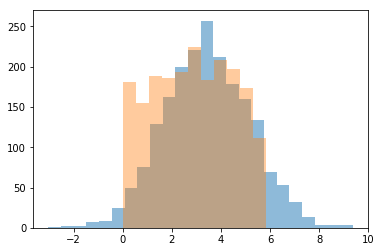

8


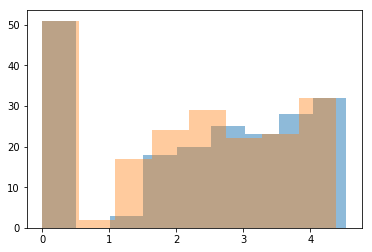

In [13]:
# preds = m.predict([tqz,tsz])
# for pred,q,s in zip(preds,tqz,tsz):
#     print(q, pred)
numpy.set_printoptions(precision=2)

seen = set()
for qix in range(len(questions)):
    for six in range(len(students)):
        if (int(qix),int(six)) in seen:
            continue
        else:
            seen.add((int(qix),int(six)))
        qrow = questions[qix].flatten()
        srow = students[six].flatten()
        qhat = qws[qix].flatten()
        shat = sws[six].flatten()
    #     print(qix, six, (srow, shat), (qrow, qhat), srow-qrow, shat-qhat)
        print("STUDENT", six)
        print(srow)
        print(shat)
        print("VS Q", qix)
        print(qrow)
        print(qhat)#, " >>>", srow-qrow, shat-qhat)
        print("Comp. Prs:")
        for s,q in ((srow,qrow), (shat,qhat)):
            zmask = (q<0.0001).astype(int)
            deltas = s-q
            prs = logistic(deltas,1,0)
            prs = numpy.maximum(zmask,prs)
            print(prs, numpy.prod(prs))
    
print(len(sws))
print(len(students))

bin_spread = lambda x: max(1,int(abs(2*(numpy.max(x)-numpy.min(x)))))

plt.hist(students.flatten(), alpha=0.5, bins=bin_spread(students))
plt.hist(sws.flatten(), alpha=0.4, bins=bin_spread(sws))
plt.show()
plt.hist(questions.flatten(), alpha=0.5, bins=bin_spread(questions))
print(bin_spread(qws))
plt.hist(qws.flatten(), alpha=0.4, bins=bin_spread(qws))
plt.show()

In [ ]:
print(numpy.min(qws), numpy.max(qws))

In [ ]:
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report, accuracy_score

for threshold in [0.2, 0.3, 0.4, 0.5, 0.6]:
    print("Threshold:", threshold)
    bool_preds = (preds >= threshold)
    print(confusion_matrix(tpfz, bool_preds))
    print(accuracy_score(tpfz, bool_preds))
    print(" ")

bool_preds = numpy.around(preds)
print("obvsd acc", accuracy_score(tpfz, numpy.around(preds)))
#.8263 v 7814

In [14]:
def calc_arr_arr_err(split, real_wgts, pred_wgts, max_iter=10):
    from scipy.spatial.distance import cosine
# pred_wgts = numpy.round(pred_wgts,1)

    out_cols = [None] * len(real_wgts.T)
    curr_sel = None
    curr_ix = None
    n_iters = 10
    chosen = None
    
    indices = range(len(real_wgts.T))

    min_total_err = math.inf
    best_dis = math.inf
    for i in range(max_iter): #len(indices)**2):
        real_used = set()
        pred_used = set()
        while len(pred_used) < len(indices):
            curr_err = math.inf
            curr_cos = math.inf
            for rix in numpy.random.permutation(indices):
                if rix in real_used:
                    continue
                real_col = real_wgts.T[rix]
                for cix in numpy.random.permutation(indices):
                    if cix in pred_used:
                        continue
                    pred_col = pred_wgts.T[cix]
                    pred_col = pred_col #* pred_q_col
                    err = numpy.mean(numpy.abs( pred_col - real_col))
                    
                    if err < curr_err:
                        curr_sel = pred_col
                        curr_err = err
                        curr_cos = 0#cosine(pred_col, real_col)
                        curr_ix = cix
                        curr_real_ix = rix
            real_used.add(curr_real_ix)
            pred_used.add(curr_ix)
            out_cols[curr_real_ix] = curr_sel
        out_col_arr = numpy.array(out_cols).T
        total_err = numpy.mean(numpy.abs( out_col_arr - real_wgts ))
        
        dis = 0
        mean_ll = numpy.mean( out_col_arr - real_wgts )
        if total_err < min_total_err:
            min_total_err = total_err
            total_q_err = numpy.mean(numpy.abs( out_col_arr[0:split] - real_wgts[0:split] ))
            total_s_err = numpy.mean(numpy.abs( out_col_arr[split:] - real_wgts[split:] ))
            best_ll = mean_ll
            chosen = out_col_arr
            best_dis = dis
    return chosen, min_total_err, total_q_err, total_s_err, mean_ll, best_dis


In [ ]:
numpy.random.seed(666)
_, _, students2, _  = gen_run(n_factors, a0, a1, min_active, max_active, s_gen="truncnorm", q_gen="u_uniform", test_w = test_w)
(sz2,qz2,pfz2), (vsz2,vqz2,vpfz2), (tsz2,tqz2,tpfz2), obs2, probs2 = tvt_split(students2, questions)

In [ ]:
s_table2, qn_table2, m2, h2 = generate_and_train(qz2,sz2,pfz2, vqz2,vsz2,vpfz2)

In [ ]:
sws2= s_table2.get_weights()[0]
qws2= qn_table2.get_weights()[0]

offset = numpy.mean(students2) - numpy.mean(sws2) 
qws2 = qws2# + offset
sws2 = sws2# + offset

bin_spread = lambda x: max(1,int(abs(2*(numpy.max(x)-numpy.min(x)))))
plt.hist(students2.flatten(), alpha=0.5, bins=bin_spread(students2))
plt.hist(sws2.flatten(), alpha=0.4, bins=bin_spread(sws2))
plt.show()
plt.hist(questions.flatten(), alpha=0.5, bins=bin_spread(questions))
print(bin_spread(qws2))
plt.hist(qws2.flatten(), alpha=0.4, bins=bin_spread(qws2))
plt.show()

/home/rjm49/.venvs/isaac/lib/python3.6/site-packages/numpy/core/fromnumeric.py:2909: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/home/rjm49/.venvs/isaac/lib/python3.6/site-packages/numpy/core/_methods.py:80: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)


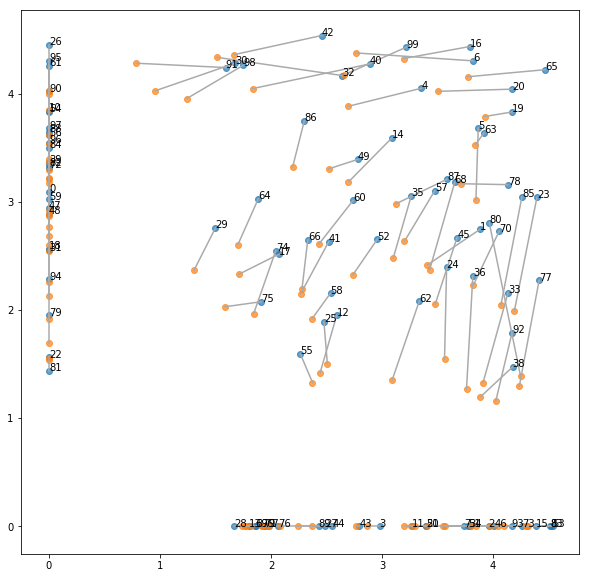

In [15]:
def plot_items(pred_list, real_items):
    base = min( numpy.min(pred_list), numpy.min(real_items) )
#     pca = PCA(n_components=2)
    real_items = real_items - base
    fyrst = True
    for preds in pred_list:
        preds = preds - base
        split = 0
        items_chosen, min_total_err, total_q_err, total_s_err, mean_ll, best_cos_dis = calc_arr_arr_err(0, real_items, preds, max_iter=10)
        itemz_pred = items_chosen
        n = len(items_chosen)
        itemz = real_items
        itemz_2 = numpy.concatenate([itemz, itemz_pred], axis=0)

        fig = plt.gcf()
        fig.set_size_inches(10, 10)
        if fyrst:
            fig.gca().scatter(itemz_2[0:n,0], itemz_2[0:n,1], alpha=0.7)
            for j in range(n):
                fig.gca().annotate(j, (itemz_2[j,0], itemz_2[j,1]))
            fyrst=False
        fig.gca().scatter(itemz_2[n:,0], itemz_2[n:,1], alpha=0.7)
        j=0
        for j in range(n):
            x,xh,y,yh = itemz_2[j,0], itemz_2[j+n,0], itemz_2[j,1], itemz_2[j+n,1]
            fig.gca().plot([x,xh],[y,yh],color="#aaaaaa")
            

    plt.show()

plot_items([qws,], questions)

In [ ]:
# plot_items([qws2], questions)

In [ ]:
# n_factors, a0, a1, min_active, max_active = (5, 9, 1, 1, 3)
# n_factors, a0, a1, min_active, max_active = (100, 0, 1, 1, 5)
n_factors, min_active, max_active = (2, 1, 2)

for _ in range(100):
    n_students = int(10**(scipy.stats.truncnorm.rvs(2,4, size=1)))
    n_questions = int(numpy.random.uniform(15,35, size=1))
    a1 = numpy.random.uniform(1, 3.5, size=1)
    a0 = numpy.random.uniform(-0.5,1, size=1)
    av_c = (min_active + max_active)/2
    offset = pr_to_spread(0.5, comps=av_c, as_A_and_D=False)
    a0 = a0 + offset
    test_w = numpy.random.uniform(0.5, 3.5)
    print("{} FACTORS".format(n_factors))
    print("{} STUDENTS: {} {}".format(n_students, a0, a1))
    print("{} QUEST/NS: {}".format(n_questions, test_w))
    print("Offset", offset)
    print((n_students, n_questions, float(a0), float(a1), offset, test_w))
    
    obs, probz, students, questions  = gen_run(n_factors, a0, a1, min_active, max_active, s_gen="truncnorm", q_gen="u_uniform", test_w = test_w)

    plt.hist(students.flatten(), alpha=0.5)
    plt.hist(questions.flatten(), alpha=0.5)
    plt.show()
    plt.hist(probz.flatten(), bins=20)
    plt.show()


